In [1]:
import sys
import os
from IPython.display import Image
import json
import cv2 as cv
from collections import defaultdict
import pickle
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import xml.dom.minidom as minidom
import xml.etree.cElementTree as cet
import xml.etree.ElementTree as et
import pytesseract
%matplotlib inline

In [2]:
def plot_images(img1, img2, title1="", title2=""):
    fig = plt.figure(figsize=[12,12])
    ax1 = fig.add_subplot(121)
    ax1.imshow(img1, cmap="gray")
    ax1.set(xticks=[], yticks=[], title=title1)

    ax2 = fig.add_subplot(122)
    ax2.imshow(img2, cmap="gray")
    ax2.set(xticks=[], yticks=[], title=title2)

In [3]:
def scale_bb(bb,x_scale,y_scale):
    x,y,w,h = bb
    (origLeft, origTop, origRight, origBottom) = (x,y,x+w,y+h)
    xmin = int(np.round(origLeft * x_scale))
    ymin = int(np.round(origTop * y_scale))
    xmax = int(np.round(origRight * x_scale))
    ymax = int(np.round(origBottom * y_scale))
    return [xmin,ymin,xmax-xmin,ymax-ymin]

def plot_rectangle(image,bb):
    x,y,w,h=bb
    cv.rectangle(image, (x,y),(x+w,y+h),(0,0,255),1)
    
def get_nameplate(nameplate,car):
    method = cv.TM_SQDIFF_NORMED

    small_image = cv.imread(nameplate)
    large_image = cv.imread(car)
    result = cv.matchTemplate(small_image, large_image, method)
    mn,_,mnLoc,_ = cv.minMaxLoc(result)
    MPx,MPy = mnLoc
    trows,tcols = small_image.shape[:2]
    cv.rectangle(large_image, (MPx,MPy),(MPx+tcols,MPy+trows),(0,0,255),2)
    plot_images(small_image,large_image)

def resize_and_extract_bb(nameplate,car,targetSize_x,targetSize_y,output_car):
    small_image = cv.imread(nameplate)
    large_image = cv.imread(car)
    print("Small image shape",small_image.shape,"Large Image shape",large_image.shape)
    print("Resizing to ",targetSize_x,targetSize_y)
    resized_img = cv.resize(large_image, (targetSize_x, targetSize_y))
    print("Resized image",resized_img.shape)
    #     plot_images(large_image,resized_img)
    cv.imwrite(output_car,resized_img)
    print("Saving to ",output_car)
    result = cv.matchTemplate(small_image, large_image, cv.TM_SQDIFF_NORMED)
    _,_,coordinates,_ = cv.minMaxLoc(result)
    x,y = coordinates
    h,w = small_image.shape[:2]
    original_bb = [x,y,w,h]
#     plot_rectangle(large_image,original_bb)
    y_ = large_image.shape[0]
    x_ = large_image.shape[1]
    x_scale = targetSize_x / x_
    y_scale = targetSize_y / y_
    inv_x_scale = x_ / targetSize_x
    inv_y_scale = y_ / targetSize_y
    
    scaled_bb = scale_bb(original_bb,x_scale,y_scale)
#     plot_rectangle(resized_img,scaled_bb)
#     plot_images(large_image,resized_img)
    return scaled_bb,(x_scale,y_scale),(inv_x_scale,inv_y_scale)

nameplate = "./Camera2/Set03/classes/din-0021/2788.png"
car = "./Camera2/Set03/classes_carros/din-0021/2788.png"
bb_info,scale,inv_scale = resize_and_extract_bb(nameplate,car,32,32,"./sample/test.png")
print(bb_info)
print(scale,inv_scale)

    

Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./sample/test.png
[12, 14, 8, 4]
(0.05970149253731343, 0.07373271889400922) (16.75, 13.5625)


In [4]:
def parse_data_point(datum):
    fields = datum.split(" ")
    path = fields[1].replace("/home/rayson/Desktop/Icaro/","")
    camera,setno,classes,nameplate,frame_no = path.split("/")
    return camera,setno,nameplate,frame_no
dataset_contents=open("dataset_info.txt","r").readlines()
print(len(dataset_contents))
frame_contents=defaultdict(list)
folder_pathinfo_dict = defaultdict(set)
for datum in dataset_contents[1:]:
    camera,setno,nameplate,frame_no=parse_data_point(datum)
    folder_pathinfo_dict[nameplate].add(setno)
    frame_contents[(nameplate,camera)].append(frame_no)

26170


In [33]:
def resize_nameplates_cars(frame_contents,folder_pathinfo_dict,target_x,target_y):
    import csv
    filename = "nameplate"+str(target_x)+"x"+str(target_y)+"_bounding_box.csv"
    fields =['id','label','scale','inv_scale']
    rows = []
    for key in frame_contents.keys():
        nameplate,camera = key
        frames = frame_contents[key]
        
        resize_prefix = "./Resized"+str(target_x)+"x"+str(target_y)+"Nameplates/"
        if len(frames) > 0:
            setno = list(folder_pathinfo_dict[nameplate]).pop()
            for frame in frames:
                car_path = camera+"/"+setno+"/"+"classes_carros/"+nameplate+"/"+frame
                nameplate_path = camera+"/"+setno+"/"+"classes/"+nameplate+"/"+frame
                print(car_path,nameplate_path)
                if os.path.exists(car_path) and os.path.exists(nameplate_path):
                    resized_car_path = resize_prefix+car_path
                    resized_nameplate_path = resize_prefix+nameplate_path
                    print(resized_car_path)
                    bb_info,scale,inv_scale = resize_and_extract_bb(nameplate_path,car_path,target_x,target_y,resized_car_path)
                    row = [resized_car_path,bb_info,scale,inv_scale]
                    print(row)
                    rows.append(row)
                
            
        
                
    with open(filename, 'w') as csvfile: 
        csvwriter = csv.writer(csvfile) 
        csvwriter.writerow(fields) 
        csvwriter.writerows(rows)
                
resize_nameplates_cars(frame_contents,folder_pathinfo_dict,32,32)

Camera1/Set01/classes_carros/aaa-7756/28896.png Camera1/Set01/classes/aaa-7756/28896.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28896.png
Small image shape (58, 140, 3) Large Image shape (433, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28896.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28896.png', [12, 14, 8, 5], (0.06037735849056604, 0.07390300230946882), (16.5625, 13.53125)]
Camera1/Set01/classes_carros/aaa-7756/28897.png Camera1/Set01/classes/aaa-7756/28897.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28897.png
Small image shape (58, 140, 3) Large Image shape (448, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28897.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28897.png', [12, 14, 8, 4], (0.06037735849056604, 0.07142857142857142

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/abu-2595/8863.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/abu-2595/8863.png', [16, 14, 10, 4], (0.0798004987531172, 0.07207207207207207), (12.53125, 13.875)]
Camera1/Set01/classes_carros/abu-2595/8864.png Camera1/Set01/classes/abu-2595/8864.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/abu-2595/8864.png
Small image shape (54, 126, 3) Large Image shape (444, 424, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/abu-2595/8864.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/abu-2595/8864.png', [15, 14, 9, 4], (0.07547169811320754, 0.07207207207207207), (13.25, 13.875)]
Camera1/Set01/classes_carros/abu-2595/8865.png Camera1/Set01/classes/abu-2595/8865.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/abu-2595/8865.png
Small image shape (54, 126, 3) Large Image shape (444, 446, 3)
Resizing t

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aca-3377/27126.png', [12, 14, 9, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set01/classes_carros/aca-3377/27127.png Camera1/Set01/classes/aca-3377/27127.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aca-3377/27127.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aca-3377/27127.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aca-3377/27127.png', [12, 14, 9, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set01/classes_carros/aca-3377/27128.png Camera1/Set01/classes/aca-3377/27128.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aca-3377/27128.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

./Resized32x32Nameplates/Camera1/Set01/classes_carros/ada-6622/14086.png
Small image shape (50, 130, 3) Large Image shape (367, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ada-6622/14086.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ada-6622/14086.png', [12, 17, 8, 4], (0.06153846153846154, 0.08719346049046321), (16.25, 11.46875)]
Camera1/Set01/classes_carros/ada-6622/14087.png Camera1/Set01/classes/ada-6622/14087.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ada-6622/14087.png
Small image shape (50, 130, 3) Large Image shape (420, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ada-6622/14087.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ada-6622/14087.png', [12, 15, 8, 4], (0.06153846153846154, 0.0761904761904762), (16.25, 13.125)]
Camera1/Set01/classes_carros/ada-6622/14088.png Camera1/Set01/classes/ad

Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/add-3999/32582.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/add-3999/32582.png', [12, 14, 8, 3], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set01/classes_carros/adq-9259/8615.png Camera1/Set01/classes/adq-9259/8615.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/adq-9259/8615.png
Small image shape (54, 140, 3) Large Image shape (389, 339, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/adq-9259/8615.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/adq-9259/8615.png', [19, 16, 13, 4], (0.0943952802359882, 0.08226221079691516), (10.59375, 12.15625)]
Camera1/Set01/classes_carros/adq-9259/8616.png Camera1/Set01/classes/adq-9259/8616.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/adq

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/adz-7773/32205.png', [12, 14, 9, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera1/Set01/classes_carros/adz-7773/32206.png Camera1/Set01/classes/adz-7773/32206.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/adz-7773/32206.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/adz-7773/32206.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/adz-7773/32206.png', [12, 14, 9, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera1/Set01/classes_carros/adz-7773/32207.png Camera1/Set01/classes/adz-7773/32207.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/adz-7773/32207.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

Small image shape (40, 126, 3) Large Image shape (430, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aex-8880/16558.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aex-8880/16558.png', [12, 15, 8, 2], (0.06201550387596899, 0.07441860465116279), (16.125, 13.4375)]
Camera1/Set01/classes_carros/aex-8880/16559.png Camera1/Set01/classes/aex-8880/16559.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aex-8880/16559.png
Small image shape (40, 126, 3) Large Image shape (430, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aex-8880/16559.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aex-8880/16559.png', [12, 14, 8, 3], (0.06201550387596899, 0.07441860465116279), (16.125, 13.4375)]
Camera1/Set01/classes_carros/aex-8880/16560.png Camera1/Set01/classes/aex-8880/16560.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28899.png', [12, 14, 8, 4], (0.0625, 0.07239819004524888), (16.0, 13.8125)]
Camera1/Set01/classes_carros/afx-0082/28900.png Camera1/Set01/classes/afx-0082/28900.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28900.png
Small image shape (52, 122, 3) Large Image shape (442, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28900.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28900.png', [12, 14, 8, 4], (0.0625, 0.07239819004524888), (16.0, 13.8125)]
Camera1/Set01/classes_carros/afx-0082/28901.png Camera1/Set01/classes/afx-0082/28901.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28901.png
Small image shape (52, 122, 3) Large Image shape (442, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28901.png
['./Resize

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/age-8131/15936.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera1/Set01/classes_carros/age-8131/15937.png Camera1/Set01/classes/age-8131/15937.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/age-8131/15937.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/age-8131/15937.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/age-8131/15937.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera1/Set01/classes_carros/age-8131/15938.png Camera1/Set01/classes/age-8131/15938.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/age-8131/15938.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/agv-9919/18676.png', [12, 14, 8, 4], (0.06201550387596899, 0.07142857142857142), (16.125, 14.0)]
Camera1/Set01/classes_carros/agv-9919/18677.png Camera1/Set01/classes/agv-9919/18677.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/agv-9919/18677.png
Small image shape (58, 126, 3) Large Image shape (448, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/agv-9919/18677.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/agv-9919/18677.png', [12, 14, 8, 4], (0.06201550387596899, 0.07142857142857142), (16.125, 14.0)]
Camera1/Set01/classes_carros/ahc-9556/8655.png Camera1/Set01/classes/ahc-9556/8655.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ahc-9556/8655.png
Small image shape (44, 144, 3) Large Image shape (333, 414, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ahc-9556

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aib-4993/26276.png', [12, 15, 8, 2], (0.05947955390334572, 0.07441860465116279), (16.8125, 13.4375)]
Camera1/Set01/classes_carros/aib-4993/26277.png Camera1/Set01/classes/aib-4993/26277.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aib-4993/26277.png
Small image shape (40, 148, 3) Large Image shape (430, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aib-4993/26277.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aib-4993/26277.png', [12, 15, 8, 2], (0.05947955390334572, 0.07441860465116279), (16.8125, 13.4375)]
Camera1/Set01/classes_carros/aib-4993/26278.png Camera1/Set01/classes/aib-4993/26278.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aib-4993/26278.png
Small image shape (40, 148, 3) Large Image shape (430, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carr

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aja-6446/34694.png', [12, 14, 8, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera1/Set01/classes_carros/aja-6446/34695.png Camera1/Set01/classes/aja-6446/34695.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aja-6446/34695.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aja-6446/34695.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aja-6446/34695.png', [12, 14, 8, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera1/Set01/classes_carros/aja-6446/34696.png Camera1/Set01/classes/aja-6446/34696.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aja-6446/34696.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aja

Small image shape (44, 128, 3) Large Image shape (415, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ajh-2781/10888.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ajh-2781/10888.png', [12, 15, 8, 3], (0.06177606177606178, 0.07710843373493977), (16.1875, 12.96875)]
Camera1/Set01/classes_carros/ajh-2781/10889.png Camera1/Set01/classes/ajh-2781/10889.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ajh-2781/10889.png
Small image shape (44, 128, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ajh-2781/10889.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ajh-2781/10889.png', [12, 14, 8, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera1/Set01/classes_carros/ajh-2781/10890.png Camera1/Set01/classes/ajh-2781/10890.png
./Resized32x32Nameplates/Camera1/Set01/classes_car

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aju-4377/10383.png', [12, 20, 8, 4], (0.061068702290076333, 0.10062893081761007), (16.375, 9.9375)]
Camera1/Set01/classes_carros/aju-4377/10384.png Camera1/Set01/classes/aju-4377/10384.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aju-4377/10384.png
Small image shape (46, 134, 3) Large Image shape (364, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aju-4377/10384.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aju-4377/10384.png', [12, 17, 8, 4], (0.061068702290076333, 0.08791208791208792), (16.375, 11.375)]
Camera1/Set01/classes_carros/aju-4377/10385.png Camera1/Set01/classes/aju-4377/10385.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aju-4377/10385.png
Small image shape (46, 134, 3) Large Image shape (408, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ajy-0700/2800.png', [12, 14, 8, 4], (0.06060606060606061, 0.0730593607305936), (16.5, 13.6875)]
Camera1/Set01/classes_carros/ajz-5011/26901.png Camera1/Set01/classes/ajz-5011/26901.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ajz-5011/26901.png
Small image shape (44, 122, 3) Large Image shape (323, 343, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ajz-5011/26901.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ajz-5011/26901.png', [18, 19, 12, 5], (0.09329446064139942, 0.09907120743034056), (10.71875, 10.09375)]
Camera1/Set01/classes_carros/ajz-5011/26902.png Camera1/Set01/classes/ajz-5011/26902.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ajz-5011/26902.png
Small image shape (44, 122, 3) Large Image shape (386, 388, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

Small image shape (46, 142, 3) Large Image shape (435, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ake-4178/313.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ake-4178/313.png', [12, 14, 8, 4], (0.06015037593984962, 0.0735632183908046), (16.625, 13.59375)]
Camera1/Set01/classes_carros/ake-4178/314.png Camera1/Set01/classes/ake-4178/314.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ake-4178/314.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ake-4178/314.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ake-4178/314.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera1/Set01/classes_carros/ake-4178/315.png Camera1/Set01/classes/ake-4178/315.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ake-4178/315.png
S

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ake-9113/3550.png', [11, 14, 9, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera1/Set01/classes_carros/akn-0076/3121.png Camera1/Set01/classes/akn-0076/3121.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/akn-0076/3121.png
Small image shape (46, 130, 3) Large Image shape (351, 403, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/akn-0076/3121.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/akn-0076/3121.png', [15, 18, 11, 4], (0.0794044665012407, 0.09116809116809117), (12.59375, 10.96875)]
Camera1/Set01/classes_carros/akn-0076/3122.png Camera1/Set01/classes/akn-0076/3122.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/akn-0076/3122.png
Small image shape (46, 130, 3) Large Image shape (407, 444, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/akn-007

Small image shape (38, 142, 3) Large Image shape (326, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/alf-7073/15766.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/alf-7073/15766.png', [12, 19, 8, 4], (0.06015037593984962, 0.09815950920245399), (16.625, 10.1875)]
Camera1/Set01/classes_carros/alf-7073/15767.png Camera1/Set01/classes/alf-7073/15767.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/alf-7073/15767.png
Small image shape (38, 142, 3) Large Image shape (398, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/alf-7073/15767.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/alf-7073/15767.png', [12, 16, 8, 3], (0.06015037593984962, 0.08040201005025126), (16.625, 12.4375)]
Camera1/Set01/classes_carros/alf-7073/15768.png Camera1/Set01/classes/alf-7073/15768.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/alj-8237/19575.png', [13, 14, 9, 4], (0.06666666666666667, 0.07239819004524888), (15.0, 13.8125)]
Camera1/Set01/classes_carros/alj-8237/19576.png Camera1/Set01/classes/alj-8237/19576.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/alj-8237/19576.png
Small image shape (52, 130, 3) Large Image shape (442, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/alj-8237/19576.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/alj-8237/19576.png', [12, 14, 8, 4], (0.06153846153846154, 0.07239819004524888), (16.25, 13.8125)]
Camera1/Set01/classes_carros/alj-8237/19577.png Camera1/Set01/classes/alj-8237/19577.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/alj-8237/19577.png
Small image shape (52, 130, 3) Large Image shape (442, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/al

Small image shape (38, 116, 3) Large Image shape (318, 506, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/alo-9716/29615.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/alo-9716/29615.png', [12, 19, 8, 4], (0.06324110671936758, 0.10062893081761007), (15.8125, 9.9375)]
Camera1/Set01/classes_carros/alo-9716/29616.png Camera1/Set01/classes/alo-9716/29616.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/alo-9716/29616.png
Small image shape (38, 116, 3) Large Image shape (377, 506, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/alo-9716/29616.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/alo-9716/29616.png', [12, 17, 8, 3], (0.06324110671936758, 0.08488063660477453), (15.8125, 11.78125)]
Camera1/Set01/classes_carros/alo-9716/29617.png Camera1/Set01/classes/alo-9716/29617.png
./Resized32x32Nameplates/Camera1/Set01/classes_carr

Small image shape (50, 154, 3) Large Image shape (376, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/alw-2999/19321.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/alw-2999/19321.png', [12, 17, 9, 4], (0.058823529411764705, 0.0851063829787234), (17.0, 11.75)]
Camera1/Set01/classes_carros/alw-2999/19322.png Camera1/Set01/classes/alw-2999/19322.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/alw-2999/19322.png
Small image shape (50, 154, 3) Large Image shape (439, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/alw-2999/19322.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/alw-2999/19322.png', [12, 14, 9, 4], (0.058823529411764705, 0.07289293849658314), (17.0, 13.71875)]
Camera1/Set01/classes_carros/alw-2999/19323.png Camera1/Set01/classes/alw-2999/19323.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/alw

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ame-4529/19389.png', [12, 14, 8, 3], (0.06153846153846154, 0.07407407407407407), (16.25, 13.5)]
Camera1/Set01/classes_carros/ame-4529/19390.png Camera1/Set01/classes/ame-4529/19390.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ame-4529/19390.png
Small image shape (42, 130, 3) Large Image shape (432, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ame-4529/19390.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ame-4529/19390.png', [12, 14, 8, 3], (0.06153846153846154, 0.07407407407407407), (16.25, 13.5)]
Camera1/Set01/classes_carros/amt-6430/26699.png Camera1/Set01/classes/amt-6430/26699.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/amt-6430/26699.png
Small image shape (54, 120, 3) Large Image shape (428, 350, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/amt-643

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ang-4913/18785.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera1/Set01/classes_carros/ang-4913/18786.png Camera1/Set01/classes/ang-4913/18786.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ang-4913/18786.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ang-4913/18786.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ang-4913/18786.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera1/Set01/classes_carros/anh-3254/988.png Camera1/Set01/classes/anh-3254/988.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/anh-3254/988.png
Small image shape (44, 146, 3) Large Image shape (289, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/anh-3

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/anp-4012/19456.png', [12, 14, 7, 4], (0.0625, 0.07339449541284404), (16.0, 13.625)]
Camera1/Set01/classes_carros/anp-4012/19457.png Camera1/Set01/classes/anp-4012/19457.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/anp-4012/19457.png
Small image shape (46, 122, 3) Large Image shape (436, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/anp-4012/19457.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/anp-4012/19457.png', [12, 14, 7, 4], (0.0625, 0.07339449541284404), (16.0, 13.625)]
Camera1/Set01/classes_carros/anp-4012/19458.png Camera1/Set01/classes/anp-4012/19458.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/anp-4012/19458.png
Small image shape (46, 122, 3) Large Image shape (436, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/anp-4012/19458.png
['./Resized3

Small image shape (54, 124, 3) Large Image shape (444, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/anw-0503/13580.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/anw-0503/13580.png', [12, 14, 8, 4], (0.0622568093385214, 0.07207207207207207), (16.0625, 13.875)]
Camera1/Set01/classes_carros/anw-0503/13581.png Camera1/Set01/classes/anw-0503/13581.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/anw-0503/13581.png
Small image shape (54, 124, 3) Large Image shape (444, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/anw-0503/13581.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/anw-0503/13581.png', [12, 14, 8, 4], (0.0622568093385214, 0.07207207207207207), (16.0625, 13.875)]
Camera1/Set01/classes_carros/anw-0503/13582.png Camera1/Set01/classes/anw-0503/13582.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoa-2717/10749.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoa-2717/10749.png', [11, 14, 10, 4], (0.05860805860805861, 0.07111111111111111), (17.0625, 14.0625)]
Camera1/Set01/classes_carros/aoa-2717/10750.png Camera1/Set01/classes/aoa-2717/10750.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoa-2717/10750.png
Small image shape (60, 156, 3) Large Image shape (450, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoa-2717/10750.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoa-2717/10750.png', [11, 14, 10, 4], (0.05860805860805861, 0.07111111111111111), (17.0625, 14.0625)]
Camera1/Set01/classes_carros/aoa-2717/10751.png Camera1/Set01/classes/aoa-2717/10751.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoa-2717/10751.png
Small image shape (60, 156, 3) Large Image shape (450, 546

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aog-7062/16358.png', [12, 15, 8, 2], (0.06130268199233716, 0.07441860465116279), (16.3125, 13.4375)]
Camera1/Set01/classes_carros/aog-7062/16359.png Camera1/Set01/classes/aog-7062/16359.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aog-7062/16359.png
Small image shape (40, 132, 3) Large Image shape (430, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aog-7062/16359.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aog-7062/16359.png', [12, 15, 8, 2], (0.06130268199233716, 0.07441860465116279), (16.3125, 13.4375)]
Camera1/Set01/classes_carros/aoh-1678/5759.png Camera1/Set01/classes/aoh-1678/5759.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoh-1678/5759.png
Small image shape (58, 70, 3) Large Image shape (363, 460, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoi-4488/26316.png', [11, 14, 9, 4], (0.05925925925925926, 0.07142857142857142), (16.875, 14.0)]
Camera1/Set01/classes_carros/aoi-4488/26317.png Camera1/Set01/classes/aoi-4488/26317.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoi-4488/26317.png
Small image shape (58, 150, 3) Large Image shape (448, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoi-4488/26317.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoi-4488/26317.png', [12, 14, 8, 4], (0.05925925925925926, 0.07142857142857142), (16.875, 14.0)]
Camera1/Set01/classes_carros/aoi-4488/26318.png Camera1/Set01/classes/aoi-4488/26318.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoi-4488/26318.png
Small image shape (58, 150, 3) Large Image shape (448, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aoi-4

Small image shape (36, 124, 3) Large Image shape (392, 485, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aov-2872/2745.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aov-2872/2745.png', [13, 16, 8, 3], (0.06597938144329897, 0.08163265306122448), (15.15625, 12.25)]
Camera1/Set01/classes_carros/aov-2872/2746.png Camera1/Set01/classes/aov-2872/2746.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aov-2872/2746.png
Small image shape (36, 124, 3) Large Image shape (426, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aov-2872/2746.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aov-2872/2746.png', [12, 15, 7, 3], (0.0622568093385214, 0.07511737089201878), (16.0625, 13.3125)]
Camera1/Set01/classes_carros/aov-2872/2747.png Camera1/Set01/classes/aov-2872/2747.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aov-2872

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/apd-3786/11083.png', [12, 14, 8, 4], (0.061068702290076333, 0.07079646017699115), (16.375, 14.125)]
Camera1/Set01/classes_carros/apr-2729/2925.png Camera1/Set01/classes/apr-2729/2925.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/apr-2729/2925.png
Small image shape (56, 162, 3) Large Image shape (347, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/apr-2729/2925.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/apr-2729/2925.png', [11, 18, 10, 5], (0.057971014492753624, 0.09221902017291066), (17.25, 10.84375)]
Camera1/Set01/classes_carros/apr-2729/2926.png Camera1/Set01/classes/apr-2729/2926.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/apr-2729/2926.png
Small image shape (56, 162, 3) Large Image shape (420, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/apr-2

Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/apr-5793/16916.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/apr-5793/16916.png', [12, 14, 8, 4], (0.060836501901140684, 0.07239819004524888), (16.4375, 13.8125)]
Camera1/Set01/classes_carros/apr-5793/16917.png Camera1/Set01/classes/apr-5793/16917.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/apr-5793/16917.png
Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/apr-5793/16917.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/apr-5793/16917.png', [12, 14, 8, 4], (0.060836501901140684, 0.07239819004524888), (16.4375, 13.8125)]
Camera1/Set01/classes_carros/apr-5793/16918.png Camera1/Set01/classes/apr-5793/16918.png
./Resized32x32Nameplates/Camera1/Set01/classes_ca

Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/apv-8603/2598.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/apv-8603/2598.png', [12, 14, 8, 4], (0.06153846153846154, 0.07174887892376682), (16.25, 13.9375)]
Camera1/Set01/classes_carros/apv-8603/2599.png Camera1/Set01/classes/apv-8603/2599.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/apv-8603/2599.png
Small image shape (56, 130, 3) Large Image shape (446, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/apv-8603/2599.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/apv-8603/2599.png', [12, 14, 8, 4], (0.06153846153846154, 0.07174887892376682), (16.25, 13.9375)]
Camera1/Set01/classes_carros/apv-8603/2600.png Camera1/Set01/classes/apv-8603/2600.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/apv-8603/2600.png
Small image shape (56, 130, 3) Large Image shape (446, 520, 3)
Resizing to  32 32
Resized image (32,

Small image shape (44, 128, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqb-0838/8983.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqb-0838/8983.png', [12, 14, 8, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera1/Set01/classes_carros/aqb-0838/8984.png Camera1/Set01/classes/aqb-0838/8984.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqb-0838/8984.png
Small image shape (44, 128, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqb-0838/8984.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqb-0838/8984.png', [12, 14, 8, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera1/Set01/classes_carros/aqb-0838/8985.png Camera1/Set01/classes/aqb-0838/8985.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqb-08

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqc-4576/23990.png', [13, 14, 6, 4], (0.06808510638297872, 0.07111111111111111), (14.6875, 14.0625)]
Camera1/Set01/classes_carros/aqc-4576/23991.png Camera1/Set01/classes/aqc-4576/23991.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqc-4576/23991.png
Small image shape (60, 80, 3) Large Image shape (450, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqc-4576/23991.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqc-4576/23991.png', [13, 14, 6, 4], (0.06808510638297872, 0.07111111111111111), (14.6875, 14.0625)]
Camera1/Set01/classes_carros/aqd-9058/16519.png Camera1/Set01/classes/aqd-9058/16519.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqd-9058/16519.png
Small image shape (46, 132, 3) Large Image shape (387, 349, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carro

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqe-3993/13727.png', [12, 14, 8, 4], (0.06015037593984962, 0.07142857142857142), (16.625, 14.0)]
Camera1/Set01/classes_carros/aqe-3993/13728.png Camera1/Set01/classes/aqe-3993/13728.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqe-3993/13728.png
Small image shape (58, 142, 3) Large Image shape (448, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqe-3993/13728.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqe-3993/13728.png', [12, 14, 8, 4], (0.06015037593984962, 0.07142857142857142), (16.625, 14.0)]
Camera1/Set01/classes_carros/aqe-3993/13729.png Camera1/Set01/classes/aqe-3993/13729.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqe-3993/13729.png
Small image shape (58, 142, 3) Large Image shape (448, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqe-3

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqh-1586/19159.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera1/Set01/classes_carros/aqh-1586/19160.png Camera1/Set01/classes/aqh-1586/19160.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqh-1586/19160.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqh-1586/19160.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqh-1586/19160.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera1/Set01/classes_carros/aqh-1586/19161.png Camera1/Set01/classes/aqh-1586/19161.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqh-1586/19161.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

Small image shape (46, 122, 3) Large Image shape (436, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqm-2596/11673.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqm-2596/11673.png', [12, 14, 8, 4], (0.0625, 0.07339449541284404), (16.0, 13.625)]
Camera1/Set01/classes_carros/aqm-2596/11674.png Camera1/Set01/classes/aqm-2596/11674.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqm-2596/11674.png
Small image shape (46, 122, 3) Large Image shape (436, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqm-2596/11674.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqm-2596/11674.png', [12, 14, 8, 4], (0.0625, 0.07339449541284404), (16.0, 13.625)]
Camera1/Set01/classes_carros/aqm-2596/11675.png Camera1/Set01/classes/aqm-2596/11675.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqm-2596/11675.png
Small image 

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqp-8756/26656.png', [11, 14, 10, 4], (0.05860805860805861, 0.07339449541284404), (17.0625, 13.625)]
Camera1/Set01/classes_carros/aqp-8756/26657.png Camera1/Set01/classes/aqp-8756/26657.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqp-8756/26657.png
Small image shape (46, 156, 3) Large Image shape (436, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqp-8756/26657.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqp-8756/26657.png', [11, 14, 10, 4], (0.05860805860805861, 0.07339449541284404), (17.0625, 13.625)]
Camera1/Set01/classes_carros/aqp-8756/26658.png Camera1/Set01/classes/aqp-8756/26658.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqp-8756/26658.png
Small image shape (46, 156, 3) Large Image shape (436, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carr

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqu-1803/13813.png', [12, 14, 9, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera1/Set01/classes_carros/aqu-1803/13814.png Camera1/Set01/classes/aqu-1803/13814.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqu-1803/13814.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqu-1803/13814.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqu-1803/13814.png', [12, 14, 9, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera1/Set01/classes_carros/aqu-1803/13815.png Camera1/Set01/classes/aqu-1803/13815.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqu-1803/13815.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5568.png', [14, 14, 5, 4], (0.06866952789699571, 0.07239819004524888), (14.5625, 13.8125)]
Camera1/Set01/classes_carros/aqw-3871/5569.png Camera1/Set01/classes/aqw-3871/5569.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5569.png
Small image shape (52, 76, 3) Large Image shape (442, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5569.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5569.png', [14, 14, 5, 4], (0.06866952789699571, 0.07239819004524888), (14.5625, 13.8125)]
Camera1/Set01/classes_carros/aqw-3871/5570.png Camera1/Set01/classes/aqw-3871/5570.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5570.png
Small image shape (52, 76, 3) Large Image shape (442, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/arb-4423/13434.png', [13, 14, 6, 4], (0.06779661016949153, 0.07079646017699115), (14.75, 14.125)]
Camera1/Set01/classes_carros/arb-4423/13435.png Camera1/Set01/classes/arb-4423/13435.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/arb-4423/13435.png
Small image shape (62, 82, 3) Large Image shape (452, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/arb-4423/13435.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/arb-4423/13435.png', [13, 14, 6, 4], (0.06779661016949153, 0.07079646017699115), (14.75, 14.125)]
Camera1/Set01/classes_carros/arb-4423/13436.png Camera1/Set01/classes/arb-4423/13436.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/arb-4423/13436.png
Small image shape (62, 82, 3) Large Image shape (452, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/arb-4

Small image shape (42, 136, 3) Large Image shape (432, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/arg-7263/5887.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/arg-7263/5887.png', [12, 14, 8, 3], (0.060836501901140684, 0.07407407407407407), (16.4375, 13.5)]
Camera1/Set01/classes_carros/arg-7263/5888.png Camera1/Set01/classes/arg-7263/5888.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/arg-7263/5888.png
Small image shape (42, 136, 3) Large Image shape (432, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/arg-7263/5888.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/arg-7263/5888.png', [12, 14, 8, 3], (0.060836501901140684, 0.07407407407407407), (16.4375, 13.5)]
Camera1/Set01/classes_carros/arg-7263/5889.png Camera1/Set01/classes/arg-7263/5889.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/arg-7263/5

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/arj-1497/5692.png', [12, 15, 8, 5], (0.061068702290076333, 0.07901234567901234), (16.375, 12.65625)]
Camera1/Set01/classes_carros/arj-1497/5693.png Camera1/Set01/classes/arj-1497/5693.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/arj-1497/5693.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/arj-1497/5693.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/arj-1497/5693.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set01/classes_carros/arj-1497/5694.png Camera1/Set01/classes/arj-1497/5694.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/arj-1497/5694.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/arj-1

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/arm-3226/6031.png', [19, 16, 12, 4], (0.09968847352024922, 0.08311688311688312), (10.03125, 12.03125)]
Camera1/Set01/classes_carros/arm-3226/6032.png Camera1/Set01/classes/arm-3226/6032.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/arm-3226/6032.png
Small image shape (40, 120, 3) Large Image shape (427, 350, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/arm-3226/6032.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/arm-3226/6032.png', [18, 15, 11, 3], (0.09142857142857143, 0.07494145199063232), (10.9375, 13.34375)]
Camera1/Set01/classes_carros/arm-3226/6033.png Camera1/Set01/classes/arm-3226/6033.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/arm-3226/6033.png
Small image shape (40, 120, 3) Large Image shape (430, 377, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/asa-5172/34935.png', [12, 15, 8, 4], (0.06130268199233716, 0.07494145199063232), (16.3125, 13.34375)]
Camera1/Set01/classes_carros/asa-5172/34936.png Camera1/Set01/classes/asa-5172/34936.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/asa-5172/34936.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/asa-5172/34936.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/asa-5172/34936.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set01/classes_carros/asa-5172/34937.png Camera1/Set01/classes/asa-5172/34937.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/asa-5172/34937.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carr

Small image shape (54, 140, 3) Large Image shape (444, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/asd-8431/21197.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/asd-8431/21197.png', [12, 14, 8, 4], (0.06037735849056604, 0.07207207207207207), (16.5625, 13.875)]
Camera1/Set01/classes_carros/asg-3546/18400.png Camera1/Set01/classes/asg-3546/18400.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/asg-3546/18400.png
Small image shape (50, 140, 3) Large Image shape (325, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/asg-3546/18400.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/asg-3546/18400.png', [12, 19, 8, 5], (0.06037735849056604, 0.09846153846153846), (16.5625, 10.15625)]
Camera1/Set01/classes_carros/asg-3546/18401.png Camera1/Set01/classes/asg-3546/18401.png
./Resized32x32Nameplates/Camera1/Set01/classes_carr

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/asg-4999/762.png', [12, 14, 8, 4], (0.060836501901140684, 0.07207207207207207), (16.4375, 13.875)]
Camera1/Set01/classes_carros/asg-4999/763.png Camera1/Set01/classes/asg-4999/763.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/asg-4999/763.png
Small image shape (54, 136, 3) Large Image shape (444, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/asg-4999/763.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/asg-4999/763.png', [12, 14, 8, 4], (0.060836501901140684, 0.07207207207207207), (16.4375, 13.875)]
Camera1/Set01/classes_carros/asg-4999/764.png Camera1/Set01/classes/asg-4999/764.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/asg-4999/764.png
Small image shape (54, 136, 3) Large Image shape (444, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/asg-4999/764.pn

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ask-8589/32319.png', [12, 14, 8, 4], (0.06177606177606178, 0.07142857142857142), (16.1875, 14.0)]
Camera1/Set01/classes_carros/ask-8589/32320.png Camera1/Set01/classes/ask-8589/32320.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ask-8589/32320.png
Small image shape (58, 128, 3) Large Image shape (448, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ask-8589/32320.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ask-8589/32320.png', [12, 14, 8, 4], (0.06177606177606178, 0.07142857142857142), (16.1875, 14.0)]
Camera1/Set01/classes_carros/ask-8589/32321.png Camera1/Set01/classes/ask-8589/32321.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ask-8589/32321.png
Small image shape (58, 128, 3) Large Image shape (448, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ask

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aso-4043/8481.png', [13, 14, 5, 4], (0.06866952789699571, 0.07111111111111111), (14.5625, 14.0625)]
Camera1/Set01/classes_carros/aso-4043/8482.png Camera1/Set01/classes/aso-4043/8482.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aso-4043/8482.png
Small image shape (60, 76, 3) Large Image shape (450, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aso-4043/8482.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aso-4043/8482.png', [13, 14, 5, 4], (0.06866952789699571, 0.07111111111111111), (14.5625, 14.0625)]
Camera1/Set01/classes_carros/aso-4043/8483.png Camera1/Set01/classes/aso-4043/8483.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aso-4043/8483.png
Small image shape (60, 76, 3) Large Image shape (450, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aso-4043

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/asx-2871/8931.png', [12, 14, 8, 4], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera1/Set01/classes_carros/asx-2871/8932.png Camera1/Set01/classes/asx-2871/8932.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/asx-2871/8932.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/asx-2871/8932.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/asx-2871/8932.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set01/classes_carros/asx-2871/8933.png Camera1/Set01/classes/asx-2871/8933.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/asx-2871/8933.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/asx-2871/

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/asz-5718/8602.png', [12, 19, 8, 5], (0.0599250936329588, 0.09907120743034056), (16.6875, 10.09375)]
Camera1/Set01/classes_carros/asz-5718/8603.png Camera1/Set01/classes/asz-5718/8603.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/asz-5718/8603.png
Small image shape (52, 144, 3) Large Image shape (402, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/asz-5718/8603.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/asz-5718/8603.png', [12, 16, 8, 4], (0.0599250936329588, 0.07960199004975124), (16.6875, 12.5625)]
Camera1/Set01/classes_carros/asz-5718/8604.png Camera1/Set01/classes/asz-5718/8604.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/asz-5718/8604.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/asz-571

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/asz-5959/13857.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/asz-5959/13857.png', [11, 15, 9, 3], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set01/classes_carros/asz-5959/13858.png Camera1/Set01/classes/asz-5959/13858.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/asz-5959/13858.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/asz-5959/13858.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/asz-5959/13858.png', [11, 15, 9, 3], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set01/classes_carros/atb-9367/11278.png Camera1/Set01/classes/atb-9367/11278.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atb-9367/11278.png
Small image shape (46, 130, 3) Large Image shape (383, 520, 3)

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atc-1189/2600.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atc-1189/2600.png', [11, 14, 9, 4], (0.058394160583941604, 0.07207207207207207), (17.125, 13.875)]
Camera1/Set01/classes_carros/atc-1189/2601.png Camera1/Set01/classes/atc-1189/2601.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atc-1189/2601.png
Small image shape (54, 158, 3) Large Image shape (444, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atc-1189/2601.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atc-1189/2601.png', [11, 14, 9, 4], (0.058394160583941604, 0.07207207207207207), (17.125, 13.875)]
Camera1/Set01/classes_carros/atc-1189/2602.png Camera1/Set01/classes/atc-1189/2602.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atc-1189/2602.png
Small image shape (54, 158, 3) Large Image shape (444, 548, 3)
Resizing 

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atd-9302/34233.png', [12, 16, 8, 4], (0.060836501901140684, 0.08080808080808081), (16.4375, 12.375)]
Camera1/Set01/classes_carros/atd-9302/34234.png Camera1/Set01/classes/atd-9302/34234.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atd-9302/34234.png
Small image shape (50, 136, 3) Large Image shape (433, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atd-9302/34234.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atd-9302/34234.png', [12, 14, 8, 4], (0.060836501901140684, 0.07390300230946882), (16.4375, 13.53125)]
Camera1/Set01/classes_carros/atd-9302/34235.png Camera1/Set01/classes/atd-9302/34235.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atd-9302/34235.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_ca

Small image shape (38, 128, 3) Large Image shape (311, 471, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atk-3801/19302.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atk-3801/19302.png', [13, 20, 9, 4], (0.06794055201698514, 0.10289389067524116), (14.71875, 9.71875)]
Camera1/Set01/classes_carros/atk-3801/19303.png Camera1/Set01/classes/atk-3801/19303.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atk-3801/19303.png
Small image shape (38, 128, 3) Large Image shape (372, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atk-3801/19303.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atk-3801/19303.png', [12, 17, 8, 3], (0.0622568093385214, 0.08602150537634409), (16.0625, 11.625)]
Camera1/Set01/classes_carros/atk-3801/19304.png Camera1/Set01/classes/atk-3801/19304.png
./Resized32x32Nameplates/Camera1/Set01/classes_carro

./Resized32x32Nameplates/Camera1/Set01/classes_carros/atl-6222/16441.png
Small image shape (54, 130, 3) Large Image shape (444, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atl-6222/16441.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atl-6222/16441.png', [12, 14, 8, 4], (0.06153846153846154, 0.07207207207207207), (16.25, 13.875)]
Camera1/Set01/classes_carros/atm-9735/5958.png Camera1/Set01/classes/atm-9735/5958.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atm-9735/5958.png
Small image shape (40, 126, 3) Large Image shape (363, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atm-9735/5958.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atm-9735/5958.png', [12, 17, 8, 4], (0.06201550387596899, 0.0881542699724518), (16.125, 11.34375)]
Camera1/Set01/classes_carros/atm-9735/5959.png Camera1/Set01/classes/atm-973

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ato-1660/21023.png', [14, 14, 5, 4], (0.06896551724137931, 0.07142857142857142), (14.5, 14.0)]
Camera1/Set01/classes_carros/ato-1660/21024.png Camera1/Set01/classes/ato-1660/21024.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ato-1660/21024.png
Small image shape (58, 74, 3) Large Image shape (448, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ato-1660/21024.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ato-1660/21024.png', [14, 14, 5, 4], (0.06896551724137931, 0.07142857142857142), (14.5, 14.0)]
Camera1/Set01/classes_carros/ato-1660/21025.png Camera1/Set01/classes/ato-1660/21025.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ato-1660/21025.png
Small image shape (58, 74, 3) Large Image shape (448, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ato-1660/21

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26758.png', [12, 14, 8, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera1/Set01/classes_carros/att-9726/26759.png Camera1/Set01/classes/att-9726/26759.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26759.png
Small image shape (44, 128, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26759.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26759.png', [12, 14, 8, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera1/Set01/classes_carros/att-9726/26760.png Camera1/Set01/classes/att-9726/26760.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26760.png
Small image shape (44, 128, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carr

Small image shape (60, 148, 3) Large Image shape (450, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atu-9776/186.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atu-9776/186.png', [12, 14, 8, 4], (0.05947955390334572, 0.07111111111111111), (16.8125, 14.0625)]
Camera1/Set01/classes_carros/atu-9776/187.png Camera1/Set01/classes/atu-9776/187.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atu-9776/187.png
Small image shape (60, 148, 3) Large Image shape (450, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atu-9776/187.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atu-9776/187.png', [12, 14, 8, 4], (0.05947955390334572, 0.07111111111111111), (16.8125, 14.0625)]
Camera1/Set01/classes_carros/atu-9776/188.png Camera1/Set01/classes/atu-9776/188.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atu-9776/188.pn

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atw-4518/34876.png', [11, 15, 9, 3], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set01/classes_carros/atw-5217/13814.png Camera1/Set01/classes/atw-5217/13814.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atw-5217/13814.png
Small image shape (48, 132, 3) Large Image shape (337, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atw-5217/13814.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atw-5217/13814.png', [12, 18, 8, 5], (0.06130268199233716, 0.09495548961424333), (16.3125, 10.53125)]
Camera1/Set01/classes_carros/atw-5217/13815.png Camera1/Set01/classes/atw-5217/13815.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atw-5217/13815.png
Small image shape (48, 132, 3) Large Image shape (391, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carr

Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atw-6926/8449.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atw-6926/8449.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera1/Set01/classes_carros/atw-6926/8450.png Camera1/Set01/classes/atw-6926/8450.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atw-6926/8450.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atw-6926/8450.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atw-6926/8450.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera1/Set01/classes_carros/atx-8081/26867.png Camera1/Set01/classes/atx-8081/26867.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atx-

./Resized32x32Nameplates/Camera1/Set01/classes_carros/aty-9697/34342.png
Small image shape (46, 124, 3) Large Image shape (436, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aty-9697/34342.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aty-9697/34342.png', [12, 14, 8, 4], (0.0622568093385214, 0.07339449541284404), (16.0625, 13.625)]
Camera1/Set01/classes_carros/aty-9697/34343.png Camera1/Set01/classes/aty-9697/34343.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aty-9697/34343.png
Small image shape (46, 124, 3) Large Image shape (436, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aty-9697/34343.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aty-9697/34343.png', [12, 14, 8, 4], (0.0622568093385214, 0.07339449541284404), (16.0625, 13.625)]
Camera1/Set01/classes_carros/aty-9697/34344.png Camera1/Set01/classes/a

Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atz-2376/26990.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atz-2376/26990.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera1/Set01/classes_carros/atz-2376/26991.png Camera1/Set01/classes/atz-2376/26991.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atz-2376/26991.png
Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atz-2376/26991.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atz-2376/26991.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera1/Set01/classes_carros/atz-2376/26992.png Camera1/Set01/classes/atz-2376/26992.png
./Resized32x32Nameplates/Camera1/Set01/classes_carr

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atz-6932/5756.png', [12, 16, 8, 3], (0.0625, 0.082687338501292), (16.0, 12.09375)]
Camera1/Set01/classes_carros/atz-6932/5757.png Camera1/Set01/classes/atz-6932/5757.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atz-6932/5757.png
Small image shape (38, 122, 3) Large Image shape (419, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atz-6932/5757.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/atz-6932/5757.png', [12, 15, 8, 3], (0.0625, 0.07637231503579953), (16.0, 13.09375)]
Camera1/Set01/classes_carros/atz-6932/5758.png Camera1/Set01/classes/atz-6932/5758.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/atz-6932/5758.png
Small image shape (38, 122, 3) Large Image shape (428, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/atz-6932/5758.png
['./Resized32x32Name

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auc-3173/32891.png', [12, 18, 8, 4], (0.06177606177606178, 0.09221902017291066), (16.1875, 10.84375)]
Camera1/Set01/classes_carros/auc-3173/32892.png Camera1/Set01/classes/auc-3173/32892.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/auc-3173/32892.png
Small image shape (46, 128, 3) Large Image shape (380, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auc-3173/32892.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auc-3173/32892.png', [12, 16, 8, 4], (0.06177606177606178, 0.08421052631578947), (16.1875, 11.875)]
Camera1/Set01/classes_carros/auc-3173/32893.png Camera1/Set01/classes/auc-3173/32893.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/auc-3173/32893.png
Small image shape (46, 128, 3) Large Image shape (412, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carr

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aue-7343/8066.png', [12, 14, 8, 4], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera1/Set01/classes_carros/aue-7343/8067.png Camera1/Set01/classes/aue-7343/8067.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aue-7343/8067.png
Small image shape (44, 142, 3) Large Image shape (434, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aue-7343/8067.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aue-7343/8067.png', [12, 14, 8, 4], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera1/Set01/classes_carros/aue-7343/8068.png Camera1/Set01/classes/aue-7343/8068.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aue-7343/8068.png
Small image shape (44, 142, 3) Large Image shape (434, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aue-7343

Small image shape (58, 148, 3) Large Image shape (405, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auf-6294/24596.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auf-6294/24596.png', [12, 15, 8, 5], (0.05947955390334572, 0.07901234567901234), (16.8125, 12.65625)]
Camera1/Set01/classes_carros/auf-6294/24597.png Camera1/Set01/classes/auf-6294/24597.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/auf-6294/24597.png
Small image shape (58, 148, 3) Large Image shape (448, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auf-6294/24597.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auf-6294/24597.png', [12, 14, 8, 4], (0.05947955390334572, 0.07142857142857142), (16.8125, 14.0)]
Camera1/Set01/classes_carros/auf-6294/24598.png Camera1/Set01/classes/auf-6294/24598.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros

Camera1/Set01/classes_carros/auh-0434/32474.png Camera1/Set01/classes/auh-0434/32474.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/auh-0434/32474.png
Small image shape (54, 144, 3) Large Image shape (444, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auh-0434/32474.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auh-0434/32474.png', [12, 14, 8, 4], (0.0599250936329588, 0.07207207207207207), (16.6875, 13.875)]
Camera1/Set01/classes_carros/auh-0434/32475.png Camera1/Set01/classes/auh-0434/32475.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/auh-0434/32475.png
Small image shape (54, 144, 3) Large Image shape (444, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auh-0434/32475.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auh-0434/32475.png', [12, 14, 8, 4], (0.0599250936329588, 0.07207207207207207), (

Small image shape (44, 130, 3) Large Image shape (434, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aui-2112/34626.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aui-2112/34626.png', [12, 14, 8, 4], (0.06153846153846154, 0.07373271889400922), (16.25, 13.5625)]
Camera1/Set01/classes_carros/aui-2112/34627.png Camera1/Set01/classes/aui-2112/34627.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aui-2112/34627.png
Small image shape (44, 130, 3) Large Image shape (434, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aui-2112/34627.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aui-2112/34627.png', [12, 14, 8, 4], (0.06153846153846154, 0.07373271889400922), (16.25, 13.5625)]
Camera1/Set01/classes_carros/aui-2112/34628.png Camera1/Set01/classes/aui-2112/34628.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aui-6721/19520.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set01/classes_carros/aui-6721/19521.png Camera1/Set01/classes/aui-6721/19521.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aui-6721/19521.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aui-6721/19521.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aui-6721/19521.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set01/classes_carros/aui-6721/19522.png Camera1/Set01/classes/aui-6721/19522.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aui-6721/19522.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auj-5916/485.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auj-5916/485.png', [12, 14, 9, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set01/classes_carros/auj-5916/486.png Camera1/Set01/classes/auj-5916/486.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/auj-5916/486.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auj-5916/486.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auj-5916/486.png', [12, 14, 9, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set01/classes_carros/auj-5916/487.png Camera1/Set01/classes/auj-5916/487.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/auj-5916/487.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving t

Small image shape (58, 64, 3) Large Image shape (448, 454, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auk-4508/13428.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auk-4508/13428.png', [14, 14, 4, 4], (0.07048458149779736, 0.07142857142857142), (14.1875, 14.0)]
Camera1/Set01/classes_carros/auk-5364/29108.png Camera1/Set01/classes/auk-5364/29108.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/auk-5364/29108.png
Small image shape (52, 130, 3) Large Image shape (343, 406, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auk-5364/29108.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auk-5364/29108.png', [15, 18, 10, 5], (0.07881773399014778, 0.09329446064139942), (12.6875, 10.71875)]
Camera1/Set01/classes_carros/auk-5364/29109.png Camera1/Set01/classes/auk-5364/29109.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aul-6039/32723.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set01/classes_carros/aul-6039/32724.png Camera1/Set01/classes/aul-6039/32724.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aul-6039/32724.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aul-6039/32724.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aul-6039/32724.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set01/classes_carros/aul-6039/32725.png Camera1/Set01/classes/aul-6039/32725.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aul-6039/32725.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aul-603

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aul-9250/10955.png', [11, 14, 9, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera1/Set01/classes_carros/aul-9250/10956.png Camera1/Set01/classes/aul-9250/10956.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aul-9250/10956.png
Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aul-9250/10956.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aul-9250/10956.png', [11, 14, 9, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera1/Set01/classes_carros/aul-9250/10957.png Camera1/Set01/classes/aul-9250/10957.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aul-9250/10957.png
Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3455.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set01/classes_carros/aup-6455/3456.png Camera1/Set01/classes/aup-6455/3456.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3456.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3456.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3456.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set01/classes_carros/aup-6455/3457.png Camera1/Set01/classes/aup-6455/3457.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3457.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aup-64

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aut-5775/19253.png', [12, 15, 8, 4], (0.06153846153846154, 0.07692307692307693), (16.25, 13.0)]
Camera1/Set01/classes_carros/aut-5775/19254.png Camera1/Set01/classes/aut-5775/19254.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aut-5775/19254.png
Small image shape (50, 130, 3) Large Image shape (440, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aut-5775/19254.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aut-5775/19254.png', [12, 14, 8, 4], (0.06153846153846154, 0.07272727272727272), (16.25, 13.75)]
Camera1/Set01/classes_carros/aut-5775/19255.png Camera1/Set01/classes/aut-5775/19255.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aut-5775/19255.png
Small image shape (50, 130, 3) Large Image shape (440, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aut-57

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aut-8812/19381.png', [11, 14, 10, 4], (0.05860805860805861, 0.07142857142857142), (17.0625, 14.0)]
Camera1/Set01/classes_carros/aut-8812/19382.png Camera1/Set01/classes/aut-8812/19382.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aut-8812/19382.png
Small image shape (58, 156, 3) Large Image shape (448, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aut-8812/19382.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/aut-8812/19382.png', [11, 14, 10, 4], (0.05860805860805861, 0.07142857142857142), (17.0625, 14.0)]
Camera1/Set01/classes_carros/auy-0793/16739.png Camera1/Set01/classes/auy-0793/16739.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/auy-0793/16739.png
Small image shape (48, 122, 3) Large Image shape (341, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auy-3629/5620.png', [12, 14, 8, 4], (0.06201550387596899, 0.07239819004524888), (16.125, 13.8125)]
Camera1/Set01/classes_carros/auy-3629/5621.png Camera1/Set01/classes/auy-3629/5621.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/auy-3629/5621.png
Small image shape (52, 126, 3) Large Image shape (442, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auy-3629/5621.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auy-3629/5621.png', [12, 14, 8, 4], (0.06201550387596899, 0.07239819004524888), (16.125, 13.8125)]
Camera1/Set01/classes_carros/auy-3629/5622.png Camera1/Set01/classes/auy-3629/5622.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/auy-3629/5622.png
Small image shape (52, 126, 3) Large Image shape (442, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auy-3629

Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auz-9865/13970.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auz-9865/13970.png', [12, 14, 8, 4], (0.05970149253731343, 0.07373271889400922), (16.75, 13.5625)]
Camera1/Set01/classes_carros/auz-9865/13971.png Camera1/Set01/classes/auz-9865/13971.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/auz-9865/13971.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/auz-9865/13971.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/auz-9865/13971.png', [12, 14, 8, 4], (0.05970149253731343, 0.07373271889400922), (16.75, 13.5625)]
Camera1/Set01/classes_carros/auz-9865/13972.png Camera1/Set01/classes/auz-9865/13972.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ava-3265/24379.png', [12, 15, 9, 3], (0.0636182902584493, 0.07655502392344497), (15.71875, 13.0625)]
Camera1/Set01/classes_carros/ava-3265/24380.png Camera1/Set01/classes/ava-3265/24380.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ava-3265/24380.png
Small image shape (44, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ava-3265/24380.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ava-3265/24380.png', [12, 14, 8, 3], (0.060836501901140684, 0.07373271889400922), (16.4375, 13.5625)]
Camera1/Set01/classes_carros/ava-3265/24381.png Camera1/Set01/classes/ava-3265/24381.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ava-3265/24381.png
Small image shape (44, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_car

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avd-2146/26472.png', [12, 19, 8, 5], (0.06201550387596899, 0.09968847352024922), (16.125, 10.03125)]
Camera1/Set01/classes_carros/avd-2146/26473.png Camera1/Set01/classes/avd-2146/26473.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avd-2146/26473.png
Small image shape (42, 126, 3) Large Image shape (368, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avd-2146/26473.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avd-2146/26473.png', [12, 17, 8, 4], (0.06201550387596899, 0.08695652173913043), (16.125, 11.5)]
Camera1/Set01/classes_carros/avd-2146/26474.png Camera1/Set01/classes/avd-2146/26474.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avd-2146/26474.png
Small image shape (42, 126, 3) Large Image shape (414, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avf-3133/32356.png', [12, 15, 8, 4], (0.06153846153846154, 0.07692307692307693), (16.25, 13.0)]
Camera1/Set01/classes_carros/avf-3133/32357.png Camera1/Set01/classes/avf-3133/32357.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avf-3133/32357.png
Small image shape (56, 130, 3) Large Image shape (446, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avf-3133/32357.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avf-3133/32357.png', [12, 14, 8, 4], (0.06153846153846154, 0.07174887892376682), (16.25, 13.9375)]
Camera1/Set01/classes_carros/avf-3133/32358.png Camera1/Set01/classes/avf-3133/32358.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avf-3133/32358.png
Small image shape (56, 130, 3) Large Image shape (446, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avf-

Small image shape (50, 130, 3) Large Image shape (393, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avg-6609/18753.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avg-6609/18753.png', [12, 16, 8, 4], (0.06153846153846154, 0.08142493638676845), (16.25, 12.28125)]
Camera1/Set01/classes_carros/avg-6609/18754.png Camera1/Set01/classes/avg-6609/18754.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avg-6609/18754.png
Small image shape (50, 130, 3) Large Image shape (435, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avg-6609/18754.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avg-6609/18754.png', [12, 14, 8, 4], (0.06153846153846154, 0.0735632183908046), (16.25, 13.59375)]
Camera1/Set01/classes_carros/avg-6609/18755.png Camera1/Set01/classes/avg-6609/18755.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avm-3172/7816.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set01/classes_carros/avm-3172/7817.png Camera1/Set01/classes/avm-3172/7817.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avm-3172/7817.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avm-3172/7817.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avm-3172/7817.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set01/classes_carros/avm-3172/7818.png Camera1/Set01/classes/avm-3172/7818.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avm-3172/7818.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avm-3172

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avo-4350/34869.png', [12, 14, 8, 4], (0.06153846153846154, 0.07272727272727272), (16.25, 13.75)]
Camera1/Set01/classes_carros/avo-4350/34870.png Camera1/Set01/classes/avo-4350/34870.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avo-4350/34870.png
Small image shape (50, 130, 3) Large Image shape (440, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avo-4350/34870.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avo-4350/34870.png', [12, 14, 8, 4], (0.06153846153846154, 0.07272727272727272), (16.25, 13.75)]
Camera1/Set01/classes_carros/avo-4350/34871.png Camera1/Set01/classes/avo-4350/34871.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avo-4350/34871.png
Small image shape (50, 130, 3) Large Image shape (440, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avo-4

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avp-3641/11207.png', [12, 16, 8, 3], (0.06177606177606178, 0.07960199004975124), (16.1875, 12.5625)]
Camera1/Set01/classes_carros/avp-3641/11208.png Camera1/Set01/classes/avp-3641/11208.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avp-3641/11208.png
Small image shape (44, 128, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avp-3641/11208.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avp-3641/11208.png', [12, 14, 8, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera1/Set01/classes_carros/avp-3641/11209.png Camera1/Set01/classes/avp-3641/11209.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avp-3641/11209.png
Small image shape (44, 128, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carr

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avq-2185/13548.png', [12, 16, 8, 5], (0.0599250936329588, 0.08163265306122448), (16.6875, 12.25)]
Camera1/Set01/classes_carros/avq-2185/13549.png Camera1/Set01/classes/avq-2185/13549.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avq-2185/13549.png
Small image shape (58, 144, 3) Large Image shape (433, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avq-2185/13549.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avq-2185/13549.png', [12, 14, 8, 5], (0.0599250936329588, 0.07390300230946882), (16.6875, 13.53125)]
Camera1/Set01/classes_carros/avq-2185/13550.png Camera1/Set01/classes/avq-2185/13550.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avq-2185/13550.png
Small image shape (58, 144, 3) Large Image shape (448, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/

./Resized32x32Nameplates/Camera1/Set01/classes_carros/avs-6171/32130.png
Small image shape (58, 138, 3) Large Image shape (306, 457, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avs-6171/32130.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avs-6171/32130.png', [14, 20, 9, 6], (0.0700218818380744, 0.10457516339869281), (14.28125, 9.5625)]
Camera1/Set01/classes_carros/avs-6171/32131.png Camera1/Set01/classes/avs-6171/32131.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avs-6171/32131.png
Small image shape (58, 138, 3) Large Image shape (355, 491, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avs-6171/32131.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avs-6171/32131.png', [13, 17, 9, 6], (0.06517311608961303, 0.09014084507042254), (15.34375, 11.09375)]
Camera1/Set01/classes_carros/avs-6171/32132.png Camera1/Set01/clas

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avt-8796/29814.png', [13, 14, 8, 3], (0.05970149253731343, 0.07441860465116279), (16.75, 13.4375)]
Camera1/Set01/classes_carros/avt-8796/29815.png Camera1/Set01/classes/avt-8796/29815.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avt-8796/29815.png
Small image shape (40, 146, 3) Large Image shape (430, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avt-8796/29815.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avt-8796/29815.png', [13, 14, 8, 3], (0.05970149253731343, 0.07441860465116279), (16.75, 13.4375)]
Camera1/Set01/classes_carros/avt-8796/29816.png Camera1/Set01/classes/avt-8796/29816.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avt-8796/29816.png
Small image shape (40, 146, 3) Large Image shape (430, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avu-5945/18538.png', [12, 14, 8, 4], (0.06153846153846154, 0.07174887892376682), (16.25, 13.9375)]
Camera1/Set01/classes_carros/avu-5945/18539.png Camera1/Set01/classes/avu-5945/18539.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avu-5945/18539.png
Small image shape (56, 130, 3) Large Image shape (446, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avu-5945/18539.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avu-5945/18539.png', [12, 14, 8, 4], (0.06153846153846154, 0.07174887892376682), (16.25, 13.9375)]
Camera1/Set01/classes_carros/avu-5945/18540.png Camera1/Set01/classes/avu-5945/18540.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avu-5945/18540.png
Small image shape (56, 130, 3) Large Image shape (446, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avv-2138/13487.png', [12, 17, 8, 4], (0.05970149253731343, 0.0851063829787234), (16.75, 11.75)]
Camera1/Set01/classes_carros/avv-2138/13488.png Camera1/Set01/classes/avv-2138/13488.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avv-2138/13488.png
Small image shape (48, 146, 3) Large Image shape (415, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avv-2138/13488.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avv-2138/13488.png', [12, 15, 8, 4], (0.05970149253731343, 0.07710843373493977), (16.75, 12.96875)]
Camera1/Set01/classes_carros/avv-2138/13489.png Camera1/Set01/classes/avv-2138/13489.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avv-2138/13489.png
Small image shape (48, 146, 3) Large Image shape (438, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avv

./Resized32x32Nameplates/Camera1/Set01/classes_carros/avy-7819/16814.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avy-7819/16814.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avy-7819/16814.png', [12, 14, 8, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera1/Set01/classes_carros/avy-7819/16815.png Camera1/Set01/classes/avy-7819/16815.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avy-7819/16815.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avy-7819/16815.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avy-7819/16815.png', [12, 14, 8, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera1/Set01/classes_carros/avy-7819/16816.png Camera1/Set01/classes/avy

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avz-2833/16397.png', [13, 13, 5, 5], (0.07048458149779736, 0.06956521739130435), (14.1875, 14.375)]
Camera1/Set01/classes_carros/avz-2833/16398.png Camera1/Set01/classes/avz-2833/16398.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avz-2833/16398.png
Small image shape (70, 64, 3) Large Image shape (460, 454, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avz-2833/16398.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/avz-2833/16398.png', [13, 13, 5, 5], (0.07048458149779736, 0.06956521739130435), (14.1875, 14.375)]
Camera1/Set01/classes_carros/avz-2833/16399.png Camera1/Set01/classes/avz-2833/16399.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/avz-2833/16399.png
Small image shape (70, 64, 3) Large Image shape (460, 454, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awc-9648/28952.png', [12, 18, 8, 4], (0.05970149253731343, 0.09221902017291066), (16.75, 10.84375)]
Camera1/Set01/classes_carros/awc-9648/28953.png Camera1/Set01/classes/awc-9648/28953.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awc-9648/28953.png
Small image shape (44, 146, 3) Large Image shape (387, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awc-9648/28953.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awc-9648/28953.png', [12, 16, 8, 4], (0.05970149253731343, 0.082687338501292), (16.75, 12.09375)]
Camera1/Set01/classes_carros/awc-9648/28954.png Camera1/Set01/classes/awc-9648/28954.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awc-9648/28954.png
Small image shape (44, 146, 3) Large Image shape (426, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awd-4758/5991.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awd-4758/5991.png', [12, 14, 8, 4], (0.06015037593984962, 0.07407407407407407), (16.625, 13.5)]
Camera1/Set01/classes_carros/awd-4758/3574.png Camera1/Set01/classes/awd-4758/3574.png
Camera1/Set01/classes_carros/awd-4758/3575.png Camera1/Set01/classes/awd-4758/3575.png
Camera1/Set01/classes_carros/awd-4758/3576.png Camera1/Set01/classes/awd-4758/3576.png
Camera1/Set01/classes_carros/awd-4758/3577.png Camera1/Set01/classes/awd-4758/3577.png
Camera1/Set01/classes_carros/awd-4758/3578.png Camera1/Set01/classes/awd-4758/3578.png
Camera1/Set01/classes_carros/awd-4758/3579.png Camera1/Set01/classes/awd-4758/3579.png
Camera1/Set01/classes_carros/awd-4758/3580.png Camera1/Set01/classes/awd-4758/3580.png
Camera1/Set01/classes_carros/awd-4758/3581.png Camera1/Set01/classes/awd-4758/3581.png
Camera1/Set01/classes_carros/awd-4758/3582.

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awi-0449/424.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera1/Set01/classes_carros/awi-0449/425.png Camera1/Set01/classes/awi-0449/425.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awi-0449/425.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awi-0449/425.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awi-0449/425.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera1/Set01/classes_carros/awi-0449/426.png Camera1/Set01/classes/awi-0449/426.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awi-0449/426.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awi-0449/426.pn

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awm-6653/7943.png', [11, 14, 9, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera1/Set01/classes_carros/awm-6653/7944.png Camera1/Set01/classes/awm-6653/7944.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awm-6653/7944.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awm-6653/7944.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awm-6653/7944.png', [11, 14, 9, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera1/Set01/classes_carros/awm-6653/7945.png Camera1/Set01/classes/awm-6653/7945.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awm-6653/7945.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awm-6653/794

Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awn-2563/699.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awn-2563/699.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set01/classes_carros/awn-2563/700.png Camera1/Set01/classes/awn-2563/700.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awn-2563/700.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awn-2563/700.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awn-2563/700.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set01/classes_carros/awn-2563/701.png Camera1/Set01/classes/awn-2563/701.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awn-2563/701.png


['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awn-6852/29625.png', [12, 14, 8, 4], (0.06060606060606061, 0.0730593607305936), (16.5, 13.6875)]
Camera1/Set01/classes_carros/awo-1054/29301.png Camera1/Set01/classes/awo-1054/29301.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awo-1054/29301.png
Small image shape (50, 142, 3) Large Image shape (319, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awo-1054/29301.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awo-1054/29301.png', [12, 20, 8, 5], (0.06015037593984962, 0.10031347962382445), (16.625, 9.96875)]
Camera1/Set01/classes_carros/awo-1054/29302.png Camera1/Set01/classes/awo-1054/29302.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awo-1054/29302.png
Small image shape (50, 142, 3) Large Image shape (395, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aw

Small image shape (50, 126, 3) Large Image shape (440, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awp-8746/30189.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awp-8746/30189.png', [12, 14, 8, 4], (0.06201550387596899, 0.07272727272727272), (16.125, 13.75)]
Camera1/Set01/classes_carros/awp-8746/30190.png Camera1/Set01/classes/awp-8746/30190.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awp-8746/30190.png
Small image shape (50, 126, 3) Large Image shape (440, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awp-8746/30190.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awp-8746/30190.png', [12, 14, 8, 4], (0.06201550387596899, 0.07272727272727272), (16.125, 13.75)]
Camera1/Set01/classes_carros/awp-8746/30191.png Camera1/Set01/classes/awp-8746/30191.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awp

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awq-4353/29226.png', [12, 14, 8, 4], (0.06130268199233716, 0.07272727272727272), (16.3125, 13.75)]
Camera1/Set01/classes_carros/awq-4353/29227.png Camera1/Set01/classes/awq-4353/29227.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awq-4353/29227.png
Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awq-4353/29227.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awq-4353/29227.png', [12, 14, 8, 4], (0.06130268199233716, 0.07272727272727272), (16.3125, 13.75)]
Camera1/Set01/classes_carros/awq-4353/29228.png Camera1/Set01/classes/awq-4353/29228.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awq-4353/29228.png
Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awr-9656/16114.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera1/Set01/classes_carros/awr-9656/16115.png Camera1/Set01/classes/awr-9656/16115.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awr-9656/16115.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awr-9656/16115.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awr-9656/16115.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera1/Set01/classes_carros/awr-9656/16116.png Camera1/Set01/classes/awr-9656/16116.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awr-9656/16116.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

./Resized32x32Nameplates/Camera1/Set01/classes_carros/awt-2868/34165.png
Small image shape (72, 78, 3) Large Image shape (392, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awt-2868/34165.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awt-2868/34165.png', [13, 16, 6, 6], (0.06837606837606838, 0.08163265306122448), (14.625, 12.25)]
Camera1/Set01/classes_carros/awt-2868/34166.png Camera1/Set01/classes/awt-2868/34166.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awt-2868/34166.png
Small image shape (72, 78, 3) Large Image shape (433, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awt-2868/34166.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awt-2868/34166.png', [13, 14, 6, 6], (0.06837606837606838, 0.07390300230946882), (14.625, 13.53125)]
Camera1/Set01/classes_carros/awt-2868/34167.png Camera1/Set01/classes/aw

Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awx-7287/18935.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awx-7287/18935.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera1/Set01/classes_carros/awx-7287/18936.png Camera1/Set01/classes/awx-7287/18936.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awx-7287/18936.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awx-7287/18936.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awx-7287/18936.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera1/Set01/classes_carros/awx-7287/18937.png Camera1/Set01/classes/awx-7287/18937.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awx

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awy-8641/10437.png', [14, 16, 5, 5], (0.06896551724137931, 0.082687338501292), (14.5, 12.09375)]
Camera1/Set01/classes_carros/awy-8641/10438.png Camera1/Set01/classes/awy-8641/10438.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awy-8641/10438.png
Small image shape (64, 74, 3) Large Image shape (454, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awy-8641/10438.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/awy-8641/10438.png', [14, 14, 5, 4], (0.06896551724137931, 0.07048458149779736), (14.5, 14.1875)]
Camera1/Set01/classes_carros/awy-8641/10439.png Camera1/Set01/classes/awy-8641/10439.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/awy-8641/10439.png
Small image shape (64, 74, 3) Large Image shape (454, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/awy-86

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axb-7061/2847.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axb-7061/2847.png', [12, 14, 8, 3], (0.0622568093385214, 0.07407407407407407), (16.0625, 13.5)]
Camera1/Set01/classes_carros/axb-7061/2848.png Camera1/Set01/classes/axb-7061/2848.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axb-7061/2848.png
Small image shape (42, 124, 3) Large Image shape (432, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axb-7061/2848.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axb-7061/2848.png', [12, 14, 8, 3], (0.0622568093385214, 0.07407407407407407), (16.0625, 13.5)]
Camera1/Set01/classes_carros/axb-7061/2849.png Camera1/Set01/classes/axb-7061/2849.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axb-7061/2849.png
Small image shape (42, 124, 3) Large Image shape (432, 514,

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axc-2045/16790.png', [12, 14, 8, 3], (0.06324110671936758, 0.07476635514018691), (15.8125, 13.375)]
Camera1/Set01/classes_carros/axc-2045/16791.png Camera1/Set01/classes/axc-2045/16791.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axc-2045/16791.png
Small image shape (38, 116, 3) Large Image shape (428, 506, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axc-2045/16791.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axc-2045/16791.png', [12, 14, 8, 3], (0.06324110671936758, 0.07476635514018691), (15.8125, 13.375)]
Camera1/Set01/classes_carros/axc-2045/16792.png Camera1/Set01/classes/axc-2045/16792.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axc-2045/16792.png
Small image shape (38, 116, 3) Large Image shape (428, 506, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axf-5473/10752.png', [17, 17, 11, 3], (0.08839779005524862, 0.08421052631578947), (11.3125, 11.875)]
Camera1/Set01/classes_carros/axf-5473/10753.png Camera1/Set01/classes/axf-5473/10753.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axf-5473/10753.png
Small image shape (46, 120, 3) Large Image shape (415, 387, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axf-5473/10753.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axf-5473/10753.png', [16, 15, 10, 4], (0.082687338501292, 0.07710843373493977), (12.09375, 12.96875)]
Camera1/Set01/classes_carros/axf-5473/10754.png Camera1/Set01/classes/axf-5473/10754.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axf-5473/10754.png
Small image shape (46, 120, 3) Large Image shape (436, 412, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_car

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axh-7320/21693.png', [13, 14, 9, 4], (0.06896551724137931, 0.07111111111111111), (14.5, 14.0625)]
Camera1/Set01/classes_carros/axh-7320/21694.png Camera1/Set01/classes/axh-7320/21694.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axh-7320/21694.png
Small image shape (60, 124, 3) Large Image shape (450, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axh-7320/21694.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axh-7320/21694.png', [12, 14, 8, 4], (0.0622568093385214, 0.07111111111111111), (16.0625, 14.0625)]
Camera1/Set01/classes_carros/axh-7320/21695.png Camera1/Set01/classes/axh-7320/21695.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axh-7320/21695.png
Small image shape (60, 124, 3) Large Image shape (450, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axj-2040/18974.png', [12, 15, 8, 4], (0.06201550387596899, 0.07766990291262135), (16.125, 12.875)]
Camera1/Set01/classes_carros/axj-2040/18975.png Camera1/Set01/classes/axj-2040/18975.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axj-2040/18975.png
Small image shape (50, 126, 3) Large Image shape (440, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axj-2040/18975.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axj-2040/18975.png', [12, 14, 8, 4], (0.06201550387596899, 0.07272727272727272), (16.125, 13.75)]
Camera1/Set01/classes_carros/axj-2040/18976.png Camera1/Set01/classes/axj-2040/18976.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axj-2040/18976.png
Small image shape (50, 126, 3) Large Image shape (440, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ax

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axl-7935/19220.png', [14, 14, 4, 5], (0.06926406926406926, 0.07289293849658314), (14.4375, 13.71875)]
Camera1/Set01/classes_carros/axl-7935/19221.png Camera1/Set01/classes/axl-7935/19221.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axl-7935/19221.png
Small image shape (60, 72, 3) Large Image shape (450, 462, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axl-7935/19221.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axl-7935/19221.png', [14, 14, 4, 4], (0.06926406926406926, 0.07111111111111111), (14.4375, 14.0625)]
Camera1/Set01/classes_carros/axl-7935/19222.png Camera1/Set01/classes/axl-7935/19222.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axl-7935/19222.png
Small image shape (60, 72, 3) Large Image shape (450, 462, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carro

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axm-1615/26334.png', [12, 14, 8, 4], (0.06130268199233716, 0.07174887892376682), (16.3125, 13.9375)]
Camera1/Set01/classes_carros/axm-8194/3222.png Camera1/Set01/classes/axm-8194/3222.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axm-8194/3222.png
Small image shape (48, 134, 3) Large Image shape (371, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axm-8194/3222.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axm-8194/3222.png', [12, 17, 8, 4], (0.061068702290076333, 0.0862533692722372), (16.375, 11.59375)]
Camera1/Set01/classes_carros/axm-8194/3223.png Camera1/Set01/classes/axm-8194/3223.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axm-8194/3223.png
Small image shape (48, 134, 3) Large Image shape (421, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axm-8

Small image shape (46, 126, 3) Large Image shape (436, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axn-2028/13640.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axn-2028/13640.png', [12, 14, 8, 4], (0.06201550387596899, 0.07339449541284404), (16.125, 13.625)]
Camera1/Set01/classes_carros/axo-1086/26646.png Camera1/Set01/classes/axo-1086/26646.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axo-1086/26646.png
Small image shape (52, 128, 3) Large Image shape (342, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axo-1086/26646.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axo-1086/26646.png', [12, 18, 8, 5], (0.06177606177606178, 0.0935672514619883), (16.1875, 10.6875)]
Camera1/Set01/classes_carros/axo-1086/26647.png Camera1/Set01/classes/axo-1086/26647.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axo-5859/18885.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera1/Set01/classes_carros/axo-5859/18886.png Camera1/Set01/classes/axo-5859/18886.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axo-5859/18886.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axo-5859/18886.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axo-5859/18886.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera1/Set01/classes_carros/axo-5859/18887.png Camera1/Set01/classes/axo-5859/18887.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axo-5859/18887.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axp-6595/6306.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera1/Set01/classes_carros/axp-6595/6307.png Camera1/Set01/classes/axp-6595/6307.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axp-6595/6307.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axp-6595/6307.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axp-6595/6307.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera1/Set01/classes_carros/axp-6595/6308.png Camera1/Set01/classes/axp-6595/6308.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axp-6595/6308.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axp-6595

Small image shape (62, 148, 3) Large Image shape (452, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axq-5219/32246.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axq-5219/32246.png', [12, 14, 8, 4], (0.05947955390334572, 0.07079646017699115), (16.8125, 14.125)]
Camera1/Set01/classes_carros/axq-5219/32247.png Camera1/Set01/classes/axq-5219/32247.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axq-5219/32247.png
Small image shape (62, 148, 3) Large Image shape (452, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axq-5219/32247.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axq-5219/32247.png', [12, 14, 8, 4], (0.05947955390334572, 0.07079646017699115), (16.8125, 14.125)]
Camera1/Set01/classes_carros/axq-9736/11192.png Camera1/Set01/classes/axq-9736/11192.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axr-4771/411.png', [12, 14, 9, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera1/Set01/classes_carros/axr-4771/412.png Camera1/Set01/classes/axr-4771/412.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axr-4771/412.png
Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axr-4771/412.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axr-4771/412.png', [12, 14, 9, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera1/Set01/classes_carros/axr-4771/413.png Camera1/Set01/classes/axr-4771/413.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axr-4771/413.png
Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axr-4771/413.png


['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axs-2726/353.png', [12, 14, 8, 4], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera1/Set01/classes_carros/axs-2726/354.png Camera1/Set01/classes/axs-2726/354.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axs-2726/354.png
Small image shape (44, 142, 3) Large Image shape (434, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axs-2726/354.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axs-2726/354.png', [12, 14, 8, 4], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera1/Set01/classes_carros/axs-2726/355.png Camera1/Set01/classes/axs-2726/355.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axs-2726/355.png
Small image shape (44, 142, 3) Large Image shape (434, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axs-2726/355.png


['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axs-9681/34732.png', [12, 14, 8, 4], (0.06177606177606178, 0.07207207207207207), (16.1875, 13.875)]
Camera1/Set01/classes_carros/axs-9681/34733.png Camera1/Set01/classes/axs-9681/34733.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axs-9681/34733.png
Small image shape (54, 128, 3) Large Image shape (444, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axs-9681/34733.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axs-9681/34733.png', [12, 14, 8, 4], (0.06177606177606178, 0.07207207207207207), (16.1875, 13.875)]
Camera1/Set01/classes_carros/axs-9681/34734.png Camera1/Set01/classes/axs-9681/34734.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axs-9681/34734.png
Small image shape (54, 128, 3) Large Image shape (444, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axt-8664/11018.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set01/classes_carros/axu-2907/26183.png Camera1/Set01/classes/axu-2907/26183.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axu-2907/26183.png
Small image shape (52, 142, 3) Large Image shape (327, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axu-2907/26183.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axu-2907/26183.png', [12, 19, 8, 5], (0.06015037593984962, 0.09785932721712538), (16.625, 10.21875)]
Camera1/Set01/classes_carros/axu-2907/26184.png Camera1/Set01/classes/axu-2907/26184.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axu-2907/26184.png
Small image shape (52, 142, 3) Large Image shape (368, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carro

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axu-3221/20995.png', [12, 14, 8, 4], (0.0625, 0.07373271889400922), (16.0, 13.5625)]
Camera1/Set01/classes_carros/axu-3221/20996.png Camera1/Set01/classes/axu-3221/20996.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axu-3221/20996.png
Small image shape (44, 122, 3) Large Image shape (434, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axu-3221/20996.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axu-3221/20996.png', [12, 14, 8, 4], (0.0625, 0.07373271889400922), (16.0, 13.5625)]
Camera1/Set01/classes_carros/axu-8491/24736.png Camera1/Set01/classes/axu-8491/24736.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axu-8491/24736.png
Small image shape (48, 122, 3) Large Image shape (309, 447, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axu-8491/24736.png
['./Resize

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axx-3149/19239.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axx-3149/19239.png', [12, 14, 9, 4], (0.058823529411764705, 0.07174887892376682), (17.0, 13.9375)]
Camera1/Set01/classes_carros/axx-3149/19240.png Camera1/Set01/classes/axx-3149/19240.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axx-3149/19240.png
Small image shape (56, 154, 3) Large Image shape (446, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axx-3149/19240.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axx-3149/19240.png', [12, 14, 9, 4], (0.058823529411764705, 0.07174887892376682), (17.0, 13.9375)]
Camera1/Set01/classes_carros/axx-3149/19241.png Camera1/Set01/classes/axx-3149/19241.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axx-3149/19241.png
Small image shape (56, 154, 3) Large Image shape (446, 544, 3)
R

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axy-1919/16003.png', [12, 15, 8, 3], (0.061895551257253385, 0.07424593967517401), (16.15625, 13.46875)]
Camera1/Set01/classes_carros/axy-1919/16004.png Camera1/Set01/classes/axy-1919/16004.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axy-1919/16004.png
Small image shape (44, 132, 3) Large Image shape (434, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axy-1919/16004.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axy-1919/16004.png', [12, 15, 8, 3], (0.06130268199233716, 0.07373271889400922), (16.3125, 13.5625)]
Camera1/Set01/classes_carros/axy-1919/16005.png Camera1/Set01/classes/axy-1919/16005.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axy-1919/16005.png
Small image shape (44, 132, 3) Large Image shape (434, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_c

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axz-9620/29472.png', [12, 14, 8, 4], (0.060836501901140684, 0.07239819004524888), (16.4375, 13.8125)]
Camera1/Set01/classes_carros/axz-9620/29473.png Camera1/Set01/classes/axz-9620/29473.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axz-9620/29473.png
Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axz-9620/29473.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/axz-9620/29473.png', [12, 14, 8, 4], (0.060836501901140684, 0.07239819004524888), (16.4375, 13.8125)]
Camera1/Set01/classes_carros/axz-9620/29474.png Camera1/Set01/classes/axz-9620/29474.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/axz-9620/29474.png
Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_ca

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayb-5619/16247.png', [12, 14, 8, 4], (0.0599250936329588, 0.07407407407407407), (16.6875, 13.5)]
Camera1/Set01/classes_carros/ayb-5619/16248.png Camera1/Set01/classes/ayb-5619/16248.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayb-5619/16248.png
Small image shape (54, 144, 3) Large Image shape (444, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayb-5619/16248.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayb-5619/16248.png', [12, 14, 8, 4], (0.0599250936329588, 0.07207207207207207), (16.6875, 13.875)]
Camera1/Set01/classes_carros/ayb-5619/16249.png Camera1/Set01/classes/ayb-5619/16249.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayb-5619/16249.png
Small image shape (54, 144, 3) Large Image shape (444, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayb

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayb-6819/24611.png', [14, 14, 8, 4], (0.07126948775055679, 0.0730593607305936), (14.03125, 13.6875)]
Camera1/Set01/classes_carros/ayb-6819/24612.png Camera1/Set01/classes/ayb-6819/24612.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayb-6819/24612.png
Small image shape (48, 120, 3) Large Image shape (438, 475, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayb-6819/24612.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayb-6819/24612.png', [13, 14, 8, 4], (0.06736842105263158, 0.0730593607305936), (14.84375, 13.6875)]
Camera1/Set01/classes_carros/ayb-6819/24613.png Camera1/Set01/classes/ayb-6819/24613.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayb-6819/24613.png
Small image shape (48, 120, 3) Large Image shape (438, 500, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carr

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayd-2258/24045.png', [12, 14, 8, 4], (0.060836501901140684, 0.07407407407407407), (16.4375, 13.5)]
Camera1/Set01/classes_carros/ayd-2258/24046.png Camera1/Set01/classes/ayd-2258/24046.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayd-2258/24046.png
Small image shape (44, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayd-2258/24046.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayd-2258/24046.png', [12, 14, 8, 4], (0.060836501901140684, 0.07373271889400922), (16.4375, 13.5625)]
Camera1/Set01/classes_carros/ayd-2258/24047.png Camera1/Set01/classes/ayd-2258/24047.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayd-2258/24047.png
Small image shape (44, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carro

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32265.png', [12, 14, 8, 4], (0.06130268199233716, 0.07272727272727272), (16.3125, 13.75)]
Camera1/Set01/classes_carros/ayf-3524/32266.png Camera1/Set01/classes/ayf-3524/32266.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32266.png
Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32266.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32266.png', [12, 14, 8, 4], (0.06130268199233716, 0.07272727272727272), (16.3125, 13.75)]
Camera1/Set01/classes_carros/ayf-3524/32267.png Camera1/Set01/classes/ayf-3524/32267.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32267.png
Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayg-3842/10353.png', [12, 14, 8, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera1/Set01/classes_carros/ayg-3842/10354.png Camera1/Set01/classes/ayg-3842/10354.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayg-3842/10354.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayg-3842/10354.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayg-3842/10354.png', [12, 14, 8, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera1/Set01/classes_carros/ayg-3842/10355.png Camera1/Set01/classes/ayg-3842/10355.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayg-3842/10355.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayg

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayh-9794/883.png', [11, 15, 10, 4], (0.05860805860805861, 0.07582938388625593), (17.0625, 13.1875)]
Camera1/Set01/classes_carros/ayh-9794/884.png Camera1/Set01/classes/ayh-9794/884.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayh-9794/884.png
Small image shape (56, 156, 3) Large Image shape (446, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayh-9794/884.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayh-9794/884.png', [11, 14, 10, 4], (0.05860805860805861, 0.07174887892376682), (17.0625, 13.9375)]
Camera1/Set01/classes_carros/ayh-9794/885.png Camera1/Set01/classes/ayh-9794/885.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayh-9794/885.png
Small image shape (56, 156, 3) Large Image shape (446, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayh-9794/885.

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayi-8682/21637.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set01/classes_carros/ayi-8682/21638.png Camera1/Set01/classes/ayi-8682/21638.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayi-8682/21638.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayi-8682/21638.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayi-8682/21638.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set01/classes_carros/ayj-3410/11159.png Camera1/Set01/classes/ayj-3410/11159.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayj-3410/11159.png
Small image shape (54, 144, 3) Large Image shape (324, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

Small image shape (48, 146, 3) Large Image shape (438, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayj-4631/27008.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayj-4631/27008.png', [11, 14, 9, 4], (0.05970149253731343, 0.0730593607305936), (16.75, 13.6875)]
Camera1/Set01/classes_carros/ayj-4631/27009.png Camera1/Set01/classes/ayj-4631/27009.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayj-4631/27009.png
Small image shape (48, 146, 3) Large Image shape (438, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayj-4631/27009.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayj-4631/27009.png', [11, 14, 9, 4], (0.05970149253731343, 0.0730593607305936), (16.75, 13.6875)]
Camera1/Set01/classes_carros/ayj-4631/27010.png Camera1/Set01/classes/ayj-4631/27010.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayj

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayk-6770/663.png', [12, 14, 8, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera1/Set01/classes_carros/ayk-6770/664.png Camera1/Set01/classes/ayk-6770/664.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayk-6770/664.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayk-6770/664.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayk-6770/664.png', [12, 14, 8, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera1/Set01/classes_carros/ayk-6770/665.png Camera1/Set01/classes/ayk-6770/665.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayk-6770/665.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayk-6770/665.png
['./Re

Small image shape (54, 132, 3) Large Image shape (410, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayq-1680/5699.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayq-1680/5699.png', [12, 15, 8, 4], (0.06130268199233716, 0.07804878048780488), (16.3125, 12.8125)]
Camera1/Set01/classes_carros/ayq-1680/5700.png Camera1/Set01/classes/ayq-1680/5700.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayq-1680/5700.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayq-1680/5700.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayq-1680/5700.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set01/classes_carros/ayq-1680/5701.png Camera1/Set01/classes/ayq-1680/5701.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayq-168

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayq-5349/15589.png', [12, 14, 8, 4], (0.06274509803921569, 0.07339449541284404), (15.9375, 13.625)]
Camera1/Set01/classes_carros/ayq-5349/15590.png Camera1/Set01/classes/ayq-5349/15590.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayq-5349/15590.png
Small image shape (46, 120, 3) Large Image shape (436, 510, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayq-5349/15590.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayq-5349/15590.png', [12, 14, 8, 4], (0.06274509803921569, 0.07339449541284404), (15.9375, 13.625)]
Camera1/Set01/classes_carros/ayq-5349/15591.png Camera1/Set01/classes/ayq-5349/15591.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayq-5349/15591.png
Small image shape (46, 120, 3) Large Image shape (436, 510, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ays-0595/5809.png', [12, 15, 8, 3], (0.05970149253731343, 0.07459207459207459), (16.75, 13.40625)]
Camera1/Set01/classes_carros/ays-0595/5810.png Camera1/Set01/classes/ays-0595/5810.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ays-0595/5810.png
Small image shape (42, 146, 3) Large Image shape (432, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ays-0595/5810.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ays-0595/5810.png', [12, 15, 8, 3], (0.05970149253731343, 0.07407407407407407), (16.75, 13.5)]
Camera1/Set01/classes_carros/ays-0595/5811.png Camera1/Set01/classes/ays-0595/5811.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ays-0595/5811.png
Small image shape (42, 146, 3) Large Image shape (432, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ays-0595/581

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ays-5083/612.png', [12, 15, 8, 3], (0.060836501901140684, 0.07565011820330969), (16.4375, 13.21875)]
Camera1/Set01/classes_carros/ays-5083/613.png Camera1/Set01/classes/ays-5083/613.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ays-5083/613.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ays-5083/613.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ays-5083/613.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera1/Set01/classes_carros/ays-5083/614.png Camera1/Set01/classes/ays-5083/614.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ays-5083/614.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ays-5083/614.

Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayt-5314/3116.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayt-5314/3116.png', [13, 14, 9, 4], (0.05925925925925926, 0.07239819004524888), (16.875, 13.8125)]
Camera1/Set01/classes_carros/ayt-5314/3117.png Camera1/Set01/classes/ayt-5314/3117.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayt-5314/3117.png
Small image shape (52, 150, 3) Large Image shape (442, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayt-5314/3117.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayt-5314/3117.png', [13, 14, 9, 4], (0.05925925925925926, 0.07239819004524888), (16.875, 13.8125)]
Camera1/Set01/classes_carros/ayt-5314/3118.png Camera1/Set01/classes/ayt-5314/3118.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayt-5314/3118.png
Small image shape (52, 150, 3) Large Image shape (442, 540, 3)
Resizing to  32 32
Resized image (3

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayu-6327/8436.png', [12, 15, 8, 2], (0.06177606177606178, 0.07476635514018691), (16.1875, 13.375)]
Camera1/Set01/classes_carros/ayu-6327/8437.png Camera1/Set01/classes/ayu-6327/8437.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayu-6327/8437.png
Small image shape (38, 128, 3) Large Image shape (428, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayu-6327/8437.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayu-6327/8437.png', [12, 15, 8, 2], (0.06177606177606178, 0.07476635514018691), (16.1875, 13.375)]
Camera1/Set01/classes_carros/ayu-9280/32401.png Camera1/Set01/classes/ayu-9280/32401.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayu-9280/32401.png
Small image shape (54, 138, 3) Large Image shape (329, 461, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayu-9

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayv-2256/8933.png', [11, 14, 9, 4], (0.05904059040590406, 0.07207207207207207), (16.9375, 13.875)]
Camera1/Set01/classes_carros/ayv-2256/8934.png Camera1/Set01/classes/ayv-2256/8934.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayv-2256/8934.png
Small image shape (54, 152, 3) Large Image shape (444, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayv-2256/8934.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayv-2256/8934.png', [11, 14, 9, 4], (0.05904059040590406, 0.07207207207207207), (16.9375, 13.875)]
Camera1/Set01/classes_carros/ayv-2256/8935.png Camera1/Set01/classes/ayv-2256/8935.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayv-2256/8935.png
Small image shape (54, 152, 3) Large Image shape (444, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayv-2256

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayw-7840/24115.png', [12, 14, 8, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera1/Set01/classes_carros/ayw-7840/24116.png Camera1/Set01/classes/ayw-7840/24116.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayw-7840/24116.png
Small image shape (54, 146, 3) Large Image shape (444, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayw-7840/24116.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayw-7840/24116.png', [12, 14, 8, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera1/Set01/classes_carros/aza-1439/8549.png Camera1/Set01/classes/aza-1439/8549.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/aza-1439/8549.png
Small image shape (42, 124, 3) Large Image shape (361, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aza-14

Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azc-1579/21392.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/azc-1579/21392.png', [12, 14, 8, 4], (0.06130268199233716, 0.07272727272727272), (16.3125, 13.75)]
Camera1/Set01/classes_carros/azf-9940/16479.png Camera1/Set01/classes/azf-9940/16479.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/azf-9940/16479.png
Small image shape (48, 128, 3) Large Image shape (319, 463, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azf-9940/16479.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/azf-9940/16479.png', [13, 20, 9, 4], (0.06911447084233262, 0.10031347962382445), (14.46875, 9.96875)]
Camera1/Set01/classes_carros/azf-9940/16480.png Camera1/Set01/classes/azf-9940/16480.png
./Resized32x32Nameplates/Camera1/Set01/classes_carro

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/azi-3108/6122.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set01/classes_carros/azi-3108/6123.png Camera1/Set01/classes/azi-3108/6123.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/azi-3108/6123.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azi-3108/6123.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/azi-3108/6123.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set01/classes_carros/azi-3108/6124.png Camera1/Set01/classes/azi-3108/6124.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/azi-3108/6124.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azi-3108/612

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/azj-7263/11541.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set01/classes_carros/azj-7263/11542.png Camera1/Set01/classes/azj-7263/11542.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/azj-7263/11542.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azj-7263/11542.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/azj-7263/11542.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set01/classes_carros/azj-7263/11543.png Camera1/Set01/classes/azj-7263/11543.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/azj-7263/11543.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carr

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-6352/3336.png', [12, 14, 8, 4], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera1/Set01/classes_carros/azk-6352/3337.png Camera1/Set01/classes/azk-6352/3337.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-6352/3337.png
Small image shape (46, 130, 3) Large Image shape (436, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-6352/3337.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-6352/3337.png', [12, 14, 8, 4], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera1/Set01/classes_carros/azk-6352/3338.png Camera1/Set01/classes/azk-6352/3338.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-6352/3338.png
Small image shape (46, 130, 3) Large Image shape (436, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-6352/333

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13489.png', [13, 14, 6, 5], (0.06779661016949153, 0.07095343680709534), (14.75, 14.09375)]
Camera1/Set01/classes_carros/azk-8961/13490.png Camera1/Set01/classes/azk-8961/13490.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13490.png
Small image shape (78, 82, 3) Large Image shape (468, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13490.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13490.png', [13, 13, 6, 6], (0.06779661016949153, 0.06837606837606838), (14.75, 14.625)]
Camera1/Set01/classes_carros/azk-8961/13491.png Camera1/Set01/classes/azk-8961/13491.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13491.png
Small image shape (78, 82, 3) Large Image shape (468, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bad-8400/3587.png', [12, 14, 8, 3], (0.0622568093385214, 0.07407407407407407), (16.0625, 13.5)]
Camera1/Set01/classes_carros/bat-5997/18321.png Camera1/Set01/classes/bat-5997/18321.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bat-5997/18321.png
Small image shape (40, 128, 3) Large Image shape (407, 339, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bat-5997/18321.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bat-5997/18321.png', [19, 15, 12, 4], (0.0943952802359882, 0.07862407862407862), (10.59375, 12.71875)]
Camera1/Set01/classes_carros/bat-5997/18322.png Camera1/Set01/classes/bat-5997/18322.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bat-5997/18322.png
Small image shape (40, 128, 3) Large Image shape (430, 358, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/

Small image shape (52, 136, 3) Large Image shape (388, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bbe-2288/21133.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bbe-2288/21133.png', [12, 16, 8, 4], (0.061068702290076333, 0.08247422680412371), (16.375, 12.125)]
Camera1/Set01/classes_carros/bbe-2288/21134.png Camera1/Set01/classes/bbe-2288/21134.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bbe-2288/21134.png
Small image shape (52, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bbe-2288/21134.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bbe-2288/21134.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera1/Set01/classes_carros/bbe-2288/21135.png Camera1/Set01/classes/bbe-2288/21135.png
./Resized32x32Nameplates/Camera1/Set01/classes_carro

Small image shape (54, 148, 3) Large Image shape (444, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bbs-0703/16776.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bbs-0703/16776.png', [11, 15, 9, 3], (0.05947955390334572, 0.07207207207207207), (16.8125, 13.875)]
Camera1/Set01/classes_carros/bbs-0703/16777.png Camera1/Set01/classes/bbs-0703/16777.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bbs-0703/16777.png
Small image shape (54, 148, 3) Large Image shape (444, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bbs-0703/16777.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bbs-0703/16777.png', [11, 15, 9, 3], (0.05947955390334572, 0.07207207207207207), (16.8125, 13.875)]
Camera1/Set01/classes_carros/bcc-0131/10847.png Camera1/Set01/classes/bcc-0131/10847.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bci-2611/24192.png', [12, 15, 8, 2], (0.06153846153846154, 0.07476635514018691), (16.25, 13.375)]
Camera1/Set01/classes_carros/bci-2611/24193.png Camera1/Set01/classes/bci-2611/24193.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bci-2611/24193.png
Small image shape (38, 130, 3) Large Image shape (428, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bci-2611/24193.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bci-2611/24193.png', [12, 15, 8, 2], (0.06153846153846154, 0.07476635514018691), (16.25, 13.375)]
Camera1/Set01/classes_carros/bci-2611/24194.png Camera1/Set01/classes/bci-2611/24194.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bci-2611/24194.png
Small image shape (38, 130, 3) Large Image shape (428, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bci

Small image shape (46, 132, 3) Large Image shape (436, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bcv-1103/2653.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bcv-1103/2653.png', [12, 15, 8, 3], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera1/Set01/classes_carros/bcv-1103/2654.png Camera1/Set01/classes/bcv-1103/2654.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bcv-1103/2654.png
Small image shape (46, 132, 3) Large Image shape (436, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bcv-1103/2654.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bcv-1103/2654.png', [12, 15, 8, 3], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera1/Set01/classes_carros/bcv-1103/2655.png Camera1/Set01/classes/bcv-1103/2655.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bcv-1103

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bdy-1002/32701.png', [12, 14, 9, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera1/Set01/classes_carros/bdy-1002/32702.png Camera1/Set01/classes/bdy-1002/32702.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bdy-1002/32702.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bdy-1002/32702.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bdy-1002/32702.png', [12, 14, 9, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera1/Set01/classes_carros/bdy-1002/32703.png Camera1/Set01/classes/bdy-1002/32703.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bdy-1002/32703.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/b

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bel-6664/21566.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bel-6664/21566.png', [14, 14, 9, 4], (0.06971677559912855, 0.0730593607305936), (14.34375, 13.6875)]
Camera1/Set01/classes_carros/bel-6664/21567.png Camera1/Set01/classes/bel-6664/21567.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bel-6664/21567.png
Small image shape (48, 132, 3) Large Image shape (438, 503, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bel-6664/21567.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bel-6664/21567.png', [12, 14, 9, 4], (0.0636182902584493, 0.0730593607305936), (15.71875, 13.6875)]
Camera1/Set01/classes_carros/bel-6664/21568.png Camera1/Set01/classes/bel-6664/21568.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bel-6664/21568.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ben-1649/16415.png', [12, 14, 9, 4], (0.0599250936329588, 0.0730593607305936), (16.6875, 13.6875)]
Camera1/Set01/classes_carros/bez-3920/685.png Camera1/Set01/classes/bez-3920/685.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bez-3920/685.png
Small image shape (60, 138, 3) Large Image shape (325, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bez-3920/685.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bez-3920/685.png', [12, 19, 8, 6], (0.06060606060606061, 0.09846153846153846), (16.5, 10.15625)]
Camera1/Set01/classes_carros/bez-3920/686.png Camera1/Set01/classes/bez-3920/686.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bez-3920/686.png
Small image shape (60, 138, 3) Large Image shape (365, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bez-3920/686.png


['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bml-8374/2500.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set01/classes_carros/bml-8374/2501.png Camera1/Set01/classes/bml-8374/2501.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bml-8374/2501.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bml-8374/2501.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/bml-8374/2501.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set01/classes_carros/bml-8374/2502.png Camera1/Set01/classes/bml-8374/2502.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/bml-8374/2502.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/bml-8374

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/csw-3782/10812.png', [13, 14, 9, 4], (0.06451612903225806, 0.07272727272727272), (15.5, 13.75)]
Camera1/Set01/classes_carros/csw-3782/10813.png Camera1/Set01/classes/csw-3782/10813.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/csw-3782/10813.png
Small image shape (50, 138, 3) Large Image shape (440, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/csw-3782/10813.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/csw-3782/10813.png', [13, 14, 8, 4], (0.0622568093385214, 0.07272727272727272), (16.0625, 13.75)]
Camera1/Set01/classes_carros/csw-3782/10814.png Camera1/Set01/classes/csw-3782/10814.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/csw-3782/10814.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/csw-3

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/cyt-7400/3074.png', [12, 14, 8, 4], (0.0622568093385214, 0.07339449541284404), (16.0625, 13.625)]
Camera1/Set01/classes_carros/cyt-7400/3075.png Camera1/Set01/classes/cyt-7400/3075.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/cyt-7400/3075.png
Small image shape (46, 124, 3) Large Image shape (436, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/cyt-7400/3075.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/cyt-7400/3075.png', [12, 14, 8, 4], (0.0622568093385214, 0.07339449541284404), (16.0625, 13.625)]
Camera1/Set01/classes_carros/cyt-7400/3076.png Camera1/Set01/classes/cyt-7400/3076.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/cyt-7400/3076.png
Small image shape (46, 124, 3) Large Image shape (436, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/cyt-7400/3

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/drc-1927/1029.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set01/classes_carros/drc-1927/1030.png Camera1/Set01/classes/drc-1927/1030.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/drc-1927/1030.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/drc-1927/1030.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/drc-1927/1030.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set01/classes_carros/drc-1927/1031.png Camera1/Set01/classes/drc-1927/1031.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/drc-1927/1031.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/drc-1927

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/egd-4705/34309.png', [11, 14, 9, 4], (0.058823529411764705, 0.07339449541284404), (17.0, 13.625)]
Camera1/Set01/classes_carros/egd-4705/34310.png Camera1/Set01/classes/egd-4705/34310.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/egd-4705/34310.png
Small image shape (48, 154, 3) Large Image shape (438, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/egd-4705/34310.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/egd-4705/34310.png', [11, 14, 9, 4], (0.058823529411764705, 0.0730593607305936), (17.0, 13.6875)]
Camera1/Set01/classes_carros/egd-4705/34311.png Camera1/Set01/classes/egd-4705/34311.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/egd-4705/34311.png
Small image shape (48, 154, 3) Large Image shape (438, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/egd

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/eiq-0537/6203.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera1/Set01/classes_carros/eiq-0537/6204.png Camera1/Set01/classes/eiq-0537/6204.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/eiq-0537/6204.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/eiq-0537/6204.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/eiq-0537/6204.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera1/Set01/classes_carros/eiq-0537/6205.png Camera1/Set01/classes/eiq-0537/6205.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/eiq-0537/6205.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/eiq-0537

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/eiy-1268/24820.png', [12, 14, 8, 4], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera1/Set01/classes_carros/eiy-1268/24821.png Camera1/Set01/classes/eiy-1268/24821.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/eiy-1268/24821.png
Small image shape (52, 146, 3) Large Image shape (442, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/eiy-1268/24821.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/eiy-1268/24821.png', [11, 14, 9, 4], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera1/Set01/classes_carros/eiy-1268/24822.png Camera1/Set01/classes/eiy-1268/24822.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/eiy-1268/24822.png
Small image shape (52, 146, 3) Large Image shape (442, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/e

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ers-4771/32311.png', [12, 14, 8, 3], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera1/Set01/classes_carros/ers-4771/32312.png Camera1/Set01/classes/ers-4771/32312.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ers-4771/32312.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ers-4771/32312.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ers-4771/32312.png', [12, 14, 8, 3], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera1/Set01/classes_carros/ers-4771/32313.png Camera1/Set01/classes/ers-4771/32313.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ers-4771/32313.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/e

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/fda-6093/2700.png', [12, 14, 8, 4], (0.06201550387596899, 0.07373271889400922), (16.125, 13.5625)]
Camera1/Set01/classes_carros/fda-6093/2701.png Camera1/Set01/classes/fda-6093/2701.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/fda-6093/2701.png
Small image shape (44, 126, 3) Large Image shape (434, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/fda-6093/2701.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/fda-6093/2701.png', [12, 14, 8, 4], (0.06201550387596899, 0.07373271889400922), (16.125, 13.5625)]
Camera1/Set01/classes_carros/fda-6093/2702.png Camera1/Set01/classes/fda-6093/2702.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/fda-6093/2702.png
Small image shape (44, 126, 3) Large Image shape (434, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/fda-6093

Small image shape (50, 140, 3) Large Image shape (440, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/fke-2772/34645.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/fke-2772/34645.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera1/Set01/classes_carros/fke-2772/34646.png Camera1/Set01/classes/fke-2772/34646.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/fke-2772/34646.png
Small image shape (50, 140, 3) Large Image shape (440, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/fke-2772/34646.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/fke-2772/34646.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera1/Set01/classes_carros/fke-2772/34647.png Camera1/Set01/classes/fke-2772/34647.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/f

Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/gem-0025/14013.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/gem-0025/14013.png', [12, 14, 8, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera1/Set01/classes_carros/gem-0025/14014.png Camera1/Set01/classes/gem-0025/14014.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/gem-0025/14014.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/gem-0025/14014.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/gem-0025/14014.png', [12, 14, 8, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera1/Set01/classes_carros/gem-0025/14015.png Camera1/Set01/classes/gem-0025/14015.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/gem-0

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/hdk-6625/24862.png', [12, 14, 8, 4], (0.061068702290076333, 0.07390300230946882), (16.375, 13.53125)]
Camera1/Set01/classes_carros/hdk-6625/24863.png Camera1/Set01/classes/hdk-6625/24863.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/hdk-6625/24863.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/hdk-6625/24863.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/hdk-6625/24863.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera1/Set01/classes_carros/hdk-6625/24864.png Camera1/Set01/classes/hdk-6625/24864.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/hdk-6625/24864.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carr

./Resized32x32Nameplates/Camera1/Set01/classes_carros/hnh-0322/3018.png
Small image shape (58, 150, 3) Large Image shape (448, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/hnh-0322/3018.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/hnh-0322/3018.png', [11, 14, 9, 4], (0.05925925925925926, 0.07142857142857142), (16.875, 14.0)]
Camera1/Set01/classes_carros/hnh-0322/3019.png Camera1/Set01/classes/hnh-0322/3019.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/hnh-0322/3019.png
Small image shape (58, 150, 3) Large Image shape (448, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/hnh-0322/3019.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/hnh-0322/3019.png', [11, 14, 9, 4], (0.05925925925925926, 0.07142857142857142), (16.875, 14.0)]
Camera1/Set01/classes_carros/hnh-0322/3020.png Camera1/Set01/classes/hnh-0322/3020.

Small image shape (48, 134, 3) Large Image shape (343, 450, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ikt-9523/29495.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ikt-9523/29495.png', [14, 18, 9, 5], (0.07111111111111111, 0.09329446064139942), (14.0625, 10.71875)]
Camera1/Set01/classes_carros/ikt-9523/29496.png Camera1/Set01/classes/ikt-9523/29496.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/ikt-9523/29496.png
Small image shape (48, 134, 3) Large Image shape (391, 483, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ikt-9523/29496.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ikt-9523/29496.png', [13, 16, 9, 4], (0.06625258799171843, 0.08184143222506395), (15.09375, 12.21875)]
Camera1/Set01/classes_carros/ikt-9523/29497.png Camera1/Set01/classes/ikt-9523/29497.png
./Resized32x32Nameplates/Camera1/Set01/classes_c

Small image shape (40, 124, 3) Large Image shape (430, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ina-3242/24086.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/ina-3242/24086.png', [12, 15, 8, 2], (0.0622568093385214, 0.07441860465116279), (16.0625, 13.4375)]
Camera1/Set01/classes_carros/iso-8360/18394.png Camera1/Set01/classes/iso-8360/18394.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/iso-8360/18394.png
Small image shape (64, 82, 3) Large Image shape (323, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/iso-8360/18394.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/iso-8360/18394.png', [13, 19, 6, 7], (0.06779661016949153, 0.09907120743034056), (14.75, 10.09375)]
Camera1/Set01/classes_carros/iso-8360/18395.png Camera1/Set01/classes/iso-8360/18395.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/

Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/jke-6468/29787.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/jke-6468/29787.png', [12, 14, 8, 4], (0.06177606177606178, 0.07339449541284404), (16.1875, 13.625)]
Camera1/Set01/classes_carros/jke-6468/29788.png Camera1/Set01/classes/jke-6468/29788.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/jke-6468/29788.png
Small image shape (46, 128, 3) Large Image shape (436, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/jke-6468/29788.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/jke-6468/29788.png', [12, 14, 8, 4], (0.06177606177606178, 0.07339449541284404), (16.1875, 13.625)]
Camera1/Set01/classes_carros/jke-6468/29789.png Camera1/Set01/classes/jke-6468/29789.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/jke-6468/29789.png
Small image shape (46, 128, 3) Large Image shape (436, 518, 3)
Resizing to  32 32
Resize

Small image shape (56, 156, 3) Large Image shape (446, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/krn-1403/15839.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/krn-1403/15839.png', [12, 14, 9, 4], (0.05860805860805861, 0.07174887892376682), (17.0625, 13.9375)]
Camera1/Set01/classes_carros/krn-1403/15840.png Camera1/Set01/classes/krn-1403/15840.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/krn-1403/15840.png
Small image shape (56, 156, 3) Large Image shape (446, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/krn-1403/15840.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/krn-1403/15840.png', [12, 14, 9, 4], (0.05860805860805861, 0.07174887892376682), (17.0625, 13.9375)]
Camera1/Set01/classes_carros/krn-1403/15841.png Camera1/Set01/classes/krn-1403/15841.png
./Resized32x32Nameplates/Camera1/Set01/classes_carr

Small image shape (58, 140, 3) Large Image shape (434, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/mee-1166/32534.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/mee-1166/32534.png', [12, 14, 8, 5], (0.06037735849056604, 0.07373271889400922), (16.5625, 13.5625)]
Camera1/Set01/classes_carros/mee-1166/32535.png Camera1/Set01/classes/mee-1166/32535.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/mee-1166/32535.png
Small image shape (58, 140, 3) Large Image shape (448, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/mee-1166/32535.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/mee-1166/32535.png', [12, 14, 8, 4], (0.06037735849056604, 0.07142857142857142), (16.5625, 14.0)]
Camera1/Set01/classes_carros/mee-1166/32536.png Camera1/Set01/classes/mee-1166/32536.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/

Small image shape (58, 84, 3) Large Image shape (448, 474, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/mev-5203/5560.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/mev-5203/5560.png', [13, 14, 6, 4], (0.06751054852320675, 0.07142857142857142), (14.8125, 14.0)]
Camera1/Set01/classes_carros/mhl-7631/24237.png Camera1/Set01/classes/mhl-7631/24237.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhl-7631/24237.png
Small image shape (44, 122, 3) Large Image shape (348, 396, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhl-7631/24237.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhl-7631/24237.png', [16, 18, 10, 4], (0.08080808080808081, 0.09195402298850575), (12.375, 10.875)]
Camera1/Set01/classes_carros/mhl-7631/24238.png Camera1/Set01/classes/mhl-7631/24238.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhl-

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhq-7009/26743.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera1/Set01/classes_carros/mhq-7009/26744.png Camera1/Set01/classes/mhq-7009/26744.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhq-7009/26744.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhq-7009/26744.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhq-7009/26744.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera1/Set01/classes_carros/mhv-3549/18376.png Camera1/Set01/classes/mhv-3549/18376.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhv-3549/18376.png
Small image shape (42, 128, 3) Large Image shape (369, 357, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhv

Small image shape (42, 126, 3) Large Image shape (432, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/min-0510/21461.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/min-0510/21461.png', [12, 14, 8, 3], (0.06201550387596899, 0.07407407407407407), (16.125, 13.5)]
Camera1/Set01/classes_carros/min-0510/21462.png Camera1/Set01/classes/min-0510/21462.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/min-0510/21462.png
Small image shape (42, 126, 3) Large Image shape (432, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/min-0510/21462.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/min-0510/21462.png', [12, 14, 8, 3], (0.06201550387596899, 0.07407407407407407), (16.125, 13.5)]
Camera1/Set01/classes_carros/mjw-4857/24713.png Camera1/Set01/classes/mjw-4857/24713.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/mjw-4

Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/mvj-1146/15705.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/mvj-1146/15705.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera1/Set01/classes_carros/mvj-1146/15706.png Camera1/Set01/classes/mvj-1146/15706.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/mvj-1146/15706.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/mvj-1146/15706.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/mvj-1146/15706.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera1/Set01/classes_carros/mvj-1146/15707.png Camera1/Set01/classes/mvj-1146/15707.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/nfy-8264/24027.png', [12, 14, 8, 4], (0.06274509803921569, 0.07339449541284404), (15.9375, 13.625)]
Camera1/Set01/classes_carros/njz-3326/10700.png Camera1/Set01/classes/njz-3326/10700.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/njz-3326/10700.png
Small image shape (44, 124, 3) Large Image shape (307, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/njz-3326/10700.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/njz-3326/10700.png', [12, 20, 8, 5], (0.0622568093385214, 0.10423452768729642), (16.0625, 9.59375)]
Camera1/Set01/classes_carros/njz-3326/10701.png Camera1/Set01/classes/njz-3326/10701.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/njz-3326/10701.png
Small image shape (44, 124, 3) Large Image shape (363, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/nmg-2629/15680.png', [12, 14, 8, 4], (0.06177606177606178, 0.0730593607305936), (16.1875, 13.6875)]
Camera1/Set01/classes_carros/okg-0207/11478.png Camera1/Set01/classes/okg-0207/11478.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/okg-0207/11478.png
Small image shape (44, 132, 3) Large Image shape (372, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/okg-0207/11478.png
['./Resized32x32Nameplates/Camera1/Set01/classes_carros/okg-0207/11478.png', [12, 17, 8, 4], (0.06130268199233716, 0.08602150537634409), (16.3125, 11.625)]
Camera1/Set01/classes_carros/okg-0207/11479.png Camera1/Set01/classes/okg-0207/11479.png
./Resized32x32Nameplates/Camera1/Set01/classes_carros/okg-0207/11479.png
Small image shape (44, 132, 3) Large Image shape (434, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set01/classes_carros

['./Resized32x32Nameplates/Camera1/Set01/classes_carros/olv-9215/6021.png', [12, 14, 8, 4], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera1/Set02/classes_carros/aac-0615/637.png Camera1/Set02/classes/aac-0615/637.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aac-0615/637.png
Small image shape (46, 132, 3) Large Image shape (380, 471, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aac-0615/637.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aac-0615/637.png', [13, 16, 9, 4], (0.06794055201698514, 0.08421052631578947), (14.71875, 11.875)]
Camera1/Set02/classes_carros/aac-0615/638.png Camera1/Set02/classes/aac-0615/638.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aac-0615/638.png
Small image shape (46, 132, 3) Large Image shape (436, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aac-0615/638.pn

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aat-9096/5618.png', [12, 14, 8, 4], (0.06201550387596899, 0.0735632183908046), (16.125, 13.59375)]
Camera1/Set02/classes_carros/aav-9006/22271.png Camera1/Set02/classes/aav-9006/22271.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aav-9006/22271.png
Small image shape (50, 132, 3) Large Image shape (339, 377, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aav-9006/22271.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aav-9006/22271.png', [17, 18, 11, 5], (0.08488063660477453, 0.0943952802359882), (11.78125, 10.59375)]
Camera1/Set02/classes_carros/aav-9006/22272.png Camera1/Set02/classes/aav-9006/22272.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aav-9006/22272.png
Small image shape (50, 132, 3) Large Image shape (387, 412, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

./Resized32x32Nameplates/Camera1/Set02/classes_carros/aax-1118/2481.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aax-1118/2481.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aax-1118/2481.png', [11, 14, 9, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera1/Set02/classes_carros/acs-8011/11397.png Camera1/Set02/classes/acs-8011/11397.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/acs-8011/11397.png
Small image shape (50, 134, 3) Large Image shape (341, 469, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/acs-8011/11397.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/acs-8011/11397.png', [13, 18, 10, 5], (0.06823027718550106, 0.093841642228739), (14.65625, 10.65625)]
Camera1/Set02/classes_carros/acs-8011/11398.png Camera1/Set02/classes/ac

Small image shape (50, 138, 3) Large Image shape (441, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/acz-0696/31953.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/acz-0696/31953.png', [12, 14, 8, 4], (0.06060606060606061, 0.07256235827664399), (16.5, 13.78125)]
Camera1/Set02/classes_carros/acz-0696/31954.png Camera1/Set02/classes/acz-0696/31954.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/acz-0696/31954.png
Small image shape (50, 138, 3) Large Image shape (441, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/acz-0696/31954.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/acz-0696/31954.png', [12, 14, 8, 4], (0.06060606060606061, 0.07256235827664399), (16.5, 13.78125)]
Camera1/Set02/classes_carros/acz-0696/31955.png Camera1/Set02/classes/acz-0696/31955.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ads-0268/18743.png', [12, 15, 9, 3], (0.058287795992714025, 0.0730593607305936), (17.15625, 13.6875)]
Camera1/Set02/classes_carros/ads-0268/18744.png Camera1/Set02/classes/ads-0268/18744.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ads-0268/18744.png
Small image shape (48, 158, 3) Large Image shape (438, 549, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ads-0268/18744.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ads-0268/18744.png', [12, 15, 9, 3], (0.058287795992714025, 0.0730593607305936), (17.15625, 13.6875)]
Camera1/Set02/classes_carros/ady-2222/19455.png Camera1/Set02/classes/ady-2222/19455.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ady-2222/19455.png
Small image shape (52, 132, 3) Large Image shape (310, 490, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_ca

Small image shape (46, 138, 3) Large Image shape (436, 529, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aet-1642/22201.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aet-1642/22201.png', [12, 14, 8, 4], (0.06049149338374291, 0.07339449541284404), (16.53125, 13.625)]
Camera1/Set02/classes_carros/aet-1642/22202.png Camera1/Set02/classes/aet-1642/22202.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aet-1642/22202.png
Small image shape (46, 138, 3) Large Image shape (436, 529, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aet-1642/22202.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aet-1642/22202.png', [12, 14, 9, 4], (0.06049149338374291, 0.07339449541284404), (16.53125, 13.625)]
Camera1/Set02/classes_carros/aet-1642/22203.png Camera1/Set02/classes/aet-1642/22203.png
./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aff-8465/14401.png', [12, 14, 9, 4], (0.06037735849056604, 0.07239819004524888), (16.5625, 13.8125)]
Camera1/Set02/classes_carros/aff-8465/14402.png Camera1/Set02/classes/aff-8465/14402.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aff-8465/14402.png
Small image shape (52, 140, 3) Large Image shape (442, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aff-8465/14402.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aff-8465/14402.png', [12, 14, 9, 4], (0.06037735849056604, 0.07239819004524888), (16.5625, 13.8125)]
Camera1/Set02/classes_carros/aff-8465/14403.png Camera1/Set02/classes/aff-8465/14403.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aff-8465/14403.png
Small image shape (52, 140, 3) Large Image shape (442, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/afu-3525/505.png', [12, 14, 9, 4], (0.058823529411764705, 0.07111111111111111), (17.0, 14.0625)]
Camera1/Set02/classes_carros/afu-3525/506.png Camera1/Set02/classes/afu-3525/506.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/afu-3525/506.png
Small image shape (60, 154, 3) Large Image shape (450, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/afu-3525/506.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/afu-3525/506.png', [11, 14, 10, 4], (0.058823529411764705, 0.07111111111111111), (17.0, 14.0625)]
Camera1/Set02/classes_carros/afu-3525/507.png Camera1/Set02/classes/afu-3525/507.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/afu-3525/507.png
Small image shape (60, 154, 3) Large Image shape (450, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/afu-3525/507.png
[

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/agk-1306/16979.png', [12, 14, 8, 4], (0.061420345489443376, 0.07256235827664399), (16.28125, 13.78125)]
Camera1/Set02/classes_carros/agk-1306/16980.png Camera1/Set02/classes/agk-1306/16980.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/agk-1306/16980.png
Small image shape (50, 130, 3) Large Image shape (441, 521, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/agk-1306/16980.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/agk-1306/16980.png', [12, 14, 8, 4], (0.061420345489443376, 0.07256235827664399), (16.28125, 13.78125)]
Camera1/Set02/classes_carros/agm-5037/32058.png Camera1/Set02/classes/agm-5037/32058.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/agm-5037/32058.png
Small image shape (66, 86, 3) Large Image shape (337, 476, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/agr-1631/32432.png', [12, 14, 9, 4], (0.05947955390334572, 0.07142857142857142), (16.8125, 14.0)]
Camera1/Set02/classes_carros/agr-1631/32433.png Camera1/Set02/classes/agr-1631/32433.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/agr-1631/32433.png
Small image shape (58, 148, 3) Large Image shape (448, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/agr-1631/32433.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/agr-1631/32433.png', [12, 14, 9, 4], (0.05947955390334572, 0.07142857142857142), (16.8125, 14.0)]
Camera1/Set02/classes_carros/agr-1631/32434.png Camera1/Set02/classes/agr-1631/32434.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/agr-1631/32434.png
Small image shape (58, 148, 3) Large Image shape (448, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/agr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ahi-9977/16907.png', [12, 14, 8, 4], (0.061895551257253385, 0.07256235827664399), (16.15625, 13.78125)]
Camera1/Set02/classes_carros/ahi-9977/16908.png Camera1/Set02/classes/ahi-9977/16908.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ahi-9977/16908.png
Small image shape (50, 126, 3) Large Image shape (441, 517, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ahi-9977/16908.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ahi-9977/16908.png', [12, 14, 8, 4], (0.061895551257253385, 0.07256235827664399), (16.15625, 13.78125)]
Camera1/Set02/classes_carros/ahi-9977/16909.png Camera1/Set02/classes/ahi-9977/16909.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ahi-9977/16909.png
Small image shape (50, 126, 3) Large Image shape (441, 517, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classe

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aiv-6868/16706.png', [12, 14, 8, 4], (0.061068702290076333, 0.07256235827664399), (16.375, 13.78125)]
Camera1/Set02/classes_carros/aiv-6868/16707.png Camera1/Set02/classes/aiv-6868/16707.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aiv-6868/16707.png
Small image shape (50, 138, 3) Large Image shape (441, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aiv-6868/16707.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aiv-6868/16707.png', [12, 14, 8, 4], (0.06060606060606061, 0.07256235827664399), (16.5, 13.78125)]
Camera1/Set02/classes_carros/aiv-6868/16708.png Camera1/Set02/classes/aiv-6868/16708.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aiv-6868/16708.png
Small image shape (50, 138, 3) Large Image shape (441, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carro

Small image shape (54, 150, 3) Large Image shape (388, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ajh-0477/34187.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ajh-0477/34187.png', [12, 16, 8, 5], (0.059149722735674676, 0.08247422680412371), (16.90625, 12.125)]
Camera1/Set02/classes_carros/ajh-0477/34188.png Camera1/Set02/classes/ajh-0477/34188.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ajh-0477/34188.png
Small image shape (54, 150, 3) Large Image shape (425, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ajh-0477/34188.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ajh-0477/34188.png', [11, 15, 9, 4], (0.059149722735674676, 0.07529411764705882), (16.90625, 13.28125)]
Camera1/Set02/classes_carros/ajh-0477/34189.png Camera1/Set02/classes/ajh-0477/34189.png
./Resized32x32Nameplates/Camera1/Set02/classes_

Small image shape (52, 148, 3) Large Image shape (294, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aka-4371/5828.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aka-4371/5828.png', [12, 21, 8, 6], (0.05947955390334572, 0.10884353741496598), (16.8125, 9.1875)]
Camera1/Set02/classes_carros/aka-4371/5829.png Camera1/Set02/classes/aka-4371/5829.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aka-4371/5829.png
Small image shape (52, 148, 3) Large Image shape (337, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aka-4371/5829.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aka-4371/5829.png', [12, 19, 8, 5], (0.05947955390334572, 0.09495548961424333), (16.8125, 10.53125)]
Camera1/Set02/classes_carros/aka-4371/5830.png Camera1/Set02/classes/aka-4371/5830.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aka-43

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/akq-6730/770.png', [11, 14, 8, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera1/Set02/classes_carros/akq-6730/771.png Camera1/Set02/classes/akq-6730/771.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/akq-6730/771.png
Small image shape (54, 146, 3) Large Image shape (444, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/akq-6730/771.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/akq-6730/771.png', [11, 14, 9, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera1/Set02/classes_carros/akq-6730/772.png Camera1/Set02/classes/akq-6730/772.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/akq-6730/772.png
Small image shape (54, 146, 3) Large Image shape (444, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/akq-6730/772.png
['./

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/akt-8181/16463.png', [12, 14, 8, 4], (0.06072106261859583, 0.07223476297968397), (16.46875, 13.84375)]
Camera1/Set02/classes_carros/akt-8181/16464.png Camera1/Set02/classes/akt-8181/16464.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/akt-8181/16464.png
Small image shape (52, 136, 3) Large Image shape (443, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/akt-8181/16464.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/akt-8181/16464.png', [12, 14, 8, 4], (0.06072106261859583, 0.07223476297968397), (16.46875, 13.84375)]
Camera1/Set02/classes_carros/akt-8181/16465.png Camera1/Set02/classes/akt-8181/16465.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/akt-8181/16465.png
Small image shape (52, 136, 3) Large Image shape (443, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aky-3303/13536.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set02/classes_carros/aky-3303/13537.png Camera1/Set02/classes/aky-3303/13537.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aky-3303/13537.png
Small image shape (52, 140, 3) Large Image shape (443, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aky-3303/13537.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aky-3303/13537.png', [12, 14, 8, 4], (0.06037735849056604, 0.07223476297968397), (16.5625, 13.84375)]
Camera1/Set02/classes_carros/aky-3303/13538.png Camera1/Set02/classes/aky-3303/13538.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aky-3303/13538.png
Small image shape (52, 140, 3) Large Image shape (443, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/alf-9374/831.png', [12, 14, 8, 4], (0.0599250936329588, 0.07223476297968397), (16.6875, 13.84375)]
Camera1/Set02/classes_carros/alf-9374/832.png Camera1/Set02/classes/alf-9374/832.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/alf-9374/832.png
Small image shape (52, 144, 3) Large Image shape (443, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/alf-9374/832.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/alf-9374/832.png', [12, 14, 8, 4], (0.0599250936329588, 0.07223476297968397), (16.6875, 13.84375)]
Camera1/Set02/classes_carros/alf-9374/833.png Camera1/Set02/classes/alf-9374/833.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/alf-9374/833.png
Small image shape (52, 144, 3) Large Image shape (443, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/alf-9374/833.pn

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/alk-2436/24822.png', [11, 14, 9, 4], (0.05904059040590406, 0.07111111111111111), (16.9375, 14.0625)]
Camera1/Set02/classes_carros/alk-2436/24823.png Camera1/Set02/classes/alk-2436/24823.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/alk-2436/24823.png
Small image shape (60, 152, 3) Large Image shape (450, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/alk-2436/24823.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/alk-2436/24823.png', [11, 14, 9, 4], (0.05904059040590406, 0.07111111111111111), (16.9375, 14.0625)]
Camera1/Set02/classes_carros/alk-2436/23902.png Camera1/Set02/classes/alk-2436/23902.png
Camera1/Set02/classes_carros/alk-2436/23903.png Camera1/Set02/classes/alk-2436/23903.png
Camera1/Set02/classes_carros/alk-2436/23904.png Camera1/Set02/classes/alk-2436/23904.png
Camera1/Set02/classes_carros/alk-2436/23905.png Camera1/Set02/cla

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/amb-5427/16492.png', [12, 14, 8, 4], (0.061068702290076333, 0.07322654462242563), (16.375, 13.65625)]
Camera1/Set02/classes_carros/amb-5427/16493.png Camera1/Set02/classes/amb-5427/16493.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/amb-5427/16493.png
Small image shape (46, 134, 3) Large Image shape (437, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/amb-5427/16493.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/amb-5427/16493.png', [12, 14, 8, 4], (0.061068702290076333, 0.07322654462242563), (16.375, 13.65625)]
Camera1/Set02/classes_carros/amm-5079/31625.png Camera1/Set02/classes/amm-5079/31625.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/amm-5079/31625.png
Small image shape (64, 76, 3) Large Image shape (365, 467, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_car

Small image shape (60, 156, 3) Large Image shape (450, 547, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/amt-5148/34556.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/amt-5148/34556.png', [11, 14, 10, 4], (0.05850091407678245, 0.07111111111111111), (17.09375, 14.0625)]
Camera1/Set02/classes_carros/amt-5148/34557.png Camera1/Set02/classes/amt-5148/34557.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/amt-5148/34557.png
Small image shape (60, 156, 3) Large Image shape (450, 547, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/amt-5148/34557.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/amt-5148/34557.png', [11, 14, 9, 4], (0.05850091407678245, 0.07111111111111111), (17.09375, 14.0625)]
Camera1/Set02/classes_carros/amt-5148/34558.png Camera1/Set02/classes/amt-5148/34558.png
./Resized32x32Nameplates/Camera1/Set02/classes_c

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/anj-5989/14347.png', [11, 14, 10, 4], (0.058287795992714025, 0.07079646017699115), (17.15625, 14.125)]
Camera1/Set02/classes_carros/anj-5989/14348.png Camera1/Set02/classes/anj-5989/14348.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/anj-5989/14348.png
Small image shape (62, 158, 3) Large Image shape (452, 549, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/anj-5989/14348.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/anj-5989/14348.png', [11, 14, 10, 4], (0.058287795992714025, 0.07079646017699115), (17.15625, 14.125)]
Camera1/Set02/classes_carros/anj-5989/14349.png Camera1/Set02/classes/anj-5989/14349.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/anj-5989/14349.png
Small image shape (62, 158, 3) Large Image shape (452, 549, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ant-4111/18550.png', [11, 14, 10, 5], (0.05818181818181818, 0.07289293849658314), (17.1875, 13.71875)]
Camera1/Set02/classes_carros/ant-4111/18551.png Camera1/Set02/classes/ant-4111/18551.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ant-4111/18551.png
Small image shape (64, 160, 3) Large Image shape (454, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ant-4111/18551.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ant-4111/18551.png', [11, 14, 10, 4], (0.05818181818181818, 0.07048458149779736), (17.1875, 14.1875)]
Camera1/Set02/classes_carros/ant-4111/18552.png Camera1/Set02/classes/ant-4111/18552.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ant-4111/18552.png
Small image shape (64, 160, 3) Large Image shape (454, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_c

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/any-8865/13209.png', [12, 14, 8, 4], (0.0631163708086785, 0.07407407407407407), (15.84375, 13.5)]
Camera1/Set02/classes_carros/any-8865/13210.png Camera1/Set02/classes/any-8865/13210.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/any-8865/13210.png
Small image shape (42, 116, 3) Large Image shape (432, 507, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/any-8865/13210.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/any-8865/13210.png', [12, 14, 8, 4], (0.0631163708086785, 0.07407407407407407), (15.84375, 13.5)]
Camera1/Set02/classes_carros/any-8865/13211.png Camera1/Set02/classes/any-8865/13211.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/any-8865/13211.png
Small image shape (42, 116, 3) Large Image shape (432, 507, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/any

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/anz-7865/29323.png', [11, 15, 9, 3], (0.060263653483992465, 0.0735632183908046), (16.59375, 13.59375)]
Camera1/Set02/classes_carros/anz-7865/29324.png Camera1/Set02/classes/anz-7865/29324.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/anz-7865/29324.png
Small image shape (44, 140, 3) Large Image shape (435, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/anz-7865/29324.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/anz-7865/29324.png', [11, 15, 9, 3], (0.060263653483992465, 0.0735632183908046), (16.59375, 13.59375)]
Camera1/Set02/classes_carros/anz-7865/29325.png Camera1/Set02/classes/anz-7865/29325.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/anz-7865/29325.png
Small image shape (44, 140, 3) Large Image shape (435, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/anz-7869/625.png', [11, 14, 9, 4], (0.059813084112149535, 0.07339449541284404), (16.71875, 13.625)]
Camera1/Set02/classes_carros/anz-7869/626.png Camera1/Set02/classes/anz-7869/626.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/anz-7869/626.png
Small image shape (46, 144, 3) Large Image shape (436, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/anz-7869/626.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/anz-7869/626.png', [11, 14, 9, 4], (0.059813084112149535, 0.07339449541284404), (16.71875, 13.625)]
Camera1/Set02/classes_carros/anz-7869/627.png Camera1/Set02/classes/anz-7869/627.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/anz-7869/627.png
Small image shape (46, 144, 3) Large Image shape (436, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/anz-7869/627.

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoa-1762/3070.png', [12, 14, 9, 4], (0.059149722735674676, 0.07239819004524888), (16.90625, 13.8125)]
Camera1/Set02/classes_carros/aoa-1762/3071.png Camera1/Set02/classes/aoa-1762/3071.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoa-1762/3071.png
Small image shape (52, 150, 3) Large Image shape (442, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoa-1762/3071.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoa-1762/3071.png', [12, 14, 9, 4], (0.059149722735674676, 0.07239819004524888), (16.90625, 13.8125)]
Camera1/Set02/classes_carros/aoa-1762/3072.png Camera1/Set02/classes/aoa-1762/3072.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoa-1762/3072.png
Small image shape (52, 150, 3) Large Image shape (442, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ao

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aob-0789/14302.png', [12, 14, 8, 4], (0.05925925925925926, 0.07223476297968397), (16.875, 13.84375)]
Camera1/Set02/classes_carros/aob-0789/14303.png Camera1/Set02/classes/aob-0789/14303.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aob-0789/14303.png
Small image shape (52, 150, 3) Large Image shape (443, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aob-0789/14303.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aob-0789/14303.png', [12, 14, 9, 4], (0.05925925925925926, 0.07223476297968397), (16.875, 13.84375)]
Camera1/Set02/classes_carros/aob-0789/14304.png Camera1/Set02/classes/aob-0789/14304.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aob-0789/14304.png
Small image shape (52, 150, 3) Large Image shape (443, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqf-9510/16406.png', [12, 14, 8, 4], (0.06072106261859583, 0.07223476297968397), (16.46875, 13.84375)]
Camera1/Set02/classes_carros/aqf-9510/16407.png Camera1/Set02/classes/aqf-9510/16407.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqf-9510/16407.png
Small image shape (52, 136, 3) Large Image shape (443, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqf-9510/16407.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqf-9510/16407.png', [12, 14, 8, 4], (0.06072106261859583, 0.07223476297968397), (16.46875, 13.84375)]
Camera1/Set02/classes_carros/aqf-9510/16408.png Camera1/Set02/classes/aqf-9510/16408.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqf-9510/16408.png
Small image shape (52, 136, 3) Large Image shape (443, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoi-0580/210.png', [12, 17, 8, 5], (0.06286836935166994, 0.0906515580736544), (15.90625, 11.03125)]
Camera1/Set02/classes_carros/aoi-0580/211.png Camera1/Set02/classes/aoi-0580/211.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoi-0580/211.png
Small image shape (46, 118, 3) Large Image shape (408, 509, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoi-0580/211.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoi-0580/211.png', [12, 15, 8, 4], (0.06286836935166994, 0.0784313725490196), (15.90625, 12.75)]
Camera1/Set02/classes_carros/aoi-0580/212.png Camera1/Set02/classes/aoi-0580/212.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoi-0580/212.png
Small image shape (46, 118, 3) Large Image shape (437, 509, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoi-0580/212.png

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoi-6362/19302.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoi-6362/19302.png', [11, 14, 9, 4], (0.06118546845124283, 0.07272727272727272), (16.34375, 13.75)]
Camera1/Set02/classes_carros/aoj-3461/14124.png Camera1/Set02/classes/aoj-3461/14124.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoj-3461/14124.png
Small image shape (58, 66, 3) Large Image shape (350, 456, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoj-3461/14124.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoj-3461/14124.png', [14, 18, 4, 5], (0.07017543859649122, 0.09142857142857143), (14.25, 10.9375)]
Camera1/Set02/classes_carros/aoj-3461/14125.png Camera1/Set02/classes/aoj-3461/14125.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aoj-3461/14125.png
Small image shape (58, 66, 3) Large Image shape (414, 456, 3)
Re

Small image shape (42, 144, 3) Large Image shape (432, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/apa-2032/35087.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/apa-2032/35087.png', [11, 14, 9, 3], (0.059813084112149535, 0.07407407407407407), (16.71875, 13.5)]
Camera1/Set02/classes_carros/apa-2032/35088.png Camera1/Set02/classes/apa-2032/35088.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/apa-2032/35088.png
Small image shape (42, 144, 3) Large Image shape (432, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/apa-2032/35088.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/apa-2032/35088.png', [11, 14, 9, 3], (0.059813084112149535, 0.07407407407407407), (16.71875, 13.5)]
Camera1/Set02/classes_carros/apa-2032/35089.png Camera1/Set02/classes/apa-2032/35089.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/apo-0483/13581.png', [12, 14, 8, 4], (0.05970149253731343, 0.07256235827664399), (16.75, 13.78125)]
Camera1/Set02/classes_carros/apo-0483/13582.png Camera1/Set02/classes/apo-0483/13582.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/apo-0483/13582.png
Small image shape (52, 146, 3) Large Image shape (443, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/apo-0483/13582.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/apo-0483/13582.png', [12, 14, 8, 4], (0.05970149253731343, 0.07223476297968397), (16.75, 13.84375)]
Camera1/Set02/classes_carros/apo-0483/13583.png Camera1/Set02/classes/apo-0483/13583.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/apo-0483/13583.png
Small image shape (52, 146, 3) Large Image shape (443, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/apy-7367/3252.png', [13, 14, 6, 4], (0.06794055201698514, 0.07032967032967033), (14.71875, 14.21875)]
Camera1/Set02/classes_carros/apy-7367/3253.png Camera1/Set02/classes/apy-7367/3253.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/apy-7367/3253.png
Small image shape (64, 80, 3) Large Image shape (455, 471, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/apy-7367/3253.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/apy-7367/3253.png', [13, 14, 6, 4], (0.06794055201698514, 0.07032967032967033), (14.71875, 14.21875)]
Camera1/Set02/classes_carros/apy-7367/3254.png Camera1/Set02/classes/apy-7367/3254.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/apy-7367/3254.png
Small image shape (64, 80, 3) Large Image shape (455, 471, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/apy-

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aql-2917/29705.png', [12, 14, 8, 4], (0.060263653483992465, 0.0730593607305936), (16.59375, 13.6875)]
Camera1/Set02/classes_carros/aql-2917/29706.png Camera1/Set02/classes/aql-2917/29706.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aql-2917/29706.png
Small image shape (48, 140, 3) Large Image shape (438, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aql-2917/29706.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aql-2917/29706.png', [12, 14, 8, 4], (0.060263653483992465, 0.0730593607305936), (16.59375, 13.6875)]
Camera1/Set02/classes_carros/aql-2917/29707.png Camera1/Set02/classes/aql-2917/29707.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aql-2917/29707.png
Small image shape (48, 140, 3) Large Image shape (438, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_ca

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqp-4406/8625.png', [12, 14, 8, 4], (0.06201550387596899, 0.07256235827664399), (16.125, 13.78125)]
Camera1/Set02/classes_carros/aqp-4406/8626.png Camera1/Set02/classes/aqp-4406/8626.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqp-4406/8626.png
Small image shape (50, 126, 3) Large Image shape (441, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqp-4406/8626.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqp-4406/8626.png', [12, 14, 8, 4], (0.06201550387596899, 0.07256235827664399), (16.125, 13.78125)]
Camera1/Set02/classes_carros/aqp-4406/8627.png Camera1/Set02/classes/aqp-4406/8627.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqp-4406/8627.png
Small image shape (50, 126, 3) Large Image shape (441, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqp-44

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqs-4935/27137.png', [12, 14, 8, 4], (0.061420345489443376, 0.07239819004524888), (16.28125, 13.8125)]
Camera1/Set02/classes_carros/aqs-4935/27138.png Camera1/Set02/classes/aqs-4935/27138.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqs-4935/27138.png
Small image shape (52, 130, 3) Large Image shape (442, 521, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqs-4935/27138.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqs-4935/27138.png', [12, 14, 8, 4], (0.061420345489443376, 0.07239819004524888), (16.28125, 13.8125)]
Camera1/Set02/classes_carros/aqs-4935/27139.png Camera1/Set02/classes/aqs-4935/27139.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqs-4935/27139.png
Small image shape (52, 130, 3) Large Image shape (442, 521, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqw-2155/5391.png', [12, 14, 8, 4], (0.06049149338374291, 0.0730593607305936), (16.53125, 13.6875)]
Camera1/Set02/classes_carros/aqw-2155/5392.png Camera1/Set02/classes/aqw-2155/5392.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqw-2155/5392.png
Small image shape (48, 138, 3) Large Image shape (438, 529, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqw-2155/5392.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqw-2155/5392.png', [12, 14, 8, 4], (0.06049149338374291, 0.0730593607305936), (16.53125, 13.6875)]
Camera1/Set02/classes_carros/aqw-2155/5393.png Camera1/Set02/classes/aqw-2155/5393.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqw-2155/5393.png
Small image shape (48, 138, 3) Large Image shape (438, 529, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aqw-21

Small image shape (52, 152, 3) Large Image shape (442, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ard-9614/24495.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ard-9614/24495.png', [12, 14, 9, 4], (0.058931860036832415, 0.07239819004524888), (16.96875, 13.8125)]
Camera1/Set02/classes_carros/ard-9614/24496.png Camera1/Set02/classes/ard-9614/24496.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ard-9614/24496.png
Small image shape (52, 152, 3) Large Image shape (442, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ard-9614/24496.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ard-9614/24496.png', [12, 14, 9, 4], (0.058931860036832415, 0.07239819004524888), (16.96875, 13.8125)]
Camera1/Set02/classes_carros/ard-9614/24497.png Camera1/Set02/classes/ard-9614/24497.png
./Resized32x32Nameplates/Camera1/Set02/classes_

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/are-6644/31700.png', [12, 14, 8, 4], (0.062135922330097085, 0.07158836689038031), (16.09375, 13.96875)]
Camera1/Set02/classes_carros/are-6644/31701.png Camera1/Set02/classes/are-6644/31701.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/are-6644/31701.png
Small image shape (56, 124, 3) Large Image shape (447, 515, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/are-6644/31701.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/are-6644/31701.png', [12, 14, 8, 4], (0.062135922330097085, 0.07158836689038031), (16.09375, 13.96875)]
Camera1/Set02/classes_carros/arg-1383/2979.png Camera1/Set02/classes/arg-1383/2979.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/arg-1383/2979.png
Small image shape (50, 154, 3) Large Image shape (284, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_c

Small image shape (44, 122, 3) Large Image shape (434, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/arh-0209/21652.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/arh-0209/21652.png', [12, 14, 8, 4], (0.0625, 0.07373271889400922), (16.0, 13.5625)]
Camera1/Set02/classes_carros/arh-0209/21653.png Camera1/Set02/classes/arh-0209/21653.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/arh-0209/21653.png
Small image shape (44, 122, 3) Large Image shape (434, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/arh-0209/21653.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/arh-0209/21653.png', [12, 14, 8, 4], (0.0625, 0.07373271889400922), (16.0, 13.5625)]
Camera1/Set02/classes_carros/arh-0209/21654.png Camera1/Set02/classes/arh-0209/21654.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/arh-0209/21654.png
Small imag

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ari-5784/11478.png', [12, 14, 8, 4], (0.0622568093385214, 0.07158836689038031), (16.0625, 13.96875)]
Camera1/Set02/classes_carros/ari-5784/11479.png Camera1/Set02/classes/ari-5784/11479.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ari-5784/11479.png
Small image shape (56, 124, 3) Large Image shape (447, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ari-5784/11479.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ari-5784/11479.png', [12, 14, 8, 4], (0.0622568093385214, 0.07158836689038031), (16.0625, 13.96875)]
Camera1/Set02/classes_carros/ari-5784/11480.png Camera1/Set02/classes/ari-5784/11480.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ari-5784/11480.png
Small image shape (56, 124, 3) Large Image shape (447, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/arm-7629/5569.png', [14, 14, 9, 4], (0.07032967032967033, 0.07079646017699115), (14.21875, 14.125)]
Camera1/Set02/classes_carros/arm-7629/5570.png Camera1/Set02/classes/arm-7629/5570.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/arm-7629/5570.png
Small image shape (62, 128, 3) Large Image shape (452, 484, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/arm-7629/5570.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/arm-7629/5570.png', [13, 14, 8, 4], (0.06611570247933884, 0.07079646017699115), (15.125, 14.125)]
Camera1/Set02/classes_carros/arm-7629/5571.png Camera1/Set02/classes/arm-7629/5571.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/arm-7629/5571.png
Small image shape (62, 128, 3) Large Image shape (452, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/arm-7629

Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/arq-3009/18790.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/arq-3009/18790.png', [20, 17, 12, 5], (0.10062893081761007, 0.08767123287671233), (9.9375, 11.40625)]
Camera1/Set02/classes_carros/arq-3009/18791.png Camera1/Set02/classes/arq-3009/18791.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/arq-3009/18791.png
Small image shape (50, 130, 3) Large Image shape (394, 338, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/arq-3009/18791.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/arq-3009/18791.png', [18, 16, 13, 4], (0.09467455621301775, 0.08121827411167512), (10.5625, 12.3125)]
Camera1/Set02/classes_carros/arq-3009/18792.png Camera1/Set02/classes/arq-3009/18792.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/arq-3009/18792.png
Small image shape (50, 130, 3) Large Image shape (422, 357, 3)
Resizing to  32 32
Re

./Resized32x32Nameplates/Camera1/Set02/classes_carros/arq-9461/11513.png
Small image shape (64, 154, 3) Large Image shape (454, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/arq-9461/11513.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/arq-9461/11513.png', [12, 14, 9, 4], (0.058823529411764705, 0.07048458149779736), (17.0, 14.1875)]
Camera1/Set02/classes_carros/ars-5402/29809.png Camera1/Set02/classes/ars-5402/29809.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ars-5402/29809.png
Small image shape (46, 154, 3) Large Image shape (337, 545, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ars-5402/29809.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ars-5402/29809.png', [11, 19, 9, 4], (0.05871559633027523, 0.09495548961424333), (17.03125, 10.53125)]
Camera1/Set02/classes_carros/ars-5402/29810.png Camera1/Set02/class

./Resized32x32Nameplates/Camera1/Set02/classes_carros/ars-5953/13290.png
Small image shape (40, 126, 3) Large Image shape (430, 443, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ars-5953/13290.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ars-5953/13290.png', [14, 14, 9, 3], (0.07223476297968397, 0.07441860465116279), (13.84375, 13.4375)]
Camera1/Set02/classes_carros/ars-5953/13291.png Camera1/Set02/classes/ars-5953/13291.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ars-5953/13291.png
Small image shape (40, 126, 3) Large Image shape (430, 459, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ars-5953/13291.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ars-5953/13291.png', [13, 14, 9, 3], (0.06971677559912855, 0.07441860465116279), (14.34375, 13.4375)]
Camera1/Set02/classes_carros/ars-5953/13292.png Camera1/Set02/cla

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/arx-2772/22295.png', [12, 14, 8, 4], (0.060263653483992465, 0.07223476297968397), (16.59375, 13.84375)]
Camera1/Set02/classes_carros/arx-2772/22296.png Camera1/Set02/classes/arx-2772/22296.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/arx-2772/22296.png
Small image shape (52, 140, 3) Large Image shape (443, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/arx-2772/22296.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/arx-2772/22296.png', [11, 14, 9, 4], (0.060263653483992465, 0.07223476297968397), (16.59375, 13.84375)]
Camera1/Set02/classes_carros/arx-2772/22297.png Camera1/Set02/classes/arx-2772/22297.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/arx-2772/22297.png
Small image shape (52, 140, 3) Large Image shape (443, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classe

Small image shape (60, 74, 3) Large Image shape (417, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asd-5012/13503.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asd-5012/13503.png', [13, 15, 6, 5], (0.06896551724137931, 0.07673860911270983), (14.5, 13.03125)]
Camera1/Set02/classes_carros/asd-5012/13504.png Camera1/Set02/classes/asd-5012/13504.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asd-5012/13504.png
Small image shape (60, 74, 3) Large Image shape (451, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asd-5012/13504.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asd-5012/13504.png', [13, 14, 6, 4], (0.06896551724137931, 0.07095343680709534), (14.5, 14.09375)]
Camera1/Set02/classes_carros/asd-5012/13505.png Camera1/Set02/classes/asd-5012/13505.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asd

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ase-2138/34621.png', [13, 14, 7, 3], (0.06438631790744467, 0.07339449541284404), (15.53125, 13.625)]
Camera1/Set02/classes_carros/ase-2138/34622.png Camera1/Set02/classes/ase-2138/34622.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ase-2138/34622.png
Small image shape (46, 120, 3) Large Image shape (436, 510, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ase-2138/34622.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ase-2138/34622.png', [12, 14, 8, 3], (0.06274509803921569, 0.07339449541284404), (15.9375, 13.625)]
Camera1/Set02/classes_carros/ash-8276/29235.png Camera1/Set02/classes/ash-8276/29235.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ash-8276/29235.png
Small image shape (50, 134, 3) Large Image shape (337, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carro

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32633.png', [12, 14, 8, 4], (0.0622568093385214, 0.07095343680709534), (16.0625, 14.09375)]
Camera1/Set02/classes_carros/asi-8633/32634.png Camera1/Set02/classes/asi-8633/32634.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32634.png
Small image shape (60, 124, 3) Large Image shape (451, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32634.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32634.png', [12, 14, 8, 4], (0.0622568093385214, 0.07095343680709534), (16.0625, 14.09375)]
Camera1/Set02/classes_carros/asi-8633/32635.png Camera1/Set02/classes/asi-8633/32635.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32635.png
Small image shape (60, 124, 3) Large Image shape (451, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asj-9062/8239.png', [12, 14, 8, 4], (0.06130268199233716, 0.0735632183908046), (16.3125, 13.59375)]
Camera1/Set02/classes_carros/asj-9062/8240.png Camera1/Set02/classes/asj-9062/8240.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asj-9062/8240.png
Small image shape (44, 132, 3) Large Image shape (435, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asj-9062/8240.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asj-9062/8240.png', [12, 14, 8, 4], (0.06130268199233716, 0.0735632183908046), (16.3125, 13.59375)]
Camera1/Set02/classes_carros/ask-8693/32479.png Camera1/Set02/classes/ask-8693/32479.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ask-8693/32479.png
Small image shape (62, 148, 3) Large Image shape (344, 539, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ask

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asm-8535/30032.png', [12, 14, 8, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera1/Set02/classes_carros/asm-8535/30033.png Camera1/Set02/classes/asm-8535/30033.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asm-8535/30033.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asm-8535/30033.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asm-8535/30033.png', [11, 14, 9, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera1/Set02/classes_carros/asm-8535/30034.png Camera1/Set02/classes/asm-8535/30034.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asm-8535/30034.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ast-1712/11238.png', [12, 14, 8, 4], (0.06130268199233716, 0.07272727272727272), (16.3125, 13.75)]
Camera1/Set02/classes_carros/ast-1712/11239.png Camera1/Set02/classes/ast-1712/11239.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ast-1712/11239.png
Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ast-1712/11239.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ast-1712/11239.png', [12, 14, 8, 4], (0.06130268199233716, 0.07272727272727272), (16.3125, 13.75)]
Camera1/Set02/classes_carros/ast-1712/11240.png Camera1/Set02/classes/ast-1712/11240.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ast-1712/11240.png
Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/a

Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asu-2968/32040.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asu-2968/32040.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set02/classes_carros/asu-2968/32041.png Camera1/Set02/classes/asu-2968/32041.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asu-2968/32041.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asu-2968/32041.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asu-2968/32041.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set02/classes_carros/asu-2968/32042.png Camera1/Set02/classes/asu-2968/32042.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asu

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asv-4532/34456.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asv-4532/34456.png', [12, 14, 8, 4], (0.06015037593984962, 0.07111111111111111), (16.625, 14.0625)]
Camera1/Set02/classes_carros/asv-8387/32237.png Camera1/Set02/classes/asv-8387/32237.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asv-8387/32237.png
Small image shape (52, 138, 3) Large Image shape (312, 529, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asv-8387/32237.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asv-8387/32237.png', [12, 20, 8, 5], (0.06049149338374291, 0.10256410256410256), (16.53125, 9.75)]
Camera1/Set02/classes_carros/asv-8387/32238.png Camera1/Set02/classes/asv-8387/32238.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asv-8387/32238.png
Small image shape (52, 138, 3) Large Image shape (388, 529, 3)


['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asy-0793/31594.png', [12, 14, 8, 4], (0.06262230919765166, 0.07272727272727272), (15.96875, 13.75)]
Camera1/Set02/classes_carros/asy-0793/31595.png Camera1/Set02/classes/asy-0793/31595.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asy-0793/31595.png
Small image shape (50, 120, 3) Large Image shape (440, 511, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asy-0793/31595.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asy-0793/31595.png', [12, 14, 8, 4], (0.06262230919765166, 0.07272727272727272), (15.96875, 13.75)]
Camera1/Set02/classes_carros/asy-0793/31596.png Camera1/Set02/classes/asy-0793/31596.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asy-0793/31596.png
Small image shape (50, 120, 3) Large Image shape (440, 511, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asz-4901/21838.png', [13, 14, 5, 4], (0.06956521739130435, 0.07048458149779736), (14.375, 14.1875)]
Camera1/Set02/classes_carros/asz-4901/21839.png Camera1/Set02/classes/asz-4901/21839.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asz-4901/21839.png
Small image shape (64, 70, 3) Large Image shape (454, 460, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asz-4901/21839.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/asz-4901/21839.png', [14, 13, 5, 5], (0.06956521739130435, 0.07048458149779736), (14.375, 14.1875)]
Camera1/Set02/classes_carros/asz-4901/21840.png Camera1/Set02/classes/asz-4901/21840.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/asz-4901/21840.png
Small image shape (64, 70, 3) Large Image shape (454, 460, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/a

Small image shape (60, 158, 3) Large Image shape (450, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ate-3369/31811.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ate-3369/31811.png', [12, 14, 9, 4], (0.058394160583941604, 0.07111111111111111), (17.125, 14.0625)]
Camera1/Set02/classes_carros/ate-3369/31812.png Camera1/Set02/classes/ate-3369/31812.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ate-3369/31812.png
Small image shape (60, 158, 3) Large Image shape (450, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ate-3369/31812.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ate-3369/31812.png', [12, 14, 9, 4], (0.058394160583941604, 0.07111111111111111), (17.125, 14.0625)]
Camera1/Set02/classes_carros/ate-3369/31813.png Camera1/Set02/classes/ate-3369/31813.png
./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/atr-7657/34844.png', [12, 17, 8, 5], (0.05970149253731343, 0.08719346049046321), (16.75, 11.46875)]
Camera1/Set02/classes_carros/atr-7657/34845.png Camera1/Set02/classes/atr-7657/34845.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/atr-7657/34845.png
Small image shape (54, 146, 3) Large Image shape (433, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/atr-7657/34845.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/atr-7657/34845.png', [12, 14, 8, 4], (0.05970149253731343, 0.07390300230946882), (16.75, 13.53125)]
Camera1/Set02/classes_carros/atr-7657/34846.png Camera1/Set02/classes/atr-7657/34846.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/atr-7657/34846.png
Small image shape (54, 146, 3) Large Image shape (445, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/atw-2730/11007.png', [13, 14, 6, 4], (0.06808510638297872, 0.07111111111111111), (14.6875, 14.0625)]
Camera1/Set02/classes_carros/atw-2730/11008.png Camera1/Set02/classes/atw-2730/11008.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/atw-2730/11008.png
Small image shape (60, 80, 3) Large Image shape (450, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/atw-2730/11008.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/atw-2730/11008.png', [13, 14, 6, 4], (0.06808510638297872, 0.07111111111111111), (14.6875, 14.0625)]
Camera1/Set02/classes_carros/atw-2730/11009.png Camera1/Set02/classes/atw-2730/11009.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/atw-2730/11009.png
Small image shape (60, 80, 3) Large Image shape (450, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros

./Resized32x32Nameplates/Camera1/Set02/classes_carros/aub-6988/350.png
Small image shape (46, 144, 3) Large Image shape (391, 494, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aub-6988/350.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aub-6988/350.png', [13, 16, 9, 4], (0.06477732793522267, 0.08184143222506395), (15.4375, 12.21875)]
Camera1/Set02/classes_carros/aub-6988/351.png Camera1/Set02/classes/aub-6988/351.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aub-6988/351.png
Small image shape (46, 144, 3) Large Image shape (437, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aub-6988/351.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aub-6988/351.png', [12, 14, 8, 4], (0.059813084112149535, 0.07322654462242563), (16.71875, 13.65625)]
Camera1/Set02/classes_carros/aub-6988/352.png Camera1/Set02/classes/aub-6988/35

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aud-3851/16717.png', [11, 14, 9, 4], (0.05818181818181818, 0.07095343680709534), (17.1875, 14.09375)]
Camera1/Set02/classes_carros/aud-3851/16718.png Camera1/Set02/classes/aud-3851/16718.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aud-3851/16718.png
Small image shape (60, 160, 3) Large Image shape (451, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aud-3851/16718.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aud-3851/16718.png', [11, 14, 9, 4], (0.05818181818181818, 0.07095343680709534), (17.1875, 14.09375)]
Camera1/Set02/classes_carros/aud-3851/16719.png Camera1/Set02/classes/aud-3851/16719.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aud-3851/16719.png
Small image shape (60, 160, 3) Large Image shape (451, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_ca

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/auf-1535/24462.png', [14, 14, 5, 4], (0.06881720430107527, 0.07048458149779736), (14.53125, 14.1875)]
Camera1/Set02/classes_carros/auf-1535/24463.png Camera1/Set02/classes/auf-1535/24463.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/auf-1535/24463.png
Small image shape (64, 74, 3) Large Image shape (454, 465, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auf-1535/24463.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/auf-1535/24463.png', [13, 14, 6, 4], (0.06881720430107527, 0.07048458149779736), (14.53125, 14.1875)]
Camera1/Set02/classes_carros/auf-1535/24464.png Camera1/Set02/classes/auf-1535/24464.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/auf-1535/24464.png
Small image shape (64, 74, 3) Large Image shape (454, 465, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

Small image shape (54, 134, 3) Large Image shape (431, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auf-5462/5778.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/auf-5462/5778.png', [12, 14, 8, 4], (0.06095238095238095, 0.07424593967517401), (16.40625, 13.46875)]
Camera1/Set02/classes_carros/auf-5462/5779.png Camera1/Set02/classes/auf-5462/5779.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/auf-5462/5779.png
Small image shape (54, 134, 3) Large Image shape (445, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auf-5462/5779.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/auf-5462/5779.png', [12, 14, 8, 4], (0.06095238095238095, 0.07191011235955057), (16.40625, 13.90625)]
Camera1/Set02/classes_carros/auf-5462/5780.png Camera1/Set02/classes/auf-5462/5780.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/au

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/auf-8340/2891.png', [12, 14, 9, 4], (0.05714285714285714, 0.07272727272727272), (17.5, 13.75)]
Camera1/Set02/classes_carros/auj-1763/11686.png Camera1/Set02/classes/auj-1763/11686.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/auj-1763/11686.png
Small image shape (60, 144, 3) Large Image shape (346, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auj-1763/11686.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/auj-1763/11686.png', [12, 18, 8, 5], (0.0599250936329588, 0.09248554913294797), (16.6875, 10.8125)]
Camera1/Set02/classes_carros/auj-1763/11687.png Camera1/Set02/classes/auj-1763/11687.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/auj-1763/11687.png
Small image shape (60, 144, 3) Large Image shape (410, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auj-

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aum-1017/3161.png', [11, 14, 9, 4], (0.05818181818181818, 0.07158836689038031), (17.1875, 13.96875)]
Camera1/Set02/classes_carros/aum-1017/3162.png Camera1/Set02/classes/aum-1017/3162.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aum-1017/3162.png
Small image shape (56, 160, 3) Large Image shape (447, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aum-1017/3162.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aum-1017/3162.png', [11, 14, 9, 4], (0.05818181818181818, 0.07158836689038031), (17.1875, 13.96875)]
Camera1/Set02/classes_carros/aum-1017/3163.png Camera1/Set02/classes/aum-1017/3163.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aum-1017/3163.png
Small image shape (56, 160, 3) Large Image shape (447, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aum-

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/auo-3593/29251.png', [12, 14, 8, 3], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera1/Set02/classes_carros/auo-3593/29252.png Camera1/Set02/classes/auo-3593/29252.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/auo-3593/29252.png
Small image shape (46, 132, 3) Large Image shape (436, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auo-3593/29252.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/auo-3593/29252.png', [12, 14, 8, 3], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera1/Set02/classes_carros/auo-4536/555.png Camera1/Set02/classes/auo-4536/555.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/555.png
Small image shape (50, 138, 3) Large Image shape (313, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auo-4

Small image shape (46, 148, 3) Large Image shape (437, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auw-4859/8454.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/auw-4859/8454.png', [12, 14, 8, 4], (0.05947955390334572, 0.07322654462242563), (16.8125, 13.65625)]
Camera1/Set02/classes_carros/auw-4859/8455.png Camera1/Set02/classes/auw-4859/8455.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/auw-4859/8455.png
Small image shape (46, 148, 3) Large Image shape (437, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auw-4859/8455.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/auw-4859/8455.png', [12, 14, 8, 3], (0.05947955390334572, 0.07322654462242563), (16.8125, 13.65625)]
Camera1/Set02/classes_carros/auw-4859/8456.png Camera1/Set02/classes/auw-4859/8456.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/auw-

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ava-6308/16725.png', [13, 14, 6, 4], (0.06881720430107527, 0.07158836689038031), (14.53125, 13.96875)]
Camera1/Set02/classes_carros/ava-6308/16726.png Camera1/Set02/classes/ava-6308/16726.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ava-6308/16726.png
Small image shape (56, 74, 3) Large Image shape (447, 465, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ava-6308/16726.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ava-6308/16726.png', [13, 14, 6, 4], (0.06881720430107527, 0.07158836689038031), (14.53125, 13.96875)]
Camera1/Set02/classes_carros/ava-6308/16727.png Camera1/Set02/classes/ava-6308/16727.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ava-6308/16727.png
Small image shape (56, 74, 3) Large Image shape (447, 465, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_ca

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/avb-9795/16517.png', [11, 20, 9, 4], (0.058931860036832415, 0.10031347962382445), (16.96875, 9.96875)]
Camera1/Set02/classes_carros/avb-9795/16518.png Camera1/Set02/classes/avb-9795/16518.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/avb-9795/16518.png
Small image shape (48, 152, 3) Large Image shape (380, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/avb-9795/16518.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/avb-9795/16518.png', [11, 17, 9, 4], (0.058931860036832415, 0.08421052631578947), (16.96875, 11.875)]
Camera1/Set02/classes_carros/avb-9795/16519.png Camera1/Set02/classes/avb-9795/16519.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/avb-9795/16519.png
Small image shape (48, 152, 3) Large Image shape (437, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_c

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/avd-1921/31949.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/avd-1921/31949.png', [12, 14, 8, 3], (0.06130268199233716, 0.07476635514018691), (16.3125, 13.375)]
Camera1/Set02/classes_carros/avp-3274/1059.png Camera1/Set02/classes/avp-3274/1059.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/avp-3274/1059.png
Small image shape (50, 130, 3) Large Image shape (359, 521, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/avp-3274/1059.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/avp-3274/1059.png', [12, 17, 8, 5], (0.061420345489443376, 0.08913649025069638), (16.28125, 11.21875)]
Camera1/Set02/classes_carros/avp-3274/1060.png Camera1/Set02/classes/avp-3274/1060.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/avp-3274/1060.png
Small image shape (50, 130, 3) Large Image shape (426, 521, 3)
Res

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/avp-3751/3030.png', [12, 14, 8, 4], (0.06095238095238095, 0.0730593607305936), (16.40625, 13.6875)]
Camera1/Set02/classes_carros/avp-3751/3031.png Camera1/Set02/classes/avp-3751/3031.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/avp-3751/3031.png
Small image shape (48, 134, 3) Large Image shape (438, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/avp-3751/3031.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/avp-3751/3031.png', [12, 14, 8, 4], (0.06095238095238095, 0.0730593607305936), (16.40625, 13.6875)]
Camera1/Set02/classes_carros/avp-3751/3032.png Camera1/Set02/classes/avp-3751/3032.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/avp-3751/3032.png
Small image shape (48, 134, 3) Large Image shape (438, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/avp-37

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/avu-3761/7809.png', [12, 14, 8, 4], (0.06072106261859583, 0.07256235827664399), (16.46875, 13.78125)]
Camera1/Set02/classes_carros/avu-3761/7810.png Camera1/Set02/classes/avu-3761/7810.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/avu-3761/7810.png
Small image shape (50, 136, 3) Large Image shape (441, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/avu-3761/7810.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/avu-3761/7810.png', [12, 14, 8, 4], (0.06072106261859583, 0.07256235827664399), (16.46875, 13.78125)]
Camera1/Set02/classes_carros/avu-3761/7811.png Camera1/Set02/classes/avu-3761/7811.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/avu-3761/7811.png
Small image shape (50, 136, 3) Large Image shape (441, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/av

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/avw-3351/35150.png', [12, 14, 8, 4], (0.06049149338374291, 0.07207207207207207), (16.53125, 13.875)]
Camera1/Set02/classes_carros/avw-3351/35151.png Camera1/Set02/classes/avw-3351/35151.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/avw-3351/35151.png
Small image shape (54, 138, 3) Large Image shape (444, 529, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/avw-3351/35151.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/avw-3351/35151.png', [12, 14, 8, 4], (0.06049149338374291, 0.07207207207207207), (16.53125, 13.875)]
Camera1/Set02/classes_carros/avx-4023/18433.png Camera1/Set02/classes/avx-4023/18433.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/avx-4023/18433.png
Small image shape (66, 138, 3) Large Image shape (339, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awa-2526/3202.png', [12, 14, 8, 4], (0.06072106261859583, 0.07339449541284404), (16.46875, 13.625)]
Camera1/Set02/classes_carros/awa-2526/3203.png Camera1/Set02/classes/awa-2526/3203.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awa-2526/3203.png
Small image shape (46, 136, 3) Large Image shape (436, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awa-2526/3203.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awa-2526/3203.png', [12, 14, 8, 4], (0.06072106261859583, 0.07339449541284404), (16.46875, 13.625)]
Camera1/Set02/classes_carros/awa-2526/3204.png Camera1/Set02/classes/awa-2526/3204.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awa-2526/3204.png
Small image shape (46, 136, 3) Large Image shape (436, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awa-25

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awc-3005/8257.png', [12, 19, 8, 6], (0.059149722735674676, 0.09937888198757763), (16.90625, 10.0625)]
Camera1/Set02/classes_carros/awc-3005/8258.png Camera1/Set02/classes/awc-3005/8258.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awc-3005/8258.png
Small image shape (54, 150, 3) Large Image shape (399, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awc-3005/8258.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awc-3005/8258.png', [12, 16, 8, 4], (0.059149722735674676, 0.08020050125313283), (16.90625, 12.46875)]
Camera1/Set02/classes_carros/awc-3005/8259.png Camera1/Set02/classes/awc-3005/8259.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awc-3005/8259.png
Small image shape (54, 150, 3) Large Image shape (444, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/a

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awd-2917/32306.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awd-2917/32306.png', [12, 14, 8, 4], (0.05970149253731343, 0.07256235827664399), (16.75, 13.78125)]
Camera1/Set02/classes_carros/awd-2917/32307.png Camera1/Set02/classes/awd-2917/32307.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awd-2917/32307.png
Small image shape (50, 146, 3) Large Image shape (441, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awd-2917/32307.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awd-2917/32307.png', [12, 14, 8, 4], (0.05970149253731343, 0.07256235827664399), (16.75, 13.78125)]
Camera1/Set02/classes_carros/awd-2917/32308.png Camera1/Set02/classes/awd-2917/32308.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awd-2917/32308.png
Small image shape (50, 146, 3) Large Image shape (441, 536, 3)

Small image shape (44, 126, 3) Large Image shape (434, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awe-1114/13635.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awe-1114/13635.png', [12, 14, 8, 4], (0.0622568093385214, 0.07373271889400922), (16.0625, 13.5625)]
Camera1/Set02/classes_carros/awe-1114/13636.png Camera1/Set02/classes/awe-1114/13636.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awe-1114/13636.png
Small image shape (44, 126, 3) Large Image shape (434, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awe-1114/13636.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awe-1114/13636.png', [12, 15, 8, 3], (0.06201550387596899, 0.07373271889400922), (16.125, 13.5625)]
Camera1/Set02/classes_carros/awe-1114/13637.png Camera1/Set02/classes/awe-1114/13637.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros

Small image shape (64, 80, 3) Large Image shape (454, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awg-2240/34276.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awg-2240/34276.png', [14, 14, 5, 4], (0.06808510638297872, 0.07048458149779736), (14.6875, 14.1875)]
Camera1/Set02/classes_carros/awg-2240/34277.png Camera1/Set02/classes/awg-2240/34277.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awg-2240/34277.png
Small image shape (64, 80, 3) Large Image shape (454, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awg-2240/34277.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awg-2240/34277.png', [14, 14, 5, 4], (0.06808510638297872, 0.07048458149779736), (14.6875, 14.1875)]
Camera1/Set02/classes_carros/awg-2240/34278.png Camera1/Set02/classes/awg-2240/34278.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros

Small image shape (44, 128, 3) Large Image shape (435, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awj-6914/14288.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awj-6914/14288.png', [11, 14, 8, 4], (0.06177606177606178, 0.0735632183908046), (16.1875, 13.59375)]
Camera1/Set02/classes_carros/awj-6914/14289.png Camera1/Set02/classes/awj-6914/14289.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awj-6914/14289.png
Small image shape (44, 128, 3) Large Image shape (435, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awj-6914/14289.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awj-6914/14289.png', [11, 15, 8, 3], (0.06177606177606178, 0.0735632183908046), (16.1875, 13.59375)]
Camera1/Set02/classes_carros/awn-1323/5804.png Camera1/Set02/classes/awn-1323/5804.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awq-5631/2927.png', [12, 14, 8, 4], (0.0595903165735568, 0.07158836689038031), (16.78125, 13.96875)]
Camera1/Set02/classes_carros/awq-5631/2928.png Camera1/Set02/classes/awq-5631/2928.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awq-5631/2928.png
Small image shape (56, 146, 3) Large Image shape (447, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awq-5631/2928.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awq-5631/2928.png', [12, 14, 8, 4], (0.0595903165735568, 0.07158836689038031), (16.78125, 13.96875)]
Camera1/Set02/classes_carros/awq-5631/2929.png Camera1/Set02/classes/awq-5631/2929.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awq-5631/2929.png
Small image shape (56, 146, 3) Large Image shape (447, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awq-

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awr-4485/11127.png', [12, 14, 8, 4], (0.06072106261859583, 0.07207207207207207), (16.46875, 13.875)]
Camera1/Set02/classes_carros/awr-4485/11128.png Camera1/Set02/classes/awr-4485/11128.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awr-4485/11128.png
Small image shape (54, 136, 3) Large Image shape (444, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awr-4485/11128.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awr-4485/11128.png', [12, 14, 8, 4], (0.06072106261859583, 0.07207207207207207), (16.46875, 13.875)]
Camera1/Set02/classes_carros/awr-4485/11129.png Camera1/Set02/classes/awr-4485/11129.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awr-4485/11129.png
Small image shape (54, 136, 3) Large Image shape (444, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aws-2135/18496.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aws-2135/18496.png', [12, 14, 8, 4], (0.0599250936329588, 0.07223476297968397), (16.6875, 13.84375)]
Camera1/Set02/classes_carros/awt-9513/24135.png Camera1/Set02/classes/awt-9513/24135.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awt-9513/24135.png
Small image shape (52, 120, 3) Large Image shape (324, 511, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awt-9513/24135.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awt-9513/24135.png', [12, 19, 8, 5], (0.06262230919765166, 0.09876543209876543), (15.96875, 10.125)]
Camera1/Set02/classes_carros/awt-9513/24136.png Camera1/Set02/classes/awt-9513/24136.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awt-9513/24136.png
Small image shape (52, 120, 3) Large Image shape (357, 511, 3)
Resizing to  32 32
Resi

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awu-2173/21525.png', [13, 14, 6, 4], (0.06794055201698514, 0.0700218818380744), (14.71875, 14.28125)]
Camera1/Set02/classes_carros/awu-2173/21526.png Camera1/Set02/classes/awu-2173/21526.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awu-2173/21526.png
Small image shape (66, 80, 3) Large Image shape (457, 471, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awu-2173/21526.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awu-2173/21526.png', [13, 14, 6, 4], (0.06794055201698514, 0.0700218818380744), (14.71875, 14.28125)]
Camera1/Set02/classes_carros/awu-2173/21527.png Camera1/Set02/classes/awu-2173/21527.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awu-2173/21527.png
Small image shape (66, 80, 3) Large Image shape (457, 471, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31647.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31647.png', [12, 14, 8, 4], (0.0595903165735568, 0.07158836689038031), (16.78125, 13.96875)]
Camera1/Set02/classes_carros/awv-8053/32377.png Camera1/Set02/classes/awv-8053/32377.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awv-8053/32377.png
Small image shape (54, 152, 3) Large Image shape (350, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awv-8053/32377.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awv-8053/32377.png', [12, 18, 8, 5], (0.05904059040590406, 0.09142857142857143), (16.9375, 10.9375)]
Camera1/Set02/classes_carros/awv-8053/32378.png Camera1/Set02/classes/awv-8053/32378.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awv-8053/32378.png
Small image shape (54, 152, 3) Large Image shape (425, 542,

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aww-8208/373.png', [11, 14, 9, 4], (0.058931860036832415, 0.07322654462242563), (16.96875, 13.65625)]
Camera1/Set02/classes_carros/aww-8208/374.png Camera1/Set02/classes/aww-8208/374.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aww-8208/374.png
Small image shape (46, 152, 3) Large Image shape (437, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aww-8208/374.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aww-8208/374.png', [12, 14, 9, 4], (0.058931860036832415, 0.07322654462242563), (16.96875, 13.65625)]
Camera1/Set02/classes_carros/aww-8208/375.png Camera1/Set02/classes/aww-8208/375.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aww-8208/375.png
Small image shape (46, 152, 3) Large Image shape (437, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aww-8208/

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awx-2737/495.png', [12, 14, 8, 4], (0.06095238095238095, 0.07223476297968397), (16.40625, 13.84375)]
Camera1/Set02/classes_carros/awx-2737/496.png Camera1/Set02/classes/awx-2737/496.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awx-2737/496.png
Small image shape (52, 134, 3) Large Image shape (443, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awx-2737/496.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/awx-2737/496.png', [12, 14, 8, 4], (0.06095238095238095, 0.07223476297968397), (16.40625, 13.84375)]
Camera1/Set02/classes_carros/awx-2737/497.png Camera1/Set02/classes/awx-2737/497.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/awx-2737/497.png
Small image shape (52, 134, 3) Large Image shape (443, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awx-2737/49

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axa-1305/2812.png', [14, 14, 9, 4], (0.07017543859649122, 0.07272727272727272), (14.25, 13.75)]
Camera1/Set02/classes_carros/axa-1305/2813.png Camera1/Set02/classes/axa-1305/2813.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axa-1305/2813.png
Small image shape (50, 134, 3) Large Image shape (440, 483, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axa-1305/2813.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axa-1305/2813.png', [13, 14, 9, 4], (0.06625258799171843, 0.07272727272727272), (15.09375, 13.75)]
Camera1/Set02/classes_carros/axa-1305/2814.png Camera1/Set02/classes/axa-1305/2814.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axa-1305/2814.png
Small image shape (50, 134, 3) Large Image shape (440, 507, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axa-1305/28

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axb-1644/319.png', [12, 14, 8, 4], (0.06015037593984962, 0.07158836689038031), (16.625, 13.96875)]
Camera1/Set02/classes_carros/axb-1644/320.png Camera1/Set02/classes/axb-1644/320.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axb-1644/320.png
Small image shape (56, 142, 3) Large Image shape (447, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axb-1644/320.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axb-1644/320.png', [12, 14, 8, 4], (0.06015037593984962, 0.07158836689038031), (16.625, 13.96875)]
Camera1/Set02/classes_carros/axb-1644/321.png Camera1/Set02/classes/axb-1644/321.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axb-1644/321.png
Small image shape (56, 142, 3) Large Image shape (447, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axb-1644/321.pn

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axb-8661/904.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axb-8661/904.png', [12, 14, 8, 4], (0.0595903165735568, 0.07272727272727272), (16.78125, 13.75)]
Camera1/Set02/classes_carros/axb-9192/34952.png Camera1/Set02/classes/axb-9192/34952.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axb-9192/34952.png
Small image shape (50, 132, 3) Large Image shape (318, 513, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axb-9192/34952.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axb-9192/34952.png', [12, 20, 8, 5], (0.06237816764132553, 0.10062893081761007), (16.03125, 9.9375)]
Camera1/Set02/classes_carros/axb-9192/34953.png Camera1/Set02/classes/axb-9192/34953.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axb-9192/34953.png
Small image shape (50, 132, 3) Large Image shap

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axc-4245/13789.png', [12, 14, 8, 4], (0.06072106261859583, 0.07256235827664399), (16.46875, 13.78125)]
Camera1/Set02/classes_carros/axc-4245/13790.png Camera1/Set02/classes/axc-4245/13790.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axc-4245/13790.png
Small image shape (50, 136, 3) Large Image shape (441, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axc-4245/13790.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axc-4245/13790.png', [12, 14, 8, 4], (0.06072106261859583, 0.07256235827664399), (16.46875, 13.78125)]
Camera1/Set02/classes_carros/axc-4245/13791.png Camera1/Set02/classes/axc-4245/13791.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axc-4245/13791.png
Small image shape (50, 136, 3) Large Image shape (441, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axi-5838/2574.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set02/classes_carros/axi-5838/2575.png Camera1/Set02/classes/axi-5838/2575.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axi-5838/2575.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axi-5838/2575.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axi-5838/2575.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set02/classes_carros/axi-5838/2576.png Camera1/Set02/classes/axi-5838/2576.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axi-5838/2576.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axi-5838

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axm-6295/24193.png', [12, 15, 8, 5], (0.06201550387596899, 0.0794044665012407), (16.125, 12.59375)]
Camera1/Set02/classes_carros/axm-6295/24194.png Camera1/Set02/classes/axm-6295/24194.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axm-6295/24194.png
Small image shape (58, 126, 3) Large Image shape (441, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axm-6295/24194.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axm-6295/24194.png', [12, 14, 8, 4], (0.06201550387596899, 0.07256235827664399), (16.125, 13.78125)]
Camera1/Set02/classes_carros/axm-6295/24195.png Camera1/Set02/classes/axm-6295/24195.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axm-6295/24195.png
Small image shape (58, 126, 3) Large Image shape (448, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carro

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axo-2221/35006.png', [14, 14, 4, 4], (0.06926406926406926, 0.07142857142857142), (14.4375, 14.0)]
Camera1/Set02/classes_carros/axo-6369/161.png Camera1/Set02/classes/axo-6369/161.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axo-6369/161.png
Small image shape (48, 148, 3) Large Image shape (300, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axo-6369/161.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axo-6369/161.png', [12, 21, 8, 5], (0.05947955390334572, 0.10666666666666667), (16.8125, 9.375)]
Camera1/Set02/classes_carros/axo-6369/162.png Camera1/Set02/classes/axo-6369/162.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axo-6369/162.png
Small image shape (48, 148, 3) Large Image shape (377, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axo-6369/162.png
[

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axp-5168/34712.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axp-5168/34712.png', [13, 14, 7, 4], (0.0625, 0.07272727272727272), (16.0, 13.75)]
Camera1/Set02/classes_carros/axp-5168/34713.png Camera1/Set02/classes/axp-5168/34713.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axp-5168/34713.png
Small image shape (50, 122, 3) Large Image shape (440, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axp-5168/34713.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axp-5168/34713.png', [13, 14, 7, 4], (0.0625, 0.07272727272727272), (16.0, 13.75)]
Camera1/Set02/classes_carros/axp-5168/30440.png Camera1/Set02/classes/axp-5168/30440.png
Camera1/Set02/classes_carros/axp-5168/30441.png Camera1/Set02/classes/axp-5168/30441.png
Camera1/Set02/classes_carros/axp-5168/30442.png Camera1/Set02

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axs-2874/24278.png', [12, 14, 9, 4], (0.058823529411764705, 0.07207207207207207), (17.0, 13.875)]
Camera1/Set02/classes_carros/axs-2874/24279.png Camera1/Set02/classes/axs-2874/24279.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axs-2874/24279.png
Small image shape (54, 154, 3) Large Image shape (444, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axs-2874/24279.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axs-2874/24279.png', [12, 14, 9, 4], (0.058823529411764705, 0.07207207207207207), (17.0, 13.875)]
Camera1/Set02/classes_carros/axs-2874/24280.png Camera1/Set02/classes/axs-2874/24280.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axs-2874/24280.png
Small image shape (54, 154, 3) Large Image shape (444, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axs

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axt-8589/21583.png', [12, 14, 8, 4], (0.06015037593984962, 0.07207207207207207), (16.625, 13.875)]
Camera1/Set02/classes_carros/axv-5168/26915.png Camera1/Set02/classes/axv-5168/26915.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axv-5168/26915.png
Small image shape (52, 142, 3) Large Image shape (297, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axv-5168/26915.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axv-5168/26915.png', [12, 21, 8, 6], (0.06015037593984962, 0.10774410774410774), (16.625, 9.28125)]
Camera1/Set02/classes_carros/axv-5168/26916.png Camera1/Set02/classes/axv-5168/26916.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axv-5168/26916.png
Small image shape (52, 142, 3) Large Image shape (389, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/

Small image shape (56, 134, 3) Large Image shape (447, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axv-9330/32543.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axv-9330/32543.png', [12, 14, 8, 4], (0.06095238095238095, 0.07158836689038031), (16.40625, 13.96875)]
Camera1/Set02/classes_carros/axv-9330/32544.png Camera1/Set02/classes/axv-9330/32544.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axv-9330/32544.png
Small image shape (56, 134, 3) Large Image shape (447, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axv-9330/32544.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axv-9330/32544.png', [12, 14, 8, 4], (0.06095238095238095, 0.07158836689038031), (16.40625, 13.96875)]
Camera1/Set02/classes_carros/axv-9330/32545.png Camera1/Set02/classes/axv-9330/32545.png
./Resized32x32Nameplates/Camera1/Set02/classes_

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axw-3665/2750.png', [12, 14, 8, 4], (0.06037735849056604, 0.07207207207207207), (16.5625, 13.875)]
Camera1/Set02/classes_carros/axw-3665/2751.png Camera1/Set02/classes/axw-3665/2751.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axw-3665/2751.png
Small image shape (54, 140, 3) Large Image shape (444, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axw-3665/2751.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axw-3665/2751.png', [12, 14, 8, 4], (0.06037735849056604, 0.07207207207207207), (16.5625, 13.875)]
Camera1/Set02/classes_carros/axw-3665/2752.png Camera1/Set02/classes/axw-3665/2752.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axw-3665/2752.png
Small image shape (54, 140, 3) Large Image shape (444, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axw-3665

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axx-2436/34325.png', [12, 15, 8, 4], (0.05904059040590406, 0.07901234567901234), (16.9375, 12.65625)]
Camera1/Set02/classes_carros/axx-2436/34326.png Camera1/Set02/classes/axx-2436/34326.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axx-2436/34326.png
Small image shape (44, 152, 3) Large Image shape (434, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axx-2436/34326.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axx-2436/34326.png', [12, 14, 9, 4], (0.05904059040590406, 0.07373271889400922), (16.9375, 13.5625)]
Camera1/Set02/classes_carros/axx-2436/34327.png Camera1/Set02/classes/axx-2436/34327.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axx-2436/34327.png
Small image shape (44, 152, 3) Large Image shape (434, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_car

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axx-8937/853.png', [12, 14, 8, 4], (0.06118546845124283, 0.07256235827664399), (16.34375, 13.78125)]
Camera1/Set02/classes_carros/axy-2556/32087.png Camera1/Set02/classes/axy-2556/32087.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axy-2556/32087.png
Small image shape (58, 140, 3) Large Image shape (326, 398, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axy-2556/32087.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axy-2556/32087.png', [16, 19, 11, 6], (0.08040201005025126, 0.09815950920245399), (12.4375, 10.1875)]
Camera1/Set02/classes_carros/axy-2556/32088.png Camera1/Set02/classes/axy-2556/32088.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axy-2556/32088.png
Small image shape (58, 140, 3) Large Image shape (376, 435, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_car

Small image shape (42, 144, 3) Large Image shape (432, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axy-6131/5541.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axy-6131/5541.png', [12, 14, 8, 3], (0.059813084112149535, 0.07407407407407407), (16.71875, 13.5)]
Camera1/Set02/classes_carros/axy-6131/5542.png Camera1/Set02/classes/axy-6131/5542.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axy-6131/5542.png
Small image shape (42, 144, 3) Large Image shape (432, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/axy-6131/5542.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/axy-6131/5542.png', [12, 14, 8, 3], (0.059813084112149535, 0.07407407407407407), (16.71875, 13.5)]
Camera1/Set02/classes_carros/axz-5730/16842.png Camera1/Set02/classes/axz-5730/16842.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/axz-57

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aya-6675/21740.png', [12, 14, 8, 4], (0.06153846153846154, 0.07256235827664399), (16.25, 13.78125)]
Camera1/Set02/classes_carros/aya-6675/21741.png Camera1/Set02/classes/aya-6675/21741.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aya-6675/21741.png
Small image shape (50, 130, 3) Large Image shape (441, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aya-6675/21741.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aya-6675/21741.png', [12, 14, 8, 4], (0.06153846153846154, 0.07256235827664399), (16.25, 13.78125)]
Camera1/Set02/classes_carros/aya-6675/21742.png Camera1/Set02/classes/aya-6675/21742.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aya-6675/21742.png
Small image shape (50, 130, 3) Large Image shape (441, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aye-4224/34658.png', [12, 14, 8, 4], (0.06177606177606178, 0.07142857142857142), (16.1875, 14.0)]
Camera1/Set02/classes_carros/aye-4224/34659.png Camera1/Set02/classes/aye-4224/34659.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aye-4224/34659.png
Small image shape (58, 128, 3) Large Image shape (448, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aye-4224/34659.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aye-4224/34659.png', [12, 14, 8, 4], (0.06177606177606178, 0.07142857142857142), (16.1875, 14.0)]
Camera1/Set02/classes_carros/aye-4224/34660.png Camera1/Set02/classes/aye-4224/34660.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aye-4224/34660.png
Small image shape (58, 128, 3) Large Image shape (448, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aye

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayf-7063/2523.png', [13, 14, 9, 4], (0.06570841889117043, 0.07239819004524888), (15.21875, 13.8125)]
Camera1/Set02/classes_carros/ayf-7063/2524.png Camera1/Set02/classes/ayf-7063/2524.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayf-7063/2524.png
Small image shape (52, 134, 3) Large Image shape (442, 513, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayf-7063/2524.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayf-7063/2524.png', [12, 14, 9, 4], (0.06237816764132553, 0.07239819004524888), (16.03125, 13.8125)]
Camera1/Set02/classes_carros/ayf-7063/2525.png Camera1/Set02/classes/ayf-7063/2525.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayf-7063/2525.png
Small image shape (52, 134, 3) Large Image shape (442, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayf-

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayh-2847/5944.png', [12, 14, 8, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera1/Set02/classes_carros/ayh-2847/5945.png Camera1/Set02/classes/ayh-2847/5945.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayh-2847/5945.png
Small image shape (52, 152, 3) Large Image shape (442, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayh-2847/5945.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayh-2847/5945.png', [12, 14, 9, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera1/Set02/classes_carros/ayh-2847/5946.png Camera1/Set02/classes/ayh-2847/5946.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayh-2847/5946.png
Small image shape (52, 152, 3) Large Image shape (442, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayh-28

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayj-1570/31914.png', [12, 14, 8, 4], (0.060263653483992465, 0.07256235827664399), (16.59375, 13.78125)]
Camera1/Set02/classes_carros/ayj-2304/13334.png Camera1/Set02/classes/ayj-2304/13334.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayj-2304/13334.png
Small image shape (46, 122, 3) Large Image shape (313, 491, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayj-2304/13334.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayj-2304/13334.png', [13, 20, 8, 5], (0.06517311608961303, 0.10223642172523961), (15.34375, 9.78125)]
Camera1/Set02/classes_carros/ayj-2304/13335.png Camera1/Set02/classes/ayj-2304/13335.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayj-2304/13335.png
Small image shape (46, 122, 3) Large Image shape (354, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_

Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayk-4054/8484.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayk-4054/8484.png', [12, 14, 8, 4], (0.06130268199233716, 0.07272727272727272), (16.3125, 13.75)]
Camera1/Set02/classes_carros/ayl-6529/11177.png Camera1/Set02/classes/ayl-6529/11177.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayl-6529/11177.png
Small image shape (52, 134, 3) Large Image shape (312, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayl-6529/11177.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayl-6529/11177.png', [12, 20, 8, 5], (0.061068702290076333, 0.10256410256410256), (16.375, 9.75)]
Camera1/Set02/classes_carros/ayl-6529/11178.png Camera1/Set02/classes/ayl-6529/11178.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayl-

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayl-7404/24429.png', [13, 13, 6, 5], (0.06794055201698514, 0.0700218818380744), (14.71875, 14.28125)]
Camera1/Set02/classes_carros/aym-5812/29719.png Camera1/Set02/classes/aym-5812/29719.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aym-5812/29719.png
Small image shape (40, 134, 3) Large Image shape (304, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aym-5812/29719.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aym-5812/29719.png', [12, 20, 8, 5], (0.061068702290076333, 0.10526315789473684), (16.375, 9.5)]
Camera1/Set02/classes_carros/aym-5812/29720.png Camera1/Set02/classes/aym-5812/29720.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aym-5812/29720.png
Small image shape (40, 134, 3) Large Image shape (378, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aym-8391/16438.png', [12, 14, 9, 4], (0.05925925925925926, 0.07158836689038031), (16.875, 13.96875)]
Camera1/Set02/classes_carros/aym-8391/16439.png Camera1/Set02/classes/aym-8391/16439.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/aym-8391/16439.png
Small image shape (56, 150, 3) Large Image shape (447, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aym-8391/16439.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/aym-8391/16439.png', [12, 14, 9, 4], (0.05925925925925926, 0.07158836689038031), (16.875, 13.96875)]
Camera1/Set02/classes_carros/ayn-5291/34787.png Camera1/Set02/classes/ayn-5291/34787.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayn-5291/34787.png
Small image shape (54, 138, 3) Large Image shape (312, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayp-0334/34938.png', [12, 14, 8, 4], (0.059149722735674676, 0.07111111111111111), (16.90625, 14.0625)]
Camera1/Set02/classes_carros/ayp-0334/34939.png Camera1/Set02/classes/ayp-0334/34939.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayp-0334/34939.png
Small image shape (60, 150, 3) Large Image shape (450, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayp-0334/34939.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayp-0334/34939.png', [12, 14, 8, 4], (0.059149722735674676, 0.07111111111111111), (16.90625, 14.0625)]
Camera1/Set02/classes_carros/ayp-0334/34940.png Camera1/Set02/classes/ayp-0334/34940.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayp-0334/34940.png
Small image shape (60, 150, 3) Large Image shape (450, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_

./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayq-1890/11465.png
Small image shape (58, 146, 3) Large Image shape (448, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayq-1890/11465.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayq-1890/11465.png', [12, 14, 8, 4], (0.05970149253731343, 0.07142857142857142), (16.75, 14.0)]
Camera1/Set02/classes_carros/ayq-1890/11466.png Camera1/Set02/classes/ayq-1890/11466.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayq-1890/11466.png
Small image shape (58, 146, 3) Large Image shape (448, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayq-1890/11466.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayq-1890/11466.png', [12, 14, 8, 4], (0.05970149253731343, 0.07142857142857142), (16.75, 14.0)]
Camera1/Set02/classes_carros/ayq-1890/11467.png Camera1/Set02/classes/ayq-189

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayu-1773/13381.png', [12, 15, 8, 4], (0.0599250936329588, 0.07785888077858881), (16.6875, 12.84375)]
Camera1/Set02/classes_carros/ayu-1773/13382.png Camera1/Set02/classes/ayu-1773/13382.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayu-1773/13382.png
Small image shape (46, 144, 3) Large Image shape (437, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayu-1773/13382.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayu-1773/13382.png', [12, 14, 8, 3], (0.0599250936329588, 0.07322654462242563), (16.6875, 13.65625)]
Camera1/Set02/classes_carros/ayu-1773/13383.png Camera1/Set02/classes/ayu-1773/13383.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayu-1773/13383.png
Small image shape (46, 144, 3) Large Image shape (437, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayw-9158/11385.png', [12, 18, 8, 6], (0.05904059040590406, 0.0927536231884058), (16.9375, 10.78125)]
Camera1/Set02/classes_carros/ayw-9158/11386.png Camera1/Set02/classes/ayw-9158/11386.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayw-9158/11386.png
Small image shape (64, 152, 3) Large Image shape (414, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayw-9158/11386.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayw-9158/11386.png', [12, 15, 8, 5], (0.05904059040590406, 0.07729468599033816), (16.9375, 12.9375)]
Camera1/Set02/classes_carros/ayw-9158/11387.png Camera1/Set02/classes/ayw-9158/11387.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayw-9158/11387.png
Small image shape (64, 152, 3) Large Image shape (455, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/azd-1797/11164.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/azd-1797/11164.png', [12, 14, 9, 4], (0.05871559633027523, 0.07223476297968397), (17.03125, 13.84375)]
Camera1/Set02/classes_carros/azd-1797/11165.png Camera1/Set02/classes/azd-1797/11165.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/azd-1797/11165.png
Small image shape (52, 154, 3) Large Image shape (443, 545, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/azd-1797/11165.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/azd-1797/11165.png', [12, 14, 9, 4], (0.05871559633027523, 0.07223476297968397), (17.03125, 13.84375)]
Camera1/Set02/classes_carros/azd-1797/11166.png Camera1/Set02/classes/azd-1797/11166.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/azd-1797/11166.png
Small image shape (52, 154, 3) Large Image shape (443, 5

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/azg-8722/24166.png', [12, 15, 8, 4], (0.05947955390334572, 0.07823960880195599), (16.8125, 12.78125)]
Camera1/Set02/classes_carros/azg-8722/24167.png Camera1/Set02/classes/azg-8722/24167.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/azg-8722/24167.png
Small image shape (52, 148, 3) Large Image shape (443, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/azg-8722/24167.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/azg-8722/24167.png', [12, 14, 8, 4], (0.05947955390334572, 0.07223476297968397), (16.8125, 13.84375)]
Camera1/Set02/classes_carros/azg-8722/24168.png Camera1/Set02/classes/azg-8722/24168.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/azg-8722/24168.png
Small image shape (52, 148, 3) Large Image shape (443, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_ca

Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/azk-7072/13462.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/azk-7072/13462.png', [12, 18, 8, 4], (0.06130268199233716, 0.09014084507042254), (16.3125, 11.09375)]
Camera1/Set02/classes_carros/azk-7072/13463.png Camera1/Set02/classes/azk-7072/13463.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/azk-7072/13463.png
Small image shape (50, 132, 3) Large Image shape (396, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/azk-7072/13463.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/azk-7072/13463.png', [12, 16, 8, 4], (0.06130268199233716, 0.08080808080808081), (16.3125, 12.375)]
Camera1/Set02/classes_carros/azk-7072/13464.png Camera1/Set02/classes/azk-7072/13464.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/azk-7072/13464.png
Small image shape (50, 132, 3) Large Image shape (435, 522, 3)
Resizing to  32 32
Resi

./Resized32x32Nameplates/Camera1/Set02/classes_carros/azm-0851/11735.png
Small image shape (56, 154, 3) Large Image shape (447, 545, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/azm-0851/11735.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/azm-0851/11735.png', [12, 14, 9, 4], (0.05871559633027523, 0.07158836689038031), (17.03125, 13.96875)]
Camera1/Set02/classes_carros/azm-0851/11736.png Camera1/Set02/classes/azm-0851/11736.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/azm-0851/11736.png
Small image shape (56, 154, 3) Large Image shape (447, 545, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/azm-0851/11736.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/azm-0851/11736.png', [12, 14, 9, 4], (0.05871559633027523, 0.07158836689038031), (17.03125, 13.96875)]
Camera1/Set02/classes_carros/azh-4183/35037.png Camera1/Set02/c

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/baa-2426/11521.png', [12, 14, 8, 4], (0.06118546845124283, 0.07373271889400922), (16.34375, 13.5625)]
Camera1/Set02/classes_carros/baa-2426/11522.png Camera1/Set02/classes/baa-2426/11522.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/baa-2426/11522.png
Small image shape (44, 132, 3) Large Image shape (434, 523, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/baa-2426/11522.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/baa-2426/11522.png', [12, 14, 8, 4], (0.06118546845124283, 0.07373271889400922), (16.34375, 13.5625)]
Camera1/Set02/classes_carros/baa-2426/11523.png Camera1/Set02/classes/baa-2426/11523.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/baa-2426/11523.png
Small image shape (44, 132, 3) Large Image shape (434, 523, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_ca

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/bah-6731/11217.png', [11, 14, 10, 4], (0.05818181818181818, 0.07158836689038031), (17.1875, 13.96875)]
Camera1/Set02/classes_carros/bah-6731/11218.png Camera1/Set02/classes/bah-6731/11218.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/bah-6731/11218.png
Small image shape (56, 160, 3) Large Image shape (447, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bah-6731/11218.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/bah-6731/11218.png', [11, 14, 9, 4], (0.05818181818181818, 0.07158836689038031), (17.1875, 13.96875)]
Camera1/Set02/classes_carros/bah-6731/11219.png Camera1/Set02/classes/bah-6731/11219.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/bah-6731/11219.png
Small image shape (56, 160, 3) Large Image shape (447, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_c

Small image shape (46, 124, 3) Large Image shape (436, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bam-0196/26438.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/bam-0196/26438.png', [12, 14, 8, 4], (0.0622568093385214, 0.07339449541284404), (16.0625, 13.625)]
Camera1/Set02/classes_carros/bam-0196/26439.png Camera1/Set02/classes/bam-0196/26439.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/bam-0196/26439.png
Small image shape (46, 124, 3) Large Image shape (436, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bam-0196/26439.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/bam-0196/26439.png', [12, 14, 8, 4], (0.0622568093385214, 0.07339449541284404), (16.0625, 13.625)]
Camera1/Set02/classes_carros/bam-0196/26440.png Camera1/Set02/classes/bam-0196/26440.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/b

Small image shape (54, 156, 3) Large Image shape (416, 547, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14209.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14209.png', [11, 15, 9, 4], (0.05850091407678245, 0.07692307692307693), (17.09375, 13.0)]
Camera1/Set02/classes_carros/bat-1501/14210.png Camera1/Set02/classes/bat-1501/14210.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14210.png
Small image shape (54, 156, 3) Large Image shape (445, 547, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14210.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14210.png', [11, 14, 9, 4], (0.05850091407678245, 0.07191011235955057), (17.09375, 13.90625)]
Camera1/Set02/classes_carros/bat-1501/14211.png Camera1/Set02/classes/bat-1501/14211.png
./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/bbz-0410/86.png', [12, 14, 8, 4], (0.06049149338374291, 0.07191011235955057), (16.53125, 13.90625)]
Camera1/Set02/classes_carros/bbz-0410/87.png Camera1/Set02/classes/bbz-0410/87.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/bbz-0410/87.png
Small image shape (54, 138, 3) Large Image shape (445, 529, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bbz-0410/87.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/bbz-0410/87.png', [12, 14, 8, 4], (0.06049149338374291, 0.07191011235955057), (16.53125, 13.90625)]
Camera1/Set02/classes_carros/bcj-7379/24357.png Camera1/Set02/classes/bcj-7379/24357.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/bcj-7379/24357.png
Small image shape (52, 122, 3) Large Image shape (327, 410, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bcj-7379/24

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bcs-2929/6076.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/bcs-2929/6076.png', [12, 14, 8, 4], (0.06072106261859583, 0.0730593607305936), (16.46875, 13.6875)]
Camera1/Set02/classes_carros/bcs-2929/6077.png Camera1/Set02/classes/bcs-2929/6077.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/bcs-2929/6077.png
Small image shape (48, 136, 3) Large Image shape (438, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bcs-2929/6077.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/bcs-2929/6077.png', [12, 14, 8, 4], (0.06072106261859583, 0.0730593607305936), (16.46875, 13.6875)]
Camera1/Set02/classes_carros/bcs-2929/6078.png Camera1/Set02/classes/bcs-2929/6078.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/bcs-2929/6078.png
Small image shape (48, 136, 3) Large Image shape (438, 527, 3)
Resizin

./Resized32x32Nameplates/Camera1/Set02/classes_carros/bdj-0811/11073.png
Small image shape (60, 160, 3) Large Image shape (450, 551, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bdj-0811/11073.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/bdj-0811/11073.png', [11, 14, 10, 4], (0.05807622504537205, 0.07111111111111111), (17.21875, 14.0625)]
Camera1/Set02/classes_carros/bdu-0028/5916.png Camera1/Set02/classes/bdu-0028/5916.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/bdu-0028/5916.png
Small image shape (54, 140, 3) Large Image shape (377, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bdu-0028/5916.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/bdu-0028/5916.png', [12, 17, 8, 4], (0.06037735849056604, 0.08488063660477453), (16.5625, 11.78125)]
Camera1/Set02/classes_carros/bdu-0028/5917.png Camera1/Set02/classes/

Small image shape (50, 154, 3) Large Image shape (441, 545, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/beb-0726/29885.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/beb-0726/29885.png', [11, 15, 9, 3], (0.05871559633027523, 0.07256235827664399), (17.03125, 13.78125)]
Camera1/Set02/classes_carros/beb-0726/29886.png Camera1/Set02/classes/beb-0726/29886.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/beb-0726/29886.png
Small image shape (50, 154, 3) Large Image shape (441, 545, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/beb-0726/29886.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/beb-0726/29886.png', [10, 15, 9, 4], (0.05871559633027523, 0.07256235827664399), (17.03125, 13.78125)]
Camera1/Set02/classes_carros/beb-0726/29887.png Camera1/Set02/classes/beb-0726/29887.png
./Resized32x32Nameplates/Camera1/Set02/classes_

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ben-0661/35199.png', [13, 15, 8, 4], (0.06597938144329897, 0.07494145199063232), (15.15625, 13.34375)]
Camera1/Set02/classes_carros/ben-0661/35200.png Camera1/Set02/classes/ben-0661/35200.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ben-0661/35200.png
Small image shape (56, 126, 3) Large Image shape (446, 509, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ben-0661/35200.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ben-0661/35200.png', [12, 14, 8, 4], (0.06286836935166994, 0.07174887892376682), (15.90625, 13.9375)]
Camera1/Set02/classes_carros/ben-0661/35201.png Camera1/Set02/classes/ben-0661/35201.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ben-0661/35201.png
Small image shape (56, 126, 3) Large Image shape (446, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_c

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/btj-6635/35142.png', [12, 14, 8, 4], (0.0599250936329588, 0.07256235827664399), (16.6875, 13.78125)]
Camera1/Set02/classes_carros/btj-6635/35143.png Camera1/Set02/classes/btj-6635/35143.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/btj-6635/35143.png
Small image shape (50, 144, 3) Large Image shape (441, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/btj-6635/35143.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/btj-6635/35143.png', [12, 14, 8, 4], (0.0599250936329588, 0.07256235827664399), (16.6875, 13.78125)]
Camera1/Set02/classes_carros/buq-2247/29294.png Camera1/Set02/classes/buq-2247/29294.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/buq-2247/29294.png
Small image shape (50, 144, 3) Large Image shape (334, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ccf-8007/26950.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ccf-8007/26950.png', [12, 14, 8, 4], (0.06201550387596899, 0.07322654462242563), (16.125, 13.65625)]
Camera1/Set02/classes_carros/ccf-8007/26951.png Camera1/Set02/classes/ccf-8007/26951.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ccf-8007/26951.png
Small image shape (46, 126, 3) Large Image shape (437, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ccf-8007/26951.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ccf-8007/26951.png', [12, 14, 8, 4], (0.06201550387596899, 0.07322654462242563), (16.125, 13.65625)]
Camera1/Set02/classes_carros/ccf-8007/26952.png Camera1/Set02/classes/ccf-8007/26952.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ccf-8007/26952.png
Small image shape (46, 126, 3) Large Image shape (437, 516, 

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/dnu-9157/11429.png', [12, 19, 8, 5], (0.06060606060606061, 0.09467455621301775), (16.5, 10.5625)]
Camera1/Set02/classes_carros/dnu-9157/11430.png Camera1/Set02/classes/dnu-9157/11430.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/dnu-9157/11430.png
Small image shape (52, 138, 3) Large Image shape (387, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/dnu-9157/11430.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/dnu-9157/11430.png', [12, 16, 8, 5], (0.06060606060606061, 0.082687338501292), (16.5, 12.09375)]
Camera1/Set02/classes_carros/dnu-9157/11431.png Camera1/Set02/classes/dnu-9157/11431.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/dnu-9157/11431.png
Small image shape (52, 138, 3) Large Image shape (433, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/dnu-

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/drw-9884/32505.png', [14, 14, 4, 4], (0.07079646017699115, 0.07223476297968397), (14.125, 13.84375)]
Camera1/Set02/classes_carros/drw-9884/32506.png Camera1/Set02/classes/drw-9884/32506.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/drw-9884/32506.png
Small image shape (52, 62, 3) Large Image shape (443, 452, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/drw-9884/32506.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/drw-9884/32506.png', [13, 14, 5, 3], (0.07079646017699115, 0.07223476297968397), (14.125, 13.84375)]
Camera1/Set02/classes_carros/drw-9884/32507.png Camera1/Set02/classes/drw-9884/32507.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/drw-9884/32507.png
Small image shape (52, 62, 3) Large Image shape (443, 452, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/eaa-0734/24414.png', [12, 16, 8, 4], (0.06262230919765166, 0.08333333333333333), (15.96875, 12.0)]
Camera1/Set02/classes_carros/eaa-0734/24415.png Camera1/Set02/classes/eaa-0734/24415.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/eaa-0734/24415.png
Small image shape (50, 126, 3) Large Image shape (439, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/eaa-0734/24415.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/eaa-0734/24415.png', [12, 14, 8, 4], (0.06201550387596899, 0.07289293849658314), (16.125, 13.71875)]
Camera1/Set02/classes_carros/eaa-0734/24416.png Camera1/Set02/classes/eaa-0734/24416.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/eaa-0734/24416.png
Small image shape (50, 126, 3) Large Image shape (441, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/eav-7344/28869.png', [12, 15, 8, 4], (0.0595903165735568, 0.07785888077858881), (16.78125, 12.84375)]
Camera1/Set02/classes_carros/eav-7344/28870.png Camera1/Set02/classes/eav-7344/28870.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/eav-7344/28870.png
Small image shape (50, 146, 3) Large Image shape (441, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/eav-7344/28870.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/eav-7344/28870.png', [12, 14, 8, 4], (0.0595903165735568, 0.07256235827664399), (16.78125, 13.78125)]
Camera1/Set02/classes_carros/eav-7344/28871.png Camera1/Set02/classes/eav-7344/28871.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/eav-7344/28871.png
Small image shape (50, 146, 3) Large Image shape (441, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_ca

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ebx-3935/18811.png', [11, 14, 10, 4], (0.058394160583941604, 0.07142857142857142), (17.125, 14.0)]
Camera1/Set02/classes_carros/eer-5445/26690.png Camera1/Set02/classes/eer-5445/26690.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/eer-5445/26690.png
Small image shape (56, 100, 3) Large Image shape (337, 343, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/eer-5445/26690.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/eer-5445/26690.png', [18, 19, 9, 5], (0.09329446064139942, 0.09495548961424333), (10.71875, 10.53125)]
Camera1/Set02/classes_carros/eer-5445/26691.png Camera1/Set02/classes/eer-5445/26691.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/eer-5445/26691.png
Small image shape (56, 100, 3) Large Image shape (387, 378, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/eev-5234/35255.png', [12, 16, 8, 4], (0.06130268199233716, 0.08), (16.3125, 12.5)]
Camera1/Set02/classes_carros/eev-5234/35256.png Camera1/Set02/classes/eev-5234/35256.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/eev-5234/35256.png
Small image shape (52, 134, 3) Large Image shape (443, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/eev-5234/35256.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/eev-5234/35256.png', [12, 14, 8, 4], (0.06095238095238095, 0.07223476297968397), (16.40625, 13.84375)]
Camera1/Set02/classes_carros/eev-5234/35257.png Camera1/Set02/classes/eev-5234/35257.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/eev-5234/35257.png
Small image shape (52, 134, 3) Large Image shape (443, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/eev-5234/3525

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/egt-6563/27048.png', [12, 14, 9, 4], (0.058823529411764705, 0.0730593607305936), (17.0, 13.6875)]
Camera1/Set02/classes_carros/egt-6563/27049.png Camera1/Set02/classes/egt-6563/27049.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/egt-6563/27049.png
Small image shape (48, 154, 3) Large Image shape (438, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/egt-6563/27049.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/egt-6563/27049.png', [12, 14, 9, 4], (0.058823529411764705, 0.0730593607305936), (17.0, 13.6875)]
Camera1/Set02/classes_carros/eir-6045/19109.png Camera1/Set02/classes/eir-6045/19109.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/eir-6045/19109.png
Small image shape (46, 156, 3) Large Image shape (287, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/eir

Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/elx-1607/9025.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/elx-1607/9025.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera1/Set02/classes_carros/elx-1607/9026.png Camera1/Set02/classes/elx-1607/9026.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/elx-1607/9026.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/elx-1607/9026.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/elx-1607/9026.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera1/Set02/classes_carros/elx-1607/9027.png Camera1/Set02/classes/elx-1607/9027.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/elx-1607/902

Small image shape (58, 144, 3) Large Image shape (449, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/epw-8746/280.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/epw-8746/280.png', [12, 14, 8, 4], (0.0599250936329588, 0.07126948775055679), (16.6875, 14.03125)]
Camera1/Set02/classes_carros/epw-8746/281.png Camera1/Set02/classes/epw-8746/281.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/epw-8746/281.png
Small image shape (58, 144, 3) Large Image shape (449, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/epw-8746/281.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/epw-8746/281.png', [12, 14, 8, 4], (0.0599250936329588, 0.07126948775055679), (16.6875, 14.03125)]
Camera1/Set02/classes_carros/epw-8746/282.png Camera1/Set02/classes/epw-8746/282.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/epw-8746/282.pn

Small image shape (64, 152, 3) Large Image shape (312, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/erx-2908/11272.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/erx-2908/11272.png', [12, 20, 9, 6], (0.058931860036832415, 0.10256410256410256), (16.96875, 9.75)]
Camera1/Set02/classes_carros/erx-2908/11273.png Camera1/Set02/classes/erx-2908/11273.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/erx-2908/11273.png
Small image shape (64, 152, 3) Large Image shape (356, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/erx-2908/11273.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/erx-2908/11273.png', [11, 17, 9, 6], (0.058931860036832415, 0.0898876404494382), (16.96875, 11.125)]
Camera1/Set02/classes_carros/erx-2908/11274.png Camera1/Set02/classes/erx-2908/11274.png
./Resized32x32Nameplates/Camera1/Set02/classes_carro

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2924.png', [12, 14, 8, 3], (0.061420345489443376, 0.07441860465116279), (16.28125, 13.4375)]
Camera1/Set02/classes_carros/etp-1189/2925.png Camera1/Set02/classes/etp-1189/2925.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2925.png
Small image shape (40, 130, 3) Large Image shape (430, 521, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2925.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2925.png', [12, 14, 8, 3], (0.061420345489443376, 0.07441860465116279), (16.28125, 13.4375)]
Camera1/Set02/classes_carros/etp-1189/2926.png Camera1/Set02/classes/etp-1189/2926.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2926.png
Small image shape (40, 130, 3) Large Image shape (430, 521, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/et

Small image shape (44, 132, 3) Large Image shape (435, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ezc-2012/5969.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ezc-2012/5969.png', [12, 14, 8, 4], (0.06130268199233716, 0.0735632183908046), (16.3125, 13.59375)]
Camera1/Set02/classes_carros/ezc-2012/5970.png Camera1/Set02/classes/ezc-2012/5970.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ezc-2012/5970.png
Small image shape (44, 132, 3) Large Image shape (435, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ezc-2012/5970.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ezc-2012/5970.png', [12, 14, 8, 4], (0.06130268199233716, 0.0735632183908046), (16.3125, 13.59375)]
Camera1/Set02/classes_carros/ezc-2012/5971.png Camera1/Set02/classes/ezc-2012/5971.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ezc-20

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/hhr-4551/18621.png', [12, 14, 8, 4], (0.059813084112149535, 0.0730593607305936), (16.71875, 13.6875)]
Camera1/Set02/classes_carros/hhr-4551/18622.png Camera1/Set02/classes/hhr-4551/18622.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/hhr-4551/18622.png
Small image shape (48, 144, 3) Large Image shape (438, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/hhr-4551/18622.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/hhr-4551/18622.png', [12, 14, 8, 4], (0.059813084112149535, 0.0730593607305936), (16.71875, 13.6875)]
Camera1/Set02/classes_carros/ijm-7201/142.png Camera1/Set02/classes/ijm-7201/142.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ijm-7201/142.png
Small image shape (54, 140, 3) Large Image shape (338, 436, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/i

Small image shape (58, 162, 3) Large Image shape (448, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ili-1919/5277.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ili-1919/5277.png', [11, 14, 10, 4], (0.057971014492753624, 0.07142857142857142), (17.25, 14.0)]
Camera1/Set02/classes_carros/ili-1919/5278.png Camera1/Set02/classes/ili-1919/5278.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ili-1919/5278.png
Small image shape (58, 162, 3) Large Image shape (448, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ili-1919/5278.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/ili-1919/5278.png', [11, 14, 10, 4], (0.057971014492753624, 0.07142857142857142), (17.25, 14.0)]
Camera1/Set02/classes_carros/ili-1919/5279.png Camera1/Set02/classes/ili-1919/5279.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/ili-1919/527

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/iqm-8664/29027.png', [11, 14, 9, 4], (0.059149722735674676, 0.07223476297968397), (16.90625, 13.84375)]
Camera1/Set02/classes_carros/iqm-8664/29028.png Camera1/Set02/classes/iqm-8664/29028.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/iqm-8664/29028.png
Small image shape (52, 150, 3) Large Image shape (443, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/iqm-8664/29028.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/iqm-8664/29028.png', [11, 14, 9, 4], (0.059149722735674676, 0.07223476297968397), (16.90625, 13.84375)]
Camera1/Set02/classes_carros/iqm-8664/29029.png Camera1/Set02/classes/iqm-8664/29029.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/iqm-8664/29029.png
Small image shape (52, 150, 3) Large Image shape (443, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classe

Small image shape (46, 142, 3) Large Image shape (437, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/iwm-0090/21902.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/iwm-0090/21902.png', [12, 14, 8, 4], (0.06015037593984962, 0.07322654462242563), (16.625, 13.65625)]
Camera1/Set02/classes_carros/iwm-0090/21903.png Camera1/Set02/classes/iwm-0090/21903.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/iwm-0090/21903.png
Small image shape (46, 142, 3) Large Image shape (437, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/iwm-0090/21903.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/iwm-0090/21903.png', [12, 14, 8, 4], (0.06015037593984962, 0.07322654462242563), (16.625, 13.65625)]
Camera1/Set02/classes_carros/iwm-0090/21904.png Camera1/Set02/classes/iwm-0090/21904.png
./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/jic-6003/5448.png', [11, 22, 9, 6], (0.05904059040590406, 0.11469534050179211), (16.9375, 8.71875)]
Camera1/Set02/classes_carros/jic-6003/5449.png Camera1/Set02/classes/jic-6003/5449.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/jic-6003/5449.png
Small image shape (48, 152, 3) Large Image shape (381, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/jic-6003/5449.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/jic-6003/5449.png', [11, 16, 9, 4], (0.05904059040590406, 0.08398950131233596), (16.9375, 11.90625)]
Camera1/Set02/classes_carros/jic-6003/5450.png Camera1/Set02/classes/jic-6003/5450.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/jic-6003/5450.png
Small image shape (48, 152, 3) Large Image shape (438, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/jic-6

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/kmm-4723/14400.png', [11, 14, 10, 4], (0.05818181818181818, 0.07256235827664399), (17.1875, 13.78125)]
Camera1/Set02/classes_carros/kmm-4723/14401.png Camera1/Set02/classes/kmm-4723/14401.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/kmm-4723/14401.png
Small image shape (50, 160, 3) Large Image shape (441, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/kmm-4723/14401.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/kmm-4723/14401.png', [11, 14, 10, 4], (0.05818181818181818, 0.07256235827664399), (17.1875, 13.78125)]
Camera1/Set02/classes_carros/kmm-4723/14402.png Camera1/Set02/classes/kmm-4723/14402.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/kmm-4723/14402.png
Small image shape (50, 160, 3) Large Image shape (441, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_

Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/kqf-2289/34463.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/kqf-2289/34463.png', [12, 14, 9, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera1/Set02/classes_carros/kqf-2289/34464.png Camera1/Set02/classes/kqf-2289/34464.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/kqf-2289/34464.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/kqf-2289/34464.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/kqf-2289/34464.png', [12, 14, 9, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera1/Set02/classes_carros/kqf-2289/34465.png Camera1/Set02/classes/kqf-2289/34465.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/kwd-2663/29939.png', [12, 14, 8, 4], (0.062135922330097085, 0.07373271889400922), (16.09375, 13.5625)]
Camera1/Set02/classes_carros/kwd-2663/29940.png Camera1/Set02/classes/kwd-2663/29940.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/kwd-2663/29940.png
Small image shape (44, 124, 3) Large Image shape (434, 515, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/kwd-2663/29940.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/kwd-2663/29940.png', [12, 14, 8, 4], (0.062135922330097085, 0.07373271889400922), (16.09375, 13.5625)]
Camera1/Set02/classes_carros/kwd-2663/29941.png Camera1/Set02/classes/kwd-2663/29941.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/kwd-2663/29941.png
Small image shape (44, 124, 3) Large Image shape (434, 515, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/mcj-2715/3424.png', [11, 15, 9, 3], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera1/Set02/classes_carros/mcj-2715/3425.png Camera1/Set02/classes/mcj-2715/3425.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/mcj-2715/3425.png
Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/mcj-2715/3425.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/mcj-2715/3425.png', [11, 15, 9, 3], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera1/Set02/classes_carros/mcj-2715/3426.png Camera1/Set02/classes/mcj-2715/3426.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/mcj-2715/3426.png
Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/mcj-2715/3

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/mhg-4317/28887.png', [14, 14, 10, 4], (0.07256235827664399, 0.07191011235955057), (13.78125, 13.90625)]
Camera1/Set02/classes_carros/mhg-4317/28888.png Camera1/Set02/classes/mhg-4317/28888.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/mhg-4317/28888.png
Small image shape (54, 136, 3) Large Image shape (445, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/mhg-4317/28888.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/mhg-4317/28888.png', [13, 14, 10, 4], (0.06808510638297872, 0.07191011235955057), (14.6875, 13.90625)]
Camera1/Set02/classes_carros/mhg-4317/28889.png Camera1/Set02/classes/mhg-4317/28889.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/mhg-4317/28889.png
Small image shape (54, 136, 3) Large Image shape (445, 498, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/mii-1381/34253.png', [12, 16, 8, 5], (0.05970149253731343, 0.08398950131233596), (16.75, 11.90625)]
Camera1/Set02/classes_carros/mii-1381/34254.png Camera1/Set02/classes/mii-1381/34254.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/mii-1381/34254.png
Small image shape (50, 146, 3) Large Image shape (418, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/mii-1381/34254.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/mii-1381/34254.png', [12, 15, 8, 4], (0.05970149253731343, 0.07655502392344497), (16.75, 13.0625)]
Camera1/Set02/classes_carros/mii-1381/34255.png Camera1/Set02/classes/mii-1381/34255.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/mii-1381/34255.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/miu-2380/16768.png', [12, 14, 8, 4], (0.06060606060606061, 0.07017543859649122), (16.5, 14.25)]
Camera1/Set02/classes_carros/miu-2380/16769.png Camera1/Set02/classes/miu-2380/16769.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/miu-2380/16769.png
Small image shape (66, 138, 3) Large Image shape (456, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/miu-2380/16769.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/miu-2380/16769.png', [12, 14, 8, 4], (0.06060606060606061, 0.07017543859649122), (16.5, 14.25)]
Camera1/Set02/classes_carros/miu-2380/16770.png Camera1/Set02/classes/miu-2380/16770.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/miu-2380/16770.png
Small image shape (66, 138, 3) Large Image shape (456, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/miu-238

Small image shape (50, 140, 3) Large Image shape (441, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/mlr-5782/18930.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/mlr-5782/18930.png', [12, 14, 8, 4], (0.060263653483992465, 0.07256235827664399), (16.59375, 13.78125)]
Camera1/Set02/classes_carros/mlr-5782/18931.png Camera1/Set02/classes/mlr-5782/18931.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/mlr-5782/18931.png
Small image shape (50, 140, 3) Large Image shape (441, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/mlr-5782/18931.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/mlr-5782/18931.png', [12, 14, 8, 4], (0.060263653483992465, 0.07256235827664399), (16.59375, 13.78125)]
Camera1/Set02/classes_carros/mlr-5782/18932.png Camera1/Set02/classes/mlr-5782/18932.png
./Resized32x32Nameplates/Camera1/Set02/classe

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/opq-1452/8877.png', [12, 20, 8, 6], (0.06037735849056604, 0.10561056105610561), (16.5625, 9.46875)]
Camera1/Set02/classes_carros/opq-1452/8878.png Camera1/Set02/classes/opq-1452/8878.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/opq-1452/8878.png
Small image shape (52, 140, 3) Large Image shape (371, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/opq-1452/8878.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/opq-1452/8878.png', [12, 17, 8, 4], (0.06037735849056604, 0.0862533692722372), (16.5625, 11.59375)]
Camera1/Set02/classes_carros/opq-1452/8879.png Camera1/Set02/classes/opq-1452/8879.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/opq-1452/8879.png
Small image shape (52, 140, 3) Large Image shape (435, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/opq-14

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/pvd-0430/30067.png', [12, 15, 8, 3], (0.061068702290076333, 0.07441860465116279), (16.375, 13.4375)]
Camera1/Set02/classes_carros/pvd-0430/30068.png Camera1/Set02/classes/pvd-0430/30068.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/pvd-0430/30068.png
Small image shape (40, 134, 3) Large Image shape (430, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/pvd-0430/30068.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/pvd-0430/30068.png', [12, 15, 8, 3], (0.061068702290076333, 0.07441860465116279), (16.375, 13.4375)]
Camera1/Set02/classes_carros/pvd-0430/30069.png Camera1/Set02/classes/pvd-0430/30069.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/pvd-0430/30069.png
Small image shape (40, 134, 3) Large Image shape (430, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carr

['./Resized32x32Nameplates/Camera1/Set02/classes_carros/v-0290/983.png', [12, 14, 8, 4], (0.06037735849056604, 0.07223476297968397), (16.5625, 13.84375)]
Camera1/Set02/classes_carros/v-0290/984.png Camera1/Set02/classes/v-0290/984.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/v-0290/984.png
Small image shape (52, 140, 3) Large Image shape (443, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/v-0290/984.png
['./Resized32x32Nameplates/Camera1/Set02/classes_carros/v-0290/984.png', [12, 15, 8, 3], (0.06037735849056604, 0.07223476297968397), (16.5625, 13.84375)]
Camera1/Set02/classes_carros/v-0290/985.png Camera1/Set02/classes/v-0290/985.png
./Resized32x32Nameplates/Camera1/Set02/classes_carros/v-0290/985.png
Small image shape (52, 140, 3) Large Image shape (443, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/v-0290/985.png
['./Resized32x32

./Resized32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10619.png
Small image shape (50, 154, 3) Large Image shape (371, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10619.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10619.png', [11, 17, 10, 4], (0.058823529411764705, 0.0862533692722372), (17.0, 11.59375)]
Camera1/Set03/classes_carros/aaw-8473/10620.png Camera1/Set03/classes/aaw-8473/10620.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10620.png
Small image shape (50, 154, 3) Large Image shape (411, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10620.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10620.png', [12, 15, 9, 4], (0.058823529411764705, 0.07785888077858881), (17.0, 12.84375)]
Camera1/Set03/classes_carros/aaw-8473/10621.png Camera1/Set03/classes

Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/abc-0064/19617.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/abc-0064/19617.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set03/classes_carros/abc-0064/19618.png Camera1/Set03/classes/abc-0064/19618.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/abc-0064/19618.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/abc-0064/19618.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/abc-0064/19618.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set03/classes_carros/abl-4427/24512.png Camera1/Set03/classes/abl-4427/24512.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/adk-9743/3218.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set03/classes_carros/adk-9743/3219.png Camera1/Set03/classes/adk-9743/3219.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/adk-9743/3219.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/adk-9743/3219.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/adk-9743/3219.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set03/classes_carros/adk-9743/3220.png Camera1/Set03/classes/adk-9743/3220.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/adk-9743/3220.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/adk-9743

Small image shape (56, 134, 3) Large Image shape (446, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/adt-2377/676.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/adt-2377/676.png', [12, 14, 8, 4], (0.061068702290076333, 0.07174887892376682), (16.375, 13.9375)]
Camera1/Set03/classes_carros/aec-1444/26673.png Camera1/Set03/classes/aec-1444/26673.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aec-1444/26673.png
Small image shape (34, 150, 3) Large Image shape (379, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aec-1444/26673.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aec-1444/26673.png', [12, 16, 8, 3], (0.05925925925925926, 0.08443271767810026), (16.875, 11.84375)]
Camera1/Set03/classes_carros/aec-1444/26674.png Camera1/Set03/classes/aec-1444/26674.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/afr-3396/30078.png', [11, 14, 9, 4], (0.06037735849056604, 0.07239819004524888), (16.5625, 13.8125)]
Camera1/Set03/classes_carros/afr-3396/30079.png Camera1/Set03/classes/afr-3396/30079.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/afr-3396/30079.png
Small image shape (52, 140, 3) Large Image shape (442, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/afr-3396/30079.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/afr-3396/30079.png', [11, 14, 9, 4], (0.06037735849056604, 0.07239819004524888), (16.5625, 13.8125)]
Camera1/Set03/classes_carros/afr-3396/30080.png Camera1/Set03/classes/afr-3396/30080.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/afr-3396/30080.png
Small image shape (52, 140, 3) Large Image shape (442, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/agc-3727/19731.png', [12, 14, 8, 4], (0.06201550387596899, 0.07239819004524888), (16.125, 13.8125)]
Camera1/Set03/classes_carros/agc-3727/19732.png Camera1/Set03/classes/agc-3727/19732.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/agc-3727/19732.png
Small image shape (52, 126, 3) Large Image shape (442, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/agc-3727/19732.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/agc-3727/19732.png', [12, 14, 8, 4], (0.06201550387596899, 0.07239819004524888), (16.125, 13.8125)]
Camera1/Set03/classes_carros/agc-3727/19733.png Camera1/Set03/classes/agc-3727/19733.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/agc-3727/19733.png
Small image shape (52, 126, 3) Large Image shape (442, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ahy-2134/24467.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set03/classes_carros/ahy-2134/24468.png Camera1/Set03/classes/ahy-2134/24468.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ahy-2134/24468.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ahy-2134/24468.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ahy-2134/24468.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set03/classes_carros/ahy-2134/24469.png Camera1/Set03/classes/ahy-2134/24469.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ahy-2134/24469.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

Small image shape (46, 136, 3) Large Image shape (397, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aii-9292/27227.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aii-9292/27227.png', [12, 16, 8, 3], (0.060836501901140684, 0.08060453400503778), (16.4375, 12.40625)]
Camera1/Set03/classes_carros/aii-9292/27228.png Camera1/Set03/classes/aii-9292/27228.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aii-9292/27228.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aii-9292/27228.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aii-9292/27228.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera1/Set03/classes_carros/aii-9292/27229.png Camera1/Set03/classes/aii-9292/27229.png
./Resized32x32Nameplates/Camera1/Set03/classes_ca

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aik-1728/13510.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera1/Set03/classes_carros/aik-1728/13511.png Camera1/Set03/classes/aik-1728/13511.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aik-1728/13511.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aik-1728/13511.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aik-1728/13511.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera1/Set03/classes_carros/aik-1728/13512.png Camera1/Set03/classes/aik-1728/13512.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aik-1728/13512.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ajk-9991/32993.png', [12, 14, 8, 4], (0.0625, 0.0730593607305936), (16.0, 13.6875)]
Camera1/Set03/classes_carros/ajk-9991/32994.png Camera1/Set03/classes/ajk-9991/32994.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ajk-9991/32994.png
Small image shape (48, 122, 3) Large Image shape (438, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ajk-9991/32994.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ajk-9991/32994.png', [12, 14, 8, 4], (0.0625, 0.0730593607305936), (16.0, 13.6875)]
Camera1/Set03/classes_carros/ajk-9991/32995.png Camera1/Set03/classes/ajk-9991/32995.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ajk-9991/32995.png
Small image shape (48, 122, 3) Large Image shape (438, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ajk-9991/32995.png
['./Resized3

Small image shape (50, 138, 3) Large Image shape (334, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/akj-0427/35258.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/akj-0427/35258.png', [12, 19, 8, 4], (0.06060606060606061, 0.09580838323353294), (16.5, 10.4375)]
Camera1/Set03/classes_carros/akj-0427/35259.png Camera1/Set03/classes/akj-0427/35259.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/akj-0427/35259.png
Small image shape (50, 138, 3) Large Image shape (369, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/akj-0427/35259.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/akj-0427/35259.png', [12, 17, 8, 4], (0.06060606060606061, 0.08672086720867209), (16.5, 11.53125)]
Camera1/Set03/classes_carros/akj-0427/35260.png Camera1/Set03/classes/akj-0427/35260.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ak

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/akj-0818/1059.png', [13, 14, 9, 4], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera1/Set03/classes_carros/akl-8389/10699.png Camera1/Set03/classes/akl-8389/10699.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/akl-8389/10699.png
Small image shape (48, 126, 3) Large Image shape (319, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/akl-8389/10699.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/akl-8389/10699.png', [12, 20, 8, 4], (0.06201550387596899, 0.10031347962382445), (16.125, 9.96875)]
Camera1/Set03/classes_carros/akl-8389/10700.png Camera1/Set03/classes/akl-8389/10700.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/akl-8389/10700.png
Small image shape (48, 126, 3) Large Image shape (363, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ako-8296/8730.png', [11, 14, 10, 4], (0.058823529411764705, 0.0730593607305936), (17.0, 13.6875)]
Camera1/Set03/classes_carros/ako-8296/8731.png Camera1/Set03/classes/ako-8296/8731.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ako-8296/8731.png
Small image shape (48, 154, 3) Large Image shape (438, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ako-8296/8731.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ako-8296/8731.png', [11, 14, 10, 4], (0.058823529411764705, 0.0730593607305936), (17.0, 13.6875)]
Camera1/Set03/classes_carros/ako-8296/8732.png Camera1/Set03/classes/ako-8296/8732.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ako-8296/8732.png
Small image shape (48, 154, 3) Large Image shape (438, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ako-8296/8

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/akq-3426/10555.png', [14, 14, 5, 4], (0.06866952789699571, 0.07111111111111111), (14.5625, 14.0625)]
Camera1/Set03/classes_carros/aks-9383/30196.png Camera1/Set03/classes/aks-9383/30196.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aks-9383/30196.png
Small image shape (52, 128, 3) Large Image shape (364, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aks-9383/30196.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aks-9383/30196.png', [12, 17, 8, 4], (0.06177606177606178, 0.08791208791208792), (16.1875, 11.375)]
Camera1/Set03/classes_carros/aks-9383/30197.png Camera1/Set03/classes/aks-9383/30197.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aks-9383/30197.png
Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carro

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/alj-8226/35191.png', [12, 14, 8, 4], (0.060836501901140684, 0.07111111111111111), (16.4375, 14.0625)]
Camera1/Set03/classes_carros/alj-8226/35192.png Camera1/Set03/classes/alj-8226/35192.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/alj-8226/35192.png
Small image shape (60, 136, 3) Large Image shape (450, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/alj-8226/35192.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/alj-8226/35192.png', [12, 14, 8, 4], (0.060836501901140684, 0.07111111111111111), (16.4375, 14.0625)]
Camera1/Set03/classes_carros/alj-8226/35193.png Camera1/Set03/classes/alj-8226/35193.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/alj-8226/35193.png
Small image shape (60, 136, 3) Large Image shape (450, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_ca

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aln-2225/19661.png', [13, 14, 8, 4], (0.06412825651302605, 0.0730593607305936), (15.59375, 13.6875)]
Camera1/Set03/classes_carros/aln-2225/19662.png Camera1/Set03/classes/aln-2225/19662.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aln-2225/19662.png
Small image shape (48, 132, 3) Large Image shape (438, 519, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aln-2225/19662.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aln-2225/19662.png', [12, 14, 8, 4], (0.06165703275529865, 0.0730593607305936), (16.21875, 13.6875)]
Camera1/Set03/classes_carros/aln-2225/19663.png Camera1/Set03/classes/aln-2225/19663.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aln-2225/19663.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

Small image shape (42, 124, 3) Large Image shape (432, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/alq-1925/32619.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/alq-1925/32619.png', [12, 14, 8, 4], (0.0622568093385214, 0.07407407407407407), (16.0625, 13.5)]
Camera1/Set03/classes_carros/alq-1925/32620.png Camera1/Set03/classes/alq-1925/32620.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/alq-1925/32620.png
Small image shape (42, 124, 3) Large Image shape (432, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/alq-1925/32620.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/alq-1925/32620.png', [12, 15, 8, 3], (0.0622568093385214, 0.07407407407407407), (16.0625, 13.5)]
Camera1/Set03/classes_carros/alq-1925/32621.png Camera1/Set03/classes/alq-1925/32621.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/alq-1

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/alt-8490/24853.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/alt-8490/24853.png', [13, 14, 7, 4], (0.06299212598425197, 0.0730593607305936), (15.875, 13.6875)]
Camera1/Set03/classes_carros/alt-8490/24854.png Camera1/Set03/classes/alt-8490/24854.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/alt-8490/24854.png
Small image shape (48, 118, 3) Large Image shape (438, 508, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/alt-8490/24854.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/alt-8490/24854.png', [13, 14, 7, 4], (0.06299212598425197, 0.0730593607305936), (15.875, 13.6875)]
Camera1/Set03/classes_carros/alt-8490/24855.png Camera1/Set03/classes/alt-8490/24855.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/alt-8490/24855.png
Small image shape (48, 118, 3) Large Image shape (438, 508, 3)
R

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ami-7880/15984.png', [12, 17, 9, 5], (0.05947955390334572, 0.08913649025069638), (16.8125, 11.21875)]
Camera1/Set03/classes_carros/ami-7880/15985.png Camera1/Set03/classes/ami-7880/15985.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ami-7880/15985.png
Small image shape (50, 148, 3) Large Image shape (407, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ami-7880/15985.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ami-7880/15985.png', [12, 15, 9, 4], (0.05947955390334572, 0.07862407862407862), (16.8125, 12.71875)]
Camera1/Set03/classes_carros/ami-7880/15986.png Camera1/Set03/classes/ami-7880/15986.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ami-7880/15986.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_ca

Small image shape (40, 150, 3) Large Image shape (430, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/amn-9026/29897.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/amn-9026/29897.png', [12, 15, 8, 2], (0.05925925925925926, 0.07441860465116279), (16.875, 13.4375)]
Camera1/Set03/classes_carros/amn-9026/29898.png Camera1/Set03/classes/amn-9026/29898.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/amn-9026/29898.png
Small image shape (40, 150, 3) Large Image shape (430, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/amn-9026/29898.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/amn-9026/29898.png', [11, 15, 9, 2], (0.05925925925925926, 0.07441860465116279), (16.875, 13.4375)]
Camera1/Set03/classes_carros/amn-9026/29899.png Camera1/Set03/classes/amn-9026/29899.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/amu-6726/35347.png', [12, 16, 8, 4], (0.06060606060606061, 0.08311688311688312), (16.5, 12.03125)]
Camera1/Set03/classes_carros/amu-6726/35348.png Camera1/Set03/classes/amu-6726/35348.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/amu-6726/35348.png
Small image shape (48, 138, 3) Large Image shape (428, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/amu-6726/35348.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/amu-6726/35348.png', [12, 15, 8, 3], (0.06060606060606061, 0.07476635514018691), (16.5, 13.375)]
Camera1/Set03/classes_carros/amu-6726/35349.png Camera1/Set03/classes/amu-6726/35349.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/amu-6726/35349.png
Small image shape (48, 138, 3) Large Image shape (438, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/amu

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/amw-8301/16386.png', [12, 14, 8, 4], (0.06177606177606178, 0.07339449541284404), (16.1875, 13.625)]
Camera1/Set03/classes_carros/amx-4098/11457.png Camera1/Set03/classes/amx-4098/11457.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/amx-4098/11457.png
Small image shape (60, 76, 3) Large Image shape (373, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/amx-4098/11457.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/amx-4098/11457.png', [13, 17, 6, 5], (0.06866952789699571, 0.08579088471849866), (14.5625, 11.65625)]
Camera1/Set03/classes_carros/amx-4098/11458.png Camera1/Set03/classes/amx-4098/11458.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/amx-4098/11458.png
Small image shape (60, 76, 3) Large Image shape (427, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

Small image shape (46, 130, 3) Large Image shape (436, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/amz-2753/35032.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/amz-2753/35032.png', [12, 15, 8, 3], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera1/Set03/classes_carros/amz-2753/35033.png Camera1/Set03/classes/amz-2753/35033.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/amz-2753/35033.png
Small image shape (46, 130, 3) Large Image shape (436, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/amz-2753/35033.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/amz-2753/35033.png', [12, 15, 8, 3], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera1/Set03/classes_carros/amz-2753/35034.png Camera1/Set03/classes/amz-2753/35034.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/amz

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ang-5378/24857.png', [11, 14, 9, 4], (0.0599250936329588, 0.07373271889400922), (16.6875, 13.5625)]
Camera1/Set03/classes_carros/ang-5378/24858.png Camera1/Set03/classes/ang-5378/24858.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ang-5378/24858.png
Small image shape (44, 144, 3) Large Image shape (434, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ang-5378/24858.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ang-5378/24858.png', [11, 14, 9, 4], (0.0599250936329588, 0.07373271889400922), (16.6875, 13.5625)]
Camera1/Set03/classes_carros/ang-5378/24859.png Camera1/Set03/classes/ang-5378/24859.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ang-5378/24859.png
Small image shape (44, 144, 3) Large Image shape (434, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

Small image shape (44, 138, 3) Large Image shape (434, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/anl-9814/3713.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/anl-9814/3713.png', [12, 14, 8, 4], (0.06060606060606061, 0.07373271889400922), (16.5, 13.5625)]
Camera1/Set03/classes_carros/anl-9814/3714.png Camera1/Set03/classes/anl-9814/3714.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/anl-9814/3714.png
Small image shape (44, 138, 3) Large Image shape (434, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/anl-9814/3714.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/anl-9814/3714.png', [12, 14, 8, 4], (0.06060606060606061, 0.07373271889400922), (16.5, 13.5625)]
Camera1/Set03/classes_carros/anl-9814/3715.png Camera1/Set03/classes/anl-9814/3715.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/anl-9814/371

Small image shape (56, 140, 3) Large Image shape (446, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ans-9522/24354.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ans-9522/24354.png', [12, 14, 8, 4], (0.06037735849056604, 0.07174887892376682), (16.5625, 13.9375)]
Camera1/Set03/classes_carros/ans-9522/24355.png Camera1/Set03/classes/ans-9522/24355.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ans-9522/24355.png
Small image shape (56, 140, 3) Large Image shape (446, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ans-9522/24355.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ans-9522/24355.png', [12, 14, 8, 4], (0.06037735849056604, 0.07174887892376682), (16.5625, 13.9375)]
Camera1/Set03/classes_carros/ans-9522/24356.png Camera1/Set03/classes/ans-9522/24356.png
./Resized32x32Nameplates/Camera1/Set03/classes_carr

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/anu-3602/24340.png', [12, 14, 8, 4], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera1/Set03/classes_carros/anx-6627/16560.png Camera1/Set03/classes/anx-6627/16560.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/anx-6627/16560.png
Small image shape (56, 138, 3) Large Image shape (316, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/anx-6627/16560.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/anx-6627/16560.png', [14, 20, 9, 6], (0.06896551724137931, 0.10126582278481013), (14.5, 9.875)]
Camera1/Set03/classes_carros/anx-6627/16561.png Camera1/Set03/classes/anx-6627/16561.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/anx-6627/16561.png
Small image shape (56, 138, 3) Large Image shape (395, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/anx-

Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/anz-3510/6199.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/anz-3510/6199.png', [11, 14, 9, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set03/classes_carros/anz-3510/6200.png Camera1/Set03/classes/anz-3510/6200.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/anz-3510/6200.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/anz-3510/6200.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/anz-3510/6200.png', [11, 14, 9, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set03/classes_carros/anz-3510/6201.png Camera1/Set03/classes/anz-3510/6201.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/anz-3510

./Resized32x32Nameplates/Camera1/Set03/classes_carros/aob-1535/23940.png
Small image shape (56, 78, 3) Large Image shape (446, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aob-1535/23940.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aob-1535/23940.png', [13, 14, 6, 4], (0.06837606837606838, 0.07174887892376682), (14.625, 13.9375)]
Camera1/Set03/classes_carros/aob-1535/23941.png Camera1/Set03/classes/aob-1535/23941.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aob-1535/23941.png
Small image shape (56, 78, 3) Large Image shape (446, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aob-1535/23941.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aob-1535/23941.png', [13, 14, 6, 4], (0.06837606837606838, 0.07174887892376682), (14.625, 13.9375)]
Camera1/Set03/classes_carros/aob-1535/23942.png Camera1/Set03/classes/a

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aoh-0409/980.png', [14, 17, 9, 5], (0.06941431670281996, 0.08888888888888889), (14.40625, 11.25)]
Camera1/Set03/classes_carros/aoh-0409/981.png Camera1/Set03/classes/aoh-0409/981.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aoh-0409/981.png
Small image shape (52, 136, 3) Large Image shape (420, 505, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aoh-0409/981.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aoh-0409/981.png', [12, 15, 9, 4], (0.06336633663366337, 0.0761904761904762), (15.78125, 13.125)]
Camera1/Set03/classes_carros/aoh-0409/982.png Camera1/Set03/classes/aoh-0409/982.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aoh-0409/982.png
Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aoh-0409/982.png


Small image shape (54, 154, 3) Large Image shape (444, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aok-7505/34567.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aok-7505/34567.png', [11, 14, 9, 4], (0.058823529411764705, 0.07207207207207207), (17.0, 13.875)]
Camera1/Set03/classes_carros/aok-7505/34568.png Camera1/Set03/classes/aok-7505/34568.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aok-7505/34568.png
Small image shape (54, 154, 3) Large Image shape (444, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aok-7505/34568.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aok-7505/34568.png', [11, 14, 9, 4], (0.058823529411764705, 0.07207207207207207), (17.0, 13.875)]
Camera1/Set03/classes_carros/aol-3111/30041.png Camera1/Set03/classes/aol-3111/30041.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aol

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aom-5113/26610.png', [11, 14, 10, 4], (0.05860805860805861, 0.07239819004524888), (17.0625, 13.8125)]
Camera1/Set03/classes_carros/aom-5113/26611.png Camera1/Set03/classes/aom-5113/26611.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aom-5113/26611.png
Small image shape (52, 156, 3) Large Image shape (442, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aom-5113/26611.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aom-5113/26611.png', [11, 14, 10, 4], (0.05860805860805861, 0.07239819004524888), (17.0625, 13.8125)]
Camera1/Set03/classes_carros/aom-5113/26612.png Camera1/Set03/classes/aom-5113/26612.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aom-5113/26612.png
Small image shape (52, 156, 3) Large Image shape (442, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_ca

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/apf-1109/24138.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/apf-1109/24138.png', [12, 18, 8, 4], (0.06015037593984962, 0.0943952802359882), (16.625, 10.59375)]
Camera1/Set03/classes_carros/apf-1109/24139.png Camera1/Set03/classes/apf-1109/24139.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/apf-1109/24139.png
Small image shape (46, 142, 3) Large Image shape (414, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/apf-1109/24139.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/apf-1109/24139.png', [12, 15, 8, 3], (0.06015037593984962, 0.07729468599033816), (16.625, 12.9375)]
Camera1/Set03/classes_carros/apf-1109/24140.png Camera1/Set03/classes/apf-1109/24140.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/apf-1109/24140.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aph-8161/35115.png', [12, 21, 8, 5], (0.0622568093385214, 0.11149825783972125), (16.0625, 8.96875)]
Camera1/Set03/classes_carros/aph-8161/35116.png Camera1/Set03/classes/aph-8161/35116.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aph-8161/35116.png
Small image shape (44, 124, 3) Large Image shape (342, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aph-8161/35116.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aph-8161/35116.png', [12, 18, 8, 4], (0.0622568093385214, 0.0935672514619883), (16.0625, 10.6875)]
Camera1/Set03/classes_carros/aph-8161/35117.png Camera1/Set03/classes/aph-8161/35117.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aph-8161/35117.png
Small image shape (44, 124, 3) Large Image shape (395, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34663.png', [14, 21, 5, 6], (0.06956521739130435, 0.10996563573883161), (14.375, 9.09375)]
Camera1/Set03/classes_carros/api-9748/34664.png Camera1/Set03/classes/api-9748/34664.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34664.png
Small image shape (52, 70, 3) Large Image shape (363, 460, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34664.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34664.png', [14, 17, 5, 5], (0.06956521739130435, 0.0881542699724518), (14.375, 11.34375)]
Camera1/Set03/classes_carros/api-9748/34665.png Camera1/Set03/classes/api-9748/34665.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34665.png
Small image shape (52, 70, 3) Large Image shape (432, 460, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-9996/32930.png', [12, 14, 8, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera1/Set03/classes_carros/api-9996/32931.png Camera1/Set03/classes/api-9996/32931.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-9996/32931.png
Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-9996/32931.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-9996/32931.png', [12, 14, 8, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera1/Set03/classes_carros/apl-5423/19064.png Camera1/Set03/classes/apl-5423/19064.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/apl-5423/19064.png
Small image shape (60, 72, 3) Large Image shape (294, 462, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carro

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aps-1457/3114.png', [12, 14, 8, 4], (0.06153846153846154, 0.07272727272727272), (16.25, 13.75)]
Camera1/Set03/classes_carros/aps-1457/3115.png Camera1/Set03/classes/aps-1457/3115.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aps-1457/3115.png
Small image shape (50, 130, 3) Large Image shape (440, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aps-1457/3115.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aps-1457/3115.png', [12, 14, 8, 4], (0.06153846153846154, 0.07272727272727272), (16.25, 13.75)]
Camera1/Set03/classes_carros/aps-1457/3116.png Camera1/Set03/classes/aps-1457/3116.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aps-1457/3116.png
Small image shape (50, 130, 3) Large Image shape (440, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aps-1457/3116.

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/apu-5438/35146.png', [11, 14, 9, 4], (0.05904059040590406, 0.07339449541284404), (16.9375, 13.625)]
Camera1/Set03/classes_carros/apu-5438/35147.png Camera1/Set03/classes/apu-5438/35147.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/apu-5438/35147.png
Small image shape (46, 152, 3) Large Image shape (436, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/apu-5438/35147.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/apu-5438/35147.png', [11, 14, 9, 4], (0.05904059040590406, 0.07339449541284404), (16.9375, 13.625)]
Camera1/Set03/classes_carros/apu-5438/35148.png Camera1/Set03/classes/apu-5438/35148.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/apu-5438/35148.png
Small image shape (46, 152, 3) Large Image shape (436, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aqa-1795/2610.png', [12, 14, 9, 4], (0.06349206349206349, 0.07339449541284404), (15.75, 13.625)]
Camera1/Set03/classes_carros/aqa-1795/2611.png Camera1/Set03/classes/aqa-1795/2611.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aqa-1795/2611.png
Small image shape (46, 142, 3) Large Image shape (436, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aqa-1795/2611.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aqa-1795/2611.png', [12, 14, 9, 4], (0.061068702290076333, 0.07339449541284404), (16.375, 13.625)]
Camera1/Set03/classes_carros/aqa-1795/2612.png Camera1/Set03/classes/aqa-1795/2612.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aqa-1795/2612.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aqa-1795/2

Small image shape (42, 138, 3) Large Image shape (432, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aqt-6687/3035.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aqt-6687/3035.png', [12, 14, 8, 4], (0.06060606060606061, 0.07407407407407407), (16.5, 13.5)]
Camera1/Set03/classes_carros/aqt-6687/3036.png Camera1/Set03/classes/aqt-6687/3036.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aqt-6687/3036.png
Small image shape (42, 138, 3) Large Image shape (432, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aqt-6687/3036.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aqt-6687/3036.png', [12, 14, 8, 3], (0.06060606060606061, 0.07407407407407407), (16.5, 13.5)]
Camera1/Set03/classes_carros/aqt-6687/3037.png Camera1/Set03/classes/aqt-6687/3037.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aqt-6687/3037.png


./Resized32x32Nameplates/Camera1/Set03/classes_carros/ara-1453/10837.png
Small image shape (58, 86, 3) Large Image shape (448, 476, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ara-1453/10837.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ara-1453/10837.png', [13, 14, 6, 4], (0.06722689075630252, 0.07142857142857142), (14.875, 14.0)]
Camera1/Set03/classes_carros/ara-1453/10838.png Camera1/Set03/classes/ara-1453/10838.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ara-1453/10838.png
Small image shape (58, 86, 3) Large Image shape (448, 476, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ara-1453/10838.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ara-1453/10838.png', [13, 14, 6, 4], (0.06722689075630252, 0.07142857142857142), (14.875, 14.0)]
Camera1/Set03/classes_carros/ara-1453/10839.png Camera1/Set03/classes/ara-145

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/arb-9835/27266.png', [11, 16, 9, 4], (0.05904059040590406, 0.08), (16.9375, 12.5)]
Camera1/Set03/classes_carros/arb-9835/27267.png Camera1/Set03/classes/arb-9835/27267.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/arb-9835/27267.png
Small image shape (50, 152, 3) Large Image shape (440, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/arb-9835/27267.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/arb-9835/27267.png', [12, 14, 8, 4], (0.05904059040590406, 0.07272727272727272), (16.9375, 13.75)]
Camera1/Set03/classes_carros/arb-9835/27268.png Camera1/Set03/classes/arb-9835/27268.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/arb-9835/27268.png
Small image shape (50, 152, 3) Large Image shape (440, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/arb-9835/27268.pn

Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ari-6762/22209.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ari-6762/22209.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera1/Set03/classes_carros/ari-6762/22210.png Camera1/Set03/classes/ari-6762/22210.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ari-6762/22210.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ari-6762/22210.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ari-6762/22210.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera1/Set03/classes_carros/ari-6762/22211.png Camera1/Set03/classes/ari-6762/22211.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/arl-5515/8432.png', [12, 14, 8, 4], (0.060836501901140684, 0.07142857142857142), (16.4375, 14.0)]
Camera1/Set03/classes_carros/arl-5515/8433.png Camera1/Set03/classes/arl-5515/8433.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/arl-5515/8433.png
Small image shape (58, 136, 3) Large Image shape (448, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/arl-5515/8433.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/arl-5515/8433.png', [12, 14, 8, 4], (0.060836501901140684, 0.07142857142857142), (16.4375, 14.0)]
Camera1/Set03/classes_carros/arl-5515/8434.png Camera1/Set03/classes/arl-5515/8434.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/arl-5515/8434.png
Small image shape (58, 136, 3) Large Image shape (448, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/arl-5515/8

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/arp-1619/5821.png', [12, 14, 8, 4], (0.06299212598425197, 0.07174887892376682), (15.875, 13.9375)]
Camera1/Set03/classes_carros/arq-3050/19487.png Camera1/Set03/classes/arq-3050/19487.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/arq-3050/19487.png
Small image shape (46, 146, 3) Large Image shape (313, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/arq-3050/19487.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/arq-3050/19487.png', [12, 20, 8, 5], (0.05970149253731343, 0.10223642172523961), (16.75, 9.78125)]
Camera1/Set03/classes_carros/arq-3050/19488.png Camera1/Set03/classes/arq-3050/19488.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/arq-3050/19488.png
Small image shape (46, 146, 3) Large Image shape (389, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ars-4746/13306.png', [11, 14, 10, 4], (0.05818181818181818, 0.0730593607305936), (17.1875, 13.6875)]
Camera1/Set03/classes_carros/ars-4746/13307.png Camera1/Set03/classes/ars-4746/13307.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ars-4746/13307.png
Small image shape (48, 160, 3) Large Image shape (438, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ars-4746/13307.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ars-4746/13307.png', [11, 14, 10, 4], (0.05818181818181818, 0.0730593607305936), (17.1875, 13.6875)]
Camera1/Set03/classes_carros/ars-4746/13308.png Camera1/Set03/classes/ars-4746/13308.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ars-4746/13308.png
Small image shape (48, 160, 3) Large Image shape (438, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aru-6769/29758.png', [12, 14, 8, 4], (0.05904059040590406, 0.07373271889400922), (16.9375, 13.5625)]
Camera1/Set03/classes_carros/aru-6769/29759.png Camera1/Set03/classes/aru-6769/29759.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aru-6769/29759.png
Small image shape (44, 152, 3) Large Image shape (434, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aru-6769/29759.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aru-6769/29759.png', [12, 15, 9, 3], (0.05904059040590406, 0.07373271889400922), (16.9375, 13.5625)]
Camera1/Set03/classes_carros/aru-6769/29760.png Camera1/Set03/classes/aru-6769/29760.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aru-6769/29760.png
Small image shape (44, 152, 3) Large Image shape (434, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

Small image shape (48, 132, 3) Large Image shape (377, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/arz-3086/24542.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/arz-3086/24542.png', [12, 16, 8, 5], (0.06130268199233716, 0.08488063660477453), (16.3125, 11.78125)]
Camera1/Set03/classes_carros/arz-3086/24543.png Camera1/Set03/classes/arz-3086/24543.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/arz-3086/24543.png
Small image shape (48, 132, 3) Large Image shape (434, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/arz-3086/24543.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/arz-3086/24543.png', [12, 14, 8, 4], (0.06130268199233716, 0.07373271889400922), (16.3125, 13.5625)]
Camera1/Set03/classes_carros/arz-3086/24544.png Camera1/Set03/classes/arz-3086/24544.png
./Resized32x32Nameplates/Camera1/Set03/classes_car

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asc-6217/529.png', [11, 14, 10, 4], (0.058394160583941604, 0.07207207207207207), (17.125, 13.875)]
Camera1/Set03/classes_carros/asc-6217/530.png Camera1/Set03/classes/asc-6217/530.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/asc-6217/530.png
Small image shape (54, 158, 3) Large Image shape (444, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/asc-6217/530.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asc-6217/530.png', [11, 14, 9, 4], (0.058394160583941604, 0.07207207207207207), (17.125, 13.875)]
Camera1/Set03/classes_carros/ase-6414/8221.png Camera1/Set03/classes/ase-6414/8221.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ase-6414/8221.png
Small image shape (46, 136, 3) Large Image shape (305, 455, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ase-6414/8221

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/asj-8881/799.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asj-8881/799.png', [12, 14, 8, 3], (0.06015037593984962, 0.07407407407407407), (16.625, 13.5)]
Camera1/Set03/classes_carros/asj-8881/800.png Camera1/Set03/classes/asj-8881/800.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/asj-8881/800.png
Small image shape (42, 142, 3) Large Image shape (432, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/asj-8881/800.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asj-8881/800.png', [12, 14, 8, 3], (0.06015037593984962, 0.07407407407407407), (16.625, 13.5)]
Camera1/Set03/classes_carros/asj-8881/801.png Camera1/Set03/classes/asj-8881/801.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/asj-8881/801.png
Small image shape (42, 142, 3) Large Image shape (432, 532, 3)
Resizing to  32 32
Resize

./Resized32x32Nameplates/Camera1/Set03/classes_carros/asl-8434/30117.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/asl-8434/30117.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asl-8434/30117.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera1/Set03/classes_carros/asl-8434/30118.png Camera1/Set03/classes/asl-8434/30118.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/asl-8434/30118.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/asl-8434/30118.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asl-8434/30118.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera1/Set03/classes_carros/asl-8434/30119.png Camera1/Set03/classes

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aso-2399/875.png', [11, 14, 9, 4], (0.05776173285198556, 0.07239819004524888), (17.3125, 13.8125)]
Camera1/Set03/classes_carros/asp-3386/29268.png Camera1/Set03/classes/asp-3386/29268.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/asp-3386/29268.png
Small image shape (54, 136, 3) Large Image shape (309, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/asp-3386/29268.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asp-3386/29268.png', [12, 20, 8, 6], (0.060836501901140684, 0.10355987055016182), (16.4375, 9.65625)]
Camera1/Set03/classes_carros/asp-3386/29269.png Camera1/Set03/classes/asp-3386/29269.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/asp-3386/29269.png
Small image shape (54, 136, 3) Large Image shape (357, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carro

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asu-0213/32749.png', [12, 14, 8, 3], (0.06177606177606178, 0.07407407407407407), (16.1875, 13.5)]
Camera1/Set03/classes_carros/asu-0213/32750.png Camera1/Set03/classes/asu-0213/32750.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/asu-0213/32750.png
Small image shape (42, 128, 3) Large Image shape (432, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/asu-0213/32750.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asu-0213/32750.png', [12, 14, 8, 3], (0.06177606177606178, 0.07407407407407407), (16.1875, 13.5)]
Camera1/Set03/classes_carros/asu-0213/32751.png Camera1/Set03/classes/asu-0213/32751.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/asu-0213/32751.png
Small image shape (42, 128, 3) Large Image shape (432, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/asu

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asu-9186/21823.png', [11, 14, 10, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera1/Set03/classes_carros/asu-9186/21824.png Camera1/Set03/classes/asu-9186/21824.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/asu-9186/21824.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/asu-9186/21824.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asu-9186/21824.png', [11, 14, 10, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera1/Set03/classes_carros/asu-9186/21825.png Camera1/Set03/classes/asu-9186/21825.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/asu-9186/21825.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_ca

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asy-9436/24727.png', [12, 14, 8, 4], (0.06153846153846154, 0.07272727272727272), (16.25, 13.75)]
Camera1/Set03/classes_carros/asy-9436/24728.png Camera1/Set03/classes/asy-9436/24728.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/asy-9436/24728.png
Small image shape (50, 130, 3) Large Image shape (440, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/asy-9436/24728.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/asy-9436/24728.png', [12, 14, 8, 4], (0.06153846153846154, 0.07272727272727272), (16.25, 13.75)]
Camera1/Set03/classes_carros/asy-9436/24729.png Camera1/Set03/classes/asy-9436/24729.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/asy-9436/24729.png
Small image shape (50, 130, 3) Large Image shape (440, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/asy-9

Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/atb-4406/35432.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/atb-4406/35432.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set03/classes_carros/atb-4406/35433.png Camera1/Set03/classes/atb-4406/35433.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/atb-4406/35433.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/atb-4406/35433.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/atb-4406/35433.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set03/classes_carros/atb-4406/35434.png Camera1/Set03/classes/atb-4406/35434.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/atb-5495/6277.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera1/Set03/classes_carros/atc-1182/7948.png Camera1/Set03/classes/atc-1182/7948.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/atc-1182/7948.png
Small image shape (48, 146, 3) Large Image shape (381, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/atc-1182/7948.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/atc-1182/7948.png', [12, 16, 8, 4], (0.05970149253731343, 0.08398950131233596), (16.75, 11.90625)]
Camera1/Set03/classes_carros/atc-1182/7949.png Camera1/Set03/classes/atc-1182/7949.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/atc-1182/7949.png
Small image shape (48, 146, 3) Large Image shape (424, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/atc-1182/7

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/atg-3785/27063.png', [13, 14, 8, 3], (0.06153846153846154, 0.07407407407407407), (16.25, 13.5)]
Camera1/Set03/classes_carros/atg-3785/27064.png Camera1/Set03/classes/atg-3785/27064.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/atg-3785/27064.png
Small image shape (42, 130, 3) Large Image shape (432, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/atg-3785/27064.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/atg-3785/27064.png', [13, 14, 8, 3], (0.06153846153846154, 0.07407407407407407), (16.25, 13.5)]
Camera1/Set03/classes_carros/atl-6524/2993.png Camera1/Set03/classes/atl-6524/2993.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/atl-6524/2993.png
Small image shape (46, 132, 3) Large Image shape (316, 417, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/atl-6524/2

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/atm-2129/35474.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set03/classes_carros/atm-2129/35475.png Camera1/Set03/classes/atm-2129/35475.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/atm-2129/35475.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/atm-2129/35475.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/atm-2129/35475.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set03/classes_carros/atq-3162/10779.png Camera1/Set03/classes/atq-3162/10779.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/atq-3162/10779.png
Small image shape (54, 68, 3) Large Image shape (293, 458, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/atq-3162

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/att-4608/384.png', [13, 17, 5, 5], (0.06866952789699571, 0.0855614973262032), (14.5625, 11.6875)]
Camera1/Set03/classes_carros/att-4608/385.png Camera1/Set03/classes/att-4608/385.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/att-4608/385.png
Small image shape (60, 76, 3) Large Image shape (419, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/att-4608/385.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/att-4608/385.png', [13, 15, 5, 5], (0.06866952789699571, 0.07637231503579953), (14.5625, 13.09375)]
Camera1/Set03/classes_carros/att-4608/386.png Camera1/Set03/classes/att-4608/386.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/att-4608/386.png
Small image shape (60, 76, 3) Large Image shape (450, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/att-4608/386.png


Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/atu-1107/32884.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/atu-1107/32884.png', [12, 14, 8, 4], (0.0625, 0.07339449541284404), (16.0, 13.625)]
Camera1/Set03/classes_carros/atu-1107/32885.png Camera1/Set03/classes/atu-1107/32885.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/atu-1107/32885.png
Small image shape (46, 122, 3) Large Image shape (436, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/atu-1107/32885.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/atu-1107/32885.png', [12, 14, 8, 4], (0.0625, 0.07339449541284404), (16.0, 13.625)]
Camera1/Set03/classes_carros/atu-5120/7969.png Camera1/Set03/classes/atu-5120/7969.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/atu-5120/7969.png
Small image shape (54, 72, 3) Large Image shape (353, 462, 3)
Resizing to  32 

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aty-5169/7956.png', [12, 15, 8, 3], (0.06153846153846154, 0.07373271889400922), (16.25, 13.5625)]
Camera1/Set03/classes_carros/aty-5169/7957.png Camera1/Set03/classes/aty-5169/7957.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aty-5169/7957.png
Small image shape (44, 130, 3) Large Image shape (434, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aty-5169/7957.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aty-5169/7957.png', [12, 15, 8, 3], (0.06153846153846154, 0.07373271889400922), (16.25, 13.5625)]
Camera1/Set03/classes_carros/aty-5169/7958.png Camera1/Set03/classes/aty-5169/7958.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aty-5169/7958.png
Small image shape (44, 130, 3) Large Image shape (434, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aty-5169/7

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aua-6287/13277.png', [12, 14, 8, 4], (0.06274509803921569, 0.0730593607305936), (15.9375, 13.6875)]
Camera1/Set03/classes_carros/aua-6287/13278.png Camera1/Set03/classes/aua-6287/13278.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aua-6287/13278.png
Small image shape (48, 120, 3) Large Image shape (438, 510, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aua-6287/13278.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aua-6287/13278.png', [12, 14, 8, 4], (0.06274509803921569, 0.0730593607305936), (15.9375, 13.6875)]
Camera1/Set03/classes_carros/aua-6287/13279.png Camera1/Set03/classes/aua-6287/13279.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aua-6287/13279.png
Small image shape (48, 120, 3) Large Image shape (438, 510, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

Small image shape (40, 130, 3) Large Image shape (430, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aub-6274/6135.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aub-6274/6135.png', [12, 15, 8, 2], (0.06153846153846154, 0.07441860465116279), (16.25, 13.4375)]
Camera1/Set03/classes_carros/aub-6274/6136.png Camera1/Set03/classes/aub-6274/6136.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aub-6274/6136.png
Small image shape (40, 130, 3) Large Image shape (430, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aub-6274/6136.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aub-6274/6136.png', [12, 15, 8, 2], (0.06153846153846154, 0.07441860465116279), (16.25, 13.4375)]
Camera1/Set03/classes_carros/aub-6274/6137.png Camera1/Set03/classes/aub-6274/6137.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aub-6274/6

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aue-9608/30319.png', [11, 14, 9, 4], (0.05904059040590406, 0.07373271889400922), (16.9375, 13.5625)]
Camera1/Set03/classes_carros/aue-9608/30320.png Camera1/Set03/classes/aue-9608/30320.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aue-9608/30320.png
Small image shape (44, 152, 3) Large Image shape (434, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aue-9608/30320.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aue-9608/30320.png', [11, 14, 9, 4], (0.05904059040590406, 0.07373271889400922), (16.9375, 13.5625)]
Camera1/Set03/classes_carros/aue-9608/30321.png Camera1/Set03/classes/aue-9608/30321.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aue-9608/30321.png
Small image shape (44, 152, 3) Large Image shape (434, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

Small image shape (46, 136, 3) Large Image shape (375, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/auf-8339/26962.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/auf-8339/26962.png', [12, 17, 8, 4], (0.060836501901140684, 0.08533333333333333), (16.4375, 11.71875)]
Camera1/Set03/classes_carros/auf-8339/26963.png Camera1/Set03/classes/auf-8339/26963.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/auf-8339/26963.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/auf-8339/26963.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/auf-8339/26963.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera1/Set03/classes_carros/auf-8339/26964.png Camera1/Set03/classes/auf-8339/26964.png
./Resized32x32Nameplates/Camera1/Set03/classes_ca

Small image shape (54, 142, 3) Large Image shape (444, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-0571/8139.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-0571/8139.png', [12, 14, 8, 4], (0.06015037593984962, 0.07207207207207207), (16.625, 13.875)]
Camera1/Set03/classes_carros/aug-0571/8140.png Camera1/Set03/classes/aug-0571/8140.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-0571/8140.png
Small image shape (54, 142, 3) Large Image shape (444, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-0571/8140.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-0571/8140.png', [12, 14, 8, 4], (0.06015037593984962, 0.07207207207207207), (16.625, 13.875)]
Camera1/Set03/classes_carros/aug-8890/16627.png Camera1/Set03/classes/aug-8890/16627.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-8890

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-8898/16332.png', [12, 14, 9, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera1/Set03/classes_carros/aug-8898/16333.png Camera1/Set03/classes/aug-8898/16333.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-8898/16333.png
Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-8898/16333.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-8898/16333.png', [12, 14, 9, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera1/Set03/classes_carros/aug-8898/16334.png Camera1/Set03/classes/aug-8898/16334.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-8898/16334.png
Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/auj-6409/32533.png', [12, 14, 8, 4], (0.0622568093385214, 0.07239819004524888), (16.0625, 13.8125)]
Camera1/Set03/classes_carros/auj-6409/32534.png Camera1/Set03/classes/auj-6409/32534.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/auj-6409/32534.png
Small image shape (52, 124, 3) Large Image shape (442, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/auj-6409/32534.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/auj-6409/32534.png', [12, 14, 7, 4], (0.0622568093385214, 0.07239819004524888), (16.0625, 13.8125)]
Camera1/Set03/classes_carros/auj-6409/32535.png Camera1/Set03/classes/auj-6409/32535.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/auj-6409/32535.png
Small image shape (52, 124, 3) Large Image shape (442, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

Small image shape (60, 158, 3) Large Image shape (450, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aun-4634/19409.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aun-4634/19409.png', [11, 14, 9, 4], (0.058394160583941604, 0.07111111111111111), (17.125, 14.0625)]
Camera1/Set03/classes_carros/aun-4634/19410.png Camera1/Set03/classes/aun-4634/19410.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aun-4634/19410.png
Small image shape (60, 158, 3) Large Image shape (450, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aun-4634/19410.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aun-4634/19410.png', [11, 14, 9, 4], (0.058394160583941604, 0.07111111111111111), (17.125, 14.0625)]
Camera1/Set03/classes_carros/aun-4634/19411.png Camera1/Set03/classes/aun-4634/19411.png
./Resized32x32Nameplates/Camera1/Set03/classes_carr

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aun-5679/466.png', [12, 14, 8, 4], (0.06153846153846154, 0.07239819004524888), (16.25, 13.8125)]
Camera1/Set03/classes_carros/auo-7996/24590.png Camera1/Set03/classes/auo-7996/24590.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/auo-7996/24590.png
Small image shape (56, 136, 3) Large Image shape (327, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/auo-7996/24590.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/auo-7996/24590.png', [12, 19, 8, 6], (0.060836501901140684, 0.09785932721712538), (16.4375, 10.21875)]
Camera1/Set03/classes_carros/auo-7996/24591.png Camera1/Set03/classes/auo-7996/24591.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/auo-7996/24591.png
Small image shape (56, 136, 3) Large Image shape (391, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aup-2915/22003.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aup-2915/22003.png', [12, 14, 8, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera1/Set03/classes_carros/aup-2915/22004.png Camera1/Set03/classes/aup-2915/22004.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aup-2915/22004.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aup-2915/22004.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aup-2915/22004.png', [12, 14, 8, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera1/Set03/classes_carros/aup-2915/22005.png Camera1/Set03/classes/aup-2915/22005.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aus-1729/8668.png', [12, 14, 9, 4], (0.05860805860805861, 0.07272727272727272), (17.0625, 13.75)]
Camera1/Set03/classes_carros/aus-1729/8669.png Camera1/Set03/classes/aus-1729/8669.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aus-1729/8669.png
Small image shape (50, 156, 3) Large Image shape (440, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aus-1729/8669.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aus-1729/8669.png', [11, 14, 10, 4], (0.05860805860805861, 0.07272727272727272), (17.0625, 13.75)]
Camera1/Set03/classes_carros/aus-1729/8670.png Camera1/Set03/classes/aus-1729/8670.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aus-1729/8670.png
Small image shape (50, 156, 3) Large Image shape (440, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aus-1729/

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aut-4522/3471.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera1/Set03/classes_carros/aut-4522/3472.png Camera1/Set03/classes/aut-4522/3472.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aut-4522/3472.png
Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aut-4522/3472.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aut-4522/3472.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera1/Set03/classes_carros/aut-4522/3473.png Camera1/Set03/classes/aut-4522/3473.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aut-4522/3473.png
Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aut-45

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aux-2356/5499.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aux-2356/5499.png', [12, 14, 8, 4], (0.061068702290076333, 0.07322654462242563), (16.375, 13.65625)]
Camera1/Set03/classes_carros/aux-2356/5500.png Camera1/Set03/classes/aux-2356/5500.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aux-2356/5500.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aux-2356/5500.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aux-2356/5500.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera1/Set03/classes_carros/aux-2356/5501.png Camera1/Set03/classes/aux-2356/5501.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aux-2356/5501.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizin

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/auy-7615/13980.png', [12, 14, 8, 4], (0.06299212598425197, 0.07339449541284404), (15.875, 13.625)]
Camera1/Set03/classes_carros/auz-9616/19147.png Camera1/Set03/classes/auz-9616/19147.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/auz-9616/19147.png
Small image shape (44, 134, 3) Large Image shape (311, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/auz-9616/19147.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/auz-9616/19147.png', [12, 20, 8, 5], (0.061068702290076333, 0.10289389067524116), (16.375, 9.71875)]
Camera1/Set03/classes_carros/auz-9616/19148.png Camera1/Set03/classes/auz-9616/19148.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/auz-9616/19148.png
Small image shape (44, 134, 3) Large Image shape (360, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ava-3159/13940.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ava-3159/13940.png', [12, 14, 9, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera1/Set03/classes_carros/ava-3159/13941.png Camera1/Set03/classes/ava-3159/13941.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ava-3159/13941.png
Small image shape (54, 146, 3) Large Image shape (444, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ava-3159/13941.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ava-3159/13941.png', [12, 14, 9, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera1/Set03/classes_carros/avb-8063/13636.png Camera1/Set03/classes/avb-8063/13636.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/avb-8063/13636.png
Small image shape (46, 128, 3) Large Image shape (290, 518, 3)
Res

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/avh-5173/21893.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/avh-5173/21893.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera1/Set03/classes_carros/avh-5173/21894.png Camera1/Set03/classes/avh-5173/21894.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/avh-5173/21894.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/avh-5173/21894.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/avh-5173/21894.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera1/Set03/classes_carros/avh-5173/21895.png Camera1/Set03/classes/avh-5173/21895.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/avh-5173/21895.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Res

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/avi-2055/24080.png', [12, 14, 8, 4], (0.06015037593984962, 0.07174887892376682), (16.625, 13.9375)]
Camera1/Set03/classes_carros/avi-2055/24081.png Camera1/Set03/classes/avi-2055/24081.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/avi-2055/24081.png
Small image shape (56, 142, 3) Large Image shape (446, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/avi-2055/24081.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/avi-2055/24081.png', [12, 14, 8, 4], (0.06015037593984962, 0.07174887892376682), (16.625, 13.9375)]
Camera1/Set03/classes_carros/avi-2055/24082.png Camera1/Set03/classes/avi-2055/24082.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/avi-2055/24082.png
Small image shape (56, 142, 3) Large Image shape (446, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/avp-2876/24810.png', [11, 14, 9, 4], (0.06037735849056604, 0.07207207207207207), (16.5625, 13.875)]
Camera1/Set03/classes_carros/avp-2876/24811.png Camera1/Set03/classes/avp-2876/24811.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/avp-2876/24811.png
Small image shape (54, 140, 3) Large Image shape (444, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/avp-2876/24811.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/avp-2876/24811.png', [11, 14, 9, 4], (0.06037735849056604, 0.07207207207207207), (16.5625, 13.875)]
Camera1/Set03/classes_carros/avq-2147/32453.png Camera1/Set03/classes/avq-2147/32453.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/avq-2147/32453.png
Small image shape (46, 148, 3) Large Image shape (351, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/avt-9724/24421.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/avt-9724/24421.png', [11, 14, 9, 4], (0.05904059040590406, 0.07142857142857142), (16.9375, 14.0)]
Camera1/Set03/classes_carros/avt-9724/24422.png Camera1/Set03/classes/avt-9724/24422.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/avt-9724/24422.png
Small image shape (58, 152, 3) Large Image shape (448, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/avt-9724/24422.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/avt-9724/24422.png', [11, 14, 9, 4], (0.05904059040590406, 0.07142857142857142), (16.9375, 14.0)]
Camera1/Set03/classes_carros/avt-9724/24423.png Camera1/Set03/classes/avt-9724/24423.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/avt-9724/24423.png
Small image shape (58, 152, 3) Large Image shape (448, 542, 3)
Res

./Resized32x32Nameplates/Camera1/Set03/classes_carros/awb-0652/2679.png
Small image shape (50, 146, 3) Large Image shape (354, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awb-0652/2679.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awb-0652/2679.png', [12, 18, 8, 4], (0.05970149253731343, 0.0903954802259887), (16.75, 11.0625)]
Camera1/Set03/classes_carros/awb-0652/2680.png Camera1/Set03/classes/awb-0652/2680.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awb-0652/2680.png
Small image shape (50, 146, 3) Large Image shape (391, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awb-0652/2680.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awb-0652/2680.png', [12, 16, 8, 4], (0.05970149253731343, 0.08184143222506395), (16.75, 12.21875)]
Camera1/Set03/classes_carros/awb-0652/2681.png Camera1/Set03/classes/awb-0652/2

Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awe-3140/29226.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awe-3140/29226.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera1/Set03/classes_carros/awe-3140/29227.png Camera1/Set03/classes/awe-3140/29227.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awe-3140/29227.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awe-3140/29227.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awe-3140/29227.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera1/Set03/classes_carros/awh-3435/32706.png Camera1/Set03/classes/awh-3435/32706.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/a

Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awi-5582/3117.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awi-5582/3117.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera1/Set03/classes_carros/awi-5582/3118.png Camera1/Set03/classes/awi-5582/3118.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awi-5582/3118.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awi-5582/3118.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awi-5582/3118.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera1/Set03/classes_carros/awi-5582/3119.png Camera1/Set03/classes/awi-5582/3119.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awi-5582/3119.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (3

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34589.png', [12, 14, 8, 4], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera1/Set03/classes_carros/awj-3322/34590.png Camera1/Set03/classes/awj-3322/34590.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34590.png
Small image shape (46, 130, 3) Large Image shape (436, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34590.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34590.png', [12, 14, 8, 4], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera1/Set03/classes_carros/awj-3322/34591.png Camera1/Set03/classes/awj-3322/34591.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34591.png
Small image shape (46, 130, 3) Large Image shape (436, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awj

Small image shape (48, 132, 3) Large Image shape (427, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awm-1518/34764.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awm-1518/34764.png', [12, 15, 8, 3], (0.06130268199233716, 0.07494145199063232), (16.3125, 13.34375)]
Camera1/Set03/classes_carros/awm-1518/34765.png Camera1/Set03/classes/awm-1518/34765.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awm-1518/34765.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awm-1518/34765.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awm-1518/34765.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set03/classes_carros/awm-1518/34766.png Camera1/Set03/classes/awm-1518/34766.png
./Resized32x32Nameplates/Camera1/Set03/classes_carr

Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awm-5157/24486.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awm-5157/24486.png', [13, 14, 9, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera1/Set03/classes_carros/awp-3264/29981.png Camera1/Set03/classes/awp-3264/29981.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awp-3264/29981.png
Small image shape (56, 142, 3) Large Image shape (357, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awp-3264/29981.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awp-3264/29981.png', [12, 17, 8, 5], (0.06015037593984962, 0.0896358543417367), (16.625, 11.15625)]
Camera1/Set03/classes_carros/awp-3264/29982.png Camera1/Set03/classes/awp-3264/29982.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awp-5750/21949.png', [11, 15, 8, 3], (0.0599250936329588, 0.07339449541284404), (16.6875, 13.625)]
Camera1/Set03/classes_carros/awp-5750/21950.png Camera1/Set03/classes/awp-5750/21950.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awp-5750/21950.png
Small image shape (46, 144, 3) Large Image shape (436, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awp-5750/21950.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awp-5750/21950.png', [11, 15, 9, 3], (0.0599250936329588, 0.07339449541284404), (16.6875, 13.625)]
Camera1/Set03/classes_carros/awp-5750/21951.png Camera1/Set03/classes/awp-5750/21951.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awp-5750/21951.png
Small image shape (46, 144, 3) Large Image shape (436, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awq-3536/26800.png', [12, 14, 8, 4], (0.060836501901140684, 0.07373271889400922), (16.4375, 13.5625)]
Camera1/Set03/classes_carros/awq-3536/26801.png Camera1/Set03/classes/awq-3536/26801.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awq-3536/26801.png
Small image shape (44, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awq-3536/26801.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awq-3536/26801.png', [12, 15, 8, 3], (0.060836501901140684, 0.07373271889400922), (16.4375, 13.5625)]
Camera1/Set03/classes_carros/awq-3536/26802.png Camera1/Set03/classes/awq-3536/26802.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awq-3536/26802.png
Small image shape (44, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_ca

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awq-8231/16424.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set03/classes_carros/awq-8231/16425.png Camera1/Set03/classes/awq-8231/16425.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awq-8231/16425.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awq-8231/16425.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awq-8231/16425.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set03/classes_carros/awq-8231/16426.png Camera1/Set03/classes/awq-8231/16426.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awq-8231/16426.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awy-0642/32751.png', [12, 18, 8, 4], (0.061068702290076333, 0.0903954802259887), (16.375, 11.0625)]
Camera1/Set03/classes_carros/awy-0642/32752.png Camera1/Set03/classes/awy-0642/32752.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awy-0642/32752.png
Small image shape (52, 134, 3) Large Image shape (404, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awy-0642/32752.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awy-0642/32752.png', [12, 15, 8, 5], (0.061068702290076333, 0.07920792079207921), (16.375, 12.625)]
Camera1/Set03/classes_carros/awy-0642/32753.png Camera1/Set03/classes/awy-0642/32753.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awy-0642/32753.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

Small image shape (46, 124, 3) Large Image shape (343, 454, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awz-4480/11109.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awz-4480/11109.png', [14, 18, 8, 5], (0.07048458149779736, 0.09329446064139942), (14.1875, 10.71875)]
Camera1/Set03/classes_carros/awz-4480/11110.png Camera1/Set03/classes/awz-4480/11110.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awz-4480/11110.png
Small image shape (46, 124, 3) Large Image shape (389, 484, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awz-4480/11110.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awz-4480/11110.png', [13, 16, 8, 4], (0.06611570247933884, 0.08226221079691516), (15.125, 12.15625)]
Camera1/Set03/classes_carros/awz-4480/11111.png Camera1/Set03/classes/awz-4480/11111.png
./Resized32x32Nameplates/Camera1/Set03/classes_car

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awz-9793/21770.png', [11, 14, 10, 4], (0.05860805860805861, 0.07272727272727272), (17.0625, 13.75)]
Camera1/Set03/classes_carros/awz-9793/21771.png Camera1/Set03/classes/awz-9793/21771.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/awz-9793/21771.png
Small image shape (50, 156, 3) Large Image shape (440, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awz-9793/21771.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/awz-9793/21771.png', [11, 14, 10, 4], (0.05860805860805861, 0.07272727272727272), (17.0625, 13.75)]
Camera1/Set03/classes_carros/axa-6701/16105.png Camera1/Set03/classes/axa-6701/16105.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axa-6701/16105.png
Small image shape (64, 76, 3) Large Image shape (313, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axc-9664/3648.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set03/classes_carros/axc-9664/3649.png Camera1/Set03/classes/axc-9664/3649.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axc-9664/3649.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axc-9664/3649.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axc-9664/3649.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set03/classes_carros/axc-9664/3650.png Camera1/Set03/classes/axc-9664/3650.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axc-9664/3650.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axc-9664/3650.pn

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axd-2251/15912.png', [12, 14, 8, 4], (0.060836501901140684, 0.07174887892376682), (16.4375, 13.9375)]
Camera1/Set03/classes_carros/axd-2251/15913.png Camera1/Set03/classes/axd-2251/15913.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axd-2251/15913.png
Small image shape (56, 136, 3) Large Image shape (446, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axd-2251/15913.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axd-2251/15913.png', [12, 14, 8, 4], (0.060836501901140684, 0.07174887892376682), (16.4375, 13.9375)]
Camera1/Set03/classes_carros/axd-7436/607.png Camera1/Set03/classes/axd-7436/607.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axd-7436/607.png
Small image shape (54, 136, 3) Large Image shape (344, 485, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21923.png', [12, 14, 8, 4], (0.06177606177606178, 0.07272727272727272), (16.1875, 13.75)]
Camera1/Set03/classes_carros/axe-6250/21924.png Camera1/Set03/classes/axe-6250/21924.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21924.png
Small image shape (50, 128, 3) Large Image shape (440, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21924.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21924.png', [12, 14, 8, 4], (0.06177606177606178, 0.07272727272727272), (16.1875, 13.75)]
Camera1/Set03/classes_carros/axe-6250/21925.png Camera1/Set03/classes/axe-6250/21925.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21925.png
Small image shape (50, 128, 3) Large Image shape (440, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/a

Small image shape (48, 124, 3) Large Image shape (438, 442, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axh-3487/30104.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axh-3487/30104.png', [14, 14, 9, 4], (0.07239819004524888, 0.0730593607305936), (13.8125, 13.6875)]
Camera1/Set03/classes_carros/axh-3487/30105.png Camera1/Set03/classes/axh-3487/30105.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axh-3487/30105.png
Small image shape (48, 124, 3) Large Image shape (438, 467, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axh-3487/30105.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axh-3487/30105.png', [13, 14, 9, 4], (0.06852248394004283, 0.0730593607305936), (14.59375, 13.6875)]
Camera1/Set03/classes_carros/axh-3487/30106.png Camera1/Set03/classes/axh-3487/30106.png
./Resized32x32Nameplates/Camera1/Set03/classes_carro

Small image shape (50, 148, 3) Large Image shape (426, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axi-3262/26518.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axi-3262/26518.png', [12, 15, 8, 3], (0.05947955390334572, 0.07511737089201878), (16.8125, 13.3125)]
Camera1/Set03/classes_carros/axi-3262/26519.png Camera1/Set03/classes/axi-3262/26519.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axi-3262/26519.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axi-3262/26519.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axi-3262/26519.png', [12, 14, 8, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera1/Set03/classes_carros/axi-3262/26520.png Camera1/Set03/classes/axi-3262/26520.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros

Small image shape (54, 126, 3) Large Image shape (444, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axk-2835/8158.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axk-2835/8158.png', [12, 14, 8, 4], (0.06201550387596899, 0.07207207207207207), (16.125, 13.875)]
Camera1/Set03/classes_carros/axl-3584/3516.png Camera1/Set03/classes/axl-3584/3516.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axl-3584/3516.png
Small image shape (44, 142, 3) Large Image shape (303, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axl-3584/3516.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axl-3584/3516.png', [12, 21, 8, 4], (0.06015037593984962, 0.10561056105610561), (16.625, 9.46875)]
Camera1/Set03/classes_carros/axl-3584/3517.png Camera1/Set03/classes/axl-3584/3517.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axl-3584/

./Resized32x32Nameplates/Camera1/Set03/classes_carros/axm-4905/34964.png
Small image shape (44, 148, 3) Large Image shape (434, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axm-4905/34964.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axm-4905/34964.png', [11, 14, 9, 4], (0.05947955390334572, 0.07373271889400922), (16.8125, 13.5625)]
Camera1/Set03/classes_carros/axm-4905/34965.png Camera1/Set03/classes/axm-4905/34965.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axm-4905/34965.png
Small image shape (44, 148, 3) Large Image shape (434, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axm-4905/34965.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axm-4905/34965.png', [11, 14, 9, 4], (0.05947955390334572, 0.07373271889400922), (16.8125, 13.5625)]
Camera1/Set03/classes_carros/axm-4905/34966.png Camera1/Set03/class

Small image shape (40, 134, 3) Large Image shape (430, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axn-8651/19559.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axn-8651/19559.png', [12, 15, 8, 2], (0.061068702290076333, 0.07441860465116279), (16.375, 13.4375)]
Camera1/Set03/classes_carros/axn-8651/19560.png Camera1/Set03/classes/axn-8651/19560.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axn-8651/19560.png
Small image shape (40, 134, 3) Large Image shape (430, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axn-8651/19560.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axn-8651/19560.png', [12, 15, 8, 2], (0.061068702290076333, 0.07441860465116279), (16.375, 13.4375)]
Camera1/Set03/classes_carros/axp-4236/32324.png Camera1/Set03/classes/axp-4236/32324.png
./Resized32x32Nameplates/Camera1/Set03/classes_carr

Small image shape (48, 140, 3) Large Image shape (399, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axp-6889/26751.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axp-6889/26751.png', [12, 16, 8, 3], (0.06037735849056604, 0.08020050125313283), (16.5625, 12.46875)]
Camera1/Set03/classes_carros/axp-6889/26752.png Camera1/Set03/classes/axp-6889/26752.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axp-6889/26752.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axp-6889/26752.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axp-6889/26752.png', [12, 14, 9, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera1/Set03/classes_carros/axp-6889/26753.png Camera1/Set03/classes/axp-6889/26753.png
./Resized32x32Nameplates/Camera1/Set03/classes_carr

Small image shape (46, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axq-5920/13877.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axq-5920/13877.png', [12, 15, 8, 3], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera1/Set03/classes_carros/axq-5920/13878.png Camera1/Set03/classes/axq-5920/13878.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axq-5920/13878.png
Small image shape (46, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axq-5920/13878.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axq-5920/13878.png', [12, 15, 8, 3], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera1/Set03/classes_carros/axq-5920/13879.png Camera1/Set03/classes/axq-5920/13879.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros

Small image shape (50, 154, 3) Large Image shape (440, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axt-4140/22260.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axt-4140/22260.png', [12, 14, 9, 4], (0.058823529411764705, 0.07272727272727272), (17.0, 13.75)]
Camera1/Set03/classes_carros/axt-4140/22261.png Camera1/Set03/classes/axt-4140/22261.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axt-4140/22261.png
Small image shape (50, 154, 3) Large Image shape (440, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axt-4140/22261.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axt-4140/22261.png', [12, 14, 9, 4], (0.058823529411764705, 0.07272727272727272), (17.0, 13.75)]
Camera1/Set03/classes_carros/axt-4140/22262.png Camera1/Set03/classes/axt-4140/22262.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axt-4

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axu-9778/705.png', [11, 14, 9, 4], (0.05925925925925926, 0.07142857142857142), (16.875, 14.0)]
Camera1/Set03/classes_carros/axu-9778/706.png Camera1/Set03/classes/axu-9778/706.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axu-9778/706.png
Small image shape (58, 150, 3) Large Image shape (448, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axu-9778/706.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axu-9778/706.png', [11, 14, 9, 4], (0.05925925925925926, 0.07142857142857142), (16.875, 14.0)]
Camera1/Set03/classes_carros/axu-9778/707.png Camera1/Set03/classes/axu-9778/707.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axu-9778/707.png
Small image shape (58, 150, 3) Large Image shape (448, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axu-9778/707.png
['./Re

Small image shape (44, 142, 3) Large Image shape (340, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axv-5392/5358.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axv-5392/5358.png', [12, 18, 8, 4], (0.06015037593984962, 0.09411764705882353), (16.625, 10.625)]
Camera1/Set03/classes_carros/axv-5392/5359.png Camera1/Set03/classes/axv-5392/5359.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axv-5392/5359.png
Small image shape (44, 142, 3) Large Image shape (381, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axv-5392/5359.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axv-5392/5359.png', [12, 16, 8, 4], (0.06015037593984962, 0.08398950131233596), (16.625, 11.90625)]
Camera1/Set03/classes_carros/axv-5392/5360.png Camera1/Set03/classes/axv-5392/5360.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axv-5392

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axw-5771/19319.png', [12, 14, 9, 4], (0.05904059040590406, 0.0730593607305936), (16.9375, 13.6875)]
Camera1/Set03/classes_carros/axw-5771/19320.png Camera1/Set03/classes/axw-5771/19320.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axw-5771/19320.png
Small image shape (48, 152, 3) Large Image shape (438, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axw-5771/19320.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axw-5771/19320.png', [12, 14, 9, 4], (0.05904059040590406, 0.0730593607305936), (16.9375, 13.6875)]
Camera1/Set03/classes_carros/axw-5771/19321.png Camera1/Set03/classes/axw-5771/19321.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axw-5771/19321.png
Small image shape (48, 152, 3) Large Image shape (438, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

Small image shape (46, 148, 3) Large Image shape (389, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axz-7929/15856.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axz-7929/15856.png', [12, 16, 8, 4], (0.05947955390334572, 0.08226221079691516), (16.8125, 12.15625)]
Camera1/Set03/classes_carros/axz-7929/15857.png Camera1/Set03/classes/axz-7929/15857.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/axz-7929/15857.png
Small image shape (46, 148, 3) Large Image shape (425, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axz-7929/15857.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/axz-7929/15857.png', [12, 15, 8, 3], (0.05947955390334572, 0.07529411764705882), (16.8125, 13.28125)]
Camera1/Set03/classes_carros/axz-7929/15858.png Camera1/Set03/classes/axz-7929/15858.png
./Resized32x32Nameplates/Camera1/Set03/classes_ca

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayc-5356/32383.png', [12, 20, 8, 5], (0.05970149253731343, 0.10094637223974763), (16.75, 9.90625)]
Camera1/Set03/classes_carros/ayc-5356/32384.png Camera1/Set03/classes/ayc-5356/32384.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayc-5356/32384.png
Small image shape (48, 146, 3) Large Image shape (361, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayc-5356/32384.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayc-5356/32384.png', [12, 17, 8, 5], (0.05970149253731343, 0.0886426592797784), (16.75, 11.28125)]
Camera1/Set03/classes_carros/ayc-5356/32385.png Camera1/Set03/classes/ayc-5356/32385.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayc-5356/32385.png
Small image shape (48, 146, 3) Large Image shape (403, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16862.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera1/Set03/classes_carros/aye-9948/16863.png Camera1/Set03/classes/aye-9948/16863.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16863.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16863.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16863.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera1/Set03/classes_carros/aye-9948/16864.png Camera1/Set03/classes/aye-9948/16864.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16864.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayf-8434/32545.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayf-8434/32545.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayf-8434/32545.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera1/Set03/classes_carros/ayf-8434/32546.png Camera1/Set03/classes/ayf-8434/32546.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayf-8434/32546.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayf-8434/32546.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayf-8434/32546.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera1/Set03/classes_carros/ayf-8434/32547.png Camera1/Set03/classes/a

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayj-0158/19063.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set03/classes_carros/ayj-0158/19064.png Camera1/Set03/classes/ayj-0158/19064.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayj-0158/19064.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayj-0158/19064.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayj-0158/19064.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set03/classes_carros/ayj-0158/19065.png Camera1/Set03/classes/ayj-0158/19065.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayj-0158/19065.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-2595/19470.png', [12, 14, 8, 4], (0.06153846153846154, 0.07174887892376682), (16.25, 13.9375)]
Camera1/Set03/classes_carros/ayk-2595/19471.png Camera1/Set03/classes/ayk-2595/19471.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-2595/19471.png
Small image shape (56, 130, 3) Large Image shape (446, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-2595/19471.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-2595/19471.png', [12, 14, 8, 4], (0.06153846153846154, 0.07174887892376682), (16.25, 13.9375)]
Camera1/Set03/classes_carros/ayk-3384/30149.png Camera1/Set03/classes/ayk-3384/30149.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-3384/30149.png
Small image shape (50, 126, 3) Large Image shape (309, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-3931/8306.png', [11, 14, 9, 4], (0.05925925925925926, 0.07239819004524888), (16.875, 13.8125)]
Camera1/Set03/classes_carros/ayk-3931/8307.png Camera1/Set03/classes/ayk-3931/8307.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-3931/8307.png
Small image shape (52, 150, 3) Large Image shape (442, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-3931/8307.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-3931/8307.png', [11, 14, 9, 4], (0.05925925925925926, 0.07239819004524888), (16.875, 13.8125)]
Camera1/Set03/classes_carros/ayk-3931/8308.png Camera1/Set03/classes/ayk-3931/8308.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-3931/8308.png
Small image shape (52, 150, 3) Large Image shape (442, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-3931

./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-6945/3074.png
Small image shape (70, 82, 3) Large Image shape (460, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-6945/3074.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-6945/3074.png', [13, 14, 6, 4], (0.06779661016949153, 0.06956521739130435), (14.75, 14.375)]
Camera1/Set03/classes_carros/ayk-6945/3075.png Camera1/Set03/classes/ayk-6945/3075.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-6945/3075.png
Small image shape (70, 82, 3) Large Image shape (460, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-6945/3075.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayk-6945/3075.png', [13, 14, 6, 4], (0.06779661016949153, 0.06956521739130435), (14.75, 14.375)]
Camera1/Set03/classes_carros/ayk-6945/3076.png Camera1/Set03/classes/ayk-6945/3076.

./Resized32x32Nameplates/Camera1/Set03/classes_carros/aym-3869/16240.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aym-3869/16240.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aym-3869/16240.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set03/classes_carros/aym-3869/16241.png Camera1/Set03/classes/aym-3869/16241.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/aym-3869/16241.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aym-3869/16241.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/aym-3869/16241.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set03/classes_carros/aym-3869/16242.png Camera1/Set03/class

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayn-4102/34834.png', [12, 15, 8, 3], (0.06201550387596899, 0.07655502392344497), (16.125, 13.0625)]
Camera1/Set03/classes_carros/ayn-4102/34835.png Camera1/Set03/classes/ayn-4102/34835.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayn-4102/34835.png
Small image shape (46, 126, 3) Large Image shape (436, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayn-4102/34835.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayn-4102/34835.png', [12, 14, 8, 4], (0.06201550387596899, 0.07339449541284404), (16.125, 13.625)]
Camera1/Set03/classes_carros/ayn-4102/34836.png Camera1/Set03/classes/ayn-4102/34836.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayn-4102/34836.png
Small image shape (46, 126, 3) Large Image shape (436, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/

Small image shape (50, 146, 3) Large Image shape (400, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayn-9273/19229.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayn-9273/19229.png', [12, 15, 8, 4], (0.05970149253731343, 0.08), (16.75, 12.5)]
Camera1/Set03/classes_carros/ayn-9273/19230.png Camera1/Set03/classes/ayn-9273/19230.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayn-9273/19230.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayn-9273/19230.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayn-9273/19230.png', [12, 14, 8, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera1/Set03/classes_carros/ayn-9273/19231.png Camera1/Set03/classes/ayn-9273/19231.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayn-9273/19231.png
Sm

./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayq-3846/16203.png
Small image shape (46, 140, 3) Large Image shape (379, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayq-3846/16203.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayq-3846/16203.png', [12, 16, 8, 4], (0.06037735849056604, 0.08443271767810026), (16.5625, 11.84375)]
Camera1/Set03/classes_carros/ayq-3846/16204.png Camera1/Set03/classes/ayq-3846/16204.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayq-3846/16204.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayq-3846/16204.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayq-3846/16204.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set03/classes_carros/ayq-3846/16205.png Camera1/Set03/class

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayq-5487/13810.png', [12, 15, 8, 3], (0.0622568093385214, 0.07511737089201878), (16.0625, 13.3125)]
Camera1/Set03/classes_carros/ayr-4067/19272.png Camera1/Set03/classes/ayr-4067/19272.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayr-4067/19272.png
Small image shape (46, 130, 3) Large Image shape (355, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayr-4067/19272.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayr-4067/19272.png', [12, 18, 8, 4], (0.06153846153846154, 0.09014084507042254), (16.25, 11.09375)]
Camera1/Set03/classes_carros/ayr-4067/19273.png Camera1/Set03/classes/ayr-4067/19273.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayr-4067/19273.png
Small image shape (46, 130, 3) Large Image shape (402, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayv-5843/13789.png', [12, 14, 8, 4], (0.06037735849056604, 0.07239819004524888), (16.5625, 13.8125)]
Camera1/Set03/classes_carros/ayx-9658/13466.png Camera1/Set03/classes/ayx-9658/13466.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayx-9658/13466.png
Small image shape (48, 128, 3) Large Image shape (309, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayx-9658/13466.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayx-9658/13466.png', [12, 20, 8, 5], (0.06177606177606178, 0.10355987055016182), (16.1875, 9.65625)]
Camera1/Set03/classes_carros/ayx-9658/13467.png Camera1/Set03/classes/ayx-9658/13467.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/ayx-9658/13467.png
Small image shape (48, 128, 3) Large Image shape (381, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/azb-2905/22362.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set03/classes_carros/azb-2905/22363.png Camera1/Set03/classes/azb-2905/22363.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/azb-2905/22363.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/azb-2905/22363.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/azb-2905/22363.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set03/classes_carros/azb-2905/22364.png Camera1/Set03/classes/azb-2905/22364.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/azb-2905/22364.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/azc-9139/16035.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera1/Set03/classes_carros/azc-9139/16036.png Camera1/Set03/classes/azc-9139/16036.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/azc-9139/16036.png
Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/azc-9139/16036.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/azc-9139/16036.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera1/Set03/classes_carros/azc-9139/16037.png Camera1/Set03/classes/azc-9139/16037.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/azc-9139/16037.png
Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/azf-8031/32660.png', [12, 14, 8, 4], (0.060836501901140684, 0.07174887892376682), (16.4375, 13.9375)]
Camera1/Set03/classes_carros/azf-8031/32661.png Camera1/Set03/classes/azf-8031/32661.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/azf-8031/32661.png
Small image shape (56, 136, 3) Large Image shape (446, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/azf-8031/32661.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/azf-8031/32661.png', [12, 14, 8, 4], (0.060836501901140684, 0.07174887892376682), (16.4375, 13.9375)]
Camera1/Set03/classes_carros/azf-8031/32662.png Camera1/Set03/classes/azf-8031/32662.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/azf-8031/32662.png
Small image shape (56, 136, 3) Large Image shape (446, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_ca

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/azi-8214/24274.png', [12, 14, 8, 4], (0.06130268199233716, 0.07272727272727272), (16.3125, 13.75)]
Camera1/Set03/classes_carros/azi-8214/24275.png Camera1/Set03/classes/azi-8214/24275.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/azi-8214/24275.png
Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/azi-8214/24275.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/azi-8214/24275.png', [12, 14, 8, 4], (0.06130268199233716, 0.07272727272727272), (16.3125, 13.75)]
Camera1/Set03/classes_carros/azi-8214/24276.png Camera1/Set03/classes/azi-8214/24276.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/azi-8214/24276.png
Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/azk-3521/23915.png', [12, 16, 8, 4], (0.05904059040590406, 0.08142493638676845), (16.9375, 12.28125)]
Camera1/Set03/classes_carros/azk-3521/23916.png Camera1/Set03/classes/azk-3521/23916.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/azk-3521/23916.png
Small image shape (52, 152, 3) Large Image shape (436, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/azk-3521/23916.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/azk-3521/23916.png', [12, 14, 8, 4], (0.05904059040590406, 0.07339449541284404), (16.9375, 13.625)]
Camera1/Set03/classes_carros/azk-3521/23917.png Camera1/Set03/classes/azk-3521/23917.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/azk-3521/23917.png
Small image shape (52, 152, 3) Large Image shape (442, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

Small image shape (58, 72, 3) Large Image shape (448, 462, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/azk-5843/26628.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/azk-5843/26628.png', [14, 14, 4, 4], (0.06926406926406926, 0.07142857142857142), (14.4375, 14.0)]
Camera1/Set03/classes_carros/azk-5843/26629.png Camera1/Set03/classes/azk-5843/26629.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/azk-5843/26629.png
Small image shape (58, 72, 3) Large Image shape (448, 462, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/azk-5843/26629.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/azk-5843/26629.png', [14, 14, 5, 4], (0.06926406926406926, 0.07142857142857142), (14.4375, 14.0)]
Camera1/Set03/classes_carros/azz-6864/30269.png Camera1/Set03/classes/azz-6864/30269.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/azz-6

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/baa-1962/798.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set03/classes_carros/baa-1962/799.png Camera1/Set03/classes/baa-1962/799.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/baa-1962/799.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/baa-1962/799.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/baa-1962/799.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set03/classes_carros/baa-1962/800.png Camera1/Set03/classes/baa-1962/800.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/baa-1962/800.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/baa-1962/800.png


['./Resized32x32Nameplates/Camera1/Set03/classes_carros/bba-3721/11062.png', [12, 14, 8, 4], (0.0622568093385214, 0.07174887892376682), (16.0625, 13.9375)]
Camera1/Set03/classes_carros/bba-3721/11063.png Camera1/Set03/classes/bba-3721/11063.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/bba-3721/11063.png
Small image shape (56, 124, 3) Large Image shape (446, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/bba-3721/11063.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/bba-3721/11063.png', [12, 14, 8, 4], (0.0622568093385214, 0.07174887892376682), (16.0625, 13.9375)]
Camera1/Set03/classes_carros/bba-3721/11064.png Camera1/Set03/classes/bba-3721/11064.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/bba-3721/11064.png
Small image shape (56, 124, 3) Large Image shape (446, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbg-1727/24151.png', [12, 14, 9, 4], (0.06438631790744467, 0.07339449541284404), (15.53125, 13.625)]
Camera1/Set03/classes_carros/bbg-1727/24152.png Camera1/Set03/classes/bbg-1727/24152.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbg-1727/24152.png
Small image shape (52, 134, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbg-1727/24152.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbg-1727/24152.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera1/Set03/classes_carros/bbg-1727/24153.png Camera1/Set03/classes/bbg-1727/24153.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbg-1727/24153.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbr-1936/10809.png', [11, 21, 10, 6], (0.058394160583941604, 0.10774410774410774), (17.125, 9.28125)]
Camera1/Set03/classes_carros/bbr-1936/10810.png Camera1/Set03/classes/bbr-1936/10810.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbr-1936/10810.png
Small image shape (54, 158, 3) Large Image shape (351, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbr-1936/10810.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbr-1936/10810.png', [11, 18, 10, 5], (0.058394160583941604, 0.09116809116809117), (17.125, 10.96875)]
Camera1/Set03/classes_carros/bbr-1936/10811.png Camera1/Set03/classes/bbr-1936/10811.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbr-1936/10811.png
Small image shape (54, 158, 3) Large Image shape (402, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_c

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbt-6555/22128.png', [12, 14, 8, 3], (0.0599250936329588, 0.07441860465116279), (16.6875, 13.4375)]
Camera1/Set03/classes_carros/bbt-6555/22129.png Camera1/Set03/classes/bbt-6555/22129.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbt-6555/22129.png
Small image shape (40, 144, 3) Large Image shape (430, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbt-6555/22129.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/bbt-6555/22129.png', [12, 14, 8, 3], (0.0599250936329588, 0.07441860465116279), (16.6875, 13.4375)]
Camera1/Set03/classes_carros/bcg-7195/34623.png Camera1/Set03/classes/bcg-7195/34623.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/bcg-7195/34623.png
Small image shape (50, 128, 3) Large Image shape (293, 515, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/bch-1817/9054.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set03/classes_carros/bch-1817/9055.png Camera1/Set03/classes/bch-1817/9055.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/bch-1817/9055.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/bch-1817/9055.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/bch-1817/9055.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set03/classes_carros/bch-1817/9056.png Camera1/Set03/classes/bch-1817/9056.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/bch-1817/9056.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/bch-1817/9056.pn

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/beb-0213/32579.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera1/Set03/classes_carros/beb-0213/32580.png Camera1/Set03/classes/beb-0213/32580.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/beb-0213/32580.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/beb-0213/32580.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/beb-0213/32580.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera1/Set03/classes_carros/beb-0213/32581.png Camera1/Set03/classes/beb-0213/32581.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/beb-0213/32581.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/beo-2302/34723.png', [13, 14, 8, 4], (0.06477732793522267, 0.07142857142857142), (15.4375, 14.0)]
Camera1/Set03/classes_carros/beo-2302/34724.png Camera1/Set03/classes/beo-2302/34724.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/beo-2302/34724.png
Small image shape (58, 130, 3) Large Image shape (448, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/beo-2302/34724.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/beo-2302/34724.png', [12, 14, 8, 4], (0.06153846153846154, 0.07142857142857142), (16.25, 14.0)]
Camera1/Set03/classes_carros/beo-2302/34725.png Camera1/Set03/classes/beo-2302/34725.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/beo-2302/34725.png
Small image shape (58, 130, 3) Large Image shape (448, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/beo-2

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/bey-2709/2928.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set03/classes_carros/bey-2709/2929.png Camera1/Set03/classes/bey-2709/2929.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/bey-2709/2929.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/bey-2709/2929.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/bey-2709/2929.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set03/classes_carros/bey-2709/2930.png Camera1/Set03/classes/bey-2709/2930.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/bey-2709/2930.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/bey-2709/293

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/com-2666/8278.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/com-2666/8278.png', [12, 14, 9, 3], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera1/Set03/classes_carros/com-2666/8279.png Camera1/Set03/classes/com-2666/8279.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/com-2666/8279.png
Small image shape (42, 134, 3) Large Image shape (432, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/com-2666/8279.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/com-2666/8279.png', [13, 14, 8, 3], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera1/Set03/classes_carros/com-2666/8280.png Camera1/Set03/classes/com-2666/8280.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/com-2666/8280.png
Small image shape (42, 134, 3) Large Image shape (432, 524, 3)
Resizing to  

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/czl-4171/5841.png', [12, 14, 9, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera1/Set03/classes_carros/czl-4171/5842.png Camera1/Set03/classes/czl-4171/5842.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/czl-4171/5842.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/czl-4171/5842.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/czl-4171/5842.png', [13, 14, 9, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera1/Set03/classes_carros/czl-4171/5843.png Camera1/Set03/classes/czl-4171/5843.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/czl-4171/5843.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/czl-4171

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/dmr-1104/8759.png', [12, 14, 8, 4], (0.06060606060606061, 0.07373271889400922), (16.5, 13.5625)]
Camera1/Set03/classes_carros/dmr-1104/8760.png Camera1/Set03/classes/dmr-1104/8760.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/dmr-1104/8760.png
Small image shape (44, 138, 3) Large Image shape (434, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/dmr-1104/8760.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/dmr-1104/8760.png', [12, 14, 8, 4], (0.06060606060606061, 0.07373271889400922), (16.5, 13.5625)]
Camera1/Set03/classes_carros/dmr-1104/8761.png Camera1/Set03/classes/dmr-1104/8761.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/dmr-1104/8761.png
Small image shape (44, 138, 3) Large Image shape (434, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/dmr-1104/876

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/dug-1286/13382.png', [11, 14, 9, 4], (0.058394160583941604, 0.07142857142857142), (17.125, 14.0)]
Camera1/Set03/classes_carros/duh-5966/8473.png Camera1/Set03/classes/duh-5966/8473.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/duh-5966/8473.png
Small image shape (48, 148, 3) Large Image shape (337, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/duh-5966/8473.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/duh-5966/8473.png', [12, 19, 8, 4], (0.059813084112149535, 0.09495548961424333), (16.71875, 10.53125)]
Camera1/Set03/classes_carros/duh-5966/8474.png Camera1/Set03/classes/duh-5966/8474.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/duh-5966/8474.png
Small image shape (48, 148, 3) Large Image shape (394, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/duh-5

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/dvm-5309/14160.png', [12, 14, 8, 4], (0.0625, 0.07239819004524888), (16.0, 13.8125)]
Camera1/Set03/classes_carros/dvm-5309/14161.png Camera1/Set03/classes/dvm-5309/14161.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/dvm-5309/14161.png
Small image shape (52, 122, 3) Large Image shape (442, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/dvm-5309/14161.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/dvm-5309/14161.png', [12, 14, 8, 4], (0.0625, 0.07239819004524888), (16.0, 13.8125)]
Camera1/Set03/classes_carros/edf-9461/29208.png Camera1/Set03/classes/edf-9461/29208.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/edf-9461/29208.png
Small image shape (46, 130, 3) Large Image shape (347, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/edf-9461/29208.png
['./Resize

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/eiq-8844/2838.png', [12, 14, 9, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera1/Set03/classes_carros/eiq-8844/2839.png Camera1/Set03/classes/eiq-8844/2839.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/eiq-8844/2839.png
Small image shape (54, 146, 3) Large Image shape (444, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/eiq-8844/2839.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/eiq-8844/2839.png', [12, 14, 9, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera1/Set03/classes_carros/eiq-8844/2840.png Camera1/Set03/classes/eiq-8844/2840.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/eiq-8844/2840.png
Small image shape (54, 146, 3) Large Image shape (444, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/eiq-8844/284

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/eyk-0238/16667.png', [12, 14, 8, 4], (0.06015037593984962, 0.07272727272727272), (16.625, 13.75)]
Camera1/Set03/classes_carros/eyk-0238/16668.png Camera1/Set03/classes/eyk-0238/16668.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/eyk-0238/16668.png
Small image shape (50, 142, 3) Large Image shape (440, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/eyk-0238/16668.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/eyk-0238/16668.png', [12, 14, 8, 4], (0.06015037593984962, 0.07272727272727272), (16.625, 13.75)]
Camera1/Set03/classes_carros/eyk-0238/16669.png Camera1/Set03/classes/eyk-0238/16669.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/eyk-0238/16669.png
Small image shape (50, 142, 3) Large Image shape (440, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/eyk

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/fji-7646/19679.png', [12, 14, 8, 4], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera1/Set03/classes_carros/fji-7646/19680.png Camera1/Set03/classes/fji-7646/19680.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/fji-7646/19680.png
Small image shape (46, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/fji-7646/19680.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/fji-7646/19680.png', [12, 14, 8, 4], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera1/Set03/classes_carros/fji-7646/19681.png Camera1/Set03/classes/fji-7646/19681.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/fji-7646/19681.png
Small image shape (46, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

Small image shape (46, 134, 3) Large Image shape (436, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/flo-5416/26907.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/flo-5416/26907.png', [12, 14, 8, 4], (0.061068702290076333, 0.07339449541284404), (16.375, 13.625)]
Camera1/Set03/classes_carros/flo-5416/26908.png Camera1/Set03/classes/flo-5416/26908.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/flo-5416/26908.png
Small image shape (46, 134, 3) Large Image shape (436, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/flo-5416/26908.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/flo-5416/26908.png', [12, 14, 8, 4], (0.061068702290076333, 0.07339449541284404), (16.375, 13.625)]
Camera1/Set03/classes_carros/flo-5416/26909.png Camera1/Set03/classes/flo-5416/26909.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros

Small image shape (60, 138, 3) Large Image shape (450, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/gzh-5473/34729.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/gzh-5473/34729.png', [12, 14, 9, 4], (0.06060606060606061, 0.07111111111111111), (16.5, 14.0625)]
Camera1/Set03/classes_carros/gzh-5473/34730.png Camera1/Set03/classes/gzh-5473/34730.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/gzh-5473/34730.png
Small image shape (60, 138, 3) Large Image shape (450, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/gzh-5473/34730.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/gzh-5473/34730.png', [12, 14, 9, 4], (0.06060606060606061, 0.07111111111111111), (16.5, 14.0625)]
Camera1/Set03/classes_carros/gzh-5473/34731.png Camera1/Set03/classes/gzh-5473/34731.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/gzh

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/hsj-5512/11098.png', [11, 15, 9, 3], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera1/Set03/classes_carros/hsj-5512/11099.png Camera1/Set03/classes/hsj-5512/11099.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/hsj-5512/11099.png
Small image shape (46, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/hsj-5512/11099.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/hsj-5512/11099.png', [12, 14, 8, 4], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera1/Set03/classes_carros/hsj-5512/11100.png Camera1/Set03/classes/hsj-5512/11100.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/hsj-5512/11100.png
Small image shape (46, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros

./Resized32x32Nameplates/Camera1/Set03/classes_carros/jnw-6455/24808.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/jnw-6455/24808.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/jnw-6455/24808.png', [12, 14, 8, 4], (0.05970149253731343, 0.07373271889400922), (16.75, 13.5625)]
Camera1/Set03/classes_carros/jnw-6455/24809.png Camera1/Set03/classes/jnw-6455/24809.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/jnw-6455/24809.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/jnw-6455/24809.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/jnw-6455/24809.png', [12, 14, 8, 4], (0.05970149253731343, 0.07373271889400922), (16.75, 13.5625)]
Camera1/Set03/classes_carros/jnw-6455/24810.png Camera1/Set03/classes/j

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/lcw-1636/24620.png', [12, 14, 8, 3], (0.060836501901140684, 0.07373271889400922), (16.4375, 13.5625)]
Camera1/Set03/classes_carros/lcw-1636/24621.png Camera1/Set03/classes/lcw-1636/24621.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/lcw-1636/24621.png
Small image shape (44, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/lcw-1636/24621.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/lcw-1636/24621.png', [12, 14, 8, 3], (0.060836501901140684, 0.07373271889400922), (16.4375, 13.5625)]
Camera1/Set03/classes_carros/lcw-1636/24622.png Camera1/Set03/classes/lcw-1636/24622.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/lcw-1636/24622.png
Small image shape (44, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_ca

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/man-9250/29475.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/man-9250/29475.png', [12, 15, 8, 4], (0.06060606060606061, 0.07960199004975124), (16.5, 12.5625)]
Camera1/Set03/classes_carros/man-9250/29476.png Camera1/Set03/classes/man-9250/29476.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/man-9250/29476.png
Small image shape (46, 138, 3) Large Image shape (436, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/man-9250/29476.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/man-9250/29476.png', [12, 14, 8, 4], (0.06060606060606061, 0.07339449541284404), (16.5, 13.625)]
Camera1/Set03/classes_carros/man-9250/29477.png Camera1/Set03/classes/man-9250/29477.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/man-9250/29477.png
Small image shape (46, 138, 3) Large Image shape (436, 528, 3)
Resi

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/maz-5230/8014.png', [12, 14, 8, 4], (0.0599250936329588, 0.0730593607305936), (16.6875, 13.6875)]
Camera1/Set03/classes_carros/maz-5230/8015.png Camera1/Set03/classes/maz-5230/8015.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/maz-5230/8015.png
Small image shape (48, 144, 3) Large Image shape (438, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/maz-5230/8015.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/maz-5230/8015.png', [12, 14, 8, 4], (0.0599250936329588, 0.0730593607305936), (16.6875, 13.6875)]
Camera1/Set03/classes_carros/mbm-7222/16168.png Camera1/Set03/classes/mbm-7222/16168.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mbm-7222/16168.png
Small image shape (50, 142, 3) Large Image shape (351, 459, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mbm-722

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mdb-0841/22248.png', [12, 14, 8, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera1/Set03/classes_carros/mdb-0841/22249.png Camera1/Set03/classes/mdb-0841/22249.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mdb-0841/22249.png
Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mdb-0841/22249.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mdb-0841/22249.png', [12, 14, 8, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera1/Set03/classes_carros/mdb-0841/22250.png Camera1/Set03/classes/mdb-0841/22250.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mdb-0841/22250.png
Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carr

Small image shape (54, 140, 3) Large Image shape (444, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1087.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1087.png', [12, 14, 8, 4], (0.06037735849056604, 0.07207207207207207), (16.5625, 13.875)]
Camera1/Set03/classes_carros/mfb-0453/1088.png Camera1/Set03/classes/mfb-0453/1088.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1088.png
Small image shape (54, 140, 3) Large Image shape (444, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1088.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1088.png', [12, 14, 8, 4], (0.06037735849056604, 0.07207207207207207), (16.5625, 13.875)]
Camera1/Set03/classes_carros/mfb-0453/1089.png Camera1/Set03/classes/mfb-0453/1089.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mgj-3300/2983.png', [11, 15, 10, 4], (0.057971014492753624, 0.07582938388625593), (17.25, 13.1875)]
Camera1/Set03/classes_carros/mgj-3300/2984.png Camera1/Set03/classes/mgj-3300/2984.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mgj-3300/2984.png
Small image shape (52, 162, 3) Large Image shape (442, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mgj-3300/2984.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mgj-3300/2984.png', [11, 14, 10, 4], (0.057971014492753624, 0.07239819004524888), (17.25, 13.8125)]
Camera1/Set03/classes_carros/mgj-3300/2985.png Camera1/Set03/classes/mgj-3300/2985.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mgj-3300/2985.png
Small image shape (52, 162, 3) Large Image shape (442, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mgj-33

Small image shape (50, 154, 3) Large Image shape (440, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mim-6407/10742.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mim-6407/10742.png', [12, 14, 9, 4], (0.058823529411764705, 0.07272727272727272), (17.0, 13.75)]
Camera1/Set03/classes_carros/mim-6407/10743.png Camera1/Set03/classes/mim-6407/10743.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mim-6407/10743.png
Small image shape (50, 154, 3) Large Image shape (440, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mim-6407/10743.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mim-6407/10743.png', [12, 14, 9, 4], (0.058823529411764705, 0.07272727272727272), (17.0, 13.75)]
Camera1/Set03/classes_carros/mim-6407/10744.png Camera1/Set03/classes/mim-6407/10744.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mim-6

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mjd-8353/3430.png', [12, 14, 8, 3], (0.06130268199233716, 0.07441860465116279), (16.3125, 13.4375)]
Camera1/Set03/classes_carros/mjd-8353/3431.png Camera1/Set03/classes/mjd-8353/3431.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mjd-8353/3431.png
Small image shape (40, 132, 3) Large Image shape (430, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mjd-8353/3431.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mjd-8353/3431.png', [12, 15, 8, 2], (0.06130268199233716, 0.07441860465116279), (16.3125, 13.4375)]
Camera1/Set03/classes_carros/mjd-8353/3432.png Camera1/Set03/classes/mjd-8353/3432.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mjd-8353/3432.png
Small image shape (40, 132, 3) Large Image shape (430, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mjd-83

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mkr-3112/3259.png', [13, 14, 6, 4], (0.06837606837606838, 0.07048458149779736), (14.625, 14.1875)]
Camera1/Set03/classes_carros/mkr-3112/3260.png Camera1/Set03/classes/mkr-3112/3260.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mkr-3112/3260.png
Small image shape (64, 78, 3) Large Image shape (454, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mkr-3112/3260.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mkr-3112/3260.png', [13, 14, 6, 4], (0.06837606837606838, 0.07048458149779736), (14.625, 14.1875)]
Camera1/Set03/classes_carros/mkr-3112/3261.png Camera1/Set03/classes/mkr-3112/3261.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mkr-3112/3261.png
Small image shape (64, 78, 3) Large Image shape (454, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mkr-3112/3

Small image shape (50, 148, 3) Large Image shape (402, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mlx-3492/2862.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mlx-3492/2862.png', [12, 15, 8, 4], (0.05947955390334572, 0.07960199004975124), (16.8125, 12.5625)]
Camera1/Set03/classes_carros/mlx-3492/2863.png Camera1/Set03/classes/mlx-3492/2863.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mlx-3492/2863.png
Small image shape (50, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mlx-3492/2863.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/mlx-3492/2863.png', [12, 14, 8, 4], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera1/Set03/classes_carros/mlx-3492/2864.png Camera1/Set03/classes/mlx-3492/2864.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/mlx-349

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ndr-3239/1009.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/ndr-3239/1009.png', [12, 14, 9, 4], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera1/Set03/classes_carros/olf-0484/21862.png Camera1/Set03/classes/olf-0484/21862.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/olf-0484/21862.png
Small image shape (50, 132, 3) Large Image shape (349, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/olf-0484/21862.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/olf-0484/21862.png', [12, 18, 8, 4], (0.06130268199233716, 0.09169054441260745), (16.3125, 10.90625)]
Camera1/Set03/classes_carros/olf-0484/21863.png Camera1/Set03/classes/olf-0484/21863.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/olf-0484/21863.png
Small image shape (50, 132, 3) Large Image shape (386, 522, 3)

['./Resized32x32Nameplates/Camera1/Set03/classes_carros/opy-7476/10814.png', [12, 14, 8, 4], (0.06153846153846154, 0.07239819004524888), (16.25, 13.8125)]
Camera1/Set03/classes_carros/opy-7476/10815.png Camera1/Set03/classes/opy-7476/10815.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/opy-7476/10815.png
Small image shape (52, 130, 3) Large Image shape (442, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/opy-7476/10815.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/opy-7476/10815.png', [12, 14, 8, 4], (0.06153846153846154, 0.07239819004524888), (16.25, 13.8125)]
Camera1/Set03/classes_carros/opy-7476/10816.png Camera1/Set03/classes/opy-7476/10816.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/opy-7476/10816.png
Small image shape (52, 130, 3) Large Image shape (442, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/o

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/pux-4461/588.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/pux-4461/588.png', [11, 14, 9, 4], (0.05860805860805861, 0.07339449541284404), (17.0625, 13.625)]
Camera1/Set03/classes_carros/pux-4461/589.png Camera1/Set03/classes/pux-4461/589.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/pux-4461/589.png
Small image shape (46, 156, 3) Large Image shape (436, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/pux-4461/589.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/pux-4461/589.png', [11, 14, 9, 4], (0.05860805860805861, 0.07339449541284404), (17.0625, 13.625)]
Camera1/Set03/classes_carros/pux-4461/590.png Camera1/Set03/classes/pux-4461/590.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/pux-4461/590.png
Small image shape (46, 156, 3) Large Image shape (436, 546, 3)


Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/pvp-4305/16118.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/pvp-4305/16118.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set03/classes_carros/pvp-4305/16119.png Camera1/Set03/classes/pvp-4305/16119.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros/pvp-4305/16119.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/pvp-4305/16119.png
['./Resized32x32Nameplates/Camera1/Set03/classes_carros/pvp-4305/16119.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set03/classes_carros/pvp-4305/16120.png Camera1/Set03/classes/pvp-4305/16120.png
./Resized32x32Nameplates/Camera1/Set03/classes_carros

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32623.png', [14, 14, 8, 4], (0.06971677559912855, 0.07272727272727272), (14.34375, 13.75)]
Camera1/Set04/classes_carros/aax-2860/32624.png Camera1/Set04/classes/aax-2860/32624.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32624.png
Small image shape (50, 126, 3) Large Image shape (440, 483, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32624.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32624.png', [13, 14, 8, 4], (0.06625258799171843, 0.07272727272727272), (15.09375, 13.75)]
Camera1/Set04/classes_carros/aax-2860/32625.png Camera1/Set04/classes/aax-2860/32625.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32625.png
Small image shape (50, 126, 3) Large Image shape (440, 506, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/abt-8885/19256.png', [12, 17, 8, 5], (0.05947955390334572, 0.0896358543417367), (16.8125, 11.15625)]
Camera1/Set04/classes_carros/abt-8885/19257.png Camera1/Set04/classes/abt-8885/19257.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/abt-8885/19257.png
Small image shape (46, 148, 3) Large Image shape (403, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/abt-8885/19257.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/abt-8885/19257.png', [12, 15, 8, 4], (0.05947955390334572, 0.0794044665012407), (16.8125, 12.59375)]
Camera1/Set04/classes_carros/abt-8885/19258.png Camera1/Set04/classes/abt-8885/19258.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/abt-8885/19258.png
Small image shape (46, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carr

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/acv-0565/24352.png', [12, 15, 8, 3], (0.06037735849056604, 0.07494145199063232), (16.5625, 13.34375)]
Camera1/Set04/classes_carros/acv-0565/24353.png Camera1/Set04/classes/acv-0565/24353.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/acv-0565/24353.png
Small image shape (44, 140, 3) Large Image shape (434, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/acv-0565/24353.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/acv-0565/24353.png', [12, 14, 8, 4], (0.06037735849056604, 0.07373271889400922), (16.5625, 13.5625)]
Camera1/Set04/classes_carros/acv-0565/24354.png Camera1/Set04/classes/acv-0565/24354.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/acv-0565/24354.png
Small image shape (44, 140, 3) Large Image shape (434, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_car

Small image shape (52, 126, 3) Large Image shape (442, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aeh-1968/16246.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aeh-1968/16246.png', [13, 14, 7, 4], (0.06201550387596899, 0.07239819004524888), (16.125, 13.8125)]
Camera1/Set04/classes_carros/aes-7627/6434.png Camera1/Set04/classes/aes-7627/6434.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aes-7627/6434.png
Small image shape (40, 112, 3) Large Image shape (379, 339, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aes-7627/6434.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aes-7627/6434.png', [18, 16, 11, 4], (0.0943952802359882, 0.08443271767810026), (10.59375, 11.84375)]
Camera1/Set04/classes_carros/aes-7627/6435.png Camera1/Set04/classes/aes-7627/6435.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aes

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/afz-6384/22026.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/afz-6384/22026.png', [12, 19, 8, 5], (0.05970149253731343, 0.09667673716012085), (16.75, 10.34375)]
Camera1/Set04/classes_carros/afz-6384/22027.png Camera1/Set04/classes/afz-6384/22027.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/afz-6384/22027.png
Small image shape (52, 146, 3) Large Image shape (385, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/afz-6384/22027.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/afz-6384/22027.png', [12, 16, 8, 5], (0.05970149253731343, 0.08311688311688312), (16.75, 12.03125)]
Camera1/Set04/classes_carros/afz-6384/22028.png Camera1/Set04/classes/afz-6384/22028.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/afz-6384/22028.png
Small image shape (52, 146, 3) Large Image shape (437, 536, 3)

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/agx-7184/32817.png', [12, 15, 8, 2], (0.06201550387596899, 0.07476635514018691), (16.125, 13.375)]
Camera1/Set04/classes_carros/agx-7184/32818.png Camera1/Set04/classes/agx-7184/32818.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/agx-7184/32818.png
Small image shape (38, 126, 3) Large Image shape (428, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/agx-7184/32818.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/agx-7184/32818.png', [12, 15, 8, 2], (0.06201550387596899, 0.07476635514018691), (16.125, 13.375)]
Camera1/Set04/classes_carros/agx-7184/32819.png Camera1/Set04/classes/agx-7184/32819.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/agx-7184/32819.png
Small image shape (38, 126, 3) Large Image shape (428, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/a

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aio-5658/24315.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aio-5658/24315.png', [12, 20, 8, 5], (0.061068702290076333, 0.10158730158730159), (16.375, 9.84375)]
Camera1/Set04/classes_carros/aio-5658/24316.png Camera1/Set04/classes/aio-5658/24316.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aio-5658/24316.png
Small image shape (54, 134, 3) Large Image shape (399, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aio-5658/24316.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aio-5658/24316.png', [12, 16, 8, 4], (0.061068702290076333, 0.08020050125313283), (16.375, 12.46875)]
Camera1/Set04/classes_carros/aio-5658/24317.png Camera1/Set04/classes/aio-5658/24317.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aio-5658/24317.png
Small image shape (54, 134, 3) Large Image shape (444, 524,

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ajg-1543/10891.png', [12, 15, 8, 3], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera1/Set04/classes_carros/ajg-1543/10892.png Camera1/Set04/classes/ajg-1543/10892.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ajg-1543/10892.png
Small image shape (42, 134, 3) Large Image shape (432, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ajg-1543/10892.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ajg-1543/10892.png', [12, 15, 8, 3], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera1/Set04/classes_carros/ajk-5467/5492.png Camera1/Set04/classes/ajk-5467/5492.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ajk-5467/5492.png
Small image shape (42, 142, 3) Large Image shape (335, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ajk-54

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ajt-9056/35287.png', [12, 14, 8, 4], (0.06201550387596899, 0.07339449541284404), (16.125, 13.625)]
Camera1/Set04/classes_carros/ajt-9056/35288.png Camera1/Set04/classes/ajt-9056/35288.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ajt-9056/35288.png
Small image shape (46, 126, 3) Large Image shape (436, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ajt-9056/35288.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ajt-9056/35288.png', [12, 14, 8, 4], (0.06201550387596899, 0.07339449541284404), (16.125, 13.625)]
Camera1/Set04/classes_carros/ajt-9056/35289.png Camera1/Set04/classes/ajt-9056/35289.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ajt-9056/35289.png
Small image shape (46, 126, 3) Large Image shape (436, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/a

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/akk-9884/5737.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/akk-9884/5737.png', [12, 14, 8, 4], (0.0622568093385214, 0.0730593607305936), (16.0625, 13.6875)]
Camera1/Set04/classes_carros/akk-9884/5738.png Camera1/Set04/classes/akk-9884/5738.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/akk-9884/5738.png
Small image shape (48, 124, 3) Large Image shape (438, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/akk-9884/5738.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/akk-9884/5738.png', [12, 14, 8, 4], (0.0622568093385214, 0.0730593607305936), (16.0625, 13.6875)]
Camera1/Set04/classes_carros/akp-9191/19122.png Camera1/Set04/classes/akp-9191/19122.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/akp-9191/19122.png
Small image shape (46, 120, 3) Large Image shape (349, 510, 3)
Resizing

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/alb-0522/32098.png', [14, 13, 5, 5], (0.06926406926406926, 0.06956521739130435), (14.4375, 14.375)]
Camera1/Set04/classes_carros/alb-0522/32099.png Camera1/Set04/classes/alb-0522/32099.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/alb-0522/32099.png
Small image shape (70, 72, 3) Large Image shape (460, 462, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/alb-0522/32099.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/alb-0522/32099.png', [14, 13, 5, 5], (0.06926406926406926, 0.06956521739130435), (14.4375, 14.375)]
Camera1/Set04/classes_carros/alb-0522/32100.png Camera1/Set04/classes/alb-0522/32100.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/alb-0522/32100.png
Small image shape (70, 72, 3) Large Image shape (460, 462, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ali-0499/35011.png', [12, 14, 9, 4], (0.05947955390334572, 0.0730593607305936), (16.8125, 13.6875)]
Camera1/Set04/classes_carros/ali-0499/35012.png Camera1/Set04/classes/ali-0499/35012.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ali-0499/35012.png
Small image shape (48, 148, 3) Large Image shape (438, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ali-0499/35012.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ali-0499/35012.png', [12, 14, 9, 4], (0.05947955390334572, 0.0730593607305936), (16.8125, 13.6875)]
Camera1/Set04/classes_carros/ali-0499/35013.png Camera1/Set04/classes/ali-0499/35013.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ali-0499/35013.png
Small image shape (48, 148, 3) Large Image shape (438, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

./Resized32x32Nameplates/Camera1/Set04/classes_carros/alx-4337/5501.png
Small image shape (42, 122, 3) Large Image shape (426, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/alx-4337/5501.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/alx-4337/5501.png', [12, 15, 8, 3], (0.0625, 0.07511737089201878), (16.0, 13.3125)]
Camera1/Set04/classes_carros/alx-4337/5502.png Camera1/Set04/classes/alx-4337/5502.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/alx-4337/5502.png
Small image shape (42, 122, 3) Large Image shape (432, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/alx-4337/5502.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/alx-4337/5502.png', [12, 14, 8, 4], (0.0625, 0.07407407407407407), (16.0, 13.5)]
Camera1/Set04/classes_carros/alx-4337/5503.png Camera1/Set04/classes/alx-4337/5503.png
./Resized32x32Nameplate

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ame-8160/13625.png', [11, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set04/classes_carros/amf-3495/8925.png Camera1/Set04/classes/amf-3495/8925.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/amf-3495/8925.png
Small image shape (46, 146, 3) Large Image shape (341, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/amf-3495/8925.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/amf-3495/8925.png', [12, 18, 8, 5], (0.05970149253731343, 0.093841642228739), (16.75, 10.65625)]
Camera1/Set04/classes_carros/amf-3495/8926.png Camera1/Set04/classes/amf-3495/8926.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/amf-3495/8926.png
Small image shape (46, 146, 3) Large Image shape (394, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/amf-3495/

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/amg-6175/16742.png', [12, 14, 8, 4], (0.06037735849056604, 0.07373271889400922), (16.5625, 13.5625)]
Camera1/Set04/classes_carros/amg-6175/16743.png Camera1/Set04/classes/amg-6175/16743.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/amg-6175/16743.png
Small image shape (44, 140, 3) Large Image shape (434, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/amg-6175/16743.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/amg-6175/16743.png', [12, 14, 8, 4], (0.06037735849056604, 0.07373271889400922), (16.5625, 13.5625)]
Camera1/Set04/classes_carros/amz-0381/8848.png Camera1/Set04/classes/amz-0381/8848.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/amz-0381/8848.png
Small image shape (52, 136, 3) Large Image shape (325, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/amz-9945/13800.png', [12, 14, 9, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set04/classes_carros/amz-9945/13801.png Camera1/Set04/classes/amz-9945/13801.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/amz-9945/13801.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/amz-9945/13801.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/amz-9945/13801.png', [12, 14, 9, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set04/classes_carros/amz-9945/13802.png Camera1/Set04/classes/amz-9945/13802.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/amz-9945/13802.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/amz

Small image shape (54, 142, 3) Large Image shape (444, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ano-9054/5446.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ano-9054/5446.png', [12, 14, 8, 4], (0.06015037593984962, 0.07207207207207207), (16.625, 13.875)]
Camera1/Set04/classes_carros/anq-8126/32764.png Camera1/Set04/classes/anq-8126/32764.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/anq-8126/32764.png
Small image shape (46, 132, 3) Large Image shape (307, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/anq-8126/32764.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/anq-8126/32764.png', [12, 20, 8, 5], (0.06130268199233716, 0.10423452768729642), (16.3125, 9.59375)]
Camera1/Set04/classes_carros/anq-8126/32765.png Camera1/Set04/classes/anq-8126/32765.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/anr-5570/6012.png', [12, 14, 8, 4], (0.060836501901140684, 0.07239819004524888), (16.4375, 13.8125)]
Camera1/Set04/classes_carros/anr-5570/6013.png Camera1/Set04/classes/anr-5570/6013.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/anr-5570/6013.png
Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/anr-5570/6013.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/anr-5570/6013.png', [12, 14, 8, 4], (0.060836501901140684, 0.07239819004524888), (16.4375, 13.8125)]
Camera1/Set04/classes_carros/anr-5570/6014.png Camera1/Set04/classes/anr-5570/6014.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/anr-5570/6014.png
Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/anr-

Small image shape (44, 142, 3) Large Image shape (384, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoa-9736/16555.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoa-9736/16555.png', [12, 16, 8, 4], (0.06015037593984962, 0.08333333333333333), (16.625, 12.0)]
Camera1/Set04/classes_carros/aoa-9736/16556.png Camera1/Set04/classes/aoa-9736/16556.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoa-9736/16556.png
Small image shape (44, 142, 3) Large Image shape (434, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoa-9736/16556.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoa-9736/16556.png', [12, 14, 8, 4], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera1/Set04/classes_carros/aoa-9736/16557.png Camera1/Set04/classes/aoa-9736/16557.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ao

Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aob-5023/35332.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aob-5023/35332.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera1/Set04/classes_carros/aoi-6507/32855.png Camera1/Set04/classes/aoi-6507/32855.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32855.png
Small image shape (48, 138, 3) Large Image shape (336, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32855.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32855.png', [12, 18, 8, 5], (0.06060606060606061, 0.09523809523809523), (16.5, 10.5)]
Camera1/Set04/classes_carros/aoi-6507/32856.png Camera1/Set04/classes/aoi-6507/32856.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoi-

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoj-3617/24364.png', [12, 14, 8, 4], (0.06037735849056604, 0.07111111111111111), (16.5625, 14.0625)]
Camera1/Set04/classes_carros/aoj-3617/24365.png Camera1/Set04/classes/aoj-3617/24365.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoj-3617/24365.png
Small image shape (60, 140, 3) Large Image shape (450, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoj-3617/24365.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoj-3617/24365.png', [12, 14, 8, 4], (0.06037735849056604, 0.07111111111111111), (16.5625, 14.0625)]
Camera1/Set04/classes_carros/aoj-3617/24366.png Camera1/Set04/classes/aoj-3617/24366.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoj-3617/24366.png
Small image shape (60, 140, 3) Large Image shape (450, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carr

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aok-3037/13350.png', [13, 14, 6, 4], (0.06896551724137931, 0.07079646017699115), (14.5, 14.125)]
Camera1/Set04/classes_carros/aok-3037/13351.png Camera1/Set04/classes/aok-3037/13351.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aok-3037/13351.png
Small image shape (62, 74, 3) Large Image shape (452, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aok-3037/13351.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aok-3037/13351.png', [13, 14, 6, 4], (0.06896551724137931, 0.07079646017699115), (14.5, 14.125)]
Camera1/Set04/classes_carros/aok-3037/13352.png Camera1/Set04/classes/aok-3037/13352.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aok-3037/13352.png
Small image shape (62, 74, 3) Large Image shape (452, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aok-303

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aom-7788/35263.png', [12, 15, 8, 3], (0.061068702290076333, 0.07272727272727272), (16.375, 13.75)]
Camera1/Set04/classes_carros/aom-7788/35264.png Camera1/Set04/classes/aom-7788/35264.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aom-7788/35264.png
Small image shape (50, 134, 3) Large Image shape (440, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aom-7788/35264.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aom-7788/35264.png', [12, 15, 8, 3], (0.061068702290076333, 0.07272727272727272), (16.375, 13.75)]
Camera1/Set04/classes_carros/aom-7788/35265.png Camera1/Set04/classes/aom-7788/35265.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aom-7788/35265.png
Small image shape (50, 134, 3) Large Image shape (440, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aop-1014/24053.png', [12, 14, 8, 4], (0.061068702290076333, 0.07339449541284404), (16.375, 13.625)]
Camera1/Set04/classes_carros/aop-1014/24054.png Camera1/Set04/classes/aop-1014/24054.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aop-1014/24054.png
Small image shape (46, 134, 3) Large Image shape (436, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aop-1014/24054.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aop-1014/24054.png', [12, 14, 8, 4], (0.061068702290076333, 0.07339449541284404), (16.375, 13.625)]
Camera1/Set04/classes_carros/aop-1014/24055.png Camera1/Set04/classes/aop-1014/24055.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aop-1014/24055.png
Small image shape (46, 134, 3) Large Image shape (436, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aos-6792/5764.png', [14, 14, 5, 4], (0.06896551724137931, 0.07079646017699115), (14.5, 14.125)]
Camera1/Set04/classes_carros/aos-6792/5765.png Camera1/Set04/classes/aos-6792/5765.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aos-6792/5765.png
Small image shape (62, 74, 3) Large Image shape (452, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aos-6792/5765.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aos-6792/5765.png', [14, 14, 5, 4], (0.06896551724137931, 0.07079646017699115), (14.5, 14.125)]
Camera1/Set04/classes_carros/aos-6792/5766.png Camera1/Set04/classes/aos-6792/5766.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aos-6792/5766.png
Small image shape (62, 74, 3) Large Image shape (452, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aos-6792/5766.pn

Small image shape (50, 152, 3) Large Image shape (440, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/apl-3500/32348.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/apl-3500/32348.png', [12, 14, 9, 4], (0.05904059040590406, 0.07272727272727272), (16.9375, 13.75)]
Camera1/Set04/classes_carros/apl-3500/32349.png Camera1/Set04/classes/apl-3500/32349.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/apl-3500/32349.png
Small image shape (50, 152, 3) Large Image shape (440, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/apl-3500/32349.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/apl-3500/32349.png', [12, 14, 9, 4], (0.05904059040590406, 0.07272727272727272), (16.9375, 13.75)]
Camera1/Set04/classes_carros/apl-3500/32350.png Camera1/Set04/classes/apl-3500/32350.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/apq-5615/6048.png', [12, 14, 8, 4], (0.0622568093385214, 0.07239819004524888), (16.0625, 13.8125)]
Camera1/Set04/classes_carros/apq-5615/6049.png Camera1/Set04/classes/apq-5615/6049.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/apq-5615/6049.png
Small image shape (52, 124, 3) Large Image shape (442, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/apq-5615/6049.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/apq-5615/6049.png', [12, 14, 8, 4], (0.0622568093385214, 0.07239819004524888), (16.0625, 13.8125)]
Camera1/Set04/classes_carros/apq-5615/6050.png Camera1/Set04/classes/apq-5615/6050.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/apq-5615/6050.png
Small image shape (52, 124, 3) Large Image shape (442, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/apq-5615

Small image shape (44, 128, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/apv-2191/8552.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/apv-2191/8552.png', [12, 14, 8, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera1/Set04/classes_carros/apv-2191/8553.png Camera1/Set04/classes/apv-2191/8553.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/apv-2191/8553.png
Small image shape (44, 128, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/apv-2191/8553.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/apv-2191/8553.png', [12, 14, 8, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera1/Set04/classes_carros/apv-2191/8554.png Camera1/Set04/classes/apv-2191/8554.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/apv-21

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqd-7144/35328.png', [12, 14, 8, 4], (0.06201550387596899, 0.07272727272727272), (16.125, 13.75)]
Camera1/Set04/classes_carros/aqd-7144/35329.png Camera1/Set04/classes/aqd-7144/35329.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqd-7144/35329.png
Small image shape (50, 126, 3) Large Image shape (440, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqd-7144/35329.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqd-7144/35329.png', [12, 14, 8, 4], (0.06201550387596899, 0.07272727272727272), (16.125, 13.75)]
Camera1/Set04/classes_carros/aqd-7144/35330.png Camera1/Set04/classes/aqd-7144/35330.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqd-7144/35330.png
Small image shape (50, 126, 3) Large Image shape (440, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqd

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqn-0345/19145.png', [12, 14, 8, 4], (0.05925925925925926, 0.07142857142857142), (16.875, 14.0)]
Camera1/Set04/classes_carros/aqn-0345/19146.png Camera1/Set04/classes/aqn-0345/19146.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqn-0345/19146.png
Small image shape (58, 150, 3) Large Image shape (448, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqn-0345/19146.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqn-0345/19146.png', [11, 14, 9, 4], (0.05925925925925926, 0.07142857142857142), (16.875, 14.0)]
Camera1/Set04/classes_carros/aqn-0345/19147.png Camera1/Set04/classes/aqn-0345/19147.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqn-0345/19147.png
Small image shape (58, 150, 3) Large Image shape (448, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqn-0

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqw-8429/11004.png', [13, 17, 9, 5], (0.06611570247933884, 0.08695652173913043), (15.125, 11.5)]
Camera1/Set04/classes_carros/aqw-8429/11005.png Camera1/Set04/classes/aqw-8429/11005.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqw-8429/11005.png
Small image shape (56, 138, 3) Large Image shape (412, 513, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqw-8429/11005.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqw-8429/11005.png', [12, 15, 9, 4], (0.06237816764132553, 0.07766990291262135), (16.03125, 12.875)]
Camera1/Set04/classes_carros/aqw-8429/11006.png Camera1/Set04/classes/aqw-8429/11006.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aqw-8429/11006.png
Small image shape (56, 138, 3) Large Image shape (446, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arc-0208/30085.png', [12, 17, 8, 5], (0.0625, 0.0896358543417367), (16.0, 11.15625)]
Camera1/Set04/classes_carros/arc-0208/30086.png Camera1/Set04/classes/arc-0208/30086.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/arc-0208/30086.png
Small image shape (50, 122, 3) Large Image shape (399, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arc-0208/30086.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arc-0208/30086.png', [12, 16, 8, 4], (0.0625, 0.08020050125313283), (16.0, 12.46875)]
Camera1/Set04/classes_carros/arc-0208/30087.png Camera1/Set04/classes/arc-0208/30087.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/arc-0208/30087.png
Small image shape (50, 122, 3) Large Image shape (438, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arc-0208/30087.png
['./Resiz

Small image shape (38, 126, 3) Large Image shape (428, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arc-2575/11367.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arc-2575/11367.png', [12, 15, 8, 2], (0.06201550387596899, 0.07476635514018691), (16.125, 13.375)]
Camera1/Set04/classes_carros/arc-2575/11368.png Camera1/Set04/classes/arc-2575/11368.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/arc-2575/11368.png
Small image shape (38, 126, 3) Large Image shape (428, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arc-2575/11368.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arc-2575/11368.png', [12, 15, 8, 2], (0.06201550387596899, 0.07476635514018691), (16.125, 13.375)]
Camera1/Set04/classes_carros/ard-3662/10646.png Camera1/Set04/classes/ard-3662/10646.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/a

Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arf-3820/19366.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arf-3820/19366.png', [12, 14, 9, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set04/classes_carros/arf-3820/19367.png Camera1/Set04/classes/arf-3820/19367.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/arf-3820/19367.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arf-3820/19367.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arf-3820/19367.png', [13, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set04/classes_carros/arf-3820/19368.png Camera1/Set04/classes/arf-3820/19368.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/arf-382

Small image shape (46, 132, 3) Large Image shape (436, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arj-1965/11048.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arj-1965/11048.png', [11, 15, 8, 3], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera1/Set04/classes_carros/arj-1965/11049.png Camera1/Set04/classes/arj-1965/11049.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/arj-1965/11049.png
Small image shape (46, 132, 3) Large Image shape (436, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arj-1965/11049.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arj-1965/11049.png', [11, 15, 8, 3], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera1/Set04/classes_carros/arj-1965/11050.png Camera1/Set04/classes/arj-1965/11050.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros

./Resized32x32Nameplates/Camera1/Set04/classes_carros/arn-6569/58.png
Small image shape (40, 136, 3) Large Image shape (279, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arn-6569/58.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arn-6569/58.png', [12, 22, 8, 5], (0.060836501901140684, 0.11469534050179211), (16.4375, 8.71875)]
Camera1/Set04/classes_carros/arn-6569/59.png Camera1/Set04/classes/arn-6569/59.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/arn-6569/59.png
Small image shape (40, 136, 3) Large Image shape (365, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arn-6569/59.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arn-6569/59.png', [12, 17, 8, 4], (0.060836501901140684, 0.08767123287671233), (16.4375, 11.40625)]
Camera1/Set04/classes_carros/arn-6569/60.png Camera1/Set04/classes/arn-6569/60.png
./Res

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aro-6745/27269.png', [12, 14, 8, 4], (0.0622568093385214, 0.0730593607305936), (16.0625, 13.6875)]
Camera1/Set04/classes_carros/arq-2662/22322.png Camera1/Set04/classes/arq-2662/22322.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/arq-2662/22322.png
Small image shape (46, 142, 3) Large Image shape (353, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arq-2662/22322.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arq-2662/22322.png', [12, 18, 8, 4], (0.06015037593984962, 0.0906515580736544), (16.625, 11.03125)]
Camera1/Set04/classes_carros/arq-2662/22323.png Camera1/Set04/classes/arq-2662/22323.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/arq-2662/22323.png
Small image shape (46, 142, 3) Large Image shape (407, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/

Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arr-5581/160.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arr-5581/160.png', [13, 14, 9, 3], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set04/classes_carros/arr-5581/161.png Camera1/Set04/classes/arr-5581/161.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/arr-5581/161.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arr-5581/161.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/arr-5581/161.png', [13, 14, 9, 3], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set04/classes_carros/asa-7082/13436.png Camera1/Set04/classes/asa-7082/13436.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/asa-7082/1343

Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/asd-7879/13524.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/asd-7879/13524.png', [12, 14, 8, 4], (0.060836501901140684, 0.07239819004524888), (16.4375, 13.8125)]
Camera1/Set04/classes_carros/asd-7879/13525.png Camera1/Set04/classes/asd-7879/13525.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/asd-7879/13525.png
Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/asd-7879/13525.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/asd-7879/13525.png', [12, 14, 8, 4], (0.060836501901140684, 0.07239819004524888), (16.4375, 13.8125)]
Camera1/Set04/classes_carros/asd-7879/13526.png Camera1/Set04/classes/asd-7879/13526.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/asd-7879/13526.png
Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Re

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/asf-3165/32682.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set04/classes_carros/asf-3165/32683.png Camera1/Set04/classes/asf-3165/32683.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/asf-3165/32683.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/asf-3165/32683.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/asf-3165/32683.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set04/classes_carros/asf-3165/32684.png Camera1/Set04/classes/asf-3165/32684.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/asf-3165/32684.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/asf

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ash-5937/5648.png', [12, 21, 8, 5], (0.06060606060606061, 0.10738255033557047), (16.5, 9.3125)]
Camera1/Set04/classes_carros/ash-5937/5649.png Camera1/Set04/classes/ash-5937/5649.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ash-5937/5649.png
Small image shape (46, 138, 3) Large Image shape (365, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ash-5937/5649.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ash-5937/5649.png', [12, 17, 8, 4], (0.06060606060606061, 0.08767123287671233), (16.5, 11.40625)]
Camera1/Set04/classes_carros/ash-5937/5650.png Camera1/Set04/classes/ash-5937/5650.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ash-5937/5650.png
Small image shape (46, 138, 3) Large Image shape (429, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ash-5937/565

Small image shape (52, 118, 3) Large Image shape (442, 508, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ash-7803/21895.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ash-7803/21895.png', [12, 14, 7, 4], (0.06299212598425197, 0.07239819004524888), (15.875, 13.8125)]
Camera1/Set04/classes_carros/asm-1325/32800.png Camera1/Set04/classes/asm-1325/32800.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/asm-1325/32800.png
Small image shape (50, 142, 3) Large Image shape (294, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/asm-1325/32800.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/asm-1325/32800.png', [12, 21, 8, 5], (0.06015037593984962, 0.10884353741496598), (16.625, 9.1875)]
Camera1/Set04/classes_carros/asm-1325/32801.png Camera1/Set04/classes/asm-1325/32801.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aso-0054/32430.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set04/classes_carros/aso-0054/32431.png Camera1/Set04/classes/aso-0054/32431.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aso-0054/32431.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aso-0054/32431.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aso-0054/32431.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set04/classes_carros/aso-0054/32432.png Camera1/Set04/classes/aso-0054/32432.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aso-0054/32432.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carr

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/asp-9088/420.png', [12, 15, 8, 2], (0.0622568093385214, 0.07441860465116279), (16.0625, 13.4375)]
Camera1/Set04/classes_carros/asp-9088/421.png Camera1/Set04/classes/asp-9088/421.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/asp-9088/421.png
Small image shape (40, 124, 3) Large Image shape (430, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/asp-9088/421.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/asp-9088/421.png', [12, 15, 8, 2], (0.0622568093385214, 0.07441860465116279), (16.0625, 13.4375)]
Camera1/Set04/classes_carros/asp-9088/422.png Camera1/Set04/classes/asp-9088/422.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/asp-9088/422.png
Small image shape (40, 124, 3) Large Image shape (430, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/asp-9088/422.png


['./Resized32x32Nameplates/Camera1/Set04/classes_carros/asz-2075/19537.png', [12, 14, 8, 4], (0.0622568093385214, 0.07373271889400922), (16.0625, 13.5625)]
Camera1/Set04/classes_carros/asz-2075/19538.png Camera1/Set04/classes/asz-2075/19538.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/asz-2075/19538.png
Small image shape (44, 124, 3) Large Image shape (434, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/asz-2075/19538.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/asz-2075/19538.png', [12, 14, 8, 4], (0.0622568093385214, 0.07373271889400922), (16.0625, 13.5625)]
Camera1/Set04/classes_carros/asz-2075/19539.png Camera1/Set04/classes/asz-2075/19539.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/asz-2075/19539.png
Small image shape (44, 124, 3) Large Image shape (434, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

Small image shape (54, 152, 3) Large Image shape (444, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/asz-5882/2632.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/asz-5882/2632.png', [12, 14, 9, 4], (0.05904059040590406, 0.07207207207207207), (16.9375, 13.875)]
Camera1/Set04/classes_carros/asz-5882/2633.png Camera1/Set04/classes/asz-5882/2633.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/asz-5882/2633.png
Small image shape (54, 152, 3) Large Image shape (444, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/asz-5882/2633.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/asz-5882/2633.png', [12, 14, 8, 4], (0.05904059040590406, 0.07207207207207207), (16.9375, 13.875)]
Camera1/Set04/classes_carros/asz-5882/2634.png Camera1/Set04/classes/asz-5882/2634.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/asz-5882

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ate-2805/22105.png', [12, 16, 8, 3], (0.0625, 0.08142493638676845), (16.0, 12.28125)]
Camera1/Set04/classes_carros/ate-2805/22106.png Camera1/Set04/classes/ate-2805/22106.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ate-2805/22106.png
Small image shape (38, 122, 3) Large Image shape (428, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ate-2805/22106.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ate-2805/22106.png', [12, 15, 8, 2], (0.0625, 0.07476635514018691), (16.0, 13.375)]
Camera1/Set04/classes_carros/ate-2805/22107.png Camera1/Set04/classes/ate-2805/22107.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ate-2805/22107.png
Small image shape (38, 122, 3) Large Image shape (428, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ate-2805/22107.png
['./Resize

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/atg-9905/19690.png', [14, 16, 10, 4], (0.07390300230946882, 0.08142493638676845), (13.53125, 12.28125)]
Camera1/Set04/classes_carros/atg-9905/19691.png Camera1/Set04/classes/atg-9905/19691.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/atg-9905/19691.png
Small image shape (52, 130, 3) Large Image shape (420, 452, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/atg-9905/19691.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/atg-9905/19691.png', [14, 15, 9, 4], (0.07079646017699115, 0.0761904761904762), (14.125, 13.125)]
Camera1/Set04/classes_carros/atg-9905/19692.png Camera1/Set04/classes/atg-9905/19692.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/atg-9905/19692.png
Small image shape (52, 130, 3) Large Image shape (442, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carr

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/atn-1659/8777.png', [12, 17, 8, 4], (0.0625, 0.08579088471849866), (16.0, 11.65625)]
Camera1/Set04/classes_carros/atn-1659/8778.png Camera1/Set04/classes/atn-1659/8778.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/atn-1659/8778.png
Small image shape (48, 122, 3) Large Image shape (411, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/atn-1659/8778.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/atn-1659/8778.png', [12, 15, 8, 4], (0.0625, 0.07785888077858881), (16.0, 12.84375)]
Camera1/Set04/classes_carros/atn-1659/8779.png Camera1/Set04/classes/atn-1659/8779.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/atn-1659/8779.png
Small image shape (48, 122, 3) Large Image shape (438, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/atn-1659/8779.png
['./Resized32x32Na

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/atn-3763/16338.png', [12, 14, 9, 3], (0.06015037593984962, 0.07407407407407407), (16.625, 13.5)]
Camera1/Set04/classes_carros/atn-4288/21825.png Camera1/Set04/classes/atn-4288/21825.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/atn-4288/21825.png
Small image shape (50, 148, 3) Large Image shape (325, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/atn-4288/21825.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/atn-4288/21825.png', [12, 19, 8, 5], (0.05947955390334572, 0.09846153846153846), (16.8125, 10.15625)]
Camera1/Set04/classes_carros/atn-4288/21826.png Camera1/Set04/classes/atn-4288/21826.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/atn-4288/21826.png
Small image shape (50, 148, 3) Large Image shape (373, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ato-2486/19606.png', [12, 15, 8, 2], (0.061895551257253385, 0.07441860465116279), (16.15625, 13.4375)]
Camera1/Set04/classes_carros/ato-2486/19607.png Camera1/Set04/classes/ato-2486/19607.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ato-2486/19607.png
Small image shape (40, 134, 3) Large Image shape (430, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ato-2486/19607.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ato-2486/19607.png', [12, 15, 8, 2], (0.061068702290076333, 0.07441860465116279), (16.375, 13.4375)]
Camera1/Set04/classes_carros/ato-3326/24126.png Camera1/Set04/classes/ato-3326/24126.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ato-3326/24126.png
Small image shape (54, 144, 3) Large Image shape (350, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_ca

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ats-3859/11090.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ats-3859/11090.png', [11, 15, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set04/classes_carros/ats-3859/11091.png Camera1/Set04/classes/ats-3859/11091.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ats-3859/11091.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ats-3859/11091.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ats-3859/11091.png', [11, 15, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set04/classes_carros/ats-3859/11092.png Camera1/Set04/classes/ats-3859/11092.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ats-3859/11092.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/atx-7607/3565.png', [12, 14, 8, 4], (0.06130268199233716, 0.07373271889400922), (16.3125, 13.5625)]
Camera1/Set04/classes_carros/atx-7607/3566.png Camera1/Set04/classes/atx-7607/3566.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/atx-7607/3566.png
Small image shape (44, 132, 3) Large Image shape (434, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/atx-7607/3566.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/atx-7607/3566.png', [12, 14, 8, 4], (0.06130268199233716, 0.07373271889400922), (16.3125, 13.5625)]
Camera1/Set04/classes_carros/aud-9206/3118.png Camera1/Set04/classes/aud-9206/3118.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aud-9206/3118.png
Small image shape (48, 148, 3) Large Image shape (372, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aud-92

Small image shape (46, 138, 3) Large Image shape (436, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/auf-2796/6113.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/auf-2796/6113.png', [12, 14, 8, 4], (0.06060606060606061, 0.07339449541284404), (16.5, 13.625)]
Camera1/Set04/classes_carros/auf-2796/6114.png Camera1/Set04/classes/auf-2796/6114.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/auf-2796/6114.png
Small image shape (46, 138, 3) Large Image shape (436, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/auf-2796/6114.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/auf-2796/6114.png', [12, 14, 8, 4], (0.06060606060606061, 0.07339449541284404), (16.5, 13.625)]
Camera1/Set04/classes_carros/auf-2796/6115.png Camera1/Set04/classes/auf-2796/6115.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/auf-2796/6115.

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aui-5309/13572.png', [12, 14, 8, 4], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera1/Set04/classes_carros/aui-5309/13573.png Camera1/Set04/classes/aui-5309/13573.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aui-5309/13573.png
Small image shape (42, 134, 3) Large Image shape (432, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aui-5309/13573.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aui-5309/13573.png', [12, 14, 8, 4], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera1/Set04/classes_carros/aui-5309/13574.png Camera1/Set04/classes/aui-5309/13574.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aui-5309/13574.png
Small image shape (42, 134, 3) Large Image shape (432, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aui

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/auj-8972/9085.png', [12, 14, 8, 4], (0.06262230919765166, 0.0730593607305936), (15.96875, 13.6875)]
Camera1/Set04/classes_carros/auj-8972/9086.png Camera1/Set04/classes/auj-8972/9086.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/auj-8972/9086.png
Small image shape (48, 126, 3) Large Image shape (438, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/auj-8972/9086.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/auj-8972/9086.png', [12, 14, 8, 4], (0.06201550387596899, 0.0730593607305936), (16.125, 13.6875)]
Camera1/Set04/classes_carros/auj-8972/9087.png Camera1/Set04/classes/auj-8972/9087.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/auj-8972/9087.png
Small image shape (48, 126, 3) Large Image shape (438, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/auj-8972

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aul-8792/2850.png', [12, 14, 8, 4], (0.06130268199233716, 0.07407407407407407), (16.3125, 13.5)]
Camera1/Set04/classes_carros/aul-8792/2851.png Camera1/Set04/classes/aul-8792/2851.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aul-8792/2851.png
Small image shape (42, 132, 3) Large Image shape (432, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aul-8792/2851.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aul-8792/2851.png', [12, 14, 8, 4], (0.06130268199233716, 0.07407407407407407), (16.3125, 13.5)]
Camera1/Set04/classes_carros/aul-8792/2852.png Camera1/Set04/classes/aul-8792/2852.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aul-8792/2852.png
Small image shape (42, 132, 3) Large Image shape (432, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aul-8792/285

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aup-1696/16643.png', [12, 14, 8, 4], (0.06177606177606178, 0.0730593607305936), (16.1875, 13.6875)]
Camera1/Set04/classes_carros/aup-1696/16644.png Camera1/Set04/classes/aup-1696/16644.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aup-1696/16644.png
Small image shape (48, 128, 3) Large Image shape (438, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aup-1696/16644.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aup-1696/16644.png', [12, 14, 8, 4], (0.06177606177606178, 0.0730593607305936), (16.1875, 13.6875)]
Camera1/Set04/classes_carros/aup-1696/16645.png Camera1/Set04/classes/aup-1696/16645.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aup-1696/16645.png
Small image shape (48, 128, 3) Large Image shape (438, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aut-7539/2629.png', [14, 13, 6, 5], (0.06694560669456066, 0.06926406926406926), (14.9375, 14.4375)]
Camera1/Set04/classes_carros/aut-7539/2630.png Camera1/Set04/classes/aut-7539/2630.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aut-7539/2630.png
Small image shape (72, 88, 3) Large Image shape (462, 478, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aut-7539/2630.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aut-7539/2630.png', [14, 13, 6, 5], (0.06694560669456066, 0.06926406926406926), (14.9375, 14.4375)]
Camera1/Set04/classes_carros/aut-7539/2631.png Camera1/Set04/classes/aut-7539/2631.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aut-7539/2631.png
Small image shape (72, 88, 3) Large Image shape (462, 478, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aut-7539

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aux-9851/3127.png', [12, 14, 8, 4], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera1/Set04/classes_carros/aux-9851/3128.png Camera1/Set04/classes/aux-9851/3128.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aux-9851/3128.png
Small image shape (46, 130, 3) Large Image shape (436, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aux-9851/3128.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aux-9851/3128.png', [12, 14, 8, 4], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera1/Set04/classes_carros/aux-9851/3129.png Camera1/Set04/classes/aux-9851/3129.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aux-9851/3129.png
Small image shape (46, 130, 3) Large Image shape (436, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aux-9851/312

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ava-3417/16026.png', [12, 18, 9, 4], (0.06237816764132553, 0.0898876404494382), (16.03125, 11.125)]
Camera1/Set04/classes_carros/ava-3417/16027.png Camera1/Set04/classes/ava-3417/16027.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ava-3417/16027.png
Small image shape (50, 136, 3) Large Image shape (397, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ava-3417/16027.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ava-3417/16027.png', [12, 16, 8, 4], (0.060836501901140684, 0.08060453400503778), (16.4375, 12.40625)]
Camera1/Set04/classes_carros/ava-3417/16028.png Camera1/Set04/classes/ava-3417/16028.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ava-3417/16028.png
Small image shape (50, 136, 3) Large Image shape (437, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_car

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ave-5011/22057.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera1/Set04/classes_carros/avg-1523/29952.png Camera1/Set04/classes/avg-1523/29952.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avg-1523/29952.png
Small image shape (48, 128, 3) Large Image shape (282, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avg-1523/29952.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avg-1523/29952.png', [14, 22, 8, 6], (0.06808510638297872, 0.11347517730496454), (14.6875, 8.8125)]
Camera1/Set04/classes_carros/avg-1523/29953.png Camera1/Set04/classes/avg-1523/29953.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avg-1523/29953.png
Small image shape (48, 128, 3) Large Image shape (342, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avi-0684/16593.png', [12, 14, 8, 4], (0.0625, 0.07407407407407407), (16.0, 13.5)]
Camera1/Set04/classes_carros/avk-6686/6177.png Camera1/Set04/classes/avk-6686/6177.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avk-6686/6177.png
Small image shape (52, 126, 3) Large Image shape (347, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avk-6686/6177.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avk-6686/6177.png', [12, 18, 8, 5], (0.06201550387596899, 0.09221902017291066), (16.125, 10.84375)]
Camera1/Set04/classes_carros/avk-6686/6178.png Camera1/Set04/classes/avk-6686/6178.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avk-6686/6178.png
Small image shape (52, 126, 3) Large Image shape (414, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avk-6686/6178.png
['./Re

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avm-2898/15920.png', [12, 14, 8, 4], (0.05970149253731343, 0.07174887892376682), (16.75, 13.9375)]
Camera1/Set04/classes_carros/avm-2898/15921.png Camera1/Set04/classes/avm-2898/15921.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avm-2898/15921.png
Small image shape (56, 146, 3) Large Image shape (446, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avm-2898/15921.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avm-2898/15921.png', [12, 14, 8, 4], (0.05970149253731343, 0.07174887892376682), (16.75, 13.9375)]
Camera1/Set04/classes_carros/avm-2898/15922.png Camera1/Set04/classes/avm-2898/15922.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avm-2898/15922.png
Small image shape (56, 146, 3) Large Image shape (446, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avo-5611/5378.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set04/classes_carros/avo-5611/5379.png Camera1/Set04/classes/avo-5611/5379.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avo-5611/5379.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avo-5611/5379.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avo-5611/5379.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set04/classes_carros/avo-5611/5380.png Camera1/Set04/classes/avo-5611/5380.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avo-5611/5380.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avo-5611

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avq-1995/13709.png', [12, 14, 8, 4], (0.06177606177606178, 0.07339449541284404), (16.1875, 13.625)]
Camera1/Set04/classes_carros/avq-1995/13710.png Camera1/Set04/classes/avq-1995/13710.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avq-1995/13710.png
Small image shape (46, 128, 3) Large Image shape (436, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avq-1995/13710.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avq-1995/13710.png', [12, 14, 8, 4], (0.06177606177606178, 0.07339449541284404), (16.1875, 13.625)]
Camera1/Set04/classes_carros/avq-1995/13711.png Camera1/Set04/classes/avq-1995/13711.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avq-1995/13711.png
Small image shape (46, 128, 3) Large Image shape (436, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avu-9622/21980.png', [15, 15, 10, 4], (0.0794044665012407, 0.07804878048780488), (12.59375, 12.8125)]
Camera1/Set04/classes_carros/avu-9622/21981.png Camera1/Set04/classes/avu-9622/21981.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avu-9622/21981.png
Small image shape (50, 118, 3) Large Image shape (440, 440, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avu-9622/21981.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avu-9622/21981.png', [14, 14, 9, 4], (0.07272727272727272, 0.07272727272727272), (13.75, 13.75)]
Camera1/Set04/classes_carros/avu-9622/21982.png Camera1/Set04/classes/avu-9622/21982.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avu-9622/21982.png
Small image shape (50, 118, 3) Large Image shape (440, 473, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avv-3470/31991.png', [12, 18, 8, 4], (0.06015037593984962, 0.09221902017291066), (16.625, 10.84375)]
Camera1/Set04/classes_carros/avv-3470/31992.png Camera1/Set04/classes/avv-3470/31992.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avv-3470/31992.png
Small image shape (46, 142, 3) Large Image shape (388, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avv-3470/31992.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avv-3470/31992.png', [12, 16, 8, 4], (0.06015037593984962, 0.08247422680412371), (16.625, 12.125)]
Camera1/Set04/classes_carros/avv-3470/31993.png Camera1/Set04/classes/avv-3470/31993.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avv-3470/31993.png
Small image shape (46, 142, 3) Large Image shape (429, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avv-9383/27392.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avv-9383/27392.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set04/classes_carros/avv-9383/27393.png Camera1/Set04/classes/avv-9383/27393.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avv-9383/27393.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avv-9383/27393.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avv-9383/27393.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set04/classes_carros/avw-6796/21961.png Camera1/Set04/classes/avw-6796/21961.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avw-6796/21961.png
Small image shape (54, 144, 3) Large Image shape (334, 534, 3)
Res

./Resized32x32Nameplates/Camera1/Set04/classes_carros/avz-4817/21728.png
Small image shape (74, 78, 3) Large Image shape (464, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avz-4817/21728.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avz-4817/21728.png', [13, 14, 6, 5], (0.06837606837606838, 0.06896551724137931), (14.625, 14.5)]
Camera1/Set04/classes_carros/avz-7167/8752.png Camera1/Set04/classes/avz-7167/8752.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/avz-7167/8752.png
Small image shape (46, 138, 3) Large Image shape (327, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avz-7167/8752.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/avz-7167/8752.png', [12, 19, 8, 5], (0.06060606060606061, 0.09785932721712538), (16.5, 10.21875)]
Camera1/Set04/classes_carros/avz-7167/8753.png Camera1/Set04/classes/avz-7167/8

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awa-9325/3326.png', [13, 14, 6, 4], (0.06722689075630252, 0.06986899563318777), (14.875, 14.3125)]
Camera1/Set04/classes_carros/awa-9325/3327.png Camera1/Set04/classes/awa-9325/3327.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awa-9325/3327.png
Small image shape (68, 86, 3) Large Image shape (458, 476, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awa-9325/3327.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awa-9325/3327.png', [13, 14, 6, 4], (0.06722689075630252, 0.06986899563318777), (14.875, 14.3125)]
Camera1/Set04/classes_carros/awa-9325/3328.png Camera1/Set04/classes/awa-9325/3328.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awa-9325/3328.png
Small image shape (68, 86, 3) Large Image shape (458, 476, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awa-9325/3

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awc-3077/16255.png', [12, 19, 9, 5], (0.05947955390334572, 0.09467455621301775), (16.8125, 10.5625)]
Camera1/Set04/classes_carros/awc-3077/16256.png Camera1/Set04/classes/awc-3077/16256.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awc-3077/16256.png
Small image shape (56, 148, 3) Large Image shape (405, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awc-3077/16256.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awc-3077/16256.png', [12, 15, 9, 5], (0.05947955390334572, 0.07901234567901234), (16.8125, 12.65625)]
Camera1/Set04/classes_carros/awc-3077/16257.png Camera1/Set04/classes/awc-3077/16257.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awc-3077/16257.png
Small image shape (56, 148, 3) Large Image shape (446, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_car

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awc-7813/24409.png', [12, 14, 8, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera1/Set04/classes_carros/awc-7813/24410.png Camera1/Set04/classes/awc-7813/24410.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awc-7813/24410.png
Small image shape (44, 128, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awc-7813/24410.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awc-7813/24410.png', [12, 14, 8, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera1/Set04/classes_carros/awe-8560/359.png Camera1/Set04/classes/awe-8560/359.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awe-8560/359.png
Small image shape (42, 130, 3) Large Image shape (349, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awe

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awf-0679/16718.png', [12, 14, 8, 4], (0.06060606060606061, 0.0730593607305936), (16.5, 13.6875)]
Camera1/Set04/classes_carros/awf-0679/16719.png Camera1/Set04/classes/awf-0679/16719.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awf-0679/16719.png
Small image shape (48, 138, 3) Large Image shape (438, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awf-0679/16719.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awf-0679/16719.png', [12, 14, 8, 4], (0.06060606060606061, 0.0730593607305936), (16.5, 13.6875)]
Camera1/Set04/classes_carros/awf-8275/16788.png Camera1/Set04/classes/awf-8275/16788.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awf-8275/16788.png
Small image shape (50, 130, 3) Large Image shape (352, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awf-8

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awi-2174/8724.png', [12, 14, 8, 4], (0.06153846153846154, 0.07407407407407407), (16.25, 13.5)]
Camera1/Set04/classes_carros/awi-2174/8725.png Camera1/Set04/classes/awi-2174/8725.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awi-2174/8725.png
Small image shape (42, 130, 3) Large Image shape (432, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awi-2174/8725.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awi-2174/8725.png', [12, 15, 8, 3], (0.06153846153846154, 0.07407407407407407), (16.25, 13.5)]
Camera1/Set04/classes_carros/awi-2174/8726.png Camera1/Set04/classes/awi-2174/8726.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awi-2174/8726.png
Small image shape (42, 130, 3) Large Image shape (432, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awi-2174/8726.pn

Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awj-2021/22071.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awj-2021/22071.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera1/Set04/classes_carros/awj-2021/22072.png Camera1/Set04/classes/awj-2021/22072.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awj-2021/22072.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awj-2021/22072.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awj-2021/22072.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera1/Set04/classes_carros/awj-2847/29810.png Camera1/Set04/classes/awj-2847/29810.png
./Resized32x32Nameplates/Camera1/Set04/classes_carr

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awn-9654/9036.png', [12, 14, 8, 4], (0.06201550387596899, 0.07339449541284404), (16.125, 13.625)]
Camera1/Set04/classes_carros/awn-9654/9037.png Camera1/Set04/classes/awn-9654/9037.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awn-9654/9037.png
Small image shape (46, 126, 3) Large Image shape (436, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awn-9654/9037.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awn-9654/9037.png', [12, 14, 8, 4], (0.06201550387596899, 0.07339449541284404), (16.125, 13.625)]
Camera1/Set04/classes_carros/awn-9654/9038.png Camera1/Set04/classes/awn-9654/9038.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awn-9654/9038.png
Small image shape (46, 126, 3) Large Image shape (436, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awn-9654/9

Small image shape (54, 136, 3) Large Image shape (444, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awt-5154/29740.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awt-5154/29740.png', [12, 14, 8, 4], (0.060836501901140684, 0.07207207207207207), (16.4375, 13.875)]
Camera1/Set04/classes_carros/awt-5154/29741.png Camera1/Set04/classes/awt-5154/29741.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awt-5154/29741.png
Small image shape (54, 136, 3) Large Image shape (444, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awt-5154/29741.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awt-5154/29741.png', [12, 14, 8, 4], (0.060836501901140684, 0.07207207207207207), (16.4375, 13.875)]
Camera1/Set04/classes_carros/awt-5154/29742.png Camera1/Set04/classes/awt-5154/29742.png
./Resized32x32Nameplates/Camera1/Set04/classes_carr

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awx-8620/11137.png', [12, 14, 8, 4], (0.06177606177606178, 0.07407407407407407), (16.1875, 13.5)]
Camera1/Set04/classes_carros/awx-8620/11138.png Camera1/Set04/classes/awx-8620/11138.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awx-8620/11138.png
Small image shape (42, 128, 3) Large Image shape (432, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awx-8620/11138.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/awx-8620/11138.png', [12, 14, 8, 4], (0.06177606177606178, 0.07407407407407407), (16.1875, 13.5)]
Camera1/Set04/classes_carros/awx-8620/11139.png Camera1/Set04/classes/awx-8620/11139.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/awx-8620/11139.png
Small image shape (42, 128, 3) Large Image shape (432, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awx

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axb-8153/16392.png', [12, 14, 8, 4], (0.06037735849056604, 0.07407407407407407), (16.5625, 13.5)]
Camera1/Set04/classes_carros/axb-8153/16393.png Camera1/Set04/classes/axb-8153/16393.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axb-8153/16393.png
Small image shape (42, 140, 3) Large Image shape (432, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axb-8153/16393.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axb-8153/16393.png', [12, 14, 8, 4], (0.06037735849056604, 0.07407407407407407), (16.5625, 13.5)]
Camera1/Set04/classes_carros/axb-8153/16394.png Camera1/Set04/classes/axb-8153/16394.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axb-8153/16394.png
Small image shape (42, 140, 3) Large Image shape (432, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axb

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axc-6452/27596.png', [12, 14, 8, 4], (0.06060606060606061, 0.0730593607305936), (16.5, 13.6875)]
Camera1/Set04/classes_carros/axc-6452/27597.png Camera1/Set04/classes/axc-6452/27597.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axc-6452/27597.png
Small image shape (48, 138, 3) Large Image shape (438, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axc-6452/27597.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axc-6452/27597.png', [12, 14, 8, 4], (0.06060606060606061, 0.0730593607305936), (16.5, 13.6875)]
Camera1/Set04/classes_carros/axc-6452/27598.png Camera1/Set04/classes/axc-6452/27598.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axc-6452/27598.png
Small image shape (48, 138, 3) Large Image shape (438, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axc-6

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axf-0324/19639.png', [12, 19, 8, 4], (0.06130268199233716, 0.09495548961424333), (16.3125, 10.53125)]
Camera1/Set04/classes_carros/axf-0324/19640.png Camera1/Set04/classes/axf-0324/19640.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axf-0324/19640.png
Small image shape (48, 132, 3) Large Image shape (366, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axf-0324/19640.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axf-0324/19640.png', [12, 17, 8, 4], (0.06130268199233716, 0.08743169398907104), (16.3125, 11.4375)]
Camera1/Set04/classes_carros/axf-0324/19641.png Camera1/Set04/classes/axf-0324/19641.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axf-0324/19641.png
Small image shape (48, 132, 3) Large Image shape (393, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_car

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axf-3400/32039.png', [12, 14, 8, 4], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera1/Set04/classes_carros/axf-6196/3201.png Camera1/Set04/classes/axf-6196/3201.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axf-6196/3201.png
Small image shape (52, 150, 3) Large Image shape (306, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axf-6196/3201.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axf-6196/3201.png', [12, 21, 8, 5], (0.05925925925925926, 0.10457516339869281), (16.875, 9.5625)]
Camera1/Set04/classes_carros/axf-6196/3202.png Camera1/Set04/classes/axf-6196/3202.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axf-6196/3202.png
Small image shape (52, 150, 3) Large Image shape (411, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axf-6196

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axl-5299/32949.png', [12, 15, 8, 3], (0.060836501901140684, 0.07407407407407407), (16.4375, 13.5)]
Camera1/Set04/classes_carros/axl-5299/32950.png Camera1/Set04/classes/axl-5299/32950.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axl-5299/32950.png
Small image shape (42, 136, 3) Large Image shape (432, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axl-5299/32950.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axl-5299/32950.png', [12, 14, 8, 4], (0.060836501901140684, 0.07407407407407407), (16.4375, 13.5)]
Camera1/Set04/classes_carros/axl-5299/32951.png Camera1/Set04/classes/axl-5299/32951.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axl-5299/32951.png
Small image shape (42, 136, 3) Large Image shape (432, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axo-3972/2947.png', [12, 14, 8, 4], (0.06153846153846154, 0.07272727272727272), (16.25, 13.75)]
Camera1/Set04/classes_carros/axo-3972/2948.png Camera1/Set04/classes/axo-3972/2948.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axo-3972/2948.png
Small image shape (50, 130, 3) Large Image shape (440, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axo-3972/2948.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axo-3972/2948.png', [12, 14, 8, 4], (0.06153846153846154, 0.07272727272727272), (16.25, 13.75)]
Camera1/Set04/classes_carros/axo-3972/2949.png Camera1/Set04/classes/axo-3972/2949.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axo-3972/2949.png
Small image shape (50, 130, 3) Large Image shape (440, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axo-3972/2949.

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axp-3748/13686.png', [12, 14, 8, 4], (0.0625, 0.07174887892376682), (16.0, 13.9375)]
Camera1/Set04/classes_carros/axp-6981/24581.png Camera1/Set04/classes/axp-6981/24581.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axp-6981/24581.png
Small image shape (48, 148, 3) Large Image shape (299, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axp-6981/24581.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axp-6981/24581.png', [12, 21, 8, 5], (0.05947955390334572, 0.10702341137123746), (16.8125, 9.34375)]
Camera1/Set04/classes_carros/axp-6981/24582.png Camera1/Set04/classes/axp-6981/24582.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axp-6981/24582.png
Small image shape (48, 148, 3) Large Image shape (389, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axp-6981/2458

Small image shape (44, 148, 3) Large Image shape (434, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axr-5133/21899.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axr-5133/21899.png', [12, 14, 8, 4], (0.05947955390334572, 0.07373271889400922), (16.8125, 13.5625)]
Camera1/Set04/classes_carros/axr-5133/21900.png Camera1/Set04/classes/axr-5133/21900.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axr-5133/21900.png
Small image shape (44, 148, 3) Large Image shape (434, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axr-5133/21900.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axr-5133/21900.png', [12, 14, 8, 4], (0.05947955390334572, 0.07373271889400922), (16.8125, 13.5625)]
Camera1/Set04/classes_carros/axs-3516/5956.png Camera1/Set04/classes/axs-3516/5956.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axw-9560/29860.png', [12, 14, 8, 4], (0.06201550387596899, 0.07373271889400922), (16.125, 13.5625)]
Camera1/Set04/classes_carros/axw-9560/29861.png Camera1/Set04/classes/axw-9560/29861.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axw-9560/29861.png
Small image shape (44, 126, 3) Large Image shape (434, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axw-9560/29861.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axw-9560/29861.png', [12, 14, 8, 4], (0.06201550387596899, 0.07373271889400922), (16.125, 13.5625)]
Camera1/Set04/classes_carros/axw-9560/29862.png Camera1/Set04/classes/axw-9560/29862.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axw-9560/29862.png
Small image shape (44, 126, 3) Large Image shape (434, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axx-8635/16647.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axx-8635/16647.png', [12, 14, 9, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set04/classes_carros/axx-8635/16648.png Camera1/Set04/classes/axx-8635/16648.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axx-8635/16648.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axx-8635/16648.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axx-8635/16648.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set04/classes_carros/axx-8635/16649.png Camera1/Set04/classes/axx-8635/16649.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axx

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axz-3531/15851.png', [13, 15, 6, 6], (0.06837606837606838, 0.0794044665012407), (14.625, 12.59375)]
Camera1/Set04/classes_carros/axz-3531/15852.png Camera1/Set04/classes/axz-3531/15852.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axz-3531/15852.png
Small image shape (68, 78, 3) Large Image shape (443, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/axz-3531/15852.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/axz-3531/15852.png', [13, 14, 6, 5], (0.06837606837606838, 0.07223476297968397), (14.625, 13.84375)]
Camera1/Set04/classes_carros/axz-3531/15853.png Camera1/Set04/classes/axz-3531/15853.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/axz-3531/15853.png
Small image shape (68, 78, 3) Large Image shape (458, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/

Small image shape (56, 136, 3) Large Image shape (446, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayg-0330/24173.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayg-0330/24173.png', [13, 13, 8, 4], (0.060836501901140684, 0.07174887892376682), (16.4375, 13.9375)]
Camera1/Set04/classes_carros/ayg-0330/24174.png Camera1/Set04/classes/ayg-0330/24174.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayg-0330/24174.png
Small image shape (56, 136, 3) Large Image shape (446, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayg-0330/24174.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayg-0330/24174.png', [13, 13, 8, 4], (0.060836501901140684, 0.07174887892376682), (16.4375, 13.9375)]
Camera1/Set04/classes_carros/ayg-0330/24175.png Camera1/Set04/classes/ayg-0330/24175.png
./Resized32x32Nameplates/Camera1/Set04/classes_ca

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayg-6177/27179.png', [12, 14, 8, 4], (0.0599250936329588, 0.07174887892376682), (16.6875, 13.9375)]
Camera1/Set04/classes_carros/ayg-6177/27180.png Camera1/Set04/classes/ayg-6177/27180.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayg-6177/27180.png
Small image shape (56, 144, 3) Large Image shape (446, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayg-6177/27180.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayg-6177/27180.png', [11, 14, 9, 4], (0.0599250936329588, 0.07174887892376682), (16.6875, 13.9375)]
Camera1/Set04/classes_carros/ayg-6177/27181.png Camera1/Set04/classes/ayg-6177/27181.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayg-6177/27181.png
Small image shape (56, 144, 3) Large Image shape (446, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

Small image shape (50, 122, 3) Large Image shape (423, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayi-9572/24577.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayi-9572/24577.png', [12, 15, 8, 4], (0.0625, 0.07565011820330969), (16.0, 13.21875)]
Camera1/Set04/classes_carros/ayi-9572/24578.png Camera1/Set04/classes/ayi-9572/24578.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayi-9572/24578.png
Small image shape (50, 122, 3) Large Image shape (440, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayi-9572/24578.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayi-9572/24578.png', [12, 14, 8, 4], (0.0625, 0.07272727272727272), (16.0, 13.75)]
Camera1/Set04/classes_carros/ayi-9572/24579.png Camera1/Set04/classes/ayi-9572/24579.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayi-9572/24579.png
Small image

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayj-0281/8377.png', [14, 19, 4, 6], (0.07048458149779736, 0.09667673716012085), (14.1875, 10.34375)]
Camera1/Set04/classes_carros/ayj-0281/8378.png Camera1/Set04/classes/ayj-0281/8378.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayj-0281/8378.png
Small image shape (64, 64, 3) Large Image shape (380, 454, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayj-0281/8378.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayj-0281/8378.png', [14, 17, 4, 5], (0.07048458149779736, 0.08421052631578947), (14.1875, 11.875)]
Camera1/Set04/classes_carros/ayj-0281/8379.png Camera1/Set04/classes/ayj-0281/8379.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayj-0281/8379.png
Small image shape (64, 64, 3) Large Image shape (429, 454, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayj-0281

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayj-0528/27232.png', [12, 14, 8, 4], (0.060836501901140684, 0.07239819004524888), (16.4375, 13.8125)]
Camera1/Set04/classes_carros/ayj-0528/27233.png Camera1/Set04/classes/ayj-0528/27233.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayj-0528/27233.png
Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayj-0528/27233.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayj-0528/27233.png', [12, 14, 8, 4], (0.060836501901140684, 0.07239819004524888), (16.4375, 13.8125)]
Camera1/Set04/classes_carros/ayj-0528/27234.png Camera1/Set04/classes/ayj-0528/27234.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayj-0528/27234.png
Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_ca

Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aym-1459/3606.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aym-1459/3606.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera1/Set04/classes_carros/aym-1459/3607.png Camera1/Set04/classes/aym-1459/3607.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aym-1459/3607.png
Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aym-1459/3607.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aym-1459/3607.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera1/Set04/classes_carros/aym-1459/3608.png Camera1/Set04/classes/aym-1459/3608.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aym-14

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayp-6582/10700.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera1/Set04/classes_carros/ayp-6582/10701.png Camera1/Set04/classes/ayp-6582/10701.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayp-6582/10701.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayp-6582/10701.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayp-6582/10701.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera1/Set04/classes_carros/ayp-6582/10702.png Camera1/Set04/classes/ayp-6582/10702.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayp-6582/10702.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ays-1527/3428.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ays-1527/3428.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set04/classes_carros/ays-1527/3429.png Camera1/Set04/classes/ays-1527/3429.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ays-1527/3429.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ays-1527/3429.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ays-1527/3429.png', [11, 14, 9, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera1/Set04/classes_carros/ays-1527/3430.png Camera1/Set04/classes/ays-1527/3430.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ays-1527/343

Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayy-7855/936.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayy-7855/936.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set04/classes_carros/ayz-3397/5800.png Camera1/Set04/classes/ayz-3397/5800.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayz-3397/5800.png
Small image shape (50, 122, 3) Large Image shape (321, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayz-3397/5800.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayz-3397/5800.png', [12, 19, 8, 5], (0.0625, 0.09968847352024922), (16.0, 10.03125)]
Camera1/Set04/classes_carros/ayz-3397/5801.png Camera1/Set04/classes/ayz-3397/5801.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayz-3397/5801.png
Small

./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayz-5220/22294.png
Small image shape (54, 138, 3) Large Image shape (444, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayz-5220/22294.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayz-5220/22294.png', [12, 14, 8, 4], (0.06060606060606061, 0.07207207207207207), (16.5, 13.875)]
Camera1/Set04/classes_carros/ayz-5220/22295.png Camera1/Set04/classes/ayz-5220/22295.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayz-5220/22295.png
Small image shape (54, 138, 3) Large Image shape (444, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayz-5220/22295.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayz-5220/22295.png', [12, 14, 8, 4], (0.06060606060606061, 0.07207207207207207), (16.5, 13.875)]
Camera1/Set04/classes_carros/ayz-5220/22296.png Camera1/Set04/classes/ayz-5

Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/azb-6384/32482.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/azb-6384/32482.png', [12, 14, 8, 4], (0.06237816764132553, 0.07272727272727272), (16.03125, 13.75)]
Camera1/Set04/classes_carros/azb-6384/32483.png Camera1/Set04/classes/azb-6384/32483.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/azb-6384/32483.png
Small image shape (50, 130, 3) Large Image shape (440, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/azb-6384/32483.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/azb-6384/32483.png', [12, 14, 8, 4], (0.06153846153846154, 0.07272727272727272), (16.25, 13.75)]
Camera1/Set04/classes_carros/azb-6384/32484.png Camera1/Set04/classes/azb-6384/32484.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/azb-6384/32484.png
Small image shape (50, 130, 3) Large Image shape (440, 520, 3)
Resizing to  32 32
Resized i

./Resized32x32Nameplates/Camera1/Set04/classes_carros/aze-9076/15977.png
Small image shape (40, 134, 3) Large Image shape (325, 519, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aze-9076/15977.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aze-9076/15977.png', [12, 19, 8, 4], (0.06165703275529865, 0.09846153846153846), (16.21875, 10.15625)]
Camera1/Set04/classes_carros/aze-9076/15978.png Camera1/Set04/classes/aze-9076/15978.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/aze-9076/15978.png
Small image shape (40, 134, 3) Large Image shape (360, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aze-9076/15978.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/aze-9076/15978.png', [12, 17, 8, 4], (0.061068702290076333, 0.08888888888888889), (16.375, 11.25)]
Camera1/Set04/classes_carros/aze-9076/15979.png Camera1/Set04/class

Small image shape (40, 136, 3) Large Image shape (283, 492, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/azk-3110/15911.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/azk-3110/15911.png', [13, 22, 9, 5], (0.06504065040650407, 0.11307420494699646), (15.375, 8.84375)]
Camera1/Set04/classes_carros/azk-3110/15912.png Camera1/Set04/classes/azk-3110/15912.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/azk-3110/15912.png
Small image shape (40, 136, 3) Large Image shape (324, 519, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/azk-3110/15912.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/azk-3110/15912.png', [12, 19, 8, 4], (0.06165703275529865, 0.09876543209876543), (16.21875, 10.125)]
Camera1/Set04/classes_carros/azk-3110/15913.png Camera1/Set04/classes/azk-3110/15913.png
./Resized32x32Nameplates/Camera1/Set04/classes_carro

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/baj-2278/10775.png', [12, 14, 8, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera1/Set04/classes_carros/baj-2278/10776.png Camera1/Set04/classes/baj-2278/10776.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/baj-2278/10776.png
Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/baj-2278/10776.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/baj-2278/10776.png', [12, 14, 8, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera1/Set04/classes_carros/baj-8181/32727.png Camera1/Set04/classes/baj-8181/32727.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/baj-8181/32727.png
Small image shape (58, 134, 3) Large Image shape (311, 392, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bak-1521/5866.png', [12, 14, 8, 4], (0.06299212598425197, 0.0730593607305936), (15.875, 13.6875)]
Camera1/Set04/classes_carros/bak-1521/5867.png Camera1/Set04/classes/bak-1521/5867.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bak-1521/5867.png
Small image shape (48, 118, 3) Large Image shape (438, 508, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/bak-1521/5867.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bak-1521/5867.png', [12, 14, 8, 4], (0.06299212598425197, 0.0730593607305936), (15.875, 13.6875)]
Camera1/Set04/classes_carros/bak-1521/5868.png Camera1/Set04/classes/bak-1521/5868.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bak-1521/5868.png
Small image shape (48, 118, 3) Large Image shape (438, 508, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/bak-1521/5

./Resized32x32Nameplates/Camera1/Set04/classes_carros/bar-9055/185.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/bar-9055/185.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bar-9055/185.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set04/classes_carros/bar-9055/186.png Camera1/Set04/classes/bar-9055/186.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bar-9055/186.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/bar-9055/186.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bar-9055/186.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set04/classes_carros/bar-9055/187.png Camera1/Set04/classes/bar-9055/187.pn

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/baz-3099/24209.png', [12, 14, 9, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera1/Set04/classes_carros/baz-3099/24210.png Camera1/Set04/classes/baz-3099/24210.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/baz-3099/24210.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/baz-3099/24210.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/baz-3099/24210.png', [12, 14, 9, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera1/Set04/classes_carros/baz-3099/24211.png Camera1/Set04/classes/baz-3099/24211.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/baz-3099/24211.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/baz

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/bbe-9100/5323.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bbe-9100/5323.png', [12, 16, 8, 4], (0.06274509803921569, 0.08333333333333333), (15.9375, 12.0)]
Camera1/Set04/classes_carros/bbe-9100/5324.png Camera1/Set04/classes/bbe-9100/5324.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bbe-9100/5324.png
Small image shape (48, 120, 3) Large Image shape (417, 510, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/bbe-9100/5324.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bbe-9100/5324.png', [12, 15, 8, 4], (0.06274509803921569, 0.07673860911270983), (15.9375, 13.03125)]
Camera1/Set04/classes_carros/bbe-9100/5325.png Camera1/Set04/classes/bbe-9100/5325.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bbe-9100/5325.png
Small image shape (48, 120, 3) Large Image shape (438, 510, 3)
Resizing 

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bct-1400/27180.png', [12, 20, 8, 5], (0.06037735849056604, 0.10062893081761007), (16.5625, 9.9375)]
Camera1/Set04/classes_carros/bct-1400/27181.png Camera1/Set04/classes/bct-1400/27181.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bct-1400/27181.png
Small image shape (52, 140, 3) Large Image shape (413, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/bct-1400/27181.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bct-1400/27181.png', [12, 15, 8, 4], (0.06037735849056604, 0.0774818401937046), (16.5625, 12.90625)]
Camera1/Set04/classes_carros/bct-1400/27182.png Camera1/Set04/classes/bct-1400/27182.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bct-1400/27182.png
Small image shape (52, 140, 3) Large Image shape (442, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carro

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bdc-8881/10846.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set04/classes_carros/bdc-8881/10847.png Camera1/Set04/classes/bdc-8881/10847.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bdc-8881/10847.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/bdc-8881/10847.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bdc-8881/10847.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera1/Set04/classes_carros/bdc-8881/10848.png Camera1/Set04/classes/bdc-8881/10848.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bdc-8881/10848.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bdi-1820/8990.png', [12, 14, 9, 4], (0.06374501992031872, 0.07239819004524888), (15.6875, 13.8125)]
Camera1/Set04/classes_carros/bdi-1820/8991.png Camera1/Set04/classes/bdi-1820/8991.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bdi-1820/8991.png
Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/bdi-1820/8991.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bdi-1820/8991.png', [12, 14, 8, 4], (0.060836501901140684, 0.07239819004524888), (16.4375, 13.8125)]
Camera1/Set04/classes_carros/bdi-1820/8992.png Camera1/Set04/classes/bdi-1820/8992.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bdi-1820/8992.png
Small image shape (52, 136, 3) Large Image shape (442, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/bdi-1

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bee-2386/21950.png', [12, 19, 8, 5], (0.06177606177606178, 0.0972644376899696), (16.1875, 10.28125)]
Camera1/Set04/classes_carros/bee-2386/21951.png Camera1/Set04/classes/bee-2386/21951.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bee-2386/21951.png
Small image shape (50, 128, 3) Large Image shape (377, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/bee-2386/21951.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/bee-2386/21951.png', [12, 17, 8, 4], (0.06177606177606178, 0.08488063660477453), (16.1875, 11.78125)]
Camera1/Set04/classes_carros/bee-2386/21952.png Camera1/Set04/classes/bee-2386/21952.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/bee-2386/21952.png
Small image shape (50, 128, 3) Large Image shape (424, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_car

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/chd-7810/30347.png', [12, 15, 8, 3], (0.0622568093385214, 0.07407407407407407), (16.0625, 13.5)]
Camera1/Set04/classes_carros/cni-4301/771.png Camera1/Set04/classes/cni-4301/771.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/cni-4301/771.png
Small image shape (46, 136, 3) Large Image shape (337, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/cni-4301/771.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/cni-4301/771.png', [12, 19, 8, 4], (0.060836501901140684, 0.09495548961424333), (16.4375, 10.53125)]
Camera1/Set04/classes_carros/cni-4301/772.png Camera1/Set04/classes/cni-4301/772.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/cni-4301/772.png
Small image shape (46, 136, 3) Large Image shape (392, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/cni-4301/772.pn

Small image shape (44, 126, 3) Large Image shape (434, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/crq-0032/35104.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/crq-0032/35104.png', [12, 14, 8, 3], (0.06201550387596899, 0.07373271889400922), (16.125, 13.5625)]
Camera1/Set04/classes_carros/cub-8450/27093.png Camera1/Set04/classes/cub-8450/27093.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/cub-8450/27093.png
Small image shape (50, 158, 3) Large Image shape (333, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/cub-8450/27093.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/cub-8450/27093.png', [11, 19, 10, 5], (0.058394160583941604, 0.0960960960960961), (17.125, 10.40625)]
Camera1/Set04/classes_carros/cub-8450/27094.png Camera1/Set04/classes/cub-8450/27094.png
./Resized32x32Nameplates/Camera1/Set04/classes_carr

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/dda-6698/5899.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set04/classes_carros/dda-6698/5900.png Camera1/Set04/classes/dda-6698/5900.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/dda-6698/5900.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/dda-6698/5900.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/dda-6698/5900.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set04/classes_carros/dda-6698/5901.png Camera1/Set04/classes/dda-6698/5901.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/dda-6698/5901.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/dda-6698

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/dqo-9278/396.png', [12, 14, 8, 4], (0.06037735849056604, 0.07207207207207207), (16.5625, 13.875)]
Camera1/Set04/classes_carros/dqo-9278/397.png Camera1/Set04/classes/dqo-9278/397.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/dqo-9278/397.png
Small image shape (54, 140, 3) Large Image shape (444, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/dqo-9278/397.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/dqo-9278/397.png', [12, 14, 8, 4], (0.06037735849056604, 0.07207207207207207), (16.5625, 13.875)]
Camera1/Set04/classes_carros/dqo-9278/398.png Camera1/Set04/classes/dqo-9278/398.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/dqo-9278/398.png
Small image shape (54, 140, 3) Large Image shape (444, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/dqo-9278/398.png


['./Resized32x32Nameplates/Camera1/Set04/classes_carros/dwc-5056/8806.png', [12, 14, 9, 4], (0.058823529411764705, 0.07207207207207207), (17.0, 13.875)]
Camera1/Set04/classes_carros/dwc-5056/8807.png Camera1/Set04/classes/dwc-5056/8807.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/dwc-5056/8807.png
Small image shape (54, 154, 3) Large Image shape (444, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/dwc-5056/8807.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/dwc-5056/8807.png', [12, 14, 9, 4], (0.058823529411764705, 0.07207207207207207), (17.0, 13.875)]
Camera1/Set04/classes_carros/dwc-5056/8808.png Camera1/Set04/classes/dwc-5056/8808.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/dwc-5056/8808.png
Small image shape (54, 154, 3) Large Image shape (444, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/dwc-5056/880

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/enq-3901/35209.png', [12, 14, 8, 4], (0.0599250936329588, 0.07339449541284404), (16.6875, 13.625)]
Camera1/Set04/classes_carros/enq-3901/35210.png Camera1/Set04/classes/enq-3901/35210.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/enq-3901/35210.png
Small image shape (46, 144, 3) Large Image shape (436, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/enq-3901/35210.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/enq-3901/35210.png', [12, 14, 8, 4], (0.0599250936329588, 0.07339449541284404), (16.6875, 13.625)]
Camera1/Set04/classes_carros/enq-3901/35211.png Camera1/Set04/classes/enq-3901/35211.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/enq-3901/35211.png
Small image shape (46, 144, 3) Large Image shape (436, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/e

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/fhk-2456/2786.png', [12, 14, 8, 4], (0.06037735849056604, 0.07239819004524888), (16.5625, 13.8125)]
Camera1/Set04/classes_carros/fhk-2456/2787.png Camera1/Set04/classes/fhk-2456/2787.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/fhk-2456/2787.png
Small image shape (52, 140, 3) Large Image shape (442, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/fhk-2456/2787.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/fhk-2456/2787.png', [12, 14, 8, 4], (0.06037735849056604, 0.07239819004524888), (16.5625, 13.8125)]
Camera1/Set04/classes_carros/fhk-2456/2788.png Camera1/Set04/classes/fhk-2456/2788.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/fhk-2456/2788.png
Small image shape (52, 140, 3) Large Image shape (442, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/fhk-24

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/fmm-9230/10855.png', [11, 15, 10, 4], (0.05860805860805861, 0.07655502392344497), (17.0625, 13.0625)]
Camera1/Set04/classes_carros/fmm-9230/10856.png Camera1/Set04/classes/fmm-9230/10856.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/fmm-9230/10856.png
Small image shape (54, 156, 3) Large Image shape (444, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/fmm-9230/10856.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/fmm-9230/10856.png', [11, 14, 10, 4], (0.05860805860805861, 0.07207207207207207), (17.0625, 13.875)]
Camera1/Set04/classes_carros/fmm-9230/10857.png Camera1/Set04/classes/fmm-9230/10857.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/fmm-9230/10857.png
Small image shape (54, 156, 3) Large Image shape (444, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_car

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/hgk-3399/16477.png', [12, 21, 8, 5], (0.05925925925925926, 0.10666666666666667), (16.875, 9.375)]
Camera1/Set04/classes_carros/hgk-3399/16478.png Camera1/Set04/classes/hgk-3399/16478.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/hgk-3399/16478.png
Small image shape (50, 150, 3) Large Image shape (387, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/hgk-3399/16478.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/hgk-3399/16478.png', [12, 16, 8, 4], (0.05925925925925926, 0.082687338501292), (16.875, 12.09375)]
Camera1/Set04/classes_carros/hgk-3399/16479.png Camera1/Set04/classes/hgk-3399/16479.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/hgk-3399/16479.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/hg

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/hog-3484/13316.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/hog-3484/13316.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera1/Set04/classes_carros/hog-3484/13317.png Camera1/Set04/classes/hog-3484/13317.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/hog-3484/13317.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/hog-3484/13317.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/hog-3484/13317.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera1/Set04/classes_carros/ipo-7305/19070.png Camera1/Set04/classes/ipo-7305/19070.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/ipo-7305/19070.png
Small image shape (48, 132, 3) Large Image shape (311, 522, 3)
R

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/jjy-0639/494.png', [12, 14, 8, 4], (0.060836501901140684, 0.07174887892376682), (16.4375, 13.9375)]
Camera1/Set04/classes_carros/jjy-0639/495.png Camera1/Set04/classes/jjy-0639/495.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/jjy-0639/495.png
Small image shape (56, 136, 3) Large Image shape (446, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/jjy-0639/495.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/jjy-0639/495.png', [12, 14, 8, 4], (0.060836501901140684, 0.07174887892376682), (16.4375, 13.9375)]
Camera1/Set04/classes_carros/jjy-0639/496.png Camera1/Set04/classes/jjy-0639/496.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/jjy-0639/496.png
Small image shape (56, 136, 3) Large Image shape (446, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/jjy-0639/496.

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/lvo-3467/31871.png', [12, 14, 8, 4], (0.06037735849056604, 0.07373271889400922), (16.5625, 13.5625)]
Camera1/Set04/classes_carros/lvo-3467/31872.png Camera1/Set04/classes/lvo-3467/31872.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/lvo-3467/31872.png
Small image shape (44, 140, 3) Large Image shape (434, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/lvo-3467/31872.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/lvo-3467/31872.png', [12, 14, 8, 4], (0.06037735849056604, 0.07373271889400922), (16.5625, 13.5625)]
Camera1/Set04/classes_carros/lvo-3467/31873.png Camera1/Set04/classes/lvo-3467/31873.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/lvo-3467/31873.png
Small image shape (44, 140, 3) Large Image shape (434, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carr

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/lyn-3452/1034.png', [12, 14, 9, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera1/Set04/classes_carros/lyn-3452/1035.png Camera1/Set04/classes/lyn-3452/1035.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/lyn-3452/1035.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/lyn-3452/1035.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/lyn-3452/1035.png', [12, 14, 9, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera1/Set04/classes_carros/lyn-3452/1036.png Camera1/Set04/classes/lyn-3452/1036.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/lyn-3452/1036.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/lyn-3452/1

Small image shape (44, 148, 3) Large Image shape (429, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/mbm-3692/19198.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/mbm-3692/19198.png', [12, 14, 8, 4], (0.05947955390334572, 0.07459207459207459), (16.8125, 13.40625)]
Camera1/Set04/classes_carros/mbm-3692/19199.png Camera1/Set04/classes/mbm-3692/19199.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/mbm-3692/19199.png
Small image shape (44, 148, 3) Large Image shape (434, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/mbm-3692/19199.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/mbm-3692/19199.png', [12, 14, 8, 4], (0.05947955390334572, 0.07373271889400922), (16.8125, 13.5625)]
Camera1/Set04/classes_carros/mbm-3692/19200.png Camera1/Set04/classes/mbm-3692/19200.png
./Resized32x32Nameplates/Camera1/Set04/classes_car

Small image shape (48, 128, 3) Large Image shape (438, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/mic-8902/35471.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/mic-8902/35471.png', [12, 14, 8, 4], (0.06177606177606178, 0.0730593607305936), (16.1875, 13.6875)]
Camera1/Set04/classes_carros/mic-8902/35472.png Camera1/Set04/classes/mic-8902/35472.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/mic-8902/35472.png
Small image shape (48, 128, 3) Large Image shape (438, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/mic-8902/35472.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/mic-8902/35472.png', [12, 14, 8, 4], (0.06177606177606178, 0.0730593607305936), (16.1875, 13.6875)]
Camera1/Set04/classes_carros/mic-8902/35473.png Camera1/Set04/classes/mic-8902/35473.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros

Small image shape (48, 144, 3) Large Image shape (377, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/mjm-2772/9032.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/mjm-2772/9032.png', [12, 17, 8, 4], (0.0599250936329588, 0.08488063660477453), (16.6875, 11.78125)]
Camera1/Set04/classes_carros/mjm-2772/9033.png Camera1/Set04/classes/mjm-2772/9033.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/mjm-2772/9033.png
Small image shape (48, 144, 3) Large Image shape (432, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/mjm-2772/9033.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/mjm-2772/9033.png', [12, 14, 8, 4], (0.0599250936329588, 0.07407407407407407), (16.6875, 13.5)]
Camera1/Set04/classes_carros/mjm-2772/9034.png Camera1/Set04/classes/mjm-2772/9034.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/mjm-2772/9

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/mka-8202/3300.png', [12, 14, 8, 4], (0.0622568093385214, 0.07373271889400922), (16.0625, 13.5625)]
Camera1/Set04/classes_carros/mka-8202/3301.png Camera1/Set04/classes/mka-8202/3301.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/mka-8202/3301.png
Small image shape (44, 124, 3) Large Image shape (434, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/mka-8202/3301.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/mka-8202/3301.png', [12, 14, 8, 4], (0.0622568093385214, 0.07373271889400922), (16.0625, 13.5625)]
Camera1/Set04/classes_carros/mmm-3299/664.png Camera1/Set04/classes/mmm-3299/664.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/mmm-3299/664.png
Small image shape (48, 128, 3) Large Image shape (323, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/mmm-3299/66

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/njr-4069/24652.png', [12, 15, 8, 3], (0.06060606060606061, 0.0730593607305936), (16.5, 13.6875)]
Camera1/Set04/classes_carros/njr-4069/24653.png Camera1/Set04/classes/njr-4069/24653.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/njr-4069/24653.png
Small image shape (48, 138, 3) Large Image shape (438, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/njr-4069/24653.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/njr-4069/24653.png', [12, 15, 8, 3], (0.06060606060606061, 0.0730593607305936), (16.5, 13.6875)]
Camera1/Set04/classes_carros/njr-4069/24654.png Camera1/Set04/classes/njr-4069/24654.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/njr-4069/24654.png
Small image shape (48, 138, 3) Large Image shape (438, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/njr-4

['./Resized32x32Nameplates/Camera1/Set04/classes_carros/olx-5486/8600.png', [12, 14, 9, 3], (0.05925925925925926, 0.07407407407407407), (16.875, 13.5)]
Camera1/Set04/classes_carros/olx-5486/8601.png Camera1/Set04/classes/olx-5486/8601.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/olx-5486/8601.png
Small image shape (42, 150, 3) Large Image shape (432, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/olx-5486/8601.png
['./Resized32x32Nameplates/Camera1/Set04/classes_carros/olx-5486/8601.png', [12, 14, 9, 3], (0.05925925925925926, 0.07407407407407407), (16.875, 13.5)]
Camera1/Set04/classes_carros/olx-5486/8602.png Camera1/Set04/classes/olx-5486/8602.png
./Resized32x32Nameplates/Camera1/Set04/classes_carros/olx-5486/8602.png
Small image shape (42, 150, 3) Large Image shape (432, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/olx-5486/8602.

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aaq-6644/35171.png', [11, 14, 9, 4], (0.05904059040590406, 0.07207207207207207), (16.9375, 13.875)]
Camera1/Set05/classes_carros/aaq-6644/35172.png Camera1/Set05/classes/aaq-6644/35172.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aaq-6644/35172.png
Small image shape (54, 152, 3) Large Image shape (444, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aaq-6644/35172.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aaq-6644/35172.png', [12, 14, 8, 4], (0.05904059040590406, 0.07207207207207207), (16.9375, 13.875)]
Camera1/Set05/classes_carros/aaq-6644/35173.png Camera1/Set05/classes/aaq-6644/35173.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aaq-6644/35173.png
Small image shape (54, 152, 3) Large Image shape (444, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

Small image shape (46, 128, 3) Large Image shape (436, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aco-0330/928.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aco-0330/928.png', [12, 14, 8, 4], (0.06177606177606178, 0.07339449541284404), (16.1875, 13.625)]
Camera1/Set05/classes_carros/aco-0330/929.png Camera1/Set05/classes/aco-0330/929.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aco-0330/929.png
Small image shape (46, 128, 3) Large Image shape (436, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aco-0330/929.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aco-0330/929.png', [12, 14, 8, 4], (0.06177606177606178, 0.07339449541284404), (16.1875, 13.625)]
Camera1/Set05/classes_carros/aco-0330/930.png Camera1/Set05/classes/aco-0330/930.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aco-0330/930.png


Small image shape (48, 146, 3) Large Image shape (331, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/adr-8732/33023.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/adr-8732/33023.png', [12, 19, 8, 4], (0.05970149253731343, 0.09667673716012085), (16.75, 10.34375)]
Camera1/Set05/classes_carros/adr-8732/33024.png Camera1/Set05/classes/adr-8732/33024.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/adr-8732/33024.png
Small image shape (48, 146, 3) Large Image shape (387, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/adr-8732/33024.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/adr-8732/33024.png', [12, 16, 8, 4], (0.05970149253731343, 0.082687338501292), (16.75, 12.09375)]
Camera1/Set05/classes_carros/adr-8732/33025.png Camera1/Set05/classes/adr-8732/33025.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

./Resized32x32Nameplates/Camera1/Set05/classes_carros/aed-6155/22426.png
Small image shape (56, 154, 3) Large Image shape (446, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aed-6155/22426.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aed-6155/22426.png', [11, 14, 10, 4], (0.058823529411764705, 0.07174887892376682), (17.0, 13.9375)]
Camera1/Set05/classes_carros/aed-6155/22427.png Camera1/Set05/classes/aed-6155/22427.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aed-6155/22427.png
Small image shape (56, 154, 3) Large Image shape (446, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aed-6155/22427.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aed-6155/22427.png', [11, 14, 10, 4], (0.058823529411764705, 0.07174887892376682), (17.0, 13.9375)]
Camera1/Set05/classes_carros/aed-6155/22428.png Camera1/Set05/classes

Camera1/Set05/classes_carros/afj-7453/41.png Camera1/Set05/classes/afj-7453/41.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/afj-7453/41.png
Small image shape (40, 130, 3) Large Image shape (430, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/afj-7453/41.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/afj-7453/41.png', [12, 15, 8, 2], (0.06153846153846154, 0.07441860465116279), (16.25, 13.4375)]
Camera1/Set05/classes_carros/afj-7453/42.png Camera1/Set05/classes/afj-7453/42.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/afj-7453/42.png
Small image shape (40, 130, 3) Large Image shape (430, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/afj-7453/42.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/afj-7453/42.png', [12, 15, 8, 2], (0.06153846153846154, 0.07441860465116279), (16.25, 13.4375)]
Camera1/Set0

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/afo-9011/657.png', [12, 16, 8, 4], (0.05925925925925926, 0.08142493638676845), (16.875, 12.28125)]
Camera1/Set05/classes_carros/afo-9011/658.png Camera1/Set05/classes/afo-9011/658.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/afo-9011/658.png
Small image shape (50, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/afo-9011/658.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/afo-9011/658.png', [12, 14, 9, 4], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera1/Set05/classes_carros/afo-9011/659.png Camera1/Set05/classes/afo-9011/659.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/afo-9011/659.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/afo-9011/659.png


['./Resized32x32Nameplates/Camera1/Set05/classes_carros/agj-4392/32799.png', [12, 14, 8, 4], (0.06153846153846154, 0.0730593607305936), (16.25, 13.6875)]
Camera1/Set05/classes_carros/agk-4001/3605.png Camera1/Set05/classes/agk-4001/3605.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/agk-4001/3605.png
Small image shape (48, 134, 3) Large Image shape (324, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/agk-4001/3605.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/agk-4001/3605.png', [12, 19, 8, 4], (0.061068702290076333, 0.09876543209876543), (16.375, 10.125)]
Camera1/Set05/classes_carros/agk-4001/3606.png Camera1/Set05/classes/agk-4001/3606.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/agk-4001/3606.png
Small image shape (48, 134, 3) Large Image shape (391, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/agk-4001/

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aha-5376/27841.png', [12, 24, 8, 5], (0.06015037593984962, 0.12121212121212122), (16.625, 8.25)]
Camera1/Set05/classes_carros/aha-5376/27842.png Camera1/Set05/classes/aha-5376/27842.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aha-5376/27842.png
Small image shape (44, 142, 3) Large Image shape (344, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aha-5376/27842.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aha-5376/27842.png', [12, 18, 8, 4], (0.06015037593984962, 0.09302325581395349), (16.625, 10.75)]
Camera1/Set05/classes_carros/aha-5376/27843.png Camera1/Set05/classes/aha-5376/27843.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aha-5376/27843.png
Small image shape (44, 142, 3) Large Image shape (418, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aha-

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aiz-1505/2910.png', [12, 19, 8, 4], (0.06130268199233716, 0.0972644376899696), (16.3125, 10.28125)]
Camera1/Set05/classes_carros/aiz-1505/2911.png Camera1/Set05/classes/aiz-1505/2911.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aiz-1505/2911.png
Small image shape (40, 132, 3) Large Image shape (381, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aiz-1505/2911.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aiz-1505/2911.png', [12, 16, 8, 4], (0.06130268199233716, 0.08398950131233596), (16.3125, 11.90625)]
Camera1/Set05/classes_carros/aiz-1505/2912.png Camera1/Set05/classes/aiz-1505/2912.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aiz-1505/2912.png
Small image shape (40, 132, 3) Large Image shape (430, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aiz-1

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ajk-0098/11702.png', [12, 22, 8, 4], (0.061068702290076333, 0.10884353741496598), (16.375, 9.1875)]
Camera1/Set05/classes_carros/ajk-0098/11703.png Camera1/Set05/classes/ajk-0098/11703.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ajk-0098/11703.png
Small image shape (40, 134, 3) Large Image shape (342, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ajk-0098/11703.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ajk-0098/11703.png', [12, 18, 8, 4], (0.061068702290076333, 0.0935672514619883), (16.375, 10.6875)]
Camera1/Set05/classes_carros/ajk-0098/11704.png Camera1/Set05/classes/ajk-0098/11704.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ajk-0098/11704.png
Small image shape (40, 134, 3) Large Image shape (389, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ajw-2120/22022.png', [15, 14, 11, 4], (0.07881773399014778, 0.07207207207207207), (12.6875, 13.875)]
Camera1/Set05/classes_carros/ajw-2120/22023.png Camera1/Set05/classes/ajw-2120/22023.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ajw-2120/22023.png
Small image shape (54, 132, 3) Large Image shape (444, 431, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ajw-2120/22023.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ajw-2120/22023.png', [15, 14, 9, 4], (0.07424593967517401, 0.07207207207207207), (13.46875, 13.875)]
Camera1/Set05/classes_carros/ajw-2120/22024.png Camera1/Set05/classes/ajw-2120/22024.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ajw-2120/22024.png
Small image shape (54, 132, 3) Large Image shape (444, 453, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carr

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/akg-5676/3560.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/akg-5676/3560.png', [14, 14, 10, 4], (0.07158836689038031, 0.07476635514018691), (13.96875, 13.375)]
Camera1/Set05/classes_carros/akg-5676/3561.png Camera1/Set05/classes/akg-5676/3561.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/akg-5676/3561.png
Small image shape (52, 146, 3) Large Image shape (442, 486, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/akg-5676/3561.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/akg-5676/3561.png', [13, 14, 10, 4], (0.06584362139917696, 0.07239819004524888), (15.1875, 13.8125)]
Camera1/Set05/classes_carros/akg-5676/3562.png Camera1/Set05/classes/akg-5676/3562.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/akg-5676/3562.png
Small image shape (52, 146, 3) Large Image shape (442, 519, 3)
Resiz

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/akk-2137/25023.png', [12, 15, 7, 3], (0.06349206349206349, 0.07373271889400922), (15.75, 13.5625)]
Camera1/Set05/classes_carros/akm-6004/374.png Camera1/Set05/classes/akm-6004/374.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/akm-6004/374.png
Small image shape (58, 70, 3) Large Image shape (345, 460, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/akm-6004/374.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/akm-6004/374.png', [14, 18, 4, 5], (0.06956521739130435, 0.0927536231884058), (14.375, 10.78125)]
Camera1/Set05/classes_carros/akm-6004/375.png Camera1/Set05/classes/akm-6004/375.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/akm-6004/375.png
Small image shape (58, 70, 3) Large Image shape (391, 460, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/akm-6004/375.png
[

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/alc-9519/3099.png', [12, 14, 8, 4], (0.05970149253731343, 0.07174887892376682), (16.75, 13.9375)]
Camera1/Set05/classes_carros/alc-9519/3100.png Camera1/Set05/classes/alc-9519/3100.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/alc-9519/3100.png
Small image shape (56, 146, 3) Large Image shape (446, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/alc-9519/3100.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/alc-9519/3100.png', [12, 14, 8, 4], (0.05970149253731343, 0.07174887892376682), (16.75, 13.9375)]
Camera1/Set05/classes_carros/alc-9519/3101.png Camera1/Set05/classes/alc-9519/3101.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/alc-9519/3101.png
Small image shape (56, 146, 3) Large Image shape (446, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/alc-9519/3

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/alm-1068/19466.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/alm-1068/19466.png', [12, 14, 9, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera1/Set05/classes_carros/alm-1068/19467.png Camera1/Set05/classes/alm-1068/19467.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/alm-1068/19467.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/alm-1068/19467.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/alm-1068/19467.png', [12, 14, 9, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera1/Set05/classes_carros/alm-1068/19468.png Camera1/Set05/classes/alm-1068/19468.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/alm-1068/19468.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
R

Small image shape (46, 124, 3) Large Image shape (436, 448, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/alw-3772/21949.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/alw-3772/21949.png', [14, 14, 9, 4], (0.07142857142857142, 0.07339449541284404), (14.0, 13.625)]
Camera1/Set05/classes_carros/alw-3772/21950.png Camera1/Set05/classes/alw-3772/21950.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/alw-3772/21950.png
Small image shape (46, 124, 3) Large Image shape (436, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/alw-3772/21950.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/alw-3772/21950.png', [13, 14, 9, 4], (0.06808510638297872, 0.07339449541284404), (14.6875, 13.625)]
Camera1/Set05/classes_carros/alw-3772/21951.png Camera1/Set05/classes/alw-3772/21951.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/al

Small image shape (42, 144, 3) Large Image shape (432, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/amh-8796/18858.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/amh-8796/18858.png', [12, 14, 8, 4], (0.0599250936329588, 0.07407407407407407), (16.6875, 13.5)]
Camera1/Set05/classes_carros/amh-8796/18859.png Camera1/Set05/classes/amh-8796/18859.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/amh-8796/18859.png
Small image shape (42, 144, 3) Large Image shape (432, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/amh-8796/18859.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/amh-8796/18859.png', [12, 14, 8, 4], (0.0599250936329588, 0.07407407407407407), (16.6875, 13.5)]
Camera1/Set05/classes_carros/amh-8796/18860.png Camera1/Set05/classes/amh-8796/18860.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/amh-8

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-0036/11359.png', [12, 14, 8, 4], (0.0599250936329588, 0.07207207207207207), (16.6875, 13.875)]
Camera1/Set05/classes_carros/aml-0036/11360.png Camera1/Set05/classes/aml-0036/11360.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-0036/11360.png
Small image shape (54, 144, 3) Large Image shape (444, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-0036/11360.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-0036/11360.png', [12, 14, 8, 4], (0.0599250936329588, 0.07207207207207207), (16.6875, 13.875)]
Camera1/Set05/classes_carros/aml-0036/11361.png Camera1/Set05/classes/aml-0036/11361.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-0036/11361.png
Small image shape (54, 144, 3) Large Image shape (444, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-9372/35257.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-9372/35257.png', [12, 14, 8, 4], (0.060836501901140684, 0.07373271889400922), (16.4375, 13.5625)]
Camera1/Set05/classes_carros/aml-9372/35258.png Camera1/Set05/classes/aml-9372/35258.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-9372/35258.png
Small image shape (44, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-9372/35258.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-9372/35258.png', [12, 14, 8, 4], (0.060836501901140684, 0.07373271889400922), (16.4375, 13.5625)]
Camera1/Set05/classes_carros/aml-9372/35259.png Camera1/Set05/classes/aml-9372/35259.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-9372/35259.png
Small image shape (44, 136, 3) Large Image shape (434, 526

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/amn-6544/30167.png', [12, 20, 8, 4], (0.061068702290076333, 0.10094637223974763), (16.375, 9.90625)]
Camera1/Set05/classes_carros/amn-6544/30168.png Camera1/Set05/classes/amn-6544/30168.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/amn-6544/30168.png
Small image shape (44, 134, 3) Large Image shape (359, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/amn-6544/30168.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/amn-6544/30168.png', [12, 17, 8, 4], (0.061068702290076333, 0.08913649025069638), (16.375, 11.21875)]
Camera1/Set05/classes_carros/amn-6544/30169.png Camera1/Set05/classes/amn-6544/30169.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/amn-6544/30169.png
Small image shape (44, 134, 3) Large Image shape (399, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_car

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/amn-7114/22052.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/amn-7114/22052.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera1/Set05/classes_carros/amu-3554/18952.png Camera1/Set05/classes/amu-3554/18952.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/amu-3554/18952.png
Small image shape (48, 128, 3) Large Image shape (324, 439, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/amu-3554/18952.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/amu-3554/18952.png', [14, 19, 10, 5], (0.07289293849658314, 0.09876543209876543), (13.71875, 10.125)]
Camera1/Set05/classes_carros/amu-3554/18953.png Camera1/Set05/classes/amu-3554/18953.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/amu-3554/18953.png
Small image shape (48, 128, 3) Large Image shape (372, 470, 3

./Resized32x32Nameplates/Camera1/Set05/classes_carros/ani-0095/940.png
Small image shape (44, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ani-0095/940.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ani-0095/940.png', [12, 14, 9, 3], (0.060836501901140684, 0.07373271889400922), (16.4375, 13.5625)]
Camera1/Set05/classes_carros/ano-4218/19252.png Camera1/Set05/classes/ano-4218/19252.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ano-4218/19252.png
Small image shape (54, 134, 3) Large Image shape (322, 463, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ano-4218/19252.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ano-4218/19252.png', [13, 19, 10, 6], (0.06911447084233262, 0.09937888198757763), (14.46875, 10.0625)]
Camera1/Set05/classes_carros/ano-4218/19253.png Camera1/Set05/classes/

Small image shape (40, 114, 3) Large Image shape (430, 504, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/anv-2817/34861.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/anv-2817/34861.png', [12, 15, 8, 3], (0.06349206349206349, 0.07441860465116279), (15.75, 13.4375)]
Camera1/Set05/classes_carros/aoi-6770/35011.png Camera1/Set05/classes/aoi-6770/35011.png
Camera1/Set05/classes_carros/aoi-6770/35012.png Camera1/Set05/classes/aoi-6770/35012.png
Camera1/Set05/classes_carros/aoi-6770/35013.png Camera1/Set05/classes/aoi-6770/35013.png
Camera1/Set05/classes_carros/aoi-6770/35014.png Camera1/Set05/classes/aoi-6770/35014.png
Camera1/Set05/classes_carros/aoi-6770/35015.png Camera1/Set05/classes/aoi-6770/35015.png
Camera1/Set05/classes_carros/aoi-6770/35016.png Camera1/Set05/classes/aoi-6770/35016.png
Camera1/Set05/classes_carros/aoi-6770/35017.png Camera1/Set05/classes/aoi-6770/35017.png
Camera1/Set05/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aon-8467/8300.png', [12, 14, 8, 4], (0.06274509803921569, 0.07339449541284404), (15.9375, 13.625)]
Camera1/Set05/classes_carros/aoo-1903/24213.png Camera1/Set05/classes/aoo-1903/24213.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aoo-1903/24213.png
Small image shape (52, 70, 3) Large Image shape (358, 460, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aoo-1903/24213.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aoo-1903/24213.png', [14, 17, 4, 5], (0.06956521739130435, 0.0893854748603352), (14.375, 11.1875)]
Camera1/Set05/classes_carros/aoo-1903/24214.png Camera1/Set05/classes/aoo-1903/24214.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aoo-1903/24214.png
Small image shape (52, 70, 3) Large Image shape (426, 460, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aoo

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/apl-2912/744.png', [12, 16, 8, 4], (0.06299212598425197, 0.08421052631578947), (15.875, 11.875)]
Camera1/Set05/classes_carros/apl-2912/745.png Camera1/Set05/classes/apl-2912/745.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/apl-2912/745.png
Small image shape (42, 118, 3) Large Image shape (424, 508, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/apl-2912/745.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/apl-2912/745.png', [12, 15, 8, 3], (0.06299212598425197, 0.07547169811320754), (15.875, 13.25)]
Camera1/Set05/classes_carros/apl-2912/746.png Camera1/Set05/classes/apl-2912/746.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/apl-2912/746.png
Small image shape (42, 118, 3) Large Image shape (432, 508, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/apl-2912/746.png
['.

Small image shape (36, 130, 3) Large Image shape (426, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/apv-1336/24372.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/apv-1336/24372.png', [12, 15, 8, 2], (0.06153846153846154, 0.07511737089201878), (16.25, 13.3125)]
Camera1/Set05/classes_carros/apv-1336/24373.png Camera1/Set05/classes/apv-1336/24373.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/apv-1336/24373.png
Small image shape (36, 130, 3) Large Image shape (426, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/apv-1336/24373.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/apv-1336/24373.png', [12, 15, 8, 2], (0.06153846153846154, 0.07511737089201878), (16.25, 13.3125)]
Camera1/Set05/classes_carros/apv-1336/24374.png Camera1/Set05/classes/apv-1336/24374.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/apw-6536/6123.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/apw-6536/6123.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera1/Set05/classes_carros/apw-6536/6124.png Camera1/Set05/classes/apw-6536/6124.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/apw-6536/6124.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/apw-6536/6124.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/apw-6536/6124.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera1/Set05/classes_carros/apw-6536/6125.png Camera1/Set05/classes/apw-6536/6125.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/apw-6536/6

Small image shape (46, 138, 3) Large Image shape (436, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqc-1395/16715.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqc-1395/16715.png', [12, 14, 8, 4], (0.06060606060606061, 0.07339449541284404), (16.5, 13.625)]
Camera1/Set05/classes_carros/aqc-1395/16716.png Camera1/Set05/classes/aqc-1395/16716.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqc-1395/16716.png
Small image shape (46, 138, 3) Large Image shape (436, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqc-1395/16716.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqc-1395/16716.png', [12, 14, 8, 4], (0.06060606060606061, 0.07339449541284404), (16.5, 13.625)]
Camera1/Set05/classes_carros/aqc-1395/16717.png Camera1/Set05/classes/aqc-1395/16717.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqc-1

Small image shape (48, 144, 3) Large Image shape (384, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqm-7059/21824.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqm-7059/21824.png', [12, 16, 8, 4], (0.0599250936329588, 0.08333333333333333), (16.6875, 12.0)]
Camera1/Set05/classes_carros/aqm-7059/21825.png Camera1/Set05/classes/aqm-7059/21825.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqm-7059/21825.png
Small image shape (48, 144, 3) Large Image shape (418, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqm-7059/21825.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqm-7059/21825.png', [12, 14, 8, 4], (0.0599250936329588, 0.07655502392344497), (16.6875, 13.0625)]
Camera1/Set05/classes_carros/aqm-7059/21826.png Camera1/Set05/classes/aqm-7059/21826.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aq

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqr-0574/32848.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqr-0574/32848.png', [11, 14, 9, 4], (0.06060606060606061, 0.07174887892376682), (16.5, 13.9375)]
Camera1/Set05/classes_carros/aqr-0574/32849.png Camera1/Set05/classes/aqr-0574/32849.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqr-0574/32849.png
Small image shape (56, 138, 3) Large Image shape (446, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqr-0574/32849.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqr-0574/32849.png', [11, 14, 9, 4], (0.06060606060606061, 0.07174887892376682), (16.5, 13.9375)]
Camera1/Set05/classes_carros/aqs-4357/18617.png Camera1/Set05/classes/aqs-4357/18617.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aqs-4357/18617.png
Small image shape (70, 76, 3) Large Image shape (363, 426, 3)
Resi

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/arl-0557/13554.png', [13, 18, 7, 4], (0.0636182902584493, 0.09169054441260745), (15.71875, 10.90625)]
Camera1/Set05/classes_carros/arl-0557/13555.png Camera1/Set05/classes/arl-0557/13555.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/arl-0557/13555.png
Small image shape (48, 118, 3) Large Image shape (384, 508, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arl-0557/13555.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/arl-0557/13555.png', [12, 16, 8, 4], (0.06299212598425197, 0.08333333333333333), (15.875, 12.0)]
Camera1/Set05/classes_carros/arl-0557/13556.png Camera1/Set05/classes/arl-0557/13556.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/arl-0557/13556.png
Small image shape (48, 118, 3) Large Image shape (418, 508, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/arp-9635/5384.png', [13, 17, 8, 3], (0.06570841889117043, 0.08533333333333333), (15.21875, 11.71875)]
Camera1/Set05/classes_carros/arp-9635/5385.png Camera1/Set05/classes/arp-9635/5385.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/arp-9635/5385.png
Small image shape (42, 130, 3) Large Image shape (420, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arp-9635/5385.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/arp-9635/5385.png', [12, 15, 8, 3], (0.06201550387596899, 0.0761904761904762), (16.125, 13.125)]
Camera1/Set05/classes_carros/arp-9635/5386.png Camera1/Set05/classes/arp-9635/5386.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/arp-9635/5386.png
Small image shape (42, 130, 3) Large Image shape (432, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arp-963

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/art-0149/24856.png', [12, 23, 8, 6], (0.060836501901140684, 0.11678832116788321), (16.4375, 8.5625)]
Camera1/Set05/classes_carros/art-0149/24857.png Camera1/Set05/classes/art-0149/24857.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/art-0149/24857.png
Small image shape (56, 136, 3) Large Image shape (347, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/art-0149/24857.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/art-0149/24857.png', [12, 18, 8, 5], (0.060836501901140684, 0.09221902017291066), (16.4375, 10.84375)]
Camera1/Set05/classes_carros/art-0149/24858.png Camera1/Set05/classes/art-0149/24858.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/art-0149/24858.png
Small image shape (56, 136, 3) Large Image shape (415, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_ca

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/arv-4798/32770.png', [12, 14, 9, 3], (0.05776173285198556, 0.07272727272727272), (17.3125, 13.75)]
Camera1/Set05/classes_carros/arv-4798/32771.png Camera1/Set05/classes/arv-4798/32771.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/arv-4798/32771.png
Small image shape (50, 164, 3) Large Image shape (440, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arv-4798/32771.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/arv-4798/32771.png', [12, 14, 9, 3], (0.05776173285198556, 0.07272727272727272), (17.3125, 13.75)]
Camera1/Set05/classes_carros/arv-4798/32772.png Camera1/Set05/classes/arv-4798/32772.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/arv-4798/32772.png
Small image shape (50, 164, 3) Large Image shape (440, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/arv-9922/3230.png', [13, 14, 8, 3], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera1/Set05/classes_carros/arv-9922/3231.png Camera1/Set05/classes/arv-9922/3231.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/arv-9922/3231.png
Small image shape (46, 132, 3) Large Image shape (436, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arv-9922/3231.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/arv-9922/3231.png', [13, 14, 8, 3], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera1/Set05/classes_carros/arw-7358/32258.png Camera1/Set05/classes/arw-7358/32258.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/arw-7358/32258.png
Small image shape (64, 80, 3) Large Image shape (333, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arw-73

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/arw-9796/11395.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set05/classes_carros/arw-9796/11396.png Camera1/Set05/classes/arw-9796/11396.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/arw-9796/11396.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arw-9796/11396.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/arw-9796/11396.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set05/classes_carros/arw-9796/11397.png Camera1/Set05/classes/arw-9796/11397.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/arw-9796/11397.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ary-0850/30110.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set05/classes_carros/ary-0850/30111.png Camera1/Set05/classes/ary-0850/30111.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ary-0850/30111.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ary-0850/30111.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ary-0850/30111.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set05/classes_carros/ary-0850/30112.png Camera1/Set05/classes/ary-0850/30112.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ary-0850/30112.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

Small image shape (44, 140, 3) Large Image shape (434, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arz-2587/32734.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/arz-2587/32734.png', [12, 14, 8, 4], (0.06037735849056604, 0.07373271889400922), (16.5625, 13.5625)]
Camera1/Set05/classes_carros/arz-2587/32735.png Camera1/Set05/classes/arz-2587/32735.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/arz-2587/32735.png
Small image shape (44, 140, 3) Large Image shape (434, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arz-2587/32735.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/arz-2587/32735.png', [12, 14, 8, 4], (0.06037735849056604, 0.07373271889400922), (16.5625, 13.5625)]
Camera1/Set05/classes_carros/asa-0969/11681.png Camera1/Set05/classes/asa-0969/11681.png
./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asc-7022/11813.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set05/classes_carros/asl-0042/24945.png Camera1/Set05/classes/asl-0042/24945.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asl-0042/24945.png
Small image shape (46, 128, 3) Large Image shape (371, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/asl-0042/24945.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asl-0042/24945.png', [12, 17, 8, 4], (0.06177606177606178, 0.0862533692722372), (16.1875, 11.59375)]
Camera1/Set05/classes_carros/asl-0042/24946.png Camera1/Set05/classes/asl-0042/24946.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asl-0042/24946.png
Small image shape (46, 128, 3) Large Image shape (429, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asm-5490/34780.png', [12, 14, 8, 4], (0.05947955390334572, 0.07239819004524888), (16.8125, 13.8125)]
Camera1/Set05/classes_carros/asm-5490/34781.png Camera1/Set05/classes/asm-5490/34781.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asm-5490/34781.png
Small image shape (52, 148, 3) Large Image shape (442, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/asm-5490/34781.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asm-5490/34781.png', [12, 14, 8, 4], (0.05947955390334572, 0.07239819004524888), (16.8125, 13.8125)]
Camera1/Set05/classes_carros/asn-0614/22206.png Camera1/Set05/classes/asn-0614/22206.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asn-0614/22206.png
Small image shape (44, 144, 3) Large Image shape (347, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asp-4234/8044.png', [14, 14, 5, 4], (0.06837606837606838, 0.07048458149779736), (14.625, 14.1875)]
Camera1/Set05/classes_carros/asp-4234/8045.png Camera1/Set05/classes/asp-4234/8045.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asp-4234/8045.png
Small image shape (64, 78, 3) Large Image shape (454, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/asp-4234/8045.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asp-4234/8045.png', [14, 14, 5, 4], (0.06837606837606838, 0.07048458149779736), (14.625, 14.1875)]
Camera1/Set05/classes_carros/asp-4234/8046.png Camera1/Set05/classes/asp-4234/8046.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asp-4234/8046.png
Small image shape (64, 78, 3) Large Image shape (454, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/asp-4234/8

./Resized32x32Nameplates/Camera1/Set05/classes_carros/asr-3246/7973.png
Small image shape (52, 144, 3) Large Image shape (434, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/asr-3246/7973.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asr-3246/7973.png', [12, 14, 8, 4], (0.0599250936329588, 0.07373271889400922), (16.6875, 13.5625)]
Camera1/Set05/classes_carros/asr-3246/7974.png Camera1/Set05/classes/asr-3246/7974.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asr-3246/7974.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/asr-3246/7974.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asr-3246/7974.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set05/classes_carros/asr-3246/7975.png Camera1/Set05/classes/asr-3246

Small image shape (46, 136, 3) Large Image shape (399, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ass-9275/8154.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ass-9275/8154.png', [12, 16, 8, 3], (0.060836501901140684, 0.08020050125313283), (16.4375, 12.46875)]
Camera1/Set05/classes_carros/ass-9275/8155.png Camera1/Set05/classes/ass-9275/8155.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ass-9275/8155.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ass-9275/8155.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ass-9275/8155.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera1/Set05/classes_carros/ass-9275/8156.png Camera1/Set05/classes/ass-9275/8156.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ass-

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ast-2873/8512.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera1/Set05/classes_carros/asu-0514/24206.png Camera1/Set05/classes/asu-0514/24206.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asu-0514/24206.png
Small image shape (50, 134, 3) Large Image shape (317, 363, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/asu-0514/24206.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asu-0514/24206.png', [17, 20, 12, 5], (0.0881542699724518, 0.10094637223974763), (11.34375, 9.90625)]
Camera1/Set05/classes_carros/asu-0514/24207.png Camera1/Set05/classes/asu-0514/24207.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asu-0514/24207.png
Small image shape (50, 134, 3) Large Image shape (354, 389, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asw-2388/24153.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera1/Set05/classes_carros/asw-2388/24154.png Camera1/Set05/classes/asw-2388/24154.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asw-2388/24154.png
Small image shape (50, 140, 3) Large Image shape (440, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/asw-2388/24154.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asw-2388/24154.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera1/Set05/classes_carros/asx-2868/29893.png Camera1/Set05/classes/asx-2868/29893.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asx-2868/29893.png
Small image shape (44, 130, 3) Large Image shape (327, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asx-8521/21996.png', [12, 14, 8, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera1/Set05/classes_carros/asx-8521/21997.png Camera1/Set05/classes/asx-8521/21997.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asx-8521/21997.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/asx-8521/21997.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asx-8521/21997.png', [12, 14, 8, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera1/Set05/classes_carros/asx-8521/21998.png Camera1/Set05/classes/asx-8521/21998.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asx-8521/21998.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/asz-2631/19430.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asz-2631/19430.png', [12, 14, 8, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera1/Set05/classes_carros/asz-2631/19431.png Camera1/Set05/classes/asz-2631/19431.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asz-2631/19431.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/asz-2631/19431.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/asz-2631/19431.png', [12, 14, 8, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera1/Set05/classes_carros/asz-2631/19432.png Camera1/Set05/classes/asz-2631/19432.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/asz-2631/19432.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
R

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ata-7692/25070.png', [12, 18, 9, 4], (0.06336633663366337, 0.0896358543417367), (15.78125, 11.15625)]
Camera1/Set05/classes_carros/ata-7692/25071.png Camera1/Set05/classes/ata-7692/25071.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ata-7692/25071.png
Small image shape (50, 132, 3) Large Image shape (419, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ata-7692/25071.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ata-7692/25071.png', [12, 15, 8, 4], (0.06130268199233716, 0.07637231503579953), (16.3125, 13.09375)]
Camera1/Set05/classes_carros/ata-7692/25072.png Camera1/Set05/classes/ata-7692/25072.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ata-7692/25072.png
Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_ca

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/atb-2811/30064.png', [11, 14, 9, 4], (0.05904059040590406, 0.07272727272727272), (16.9375, 13.75)]
Camera1/Set05/classes_carros/atb-2811/30065.png Camera1/Set05/classes/atb-2811/30065.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/atb-2811/30065.png
Small image shape (50, 152, 3) Large Image shape (440, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/atb-2811/30065.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/atb-2811/30065.png', [11, 14, 9, 4], (0.05904059040590406, 0.07272727272727272), (16.9375, 13.75)]
Camera1/Set05/classes_carros/atd-2740/18695.png Camera1/Set05/classes/atd-2740/18695.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/atd-2740/18695.png
Small image shape (48, 132, 3) Large Image shape (343, 359, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/atg-0706/11477.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/atg-0706/11477.png', [12, 14, 8, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera1/Set05/classes_carros/atg-0706/11478.png Camera1/Set05/classes/atg-0706/11478.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/atg-0706/11478.png
Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/atg-0706/11478.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/atg-0706/11478.png', [12, 14, 8, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera1/Set05/classes_carros/ath-3307/35130.png Camera1/Set05/classes/ath-3307/35130.png
./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ath-6498/35053.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set05/classes_carros/ath-6498/35054.png Camera1/Set05/classes/ath-6498/35054.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ath-6498/35054.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ath-6498/35054.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ath-6498/35054.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set05/classes_carros/ath-6498/35055.png Camera1/Set05/classes/ath-6498/35055.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ath-6498/35055.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ath-649

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/atj-8589/32200.png', [12, 14, 8, 4], (0.06177606177606178, 0.07339449541284404), (16.1875, 13.625)]
Camera1/Set05/classes_carros/atj-8589/32201.png Camera1/Set05/classes/atj-8589/32201.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/atj-8589/32201.png
Small image shape (46, 128, 3) Large Image shape (436, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/atj-8589/32201.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/atj-8589/32201.png', [12, 14, 8, 4], (0.06177606177606178, 0.07339449541284404), (16.1875, 13.625)]
Camera1/Set05/classes_carros/atj-8589/32202.png Camera1/Set05/classes/atj-8589/32202.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/atj-8589/32202.png
Small image shape (46, 128, 3) Large Image shape (436, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/atn-5527/35096.png', [12, 14, 7, 4], (0.06349206349206349, 0.07048458149779736), (15.75, 14.1875)]
Camera1/Set05/classes_carros/atn-5527/35097.png Camera1/Set05/classes/atn-5527/35097.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/atn-5527/35097.png
Small image shape (64, 114, 3) Large Image shape (454, 504, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/atn-5527/35097.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/atn-5527/35097.png', [12, 14, 7, 4], (0.06349206349206349, 0.07048458149779736), (15.75, 14.1875)]
Camera1/Set05/classes_carros/atn-5527/35098.png Camera1/Set05/classes/atn-5527/35098.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/atn-5527/35098.png
Small image shape (64, 114, 3) Large Image shape (454, 504, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/898.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/898.png', [12, 14, 8, 4], (0.0622568093385214, 0.0730593607305936), (16.0625, 13.6875)]
Camera1/Set05/classes_carros/atq-9550/16674.png Camera1/Set05/classes/atq-9550/16674.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/atq-9550/16674.png
Small image shape (46, 128, 3) Large Image shape (347, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/atq-9550/16674.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/atq-9550/16674.png', [12, 18, 8, 4], (0.06177606177606178, 0.09221902017291066), (16.1875, 10.84375)]
Camera1/Set05/classes_carros/atq-9550/16675.png Camera1/Set05/classes/atq-9550/16675.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/atq-9550/16675.png
Small image shape (46, 128, 3) Large Image sha

./Resized32x32Nameplates/Camera1/Set05/classes_carros/atx-9637/27186.png
Small image shape (60, 146, 3) Large Image shape (295, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/atx-9637/27186.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/atx-9637/27186.png', [12, 21, 8, 7], (0.05970149253731343, 0.10847457627118644), (16.75, 9.21875)]
Camera1/Set05/classes_carros/atx-9637/27187.png Camera1/Set05/classes/atx-9637/27187.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/atx-9637/27187.png
Small image shape (60, 146, 3) Large Image shape (347, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/atx-9637/27187.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/atx-9637/27187.png', [12, 18, 8, 6], (0.05970149253731343, 0.09221902017291066), (16.75, 10.84375)]
Camera1/Set05/classes_carros/atx-9637/27188.png Camera1/Set05/classes/

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aty-5754/35018.png', [12, 14, 8, 4], (0.06015037593984962, 0.07142857142857142), (16.625, 14.0)]
Camera1/Set05/classes_carros/aty-5754/35019.png Camera1/Set05/classes/aty-5754/35019.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aty-5754/35019.png
Small image shape (58, 142, 3) Large Image shape (448, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aty-5754/35019.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aty-5754/35019.png', [12, 14, 8, 4], (0.06015037593984962, 0.07142857142857142), (16.625, 14.0)]
Camera1/Set05/classes_carros/aty-5754/35020.png Camera1/Set05/classes/aty-5754/35020.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aty-5754/35020.png
Small image shape (58, 142, 3) Large Image shape (448, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aty-5

./Resized32x32Nameplates/Camera1/Set05/classes_carros/aue-0705/19082.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aue-0705/19082.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aue-0705/19082.png', [12, 14, 8, 4], (0.05970149253731343, 0.07373271889400922), (16.75, 13.5625)]
Camera1/Set05/classes_carros/aue-0705/19083.png Camera1/Set05/classes/aue-0705/19083.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aue-0705/19083.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aue-0705/19083.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aue-0705/19083.png', [12, 14, 8, 4], (0.05970149253731343, 0.07373271889400922), (16.75, 13.5625)]
Camera1/Set05/classes_carros/aue-0705/19084.png Camera1/Set05/classes/a

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aue-6383/22122.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aue-6383/22122.png', [12, 14, 8, 4], (0.06177606177606178, 0.0730593607305936), (16.1875, 13.6875)]
Camera1/Set05/classes_carros/aue-6383/22123.png Camera1/Set05/classes/aue-6383/22123.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aue-6383/22123.png
Small image shape (48, 128, 3) Large Image shape (438, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aue-6383/22123.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aue-6383/22123.png', [12, 14, 8, 4], (0.06177606177606178, 0.0730593607305936), (16.1875, 13.6875)]
Camera1/Set05/classes_carros/aue-6383/22124.png Camera1/Set05/classes/aue-6383/22124.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aue-6383/22124.png
Small image shape (48, 128, 3) Large Image shape (438, 518, 3)

Small image shape (50, 130, 3) Large Image shape (412, 480, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aug-0132/8861.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aug-0132/8861.png', [13, 15, 9, 4], (0.06666666666666667, 0.07766990291262135), (15.0, 12.875)]
Camera1/Set05/classes_carros/aug-0132/8862.png Camera1/Set05/classes/aug-0132/8862.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aug-0132/8862.png
Small image shape (50, 130, 3) Large Image shape (440, 510, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aug-0132/8862.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aug-0132/8862.png', [12, 14, 8, 4], (0.06274509803921569, 0.07272727272727272), (15.9375, 13.75)]
Camera1/Set05/classes_carros/aug-0132/8863.png Camera1/Set05/classes/aug-0132/8863.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aug-0132/886

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/auk-2671/19130.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/auk-2671/19130.png', [12, 16, 8, 4], (0.06060606060606061, 0.08080808080808081), (16.5, 12.375)]
Camera1/Set05/classes_carros/auk-2671/19131.png Camera1/Set05/classes/auk-2671/19131.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/auk-2671/19131.png
Small image shape (54, 138, 3) Large Image shape (444, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/auk-2671/19131.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/auk-2671/19131.png', [12, 14, 8, 4], (0.06060606060606061, 0.07207207207207207), (16.5, 13.875)]
Camera1/Set05/classes_carros/auk-2671/19132.png Camera1/Set05/classes/auk-2671/19132.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/auk-2671/19132.png
Small image shape (54, 138, 3) Large Image shape 

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aum-9132/24867.png', [11, 15, 8, 3], (0.06177606177606178, 0.07272727272727272), (16.1875, 13.75)]
Camera1/Set05/classes_carros/aun-6110/27260.png Camera1/Set05/classes/aun-6110/27260.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aun-6110/27260.png
Small image shape (58, 150, 3) Large Image shape (361, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aun-6110/27260.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aun-6110/27260.png', [12, 17, 8, 5], (0.05925925925925926, 0.0886426592797784), (16.875, 11.28125)]
Camera1/Set05/classes_carros/aun-6110/27261.png Camera1/Set05/classes/aun-6110/27261.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aun-6110/27261.png
Small image shape (58, 150, 3) Large Image shape (406, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aup-4706/27290.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set05/classes_carros/aup-4706/27291.png Camera1/Set05/classes/aup-4706/27291.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aup-4706/27291.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aup-4706/27291.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aup-4706/27291.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera1/Set05/classes_carros/aup-4706/27292.png Camera1/Set05/classes/aup-4706/27292.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aup-4706/27292.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carr

Small image shape (54, 130, 3) Large Image shape (444, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/auq-6171/35312.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/auq-6171/35312.png', [12, 14, 8, 4], (0.06153846153846154, 0.07207207207207207), (16.25, 13.875)]
Camera1/Set05/classes_carros/auq-6171/35313.png Camera1/Set05/classes/auq-6171/35313.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/auq-6171/35313.png
Small image shape (54, 130, 3) Large Image shape (444, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/auq-6171/35313.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/auq-6171/35313.png', [12, 14, 8, 4], (0.06153846153846154, 0.07207207207207207), (16.25, 13.875)]
Camera1/Set05/classes_carros/auq-6171/35314.png Camera1/Set05/classes/auq-6171/35314.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/auq

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aur-6501/13335.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set05/classes_carros/aur-6501/13336.png Camera1/Set05/classes/aur-6501/13336.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aur-6501/13336.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aur-6501/13336.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aur-6501/13336.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set05/classes_carros/aur-7456/29817.png Camera1/Set05/classes/aur-7456/29817.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aur-7456/29817.png
Small image shape (40, 126, 3) Large Image shape (345, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/auu-2866/21760.png', [12, 14, 8, 4], (0.06201550387596899, 0.07373271889400922), (16.125, 13.5625)]
Camera1/Set05/classes_carros/auu-4903/21703.png Camera1/Set05/classes/auu-4903/21703.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/auu-4903/21703.png
Small image shape (60, 78, 3) Large Image shape (321, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/auu-4903/21703.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/auu-4903/21703.png', [13, 19, 6, 6], (0.06837606837606838, 0.09968847352024922), (14.625, 10.03125)]
Camera1/Set05/classes_carros/auu-4903/21704.png Camera1/Set05/classes/auu-4903/21704.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/auu-4903/21704.png
Small image shape (60, 78, 3) Large Image shape (363, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/auv-5091/3076.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/auv-5091/3076.png', [12, 14, 8, 4], (0.0625, 0.07339449541284404), (16.0, 13.625)]
Camera1/Set05/classes_carros/auv-5091/3077.png Camera1/Set05/classes/auv-5091/3077.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/auv-5091/3077.png
Small image shape (46, 122, 3) Large Image shape (436, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/auv-5091/3077.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/auv-5091/3077.png', [12, 14, 8, 4], (0.0625, 0.07339449541284404), (16.0, 13.625)]
Camera1/Set05/classes_carros/auv-5091/3078.png Camera1/Set05/classes/auv-5091/3078.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/auv-5091/3078.png
Small image shape (46, 122, 3) Large Image shape (436, 512, 3)
Resizing to  32 32
Resized image (32, 32,

./Resized32x32Nameplates/Camera1/Set05/classes_carros/auw-7589/27755.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/auw-7589/27755.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/auw-7589/27755.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set05/classes_carros/auw-7589/27756.png Camera1/Set05/classes/auw-7589/27756.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/auw-7589/27756.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/auw-7589/27756.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/auw-7589/27756.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera1/Set05/classes_carros/auw-7589/27757.png Camera1/Set05/classes

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/auz-9035/6238.png', [12, 22, 8, 6], (0.06060606060606061, 0.11552346570397112), (16.5, 8.65625)]
Camera1/Set05/classes_carros/auz-9035/6239.png Camera1/Set05/classes/auz-9035/6239.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/auz-9035/6239.png
Small image shape (56, 138, 3) Large Image shape (357, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/auz-9035/6239.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/auz-9035/6239.png', [12, 17, 8, 5], (0.06060606060606061, 0.0896358543417367), (16.5, 11.15625)]
Camera1/Set05/classes_carros/auz-9035/6240.png Camera1/Set05/classes/auz-9035/6240.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/auz-9035/6240.png
Small image shape (56, 138, 3) Large Image shape (432, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/auz-9035/624

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avd-7152/24488.png', [13, 14, 9, 4], (0.06694560669456066, 0.07048458149779736), (14.9375, 14.1875)]
Camera1/Set05/classes_carros/avd-7152/24489.png Camera1/Set05/classes/avd-7152/24489.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avd-7152/24489.png
Small image shape (64, 130, 3) Large Image shape (454, 490, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avd-7152/24489.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avd-7152/24489.png', [13, 14, 8, 4], (0.0653061224489796, 0.07048458149779736), (15.3125, 14.1875)]
Camera1/Set05/classes_carros/avd-7152/24490.png Camera1/Set05/classes/avd-7152/24490.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avd-7152/24490.png
Small image shape (64, 130, 3) Large Image shape (454, 502, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carro

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avh-8200/16923.png', [12, 14, 8, 4], (0.06374501992031872, 0.07339449541284404), (15.6875, 13.625)]
Camera1/Set05/classes_carros/avi-0847/13699.png Camera1/Set05/classes/avi-0847/13699.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avi-0847/13699.png
Small image shape (44, 116, 3) Large Image shape (322, 310, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avi-0847/13699.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avi-0847/13699.png', [20, 19, 12, 5], (0.1032258064516129, 0.09937888198757763), (9.6875, 10.0625)]
Camera1/Set05/classes_carros/avi-0847/13700.png Camera1/Set05/classes/avi-0847/13700.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avi-0847/13700.png
Small image shape (44, 118, 3) Large Image shape (361, 340, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avm-5718/8087.png', [13, 19, 9, 4], (0.06794055201698514, 0.09846153846153846), (14.71875, 10.15625)]
Camera1/Set05/classes_carros/avm-5718/8088.png Camera1/Set05/classes/avm-5718/8088.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avm-5718/8088.png
Small image shape (42, 130, 3) Large Image shape (360, 496, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avm-5718/8088.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avm-5718/8088.png', [13, 17, 8, 4], (0.06451612903225806, 0.08888888888888889), (15.5, 11.25)]
Camera1/Set05/classes_carros/avm-5718/8089.png Camera1/Set05/classes/avm-5718/8089.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avm-5718/8089.png
Small image shape (42, 130, 3) Large Image shape (395, 519, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avm-5718/

./Resized32x32Nameplates/Camera1/Set05/classes_carros/avn-4768/14085.png
Small image shape (46, 124, 3) Large Image shape (382, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avn-4768/14085.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avn-4768/14085.png', [12, 16, 8, 4], (0.0622568093385214, 0.08376963350785341), (16.0625, 11.9375)]
Camera1/Set05/classes_carros/avn-4768/14086.png Camera1/Set05/classes/avn-4768/14086.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avn-4768/14086.png
Small image shape (46, 124, 3) Large Image shape (436, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avn-4768/14086.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avn-4768/14086.png', [12, 14, 8, 4], (0.0622568093385214, 0.07339449541284404), (16.0625, 13.625)]
Camera1/Set05/classes_carros/avn-4768/14087.png Camera1/Set05/classes/

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avo-2683/34977.png', [11, 14, 9, 4], (0.060836501901140684, 0.07207207207207207), (16.4375, 13.875)]
Camera1/Set05/classes_carros/avo-4246/8331.png Camera1/Set05/classes/avo-4246/8331.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avo-4246/8331.png
Small image shape (46, 120, 3) Large Image shape (355, 316, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avo-4246/8331.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avo-4246/8331.png', [20, 17, 12, 5], (0.10126582278481013, 0.09014084507042254), (9.875, 11.09375)]
Camera1/Set05/classes_carros/avo-4246/8332.png Camera1/Set05/classes/avo-4246/8332.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avo-4246/8332.png
Small image shape (46, 122, 3) Large Image shape (403, 351, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avo-4

Small image shape (72, 138, 3) Large Image shape (462, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avp-6733/32963.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avp-6733/32963.png', [12, 13, 8, 5], (0.06060606060606061, 0.06926406926406926), (16.5, 14.4375)]
Camera1/Set05/classes_carros/avs-9246/13905.png Camera1/Set05/classes/avs-9246/13905.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avs-9246/13905.png
Small image shape (54, 144, 3) Large Image shape (287, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avs-9246/13905.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avs-9246/13905.png', [12, 22, 8, 6], (0.0599250936329588, 0.11149825783972125), (16.6875, 8.96875)]
Camera1/Set05/classes_carros/avs-9246/13906.png Camera1/Set05/classes/avs-9246/13906.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avt-7812/35628.png', [12, 14, 8, 4], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera1/Set05/classes_carros/avt-7812/35629.png Camera1/Set05/classes/avt-7812/35629.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avt-7812/35629.png
Small image shape (46, 132, 3) Large Image shape (436, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avt-7812/35629.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avt-7812/35629.png', [12, 14, 8, 4], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera1/Set05/classes_carros/avt-7812/35630.png Camera1/Set05/classes/avt-7812/35630.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avt-7812/35630.png
Small image shape (46, 132, 3) Large Image shape (436, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avv-9883/32324.png', [12, 19, 8, 4], (0.0599250936329588, 0.0960960960960961), (16.6875, 10.40625)]
Camera1/Set05/classes_carros/avv-9883/32325.png Camera1/Set05/classes/avv-9883/32325.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avv-9883/32325.png
Small image shape (48, 144, 3) Large Image shape (380, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avv-9883/32325.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avv-9883/32325.png', [12, 16, 8, 4], (0.0599250936329588, 0.08421052631578947), (16.6875, 11.875)]
Camera1/Set05/classes_carros/avv-9883/32326.png Camera1/Set05/classes/avv-9883/32326.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/avv-9883/32326.png
Small image shape (48, 144, 3) Large Image shape (425, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/avz-2864/22329.png', [12, 14, 8, 4], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera1/Set05/classes_carros/awd-2933/32678.png Camera1/Set05/classes/awd-2933/32678.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/awd-2933/32678.png
Small image shape (48, 126, 3) Large Image shape (293, 447, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/awd-2933/32678.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/awd-2933/32678.png', [14, 21, 9, 6], (0.07158836689038031, 0.10921501706484642), (13.96875, 9.15625)]
Camera1/Set05/classes_carros/awd-2933/32679.png Camera1/Set05/classes/awd-2933/32679.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/awd-2933/32679.png
Small image shape (48, 126, 3) Large Image shape (330, 473, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/awd-3007/34894.png', [12, 14, 8, 4], (0.06153846153846154, 0.07207207207207207), (16.25, 13.875)]
Camera1/Set05/classes_carros/awd-3007/34895.png Camera1/Set05/classes/awd-3007/34895.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/awd-3007/34895.png
Small image shape (54, 130, 3) Large Image shape (444, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/awd-3007/34895.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/awd-3007/34895.png', [12, 14, 8, 4], (0.06153846153846154, 0.07207207207207207), (16.25, 13.875)]
Camera1/Set05/classes_carros/awf-2545/11124.png Camera1/Set05/classes/awf-2545/11124.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/awf-2545/11124.png
Small image shape (42, 140, 3) Large Image shape (275, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/awf

Small image shape (42, 132, 3) Large Image shape (432, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/awf-5786/19401.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/awf-5786/19401.png', [12, 15, 8, 3], (0.06130268199233716, 0.07407407407407407), (16.3125, 13.5)]
Camera1/Set05/classes_carros/awg-7035/18896.png Camera1/Set05/classes/awg-7035/18896.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/awg-7035/18896.png
Small image shape (52, 144, 3) Large Image shape (325, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/awg-7035/18896.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/awg-7035/18896.png', [12, 19, 8, 5], (0.0599250936329588, 0.09846153846153846), (16.6875, 10.15625)]
Camera1/Set05/classes_carros/awg-7035/18897.png Camera1/Set05/classes/awg-7035/18897.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/awg-9552/2740.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera1/Set05/classes_carros/awg-9552/2741.png Camera1/Set05/classes/awg-9552/2741.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/awg-9552/2741.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/awg-9552/2741.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/awg-9552/2741.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera1/Set05/classes_carros/awg-9552/2742.png Camera1/Set05/classes/awg-9552/2742.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/awg-9552/2742.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/awg-9552

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/awn-4554/30324.png', [11, 14, 9, 4], (0.05904059040590406, 0.07272727272727272), (16.9375, 13.75)]
Camera1/Set05/classes_carros/awn-4554/30325.png Camera1/Set05/classes/awn-4554/30325.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/awn-4554/30325.png
Small image shape (50, 152, 3) Large Image shape (440, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/awn-4554/30325.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/awn-4554/30325.png', [11, 14, 9, 4], (0.05904059040590406, 0.07272727272727272), (16.9375, 13.75)]
Camera1/Set05/classes_carros/awn-4554/30326.png Camera1/Set05/classes/awn-4554/30326.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/awn-4554/30326.png
Small image shape (50, 152, 3) Large Image shape (440, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aws-6824/24907.png', [12, 14, 8, 4], (0.0625, 0.07239819004524888), (16.0, 13.8125)]
Camera1/Set05/classes_carros/aws-6824/24908.png Camera1/Set05/classes/aws-6824/24908.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aws-6824/24908.png
Small image shape (52, 122, 3) Large Image shape (442, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aws-6824/24908.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aws-6824/24908.png', [12, 14, 8, 4], (0.0625, 0.07239819004524888), (16.0, 13.8125)]
Camera1/Set05/classes_carros/aws-6824/24909.png Camera1/Set05/classes/aws-6824/24909.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aws-6824/24909.png
Small image shape (52, 122, 3) Large Image shape (442, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aws-6824/24909.png
['./Resize

Small image shape (52, 152, 3) Large Image shape (442, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aws-9294/16839.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aws-9294/16839.png', [12, 14, 8, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera1/Set05/classes_carros/aws-9294/16840.png Camera1/Set05/classes/aws-9294/16840.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aws-9294/16840.png
Small image shape (52, 152, 3) Large Image shape (442, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aws-9294/16840.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aws-9294/16840.png', [12, 14, 8, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera1/Set05/classes_carros/aws-9294/16841.png Camera1/Set05/classes/aws-9294/16841.png
./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/awv-5010/22118.png', [11, 14, 9, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera1/Set05/classes_carros/awv-5010/22119.png Camera1/Set05/classes/awv-5010/22119.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/awv-5010/22119.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/awv-5010/22119.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/awv-5010/22119.png', [11, 14, 9, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera1/Set05/classes_carros/awv-9043/16418.png Camera1/Set05/classes/awv-9043/16418.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/awv-9043/16418.png
Small image shape (54, 146, 3) Large Image shape (301, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aww-5799/984.png', [12, 14, 8, 4], (0.06201550387596899, 0.0730593607305936), (16.125, 13.6875)]
Camera1/Set05/classes_carros/aww-5799/985.png Camera1/Set05/classes/aww-5799/985.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aww-5799/985.png
Small image shape (48, 126, 3) Large Image shape (438, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aww-5799/985.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aww-5799/985.png', [12, 14, 8, 4], (0.06201550387596899, 0.0730593607305936), (16.125, 13.6875)]
Camera1/Set05/classes_carros/aww-5799/986.png Camera1/Set05/classes/aww-5799/986.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aww-5799/986.png
Small image shape (48, 126, 3) Large Image shape (438, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aww-5799/986.png
['

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axa-1498/507.png', [12, 14, 8, 3], (0.06037735849056604, 0.07407407407407407), (16.5625, 13.5)]
Camera1/Set05/classes_carros/axa-1498/508.png Camera1/Set05/classes/axa-1498/508.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axa-1498/508.png
Small image shape (42, 140, 3) Large Image shape (432, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axa-1498/508.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axa-1498/508.png', [12, 14, 8, 3], (0.06037735849056604, 0.07407407407407407), (16.5625, 13.5)]
Camera1/Set05/classes_carros/axa-1498/509.png Camera1/Set05/classes/axa-1498/509.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axa-1498/509.png
Small image shape (42, 140, 3) Large Image shape (432, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axa-1498/509.png
['./

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29933.png', [12, 14, 8, 4], (0.05947955390334572, 0.07373271889400922), (16.8125, 13.5625)]
Camera1/Set05/classes_carros/axb-3538/29934.png Camera1/Set05/classes/axb-3538/29934.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29934.png
Small image shape (44, 148, 3) Large Image shape (434, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29934.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29934.png', [12, 14, 8, 4], (0.05947955390334572, 0.07373271889400922), (16.8125, 13.5625)]
Camera1/Set05/classes_carros/axb-3538/29935.png Camera1/Set05/classes/axb-3538/29935.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29935.png
Small image shape (44, 148, 3) Large Image shape (434, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axe-2075/2846.png', [12, 14, 8, 4], (0.06177606177606178, 0.07207207207207207), (16.1875, 13.875)]
Camera1/Set05/classes_carros/axe-2075/2847.png Camera1/Set05/classes/axe-2075/2847.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axe-2075/2847.png
Small image shape (54, 128, 3) Large Image shape (444, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axe-2075/2847.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axe-2075/2847.png', [12, 14, 8, 4], (0.06177606177606178, 0.07207207207207207), (16.1875, 13.875)]
Camera1/Set05/classes_carros/axe-2075/2848.png Camera1/Set05/classes/axe-2075/2848.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axe-2075/2848.png
Small image shape (54, 128, 3) Large Image shape (444, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axe-2075

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axe-6541/19640.png', [13, 16, 9, 4], (0.06765327695560254, 0.0835509138381201), (14.78125, 11.96875)]
Camera1/Set05/classes_carros/axe-6541/19641.png Camera1/Set05/classes/axe-6541/19641.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axe-6541/19641.png
Small image shape (42, 122, 3) Large Image shape (423, 499, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axe-6541/19641.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axe-6541/19641.png', [13, 15, 7, 3], (0.06412825651302605, 0.07565011820330969), (15.59375, 13.21875)]
Camera1/Set05/classes_carros/axe-6541/19642.png Camera1/Set05/classes/axe-6541/19642.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axe-6541/19642.png
Small image shape (42, 122, 3) Large Image shape (432, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_c

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axg-4984/22078.png', [12, 17, 9, 4], (0.0625, 0.0851063829787234), (16.0, 11.75)]
Camera1/Set05/classes_carros/axg-4984/22079.png Camera1/Set05/classes/axg-4984/22079.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axg-4984/22079.png
Small image shape (48, 138, 3) Large Image shape (426, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axg-4984/22079.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axg-4984/22079.png', [12, 15, 8, 3], (0.06060606060606061, 0.07511737089201878), (16.5, 13.3125)]
Camera1/Set05/classes_carros/axg-4984/22080.png Camera1/Set05/classes/axg-4984/22080.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axg-4984/22080.png
Small image shape (48, 138, 3) Large Image shape (438, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axg-4984/22080.png


Small image shape (78, 84, 3) Large Image shape (468, 474, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axg-7623/13681.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axg-7623/13681.png', [13, 13, 6, 6], (0.06751054852320675, 0.06837606837606838), (14.8125, 14.625)]
Camera1/Set05/classes_carros/axi-4260/32937.png Camera1/Set05/classes/axi-4260/32937.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axi-4260/32937.png
Small image shape (58, 156, 3) Large Image shape (363, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axi-4260/32937.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axi-4260/32937.png', [12, 17, 9, 5], (0.05860805860805861, 0.0881542699724518), (17.0625, 11.34375)]
Camera1/Set05/classes_carros/axi-4260/32938.png Camera1/Set05/classes/axi-4260/32938.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axi-7955/21962.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera1/Set05/classes_carros/axi-7955/21963.png Camera1/Set05/classes/axi-7955/21963.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axi-7955/21963.png
Small image shape (50, 140, 3) Large Image shape (440, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axi-7955/21963.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axi-7955/21963.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera1/Set05/classes_carros/axi-7955/21964.png Camera1/Set05/classes/axi-7955/21964.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axi-7955/21964.png
Small image shape (50, 140, 3) Large Image shape (440, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axk-4460/27601.png', [12, 14, 8, 3], (0.06037735849056604, 0.07441860465116279), (16.5625, 13.4375)]
Camera1/Set05/classes_carros/axk-4460/27602.png Camera1/Set05/classes/axk-4460/27602.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axk-4460/27602.png
Small image shape (40, 140, 3) Large Image shape (430, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axk-4460/27602.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axk-4460/27602.png', [12, 14, 8, 3], (0.06037735849056604, 0.07441860465116279), (16.5625, 13.4375)]
Camera1/Set05/classes_carros/axk-4460/27603.png Camera1/Set05/classes/axk-4460/27603.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axk-4460/27603.png
Small image shape (40, 140, 3) Large Image shape (430, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axr-3221/30229.png', [13, 19, 6, 7], (0.06808510638297872, 0.09937888198757763), (14.6875, 10.0625)]
Camera1/Set05/classes_carros/axr-3221/30230.png Camera1/Set05/classes/axr-3221/30230.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axr-3221/30230.png
Small image shape (70, 80, 3) Large Image shape (407, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axr-3221/30230.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axr-3221/30230.png', [13, 15, 6, 6], (0.06808510638297872, 0.07862407862407862), (14.6875, 12.71875)]
Camera1/Set05/classes_carros/axr-3221/30231.png Camera1/Set05/classes/axr-3221/30231.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axr-3221/30231.png
Small image shape (70, 80, 3) Large Image shape (460, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carro

Small image shape (54, 138, 3) Large Image shape (443, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axr-9675/35481.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axr-9675/35481.png', [12, 14, 8, 4], (0.06060606060606061, 0.07223476297968397), (16.5, 13.84375)]
Camera1/Set05/classes_carros/axr-9675/35482.png Camera1/Set05/classes/axr-9675/35482.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axr-9675/35482.png
Small image shape (54, 138, 3) Large Image shape (444, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axr-9675/35482.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axr-9675/35482.png', [12, 14, 8, 4], (0.06060606060606061, 0.07207207207207207), (16.5, 13.875)]
Camera1/Set05/classes_carros/axr-9675/35483.png Camera1/Set05/classes/axr-9675/35483.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axr

Small image shape (48, 154, 3) Large Image shape (358, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axu-7702/18590.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axu-7702/18590.png', [11, 18, 10, 4], (0.058823529411764705, 0.0893854748603352), (17.0, 11.1875)]
Camera1/Set05/classes_carros/axu-7702/18591.png Camera1/Set05/classes/axu-7702/18591.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axu-7702/18591.png
Small image shape (48, 154, 3) Large Image shape (396, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axu-7702/18591.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axu-7702/18591.png', [11, 16, 10, 4], (0.058823529411764705, 0.08080808080808081), (17.0, 12.375)]
Camera1/Set05/classes_carros/axu-7702/18592.png Camera1/Set05/classes/axu-7702/18592.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axv-1204/24794.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera1/Set05/classes_carros/axv-3976/8579.png Camera1/Set05/classes/axv-3976/8579.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axv-3976/8579.png
Small image shape (46, 142, 3) Large Image shape (323, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axv-3976/8579.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axv-3976/8579.png', [12, 19, 8, 5], (0.06015037593984962, 0.09907120743034056), (16.625, 10.09375)]
Camera1/Set05/classes_carros/axv-3976/8580.png Camera1/Set05/classes/axv-3976/8580.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axv-3976/8580.png
Small image shape (46, 142, 3) Large Image shape (389, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axv-39

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axv-8608/30140.png', [12, 14, 9, 4], (0.05904059040590406, 0.07207207207207207), (16.9375, 13.875)]
Camera1/Set05/classes_carros/axv-8608/30141.png Camera1/Set05/classes/axv-8608/30141.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axv-8608/30141.png
Small image shape (54, 152, 3) Large Image shape (444, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axv-8608/30141.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axv-8608/30141.png', [12, 14, 9, 4], (0.05904059040590406, 0.07207207207207207), (16.9375, 13.875)]
Camera1/Set05/classes_carros/axv-8608/30142.png Camera1/Set05/classes/axv-8608/30142.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axv-8608/30142.png
Small image shape (54, 152, 3) Large Image shape (444, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axy-2056/18747.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera1/Set05/classes_carros/axy-2056/18748.png Camera1/Set05/classes/axy-2056/18748.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axy-2056/18748.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axy-2056/18748.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axy-2056/18748.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera1/Set05/classes_carros/axy-2056/18749.png Camera1/Set05/classes/axy-2056/18749.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axy-2056/18749.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axy

Small image shape (56, 122, 3) Large Image shape (446, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axy-8083/3019.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axy-8083/3019.png', [12, 14, 8, 4], (0.0625, 0.07174887892376682), (16.0, 13.9375)]
Camera1/Set05/classes_carros/axy-8083/3020.png Camera1/Set05/classes/axy-8083/3020.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axy-8083/3020.png
Small image shape (56, 122, 3) Large Image shape (446, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axy-8083/3020.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axy-8083/3020.png', [12, 14, 8, 4], (0.0625, 0.07174887892376682), (16.0, 13.9375)]
Camera1/Set05/classes_carros/axy-8083/3021.png Camera1/Set05/classes/axy-8083/3021.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axy-8083/3021.png
Small image shape (5

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axz-9737/32511.png', [12, 14, 8, 4], (0.06037735849056604, 0.07373271889400922), (16.5625, 13.5625)]
Camera1/Set05/classes_carros/axz-9737/32512.png Camera1/Set05/classes/axz-9737/32512.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axz-9737/32512.png
Small image shape (44, 140, 3) Large Image shape (434, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axz-9737/32512.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/axz-9737/32512.png', [12, 14, 8, 4], (0.06037735849056604, 0.07373271889400922), (16.5625, 13.5625)]
Camera1/Set05/classes_carros/axz-9737/32513.png Camera1/Set05/classes/axz-9737/32513.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/axz-9737/32513.png
Small image shape (44, 140, 3) Large Image shape (434, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carr

./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayd-0629/3611.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayd-0629/3611.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayd-0629/3611.png', [12, 14, 8, 3], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera1/Set05/classes_carros/ayd-0629/3612.png Camera1/Set05/classes/ayd-0629/3612.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayd-0629/3612.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayd-0629/3612.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayd-0629/3612.png', [12, 14, 8, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera1/Set05/classes_carros/ayd-0629/3613.png Camera1/Set05/classes/ayd-0629/3613.

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayd-1477/16958.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera1/Set05/classes_carros/ayd-7150/11113.png Camera1/Set05/classes/ayd-7150/11113.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayd-7150/11113.png
Small image shape (40, 138, 3) Large Image shape (290, 369, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayd-7150/11113.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayd-7150/11113.png', [17, 21, 12, 5], (0.08672086720867209, 0.1103448275862069), (11.53125, 9.0625)]
Camera1/Set05/classes_carros/ayd-7150/11114.png Camera1/Set05/classes/ayd-7150/11114.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayd-7150/11114.png
Small image shape (40, 138, 3) Large Image shape (327, 397, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayf-8204/27671.png', [12, 19, 8, 5], (0.06015037593984962, 0.09667673716012085), (16.625, 10.34375)]
Camera1/Set05/classes_carros/ayf-8204/27672.png Camera1/Set05/classes/ayf-8204/27672.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayf-8204/27672.png
Small image shape (50, 142, 3) Large Image shape (369, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayf-8204/27672.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayf-8204/27672.png', [12, 17, 8, 4], (0.06015037593984962, 0.08672086720867209), (16.625, 11.53125)]
Camera1/Set05/classes_carros/ayf-8204/27673.png Camera1/Set05/classes/ayf-8204/27673.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayf-8204/27673.png
Small image shape (50, 142, 3) Large Image shape (406, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27136.png', [13, 14, 5, 5], (0.06956521739130435, 0.06986899563318777), (14.375, 14.3125)]
Camera1/Set05/classes_carros/ayh-7449/27137.png Camera1/Set05/classes/ayh-7449/27137.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27137.png
Small image shape (68, 70, 3) Large Image shape (458, 460, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27137.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27137.png', [13, 14, 5, 5], (0.06956521739130435, 0.06986899563318777), (14.375, 14.3125)]
Camera1/Set05/classes_carros/ayh-7449/27138.png Camera1/Set05/classes/ayh-7449/27138.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27138.png
Small image shape (68, 70, 3) Large Image shape (458, 460, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

Small image shape (46, 128, 3) Large Image shape (436, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayi-3807/16598.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayi-3807/16598.png', [12, 14, 8, 4], (0.06177606177606178, 0.07339449541284404), (16.1875, 13.625)]
Camera1/Set05/classes_carros/ayi-3807/16599.png Camera1/Set05/classes/ayi-3807/16599.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayi-3807/16599.png
Small image shape (46, 128, 3) Large Image shape (436, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayi-3807/16599.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayi-3807/16599.png', [12, 14, 8, 4], (0.06177606177606178, 0.07339449541284404), (16.1875, 13.625)]
Camera1/Set05/classes_carros/ayi-3807/16600.png Camera1/Set05/classes/ayi-3807/16600.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayk-6543/24536.png', [12, 16, 8, 3], (0.0622568093385214, 0.0794044665012407), (16.0625, 12.59375)]
Camera1/Set05/classes_carros/ayk-6543/24537.png Camera1/Set05/classes/ayk-6543/24537.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayk-6543/24537.png
Small image shape (48, 124, 3) Large Image shape (436, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayk-6543/24537.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayk-6543/24537.png', [12, 14, 8, 4], (0.0622568093385214, 0.07339449541284404), (16.0625, 13.625)]
Camera1/Set05/classes_carros/ayk-6543/24538.png Camera1/Set05/classes/ayk-6543/24538.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayk-6543/24538.png
Small image shape (48, 124, 3) Large Image shape (438, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/

Small image shape (48, 138, 3) Large Image shape (292, 335, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayo-2722/32109.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayo-2722/32109.png', [19, 21, 13, 6], (0.0955223880597015, 0.1095890410958904), (10.46875, 9.125)]
Camera1/Set05/classes_carros/ayo-2722/32110.png Camera1/Set05/classes/ayo-2722/32110.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayo-2722/32110.png
Small image shape (48, 138, 3) Large Image shape (327, 357, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayo-2722/32110.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayo-2722/32110.png', [17, 19, 13, 5], (0.0896358543417367, 0.09785932721712538), (11.15625, 10.21875)]
Camera1/Set05/classes_carros/ayo-2722/32111.png Camera1/Set05/classes/ayo-2722/32111.png
./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayp-5873/19280.png', [12, 16, 8, 4], (0.05925925925925926, 0.08398950131233596), (16.875, 11.90625)]
Camera1/Set05/classes_carros/ayp-5873/19281.png Camera1/Set05/classes/ayp-5873/19281.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayp-5873/19281.png
Small image shape (44, 150, 3) Large Image shape (434, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayp-5873/19281.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayp-5873/19281.png', [11, 14, 9, 4], (0.05925925925925926, 0.07373271889400922), (16.875, 13.5625)]
Camera1/Set05/classes_carros/ayp-5873/19282.png Camera1/Set05/classes/ayp-5873/19282.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayp-5873/19282.png
Small image shape (44, 150, 3) Large Image shape (434, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carro

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayq-9328/17049.png', [12, 14, 8, 4], (0.05947955390334572, 0.0730593607305936), (16.8125, 13.6875)]
Camera1/Set05/classes_carros/ayq-9328/17050.png Camera1/Set05/classes/ayq-9328/17050.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayq-9328/17050.png
Small image shape (48, 148, 3) Large Image shape (438, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayq-9328/17050.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayq-9328/17050.png', [12, 14, 8, 4], (0.05947955390334572, 0.0730593607305936), (16.8125, 13.6875)]
Camera1/Set05/classes_carros/ayr-5723/32387.png Camera1/Set05/classes/ayr-5723/32387.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayr-5723/32387.png
Small image shape (64, 132, 3) Large Image shape (375, 337, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

Small image shape (48, 128, 3) Large Image shape (438, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayx-3515/8953.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayx-3515/8953.png', [12, 14, 8, 4], (0.06177606177606178, 0.0730593607305936), (16.1875, 13.6875)]
Camera1/Set05/classes_carros/ayx-3515/8954.png Camera1/Set05/classes/ayx-3515/8954.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayx-3515/8954.png
Small image shape (48, 128, 3) Large Image shape (438, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayx-3515/8954.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayx-3515/8954.png', [12, 14, 8, 4], (0.06177606177606178, 0.0730593607305936), (16.1875, 13.6875)]
Camera1/Set05/classes_carros/ayy-5181/16878.png Camera1/Set05/classes/ayy-5181/16878.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayy-51

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayy-8033/32248.png', [11, 14, 10, 4], (0.05860805860805861, 0.07174887892376682), (17.0625, 13.9375)]
Camera1/Set05/classes_carros/ayy-8033/32249.png Camera1/Set05/classes/ayy-8033/32249.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayy-8033/32249.png
Small image shape (56, 156, 3) Large Image shape (446, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayy-8033/32249.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayy-8033/32249.png', [11, 14, 9, 4], (0.05860805860805861, 0.07174887892376682), (17.0625, 13.9375)]
Camera1/Set05/classes_carros/ayy-8033/32250.png Camera1/Set05/classes/ayy-8033/32250.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayy-8033/32250.png
Small image shape (56, 156, 3) Large Image shape (446, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_car

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/azc-4590/34659.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/azc-4590/34659.png', [12, 22, 8, 6], (0.06130268199233716, 0.11228070175438597), (16.3125, 8.90625)]
Camera1/Set05/classes_carros/azc-4590/34660.png Camera1/Set05/classes/azc-4590/34660.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/azc-4590/34660.png
Small image shape (52, 132, 3) Large Image shape (327, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/azc-4590/34660.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/azc-4590/34660.png', [12, 19, 8, 5], (0.06130268199233716, 0.09785932721712538), (16.3125, 10.21875)]
Camera1/Set05/classes_carros/azc-4590/34661.png Camera1/Set05/classes/azc-4590/34661.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/azc-4590/34661.png
Small image shape (52, 132, 3) Large Image shape (367, 522,

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/azd-0849/35256.png', [12, 14, 8, 4], (0.06015037593984962, 0.07207207207207207), (16.625, 13.875)]
Camera1/Set05/classes_carros/azd-0849/35257.png Camera1/Set05/classes/azd-0849/35257.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/azd-0849/35257.png
Small image shape (54, 142, 3) Large Image shape (444, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/azd-0849/35257.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/azd-0849/35257.png', [12, 14, 8, 4], (0.06015037593984962, 0.07207207207207207), (16.625, 13.875)]
Camera1/Set05/classes_carros/azd-0849/35258.png Camera1/Set05/classes/azd-0849/35258.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/azd-0849/35258.png
Small image shape (54, 142, 3) Large Image shape (444, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/a

./Resized32x32Nameplates/Camera1/Set05/classes_carros/aze-3865/29825.png
Small image shape (54, 150, 3) Large Image shape (444, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aze-3865/29825.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aze-3865/29825.png', [12, 14, 9, 4], (0.05925925925925926, 0.07207207207207207), (16.875, 13.875)]
Camera1/Set05/classes_carros/aze-3865/29826.png Camera1/Set05/classes/aze-3865/29826.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aze-3865/29826.png
Small image shape (54, 150, 3) Large Image shape (444, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aze-3865/29826.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aze-3865/29826.png', [12, 14, 9, 4], (0.05925925925925926, 0.07207207207207207), (16.875, 13.875)]
Camera1/Set05/classes_carros/aze-3865/29827.png Camera1/Set05/classes/a

Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aze-9257/24830.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aze-9257/24830.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera1/Set05/classes_carros/aze-9257/24831.png Camera1/Set05/classes/aze-9257/24831.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/aze-9257/24831.png
Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aze-9257/24831.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/aze-9257/24831.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera1/Set05/classes_carros/aze-9257/24832.png Camera1/Set05/classes/aze-9257/24832.png
./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/azf-9373/5911.png', [12, 16, 8, 3], (0.05925925925925926, 0.07960199004975124), (16.875, 12.5625)]
Camera1/Set05/classes_carros/azf-9373/5912.png Camera1/Set05/classes/azf-9373/5912.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/azf-9373/5912.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/azf-9373/5912.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/azf-9373/5912.png', [12, 14, 8, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera1/Set05/classes_carros/azf-9373/5913.png Camera1/Set05/classes/azf-9373/5913.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/azf-9373/5913.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/azf-9373/

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/azg-8065/24072.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera1/Set05/classes_carros/azo-2100/22278.png Camera1/Set05/classes/azo-2100/22278.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/azo-2100/22278.png
Small image shape (48, 122, 3) Large Image shape (378, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/azo-2100/22278.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/azo-2100/22278.png', [12, 16, 8, 4], (0.0625, 0.08465608465608465), (16.0, 11.8125)]
Camera1/Set05/classes_carros/azo-2100/22279.png Camera1/Set05/classes/azo-2100/22279.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/azo-2100/22279.png
Small image shape (48, 122, 3) Large Image shape (429, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/azo-2100/22279.png

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bap-5225/24002.png', [12, 14, 9, 4], (0.058823529411764705, 0.0730593607305936), (17.0, 13.6875)]
Camera1/Set05/classes_carros/bap-5225/24003.png Camera1/Set05/classes/bap-5225/24003.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bap-5225/24003.png
Small image shape (48, 154, 3) Large Image shape (438, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bap-5225/24003.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bap-5225/24003.png', [12, 14, 9, 4], (0.058823529411764705, 0.0730593607305936), (17.0, 13.6875)]
Camera1/Set05/classes_carros/bap-5225/24004.png Camera1/Set05/classes/bap-5225/24004.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bap-5225/24004.png
Small image shape (48, 154, 3) Large Image shape (438, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bap

./Resized32x32Nameplates/Camera1/Set05/classes_carros/bbf-4646/19346.png
Small image shape (46, 130, 3) Large Image shape (436, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bbf-4646/19346.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bbf-4646/19346.png', [12, 14, 8, 4], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera1/Set05/classes_carros/bbf-4646/19347.png Camera1/Set05/classes/bbf-4646/19347.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bbf-4646/19347.png
Small image shape (46, 130, 3) Large Image shape (436, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bbf-4646/19347.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bbf-4646/19347.png', [12, 14, 8, 4], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera1/Set05/classes_carros/bbl-7799/623.png Camera1/Set05/classes/bbl-7

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bby-1888/850.png', [12, 14, 8, 4], (0.06201550387596899, 0.07272727272727272), (16.125, 13.75)]
Camera1/Set05/classes_carros/bby-1888/851.png Camera1/Set05/classes/bby-1888/851.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bby-1888/851.png
Small image shape (50, 126, 3) Large Image shape (440, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bby-1888/851.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bby-1888/851.png', [12, 14, 8, 4], (0.06201550387596899, 0.07272727272727272), (16.125, 13.75)]
Camera1/Set05/classes_carros/bby-1888/852.png Camera1/Set05/classes/bby-1888/852.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bby-1888/852.png
Small image shape (50, 126, 3) Large Image shape (440, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bby-1888/852.png
['./

Small image shape (42, 126, 3) Large Image shape (432, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcf-0603/18798.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcf-0603/18798.png', [12, 14, 8, 3], (0.06201550387596899, 0.07407407407407407), (16.125, 13.5)]
Camera1/Set05/classes_carros/bcl-1712/24288.png Camera1/Set05/classes/bcl-1712/24288.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcl-1712/24288.png
Small image shape (46, 130, 3) Large Image shape (382, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcl-1712/24288.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcl-1712/24288.png', [12, 17, 8, 4], (0.06153846153846154, 0.08376963350785341), (16.25, 11.9375)]
Camera1/Set05/classes_carros/bcl-1712/24289.png Camera1/Set05/classes/bcl-1712/24289.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcl

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcm-0171/2691.png', [12, 14, 8, 4], (0.06153846153846154, 0.07272727272727272), (16.25, 13.75)]
Camera1/Set05/classes_carros/bcr-1952/3474.png Camera1/Set05/classes/bcr-1952/3474.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3474.png
Small image shape (44, 146, 3) Large Image shape (269, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3474.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3474.png', [12, 23, 8, 5], (0.05970149253731343, 0.11895910780669144), (16.75, 8.40625)]
Camera1/Set05/classes_carros/bcr-1952/3475.png Camera1/Set05/classes/bcr-1952/3475.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3475.png
Small image shape (44, 146, 3) Large Image shape (343, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/347

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bds-7377/27628.png', [12, 14, 8, 4], (0.06274509803921569, 0.0730593607305936), (15.9375, 13.6875)]
Camera1/Set05/classes_carros/bds-7377/27629.png Camera1/Set05/classes/bds-7377/27629.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bds-7377/27629.png
Small image shape (48, 120, 3) Large Image shape (438, 510, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bds-7377/27629.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bds-7377/27629.png', [12, 14, 8, 4], (0.06274509803921569, 0.0730593607305936), (15.9375, 13.6875)]
Camera1/Set05/classes_carros/bdu-1210/27355.png Camera1/Set05/classes/bdu-1210/27355.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bdu-1210/27355.png
Small image shape (56, 140, 3) Large Image shape (376, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bdy-4848/11585.png', [12, 14, 8, 4], (0.06153846153846154, 0.0730593607305936), (16.25, 13.6875)]
Camera1/Set05/classes_carros/bdy-4848/11586.png Camera1/Set05/classes/bdy-4848/11586.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bdy-4848/11586.png
Small image shape (48, 130, 3) Large Image shape (438, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bdy-4848/11586.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bdy-4848/11586.png', [12, 14, 8, 4], (0.06153846153846154, 0.0730593607305936), (16.25, 13.6875)]
Camera1/Set05/classes_carros/bdy-4848/11587.png Camera1/Set05/classes/bdy-4848/11587.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bdy-4848/11587.png
Small image shape (48, 130, 3) Large Image shape (438, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bdy

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bel-5130/27661.png', [12, 14, 8, 4], (0.06130268199233716, 0.07272727272727272), (16.3125, 13.75)]
Camera1/Set05/classes_carros/bel-5130/27662.png Camera1/Set05/classes/bel-5130/27662.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bel-5130/27662.png
Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bel-5130/27662.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bel-5130/27662.png', [12, 14, 8, 4], (0.06130268199233716, 0.07272727272727272), (16.3125, 13.75)]
Camera1/Set05/classes_carros/bel-5130/27663.png Camera1/Set05/classes/bel-5130/27663.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bel-5130/27663.png
Small image shape (50, 132, 3) Large Image shape (440, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/b

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bep-0207/1025.png', [12, 19, 8, 4], (0.06037735849056604, 0.09495548961424333), (16.5625, 10.53125)]
Camera1/Set05/classes_carros/bep-0207/1026.png Camera1/Set05/classes/bep-0207/1026.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bep-0207/1026.png
Small image shape (44, 140, 3) Large Image shape (396, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bep-0207/1026.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/bep-0207/1026.png', [12, 16, 8, 3], (0.06037735849056604, 0.08080808080808081), (16.5625, 12.375)]
Camera1/Set05/classes_carros/bep-0207/1027.png Camera1/Set05/classes/bep-0207/1027.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/bep-0207/1027.png
Small image shape (44, 140, 3) Large Image shape (434, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bep-02

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/csu-0496/30383.png', [12, 14, 8, 4], (0.06153846153846154, 0.0730593607305936), (16.25, 13.6875)]
Camera1/Set05/classes_carros/csu-0496/30384.png Camera1/Set05/classes/csu-0496/30384.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/csu-0496/30384.png
Small image shape (48, 130, 3) Large Image shape (438, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/csu-0496/30384.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/csu-0496/30384.png', [12, 14, 8, 4], (0.06153846153846154, 0.0730593607305936), (16.25, 13.6875)]
Camera1/Set05/classes_carros/cwe-2555/5312.png Camera1/Set05/classes/cwe-2555/5312.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/cwe-2555/5312.png
Small image shape (48, 132, 3) Large Image shape (342, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/cwe-25

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/dcf-7991/30281.png', [13, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set05/classes_carros/dcf-7991/30282.png Camera1/Set05/classes/dcf-7991/30282.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/dcf-7991/30282.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/dcf-7991/30282.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/dcf-7991/30282.png', [13, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera1/Set05/classes_carros/dcf-7991/30283.png Camera1/Set05/classes/dcf-7991/30283.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/dcf-7991/30283.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carr

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/dqv-3109/35582.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera1/Set05/classes_carros/dqv-3109/35583.png Camera1/Set05/classes/dqv-3109/35583.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/dqv-3109/35583.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/dqv-3109/35583.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/dqv-3109/35583.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera1/Set05/classes_carros/dqv-3109/35584.png Camera1/Set05/classes/dqv-3109/35584.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/dqv-3109/35584.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/d

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/fah-3138/16522.png', [12, 17, 8, 4], (0.05970149253731343, 0.08743169398907104), (16.75, 11.4375)]
Camera1/Set05/classes_carros/fah-3138/16523.png Camera1/Set05/classes/fah-3138/16523.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/fah-3138/16523.png
Small image shape (44, 146, 3) Large Image shape (419, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/fah-3138/16523.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/fah-3138/16523.png', [12, 15, 8, 3], (0.05970149253731343, 0.07637231503579953), (16.75, 13.09375)]
Camera1/Set05/classes_carros/fah-3138/16524.png Camera1/Set05/classes/fah-3138/16524.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/fah-3138/16524.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/fmo-7752/27326.png', [12, 18, 8, 5], (0.06153846153846154, 0.093841642228739), (16.25, 10.65625)]
Camera1/Set05/classes_carros/fmo-7752/27327.png Camera1/Set05/classes/fmo-7752/27327.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/fmo-7752/27327.png
Small image shape (48, 130, 3) Large Image shape (377, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/fmo-7752/27327.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/fmo-7752/27327.png', [12, 17, 8, 4], (0.06153846153846154, 0.08488063660477453), (16.25, 11.78125)]
Camera1/Set05/classes_carros/fmo-7752/27328.png Camera1/Set05/classes/fmo-7752/27328.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/fmo-7752/27328.png
Small image shape (48, 130, 3) Large Image shape (411, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/f

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/fqe-7574/17052.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/fqe-7574/17052.png', [12, 14, 8, 4], (0.0625, 0.07272727272727272), (16.0, 13.75)]
Camera1/Set05/classes_carros/hmr-9029/438.png Camera1/Set05/classes/hmr-9029/438.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/hmr-9029/438.png
Small image shape (50, 128, 3) Large Image shape (285, 383, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/hmr-9029/438.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/hmr-9029/438.png', [16, 22, 11, 6], (0.0835509138381201, 0.11228070175438597), (11.96875, 8.90625)]
Camera1/Set05/classes_carros/hmr-9029/439.png Camera1/Set05/classes/hmr-9029/439.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/hmr-9029/439.png
Small image shape (50, 128, 3) Large Image shape (326, 412, 3)
Resizing to  32 32
Resized ima

Small image shape (34, 136, 3) Large Image shape (424, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/hxr-2568/3435.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/hxr-2568/3435.png', [12, 14, 9, 3], (0.060836501901140684, 0.07547169811320754), (16.4375, 13.25)]
Camera1/Set05/classes_carros/hxx-0902/24922.png Camera1/Set05/classes/hxx-0902/24922.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/hxx-0902/24922.png
Small image shape (44, 158, 3) Large Image shape (316, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/hxx-0902/24922.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/hxx-0902/24922.png', [12, 19, 9, 4], (0.058394160583941604, 0.10126582278481013), (17.125, 9.875)]
Camera1/Set05/classes_carros/hxx-0902/24923.png Camera1/Set05/classes/hxx-0902/24923.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/hx

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ieb-8755/14238.png', [12, 14, 8, 3], (0.06201550387596899, 0.07441860465116279), (16.125, 13.4375)]
Camera1/Set05/classes_carros/iku-7249/16422.png Camera1/Set05/classes/iku-7249/16422.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/iku-7249/16422.png
Small image shape (58, 72, 3) Large Image shape (332, 311, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/iku-7249/16422.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/iku-7249/16422.png', [20, 19, 8, 5], (0.10289389067524116, 0.0963855421686747), (9.71875, 10.375)]
Camera1/Set05/classes_carros/iku-7249/16423.png Camera1/Set05/classes/iku-7249/16423.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/iku-7249/16423.png
Small image shape (58, 72, 3) Large Image shape (373, 342, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ik

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ium-6362/16784.png', [12, 14, 8, 4], (0.06274509803921569, 0.07339449541284404), (15.9375, 13.625)]
Camera1/Set05/classes_carros/ium-6362/16785.png Camera1/Set05/classes/ium-6362/16785.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ium-6362/16785.png
Small image shape (46, 120, 3) Large Image shape (436, 510, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ium-6362/16785.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ium-6362/16785.png', [12, 14, 8, 4], (0.06274509803921569, 0.07339449541284404), (15.9375, 13.625)]
Camera1/Set05/classes_carros/ium-6362/16786.png Camera1/Set05/classes/ium-6362/16786.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ium-6362/16786.png
Small image shape (46, 120, 3) Large Image shape (436, 510, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/jlu-9781/2573.png', [12, 14, 8, 4], (0.061068702290076333, 0.07079646017699115), (16.375, 14.125)]
Camera1/Set05/classes_carros/jlu-9781/2574.png Camera1/Set05/classes/jlu-9781/2574.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/jlu-9781/2574.png
Small image shape (62, 134, 3) Large Image shape (452, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/jlu-9781/2574.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/jlu-9781/2574.png', [12, 14, 8, 4], (0.061068702290076333, 0.07079646017699115), (16.375, 14.125)]
Camera1/Set05/classes_carros/jlu-9781/2575.png Camera1/Set05/classes/jlu-9781/2575.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/jlu-9781/2575.png
Small image shape (62, 134, 3) Large Image shape (452, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/jlu-9781

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/lpy-9962/13861.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set05/classes_carros/lpy-9962/13862.png Camera1/Set05/classes/lpy-9962/13862.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/lpy-9962/13862.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/lpy-9962/13862.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/lpy-9962/13862.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera1/Set05/classes_carros/lpy-9962/13863.png Camera1/Set05/classes/lpy-9962/13863.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/lpy-9962/13863.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/mae-4466/16492.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/mae-4466/16492.png', [16, 15, 10, 2], (0.08311688311688312, 0.07476635514018691), (12.03125, 13.375)]
Camera1/Set05/classes_carros/mae-4466/16493.png Camera1/Set05/classes/mae-4466/16493.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/mae-4466/16493.png
Small image shape (38, 122, 3) Large Image shape (428, 405, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/mae-4466/16493.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/mae-4466/16493.png', [15, 15, 10, 2], (0.07901234567901234, 0.07476635514018691), (12.65625, 13.375)]
Camera1/Set05/classes_carros/mae-4466/16494.png Camera1/Set05/classes/mae-4466/16494.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/mae-4466/16494.png
Small image shape (38, 122, 3) Large Image shape (428, 424

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/mcs-1314/24074.png', [12, 15, 8, 4], (0.05970149253731343, 0.07785888077858881), (16.75, 12.84375)]
Camera1/Set05/classes_carros/mcs-1314/24075.png Camera1/Set05/classes/mcs-1314/24075.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/mcs-1314/24075.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/mcs-1314/24075.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/mcs-1314/24075.png', [12, 14, 8, 4], (0.05970149253731343, 0.07373271889400922), (16.75, 13.5625)]
Camera1/Set05/classes_carros/mcs-1314/24076.png Camera1/Set05/classes/mcs-1314/24076.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/mcs-1314/24076.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/mfd-8925/19313.png', [12, 14, 8, 4], (0.06153846153846154, 0.0730593607305936), (16.25, 13.6875)]
Camera1/Set05/classes_carros/mfk-7531/11430.png Camera1/Set05/classes/mfk-7531/11430.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11430.png
Small image shape (46, 130, 3) Large Image shape (277, 498, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11430.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11430.png', [12, 22, 9, 6], (0.0642570281124498, 0.11552346570397112), (15.5625, 8.65625)]
Camera1/Set05/classes_carros/mfk-7531/11431.png Camera1/Set05/classes/mfk-7531/11431.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11431.png
Small image shape (46, 130, 3) Large Image shape (336, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/m

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/mfu-0390/11243.png', [11, 14, 9, 4], (0.0599250936329588, 0.07373271889400922), (16.6875, 13.5625)]
Camera1/Set05/classes_carros/mih-8767/741.png Camera1/Set05/classes/mih-8767/741.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/mih-8767/741.png
Small image shape (48, 148, 3) Large Image shape (339, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/mih-8767/741.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/mih-8767/741.png', [12, 18, 8, 5], (0.05947955390334572, 0.0943952802359882), (16.8125, 10.59375)]
Camera1/Set05/classes_carros/mih-8767/742.png Camera1/Set05/classes/mih-8767/742.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/mih-8767/742.png
Small image shape (48, 148, 3) Large Image shape (381, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/mih-8767/742.p

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/mim-8875/32134.png', [12, 14, 8, 4], (0.05947955390334572, 0.07239819004524888), (16.8125, 13.8125)]
Camera1/Set05/classes_carros/mim-8875/32135.png Camera1/Set05/classes/mim-8875/32135.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/mim-8875/32135.png
Small image shape (52, 148, 3) Large Image shape (442, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/mim-8875/32135.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/mim-8875/32135.png', [12, 14, 8, 4], (0.05947955390334572, 0.07239819004524888), (16.8125, 13.8125)]
Camera1/Set05/classes_carros/mim-8875/32136.png Camera1/Set05/classes/mim-8875/32136.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/mim-8875/32136.png
Small image shape (52, 148, 3) Large Image shape (442, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carr

Small image shape (44, 142, 3) Large Image shape (434, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/miq-6196/32324.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/miq-6196/32324.png', [12, 14, 8, 4], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera1/Set05/classes_carros/miq-6196/32325.png Camera1/Set05/classes/miq-6196/32325.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/miq-6196/32325.png
Small image shape (44, 142, 3) Large Image shape (434, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/miq-6196/32325.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/miq-6196/32325.png', [12, 14, 8, 4], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera1/Set05/classes_carros/miq-6196/32326.png Camera1/Set05/classes/miq-6196/32326.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/mst-4113/35143.png', [11, 15, 8, 3], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set05/classes_carros/mst-4113/35144.png Camera1/Set05/classes/mst-4113/35144.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/mst-4113/35144.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/mst-4113/35144.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/mst-4113/35144.png', [11, 15, 8, 3], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera1/Set05/classes_carros/mst-4113/35145.png Camera1/Set05/classes/mst-4113/35145.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/mst-4113/35145.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/nbv-8451/34595.png', [13, 13, 5, 5], (0.06896551724137931, 0.06896551724137931), (14.5, 14.5)]
Camera1/Set05/classes_carros/nbv-8451/34596.png Camera1/Set05/classes/nbv-8451/34596.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/nbv-8451/34596.png
Small image shape (74, 74, 3) Large Image shape (464, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/nbv-8451/34596.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/nbv-8451/34596.png', [13, 13, 5, 5], (0.06896551724137931, 0.06896551724137931), (14.5, 14.5)]
Camera1/Set05/classes_carros/nbv-8451/34597.png Camera1/Set05/classes/nbv-8451/34597.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/nbv-8451/34597.png
Small image shape (74, 74, 3) Large Image shape (464, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/nbv-8451/34

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ojn-0272/24700.png', [12, 14, 8, 3], (0.06153846153846154, 0.0730593607305936), (16.25, 13.6875)]
Camera1/Set05/classes_carros/ojn-0272/24701.png Camera1/Set05/classes/ojn-0272/24701.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ojn-0272/24701.png
Small image shape (48, 130, 3) Large Image shape (438, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ojn-0272/24701.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/ojn-0272/24701.png', [12, 14, 8, 4], (0.06153846153846154, 0.0730593607305936), (16.25, 13.6875)]
Camera1/Set05/classes_carros/ojn-0272/24702.png Camera1/Set05/classes/ojn-0272/24702.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/ojn-0272/24702.png
Small image shape (48, 130, 3) Large Image shape (438, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ojn

['./Resized32x32Nameplates/Camera1/Set05/classes_carros/pum-0966/32879.png', [12, 14, 8, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera1/Set05/classes_carros/pum-0966/32880.png Camera1/Set05/classes/pum-0966/32880.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/pum-0966/32880.png
Small image shape (54, 146, 3) Large Image shape (444, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/pum-0966/32880.png
['./Resized32x32Nameplates/Camera1/Set05/classes_carros/pum-0966/32880.png', [12, 14, 8, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera1/Set05/classes_carros/pum-0966/32881.png Camera1/Set05/classes/pum-0966/32881.png
./Resized32x32Nameplates/Camera1/Set05/classes_carros/pum-0966/32881.png
Small image shape (54, 146, 3) Large Image shape (444, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/pum

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aau-6548/21407.png', [11, 14, 10, 4], (0.058394160583941604, 0.07207207207207207), (17.125, 13.875)]
Camera2/Set01/classes_carros/aau-6548/21408.png Camera2/Set01/classes/aau-6548/21408.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aau-6548/21408.png
Small image shape (54, 158, 3) Large Image shape (444, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aau-6548/21408.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aau-6548/21408.png', [11, 14, 10, 4], (0.058394160583941604, 0.07207207207207207), (17.125, 13.875)]
Camera2/Set01/classes_carros/aau-6548/21409.png Camera2/Set01/classes/aau-6548/21409.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aau-6548/21409.png
Small image shape (54, 158, 3) Large Image shape (444, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aca-3377/29393.png', [11, 14, 9, 4], (0.058394160583941604, 0.07339449541284404), (17.125, 13.625)]
Camera2/Set01/classes_carros/ado-2345/18516.png Camera2/Set01/classes/ado-2345/18516.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ado-2345/18516.png
Small image shape (52, 160, 3) Large Image shape (297, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ado-2345/18516.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ado-2345/18516.png', [11, 21, 10, 6], (0.05818181818181818, 0.10774410774410774), (17.1875, 9.28125)]
Camera2/Set01/classes_carros/ado-2345/18517.png Camera2/Set01/classes/ado-2345/18517.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ado-2345/18517.png
Small image shape (52, 160, 3) Large Image shape (346, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/adz-7773/34266.png', [12, 14, 8, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera2/Set01/classes_carros/adz-7773/34267.png Camera2/Set01/classes/adz-7773/34267.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/adz-7773/34267.png
Small image shape (52, 150, 3) Large Image shape (442, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/adz-7773/34267.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/adz-7773/34267.png', [12, 14, 8, 4], (0.05925925925925926, 0.07239819004524888), (16.875, 13.8125)]
Camera2/Set01/classes_carros/adz-7773/34268.png Camera2/Set01/classes/adz-7773/34268.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/adz-7773/34268.png
Small image shape (52, 150, 3) Large Image shape (442, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aer-9725/15771.png', [11, 18, 10, 5], (0.057971014492753624, 0.0935672514619883), (17.25, 10.6875)]
Camera2/Set01/classes_carros/aer-9725/15772.png Camera2/Set01/classes/aer-9725/15772.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aer-9725/15772.png
Small image shape (54, 162, 3) Large Image shape (389, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aer-9725/15772.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aer-9725/15772.png', [11, 16, 10, 4], (0.057971014492753624, 0.08226221079691516), (17.25, 12.15625)]
Camera2/Set01/classes_carros/aer-9725/15773.png Camera2/Set01/classes/aer-9725/15773.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aer-9725/15773.png
Small image shape (54, 162, 3) Large Image shape (435, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/age-2705/26219.png', [12, 15, 8, 3], (0.0622568093385214, 0.07373271889400922), (16.0625, 13.5625)]
Camera2/Set01/classes_carros/age-2705/26220.png Camera2/Set01/classes/age-2705/26220.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/age-2705/26220.png
Small image shape (44, 124, 3) Large Image shape (434, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/age-2705/26220.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/age-2705/26220.png', [12, 15, 8, 3], (0.0622568093385214, 0.07373271889400922), (16.0625, 13.5625)]
Camera2/Set01/classes_carros/age-2705/26221.png Camera2/Set01/classes/age-2705/26221.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/age-2705/26221.png
Small image shape (44, 124, 3) Large Image shape (434, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/agk-3636/17968.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/agk-3636/17968.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera2/Set01/classes_carros/agk-3636/17969.png Camera2/Set01/classes/agk-3636/17969.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/agk-3636/17969.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/agk-3636/17969.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/agk-3636/17969.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera2/Set01/classes_carros/agk-3636/17970.png Camera2/Set01/classes/agk-3636/17970.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros

Small image shape (48, 146, 3) Large Image shape (397, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aja-5941/10167.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aja-5941/10167.png', [12, 16, 8, 4], (0.05970149253731343, 0.08060453400503778), (16.75, 12.40625)]
Camera2/Set01/classes_carros/aja-5941/10168.png Camera2/Set01/classes/aja-5941/10168.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aja-5941/10168.png
Small image shape (48, 146, 3) Large Image shape (438, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aja-5941/10168.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aja-5941/10168.png', [12, 14, 8, 4], (0.05970149253731343, 0.0730593607305936), (16.75, 13.6875)]
Camera2/Set01/classes_carros/aja-5941/10169.png Camera2/Set01/classes/aja-5941/10169.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ajf-6376/1694.png', [11, 18, 10, 6], (0.05776173285198556, 0.0943952802359882), (17.3125, 10.59375)]
Camera2/Set01/classes_carros/ajf-6376/1695.png Camera2/Set01/classes/ajf-6376/1695.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ajf-6376/1695.png
Small image shape (64, 164, 3) Large Image shape (393, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ajf-6376/1695.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ajf-6376/1695.png', [11, 16, 10, 5], (0.05776173285198556, 0.08142493638676845), (17.3125, 12.28125)]
Camera2/Set01/classes_carros/ajf-6376/1696.png Camera2/Set01/classes/ajf-6376/1696.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ajf-6376/1696.png
Small image shape (64, 164, 3) Large Image shape (445, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ajf

Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aju-4377/12593.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aju-4377/12593.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera2/Set01/classes_carros/aju-4377/12594.png Camera2/Set01/classes/aju-4377/12594.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aju-4377/12594.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aju-4377/12594.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aju-4377/12594.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera2/Set01/classes_carros/ajy-0700/4709.png Camera2/Set01/classes/ajy-0700/4709.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ajy

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/2000.png', [11, 14, 10, 4], (0.05776173285198556, 0.07142857142857142), (17.3125, 14.0)]
Camera2/Set01/classes_carros/ake-4178/2001.png Camera2/Set01/classes/ake-4178/2001.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/2001.png
Small image shape (58, 164, 3) Large Image shape (448, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/2001.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/2001.png', [11, 14, 10, 4], (0.05776173285198556, 0.07142857142857142), (17.3125, 14.0)]
Camera2/Set01/classes_carros/ake-4178/2002.png Camera2/Set01/classes/ake-4178/2002.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/2002.png
Small image shape (58, 164, 3) Large Image shape (448, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/2

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/akz-5316/34140.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/akz-5316/34140.png', [11, 18, 9, 5], (0.05925925925925926, 0.0906515580736544), (16.875, 11.03125)]
Camera2/Set01/classes_carros/akz-5316/34141.png Camera2/Set01/classes/akz-5316/34141.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/akz-5316/34141.png
Small image shape (60, 150, 3) Large Image shape (392, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/akz-5316/34141.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/akz-5316/34141.png', [11, 16, 9, 5], (0.05925925925925926, 0.08163265306122448), (16.875, 12.25)]
Camera2/Set01/classes_carros/akz-5316/34142.png Camera2/Set01/classes/akz-5316/34142.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/akz-5316/34142.png
Small image shape (60, 150, 3) Large Image shape (430, 540, 3)
R

Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ali-5173/18679.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ali-5173/18679.png', [11, 14, 9, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera2/Set01/classes_carros/ali-5173/18680.png Camera2/Set01/classes/ali-5173/18680.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ali-5173/18680.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ali-5173/18680.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ali-5173/18680.png', [11, 15, 9, 3], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera2/Set01/classes_carros/ali-5173/18681.png Camera2/Set01/classes/ali-5173/18681.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/alk-7382/31404.png', [12, 14, 9, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera2/Set01/classes_carros/alk-7382/31405.png Camera2/Set01/classes/alk-7382/31405.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/alk-7382/31405.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/alk-7382/31405.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/alk-7382/31405.png', [12, 14, 9, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera2/Set01/classes_carros/alk-7382/31406.png Camera2/Set01/classes/alk-7382/31406.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/alk-7382/31406.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/alk-7

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/alw-2999/21142.png', [11, 14, 10, 4], (0.05776173285198556, 0.07174887892376682), (17.3125, 13.9375)]
Camera2/Set01/classes_carros/alw-2999/21143.png Camera2/Set01/classes/alw-2999/21143.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/alw-2999/21143.png
Small image shape (56, 164, 3) Large Image shape (446, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/alw-2999/21143.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/alw-2999/21143.png', [11, 14, 10, 4], (0.05776173285198556, 0.07174887892376682), (17.3125, 13.9375)]
Camera2/Set01/classes_carros/alw-2999/21144.png Camera2/Set01/classes/alw-2999/21144.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/alw-2999/21144.png
Small image shape (56, 164, 3) Large Image shape (446, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_ca

Small image shape (52, 162, 3) Large Image shape (412, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/amg-7343/10046.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/amg-7343/10046.png', [11, 15, 10, 4], (0.057971014492753624, 0.07766990291262135), (17.25, 12.875)]
Camera2/Set01/classes_carros/amg-7343/10047.png Camera2/Set01/classes/amg-7343/10047.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/amg-7343/10047.png
Small image shape (52, 162, 3) Large Image shape (442, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/amg-7343/10047.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/amg-7343/10047.png', [11, 14, 10, 4], (0.057971014492753624, 0.07239819004524888), (17.25, 13.8125)]
Camera2/Set01/classes_carros/amg-7343/10048.png Camera2/Set01/classes/amg-7343/10048.png
./Resized32x32Nameplates/Camera2/Set01/classes_carro

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/anp-4012/20995.png', [17, 15, 11, 3], (0.08791208791208792, 0.07637231503579953), (11.375, 13.09375)]
Camera2/Set01/classes_carros/anp-4012/20996.png Camera2/Set01/classes/anp-4012/20996.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/anp-4012/20996.png
Small image shape (48, 122, 3) Large Image shape (438, 396, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/anp-4012/20996.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/anp-4012/20996.png', [16, 14, 10, 4], (0.08080808080808081, 0.0730593607305936), (12.375, 13.6875)]
Camera2/Set01/classes_carros/anp-4012/20997.png Camera2/Set01/classes/anp-4012/20997.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/anp-4012/20997.png
Small image shape (48, 122, 3) Large Image shape (438, 427, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ant-4131/34593.png', [11, 14, 10, 4], (0.05860805860805861, 0.07111111111111111), (17.0625, 14.0625)]
Camera2/Set01/classes_carros/anw-0503/15305.png Camera2/Set01/classes/anw-0503/15305.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/anw-0503/15305.png
Small image shape (42, 136, 3) Large Image shape (319, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/anw-0503/15305.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/anw-0503/15305.png', [12, 20, 8, 4], (0.060836501901140684, 0.10031347962382445), (16.4375, 9.96875)]
Camera2/Set01/classes_carros/anw-0503/15306.png Camera2/Set01/classes/anw-0503/15306.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/anw-0503/15306.png
Small image shape (42, 136, 3) Large Image shape (379, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_ca

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aoa-2661/10223.png', [11, 14, 10, 4], (0.05860805860805861, 0.07407407407407407), (17.0625, 13.5)]
Camera2/Set01/classes_carros/aoa-2661/16314.png Camera2/Set01/classes/aoa-2661/16314.png
Camera2/Set01/classes_carros/aoa-2661/16315.png Camera2/Set01/classes/aoa-2661/16315.png
Camera2/Set01/classes_carros/aoa-2661/16316.png Camera2/Set01/classes/aoa-2661/16316.png
Camera2/Set01/classes_carros/aoa-2661/16317.png Camera2/Set01/classes/aoa-2661/16317.png
Camera2/Set01/classes_carros/aoa-2661/16318.png Camera2/Set01/classes/aoa-2661/16318.png
Camera2/Set01/classes_carros/aoa-2661/16319.png Camera2/Set01/classes/aoa-2661/16319.png
Camera2/Set01/classes_carros/aoa-2661/16320.png Camera2/Set01/classes/aoa-2661/16320.png
Camera2/Set01/classes_carros/aoa-2661/16321.png Camera2/Set01/classes/aoa-2661/16321.png
Camera2/Set01/classes_carros/aoa-2661/16322.png Camera2/Set01/classes/aoa-2661/16322.png
Camera2/Set01/classes_carros/aoa-2661/16323.

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aob-0789/16461.png', [11, 14, 10, 4], (0.058823529411764705, 0.07256235827664399), (17.0, 13.78125)]
Camera2/Set02/classes_carros/aob-0789/16462.png Camera2/Set02/classes/aob-0789/16462.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aob-0789/16462.png
Small image shape (50, 154, 3) Large Image shape (441, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aob-0789/16462.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aob-0789/16462.png', [11, 14, 10, 4], (0.058823529411764705, 0.07256235827664399), (17.0, 13.78125)]
Camera2/Set02/classes_carros/aob-0789/16463.png Camera2/Set02/classes/aob-0789/16463.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aob-0789/16463.png
Small image shape (50, 154, 3) Large Image shape (441, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aou-8701/17828.png', [13, 14, 6, 4], (0.06751054852320675, 0.07017543859649122), (14.8125, 14.25)]
Camera2/Set01/classes_carros/aou-8701/17829.png Camera2/Set01/classes/aou-8701/17829.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aou-8701/17829.png
Small image shape (66, 84, 3) Large Image shape (456, 474, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aou-8701/17829.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aou-8701/17829.png', [13, 14, 6, 4], (0.06751054852320675, 0.07017543859649122), (14.8125, 14.25)]
Camera2/Set01/classes_carros/aou-8701/17830.png Camera2/Set01/classes/aou-8701/17830.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aou-8701/17830.png
Small image shape (66, 84, 3) Large Image shape (456, 474, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aou

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/apj-6681/20865.png', [12, 14, 8, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera2/Set01/classes_carros/apj-6681/20866.png Camera2/Set01/classes/apj-6681/20866.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/apj-6681/20866.png
Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/apj-6681/20866.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/apj-6681/20866.png', [12, 14, 8, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera2/Set01/classes_carros/apj-6681/20867.png Camera2/Set01/classes/apj-6681/20867.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/apj-6681/20867.png
Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/apv-8603/4486.png', [12, 19, 8, 5], (0.05947955390334572, 0.09667673716012085), (16.8125, 10.34375)]
Camera2/Set01/classes_carros/apv-8603/4487.png Camera2/Set01/classes/apv-8603/4487.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/apv-8603/4487.png
Small image shape (52, 148, 3) Large Image shape (376, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/apv-8603/4487.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/apv-8603/4487.png', [12, 17, 8, 4], (0.05947955390334572, 0.0851063829787234), (16.8125, 11.75)]
Camera2/Set01/classes_carros/apv-8603/4488.png Camera2/Set01/classes/apv-8603/4488.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/apv-8603/4488.png
Small image shape (52, 148, 3) Large Image shape (421, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/apv-8603

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqb-0838/10292.png', [12, 14, 8, 4], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera2/Set01/classes_carros/aqc-4576/25913.png Camera2/Set01/classes/aqc-4576/25913.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25913.png
Small image shape (64, 84, 3) Large Image shape (288, 474, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25913.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25913.png', [13, 22, 6, 7], (0.06751054852320675, 0.1111111111111111), (14.8125, 9.0)]
Camera2/Set01/classes_carros/aqc-4576/25914.png Camera2/Set01/classes/aqc-4576/25914.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25914.png
Small image shape (64, 84, 3) Large Image shape (335, 474, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqc-4

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqg-0703/31428.png', [12, 14, 8, 4], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera2/Set01/classes_carros/aqg-0703/31429.png Camera2/Set01/classes/aqg-0703/31429.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqg-0703/31429.png
Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqg-0703/31429.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqg-0703/31429.png', [12, 14, 8, 4], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera2/Set01/classes_carros/aqg-0703/31430.png Camera2/Set01/classes/aqg-0703/31430.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqg-0703/31430.png
Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqm-9109/34639.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera2/Set01/classes_carros/aqm-9109/34640.png Camera2/Set01/classes/aqm-9109/34640.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqm-9109/34640.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqm-9109/34640.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqm-9109/34640.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera2/Set01/classes_carros/aqm-9109/34641.png Camera2/Set01/classes/aqm-9109/34641.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqm-9109/34641.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqt-1803/29228.png', [12, 16, 8, 4], (0.05904059040590406, 0.08311688311688312), (16.9375, 12.03125)]
Camera2/Set01/classes_carros/aqt-1803/29229.png Camera2/Set01/classes/aqt-1803/29229.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqt-1803/29229.png
Small image shape (42, 152, 3) Large Image shape (416, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqt-1803/29229.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqt-1803/29229.png', [12, 15, 8, 3], (0.05904059040590406, 0.07692307692307693), (16.9375, 13.0)]
Camera2/Set01/classes_carros/aqt-1803/29230.png Camera2/Set01/classes/aqt-1803/29230.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqt-1803/29230.png
Small image shape (42, 152, 3) Large Image shape (432, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqw-3871/7013.png', [14, 18, 4, 5], (0.06926406926406926, 0.09090909090909091), (14.4375, 11.0)]
Camera2/Set01/classes_carros/aqw-3871/7014.png Camera2/Set01/classes/aqw-3871/7014.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqw-3871/7014.png
Small image shape (56, 72, 3) Large Image shape (404, 462, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqw-3871/7014.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqw-3871/7014.png', [14, 16, 5, 4], (0.06926406926406926, 0.07920792079207921), (14.4375, 12.625)]
Camera2/Set01/classes_carros/aqw-3871/7015.png Camera2/Set01/classes/aqw-3871/7015.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqw-3871/7015.png
Small image shape (56, 72, 3) Large Image shape (446, 462, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqw-3871/701

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/arb-4423/15167.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/arb-4423/15167.png', [13, 14, 6, 4], (0.06694560669456066, 0.06926406926406926), (14.9375, 14.4375)]
Camera2/Set01/classes_carros/arj-1497/7186.png Camera2/Set01/classes/arj-1497/7186.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/arj-1497/7186.png
Small image shape (56, 156, 3) Large Image shape (285, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/arj-1497/7186.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/arj-1497/7186.png', [11, 22, 10, 6], (0.05860805860805861, 0.11228070175438597), (17.0625, 8.90625)]
Camera2/Set01/classes_carros/arj-1497/7187.png Camera2/Set01/classes/arj-1497/7187.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/arj-1497/7187.png
Small image shape (56, 156, 3) Large Image shape (337, 546, 3)
Resi

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ark-4829/4509.png', [12, 14, 8, 4], (0.05970149253731343, 0.0730593607305936), (16.75, 13.6875)]
Camera2/Set01/classes_carros/ark-4829/4510.png Camera2/Set01/classes/ark-4829/4510.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ark-4829/4510.png
Small image shape (48, 146, 3) Large Image shape (438, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ark-4829/4510.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ark-4829/4510.png', [12, 14, 8, 4], (0.05970149253731343, 0.0730593607305936), (16.75, 13.6875)]
Camera2/Set01/classes_carros/ark-4829/4511.png Camera2/Set01/classes/ark-4829/4511.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ark-4829/4511.png
Small image shape (48, 146, 3) Large Image shape (438, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ark-4829/451

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/arw-7234/7045.png', [11, 14, 10, 3], (0.05818181818181818, 0.07373271889400922), (17.1875, 13.5625)]
Camera2/Set01/classes_carros/arw-7234/7046.png Camera2/Set01/classes/arw-7234/7046.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/arw-7234/7046.png
Small image shape (44, 160, 3) Large Image shape (434, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/arw-7234/7046.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/arw-7234/7046.png', [11, 14, 10, 4], (0.05818181818181818, 0.07373271889400922), (17.1875, 13.5625)]
Camera2/Set01/classes_carros/arw-7234/7047.png Camera2/Set01/classes/arw-7234/7047.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/arw-7234/7047.png
Small image shape (44, 160, 3) Large Image shape (434, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/arw-

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asd-8431/23374.png', [12, 14, 8, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera2/Set01/classes_carros/asd-8431/23375.png Camera2/Set01/classes/asd-8431/23375.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asd-8431/23375.png
Small image shape (56, 152, 3) Large Image shape (446, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asd-8431/23375.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asd-8431/23375.png', [12, 14, 8, 4], (0.05904059040590406, 0.07174887892376682), (16.9375, 13.9375)]
Camera2/Set01/classes_carros/asd-8431/23376.png Camera2/Set01/classes/asd-8431/23376.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asd-8431/23376.png
Small image shape (56, 152, 3) Large Image shape (446, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asg-4999/2106.png', [12, 19, 8, 4], (0.05925925925925926, 0.09495548961424333), (16.875, 10.53125)]
Camera2/Set01/classes_carros/asg-4999/2107.png Camera2/Set01/classes/asg-4999/2107.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asg-4999/2107.png
Small image shape (50, 150, 3) Large Image shape (400, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asg-4999/2107.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asg-4999/2107.png', [11, 16, 9, 4], (0.05925925925925926, 0.08), (16.875, 12.5)]
Camera2/Set01/classes_carros/asg-4999/2108.png Camera2/Set01/classes/asg-4999/2108.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asg-4999/2108.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asg-4999/2108.png
['./Res

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ask-8589/34197.png', [12, 14, 9, 4], (0.05904059040590406, 0.07142857142857142), (16.9375, 14.0)]
Camera2/Set01/classes_carros/ask-8589/34198.png Camera2/Set01/classes/ask-8589/34198.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ask-8589/34198.png
Small image shape (58, 152, 3) Large Image shape (448, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ask-8589/34198.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ask-8589/34198.png', [12, 14, 9, 4], (0.05904059040590406, 0.07142857142857142), (16.9375, 14.0)]
Camera2/Set01/classes_carros/ask-8589/34199.png Camera2/Set01/classes/ask-8589/34199.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ask-8589/34199.png
Small image shape (58, 152, 3) Large Image shape (448, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ask

Small image shape (48, 156, 3) Large Image shape (438, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asn-3114/17961.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asn-3114/17961.png', [11, 14, 9, 4], (0.05860805860805861, 0.0730593607305936), (17.0625, 13.6875)]
Camera2/Set01/classes_carros/asn-3114/17962.png Camera2/Set01/classes/asn-3114/17962.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asn-3114/17962.png
Small image shape (48, 156, 3) Large Image shape (438, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asn-3114/17962.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asn-3114/17962.png', [11, 14, 9, 4], (0.05860805860805861, 0.0730593607305936), (17.0625, 13.6875)]
Camera2/Set01/classes_carros/asn-3114/17963.png Camera2/Set01/classes/asn-3114/17963.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31600.png', [11, 22, 10, 4], (0.05860805860805861, 0.11072664359861592), (17.0625, 9.03125)]
Camera2/Set01/classes_carros/asp-3857/31601.png Camera2/Set01/classes/asp-3857/31601.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31601.png
Small image shape (44, 156, 3) Large Image shape (339, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31601.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31601.png', [11, 18, 9, 5], (0.05860805860805861, 0.0943952802359882), (17.0625, 10.59375)]
Camera2/Set01/classes_carros/asp-3857/31602.png Camera2/Set01/classes/asp-3857/31602.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31602.png
Small image shape (44, 156, 3) Large Image shape (387, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_car

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ast-1190/23300.png', [12, 14, 8, 4], (0.06060606060606061, 0.07339449541284404), (16.5, 13.625)]
Camera2/Set01/classes_carros/asv-1282/31371.png Camera2/Set01/classes/asv-1282/31371.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asv-1282/31371.png
Small image shape (48, 140, 3) Large Image shape (273, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asv-1282/31371.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asv-1282/31371.png', [12, 23, 8, 6], (0.06037735849056604, 0.11721611721611722), (16.5625, 8.53125)]
Camera2/Set01/classes_carros/asv-1282/31372.png Camera2/Set01/classes/asv-1282/31372.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asv-1282/31372.png
Small image shape (48, 140, 3) Large Image shape (328, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asx-2871/10243.png', [12, 14, 8, 4], (0.0599250936329588, 0.07207207207207207), (16.6875, 13.875)]
Camera2/Set01/classes_carros/asx-2871/10244.png Camera2/Set01/classes/asx-2871/10244.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asx-2871/10244.png
Small image shape (54, 144, 3) Large Image shape (444, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asx-2871/10244.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asx-2871/10244.png', [12, 14, 8, 4], (0.0599250936329588, 0.07207207207207207), (16.6875, 13.875)]
Camera2/Set01/classes_carros/asx-2871/10245.png Camera2/Set01/classes/asx-2871/10245.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asx-2871/10245.png
Small image shape (54, 144, 3) Large Image shape (444, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asx-8142/12552.png', [12, 14, 8, 4], (0.0599250936329588, 0.07174887892376682), (16.6875, 13.9375)]
Camera2/Set01/classes_carros/asx-8142/12553.png Camera2/Set01/classes/asx-8142/12553.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asx-8142/12553.png
Small image shape (56, 144, 3) Large Image shape (446, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asx-8142/12553.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/asx-8142/12553.png', [12, 14, 8, 4], (0.0599250936329588, 0.07174887892376682), (16.6875, 13.9375)]
Camera2/Set01/classes_carros/asx-8142/12554.png Camera2/Set01/classes/asx-8142/12554.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/asx-8142/12554.png
Small image shape (56, 144, 3) Large Image shape (446, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/atb-9367/15585.png', [12, 14, 8, 4], (0.05925925925925926, 0.07207207207207207), (16.875, 13.875)]
Camera2/Set01/classes_carros/atb-9367/15586.png Camera2/Set01/classes/atb-9367/15586.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/atb-9367/15586.png
Small image shape (54, 150, 3) Large Image shape (444, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/atb-9367/15586.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/atb-9367/15586.png', [12, 14, 8, 4], (0.05925925925925926, 0.07207207207207207), (16.875, 13.875)]
Camera2/Set01/classes_carros/atb-9367/15587.png Camera2/Set01/classes/atb-9367/15587.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/atb-9367/15587.png
Small image shape (54, 150, 3) Large Image shape (444, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/atk-3801/20908.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/atk-3801/20908.png', [12, 18, 8, 4], (0.061068702290076333, 0.09495548961424333), (16.375, 10.53125)]
Camera2/Set01/classes_carros/atk-3801/20909.png Camera2/Set01/classes/atk-3801/20909.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/atk-3801/20909.png
Small image shape (40, 134, 3) Large Image shape (403, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/atk-3801/20909.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/atk-3801/20909.png', [12, 15, 8, 4], (0.061068702290076333, 0.0794044665012407), (16.375, 12.59375)]
Camera2/Set01/classes_carros/atk-3801/20910.png Camera2/Set01/classes/atk-3801/20910.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/atk-3801/20910.png
Small image shape (40, 134, 3) Large Image shape (430, 524,

Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/atl-6222/18334.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/atl-6222/18334.png', [12, 14, 9, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera2/Set01/classes_carros/atm-9735/7266.png Camera2/Set01/classes/atm-9735/7266.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/atm-9735/7266.png
Small image shape (46, 138, 3) Large Image shape (347, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/atm-9735/7266.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/atm-9735/7266.png', [12, 18, 8, 4], (0.06060606060606061, 0.09221902017291066), (16.5, 10.84375)]
Camera2/Set01/classes_carros/atm-9735/7267.png Camera2/Set01/classes/atm-9735/7267.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/atm-9735/7267.png
Small image shape (46, 138, 3) Large Image shape (411, 528, 3)
Resizing to  32 32
Resized image (3

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ato-1660/23324.png', [13, 14, 6, 4], (0.06694560669456066, 0.07079646017699115), (14.9375, 14.125)]
Camera2/Set01/classes_carros/ato-1660/23325.png Camera2/Set01/classes/ato-1660/23325.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ato-1660/23325.png
Small image shape (62, 88, 3) Large Image shape (452, 478, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ato-1660/23325.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ato-1660/23325.png', [13, 14, 6, 4], (0.06694560669456066, 0.07079646017699115), (14.9375, 14.125)]
Camera2/Set01/classes_carros/att-6526/1819.png Camera2/Set01/classes/att-6526/1819.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/att-6526/1819.png
Small image shape (50, 160, 3) Large Image shape (314, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/att

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/atu-2377/5070.png', [12, 14, 9, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera2/Set01/classes_carros/atu-2377/5071.png Camera2/Set01/classes/atu-2377/5071.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/atu-2377/5071.png
Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/atu-2377/5071.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/atu-2377/5071.png', [12, 14, 9, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera2/Set01/classes_carros/atu-2377/5072.png Camera2/Set01/classes/atu-2377/5072.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/atu-2377/5072.png
Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/atu-23

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/atw-6926/10003.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera2/Set01/classes_carros/atw-6926/10004.png Camera2/Set01/classes/atw-6926/10004.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/atw-6926/10004.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/atw-6926/10004.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/atw-6926/10004.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera2/Set01/classes_carros/atw-6926/10005.png Camera2/Set01/classes/atw-6926/10005.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/atw-6926/10005.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

Small image shape (52, 146, 3) Large Image shape (442, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aub-8330/18171.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aub-8330/18171.png', [12, 14, 8, 4], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera2/Set01/classes_carros/aub-8330/18172.png Camera2/Set01/classes/aub-8330/18172.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aub-8330/18172.png
Small image shape (52, 146, 3) Large Image shape (442, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aub-8330/18172.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aub-8330/18172.png', [12, 14, 8, 4], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera2/Set01/classes_carros/aub-8330/18173.png Camera2/Set01/classes/aub-8330/18173.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aue-6478/28946.png', [12, 14, 8, 4], (0.06015037593984962, 0.07174887892376682), (16.625, 13.9375)]
Camera2/Set01/classes_carros/aue-6478/28947.png Camera2/Set01/classes/aue-6478/28947.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aue-6478/28947.png
Small image shape (56, 142, 3) Large Image shape (446, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aue-6478/28947.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aue-6478/28947.png', [12, 14, 8, 4], (0.06015037593984962, 0.07174887892376682), (16.625, 13.9375)]
Camera2/Set01/classes_carros/aue-7343/9956.png Camera2/Set01/classes/aue-7343/9956.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aue-7343/9956.png
Small image shape (52, 158, 3) Large Image shape (315, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/au

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auf-6294/26282.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera2/Set01/classes_carros/auf-6294/26283.png Camera2/Set01/classes/auf-6294/26283.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auf-6294/26283.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/auf-6294/26283.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auf-6294/26283.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera2/Set01/classes_carros/auf-6294/26284.png Camera2/Set01/classes/auf-6294/26284.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auf-6294/26284.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auh-0434/34472.png', [11, 16, 10, 4], (0.05818181818181818, 0.08398950131233596), (17.1875, 11.90625)]
Camera2/Set01/classes_carros/auh-0434/34473.png Camera2/Set01/classes/auh-0434/34473.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auh-0434/34473.png
Small image shape (44, 160, 3) Large Image shape (414, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/auh-0434/34473.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auh-0434/34473.png', [11, 15, 10, 3], (0.05818181818181818, 0.07729468599033816), (17.1875, 12.9375)]
Camera2/Set01/classes_carros/auh-0434/34474.png Camera2/Set01/classes/auh-0434/34474.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auh-0434/34474.png
Small image shape (44, 160, 3) Large Image shape (434, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_c

Small image shape (62, 152, 3) Large Image shape (375, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/auj-4736/26347.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auj-4736/26347.png', [11, 17, 9, 5], (0.05904059040590406, 0.08533333333333333), (16.9375, 11.71875)]
Camera2/Set01/classes_carros/auj-4736/26348.png Camera2/Set01/classes/auj-4736/26348.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auj-4736/26348.png
Small image shape (62, 152, 3) Large Image shape (431, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/auj-4736/26348.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auj-4736/26348.png', [12, 14, 9, 5], (0.05904059040590406, 0.07424593967517401), (16.9375, 13.46875)]
Camera2/Set01/classes_carros/auj-4736/26349.png Camera2/Set01/classes/auj-4736/26349.png
./Resized32x32Nameplates/Camera2/Set01/classes_ca

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auj-5916/1925.png', [11, 14, 9, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera2/Set01/classes_carros/auj-5916/1926.png Camera2/Set01/classes/auj-5916/1926.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auj-5916/1926.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/auj-5916/1926.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auj-5916/1926.png', [11, 14, 9, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera2/Set01/classes_carros/auj-5916/1927.png Camera2/Set01/classes/auj-5916/1927.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auj-5916/1927.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/auj-5916

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auk-5364/31491.png', [12, 14, 8, 4], (0.05970149253731343, 0.07174887892376682), (16.75, 13.9375)]
Camera2/Set01/classes_carros/auk-5364/31492.png Camera2/Set01/classes/auk-5364/31492.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auk-5364/31492.png
Small image shape (56, 146, 3) Large Image shape (446, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/auk-5364/31492.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auk-5364/31492.png', [12, 14, 8, 4], (0.05970149253731343, 0.07174887892376682), (16.75, 13.9375)]
Camera2/Set01/classes_carros/auk-5364/31493.png Camera2/Set01/classes/auk-5364/31493.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auk-5364/31493.png
Small image shape (56, 146, 3) Large Image shape (446, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aun-7907/17890.png', [11, 17, 10, 5], (0.05818181818181818, 0.08648648648648649), (17.1875, 11.5625)]
Camera2/Set01/classes_carros/aun-7907/17891.png Camera2/Set01/classes/aun-7907/17891.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aun-7907/17891.png
Small image shape (62, 160, 3) Large Image shape (409, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aun-7907/17891.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aun-7907/17891.png', [11, 15, 10, 5], (0.05818181818181818, 0.07823960880195599), (17.1875, 12.78125)]
Camera2/Set01/classes_carros/aun-7907/17892.png Camera2/Set01/classes/aun-7907/17892.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aun-7907/17892.png
Small image shape (62, 160, 3) Large Image shape (447, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_c

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aup-3768/20900.png', [11, 14, 10, 4], (0.05860805860805861, 0.0730593607305936), (17.0625, 13.6875)]
Camera2/Set01/classes_carros/aup-6455/5229.png Camera2/Set01/classes/aup-6455/5229.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5229.png
Small image shape (50, 142, 3) Large Image shape (317, 476, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5229.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5229.png', [13, 20, 10, 5], (0.06722689075630252, 0.10094637223974763), (14.875, 9.90625)]
Camera2/Set01/classes_carros/aup-6455/5230.png Camera2/Set01/classes/aup-6455/5230.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5230.png
Small image shape (50, 142, 3) Large Image shape (396, 511, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aup-6

Small image shape (58, 168, 3) Large Image shape (448, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aut-1457/20715.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aut-1457/20715.png', [11, 14, 10, 4], (0.05734767025089606, 0.07142857142857142), (17.4375, 14.0)]
Camera2/Set01/classes_carros/aut-1457/20716.png Camera2/Set01/classes/aut-1457/20716.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aut-1457/20716.png
Small image shape (58, 168, 3) Large Image shape (448, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aut-1457/20716.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aut-1457/20716.png', [11, 14, 10, 4], (0.05734767025089606, 0.07142857142857142), (17.4375, 14.0)]
Camera2/Set01/classes_carros/aut-1457/20717.png Camera2/Set01/classes/aut-1457/20717.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auy-0793/18416.png', [12, 14, 8, 4], (0.06037735849056604, 0.07239819004524888), (16.5625, 13.8125)]
Camera2/Set01/classes_carros/auy-0793/18417.png Camera2/Set01/classes/auy-0793/18417.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auy-0793/18417.png
Small image shape (52, 140, 3) Large Image shape (442, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/auy-0793/18417.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auy-0793/18417.png', [12, 14, 8, 4], (0.06037735849056604, 0.07239819004524888), (16.5625, 13.8125)]
Camera2/Set01/classes_carros/auy-0793/18418.png Camera2/Set01/classes/auy-0793/18418.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auy-0793/18418.png
Small image shape (52, 140, 3) Large Image shape (442, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/auy-8720/18125.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auy-8720/18125.png', [12, 15, 8, 4], (0.06015037593984962, 0.0794044665012407), (16.625, 12.59375)]
Camera2/Set01/classes_carros/auy-8720/18126.png Camera2/Set01/classes/auy-8720/18126.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auy-8720/18126.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/auy-8720/18126.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/auy-8720/18126.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera2/Set01/classes_carros/auy-8720/18127.png Camera2/Set01/classes/auy-8720/18127.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/auy-8720/18127.png
Small image shape (48, 142, 3) Large Image s

Small image shape (46, 146, 3) Large Image shape (289, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ava-3265/26160.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ava-3265/26160.png', [12, 22, 8, 5], (0.05970149253731343, 0.11072664359861592), (16.75, 9.03125)]
Camera2/Set01/classes_carros/ava-3265/26161.png Camera2/Set01/classes/ava-3265/26161.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ava-3265/26161.png
Small image shape (46, 146, 3) Large Image shape (342, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ava-3265/26161.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ava-3265/26161.png', [12, 18, 8, 5], (0.05970149253731343, 0.0935672514619883), (16.75, 10.6875)]
Camera2/Set01/classes_carros/ava-3265/26162.png Camera2/Set01/classes/ava-3265/26162.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/av

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avc-4351/9854.png', [11, 14, 10, 4], (0.05776173285198556, 0.0730593607305936), (17.3125, 13.6875)]
Camera2/Set01/classes_carros/avc-4351/9855.png Camera2/Set01/classes/avc-4351/9855.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avc-4351/9855.png
Small image shape (48, 164, 3) Large Image shape (438, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/avc-4351/9855.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avc-4351/9855.png', [11, 14, 10, 4], (0.05776173285198556, 0.0730593607305936), (17.3125, 13.6875)]
Camera2/Set01/classes_carros/avc-6459/7138.png Camera2/Set01/classes/avc-6459/7138.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avc-6459/7138.png
Small image shape (54, 156, 3) Large Image shape (335, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/avc-64

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avd-2146/28737.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera2/Set01/classes_carros/avd-2146/28738.png Camera2/Set01/classes/avd-2146/28738.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avd-2146/28738.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/avd-2146/28738.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avd-2146/28738.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera2/Set01/classes_carros/avd-2146/28739.png Camera2/Set01/classes/avd-2146/28739.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avd-2146/28739.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avm-1238/34656.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera2/Set01/classes_carros/avm-1238/34657.png Camera2/Set01/classes/avm-1238/34657.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avm-1238/34657.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/avm-1238/34657.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avm-1238/34657.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera2/Set01/classes_carros/avm-1238/34658.png Camera2/Set01/classes/avm-1238/34658.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avm-1238/34658.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/avm

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avp-3641/12922.png', [12, 15, 8, 3], (0.06037735849056604, 0.07441860465116279), (16.5625, 13.4375)]
Camera2/Set01/classes_carros/avp-3641/12923.png Camera2/Set01/classes/avp-3641/12923.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avp-3641/12923.png
Small image shape (40, 140, 3) Large Image shape (430, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/avp-3641/12923.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avp-3641/12923.png', [12, 15, 8, 3], (0.06037735849056604, 0.07441860465116279), (16.5625, 13.4375)]
Camera2/Set01/classes_carros/avq-2185/15271.png Camera2/Set01/classes/avq-2185/15271.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avq-2185/15271.png
Small image shape (52, 156, 3) Large Image shape (327, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avs-2566/18158.png', [11, 14, 10, 4], (0.05818181818181818, 0.07272727272727272), (17.1875, 13.75)]
Camera2/Set01/classes_carros/avs-2566/18159.png Camera2/Set01/classes/avs-2566/18159.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avs-2566/18159.png
Small image shape (50, 160, 3) Large Image shape (440, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/avs-2566/18159.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avs-2566/18159.png', [11, 14, 10, 4], (0.05818181818181818, 0.07272727272727272), (17.1875, 13.75)]
Camera2/Set01/classes_carros/avs-2566/18160.png Camera2/Set01/classes/avs-2566/18160.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avs-2566/18160.png
Small image shape (50, 160, 3) Large Image shape (440, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avt-8796/31754.png', [11, 14, 10, 4], (0.058823529411764705, 0.07373271889400922), (17.0, 13.5625)]
Camera2/Set01/classes_carros/avt-8796/31755.png Camera2/Set01/classes/avt-8796/31755.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avt-8796/31755.png
Small image shape (44, 154, 3) Large Image shape (434, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/avt-8796/31755.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avt-8796/31755.png', [11, 14, 10, 4], (0.058823529411764705, 0.07373271889400922), (17.0, 13.5625)]
Camera2/Set01/classes_carros/avt-8796/31756.png Camera2/Set01/classes/avt-8796/31756.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avt-8796/31756.png
Small image shape (44, 154, 3) Large Image shape (434, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avv-2138/15212.png', [12, 19, 8, 5], (0.05947955390334572, 0.09667673716012085), (16.8125, 10.34375)]
Camera2/Set01/classes_carros/avv-2138/15213.png Camera2/Set01/classes/avv-2138/15213.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avv-2138/15213.png
Small image shape (56, 148, 3) Large Image shape (380, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/avv-2138/15213.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avv-2138/15213.png', [12, 17, 8, 4], (0.05947955390334572, 0.08421052631578947), (16.8125, 11.875)]
Camera2/Set01/classes_carros/avv-2138/15214.png Camera2/Set01/classes/avv-2138/15214.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avv-2138/15214.png
Small image shape (56, 148, 3) Large Image shape (427, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

Small image shape (42, 136, 3) Large Image shape (432, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/avx-2835/18289.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avx-2835/18289.png', [12, 14, 8, 3], (0.060836501901140684, 0.07407407407407407), (16.4375, 13.5)]
Camera2/Set01/classes_carros/avy-7819/18478.png Camera2/Set01/classes/avy-7819/18478.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/avy-7819/18478.png
Small image shape (52, 150, 3) Large Image shape (311, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/avy-7819/18478.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/avy-7819/18478.png', [12, 20, 8, 5], (0.05925925925925926, 0.10289389067524116), (16.875, 9.71875)]
Camera2/Set01/classes_carros/avy-7819/18479.png Camera2/Set01/classes/avy-7819/18479.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awb-4298/7271.png', [11, 14, 10, 4], (0.05776173285198556, 0.07272727272727272), (17.3125, 13.75)]
Camera2/Set01/classes_carros/awb-4298/7272.png Camera2/Set01/classes/awb-4298/7272.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awb-4298/7272.png
Small image shape (50, 164, 3) Large Image shape (440, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awb-4298/7272.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awb-4298/7272.png', [11, 14, 10, 4], (0.05776173285198556, 0.07272727272727272), (17.3125, 13.75)]
Camera2/Set01/classes_carros/awb-4298/7273.png Camera2/Set01/classes/awb-4298/7273.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awb-4298/7273.png
Small image shape (50, 164, 3) Large Image shape (440, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awb-4298

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awc-9648/31556.png', [11, 14, 10, 4], (0.057971014492753624, 0.07239819004524888), (17.25, 13.8125)]
Camera2/Set01/classes_carros/awc-9648/31557.png Camera2/Set01/classes/awc-9648/31557.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awc-9648/31557.png
Small image shape (52, 162, 3) Large Image shape (442, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awc-9648/31557.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awc-9648/31557.png', [11, 14, 10, 4], (0.057971014492753624, 0.07239819004524888), (17.25, 13.8125)]
Camera2/Set01/classes_carros/awc-9648/31558.png Camera2/Set01/classes/awc-9648/31558.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awc-9648/31558.png
Small image shape (52, 162, 3) Large Image shape (442, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awg-7209/18331.png', [12, 16, 8, 4], (0.05947955390334572, 0.08142493638676845), (16.8125, 12.28125)]
Camera2/Set01/classes_carros/awg-7209/18332.png Camera2/Set01/classes/awg-7209/18332.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awg-7209/18332.png
Small image shape (48, 148, 3) Large Image shape (438, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awg-7209/18332.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awg-7209/18332.png', [12, 14, 8, 4], (0.05947955390334572, 0.0730593607305936), (16.8125, 13.6875)]
Camera2/Set01/classes_carros/awg-7209/18333.png Camera2/Set01/classes/awg-7209/18333.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awg-7209/18333.png
Small image shape (48, 148, 3) Large Image shape (438, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awg-7881/34257.png', [13, 14, 8, 4], (0.06037735849056604, 0.07407407407407407), (16.5625, 13.5)]
Camera2/Set01/classes_carros/awn-2437/2132.png Camera2/Set01/classes/awn-2437/2132.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2437/2132.png
Small image shape (60, 164, 3) Large Image shape (324, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2437/2132.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2437/2132.png', [11, 19, 10, 6], (0.05776173285198556, 0.09876543209876543), (17.3125, 10.125)]
Camera2/Set01/classes_carros/awn-2437/2133.png Camera2/Set01/classes/awn-2437/2133.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2437/2133.png
Small image shape (60, 164, 3) Large Image shape (384, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2437

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2068.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera2/Set01/classes_carros/awn-2563/2069.png Camera2/Set01/classes/awn-2563/2069.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2069.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2069.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2069.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera2/Set01/classes_carros/awn-2563/2070.png Camera2/Set01/classes/awn-2563/2070.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2070.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2563

Small image shape (50, 152, 3) Large Image shape (440, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awr-1588/23650.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awr-1588/23650.png', [11, 14, 9, 4], (0.05904059040590406, 0.07272727272727272), (16.9375, 13.75)]
Camera2/Set01/classes_carros/awr-1588/23651.png Camera2/Set01/classes/awr-1588/23651.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awr-1588/23651.png
Small image shape (50, 152, 3) Large Image shape (440, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awr-1588/23651.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awr-1588/23651.png', [11, 14, 9, 4], (0.05904059040590406, 0.07272727272727272), (16.9375, 13.75)]
Camera2/Set01/classes_carros/awr-1588/23652.png Camera2/Set01/classes/awr-1588/23652.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aws-9780/26646.png', [11, 15, 10, 4], (0.05693950177935943, 0.07804878048780488), (17.5625, 12.8125)]
Camera2/Set01/classes_carros/aws-9780/26647.png Camera2/Set01/classes/aws-9780/26647.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aws-9780/26647.png
Small image shape (54, 172, 3) Large Image shape (444, 562, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aws-9780/26647.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/aws-9780/26647.png', [11, 14, 10, 4], (0.05693950177935943, 0.07207207207207207), (17.5625, 13.875)]
Camera2/Set01/classes_carros/aws-9780/26648.png Camera2/Set01/classes/aws-9780/26648.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/aws-9780/26648.png
Small image shape (54, 172, 3) Large Image shape (444, 562, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_car

Small image shape (54, 146, 3) Large Image shape (444, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awx-4467/1859.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awx-4467/1859.png', [12, 14, 8, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera2/Set01/classes_carros/awx-7287/20802.png Camera2/Set01/classes/awx-7287/20802.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awx-7287/20802.png
Small image shape (42, 138, 3) Large Image shape (313, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awx-7287/20802.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awx-7287/20802.png', [12, 20, 8, 4], (0.06060606060606061, 0.10223642172523961), (16.5, 9.78125)]
Camera2/Set01/classes_carros/awx-7287/20803.png Camera2/Set01/classes/awx-7287/20803.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awx-7

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awy-7326/28884.png', [12, 14, 9, 4], (0.05947955390334572, 0.07239819004524888), (16.8125, 13.8125)]
Camera2/Set01/classes_carros/awy-7326/28885.png Camera2/Set01/classes/awy-7326/28885.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awy-7326/28885.png
Small image shape (52, 148, 3) Large Image shape (442, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awy-7326/28885.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/awy-7326/28885.png', [12, 14, 9, 4], (0.05947955390334572, 0.07239819004524888), (16.8125, 13.8125)]
Camera2/Set01/classes_carros/awy-7326/28886.png Camera2/Set01/classes/awy-7326/28886.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/awy-7326/28886.png
Small image shape (52, 148, 3) Large Image shape (442, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

Small image shape (38, 142, 3) Large Image shape (428, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axb-7061/4796.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axb-7061/4796.png', [12, 15, 8, 2], (0.06015037593984962, 0.07476635514018691), (16.625, 13.375)]
Camera2/Set01/classes_carros/axb-7061/4797.png Camera2/Set01/classes/axb-7061/4797.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axb-7061/4797.png
Small image shape (38, 142, 3) Large Image shape (428, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axb-7061/4797.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axb-7061/4797.png', [12, 15, 8, 2], (0.06015037593984962, 0.07476635514018691), (16.625, 13.375)]
Camera2/Set01/classes_carros/axb-7061/4798.png Camera2/Set01/classes/axb-7061/4798.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axb-7061/4

./Resized32x32Nameplates/Camera2/Set01/classes_carros/axc-3964/4351.png
Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axc-3964/4351.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axc-3964/4351.png', [12, 14, 8, 4], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera2/Set01/classes_carros/axc-3964/4352.png Camera2/Set01/classes/axc-3964/4352.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axc-3964/4352.png
Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axc-3964/4352.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axc-3964/4352.png', [12, 14, 8, 4], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera2/Set01/classes_carros/axc-3964/4353.png Camera2/Set01/classes/axc-3964/4

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axd-4626/9957.png', [12, 17, 8, 5], (0.05970149253731343, 0.08888888888888889), (16.75, 11.25)]
Camera2/Set01/classes_carros/axd-4626/9958.png Camera2/Set01/classes/axd-4626/9958.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axd-4626/9958.png
Small image shape (58, 146, 3) Large Image shape (395, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axd-4626/9958.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axd-4626/9958.png', [12, 16, 8, 4], (0.05970149253731343, 0.0810126582278481), (16.75, 12.34375)]
Camera2/Set01/classes_carros/axd-4626/9959.png Camera2/Set01/classes/axd-4626/9959.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axd-4626/9959.png
Small image shape (58, 146, 3) Large Image shape (429, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axd-4626/995

Small image shape (52, 134, 3) Large Image shape (362, 437, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axh-7320/23599.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axh-7320/23599.png', [14, 17, 10, 5], (0.07322654462242563, 0.08839779005524862), (13.65625, 11.3125)]
Camera2/Set01/classes_carros/axh-7320/23600.png Camera2/Set01/classes/axh-7320/23600.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axh-7320/23600.png
Small image shape (52, 134, 3) Large Image shape (428, 469, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axh-7320/23600.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axh-7320/23600.png', [13, 15, 9, 4], (0.06823027718550106, 0.07476635514018691), (14.65625, 13.375)]
Camera2/Set01/classes_carros/axh-7320/23601.png Camera2/Set01/classes/axh-7320/23601.png
./Resized32x32Nameplates/Camera2/Set01/classes_ca

Small image shape (46, 144, 3) Large Image shape (436, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axk-0282/23415.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axk-0282/23415.png', [12, 14, 8, 4], (0.0599250936329588, 0.07339449541284404), (16.6875, 13.625)]
Camera2/Set01/classes_carros/axk-0282/23416.png Camera2/Set01/classes/axk-0282/23416.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axk-0282/23416.png
Small image shape (46, 144, 3) Large Image shape (436, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axk-0282/23416.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axk-0282/23416.png', [12, 14, 8, 4], (0.0599250936329588, 0.07339449541284404), (16.6875, 13.625)]
Camera2/Set01/classes_carros/axl-7935/20711.png Camera2/Set01/classes/axl-7935/20711.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axm-8194/5010.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera2/Set01/classes_carros/axm-8194/5011.png Camera2/Set01/classes/axm-8194/5011.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axm-8194/5011.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axm-8194/5011.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axm-8194/5011.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera2/Set01/classes_carros/axm-8194/5012.png Camera2/Set01/classes/axm-8194/5012.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axm-8194/5012.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axm-8194

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axp-0639/10444.png', [11, 14, 10, 4], (0.05860805860805861, 0.07207207207207207), (17.0625, 13.875)]
Camera2/Set01/classes_carros/axp-6595/7598.png Camera2/Set01/classes/axp-6595/7598.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axp-6595/7598.png
Small image shape (44, 144, 3) Large Image shape (326, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axp-6595/7598.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axp-6595/7598.png', [12, 19, 8, 4], (0.0599250936329588, 0.09815950920245399), (16.6875, 10.1875)]
Camera2/Set01/classes_carros/axp-6595/7599.png Camera2/Set01/classes/axp-6595/7599.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axp-6595/7599.png
Small image shape (44, 144, 3) Large Image shape (394, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axp-65

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axp-9310/12766.png', [12, 14, 8, 4], (0.06015037593984962, 0.07272727272727272), (16.625, 13.75)]
Camera2/Set01/classes_carros/axp-9310/12767.png Camera2/Set01/classes/axp-9310/12767.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axp-9310/12767.png
Small image shape (50, 142, 3) Large Image shape (440, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axp-9310/12767.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axp-9310/12767.png', [12, 14, 8, 4], (0.06015037593984962, 0.07272727272727272), (16.625, 13.75)]
Camera2/Set01/classes_carros/axp-9310/12768.png Camera2/Set01/classes/axp-9310/12768.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axp-9310/12768.png
Small image shape (50, 142, 3) Large Image shape (440, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axp

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axr-4771/2092.png', [12, 14, 9, 4], (0.05818181818181818, 0.07174887892376682), (17.1875, 13.9375)]
Camera2/Set01/classes_carros/axr-4771/2093.png Camera2/Set01/classes/axr-4771/2093.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axr-4771/2093.png
Small image shape (56, 160, 3) Large Image shape (446, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axr-4771/2093.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axr-4771/2093.png', [12, 14, 9, 4], (0.05818181818181818, 0.07174887892376682), (17.1875, 13.9375)]
Camera2/Set01/classes_carros/axr-4771/2094.png Camera2/Set01/classes/axr-4771/2094.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axr-4771/2094.png
Small image shape (56, 160, 3) Large Image shape (446, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axr-47

./Resized32x32Nameplates/Camera2/Set01/classes_carros/axr-5192/5037.png
Small image shape (50, 146, 3) Large Image shape (354, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axr-5192/5037.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axr-5192/5037.png', [12, 18, 8, 4], (0.05970149253731343, 0.0903954802259887), (16.75, 11.0625)]
Camera2/Set01/classes_carros/axr-5192/5038.png Camera2/Set01/classes/axr-5192/5038.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axr-5192/5038.png
Small image shape (50, 146, 3) Large Image shape (407, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axr-5192/5038.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axr-5192/5038.png', [12, 15, 8, 4], (0.05970149253731343, 0.07862407862407862), (16.75, 12.71875)]
Camera2/Set01/classes_carros/axr-5192/5039.png Camera2/Set01/classes/axr-5192/5

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axs-2726/2040.png', [11, 14, 10, 4], (0.058394160583941604, 0.0730593607305936), (17.125, 13.6875)]
Camera2/Set01/classes_carros/axs-2726/2041.png Camera2/Set01/classes/axs-2726/2041.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axs-2726/2041.png
Small image shape (48, 158, 3) Large Image shape (438, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axs-2726/2041.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axs-2726/2041.png', [11, 14, 10, 4], (0.058394160583941604, 0.0730593607305936), (17.125, 13.6875)]
Camera2/Set01/classes_carros/axs-2726/2042.png Camera2/Set01/classes/axs-2726/2042.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axs-2726/2042.png
Small image shape (48, 158, 3) Large Image shape (438, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axs-27

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axt-4862/21351.png', [12, 14, 9, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set01/classes_carros/axt-4862/21352.png Camera2/Set01/classes/axt-4862/21352.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axt-4862/21352.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axt-4862/21352.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axt-4862/21352.png', [12, 14, 9, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set01/classes_carros/axt-4862/21353.png Camera2/Set01/classes/axt-4862/21353.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axt-4862/21353.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-2907/28781.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-2907/28781.png', [12, 14, 9, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera2/Set01/classes_carros/axu-3221/23344.png Camera2/Set01/classes/axu-3221/23344.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-3221/23344.png
Small image shape (50, 132, 3) Large Image shape (294, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-3221/23344.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-3221/23344.png', [12, 21, 8, 6], (0.06130268199233716, 0.10884353741496598), (16.3125, 9.1875)]
Camera2/Set01/classes_carros/axu-3221/23345.png Camera2/Set01/classes/axu-3221/23345.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-3221/23345.png
Small image shape (50, 132, 3) Large Image shape (350, 522, 3)
R

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26410.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26410.png', [12, 14, 8, 4], (0.06177606177606178, 0.07207207207207207), (16.1875, 13.875)]
Camera2/Set01/classes_carros/axu-8491/26411.png Camera2/Set01/classes/axu-8491/26411.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26411.png
Small image shape (54, 128, 3) Large Image shape (444, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26411.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26411.png', [12, 14, 8, 4], (0.06177606177606178, 0.07207207207207207), (16.1875, 13.875)]
Camera2/Set01/classes_carros/axu-8491/26412.png Camera2/Set01/classes/axu-8491/26412.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26412.png
Small image shape (54, 128, 3) Large Image shape (444, 518, 3)

Small image shape (64, 154, 3) Large Image shape (454, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axx-7094/20756.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axx-7094/20756.png', [12, 14, 9, 4], (0.058823529411764705, 0.07048458149779736), (17.0, 14.1875)]
Camera2/Set01/classes_carros/axx-7094/20757.png Camera2/Set01/classes/axx-7094/20757.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/axx-7094/20757.png
Small image shape (64, 154, 3) Large Image shape (454, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axx-7094/20757.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/axx-7094/20757.png', [12, 14, 9, 4], (0.058823529411764705, 0.07048458149779736), (17.0, 14.1875)]
Camera2/Set01/classes_carros/axx-7094/20758.png Camera2/Set01/classes/axx-7094/20758.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayb-5619/18200.png', [11, 20, 10, 5], (0.05776173285198556, 0.09907120743034056), (17.3125, 10.09375)]
Camera2/Set01/classes_carros/ayb-5619/18201.png Camera2/Set01/classes/ayb-5619/18201.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayb-5619/18201.png
Small image shape (54, 164, 3) Large Image shape (371, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayb-5619/18201.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayb-5619/18201.png', [11, 17, 10, 5], (0.05776173285198556, 0.0862533692722372), (17.3125, 11.59375)]
Camera2/Set01/classes_carros/ayb-5619/18202.png Camera2/Set01/classes/ayb-5619/18202.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayb-5619/18202.png
Small image shape (54, 164, 3) Large Image shape (417, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_c

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayb-5933/23484.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera2/Set01/classes_carros/ayb-5933/23485.png Camera2/Set01/classes/ayb-5933/23485.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayb-5933/23485.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayb-5933/23485.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayb-5933/23485.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera2/Set01/classes_carros/ayb-5933/23486.png Camera2/Set01/classes/ayb-5933/23486.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayb-5933/23486.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayb

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayc-7312/15245.png', [12, 14, 9, 4], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera2/Set01/classes_carros/ayc-7312/15246.png Camera2/Set01/classes/ayc-7312/15246.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayc-7312/15246.png
Small image shape (52, 146, 3) Large Image shape (442, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayc-7312/15246.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayc-7312/15246.png', [12, 14, 9, 4], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera2/Set01/classes_carros/ayc-7312/15247.png Camera2/Set01/classes/ayc-7312/15247.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayc-7312/15247.png
Small image shape (52, 146, 3) Large Image shape (442, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayf-3524/34156.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera2/Set01/classes_carros/ayf-3524/34157.png Camera2/Set01/classes/ayf-3524/34157.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayf-3524/34157.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayf-3524/34157.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayf-3524/34157.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera2/Set01/classes_carros/ayf-3524/34158.png Camera2/Set01/classes/ayf-3524/34158.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayf-3524/34158.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayf-352

Small image shape (60, 158, 3) Large Image shape (359, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayg-3842/12560.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayg-3842/12560.png', [11, 17, 10, 6], (0.058394160583941604, 0.08913649025069638), (17.125, 11.21875)]
Camera2/Set01/classes_carros/ayg-3842/12561.png Camera2/Set01/classes/ayg-3842/12561.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayg-3842/12561.png
Small image shape (60, 158, 3) Large Image shape (403, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayg-3842/12561.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayg-3842/12561.png', [11, 15, 10, 5], (0.058394160583941604, 0.0794044665012407), (17.125, 12.59375)]
Camera2/Set01/classes_carros/ayg-3842/12562.png Camera2/Set01/classes/ayg-3842/12562.png
./Resized32x32Nameplates/Camera2/Set01/classes_c

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayi-8682/23546.png', [12, 14, 8, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera2/Set01/classes_carros/ayi-8682/23547.png Camera2/Set01/classes/ayi-8682/23547.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayi-8682/23547.png
Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayi-8682/23547.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayi-8682/23547.png', [12, 14, 8, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera2/Set01/classes_carros/ayi-8682/23548.png Camera2/Set01/classes/ayi-8682/23548.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayi-8682/23548.png
Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayj-4631/29301.png', [11, 14, 10, 4], (0.057971014492753624, 0.07207207207207207), (17.25, 13.875)]
Camera2/Set01/classes_carros/ayj-5561/26390.png Camera2/Set01/classes/ayj-5561/26390.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayj-5561/26390.png
Small image shape (48, 150, 3) Large Image shape (277, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayj-5561/26390.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayj-5561/26390.png', [12, 23, 8, 5], (0.05925925925925926, 0.11552346570397112), (16.875, 8.65625)]
Camera2/Set01/classes_carros/ayj-5561/26391.png Camera2/Set01/classes/ayj-5561/26391.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayj-5561/26391.png
Small image shape (48, 150, 3) Large Image shape (335, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayj-6473/15905.png', [11, 14, 10, 4], (0.05755395683453238, 0.07272727272727272), (17.375, 13.75)]
Camera2/Set01/classes_carros/ayj-6473/15906.png Camera2/Set01/classes/ayj-6473/15906.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayj-6473/15906.png
Small image shape (50, 166, 3) Large Image shape (440, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayj-6473/15906.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayj-6473/15906.png', [11, 14, 10, 4], (0.05755395683453238, 0.07272727272727272), (17.375, 13.75)]
Camera2/Set01/classes_carros/ayj-6473/15907.png Camera2/Set01/classes/ayj-6473/15907.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayj-6473/15907.png
Small image shape (50, 166, 3) Large Image shape (440, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayk-6770/2232.png', [11, 14, 10, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set01/classes_carros/ayk-6770/2233.png Camera2/Set01/classes/ayk-6770/2233.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayk-6770/2233.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayk-6770/2233.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayk-6770/2233.png', [11, 14, 10, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set01/classes_carros/ayk-6770/2234.png Camera2/Set01/classes/ayk-6770/2234.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayk-6770/2234.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayk-

Small image shape (54, 154, 3) Large Image shape (295, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayn-3672/15839.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayn-3672/15839.png', [11, 21, 10, 6], (0.058823529411764705, 0.10847457627118644), (17.0, 9.21875)]
Camera2/Set01/classes_carros/ayn-3672/15840.png Camera2/Set01/classes/ayn-3672/15840.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayn-3672/15840.png
Small image shape (54, 154, 3) Large Image shape (349, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayn-3672/15840.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayn-3672/15840.png', [11, 18, 9, 5], (0.058823529411764705, 0.09169054441260745), (17.0, 10.90625)]
Camera2/Set01/classes_carros/ayn-3672/15841.png Camera2/Set01/classes/ayn-3672/15841.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayq-1680/7233.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayq-1680/7233.png', [11, 14, 10, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set01/classes_carros/ayq-1680/7234.png Camera2/Set01/classes/ayq-1680/7234.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayq-1680/7234.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayq-1680/7234.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayq-1680/7234.png', [11, 14, 10, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set01/classes_carros/ayq-1680/7235.png Camera2/Set01/classes/ayq-1680/7235.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayq-1680/7235.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resiz

./Resized32x32Nameplates/Camera2/Set01/classes_carros/ays-0595/7322.png
Small image shape (52, 148, 3) Large Image shape (442, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ays-0595/7322.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ays-0595/7322.png', [12, 14, 8, 4], (0.05947955390334572, 0.07239819004524888), (16.8125, 13.8125)]
Camera2/Set01/classes_carros/ays-0595/7323.png Camera2/Set01/classes/ays-0595/7323.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ays-0595/7323.png
Small image shape (52, 148, 3) Large Image shape (442, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ays-0595/7323.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ays-0595/7323.png', [12, 14, 8, 4], (0.05947955390334572, 0.07239819004524888), (16.8125, 13.8125)]
Camera2/Set01/classes_carros/ays-0595/7324.png Camera2/Set01/classes/ays-05

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ays-5083/2017.png', [12, 16, 8, 4], (0.06060606060606061, 0.08333333333333333), (16.5, 12.0)]
Camera2/Set01/classes_carros/ays-5083/2018.png Camera2/Set01/classes/ays-5083/2018.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ays-5083/2018.png
Small image shape (50, 138, 3) Large Image shape (433, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ays-5083/2018.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ays-5083/2018.png', [12, 14, 8, 4], (0.06060606060606061, 0.07390300230946882), (16.5, 13.53125)]
Camera2/Set01/classes_carros/ays-5083/2019.png Camera2/Set01/classes/ays-5083/2019.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ays-5083/2019.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ays-5083/2019.

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayt-5314/4667.png', [11, 20, 10, 5], (0.05818181818181818, 0.10158730158730159), (17.1875, 9.84375)]
Camera2/Set01/classes_carros/ayt-5314/4668.png Camera2/Set01/classes/ayt-5314/4668.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayt-5314/4668.png
Small image shape (50, 160, 3) Large Image shape (372, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayt-5314/4668.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayt-5314/4668.png', [11, 17, 10, 4], (0.05818181818181818, 0.08602150537634409), (17.1875, 11.625)]
Camera2/Set01/classes_carros/ayt-5314/4669.png Camera2/Set01/classes/ayt-5314/4669.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayt-5314/4669.png
Small image shape (50, 160, 3) Large Image shape (426, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayt-5

Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayv-2256/10489.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayv-2256/10489.png', [12, 14, 9, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera2/Set01/classes_carros/ayv-2256/10490.png Camera2/Set01/classes/ayv-2256/10490.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayv-2256/10490.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayv-2256/10490.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayv-2256/10490.png', [11, 14, 10, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera2/Set01/classes_carros/ayv-2256/10491.png Camera2/Set01/classes/ayv-2256/10491.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-4212/21459.png', [11, 14, 9, 4], (0.05860805860805861, 0.07111111111111111), (17.0625, 14.0625)]
Camera2/Set01/classes_carros/ayw-5070/12456.png Camera2/Set01/classes/ayw-5070/12456.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-5070/12456.png
Small image shape (76, 94, 3) Large Image shape (323, 484, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-5070/12456.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-5070/12456.png', [13, 19, 6, 8], (0.06611570247933884, 0.09907120743034056), (15.125, 10.09375)]
Camera2/Set01/classes_carros/ayw-5070/12457.png Camera2/Set01/classes/ayw-5070/12457.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-5070/12457.png
Small image shape (76, 94, 3) Large Image shape (381, 484, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-7840/26235.png', [11, 14, 9, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set01/classes_carros/ayw-7840/26236.png Camera2/Set01/classes/ayw-7840/26236.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-7840/26236.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-7840/26236.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-7840/26236.png', [11, 14, 9, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set01/classes_carros/ayw-7840/26237.png Camera2/Set01/classes/ayw-7840/26237.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-7840/26237.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

Small image shape (40, 148, 3) Large Image shape (430, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/azi-3108/7422.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/azi-3108/7422.png', [12, 15, 9, 3], (0.05947955390334572, 0.07441860465116279), (16.8125, 13.4375)]
Camera2/Set01/classes_carros/azi-3108/7423.png Camera2/Set01/classes/azi-3108/7423.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/azi-3108/7423.png
Small image shape (40, 148, 3) Large Image shape (430, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/azi-3108/7423.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/azi-3108/7423.png', [12, 15, 9, 3], (0.05947955390334572, 0.07441860465116279), (16.8125, 13.4375)]
Camera2/Set01/classes_carros/azi-3108/7424.png Camera2/Set01/classes/azi-3108/7424.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/azi-31

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/azk-6352/5124.png', [12, 14, 8, 4], (0.06015037593984962, 0.07289293849658314), (16.625, 13.71875)]
Camera2/Set01/classes_carros/azk-6352/5125.png Camera2/Set01/classes/azk-6352/5125.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/azk-6352/5125.png
Small image shape (50, 142, 3) Large Image shape (440, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/azk-6352/5125.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/azk-6352/5125.png', [12, 14, 8, 4], (0.06015037593984962, 0.07272727272727272), (16.625, 13.75)]
Camera2/Set01/classes_carros/azk-6352/5126.png Camera2/Set01/classes/azk-6352/5126.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/azk-6352/5126.png
Small image shape (50, 142, 3) Large Image shape (440, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/azk-6352/

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/bba-3822/12866.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera2/Set01/classes_carros/bba-3822/12867.png Camera2/Set01/classes/bba-3822/12867.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/bba-3822/12867.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/bba-3822/12867.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/bba-3822/12867.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera2/Set01/classes_carros/bba-3822/12868.png Camera2/Set01/classes/bba-3822/12868.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/bba-3822/12868.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/b

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/bcc-0131/12712.png', [11, 14, 10, 4], (0.05776173285198556, 0.0730593607305936), (17.3125, 13.6875)]
Camera2/Set01/classes_carros/bcc-0131/12713.png Camera2/Set01/classes/bcc-0131/12713.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/bcc-0131/12713.png
Small image shape (48, 164, 3) Large Image shape (438, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/bcc-0131/12713.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/bcc-0131/12713.png', [11, 14, 10, 4], (0.05776173285198556, 0.0730593607305936), (17.3125, 13.6875)]
Camera2/Set01/classes_carros/bcc-0131/12714.png Camera2/Set01/classes/bcc-0131/12714.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/bcc-0131/12714.png
Small image shape (48, 164, 3) Large Image shape (438, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/bdi-0021/21049.png', [11, 14, 9, 4], (0.058823529411764705, 0.07322654462242563), (17.0, 13.65625)]
Camera2/Set01/classes_carros/bdi-0021/21050.png Camera2/Set01/classes/bdi-0021/21050.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/bdi-0021/21050.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/bdi-0021/21050.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/bdi-0021/21050.png', [11, 14, 9, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera2/Set01/classes_carros/bdi-0021/21051.png Camera2/Set01/classes/bdi-0021/21051.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/bdi-0021/21051.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/

Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/bdy-1002/34532.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/bdy-1002/34532.png', [11, 15, 9, 3], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera2/Set01/classes_carros/bea-5897/12871.png Camera2/Set01/classes/bea-5897/12871.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/bea-5897/12871.png
Small image shape (50, 158, 3) Large Image shape (283, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/bea-5897/12871.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/bea-5897/12871.png', [11, 22, 10, 6], (0.058394160583941604, 0.11307420494699646), (17.125, 8.84375)]
Camera2/Set01/classes_carros/bea-5897/12872.png Camera2/Set01/classes/bea-5897/12872.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/

Small image shape (44, 152, 3) Large Image shape (434, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ben-1649/18267.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ben-1649/18267.png', [11, 14, 9, 4], (0.05904059040590406, 0.07373271889400922), (16.9375, 13.5625)]
Camera2/Set01/classes_carros/ben-1649/18268.png Camera2/Set01/classes/ben-1649/18268.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ben-1649/18268.png
Small image shape (44, 152, 3) Large Image shape (434, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ben-1649/18268.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ben-1649/18268.png', [11, 14, 9, 4], (0.05904059040590406, 0.07373271889400922), (16.9375, 13.5625)]
Camera2/Set01/classes_carros/ben-1649/18269.png Camera2/Set01/classes/ben-1649/18269.png
./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/drl-0137/10364.png', [12, 15, 8, 3], (0.05970149253731343, 0.07441860465116279), (16.75, 13.4375)]
Camera2/Set01/classes_carros/drl-0137/10365.png Camera2/Set01/classes/drl-0137/10365.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/drl-0137/10365.png
Small image shape (40, 146, 3) Large Image shape (430, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/drl-0137/10365.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/drl-0137/10365.png', [12, 15, 8, 3], (0.05970149253731343, 0.07441860465116279), (16.75, 13.4375)]
Camera2/Set01/classes_carros/drl-0137/10366.png Camera2/Set01/classes/drl-0137/10366.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/drl-0137/10366.png
Small image shape (40, 146, 3) Large Image shape (430, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/d

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/eac-7107/2453.png', [11, 15, 10, 4], (0.058823529411764705, 0.07565011820330969), (17.0, 13.21875)]
Camera2/Set01/classes_carros/eac-7107/2454.png Camera2/Set01/classes/eac-7107/2454.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/eac-7107/2454.png
Small image shape (58, 154, 3) Large Image shape (448, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/eac-7107/2454.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/eac-7107/2454.png', [11, 14, 10, 4], (0.058823529411764705, 0.07142857142857142), (17.0, 14.0)]
Camera2/Set01/classes_carros/eac-7107/2455.png Camera2/Set01/classes/eac-7107/2455.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/eac-7107/2455.png
Small image shape (58, 154, 3) Large Image shape (448, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/eac-7107/2

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/eij-7045/26559.png', [11, 16, 10, 5], (0.058823529411764705, 0.08421052631578947), (17.0, 11.875)]
Camera2/Set01/classes_carros/eij-7045/26560.png Camera2/Set01/classes/eij-7045/26560.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/eij-7045/26560.png
Small image shape (52, 154, 3) Large Image shape (433, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/eij-7045/26560.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/eij-7045/26560.png', [12, 14, 9, 4], (0.058823529411764705, 0.07390300230946882), (17.0, 13.53125)]
Camera2/Set01/classes_carros/eij-7045/26561.png Camera2/Set01/classes/eij-7045/26561.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/eij-7045/26561.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/eiq-0537/7513.png', [11, 14, 9, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera2/Set01/classes_carros/eiq-0537/7514.png Camera2/Set01/classes/eiq-0537/7514.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/eiq-0537/7514.png
Small image shape (52, 152, 3) Large Image shape (442, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/eiq-0537/7514.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/eiq-0537/7514.png', [11, 14, 9, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera2/Set01/classes_carros/eis-2271/20746.png Camera2/Set01/classes/eis-2271/20746.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/eis-2271/20746.png
Small image shape (54, 138, 3) Large Image shape (287, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/eis

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/eiy-1268/28674.png', [11, 14, 10, 4], (0.05776173285198556, 0.07142857142857142), (17.3125, 14.0)]
Camera2/Set01/classes_carros/eiy-1268/28675.png Camera2/Set01/classes/eiy-1268/28675.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/eiy-1268/28675.png
Small image shape (58, 164, 3) Large Image shape (448, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/eiy-1268/28675.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/eiy-1268/28675.png', [11, 14, 10, 4], (0.05776173285198556, 0.07142857142857142), (17.3125, 14.0)]
Camera2/Set01/classes_carros/eiy-1268/28676.png Camera2/Set01/classes/eiy-1268/28676.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/eiy-1268/28676.png
Small image shape (58, 164, 3) Large Image shape (448, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/e

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/exy-8215/10379.png', [11, 15, 10, 4], (0.05818181818181818, 0.0774818401937046), (17.1875, 12.90625)]
Camera2/Set01/classes_carros/exy-8215/10380.png Camera2/Set01/classes/exy-8215/10380.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/exy-8215/10380.png
Small image shape (50, 160, 3) Large Image shape (440, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/exy-8215/10380.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/exy-8215/10380.png', [11, 14, 10, 4], (0.05818181818181818, 0.07272727272727272), (17.1875, 13.75)]
Camera2/Set01/classes_carros/exy-8215/10381.png Camera2/Set01/classes/exy-8215/10381.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/exy-8215/10381.png
Small image shape (50, 160, 3) Large Image shape (440, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carr

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/fdh-4716/18012.png', [12, 15, 8, 5], (0.05947955390334572, 0.07710843373493977), (16.8125, 12.96875)]
Camera2/Set01/classes_carros/fdh-4716/18013.png Camera2/Set01/classes/fdh-4716/18013.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/fdh-4716/18013.png
Small image shape (60, 148, 3) Large Image shape (450, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/fdh-4716/18013.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/fdh-4716/18013.png', [12, 14, 8, 4], (0.05947955390334572, 0.07111111111111111), (16.8125, 14.0625)]
Camera2/Set01/classes_carros/fdh-4716/18014.png Camera2/Set01/classes/fdh-4716/18014.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/fdh-4716/18014.png
Small image shape (60, 148, 3) Large Image shape (450, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_car

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/fis-2884/18575.png', [11, 15, 9, 3], (0.06015037593984962, 0.07441860465116279), (16.625, 13.4375)]
Camera2/Set01/classes_carros/fis-2884/18576.png Camera2/Set01/classes/fis-2884/18576.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/fis-2884/18576.png
Small image shape (40, 142, 3) Large Image shape (430, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/fis-2884/18576.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/fis-2884/18576.png', [11, 15, 9, 3], (0.06015037593984962, 0.07441860465116279), (16.625, 13.4375)]
Camera2/Set01/classes_carros/fis-2884/18577.png Camera2/Set01/classes/fis-2884/18577.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/fis-2884/18577.png
Small image shape (40, 142, 3) Large Image shape (430, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/flu-8117/34589.png', [12, 14, 8, 4], (0.05947955390334572, 0.07079646017699115), (16.8125, 14.125)]
Camera2/Set01/classes_carros/gem-0025/15495.png Camera2/Set01/classes/gem-0025/15495.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/gem-0025/15495.png
Small image shape (56, 148, 3) Large Image shape (328, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/gem-0025/15495.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/gem-0025/15495.png', [12, 19, 8, 6], (0.0595903165735568, 0.0975609756097561), (16.78125, 10.25)]
Camera2/Set01/classes_carros/gem-0025/15496.png Camera2/Set01/classes/gem-0025/15496.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/gem-0025/15496.png
Small image shape (56, 148, 3) Large Image shape (402, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/g

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/hdk-6625/28728.png', [11, 14, 9, 4], (0.05925925925925926, 0.07373271889400922), (16.875, 13.5625)]
Camera2/Set01/classes_carros/hdk-6625/28729.png Camera2/Set01/classes/hdk-6625/28729.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/hdk-6625/28729.png
Small image shape (44, 150, 3) Large Image shape (434, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/hdk-6625/28729.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/hdk-6625/28729.png', [11, 14, 9, 4], (0.05925925925925926, 0.07373271889400922), (16.875, 13.5625)]
Camera2/Set01/classes_carros/hdk-6625/28730.png Camera2/Set01/classes/hdk-6625/28730.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/hdk-6625/28730.png
Small image shape (44, 150, 3) Large Image shape (434, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

Small image shape (38, 128, 3) Large Image shape (428, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ina-3242/26077.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ina-3242/26077.png', [12, 15, 8, 3], (0.06177606177606178, 0.07476635514018691), (16.1875, 13.375)]
Camera2/Set01/classes_carros/ina-3242/26078.png Camera2/Set01/classes/ina-3242/26078.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/ina-3242/26078.png
Small image shape (38, 128, 3) Large Image shape (428, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ina-3242/26078.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/ina-3242/26078.png', [12, 15, 8, 3], (0.06177606177606178, 0.07476635514018691), (16.1875, 13.375)]
Camera2/Set01/classes_carros/ina-3242/26079.png Camera2/Set01/classes/ina-3242/26079.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/jke-6468/31856.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera2/Set01/classes_carros/jke-6468/31857.png Camera2/Set01/classes/jke-6468/31857.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/jke-6468/31857.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/jke-6468/31857.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/jke-6468/31857.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera2/Set01/classes_carros/jzc-8172/15365.png Camera2/Set01/classes/jzc-8172/15365.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/jzc-8172/15365.png
Small image shape (50, 152, 3) Large Image shape (321, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/krn-1403/18087.png', [11, 14, 10, 4], (0.05776173285198556, 0.07239819004524888), (17.3125, 13.8125)]
Camera2/Set01/classes_carros/krn-1403/18088.png Camera2/Set01/classes/krn-1403/18088.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/krn-1403/18088.png
Small image shape (52, 164, 3) Large Image shape (442, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/krn-1403/18088.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/krn-1403/18088.png', [11, 14, 10, 4], (0.05776173285198556, 0.07239819004524888), (17.3125, 13.8125)]
Camera2/Set01/classes_carros/krn-1403/18089.png Camera2/Set01/classes/krn-1403/18089.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/krn-1403/18089.png
Small image shape (52, 164, 3) Large Image shape (442, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_ca

Small image shape (46, 166, 3) Large Image shape (436, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/lux-9860/32041.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/lux-9860/32041.png', [11, 14, 10, 4], (0.05755395683453238, 0.07339449541284404), (17.375, 13.625)]
Camera2/Set01/classes_carros/lux-9860/32042.png Camera2/Set01/classes/lux-9860/32042.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/lux-9860/32042.png
Small image shape (46, 166, 3) Large Image shape (436, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/lux-9860/32042.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/lux-9860/32042.png', [11, 14, 10, 4], (0.05755395683453238, 0.07339449541284404), (17.375, 13.625)]
Camera2/Set01/classes_carros/lux-9860/32043.png Camera2/Set01/classes/lux-9860/32043.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/mev-5203/7032.png', [13, 18, 5, 5], (0.06926406926406926, 0.0906515580736544), (14.4375, 11.03125)]
Camera2/Set01/classes_carros/mev-5203/7033.png Camera2/Set01/classes/mev-5203/7033.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/mev-5203/7033.png
Small image shape (56, 72, 3) Large Image shape (406, 462, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/mev-5203/7033.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/mev-5203/7033.png', [13, 15, 5, 5], (0.06926406926406926, 0.07881773399014778), (14.4375, 12.6875)]
Camera2/Set01/classes_carros/mev-5203/7034.png Camera2/Set01/classes/mev-5203/7034.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/mev-5203/7034.png
Small image shape (56, 72, 3) Large Image shape (446, 462, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/mev-5203

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/mhq-7009/29073.png', [11, 15, 10, 3], (0.057971014492753624, 0.0730593607305936), (17.25, 13.6875)]
Camera2/Set01/classes_carros/mhq-7009/29074.png Camera2/Set01/classes/mhq-7009/29074.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/mhq-7009/29074.png
Small image shape (48, 162, 3) Large Image shape (438, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/mhq-7009/29074.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/mhq-7009/29074.png', [11, 15, 10, 3], (0.057971014492753624, 0.0730593607305936), (17.25, 13.6875)]
Camera2/Set01/classes_carros/mhv-3549/20630.png Camera2/Set01/classes/mhv-3549/20630.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/mhv-3549/20630.png
Small image shape (54, 148, 3) Large Image shape (321, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/mjj-5283/15718.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/mjj-5283/15718.png', [12, 14, 8, 4], (0.06015037593984962, 0.07407407407407407), (16.625, 13.5)]
Camera2/Set01/classes_carros/mjj-5283/15719.png Camera2/Set01/classes/mjj-5283/15719.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/mjj-5283/15719.png
Small image shape (42, 142, 3) Large Image shape (432, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/mjj-5283/15719.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/mjj-5283/15719.png', [12, 14, 8, 3], (0.06015037593984962, 0.07407407407407407), (16.625, 13.5)]
Camera2/Set01/classes_carros/mjj-5283/15720.png Camera2/Set01/classes/mjj-5283/15720.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/mjj-5283/15720.png
Small image shape (42, 142, 3) Large Image shape (432, 532, 3)
Resiz

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/njz-3326/12718.png', [12, 20, 8, 5], (0.06060606060606061, 0.10223642172523961), (16.5, 9.78125)]
Camera2/Set01/classes_carros/njz-3326/12719.png Camera2/Set01/classes/njz-3326/12719.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/njz-3326/12719.png
Small image shape (50, 138, 3) Large Image shape (375, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/njz-3326/12719.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/njz-3326/12719.png', [12, 17, 8, 4], (0.06060606060606061, 0.08533333333333333), (16.5, 11.71875)]
Camera2/Set01/classes_carros/njz-3326/12720.png Camera2/Set01/classes/njz-3326/12720.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/njz-3326/12720.png
Small image shape (50, 138, 3) Large Image shape (435, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/nj

['./Resized32x32Nameplates/Camera2/Set01/classes_carros/olv-9215/7367.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera2/Set01/classes_carros/olv-9215/7368.png Camera2/Set01/classes/olv-9215/7368.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/olv-9215/7368.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/olv-9215/7368.png
['./Resized32x32Nameplates/Camera2/Set01/classes_carros/olv-9215/7368.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera2/Set01/classes_carros/olv-9215/7369.png Camera2/Set01/classes/olv-9215/7369.png
./Resized32x32Nameplates/Camera2/Set01/classes_carros/olv-9215/7369.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/olv-9215

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aay-4721/18954.png', [12, 15, 8, 2], (0.059813084112149535, 0.07441860465116279), (16.71875, 13.4375)]
Camera2/Set02/classes_carros/aay-4721/18955.png Camera2/Set02/classes/aay-4721/18955.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aay-4721/18955.png
Small image shape (40, 144, 3) Large Image shape (430, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aay-4721/18955.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aay-4721/18955.png', [12, 15, 8, 2], (0.059813084112149535, 0.07441860465116279), (16.71875, 13.4375)]
Camera2/Set02/classes_carros/aay-4721/18956.png Camera2/Set02/classes/aay-4721/18956.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aay-4721/18956.png
Small image shape (40, 144, 3) Large Image shape (430, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_

Small image shape (44, 144, 3) Large Image shape (434, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/acs-8011/13568.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/acs-8011/13568.png', [12, 14, 8, 4], (0.0599250936329588, 0.07373271889400922), (16.6875, 13.5625)]
Camera2/Set02/classes_carros/acs-8011/13569.png Camera2/Set02/classes/acs-8011/13569.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/acs-8011/13569.png
Small image shape (44, 144, 3) Large Image shape (434, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/acs-8011/13569.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/acs-8011/13569.png', [12, 14, 8, 4], (0.0599250936329588, 0.07373271889400922), (16.6875, 13.5625)]
Camera2/Set02/classes_carros/acs-8011/13570.png Camera2/Set02/classes/acs-8011/13570.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros

Small image shape (36, 128, 3) Large Image shape (427, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/afm-3130/32782.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/afm-3130/32782.png', [12, 15, 8, 2], (0.06177606177606178, 0.07494145199063232), (16.1875, 13.34375)]
Camera2/Set02/classes_carros/afm-3130/32783.png Camera2/Set02/classes/afm-3130/32783.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/afm-3130/32783.png
Small image shape (36, 128, 3) Large Image shape (427, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/afm-3130/32783.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/afm-3130/32783.png', [12, 15, 8, 2], (0.06177606177606178, 0.07494145199063232), (16.1875, 13.34375)]
Camera2/Set02/classes_carros/afm-3130/32784.png Camera2/Set02/classes/afm-3130/32784.png
./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/afw-0304/8278.png', [12, 15, 8, 3], (0.06072106261859583, 0.07424593967517401), (16.46875, 13.46875)]
Camera2/Set02/classes_carros/afw-0304/8279.png Camera2/Set02/classes/afw-0304/8279.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/afw-0304/8279.png
Small image shape (40, 136, 3) Large Image shape (431, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/afw-0304/8279.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/afw-0304/8279.png', [12, 15, 8, 3], (0.06072106261859583, 0.07424593967517401), (16.46875, 13.46875)]
Camera2/Set02/classes_carros/afw-0304/8280.png Camera2/Set02/classes/afw-0304/8280.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/afw-0304/8280.png
Small image shape (40, 136, 3) Large Image shape (431, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/af

Small image shape (40, 134, 3) Large Image shape (431, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/agk-1306/19223.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/agk-1306/19223.png', [12, 15, 8, 3], (0.061068702290076333, 0.07424593967517401), (16.375, 13.46875)]
Camera2/Set02/classes_carros/agk-1306/19224.png Camera2/Set02/classes/agk-1306/19224.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/agk-1306/19224.png
Small image shape (40, 134, 3) Large Image shape (431, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/agk-1306/19224.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/agk-1306/19224.png', [12, 15, 8, 3], (0.061068702290076333, 0.07424593967517401), (16.375, 13.46875)]
Camera2/Set02/classes_carros/agk-1306/19225.png Camera2/Set02/classes/agk-1306/19225.png
./Resized32x32Nameplates/Camera2/Set02/classes_ca

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/agr-1631/35290.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/agr-1631/35290.png', [11, 14, 9, 4], (0.058931860036832415, 0.07322654462242563), (16.96875, 13.65625)]
Camera2/Set02/classes_carros/agr-1631/35291.png Camera2/Set02/classes/agr-1631/35291.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/agr-1631/35291.png
Small image shape (46, 152, 3) Large Image shape (437, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/agr-1631/35291.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/agr-1631/35291.png', [11, 14, 9, 4], (0.058931860036832415, 0.07322654462242563), (16.96875, 13.65625)]
Camera2/Set02/classes_carros/agr-1631/35292.png Camera2/Set02/classes/agr-1631/35292.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/agr-1631/35292.png
Small image shape (46, 152, 3) Large Image shape (437,

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ahj-1414/16593.png', [12, 21, 9, 4], (0.05947955390334572, 0.10702341137123746), (16.8125, 9.34375)]
Camera2/Set02/classes_carros/ahj-1414/16594.png Camera2/Set02/classes/ahj-1414/16594.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ahj-1414/16594.png
Small image shape (42, 148, 3) Large Image shape (334, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ahj-1414/16594.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ahj-1414/16594.png', [12, 19, 8, 4], (0.05947955390334572, 0.09580838323353294), (16.8125, 10.4375)]
Camera2/Set02/classes_carros/ahj-1414/16595.png Camera2/Set02/classes/ahj-1414/16595.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ahj-1414/16595.png
Small image shape (42, 148, 3) Large Image shape (368, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aih-8652/16239.png', [12, 21, 8, 4], (0.06015037593984962, 0.10631229235880399), (16.625, 9.40625)]
Camera2/Set02/classes_carros/aih-8652/16240.png Camera2/Set02/classes/aih-8652/16240.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aih-8652/16240.png
Small image shape (44, 142, 3) Large Image shape (349, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aih-8652/16240.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aih-8652/16240.png', [12, 18, 8, 4], (0.06015037593984962, 0.09169054441260745), (16.625, 10.90625)]
Camera2/Set02/classes_carros/aih-8652/16241.png Camera2/Set02/classes/aih-8652/16241.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aih-8652/16241.png
Small image shape (44, 142, 3) Large Image shape (396, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carro

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aiv-6868/19048.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aiv-6868/19048.png', [12, 14, 9, 4], (0.05925925925925926, 0.07223476297968397), (16.875, 13.84375)]
Camera2/Set02/classes_carros/ajh-0477/35512.png Camera2/Set02/classes/ajh-0477/35512.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ajh-0477/35512.png
Small image shape (52, 166, 3) Large Image shape (325, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ajh-0477/35512.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ajh-0477/35512.png', [11, 19, 10, 5], (0.05755395683453238, 0.09846153846153846), (17.375, 10.15625)]
Camera2/Set02/classes_carros/ajh-0477/35513.png Camera2/Set02/classes/ajh-0477/35513.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ajh-0477/35513.png
Small image shape (52, 166, 3) Large Image shape (382, 556,

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ajx-6947/19043.png', [11, 15, 9, 3], (0.058931860036832415, 0.07441860465116279), (16.96875, 13.4375)]
Camera2/Set02/classes_carros/ajx-6947/19044.png Camera2/Set02/classes/ajx-6947/19044.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ajx-6947/19044.png
Small image shape (40, 152, 3) Large Image shape (430, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ajx-6947/19044.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ajx-6947/19044.png', [11, 15, 9, 3], (0.058931860036832415, 0.07441860465116279), (16.96875, 13.4375)]
Camera2/Set02/classes_carros/ajx-6947/19045.png Camera2/Set02/classes/ajx-6947/19045.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ajx-6947/19045.png
Small image shape (40, 152, 3) Large Image shape (430, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_

Small image shape (52, 158, 3) Large Image shape (443, 549, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/akq-6730/2962.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/akq-6730/2962.png', [11, 14, 10, 4], (0.058287795992714025, 0.07223476297968397), (17.15625, 13.84375)]
Camera2/Set02/classes_carros/akq-6730/2963.png Camera2/Set02/classes/akq-6730/2963.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/akq-6730/2963.png
Small image shape (52, 158, 3) Large Image shape (443, 549, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/akq-6730/2963.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/akq-6730/2963.png', [11, 14, 10, 4], (0.058287795992714025, 0.07223476297968397), (17.15625, 13.84375)]
Camera2/Set02/classes_carros/akq-6730/2964.png Camera2/Set02/classes/akq-6730/2964.png
./Resized32x32Nameplates/Camera2/Set02/classes_carro

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/alf-9374/3063.png', [11, 15, 10, 5], (0.05765765765765766, 0.07862407862407862), (17.34375, 12.71875)]
Camera2/Set02/classes_carros/alf-9374/3064.png Camera2/Set02/classes/alf-9374/3064.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/alf-9374/3064.png
Small image shape (58, 164, 3) Large Image shape (448, 555, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/alf-9374/3064.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/alf-9374/3064.png', [11, 14, 10, 4], (0.05765765765765766, 0.07142857142857142), (17.34375, 14.0)]
Camera2/Set02/classes_carros/alf-9374/3065.png Camera2/Set02/classes/alf-9374/3065.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/alf-9374/3065.png
Small image shape (58, 164, 3) Large Image shape (448, 555, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/alf-

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/alk-5567/19460.png', [12, 14, 9, 3], (0.059149722735674676, 0.07441860465116279), (16.90625, 13.4375)]
Camera2/Set02/classes_carros/amb-5427/18937.png Camera2/Set02/classes/amb-5427/18937.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/amb-5427/18937.png
Small image shape (40, 144, 3) Large Image shape (279, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/amb-5427/18937.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/amb-5427/18937.png', [12, 22, 8, 5], (0.059813084112149535, 0.11469534050179211), (16.71875, 8.71875)]
Camera2/Set02/classes_carros/amb-5427/18938.png Camera2/Set02/classes/amb-5427/18938.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/amb-5427/18938.png
Small image shape (40, 144, 3) Large Image shape (337, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ami-7695/27404.png', [11, 15, 9, 3], (0.059149722735674676, 0.07272727272727272), (16.90625, 13.75)]
Camera2/Set02/classes_carros/ami-7695/27405.png Camera2/Set02/classes/ami-7695/27405.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ami-7695/27405.png
Small image shape (50, 150, 3) Large Image shape (440, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ami-7695/27405.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ami-7695/27405.png', [12, 15, 8, 3], (0.059149722735674676, 0.07272727272727272), (16.90625, 13.75)]
Camera2/Set02/classes_carros/amm-5079/32797.png Camera2/Set02/classes/amm-5079/32797.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/amm-5079/32797.png
Small image shape (76, 74, 3) Large Image shape (318, 464, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carro

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/amt-7590/13845.png', [11, 16, 10, 5], (0.05673758865248227, 0.08488063660477453), (17.625, 11.78125)]
Camera2/Set02/classes_carros/amt-7590/13846.png Camera2/Set02/classes/amt-7590/13846.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/amt-7590/13846.png
Small image shape (54, 174, 3) Large Image shape (443, 564, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/amt-7590/13846.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/amt-7590/13846.png', [11, 14, 10, 4], (0.05673758865248227, 0.07223476297968397), (17.625, 13.84375)]
Camera2/Set02/classes_carros/amt-7590/13847.png Camera2/Set02/classes/amt-7590/13847.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/amt-7590/13847.png
Small image shape (54, 174, 3) Large Image shape (445, 564, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/anj-5989/16526.png', [11, 14, 9, 4], (0.05755395683453238, 0.07191011235955057), (17.375, 13.90625)]
Camera2/Set02/classes_carros/anj-5989/16527.png Camera2/Set02/classes/anj-5989/16527.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/anj-5989/16527.png
Small image shape (54, 166, 3) Large Image shape (445, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/anj-5989/16527.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/anj-5989/16527.png', [11, 14, 9, 4], (0.05755395683453238, 0.07191011235955057), (17.375, 13.90625)]
Camera2/Set02/classes_carros/anq-1652/32561.png Camera2/Set02/classes/anq-1652/32561.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/anq-1652/32561.png
Small image shape (50, 140, 3) Large Image shape (316, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

Small image shape (56, 166, 3) Large Image shape (447, 557, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ant-4111/19373.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ant-4111/19373.png', [11, 14, 10, 4], (0.05745062836624776, 0.07158836689038031), (17.40625, 13.96875)]
Camera2/Set02/classes_carros/ant-4111/19374.png Camera2/Set02/classes/ant-4111/19374.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ant-4111/19374.png
Small image shape (56, 166, 3) Large Image shape (447, 557, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ant-4111/19374.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ant-4111/19374.png', [12, 14, 9, 4], (0.05745062836624776, 0.07158836689038031), (17.40625, 13.96875)]
Camera2/Set02/classes_carros/ant-4111/19375.png Camera2/Set02/classes/ant-4111/19375.png
./Resized32x32Nameplates/Camera2/Set02/classes

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27136.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27136.png', [11, 14, 10, 4], (0.058394160583941604, 0.07373271889400922), (17.125, 13.5625)]
Camera2/Set02/classes_carros/anz-7866/27137.png Camera2/Set02/classes/anz-7866/27137.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27137.png
Small image shape (44, 158, 3) Large Image shape (434, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27137.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27137.png', [11, 14, 10, 3], (0.058394160583941604, 0.07373271889400922), (17.125, 13.5625)]
Camera2/Set02/classes_carros/anz-7866/27138.png Camera2/Set02/classes/anz-7866/27138.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27138.png
Small image shape (44, 158, 3) Large Image shape (434, 548

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7873/8973.png', [11, 14, 10, 4], (0.05745062836624776, 0.07322654462242563), (17.40625, 13.65625)]
Camera2/Set02/classes_carros/anz-7873/8974.png Camera2/Set02/classes/anz-7873/8974.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7873/8974.png
Small image shape (46, 166, 3) Large Image shape (437, 557, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7873/8974.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7873/8974.png', [11, 14, 10, 4], (0.05745062836624776, 0.07322654462242563), (17.40625, 13.65625)]
Camera2/Set02/classes_carros/anz-7873/8975.png Camera2/Set02/classes/anz-7873/8975.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7873/8975.png
Small image shape (46, 166, 3) Large Image shape (437, 557, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aob-3994/27330.png', [11, 17, 10, 4], (0.05776173285198556, 0.08579088471849866), (17.3125, 11.65625)]
Camera2/Set02/classes_carros/aob-3994/27331.png Camera2/Set02/classes/aob-3994/27331.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aob-3994/27331.png
Small image shape (50, 164, 3) Large Image shape (406, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aob-3994/27331.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aob-3994/27331.png', [11, 15, 10, 4], (0.05776173285198556, 0.07881773399014778), (17.3125, 12.6875)]
Camera2/Set02/classes_carros/aob-3994/27332.png Camera2/Set02/classes/aob-3994/27332.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aob-3994/27332.png
Small image shape (50, 164, 3) Large Image shape (438, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_c

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqw-2155/5978.png', [11, 14, 9, 3], (0.058931860036832415, 0.07424593967517401), (16.96875, 13.46875)]
Camera2/Set02/classes_carros/aqw-2155/5979.png Camera2/Set02/classes/aqw-2155/5979.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqw-2155/5979.png
Small image shape (40, 152, 3) Large Image shape (431, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqw-2155/5979.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqw-2155/5979.png', [12, 14, 9, 3], (0.058931860036832415, 0.07424593967517401), (16.96875, 13.46875)]
Camera2/Set02/classes_carros/aqw-2155/5980.png Camera2/Set02/classes/aqw-2155/5980.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqw-2155/5980.png
Small image shape (40, 152, 3) Large Image shape (431, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/

Small image shape (66, 80, 3) Large Image shape (339, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/apy-7367/5526.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/apy-7367/5526.png', [13, 19, 6, 6], (0.06808510638297872, 0.0943952802359882), (14.6875, 10.59375)]
Camera2/Set02/classes_carros/apy-7367/5527.png Camera2/Set02/classes/apy-7367/5527.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/apy-7367/5527.png
Small image shape (66, 80, 3) Large Image shape (391, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/apy-7367/5527.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/apy-7367/5527.png', [13, 16, 6, 5], (0.06808510638297872, 0.08184143222506395), (14.6875, 12.21875)]
Camera2/Set02/classes_carros/apy-7367/5528.png Camera2/Set02/classes/apy-7367/5528.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/apy-736

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqk-1498/187.png', [12, 14, 8, 4], (0.060263653483992465, 0.07223476297968397), (16.59375, 13.84375)]
Camera2/Set02/classes_carros/aqk-1498/188.png Camera2/Set02/classes/aqk-1498/188.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqk-1498/188.png
Small image shape (52, 140, 3) Large Image shape (443, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqk-1498/188.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqk-1498/188.png', [12, 14, 8, 4], (0.060263653483992465, 0.07223476297968397), (16.59375, 13.84375)]
Camera2/Set02/classes_carros/aqk-1498/189.png Camera2/Set02/classes/aqk-1498/189.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqk-1498/189.png
Small image shape (52, 140, 3) Large Image shape (443, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqk-1498/

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqq-1201/14195.png', [12, 14, 9, 3], (0.059813084112149535, 0.07424593967517401), (16.71875, 13.46875)]
Camera2/Set02/classes_carros/aqq-1201/14196.png Camera2/Set02/classes/aqq-1201/14196.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqq-1201/14196.png
Small image shape (40, 144, 3) Large Image shape (431, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqq-1201/14196.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqq-1201/14196.png', [12, 15, 9, 3], (0.059813084112149535, 0.07424593967517401), (16.71875, 13.46875)]
Camera2/Set02/classes_carros/aqq-1201/14197.png Camera2/Set02/classes/aqq-1201/14197.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aqq-1201/14197.png
Small image shape (40, 144, 3) Large Image shape (431, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classe

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/arc-2629/27483.png', [12, 14, 8, 4], (0.060263653483992465, 0.07239819004524888), (16.59375, 13.8125)]
Camera2/Set02/classes_carros/arc-2629/27484.png Camera2/Set02/classes/arc-2629/27484.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/arc-2629/27484.png
Small image shape (52, 140, 3) Large Image shape (442, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/arc-2629/27484.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/arc-2629/27484.png', [11, 14, 9, 4], (0.060263653483992465, 0.07239819004524888), (16.59375, 13.8125)]
Camera2/Set02/classes_carros/arc-2629/27485.png Camera2/Set02/classes/arc-2629/27485.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/arc-2629/27485.png
Small image shape (52, 140, 3) Large Image shape (442, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/arg-1383/3438.png', [12, 14, 8, 4], (0.059149722735674676, 0.07256235827664399), (16.90625, 13.78125)]
Camera2/Set02/classes_carros/arg-1383/3439.png Camera2/Set02/classes/arg-1383/3439.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/arg-1383/3439.png
Small image shape (50, 150, 3) Large Image shape (441, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/arg-1383/3439.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/arg-1383/3439.png', [12, 14, 8, 4], (0.059149722735674676, 0.07256235827664399), (16.90625, 13.78125)]
Camera2/Set02/classes_carros/arg-1383/3440.png Camera2/Set02/classes/arg-1383/3440.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/arg-1383/3440.png
Small image shape (50, 150, 3) Large Image shape (441, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ari-5784/13673.png', [12, 14, 8, 4], (0.061068702290076333, 0.07322654462242563), (16.375, 13.65625)]
Camera2/Set02/classes_carros/ari-5784/13674.png Camera2/Set02/classes/ari-5784/13674.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ari-5784/13674.png
Small image shape (46, 134, 3) Large Image shape (437, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ari-5784/13674.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ari-5784/13674.png', [12, 14, 8, 4], (0.061068702290076333, 0.07322654462242563), (16.375, 13.65625)]
Camera2/Set02/classes_carros/ari-5784/13675.png Camera2/Set02/classes/ari-5784/13675.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ari-5784/13675.png
Small image shape (46, 134, 3) Large Image shape (437, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/arp-9242/3468.png', [12, 14, 8, 4], (0.06095238095238095, 0.07373271889400922), (16.40625, 13.5625)]
Camera2/Set02/classes_carros/arp-9242/3469.png Camera2/Set02/classes/arp-9242/3469.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/arp-9242/3469.png
Small image shape (44, 134, 3) Large Image shape (434, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/arp-9242/3469.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/arp-9242/3469.png', [12, 14, 8, 4], (0.06095238095238095, 0.07373271889400922), (16.40625, 13.5625)]
Camera2/Set02/classes_carros/arp-9242/3470.png Camera2/Set02/classes/arp-9242/3470.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/arp-9242/3470.png
Small image shape (44, 134, 3) Large Image shape (434, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/arp-

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/arx-2772/24523.png', [11, 15, 9, 3], (0.05925925925925926, 0.07494145199063232), (16.875, 13.34375)]
Camera2/Set02/classes_carros/arx-2772/24524.png Camera2/Set02/classes/arx-2772/24524.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/arx-2772/24524.png
Small image shape (36, 150, 3) Large Image shape (427, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/arx-2772/24524.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/arx-2772/24524.png', [11, 15, 9, 3], (0.05925925925925926, 0.07494145199063232), (16.875, 13.34375)]
Camera2/Set02/classes_carros/arx-2772/24525.png Camera2/Set02/classes/arx-2772/24525.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/arx-2772/24525.png
Small image shape (36, 150, 3) Large Image shape (427, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/asi-8633/35292.png', [12, 14, 8, 4], (0.06060606060606061, 0.07322654462242563), (16.5, 13.65625)]
Camera2/Set02/classes_carros/asi-8633/35293.png Camera2/Set02/classes/asi-8633/35293.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/asi-8633/35293.png
Small image shape (46, 138, 3) Large Image shape (437, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/asi-8633/35293.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/asi-8633/35293.png', [12, 14, 8, 4], (0.06060606060606061, 0.07322654462242563), (16.5, 13.65625)]
Camera2/Set02/classes_carros/asi-8633/35294.png Camera2/Set02/classes/asi-8633/35294.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/asi-8633/35294.png
Small image shape (46, 138, 3) Large Image shape (437, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ast-1712/13623.png', [11, 14, 9, 4], (0.059149722735674676, 0.07272727272727272), (16.90625, 13.75)]
Camera2/Set02/classes_carros/ast-1712/13624.png Camera2/Set02/classes/ast-1712/13624.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ast-1712/13624.png
Small image shape (50, 150, 3) Large Image shape (440, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ast-1712/13624.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ast-1712/13624.png', [11, 14, 9, 4], (0.059149722735674676, 0.07272727272727272), (16.90625, 13.75)]
Camera2/Set02/classes_carros/ast-1712/13625.png Camera2/Set02/classes/ast-1712/13625.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ast-1712/13625.png
Small image shape (50, 150, 3) Large Image shape (440, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/asv-4532/35504.png', [12, 14, 8, 4], (0.06060606060606061, 0.0735632183908046), (16.5, 13.59375)]
Camera2/Set02/classes_carros/asv-4532/35505.png Camera2/Set02/classes/asv-4532/35505.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/asv-4532/35505.png
Small image shape (44, 138, 3) Large Image shape (435, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/asv-4532/35505.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/asv-4532/35505.png', [12, 14, 8, 4], (0.06060606060606061, 0.0735632183908046), (16.5, 13.59375)]
Camera2/Set02/classes_carros/asv-4532/35506.png Camera2/Set02/classes/asv-4532/35506.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/asv-4532/35506.png
Small image shape (44, 138, 3) Large Image shape (435, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/asv

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/asy-0793/32836.png', [12, 16, 8, 3], (0.06037735849056604, 0.08060453400503778), (16.5625, 12.40625)]
Camera2/Set02/classes_carros/asy-0793/32837.png Camera2/Set02/classes/asy-0793/32837.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/asy-0793/32837.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/asy-0793/32837.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/asy-0793/32837.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera2/Set02/classes_carros/asy-0793/32838.png Camera2/Set02/classes/asy-0793/32838.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/asy-0793/32838.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ate-3369/32943.png', [11, 14, 9, 4], (0.057971014492753624, 0.07223476297968397), (17.25, 13.84375)]
Camera2/Set02/classes_carros/ate-3369/32944.png Camera2/Set02/classes/ate-3369/32944.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ate-3369/32944.png
Small image shape (52, 162, 3) Large Image shape (443, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ate-3369/32944.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ate-3369/32944.png', [11, 14, 9, 4], (0.057971014492753624, 0.07223476297968397), (17.25, 13.84375)]
Camera2/Set02/classes_carros/ate-3369/32945.png Camera2/Set02/classes/ate-3369/32945.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ate-3369/32945.png
Small image shape (52, 162, 3) Large Image shape (443, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ato-6241/24408.png', [11, 14, 10, 4], (0.058823529411764705, 0.07256235827664399), (17.0, 13.78125)]
Camera2/Set02/classes_carros/ato-6241/24409.png Camera2/Set02/classes/ato-6241/24409.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ato-6241/24409.png
Small image shape (50, 154, 3) Large Image shape (441, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ato-6241/24409.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ato-6241/24409.png', [11, 14, 10, 4], (0.058823529411764705, 0.07256235827664399), (17.0, 13.78125)]
Camera2/Set02/classes_carros/ato-6241/24410.png Camera2/Set02/classes/ato-6241/24410.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ato-6241/24410.png
Small image shape (50, 154, 3) Large Image shape (441, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/atv-5947/27566.png', [12, 15, 8, 3], (0.06037735849056604, 0.07424593967517401), (16.5625, 13.46875)]
Camera2/Set02/classes_carros/atv-5947/27567.png Camera2/Set02/classes/atv-5947/27567.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/atv-5947/27567.png
Small image shape (40, 140, 3) Large Image shape (431, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/atv-5947/27567.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/atv-5947/27567.png', [11, 14, 9, 3], (0.06037735849056604, 0.07424593967517401), (16.5625, 13.46875)]
Camera2/Set02/classes_carros/atw-2730/11417.png Camera2/Set02/classes/atw-2730/11417.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/atw-2730/11417.png
Small image shape (56, 68, 3) Large Image shape (331, 458, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_car

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aud-3851/19142.png', [11, 16, 10, 5], (0.05818181818181818, 0.08333333333333333), (17.1875, 12.0)]
Camera2/Set02/classes_carros/aud-3851/19143.png Camera2/Set02/classes/aud-3851/19143.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aud-3851/19143.png
Small image shape (60, 160, 3) Large Image shape (439, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aud-3851/19143.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aud-3851/19143.png', [11, 14, 10, 5], (0.05818181818181818, 0.07289293849658314), (17.1875, 13.71875)]
Camera2/Set02/classes_carros/aud-3851/19144.png Camera2/Set02/classes/aud-3851/19144.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aud-3851/19144.png
Small image shape (60, 160, 3) Large Image shape (451, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

Small image shape (54, 158, 3) Large Image shape (444, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aue-6873/8474.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aue-6873/8474.png', [12, 14, 9, 4], (0.058394160583941604, 0.07207207207207207), (17.125, 13.875)]
Camera2/Set02/classes_carros/aue-6873/8475.png Camera2/Set02/classes/aue-6873/8475.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aue-6873/8475.png
Small image shape (54, 158, 3) Large Image shape (444, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aue-6873/8475.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aue-6873/8475.png', [12, 14, 9, 4], (0.058394160583941604, 0.07207207207207207), (17.125, 13.875)]
Camera2/Set02/classes_carros/auf-1535/27197.png Camera2/Set02/classes/auf-1535/27197.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/auf-15

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/auf-8340/3327.png', [11, 14, 10, 4], (0.05673758865248227, 0.07239819004524888), (17.625, 13.8125)]
Camera2/Set02/classes_carros/auf-8340/3328.png Camera2/Set02/classes/auf-8340/3328.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/auf-8340/3328.png
Small image shape (52, 174, 3) Large Image shape (442, 564, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/auf-8340/3328.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/auf-8340/3328.png', [11, 14, 10, 4], (0.05673758865248227, 0.07239819004524888), (17.625, 13.8125)]
Camera2/Set02/classes_carros/auf-8340/3329.png Camera2/Set02/classes/auf-8340/3329.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/auf-8340/3329.png
Small image shape (52, 174, 3) Large Image shape (442, 564, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/auf-83

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/auj-1763/13818.png', [12, 14, 8, 4], (0.0599250936329588, 0.07339449541284404), (16.6875, 13.625)]
Camera2/Set02/classes_carros/auj-1763/13819.png Camera2/Set02/classes/auj-1763/13819.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/auj-1763/13819.png
Small image shape (46, 144, 3) Large Image shape (436, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/auj-1763/13819.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/auj-1763/13819.png', [12, 14, 8, 4], (0.0599250936329588, 0.07339449541284404), (16.6875, 13.625)]
Camera2/Set02/classes_carros/auj-1763/13820.png Camera2/Set02/classes/auj-1763/13820.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/auj-1763/13820.png
Small image shape (46, 144, 3) Large Image shape (436, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/a

Small image shape (50, 168, 3) Large Image shape (441, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aum-1017/5462.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aum-1017/5462.png', [11, 14, 10, 3], (0.05734767025089606, 0.07256235827664399), (17.4375, 13.78125)]
Camera2/Set02/classes_carros/aum-1017/5463.png Camera2/Set02/classes/aum-1017/5463.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aum-1017/5463.png
Small image shape (50, 168, 3) Large Image shape (441, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aum-1017/5463.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aum-1017/5463.png', [11, 14, 10, 3], (0.05734767025089606, 0.07256235827664399), (17.4375, 13.78125)]
Camera2/Set02/classes_carros/aum-1017/5464.png Camera2/Set02/classes/aum-1017/5464.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/au

Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/auo-3593/30188.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/auo-3593/30188.png', [12, 18, 9, 3], (0.0595903165735568, 0.0893854748603352), (16.78125, 11.1875)]
Camera2/Set02/classes_carros/auo-3593/30189.png Camera2/Set02/classes/auo-3593/30189.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/auo-3593/30189.png
Small image shape (40, 146, 3) Large Image shape (431, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/auo-3593/30189.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/auo-3593/30189.png', [12, 15, 8, 3], (0.0595903165735568, 0.07424593967517401), (16.78125, 13.46875)]
Camera2/Set02/classes_carros/auo-3593/30190.png Camera2/Set02/classes/auo-3593/30190.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/auo-3593/30190.png
Small image shape (40, 146, 3) Large Image shape (431, 537, 3)
Resizing to  32 32
Resi

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/auo-4536/884.png', [11, 14, 8, 3], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera2/Set02/classes_carros/auo-4536/885.png Camera2/Set02/classes/auo-4536/885.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/auo-4536/885.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/auo-4536/885.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/auo-4536/885.png', [11, 14, 8, 3], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera2/Set02/classes_carros/auq-7936/13917.png Camera2/Set02/classes/auq-7936/13917.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/auq-7936/13917.png
Small image shape (44, 164, 3) Large Image shape (305, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/auq-7936/13

Small image shape (58, 86, 3) Large Image shape (449, 477, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/auv-4918/30175.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/auv-4918/30175.png', [13, 14, 6, 4], (0.06708595387840671, 0.07126948775055679), (14.90625, 14.03125)]
Camera2/Set02/classes_carros/auv-4918/30176.png Camera2/Set02/classes/auv-4918/30176.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/auv-4918/30176.png
Small image shape (58, 86, 3) Large Image shape (449, 477, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/auv-4918/30176.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/auv-4918/30176.png', [13, 14, 6, 4], (0.06708595387840671, 0.07126948775055679), (14.90625, 14.03125)]
Camera2/Set02/classes_carros/auw-4859/8920.png Camera2/Set02/classes/auw-4859/8920.png
./Resized32x32Nameplates/Camera2/Set02/classes_carr

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avb-2306/22366.png', [12, 14, 9, 4], (0.06015037593984962, 0.07223476297968397), (16.625, 13.84375)]
Camera2/Set02/classes_carros/avb-2306/22367.png Camera2/Set02/classes/avb-2306/22367.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avb-2306/22367.png
Small image shape (52, 142, 3) Large Image shape (443, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avb-2306/22367.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avb-2306/22367.png', [12, 14, 9, 4], (0.06015037593984962, 0.07223476297968397), (16.625, 13.84375)]
Camera2/Set02/classes_carros/avb-2306/22368.png Camera2/Set02/classes/avb-2306/22368.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avb-2306/22368.png
Small image shape (52, 142, 3) Large Image shape (443, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

Small image shape (48, 154, 3) Large Image shape (438, 545, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avd-1921/32982.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avd-1921/32982.png', [12, 14, 9, 4], (0.05871559633027523, 0.0730593607305936), (17.03125, 13.6875)]
Camera2/Set02/classes_carros/avd-1921/32983.png Camera2/Set02/classes/avd-1921/32983.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avd-1921/32983.png
Small image shape (48, 154, 3) Large Image shape (438, 545, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avd-1921/32983.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avd-1921/32983.png', [12, 14, 9, 4], (0.05871559633027523, 0.0730593607305936), (17.03125, 13.6875)]
Camera2/Set02/classes_carros/avd-1921/32984.png Camera2/Set02/classes/avd-1921/32984.png
./Resized32x32Nameplates/Camera2/Set02/classes_carr

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avp-3274/3162.png', [11, 20, 10, 5], (0.05765765765765766, 0.09968847352024922), (17.34375, 10.03125)]
Camera2/Set02/classes_carros/avp-3274/3163.png Camera2/Set02/classes/avp-3274/3163.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avp-3274/3163.png
Small image shape (54, 164, 3) Large Image shape (388, 555, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avp-3274/3163.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avp-3274/3163.png', [11, 16, 10, 5], (0.05765765765765766, 0.08247422680412371), (17.34375, 12.125)]
Camera2/Set02/classes_carros/avp-3274/3164.png Camera2/Set02/classes/avp-3274/3164.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avp-3274/3164.png
Small image shape (54, 164, 3) Large Image shape (444, 555, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/av

Small image shape (42, 138, 3) Large Image shape (432, 529, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avp-8945/24480.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avp-8945/24480.png', [12, 14, 9, 3], (0.06049149338374291, 0.07407407407407407), (16.53125, 13.5)]
Camera2/Set02/classes_carros/avp-8945/24481.png Camera2/Set02/classes/avp-8945/24481.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avp-8945/24481.png
Small image shape (42, 138, 3) Large Image shape (432, 529, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avp-8945/24481.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avp-8945/24481.png', [12, 14, 9, 3], (0.06049149338374291, 0.07407407407407407), (16.53125, 13.5)]
Camera2/Set02/classes_carros/avu-3761/8348.png Camera2/Set02/classes/avu-3761/8348.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avu

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/238.png', [12, 14, 8, 4], (0.06037735849056604, 0.07223476297968397), (16.5625, 13.84375)]
Camera2/Set02/classes_carros/avv-1753/239.png Camera2/Set02/classes/avv-1753/239.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/239.png
Small image shape (52, 140, 3) Large Image shape (443, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/239.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/239.png', [12, 14, 8, 4], (0.06037735849056604, 0.07223476297968397), (16.5625, 13.84375)]
Camera2/Set02/classes_carros/avv-1753/240.png Camera2/Set02/classes/avv-1753/240.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/240.png
Small image shape (52, 140, 3) Large Image shape (443, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/240.

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avx-4023/19385.png', [12, 14, 9, 3], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera2/Set02/classes_carros/avx-4023/19386.png Camera2/Set02/classes/avx-4023/19386.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avx-4023/19386.png
Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avx-4023/19386.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avx-4023/19386.png', [12, 14, 8, 3], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera2/Set02/classes_carros/avx-4023/19387.png Camera2/Set02/classes/avx-4023/19387.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avx-4023/19387.png
Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avz-8019/10907.png', [12, 14, 8, 4], (0.059813084112149535, 0.07339449541284404), (16.71875, 13.625)]
Camera2/Set02/classes_carros/avz-8019/10908.png Camera2/Set02/classes/avz-8019/10908.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avz-8019/10908.png
Small image shape (46, 144, 3) Large Image shape (436, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avz-8019/10908.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/avz-8019/10908.png', [12, 14, 8, 4], (0.059813084112149535, 0.07339449541284404), (16.71875, 13.625)]
Camera2/Set02/classes_carros/avz-8019/10909.png Camera2/Set02/classes/avz-8019/10909.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/avz-8019/10909.png
Small image shape (46, 144, 3) Large Image shape (436, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awc-2384/13780.png', [11, 20, 10, 5], (0.05776173285198556, 0.10289389067524116), (17.3125, 9.71875)]
Camera2/Set02/classes_carros/awc-2384/13781.png Camera2/Set02/classes/awc-2384/13781.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awc-2384/13781.png
Small image shape (50, 164, 3) Large Image shape (377, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awc-2384/13781.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awc-2384/13781.png', [11, 17, 10, 4], (0.05776173285198556, 0.08488063660477453), (17.3125, 11.78125)]
Camera2/Set02/classes_carros/awc-2384/13782.png Camera2/Set02/classes/awc-2384/13782.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awc-2384/13782.png
Small image shape (50, 164, 3) Large Image shape (439, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_c

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awc-3005/8625.png', [13, 14, 8, 3], (0.06060606060606061, 0.07373271889400922), (16.5, 13.5625)]
Camera2/Set02/classes_carros/awc-3005/8626.png Camera2/Set02/classes/awc-3005/8626.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awc-3005/8626.png
Small image shape (44, 138, 3) Large Image shape (434, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awc-3005/8626.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awc-3005/8626.png', [13, 14, 8, 3], (0.06060606060606061, 0.07373271889400922), (16.5, 13.5625)]
Camera2/Set02/classes_carros/awc-3005/8627.png Camera2/Set02/classes/awc-3005/8627.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awc-3005/8627.png
Small image shape (44, 138, 3) Large Image shape (434, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awc-3005/862

Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awi-8981/33018.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awi-8981/33018.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera2/Set02/classes_carros/awi-8981/33019.png Camera2/Set02/classes/awi-8981/33019.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awi-8981/33019.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awi-8981/33019.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awi-8981/33019.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera2/Set02/classes_carros/awi-8981/33020.png Camera2/Set02/classes/awi-8981/33020.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros

Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awn-1323/6105.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awn-1323/6105.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera2/Set02/classes_carros/awn-1323/6106.png Camera2/Set02/classes/awn-1323/6106.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awn-1323/6106.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awn-1323/6106.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awn-1323/6106.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera2/Set02/classes_carros/awn-1323/6107.png Camera2/Set02/classes/awn-1323/6107.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awn-1323

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awr-8969/21697.png', [13, 15, 9, 4], (0.0653061224489796, 0.0784313725490196), (15.3125, 12.75)]
Camera2/Set02/classes_carros/awr-8969/21698.png Camera2/Set02/classes/awr-8969/21698.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awr-8969/21698.png
Small image shape (44, 138, 3) Large Image shape (434, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awr-8969/21698.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awr-8969/21698.png', [12, 14, 9, 4], (0.0625, 0.07373271889400922), (16.0, 13.5625)]
Camera2/Set02/classes_carros/awr-8969/21699.png Camera2/Set02/classes/awr-8969/21699.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awr-8969/21699.png
Small image shape (44, 138, 3) Large Image shape (434, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awr-8969/21699.pn

Small image shape (44, 132, 3) Large Image shape (434, 523, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awt-9513/25031.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awt-9513/25031.png', [11, 14, 8, 4], (0.06118546845124283, 0.07373271889400922), (16.34375, 13.5625)]
Camera2/Set02/classes_carros/awt-9513/25032.png Camera2/Set02/classes/awt-9513/25032.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awt-9513/25032.png
Small image shape (44, 132, 3) Large Image shape (434, 523, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awt-9513/25032.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awt-9513/25032.png', [11, 14, 8, 4], (0.06118546845124283, 0.07373271889400922), (16.34375, 13.5625)]
Camera2/Set02/classes_carros/awt-9513/25033.png Camera2/Set02/classes/awt-9513/25033.png
./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awu-3240/16300.png', [11, 14, 10, 4], (0.05850091407678245, 0.07407407407407407), (17.09375, 13.5)]
Camera2/Set02/classes_carros/awu-3240/16301.png Camera2/Set02/classes/awu-3240/16301.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awu-3240/16301.png
Small image shape (42, 156, 3) Large Image shape (432, 547, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awu-3240/16301.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awu-3240/16301.png', [11, 14, 10, 4], (0.05850091407678245, 0.07407407407407407), (17.09375, 13.5)]
Camera2/Set02/classes_carros/awu-3240/16302.png Camera2/Set02/classes/awu-3240/16302.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awu-3240/16302.png
Small image shape (42, 156, 3) Large Image shape (432, 547, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awv-8053/35237.png', [11, 14, 9, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set02/classes_carros/awv-8053/35238.png Camera2/Set02/classes/awv-8053/35238.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awv-8053/35238.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awv-8053/35238.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awv-8053/35238.png', [11, 14, 9, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set02/classes_carros/awv-8053/35239.png Camera2/Set02/classes/awv-8053/35239.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awv-8053/35239.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awx-0205/30002.png', [12, 16, 8, 4], (0.06095238095238095, 0.08421052631578947), (16.40625, 11.875)]
Camera2/Set02/classes_carros/awx-0205/30003.png Camera2/Set02/classes/awx-0205/30003.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awx-0205/30003.png
Small image shape (38, 134, 3) Large Image shape (428, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/awx-0205/30003.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/awx-0205/30003.png', [12, 15, 8, 2], (0.06095238095238095, 0.07476635514018691), (16.40625, 13.375)]
Camera2/Set02/classes_carros/awx-0205/30004.png Camera2/Set02/classes/awx-0205/30004.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/awx-0205/30004.png
Small image shape (38, 134, 3) Large Image shape (428, 525, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axb-8661/3112.png', [11, 20, 10, 5], (0.05776173285198556, 0.09937888198757763), (17.3125, 10.0625)]
Camera2/Set02/classes_carros/axb-8661/3113.png Camera2/Set02/classes/axb-8661/3113.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axb-8661/3113.png
Small image shape (52, 164, 3) Large Image shape (382, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axb-8661/3113.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axb-8661/3113.png', [11, 17, 10, 4], (0.05776173285198556, 0.08376963350785341), (17.3125, 11.9375)]
Camera2/Set02/classes_carros/axb-8661/3114.png Camera2/Set02/classes/axb-8661/3114.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axb-8661/3114.png
Small image shape (52, 164, 3) Large Image shape (439, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axb-

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axc-4245/14251.png', [12, 14, 8, 4], (0.060263653483992465, 0.07239819004524888), (16.59375, 13.8125)]
Camera2/Set02/classes_carros/axc-4245/14252.png Camera2/Set02/classes/axc-4245/14252.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axc-4245/14252.png
Small image shape (52, 140, 3) Large Image shape (442, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axc-4245/14252.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axc-4245/14252.png', [11, 14, 9, 4], (0.060263653483992465, 0.07239819004524888), (16.59375, 13.8125)]
Camera2/Set02/classes_carros/axc-4245/14253.png Camera2/Set02/classes/axc-4245/14253.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axc-4245/14253.png
Small image shape (52, 140, 3) Large Image shape (442, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axi-5838/3201.png', [12, 14, 8, 4], (0.06118546845124283, 0.07322654462242563), (16.34375, 13.65625)]
Camera2/Set02/classes_carros/axi-5838/3202.png Camera2/Set02/classes/axi-5838/3202.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axi-5838/3202.png
Small image shape (46, 132, 3) Large Image shape (437, 523, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axi-5838/3202.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axi-5838/3202.png', [12, 14, 8, 4], (0.06118546845124283, 0.07322654462242563), (16.34375, 13.65625)]
Camera2/Set02/classes_carros/axi-5838/3203.png Camera2/Set02/classes/axi-5838/3203.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axi-5838/3203.png
Small image shape (46, 132, 3) Large Image shape (437, 523, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ax

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axj-5515/32760.png', [11, 14, 8, 4], (0.059813084112149535, 0.0735632183908046), (16.71875, 13.59375)]
Camera2/Set02/classes_carros/axj-5515/32761.png Camera2/Set02/classes/axj-5515/32761.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axj-5515/32761.png
Small image shape (44, 144, 3) Large Image shape (435, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axj-5515/32761.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axj-5515/32761.png', [11, 14, 8, 4], (0.059813084112149535, 0.0735632183908046), (16.71875, 13.59375)]
Camera2/Set02/classes_carros/axj-5515/32762.png Camera2/Set02/classes/axj-5515/32762.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axj-5515/32762.png
Small image shape (44, 144, 3) Large Image shape (435, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axh-5541/22441.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera2/Set02/classes_carros/axh-5541/22442.png Camera2/Set02/classes/axh-5541/22442.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axh-5541/22442.png
Small image shape (50, 140, 3) Large Image shape (440, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axh-5541/22442.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axh-5541/22442.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera2/Set02/classes_carros/axh-5541/22443.png Camera2/Set02/classes/axh-5541/22443.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axh-5541/22443.png
Small image shape (50, 140, 3) Large Image shape (440, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axp-5168/35794.png', [11, 14, 9, 4], (0.060263653483992465, 0.07373271889400922), (16.59375, 13.5625)]
Camera2/Set02/classes_carros/axp-5168/35795.png Camera2/Set02/classes/axp-5168/35795.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axp-5168/35795.png
Small image shape (44, 140, 3) Large Image shape (434, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axp-5168/35795.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axp-5168/35795.png', [12, 14, 9, 3], (0.060263653483992465, 0.07373271889400922), (16.59375, 13.5625)]
Camera2/Set02/classes_carros/axp-5168/35796.png Camera2/Set02/classes/axp-5168/35796.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axp-5168/35796.png
Small image shape (44, 140, 3) Large Image shape (434, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axs-2874/25143.png', [11, 14, 9, 4], (0.058931860036832415, 0.07339449541284404), (16.96875, 13.625)]
Camera2/Set02/classes_carros/axs-2874/25144.png Camera2/Set02/classes/axs-2874/25144.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axs-2874/25144.png
Small image shape (46, 152, 3) Large Image shape (436, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axs-2874/25144.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axs-2874/25144.png', [11, 14, 9, 4], (0.058931860036832415, 0.07339449541284404), (16.96875, 13.625)]
Camera2/Set02/classes_carros/axs-2874/25145.png Camera2/Set02/classes/axs-2874/25145.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axs-2874/25145.png
Small image shape (46, 152, 3) Large Image shape (436, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axt-8589/22279.png', [12, 15, 8, 2], (0.06037735849056604, 0.07476635514018691), (16.5625, 13.375)]
Camera2/Set02/classes_carros/axt-8589/22280.png Camera2/Set02/classes/axt-8589/22280.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axt-8589/22280.png
Small image shape (38, 140, 3) Large Image shape (428, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axt-8589/22280.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axt-8589/22280.png', [12, 15, 8, 2], (0.06037735849056604, 0.07476635514018691), (16.5625, 13.375)]
Camera2/Set02/classes_carros/axt-8589/22281.png Camera2/Set02/classes/axt-8589/22281.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axt-8589/22281.png
Small image shape (38, 140, 3) Large Image shape (428, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axv-9330/35213.png', [11, 14, 9, 4], (0.0595903165735568, 0.07256235827664399), (16.78125, 13.78125)]
Camera2/Set02/classes_carros/axv-9330/35214.png Camera2/Set02/classes/axv-9330/35214.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axv-9330/35214.png
Small image shape (50, 146, 3) Large Image shape (441, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axv-9330/35214.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axv-9330/35214.png', [11, 14, 9, 4], (0.0595903165735568, 0.07256235827664399), (16.78125, 13.78125)]
Camera2/Set02/classes_carros/axv-9330/35215.png Camera2/Set02/classes/axv-9330/35215.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axv-9330/35215.png
Small image shape (50, 146, 3) Large Image shape (441, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axw-3665/3327.png', [13, 14, 11, 4], (0.06852248394004283, 0.07191011235955057), (14.59375, 13.90625)]
Camera2/Set02/classes_carros/axw-3665/3328.png Camera2/Set02/classes/axw-3665/3328.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axw-3665/3328.png
Small image shape (54, 152, 3) Large Image shape (445, 499, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axw-3665/3328.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axw-3665/3328.png', [13, 14, 9, 4], (0.06412825651302605, 0.07191011235955057), (15.59375, 13.90625)]
Camera2/Set02/classes_carros/axw-3665/3329.png Camera2/Set02/classes/axw-3665/3329.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axw-3665/3329.png
Small image shape (54, 152, 3) Large Image shape (445, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axx-2436/35463.png', [12, 15, 8, 3], (0.0595903165735568, 0.07407407407407407), (16.78125, 13.5)]
Camera2/Set02/classes_carros/axx-2436/35464.png Camera2/Set02/classes/axx-2436/35464.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axx-2436/35464.png
Small image shape (42, 146, 3) Large Image shape (432, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axx-2436/35464.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axx-2436/35464.png', [12, 14, 8, 3], (0.0595903165735568, 0.07407407407407407), (16.78125, 13.5)]
Camera2/Set02/classes_carros/axx-2436/35465.png Camera2/Set02/classes/axx-2436/35465.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axx-2436/35465.png
Small image shape (42, 146, 3) Large Image shape (432, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axx

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-2556/33175.png', [11, 14, 10, 4], (0.058394160583941604, 0.07174887892376682), (17.125, 13.9375)]
Camera2/Set02/classes_carros/axy-2556/33176.png Camera2/Set02/classes/axy-2556/33176.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-2556/33176.png
Small image shape (56, 158, 3) Large Image shape (446, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-2556/33176.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-2556/33176.png', [11, 14, 10, 4], (0.058394160583941604, 0.07174887892376682), (17.125, 13.9375)]
Camera2/Set02/classes_carros/axy-2556/33177.png Camera2/Set02/classes/axy-2556/33177.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-2556/33177.png
Small image shape (56, 158, 3) Large Image shape (446, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-7415/21855.png', [12, 19, 8, 5], (0.06072106261859583, 0.09968847352024922), (16.46875, 10.03125)]
Camera2/Set02/classes_carros/axy-7415/21856.png Camera2/Set02/classes/axy-7415/21856.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-7415/21856.png
Small image shape (42, 136, 3) Large Image shape (378, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-7415/21856.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-7415/21856.png', [12, 17, 8, 3], (0.06072106261859583, 0.08465608465608465), (16.46875, 11.8125)]
Camera2/Set02/classes_carros/axy-7415/21857.png Camera2/Set02/classes/axy-7415/21857.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-7415/21857.png
Small image shape (42, 136, 3) Large Image shape (432, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_c

./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-7415/232.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-7415/232.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/axy-7415/232.png', [11, 14, 10, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set02/classes_carros/ayc-7095/27042.png Camera2/Set02/classes/ayc-7095/27042.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayc-7095/27042.png
Small image shape (42, 144, 3) Large Image shape (306, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayc-7095/27042.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayc-7095/27042.png', [12, 20, 8, 5], (0.059813084112149535, 0.10457516339869281), (16.71875, 9.5625)]
Camera2/Set02/classes_carros/ayc-7095/27043.png Camera2/Set02/classes/a

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aye-4224/35716.png', [11, 14, 9, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera2/Set02/classes_carros/aye-4224/35717.png Camera2/Set02/classes/aye-4224/35717.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aye-4224/35717.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aye-4224/35717.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aye-4224/35717.png', [11, 14, 9, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera2/Set02/classes_carros/aye-4224/35718.png Camera2/Set02/classes/aye-4224/35718.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aye-4224/35718.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aye-6576/16367.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera2/Set02/classes_carros/aye-6576/16368.png Camera2/Set02/classes/aye-6576/16368.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aye-6576/16368.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aye-6576/16368.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/aye-6576/16368.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera2/Set02/classes_carros/aye-6576/16369.png Camera2/Set02/classes/aye-6576/16369.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/aye-6576/16369.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/aye

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayh-2847/8213.png', [12, 14, 9, 4], (0.05818181818181818, 0.07272727272727272), (17.1875, 13.75)]
Camera2/Set02/classes_carros/ayh-2847/8214.png Camera2/Set02/classes/ayh-2847/8214.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayh-2847/8214.png
Small image shape (50, 160, 3) Large Image shape (440, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayh-2847/8214.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayh-2847/8214.png', [12, 14, 9, 4], (0.05818181818181818, 0.07272727272727272), (17.1875, 13.75)]
Camera2/Set02/classes_carros/ayh-2847/8215.png Camera2/Set02/classes/ayh-2847/8215.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayh-2847/8215.png
Small image shape (50, 160, 3) Large Image shape (440, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayh-2847/8

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayi-9578/3121.png', [12, 14, 8, 4], (0.0599250936329588, 0.07207207207207207), (16.6875, 13.875)]
Camera2/Set02/classes_carros/ayi-9578/3122.png Camera2/Set02/classes/ayi-9578/3122.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayi-9578/3122.png
Small image shape (54, 144, 3) Large Image shape (444, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayi-9578/3122.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayi-9578/3122.png', [12, 14, 8, 4], (0.0599250936329588, 0.07207207207207207), (16.6875, 13.875)]
Camera2/Set02/classes_carros/ayi-9578/3123.png Camera2/Set02/classes/ayi-9578/3123.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayi-9578/3123.png
Small image shape (54, 144, 3) Large Image shape (444, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayi-9578/3

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayl-6529/13516.png', [12, 14, 8, 4], (0.05970149253731343, 0.07441860465116279), (16.75, 13.4375)]
Camera2/Set02/classes_carros/ayl-6529/13517.png Camera2/Set02/classes/ayl-6529/13517.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayl-6529/13517.png
Small image shape (42, 146, 3) Large Image shape (432, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayl-6529/13517.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayl-6529/13517.png', [12, 14, 8, 3], (0.05970149253731343, 0.07407407407407407), (16.75, 13.5)]
Camera2/Set02/classes_carros/ayl-6529/13518.png Camera2/Set02/classes/ayl-6529/13518.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayl-6529/13518.png
Small image shape (42, 146, 3) Large Image shape (432, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayl-

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayp-7810/24353.png', [12, 17, 8, 5], (0.060263653483992465, 0.08648648648648649), (16.59375, 11.5625)]
Camera2/Set02/classes_carros/ayp-7810/24354.png Camera2/Set02/classes/ayp-7810/24354.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayp-7810/24354.png
Small image shape (54, 140, 3) Large Image shape (417, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayp-7810/24354.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayp-7810/24354.png', [12, 15, 8, 4], (0.060263653483992465, 0.07673860911270983), (16.59375, 13.03125)]
Camera2/Set02/classes_carros/ayp-7810/24355.png Camera2/Set02/classes/ayp-7810/24355.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayp-7810/24355.png
Small image shape (54, 140, 3) Large Image shape (444, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13740.png', [11, 14, 10, 4], (0.05818181818181818, 0.07373271889400922), (17.1875, 13.5625)]
Camera2/Set02/classes_carros/ayo-2049/35931.png Camera2/Set02/classes/ayo-2049/35931.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayo-2049/35931.png
Small image shape (48, 146, 3) Large Image shape (293, 503, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayo-2049/35931.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayo-2049/35931.png', [12, 21, 10, 6], (0.0636182902584493, 0.10921501706484642), (15.71875, 9.15625)]
Camera2/Set02/classes_carros/ayo-2049/35932.png Camera2/Set02/classes/ayo-2049/35932.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayo-2049/35932.png
Small image shape (48, 146, 3) Large Image shape (391, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ays-2811/8884.png', [11, 14, 10, 4], (0.05818181818181818, 0.07239819004524888), (17.1875, 13.8125)]
Camera2/Set02/classes_carros/ays-2811/8885.png Camera2/Set02/classes/ays-2811/8885.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ays-2811/8885.png
Small image shape (52, 160, 3) Large Image shape (442, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ays-2811/8885.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ays-2811/8885.png', [11, 14, 10, 4], (0.05818181818181818, 0.07239819004524888), (17.1875, 13.8125)]
Camera2/Set02/classes_carros/ays-2811/8886.png Camera2/Set02/classes/ays-2811/8886.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ays-2811/8886.png
Small image shape (52, 160, 3) Large Image shape (442, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ays-

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayu-8681/333.png', [11, 14, 9, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera2/Set02/classes_carros/ayu-8681/334.png Camera2/Set02/classes/ayu-8681/334.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayu-8681/334.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayu-8681/334.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayu-8681/334.png', [11, 14, 9, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera2/Set02/classes_carros/ayu-8681/335.png Camera2/Set02/classes/ayu-8681/335.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayu-8681/335.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayu-8681/335.png
['./

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayy-4392/10993.png', [11, 14, 10, 3], (0.05807622504537205, 0.07407407407407407), (17.21875, 13.5)]
Camera2/Set02/classes_carros/ayy-4392/10994.png Camera2/Set02/classes/ayy-4392/10994.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayy-4392/10994.png
Small image shape (42, 160, 3) Large Image shape (432, 551, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayy-4392/10994.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayy-4392/10994.png', [11, 14, 10, 4], (0.05807622504537205, 0.07407407407407407), (17.21875, 13.5)]
Camera2/Set02/classes_carros/ayy-4392/10995.png Camera2/Set02/classes/ayy-4392/10995.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayy-4392/10995.png
Small image shape (42, 160, 3) Large Image shape (432, 551, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/azg-8722/25013.png', [11, 14, 9, 4], (0.058931860036832415, 0.07256235827664399), (16.96875, 13.78125)]
Camera2/Set02/classes_carros/azg-8722/25014.png Camera2/Set02/classes/azg-8722/25014.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/azg-8722/25014.png
Small image shape (50, 152, 3) Large Image shape (441, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/azg-8722/25014.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/azg-8722/25014.png', [11, 14, 9, 4], (0.058931860036832415, 0.07256235827664399), (16.96875, 13.78125)]
Camera2/Set02/classes_carros/azg-8722/25015.png Camera2/Set02/classes/azg-8722/25015.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/azg-8722/25015.png
Small image shape (50, 152, 3) Large Image shape (441, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classe

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/azh-3381/32491.png', [12, 14, 8, 4], (0.060263653483992465, 0.07239819004524888), (16.59375, 13.8125)]
Camera2/Set02/classes_carros/azh-3381/32492.png Camera2/Set02/classes/azh-3381/32492.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/azh-3381/32492.png
Small image shape (52, 140, 3) Large Image shape (442, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/azh-3381/32492.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/azh-3381/32492.png', [12, 14, 8, 4], (0.060263653483992465, 0.07239819004524888), (16.59375, 13.8125)]
Camera2/Set02/classes_carros/azh-3381/32493.png Camera2/Set02/classes/azh-3381/32493.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/azh-3381/32493.png
Small image shape (52, 140, 3) Large Image shape (442, 531, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/baf-6789/16913.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/baf-6789/16913.png', [12, 17, 8, 3], (0.05970149253731343, 0.0862533692722372), (16.75, 11.59375)]
Camera2/Set02/classes_carros/baf-6789/16914.png Camera2/Set02/classes/baf-6789/16914.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/baf-6789/16914.png
Small image shape (40, 146, 3) Large Image shape (431, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/baf-6789/16914.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/baf-6789/16914.png', [11, 14, 9, 3], (0.05970149253731343, 0.07424593967517401), (16.75, 13.46875)]
Camera2/Set02/classes_carros/baf-6789/16915.png Camera2/Set02/classes/baf-6789/16915.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/baf-6789/16915.png
Small image shape (40, 146, 3) Large Image shape (431, 536, 3)


['./Resized32x32Nameplates/Camera2/Set02/classes_carros/bam-0196/27421.png', [12, 14, 8, 3], (0.06072106261859583, 0.0735632183908046), (16.46875, 13.59375)]
Camera2/Set02/classes_carros/bam-0196/27422.png Camera2/Set02/classes/bam-0196/27422.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/bam-0196/27422.png
Small image shape (44, 136, 3) Large Image shape (435, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/bam-0196/27422.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/bam-0196/27422.png', [12, 14, 8, 3], (0.06072106261859583, 0.0735632183908046), (16.46875, 13.59375)]
Camera2/Set02/classes_carros/bbc-8597/3271.png Camera2/Set02/classes/bbc-8597/3271.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/bbc-8597/3271.png
Small image shape (52, 146, 3) Large Image shape (345, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carro

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/bbz-0410/624.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera2/Set02/classes_carros/bbz-0410/625.png Camera2/Set02/classes/bbz-0410/625.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/bbz-0410/625.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/bbz-0410/625.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/bbz-0410/625.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera2/Set02/classes_carros/bbz-0410/626.png Camera2/Set02/classes/bbz-0410/626.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/bbz-0410/626.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/bbz-0410/626.png
['./

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/bdj-0811/11670.png', [11, 14, 10, 4], (0.056140350877192984, 0.07048458149779736), (17.8125, 14.1875)]
Camera2/Set02/classes_carros/bdj-0811/11671.png Camera2/Set02/classes/bdj-0811/11671.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/bdj-0811/11671.png
Small image shape (64, 180, 3) Large Image shape (454, 570, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/bdj-0811/11671.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/bdj-0811/11671.png', [11, 14, 10, 4], (0.056140350877192984, 0.07048458149779736), (17.8125, 14.1875)]
Camera2/Set02/classes_carros/bdj-0811/11672.png Camera2/Set02/classes/bdj-0811/11672.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/bdj-0811/11672.png
Small image shape (64, 180, 3) Large Image shape (454, 570, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/beb-0726/32553.png', [11, 18, 10, 4], (0.057971014492753624, 0.0896358543417367), (17.25, 11.15625)]
Camera2/Set02/classes_carros/beb-0726/32554.png Camera2/Set02/classes/beb-0726/32554.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/beb-0726/32554.png
Small image shape (52, 162, 3) Large Image shape (401, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/beb-0726/32554.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/beb-0726/32554.png', [11, 16, 10, 4], (0.057971014492753624, 0.0798004987531172), (17.25, 12.53125)]
Camera2/Set02/classes_carros/beb-0726/32555.png Camera2/Set02/classes/beb-0726/32555.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/beb-0726/32555.png
Small image shape (52, 162, 3) Large Image shape (443, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carr

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/buq-2247/30268.png', [12, 14, 8, 4], (0.0599250936329588, 0.07322654462242563), (16.6875, 13.65625)]
Camera2/Set02/classes_carros/ccf-8007/27745.png Camera2/Set02/classes/ccf-8007/27745.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ccf-8007/27745.png
Small image shape (34, 122, 3) Large Image shape (353, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ccf-8007/27745.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ccf-8007/27745.png', [12, 18, 8, 3], (0.0625, 0.0906515580736544), (16.0, 11.03125)]
Camera2/Set02/classes_carros/ccf-8007/27746.png Camera2/Set02/classes/ccf-8007/27746.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ccf-8007/27746.png
Small image shape (34, 122, 3) Large Image shape (424, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ccf-8007/2774

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/dnu-9157/13603.png', [12, 14, 8, 4], (0.05947955390334572, 0.07256235827664399), (16.8125, 13.78125)]
Camera2/Set02/classes_carros/dnu-9157/13604.png Camera2/Set02/classes/dnu-9157/13604.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/dnu-9157/13604.png
Small image shape (50, 148, 3) Large Image shape (441, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/dnu-9157/13604.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/dnu-9157/13604.png', [12, 14, 8, 4], (0.05947955390334572, 0.07256235827664399), (16.8125, 13.78125)]
Camera2/Set02/classes_carros/dnu-9157/13605.png Camera2/Set02/classes/dnu-9157/13605.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/dnu-9157/13605.png
Small image shape (50, 148, 3) Large Image shape (441, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/duf-3034/35843.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/duf-3034/35843.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera2/Set02/classes_carros/duf-3034/35844.png Camera2/Set02/classes/duf-3034/35844.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/duf-3034/35844.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/duf-3034/35844.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/duf-3034/35844.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera2/Set02/classes_carros/duf-3034/35845.png Camera2/Set02/classes/duf-3034/35845.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/egt-6563/29723.png', [11, 14, 10, 4], (0.05755395683453238, 0.07191011235955057), (17.375, 13.90625)]
Camera2/Set02/classes_carros/egt-6563/29724.png Camera2/Set02/classes/egt-6563/29724.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/egt-6563/29724.png
Small image shape (54, 166, 3) Large Image shape (445, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/egt-6563/29724.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/egt-6563/29724.png', [11, 14, 10, 4], (0.05755395683453238, 0.07191011235955057), (17.375, 13.90625)]
Camera2/Set02/classes_carros/egt-6563/29725.png Camera2/Set02/classes/egt-6563/29725.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/egt-6563/29725.png
Small image shape (54, 166, 3) Large Image shape (445, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

Small image shape (40, 144, 3) Large Image shape (328, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/emh-8264/11160.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/emh-8264/11160.png', [12, 19, 8, 4], (0.059813084112149535, 0.0975609756097561), (16.71875, 10.25)]
Camera2/Set02/classes_carros/emh-8264/11161.png Camera2/Set02/classes/emh-8264/11161.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/emh-8264/11161.png
Small image shape (40, 144, 3) Large Image shape (375, 535, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/emh-8264/11161.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/emh-8264/11161.png', [12, 17, 8, 3], (0.059813084112149535, 0.08533333333333333), (16.71875, 11.71875)]
Camera2/Set02/classes_carros/emh-8264/11162.png Camera2/Set02/classes/emh-8264/11162.png
./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/epw-8746/783.png', [12, 18, 9, 6], (0.058931860036832415, 0.09116809116809117), (16.96875, 10.96875)]
Camera2/Set02/classes_carros/epw-8746/784.png Camera2/Set02/classes/epw-8746/784.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/epw-8746/784.png
Small image shape (58, 152, 3) Large Image shape (423, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/epw-8746/784.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/epw-8746/784.png', [12, 15, 9, 5], (0.058931860036832415, 0.07565011820330969), (16.96875, 13.21875)]
Camera2/Set02/classes_carros/epw-8746/785.png Camera2/Set02/classes/epw-8746/785.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/epw-8746/785.png
Small image shape (58, 152, 3) Large Image shape (448, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/epw-8746/

./Resized32x32Nameplates/Camera2/Set02/classes_carros/erc-5928/21739.png
Small image shape (50, 164, 3) Large Image shape (441, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/erc-5928/21739.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/erc-5928/21739.png', [12, 14, 9, 4], (0.05776173285198556, 0.07256235827664399), (17.3125, 13.78125)]
Camera2/Set02/classes_carros/erc-5928/21740.png Camera2/Set02/classes/erc-5928/21740.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/erc-5928/21740.png
Small image shape (50, 164, 3) Large Image shape (441, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/erc-5928/21740.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/erc-5928/21740.png', [12, 14, 9, 4], (0.05776173285198556, 0.07256235827664399), (17.3125, 13.78125)]
Camera2/Set02/classes_carros/erc-5928/21741.png Camera2/Set02/cla

./Resized32x32Nameplates/Camera2/Set02/classes_carros/eue-1008/19330.png
Small image shape (44, 146, 3) Large Image shape (434, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/eue-1008/19330.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/eue-1008/19330.png', [12, 14, 8, 4], (0.0595903165735568, 0.07373271889400922), (16.78125, 13.5625)]
Camera2/Set02/classes_carros/ezc-2012/8219.png Camera2/Set02/classes/ezc-2012/8219.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ezc-2012/8219.png
Small image shape (40, 134, 3) Large Image shape (285, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ezc-2012/8219.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ezc-2012/8219.png', [12, 22, 8, 4], (0.061068702290076333, 0.11228070175438597), (16.375, 8.90625)]
Camera2/Set02/classes_carros/ezc-2012/8220.png Camera2/Set02/classes/ezc

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/fbl-9682/435.png', [14, 6, 9, 4], (0.05925925925925926, 0.07223476297968397), (16.875, 13.84375)]
Camera2/Set02/classes_carros/fbl-9682/436.png Camera2/Set02/classes/fbl-9682/436.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/fbl-9682/436.png
Small image shape (52, 150, 3) Large Image shape (443, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/fbl-9682/436.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/fbl-9682/436.png', [14, 6, 9, 4], (0.05925925925925926, 0.07223476297968397), (16.875, 13.84375)]
Camera2/Set02/classes_carros/fde-8265/6023.png Camera2/Set02/classes/fde-8265/6023.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/fde-8265/6023.png
Small image shape (60, 78, 3) Large Image shape (337, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/fde-8265/6023.p

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/hhr-4551/19412.png', [11, 15, 9, 2], (0.05871559633027523, 0.07441860465116279), (17.03125, 13.4375)]
Camera2/Set02/classes_carros/hhr-4551/19413.png Camera2/Set02/classes/hhr-4551/19413.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/hhr-4551/19413.png
Small image shape (40, 154, 3) Large Image shape (430, 545, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/hhr-4551/19413.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/hhr-4551/19413.png', [11, 15, 9, 2], (0.05871559633027523, 0.07441860465116279), (17.03125, 13.4375)]
Camera2/Set02/classes_carros/hhr-4551/19414.png Camera2/Set02/classes/hhr-4551/19414.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/hhr-4551/19414.png
Small image shape (40, 154, 3) Large Image shape (430, 545, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ijm-7201/681.png', [11, 14, 9, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera2/Set02/classes_carros/ijm-7201/682.png Camera2/Set02/classes/ijm-7201/682.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ijm-7201/682.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ijm-7201/682.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/ijm-7201/682.png', [11, 14, 9, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera2/Set02/classes_carros/ijm-7201/683.png Camera2/Set02/classes/ijm-7201/683.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/ijm-7201/683.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ijm-7201/683.png
['

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/iln-8000/35866.png', [11, 14, 10, 4], (0.05850091407678245, 0.07339449541284404), (17.09375, 13.625)]
Camera2/Set02/classes_carros/iln-8000/35867.png Camera2/Set02/classes/iln-8000/35867.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/iln-8000/35867.png
Small image shape (46, 156, 3) Large Image shape (436, 547, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/iln-8000/35867.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/iln-8000/35867.png', [11, 14, 9, 4], (0.05850091407678245, 0.07339449541284404), (17.09375, 13.625)]
Camera2/Set02/classes_carros/iln-8000/35868.png Camera2/Set02/classes/iln-8000/35868.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/iln-8000/35868.png
Small image shape (46, 156, 3) Large Image shape (436, 547, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_car

Small image shape (38, 150, 3) Large Image shape (302, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/iwm-0090/24343.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/iwm-0090/24343.png', [11, 21, 9, 4], (0.059149722735674676, 0.10596026490066225), (16.90625, 9.4375)]
Camera2/Set02/classes_carros/iwm-0090/24344.png Camera2/Set02/classes/iwm-0090/24344.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/iwm-0090/24344.png
Small image shape (38, 150, 3) Large Image shape (351, 541, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/iwm-0090/24344.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/iwm-0090/24344.png', [11, 18, 9, 3], (0.059149722735674676, 0.09116809116809117), (16.90625, 10.96875)]
Camera2/Set02/classes_carros/iwm-0090/24345.png Camera2/Set02/classes/iwm-0090/24345.png
./Resized32x32Nameplates/Camera2/Set02/classes_

Small image shape (46, 146, 3) Large Image shape (437, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/iwm-5024/29787.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/iwm-5024/29787.png', [12, 15, 8, 3], (0.0595903165735568, 0.07322654462242563), (16.78125, 13.65625)]
Camera2/Set02/classes_carros/jic-6003/5781.png Camera2/Set02/classes/jic-6003/5781.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/jic-6003/5781.png
Small image shape (52, 150, 3) Large Image shape (332, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/jic-6003/5781.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/jic-6003/5781.png', [12, 19, 9, 5], (0.05925925925925926, 0.0963855421686747), (16.875, 10.375)]
Camera2/Set02/classes_carros/jic-6003/5782.png Camera2/Set02/classes/jic-6003/5782.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/jic-60

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/jwc-3492/27460.png', [12, 14, 8, 4], (0.0595903165735568, 0.07191011235955057), (16.78125, 13.90625)]
Camera2/Set02/classes_carros/jwc-3492/27461.png Camera2/Set02/classes/jwc-3492/27461.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/jwc-3492/27461.png
Small image shape (54, 146, 3) Large Image shape (445, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/jwc-3492/27461.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/jwc-3492/27461.png', [12, 14, 8, 4], (0.0595903165735568, 0.07191011235955057), (16.78125, 13.90625)]
Camera2/Set02/classes_carros/jwc-3492/27462.png Camera2/Set02/classes/jwc-3492/27462.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/jwc-3492/27462.png
Small image shape (54, 146, 3) Large Image shape (445, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/kqf-2289/35557.png', [12, 14, 8, 4], (0.06072106261859583, 0.0735632183908046), (16.46875, 13.59375)]
Camera2/Set02/classes_carros/kqf-2289/35558.png Camera2/Set02/classes/kqf-2289/35558.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/kqf-2289/35558.png
Small image shape (44, 136, 3) Large Image shape (435, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/kqf-2289/35558.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/kqf-2289/35558.png', [12, 14, 8, 4], (0.06072106261859583, 0.0735632183908046), (16.46875, 13.59375)]
Camera2/Set02/classes_carros/kqf-2289/35559.png Camera2/Set02/classes/kqf-2289/35559.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/kqf-2289/35559.png
Small image shape (44, 136, 3) Large Image shape (435, 527, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/lbe-3684/16477.png', [11, 14, 9, 4], (0.05850091407678245, 0.07142857142857142), (17.09375, 14.0)]
Camera2/Set02/classes_carros/lbe-3684/16478.png Camera2/Set02/classes/lbe-3684/16478.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/lbe-3684/16478.png
Small image shape (58, 156, 3) Large Image shape (448, 547, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/lbe-3684/16478.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/lbe-3684/16478.png', [11, 14, 9, 4], (0.05850091407678245, 0.07142857142857142), (17.09375, 14.0)]
Camera2/Set02/classes_carros/lbe-3684/16479.png Camera2/Set02/classes/lbe-3684/16479.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/lbe-3684/16479.png
Small image shape (58, 156, 3) Large Image shape (448, 547, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/l

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/mcj-2715/5659.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/mcj-2715/5659.png', [11, 21, 10, 6], (0.05818181818181818, 0.10738255033557047), (17.1875, 9.3125)]
Camera2/Set02/classes_carros/mcj-2715/5660.png Camera2/Set02/classes/mcj-2715/5660.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/mcj-2715/5660.png
Small image shape (52, 160, 3) Large Image shape (358, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/mcj-2715/5660.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/mcj-2715/5660.png', [11, 18, 10, 4], (0.05818181818181818, 0.0893854748603352), (17.1875, 11.1875)]
Camera2/Set02/classes_carros/mcj-2715/5661.png Camera2/Set02/classes/mcj-2715/5661.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/mcj-2715/5661.png
Small image shape (52, 160, 3) Large Image shape (415, 550, 3)
Resizin

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/mft-1466/25090.png', [11, 14, 10, 4], (0.05765765765765766, 0.07339449541284404), (17.34375, 13.625)]
Camera2/Set02/classes_carros/mft-1466/25091.png Camera2/Set02/classes/mft-1466/25091.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/mft-1466/25091.png
Small image shape (46, 164, 3) Large Image shape (436, 555, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/mft-1466/25091.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/mft-1466/25091.png', [11, 14, 10, 4], (0.05765765765765766, 0.07339449541284404), (17.34375, 13.625)]
Camera2/Set02/classes_carros/mft-1466/25092.png Camera2/Set02/classes/mft-1466/25092.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/mft-1466/25092.png
Small image shape (46, 164, 3) Large Image shape (436, 555, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/mhz-5309/30016.png', [13, 14, 6, 4], (0.06722689075630252, 0.06986899563318777), (14.875, 14.3125)]
Camera2/Set02/classes_carros/mhz-5309/30017.png Camera2/Set02/classes/mhz-5309/30017.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/mhz-5309/30017.png
Small image shape (68, 86, 3) Large Image shape (458, 476, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/mhz-5309/30017.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/mhz-5309/30017.png', [13, 14, 6, 4], (0.06722689075630252, 0.06986899563318777), (14.875, 14.3125)]
Camera2/Set02/classes_carros/mhz-5309/30018.png Camera2/Set02/classes/mhz-5309/30018.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/mhz-5309/30018.png
Small image shape (68, 86, 3) Large Image shape (458, 476, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/m

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/mim-7364/13688.png', [11, 14, 9, 3], (0.058931860036832415, 0.07424593967517401), (16.96875, 13.46875)]
Camera2/Set02/classes_carros/mim-7364/13689.png Camera2/Set02/classes/mim-7364/13689.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/mim-7364/13689.png
Small image shape (40, 152, 3) Large Image shape (431, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/mim-7364/13689.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/mim-7364/13689.png', [12, 14, 9, 3], (0.058931860036832415, 0.07424593967517401), (16.96875, 13.46875)]
Camera2/Set02/classes_carros/miu-2380/19091.png Camera2/Set02/classes/miu-2380/19091.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/miu-2380/19091.png
Small image shape (54, 152, 3) Large Image shape (341, 543, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classe

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/mjv-1783/5713.png', [11, 14, 9, 4], (0.06049149338374291, 0.07256235827664399), (16.53125, 13.78125)]
Camera2/Set02/classes_carros/mjv-1783/5714.png Camera2/Set02/classes/mjv-1783/5714.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/mjv-1783/5714.png
Small image shape (50, 138, 3) Large Image shape (441, 529, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/mjv-1783/5714.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/mjv-1783/5714.png', [11, 14, 9, 4], (0.06049149338374291, 0.07256235827664399), (16.53125, 13.78125)]
Camera2/Set02/classes_carros/mjv-1783/5715.png Camera2/Set02/classes/mjv-1783/5715.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/mjv-1783/5715.png
Small image shape (50, 138, 3) Large Image shape (441, 529, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/mj

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/opq-1452/11047.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/opq-1452/11047.png', [12, 14, 8, 4], (0.05970149253731343, 0.0735632183908046), (16.75, 13.59375)]
Camera2/Set02/classes_carros/opq-1452/11048.png Camera2/Set02/classes/opq-1452/11048.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/opq-1452/11048.png
Small image shape (44, 146, 3) Large Image shape (435, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/opq-1452/11048.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/opq-1452/11048.png', [12, 14, 8, 4], (0.05970149253731343, 0.0735632183908046), (16.75, 13.59375)]
Camera2/Set02/classes_carros/opq-1452/11049.png Camera2/Set02/classes/opq-1452/11049.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/opq-1452/11049.png
Small image shape (44, 146, 3) Large Image shape (435, 536, 3)
R

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/oxe-4952/24467.png', [11, 14, 10, 4], (0.05807622504537205, 0.0730593607305936), (17.21875, 13.6875)]
Camera2/Set02/classes_carros/oxe-4952/24468.png Camera2/Set02/classes/oxe-4952/24468.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/oxe-4952/24468.png
Small image shape (48, 160, 3) Large Image shape (438, 551, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/oxe-4952/24468.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/oxe-4952/24468.png', [11, 14, 10, 4], (0.05807622504537205, 0.0730593607305936), (17.21875, 13.6875)]
Camera2/Set02/classes_carros/oxe-4952/24469.png Camera2/Set02/classes/oxe-4952/24469.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/oxe-4952/24469.png
Small image shape (48, 160, 3) Large Image shape (438, 551, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set02/classes_carros/qhd-4277/32815.png', [11, 14, 9, 4], (0.0595903165735568, 0.07256235827664399), (16.78125, 13.78125)]
Camera2/Set02/classes_carros/qhd-4277/32816.png Camera2/Set02/classes/qhd-4277/32816.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/qhd-4277/32816.png
Small image shape (50, 146, 3) Large Image shape (441, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/qhd-4277/32816.png
['./Resized32x32Nameplates/Camera2/Set02/classes_carros/qhd-4277/32816.png', [11, 14, 9, 4], (0.0595903165735568, 0.07256235827664399), (16.78125, 13.78125)]
Camera2/Set02/classes_carros/qhd-4277/32817.png Camera2/Set02/classes/qhd-4277/32817.png
./Resized32x32Nameplates/Camera2/Set02/classes_carros/qhd-4277/32817.png
Small image shape (50, 146, 3) Large Image shape (441, 537, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set02/classes_ca

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aaw-8473/11234.png', [12, 14, 8, 4], (0.0599250936329588, 0.07407407407407407), (16.6875, 13.5)]
Camera2/Set03/classes_carros/aaw-8473/11235.png Camera2/Set03/classes/aaw-8473/11235.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aaw-8473/11235.png
Small image shape (42, 144, 3) Large Image shape (432, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aaw-8473/11235.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aaw-8473/11235.png', [12, 14, 8, 4], (0.0599250936329588, 0.07407407407407407), (16.6875, 13.5)]
Camera2/Set03/classes_carros/aaw-8473/11236.png Camera2/Set03/classes/aaw-8473/11236.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aaw-8473/11236.png
Small image shape (42, 144, 3) Large Image shape (432, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aaw-8

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/abv-0944/309.png', [12, 15, 8, 4], (0.06015037593984962, 0.07785888077858881), (16.625, 12.84375)]
Camera2/Set03/classes_carros/abv-0944/310.png Camera2/Set03/classes/abv-0944/310.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/abv-0944/310.png
Small image shape (50, 142, 3) Large Image shape (440, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/abv-0944/310.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/abv-0944/310.png', [12, 14, 8, 4], (0.06015037593984962, 0.07272727272727272), (16.625, 13.75)]
Camera2/Set03/classes_carros/abv-0944/311.png Camera2/Set03/classes/abv-0944/311.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/abv-0944/311.png
Small image shape (50, 142, 3) Large Image shape (440, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/abv-0944/311.png
[

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/adk-9743/5519.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera2/Set03/classes_carros/adr-4354/13683.png Camera2/Set03/classes/adr-4354/13683.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/adr-4354/13683.png
Small image shape (54, 140, 3) Large Image shape (313, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/adr-4354/13683.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/adr-4354/13683.png', [12, 20, 8, 5], (0.06037735849056604, 0.10223642172523961), (16.5625, 9.78125)]
Camera2/Set03/classes_carros/adr-4354/13684.png Camera2/Set03/classes/adr-4354/13684.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/adr-4354/13684.png
Small image shape (54, 140, 3) Large Image shape (356, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/afr-7215/24774.png', [12, 14, 8, 4], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera2/Set03/classes_carros/afr-7215/24775.png Camera2/Set03/classes/afr-7215/24775.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/afr-7215/24775.png
Small image shape (42, 134, 3) Large Image shape (432, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/afr-7215/24775.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/afr-7215/24775.png', [12, 14, 8, 4], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera2/Set03/classes_carros/afr-7215/24776.png Camera2/Set03/classes/afr-7215/24776.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/afr-7215/24776.png
Small image shape (42, 134, 3) Large Image shape (432, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/afr

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/agc-3727/21904.png', [11, 14, 9, 4], (0.05947955390334572, 0.0730593607305936), (16.8125, 13.6875)]
Camera2/Set03/classes_carros/agc-3727/21905.png Camera2/Set03/classes/agc-3727/21905.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/agc-3727/21905.png
Small image shape (48, 148, 3) Large Image shape (438, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/agc-3727/21905.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/agc-3727/21905.png', [12, 14, 8, 4], (0.05947955390334572, 0.0730593607305936), (16.8125, 13.6875)]
Camera2/Set03/classes_carros/agc-3727/21906.png Camera2/Set03/classes/agc-3727/21906.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/agc-3727/21906.png
Small image shape (48, 148, 3) Large Image shape (438, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aic-9085/6093.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aic-9085/6093.png', [12, 14, 9, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera2/Set03/classes_carros/aic-9085/6094.png Camera2/Set03/classes/aic-9085/6094.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aic-9085/6094.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aic-9085/6094.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aic-9085/6094.png', [11, 14, 10, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera2/Set03/classes_carros/aic-9085/6095.png Camera2/Set03/classes/aic-9085/6095.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aic-9085/6095.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing t

Small image shape (64, 154, 3) Large Image shape (454, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aix-0049/14248.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aix-0049/14248.png', [11, 14, 9, 4], (0.058823529411764705, 0.07048458149779736), (17.0, 14.1875)]
Camera2/Set03/classes_carros/aix-0049/14249.png Camera2/Set03/classes/aix-0049/14249.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aix-0049/14249.png
Small image shape (64, 154, 3) Large Image shape (454, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aix-0049/14249.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aix-0049/14249.png', [11, 14, 9, 5], (0.058823529411764705, 0.07048458149779736), (17.0, 14.1875)]
Camera2/Set03/classes_carros/aix-0049/14250.png Camera2/Set03/classes/aix-0049/14250.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/a

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ajk-9991/35380.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ajk-9991/35380.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera2/Set03/classes_carros/ajz-0510/8202.png Camera2/Set03/classes/ajz-0510/8202.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ajz-0510/8202.png
Small image shape (42, 142, 3) Large Image shape (325, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ajz-0510/8202.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ajz-0510/8202.png', [12, 19, 8, 4], (0.06015037593984962, 0.09846153846153846), (16.625, 10.15625)]
Camera2/Set03/classes_carros/ajz-0510/8203.png Camera2/Set03/classes/ajz-0510/8203.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ajz-0510/8203.png
Small image shape (42, 142, 3) Large Image shape (376, 532, 3)
Resizing t

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/akb-8271/3417.png', [11, 14, 10, 4], (0.05776173285198556, 0.07174887892376682), (17.3125, 13.9375)]
Camera2/Set03/classes_carros/akb-8271/3418.png Camera2/Set03/classes/akb-8271/3418.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/akb-8271/3418.png
Small image shape (56, 164, 3) Large Image shape (446, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/akb-8271/3418.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/akb-8271/3418.png', [11, 14, 10, 4], (0.05776173285198556, 0.07174887892376682), (17.3125, 13.9375)]
Camera2/Set03/classes_carros/akb-8271/3419.png Camera2/Set03/classes/akb-8271/3419.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/akb-8271/3419.png
Small image shape (56, 164, 3) Large Image shape (446, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/akb-

Small image shape (46, 130, 3) Large Image shape (436, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/akj-0818/3099.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/akj-0818/3099.png', [12, 14, 8, 4], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera2/Set03/classes_carros/akj-0818/3100.png Camera2/Set03/classes/akj-0818/3100.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/akj-0818/3100.png
Small image shape (46, 130, 3) Large Image shape (436, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/akj-0818/3100.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/akj-0818/3100.png', [12, 14, 8, 4], (0.06153846153846154, 0.07339449541284404), (16.25, 13.625)]
Camera2/Set03/classes_carros/akj-0818/3101.png Camera2/Set03/classes/akj-0818/3101.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/akj-0818/310

Small image shape (42, 160, 3) Large Image shape (431, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ako-8296/11022.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ako-8296/11022.png', [11, 15, 10, 3], (0.05818181818181818, 0.07424593967517401), (17.1875, 13.46875)]
Camera2/Set03/classes_carros/ako-8296/11023.png Camera2/Set03/classes/ako-8296/11023.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ako-8296/11023.png
Small image shape (42, 160, 3) Large Image shape (432, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ako-8296/11023.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ako-8296/11023.png', [11, 14, 10, 4], (0.05818181818181818, 0.07407407407407407), (17.1875, 13.5)]
Camera2/Set03/classes_carros/ako-8296/11024.png Camera2/Set03/classes/ako-8296/11024.png
./Resized32x32Nameplates/Camera2/Set03/classes_carr

Small image shape (68, 84, 3) Large Image shape (458, 474, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/akq-3426/11172.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/akq-3426/11172.png', [13, 13, 6, 5], (0.06751054852320675, 0.06986899563318777), (14.8125, 14.3125)]
Camera2/Set02/classes_carros/akr-1998/8103.png Camera2/Set02/classes/akr-1998/8103.png
Camera2/Set02/classes_carros/akr-1998/8104.png Camera2/Set02/classes/akr-1998/8104.png
Camera2/Set02/classes_carros/akr-1998/8105.png Camera2/Set02/classes/akr-1998/8105.png
Camera2/Set02/classes_carros/akr-1998/8106.png Camera2/Set02/classes/akr-1998/8106.png
Camera2/Set02/classes_carros/akr-1998/8107.png Camera2/Set02/classes/akr-1998/8107.png
Camera2/Set02/classes_carros/akr-1998/8108.png Camera2/Set02/classes/akr-1998/8108.png
Camera2/Set02/classes_carros/akr-1998/8109.png Camera2/Set02/classes/akr-1998/8109.png
Camera2/Set02/classes_carros/akr-1998/8110.

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/alt-8490/27310.png', [12, 14, 9, 4], (0.05925925925925926, 0.07207207207207207), (16.875, 13.875)]
Camera2/Set03/classes_carros/alt-8490/27311.png Camera2/Set03/classes/alt-8490/27311.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/alt-8490/27311.png
Small image shape (54, 150, 3) Large Image shape (444, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/alt-8490/27311.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/alt-8490/27311.png', [12, 14, 9, 4], (0.05925925925925926, 0.07207207207207207), (16.875, 13.875)]
Camera2/Set03/classes_carros/alt-8490/27312.png Camera2/Set03/classes/alt-8490/27312.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/alt-8490/27312.png
Small image shape (54, 150, 3) Large Image shape (444, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ami-7880/16717.png', [12, 15, 9, 3], (0.05947955390334572, 0.07407407407407407), (16.8125, 13.5)]
Camera2/Set03/classes_carros/ami-7880/16718.png Camera2/Set03/classes/ami-7880/16718.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ami-7880/16718.png
Small image shape (42, 148, 3) Large Image shape (432, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ami-7880/16718.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ami-7880/16718.png', [12, 14, 9, 4], (0.05947955390334572, 0.07407407407407407), (16.8125, 13.5)]
Camera2/Set03/classes_carros/ami-7880/16719.png Camera2/Set03/classes/ami-7880/16719.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ami-7880/16719.png
Small image shape (42, 148, 3) Large Image shape (432, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ami

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/amn-9026/30559.png', [12, 14, 9, 3], (0.05947955390334572, 0.07407407407407407), (16.8125, 13.5)]
Camera2/Set03/classes_carros/amn-9026/30560.png Camera2/Set03/classes/amn-9026/30560.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/amn-9026/30560.png
Small image shape (42, 148, 3) Large Image shape (432, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/amn-9026/30560.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/amn-9026/30560.png', [12, 14, 8, 3], (0.05947955390334572, 0.07407407407407407), (16.8125, 13.5)]
Camera2/Set03/classes_carros/amn-9026/30561.png Camera2/Set03/classes/amn-9026/30561.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/amn-9026/30561.png
Small image shape (42, 148, 3) Large Image shape (432, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/amn

Small image shape (48, 126, 3) Large Image shape (438, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/amy-7468/8981.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/amy-7468/8981.png', [13, 14, 7, 4], (0.06201550387596899, 0.0730593607305936), (16.125, 13.6875)]
Camera2/Set03/classes_carros/amy-7468/8982.png Camera2/Set03/classes/amy-7468/8982.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/amy-7468/8982.png
Small image shape (48, 126, 3) Large Image shape (438, 516, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/amy-7468/8982.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/amy-7468/8982.png', [13, 14, 7, 4], (0.06201550387596899, 0.0730593607305936), (16.125, 13.6875)]
Camera2/Set03/classes_carros/amy-7468/8983.png Camera2/Set03/classes/amy-7468/8983.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/amy-7468/8

Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ane-9748/11575.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ane-9748/11575.png', [13, 15, 6, 4], (0.06611570247933884, 0.07111111111111111), (15.125, 14.0625)]
Camera2/Set03/classes_carros/ane-9748/11576.png Camera2/Set03/classes/ane-9748/11576.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ane-9748/11576.png
Small image shape (60, 94, 3) Large Image shape (450, 484, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ane-9748/11576.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ane-9748/11576.png', [13, 15, 6, 4], (0.06611570247933884, 0.07111111111111111), (15.125, 14.0625)]
Camera2/Set03/classes_carros/ane-9748/11577.png Camera2/Set03/classes/ane-9748/11577.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ane-9748/11577.png
Small image shape (60, 94, 3) Large Image shape (450, 484, 3)
Resizing to  32 32
Resized 

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/anj-1940/33212.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/anj-1940/33212.png', [12, 15, 8, 3], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera2/Set03/classes_carros/anj-1940/33213.png Camera2/Set03/classes/anj-1940/33213.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/anj-1940/33213.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/anj-1940/33213.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/anj-1940/33213.png', [12, 15, 8, 3], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera2/Set03/classes_carros/anj-1940/33214.png Camera2/Set03/classes/anj-1940/33214.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/anj-1940/33214.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ans-9522/24988.png', [11, 17, 10, 4], (0.05860805860805861, 0.0886426592797784), (17.0625, 11.28125)]
Camera2/Set03/classes_carros/ans-9522/24989.png Camera2/Set03/classes/ans-9522/24989.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ans-9522/24989.png
Small image shape (46, 156, 3) Large Image shape (436, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ans-9522/24989.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ans-9522/24989.png', [11, 14, 10, 4], (0.05860805860805861, 0.07339449541284404), (17.0625, 13.625)]
Camera2/Set03/classes_carros/ans-9522/24990.png Camera2/Set03/classes/ans-9522/24990.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ans-9522/24990.png
Small image shape (46, 156, 3) Large Image shape (436, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_car

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/anu-3602/25017.png', [9, 14, 10, 4], (0.05734767025089606, 0.07111111111111111), (17.4375, 14.0625)]
Camera2/Set03/classes_carros/anu-3602/25018.png Camera2/Set03/classes/anu-3602/25018.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/anu-3602/25018.png
Small image shape (60, 168, 3) Large Image shape (450, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/anu-3602/25018.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/anu-3602/25018.png', [9, 14, 10, 4], (0.05734767025089606, 0.07111111111111111), (17.4375, 14.0625)]
Camera2/Set03/classes_carros/aob-1535/24519.png Camera2/Set03/classes/aob-1535/24519.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aob-1535/24519.png
Small image shape (62, 82, 3) Large Image shape (365, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carro

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aok-7505/35518.png', [12, 14, 8, 4], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera2/Set03/classes_carros/aok-7505/35519.png Camera2/Set03/classes/aok-7505/35519.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aok-7505/35519.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aok-7505/35519.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aok-7505/35519.png', [12, 14, 8, 4], (0.06015037593984962, 0.0730593607305936), (16.625, 13.6875)]
Camera2/Set03/classes_carros/aok-7505/35520.png Camera2/Set03/classes/aok-7505/35520.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aok-7505/35520.png
Small image shape (48, 142, 3) Large Image shape (438, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/

Small image shape (48, 156, 3) Large Image shape (438, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aom-5113/27488.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aom-5113/27488.png', [11, 14, 10, 4], (0.05860805860805861, 0.0730593607305936), (17.0625, 13.6875)]
Camera2/Set03/classes_carros/aom-5113/27489.png Camera2/Set03/classes/aom-5113/27489.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aom-5113/27489.png
Small image shape (48, 156, 3) Large Image shape (438, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aom-5113/27489.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aom-5113/27489.png', [11, 14, 10, 4], (0.05860805860805861, 0.0730593607305936), (17.0625, 13.6875)]
Camera2/Set03/classes_carros/aom-5113/27490.png Camera2/Set03/classes/aom-5113/27490.png
./Resized32x32Nameplates/Camera2/Set03/classes_carr

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/api-3192/3596.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/api-3192/3596.png', [12, 14, 8, 3], (0.06153846153846154, 0.07373271889400922), (16.25, 13.5625)]
Camera2/Set03/classes_carros/api-3192/3597.png Camera2/Set03/classes/api-3192/3597.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/api-3192/3597.png
Small image shape (44, 130, 3) Large Image shape (434, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/api-3192/3597.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/api-3192/3597.png', [12, 14, 8, 3], (0.06153846153846154, 0.07373271889400922), (16.25, 13.5625)]
Camera2/Set03/classes_carros/api-3192/3598.png Camera2/Set03/classes/api-3192/3598.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/api-3192/3598.png
Small image shape (44, 130, 3) Large Image shape (434, 

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/api-9748/35446.png', [14, 14, 5, 4], (0.06896551724137931, 0.07174887892376682), (14.5, 13.9375)]
Camera2/Set03/classes_carros/aps-1351/8839.png Camera2/Set03/classes/aps-1351/8839.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aps-1351/8839.png
Small image shape (60, 92, 3) Large Image shape (292, 482, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aps-1351/8839.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aps-1351/8839.png', [13, 21, 6, 7], (0.06639004149377593, 0.1095890410958904), (15.0625, 9.125)]
Camera2/Set03/classes_carros/aps-1351/8840.png Camera2/Set03/classes/aps-1351/8840.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aps-1351/8840.png
Small image shape (60, 92, 3) Large Image shape (373, 482, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aps-1351/8840

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aon-2882/30021.png', [12, 14, 8, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera2/Set03/classes_carros/aon-2882/30022.png Camera2/Set03/classes/aon-2882/30022.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aon-2882/30022.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aon-2882/30022.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aon-2882/30022.png', [12, 14, 8, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera2/Set03/classes_carros/aqy-2334/5842.png Camera2/Set03/classes/aqy-2334/5842.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aqy-2334/5842.png
Small image shape (50, 146, 3) Large Image shape (309, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aqy-2334

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/arb-9835/29774.png', [11, 17, 10, 5], (0.057971014492753624, 0.08767123287671233), (17.25, 11.40625)]
Camera2/Set03/classes_carros/arb-9835/29775.png Camera2/Set03/classes/arb-9835/29775.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/arb-9835/29775.png
Small image shape (50, 162, 3) Large Image shape (401, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/arb-9835/29775.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/arb-9835/29775.png', [11, 16, 10, 4], (0.057971014492753624, 0.0798004987531172), (17.25, 12.53125)]
Camera2/Set03/classes_carros/arb-9835/29776.png Camera2/Set03/classes/arb-9835/29776.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/arb-9835/29776.png
Small image shape (50, 162, 3) Large Image shape (435, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_car

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ard-9311/27396.png', [11, 14, 10, 4], (0.05734767025089606, 0.07174887892376682), (17.4375, 13.9375)]
Camera2/Set03/classes_carros/arh-1452/11671.png Camera2/Set03/classes/arh-1452/11671.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/arh-1452/11671.png
Small image shape (50, 152, 3) Large Image shape (349, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/arh-1452/11671.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/arh-1452/11671.png', [11, 18, 9, 5], (0.05904059040590406, 0.09169054441260745), (16.9375, 10.90625)]
Camera2/Set03/classes_carros/arh-1452/11672.png Camera2/Set03/classes/arh-1452/11672.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/arh-1452/11672.png
Small image shape (50, 152, 3) Large Image shape (440, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_ca

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/arj-6096/16486.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/arj-6096/16486.png', [11, 14, 10, 4], (0.05860805860805861, 0.07239819004524888), (17.0625, 13.8125)]
Camera2/Set03/classes_carros/arj-6096/16487.png Camera2/Set03/classes/arj-6096/16487.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/arj-6096/16487.png
Small image shape (52, 156, 3) Large Image shape (442, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/arj-6096/16487.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/arj-6096/16487.png', [11, 14, 10, 4], (0.05860805860805861, 0.07239819004524888), (17.0625, 13.8125)]
Camera2/Set03/classes_carros/arj-6096/16488.png Camera2/Set03/classes/arj-6096/16488.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/arj-6096/16488.png
Small image shape (52, 156, 3) Large Image shape (442, 546

Small image shape (50, 160, 3) Large Image shape (311, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/arq-3050/21926.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/arq-3050/21926.png', [11, 20, 10, 5], (0.05818181818181818, 0.10289389067524116), (17.1875, 9.71875)]
Camera2/Set03/classes_carros/arq-3050/21927.png Camera2/Set03/classes/arq-3050/21927.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/arq-3050/21927.png
Small image shape (50, 160, 3) Large Image shape (370, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/arq-3050/21927.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/arq-3050/21927.png', [11, 17, 10, 4], (0.05818181818181818, 0.08648648648648649), (17.1875, 11.5625)]
Camera2/Set03/classes_carros/arq-3050/21928.png Camera2/Set03/classes/arq-3050/21928.png
./Resized32x32Nameplates/Camera2/Set03/classes_ca

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ars-4746/13896.png', [11, 14, 10, 4], (0.05860805860805861, 0.07339449541284404), (17.0625, 13.625)]
Camera2/Set03/classes_carros/ars-4746/13897.png Camera2/Set03/classes/ars-4746/13897.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ars-4746/13897.png
Small image shape (46, 156, 3) Large Image shape (436, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ars-4746/13897.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ars-4746/13897.png', [11, 14, 10, 4], (0.05860805860805861, 0.07339449541284404), (17.0625, 13.625)]
Camera2/Set03/classes_carros/ars-4746/13898.png Camera2/Set03/classes/ars-4746/13898.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ars-4746/13898.png
Small image shape (46, 156, 3) Large Image shape (436, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carr

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aru-6769/30488.png', [11, 14, 10, 4], (0.05714285714285714, 0.0730593607305936), (17.5, 13.6875)]
Camera2/Set03/classes_carros/aru-6769/30489.png Camera2/Set03/classes/aru-6769/30489.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aru-6769/30489.png
Small image shape (48, 170, 3) Large Image shape (438, 560, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aru-6769/30489.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aru-6769/30489.png', [11, 14, 10, 4], (0.05714285714285714, 0.0730593607305936), (17.5, 13.6875)]
Camera2/Set03/classes_carros/aru-6769/30490.png Camera2/Set03/classes/aru-6769/30490.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aru-6769/30490.png
Small image shape (48, 170, 3) Large Image shape (438, 560, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aru

Small image shape (54, 146, 3) Large Image shape (303, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/asc-6217/2766.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/asc-6217/2766.png', [12, 21, 9, 5], (0.05970149253731343, 0.10561056105610561), (16.75, 9.46875)]
Camera2/Set03/classes_carros/asc-6217/2767.png Camera2/Set03/classes/asc-6217/2767.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/asc-6217/2767.png
Small image shape (54, 146, 3) Large Image shape (349, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/asc-6217/2767.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/asc-6217/2767.png', [12, 18, 9, 5], (0.05970149253731343, 0.09169054441260745), (16.75, 10.90625)]
Camera2/Set03/classes_carros/asc-6217/2768.png Camera2/Set03/classes/asc-6217/2768.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/asc-6217/

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/asj-8881/3018.png', [12, 14, 9, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera2/Set03/classes_carros/asj-8881/3019.png Camera2/Set03/classes/asj-8881/3019.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/asj-8881/3019.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/asj-8881/3019.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/asj-8881/3019.png', [12, 14, 9, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera2/Set03/classes_carros/asj-8881/3020.png Camera2/Set03/classes/asj-8881/3020.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/asj-8881/3020.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/asj-8881/3

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/asp-3386/30096.png', [11, 14, 10, 4], (0.05818181818181818, 0.07174887892376682), (17.1875, 13.9375)]
Camera2/Set03/classes_carros/asp-3386/30097.png Camera2/Set03/classes/asp-3386/30097.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/asp-3386/30097.png
Small image shape (56, 160, 3) Large Image shape (446, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/asp-3386/30097.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/asp-3386/30097.png', [11, 14, 10, 4], (0.05818181818181818, 0.07174887892376682), (17.1875, 13.9375)]
Camera2/Set03/classes_carros/asp-3386/30098.png Camera2/Set03/classes/asp-3386/30098.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/asp-3386/30098.png
Small image shape (56, 160, 3) Large Image shape (446, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_ca

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/asu-9186/22456.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/asu-9186/22456.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera2/Set03/classes_carros/asu-9186/22457.png Camera2/Set03/classes/asu-9186/22457.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/asu-9186/22457.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/asu-9186/22457.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/asu-9186/22457.png', [12, 14, 9, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera2/Set03/classes_carros/asu-9186/22458.png Camera2/Set03/classes/asu-9186/22458.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/asu-9186/22458.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Res

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ata-4839/19049.png', [12, 14, 8, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera2/Set03/classes_carros/atb-5495/8271.png Camera2/Set03/classes/atb-5495/8271.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/atb-5495/8271.png
Small image shape (40, 142, 3) Large Image shape (341, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/atb-5495/8271.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/atb-5495/8271.png', [12, 18, 8, 4], (0.06015037593984962, 0.093841642228739), (16.625, 10.65625)]
Camera2/Set03/classes_carros/atb-5495/8272.png Camera2/Set03/classes/atb-5495/8272.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/atb-5495/8272.png
Small image shape (40, 142, 3) Large Image shape (379, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/atb-5495/8

Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/atc-1182/8422.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/atc-1182/8422.png', [12, 14, 9, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera2/Set03/classes_carros/atc-1182/8423.png Camera2/Set03/classes/atc-1182/8423.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/atc-1182/8423.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/atc-1182/8423.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/atc-1182/8423.png', [12, 14, 9, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera2/Set03/classes_carros/atg-3785/27777.png Camera2/Set03/classes/atg-3785/27777.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/atg-3785

Small image shape (40, 142, 3) Large Image shape (430, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ath-4071/19311.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ath-4071/19311.png', [12, 15, 8, 2], (0.06015037593984962, 0.07441860465116279), (16.625, 13.4375)]
Camera2/Set03/classes_carros/ath-4071/19312.png Camera2/Set03/classes/ath-4071/19312.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ath-4071/19312.png
Small image shape (40, 142, 3) Large Image shape (430, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ath-4071/19312.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ath-4071/19312.png', [12, 15, 8, 2], (0.06015037593984962, 0.07441860465116279), (16.625, 13.4375)]
Camera2/Set03/classes_carros/ath-4071/19313.png Camera2/Set03/classes/ath-4071/19313.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/atu-1107/35296.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/atu-1107/35296.png', [12, 20, 8, 6], (0.06037735849056604, 0.10457516339869281), (16.5625, 9.5625)]
Camera2/Set03/classes_carros/atu-1107/35297.png Camera2/Set03/classes/atu-1107/35297.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/atu-1107/35297.png
Small image shape (52, 140, 3) Large Image shape (371, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/atu-1107/35297.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/atu-1107/35297.png', [12, 17, 8, 4], (0.06037735849056604, 0.0862533692722372), (16.5625, 11.59375)]
Camera2/Set03/classes_carros/atu-1107/35298.png Camera2/Set03/classes/atu-1107/35298.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/atu-1107/35298.png
Small image shape (52, 140, 3) Large Image

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aty-5169/8433.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aty-5169/8433.png', [11, 14, 9, 3], (0.06037735849056604, 0.07373271889400922), (16.5625, 13.5625)]
Camera2/Set03/classes_carros/aty-5169/8434.png Camera2/Set03/classes/aty-5169/8434.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aty-5169/8434.png
Small image shape (44, 140, 3) Large Image shape (434, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aty-5169/8434.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aty-5169/8434.png', [11, 14, 9, 3], (0.06037735849056604, 0.07373271889400922), (16.5625, 13.5625)]
Camera2/Set03/classes_carros/aua-6287/13820.png Camera2/Set03/classes/aua-6287/13820.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aua-6287/13820.png
Small image shape (46, 136, 3) Large Image shape (364, 414, 3)
Resi

Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aub-5698/422.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aub-5698/422.png', [12, 14, 8, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera2/Set03/classes_carros/aub-5698/423.png Camera2/Set03/classes/aub-5698/423.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aub-5698/423.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aub-5698/423.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aub-5698/423.png', [12, 14, 8, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera2/Set03/classes_carros/aub-5698/424.png Camera2/Set03/classes/aub-5698/424.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aub-5698/424.png
Sm

Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32758.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32758.png', [11, 14, 10, 4], (0.05818181818181818, 0.0730593607305936), (17.1875, 13.6875)]
Camera2/Set03/classes_carros/aue-9608/32759.png Camera2/Set03/classes/aue-9608/32759.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32759.png
Small image shape (48, 160, 3) Large Image shape (438, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32759.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32759.png', [11, 14, 10, 4], (0.05818181818181818, 0.0730593607305936), (17.1875, 13.6875)]
Camera2/Set03/classes_carros/aue-9608/32760.png Camera2/Set03/classes/aue-9608/32760.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32760.png
Small image shape (48, 160, 3) Large Image shape (438, 550, 3)
Resizing to  32 32
Resi

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/auf-5870/3293.png', [12, 14, 8, 4], (0.0599250936329588, 0.0730593607305936), (16.6875, 13.6875)]
Camera2/Set03/classes_carros/auf-5870/3294.png Camera2/Set03/classes/auf-5870/3294.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/auf-5870/3294.png
Small image shape (48, 144, 3) Large Image shape (438, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/auf-5870/3294.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/auf-5870/3294.png', [12, 14, 8, 4], (0.0599250936329588, 0.0730593607305936), (16.6875, 13.6875)]
Camera2/Set03/classes_carros/auf-5870/3295.png Camera2/Set03/classes/auf-5870/3295.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/auf-5870/3295.png
Small image shape (48, 144, 3) Large Image shape (438, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/auf-5870/3

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aug-8890/18962.png', [12, 15, 9, 3], (0.06037735849056604, 0.07407407407407407), (16.5625, 13.5)]
Camera2/Set03/classes_carros/aug-8890/18963.png Camera2/Set03/classes/aug-8890/18963.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aug-8890/18963.png
Small image shape (42, 140, 3) Large Image shape (432, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aug-8890/18963.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aug-8890/18963.png', [12, 15, 9, 3], (0.06037735849056604, 0.07407407407407407), (16.5625, 13.5)]
Camera2/Set03/classes_carros/aug-8890/18964.png Camera2/Set03/classes/aug-8890/18964.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aug-8890/18964.png
Small image shape (42, 140, 3) Large Image shape (432, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aug

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/auh-6993/35340.png', [13, 14, 6, 4], (0.06837606837606838, 0.07142857142857142), (14.625, 14.0)]
Camera2/Set03/classes_carros/auh-6993/35341.png Camera2/Set03/classes/auh-6993/35341.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/auh-6993/35341.png
Small image shape (58, 78, 3) Large Image shape (448, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/auh-6993/35341.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/auh-6993/35341.png', [13, 14, 6, 4], (0.06837606837606838, 0.07142857142857142), (14.625, 14.0)]
Camera2/Set03/classes_carros/auh-6993/35342.png Camera2/Set03/classes/auh-6993/35342.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/auh-6993/35342.png
Small image shape (58, 78, 3) Large Image shape (448, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/auh-699

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aun-5679/773.png', [11, 14, 9, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera2/Set03/classes_carros/aun-5679/774.png Camera2/Set03/classes/aun-5679/774.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aun-5679/774.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aun-5679/774.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aun-5679/774.png', [11, 14, 9, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera2/Set03/classes_carros/aun-5679/775.png Camera2/Set03/classes/aun-5679/775.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aun-5679/775.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aun-5679/775.png
['./

Small image shape (48, 158, 3) Large Image shape (342, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aup-2915/24511.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aup-2915/24511.png', [11, 18, 10, 5], (0.058394160583941604, 0.0935672514619883), (17.125, 10.6875)]
Camera2/Set03/classes_carros/aup-2915/24512.png Camera2/Set03/classes/aup-2915/24512.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aup-2915/24512.png
Small image shape (48, 158, 3) Large Image shape (396, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aup-2915/24512.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aup-2915/24512.png', [11, 16, 10, 4], (0.058394160583941604, 0.08080808080808081), (17.125, 12.375)]
Camera2/Set03/classes_carros/aup-2915/24513.png Camera2/Set03/classes/aup-2915/24513.png
./Resized32x32Nameplates/Camera2/Set03/classes_carr

Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aus-1729/10939.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aus-1729/10939.png', [11, 20, 10, 6], (0.05714285714285714, 0.10491803278688525), (17.5, 9.53125)]
Camera2/Set03/classes_carros/aus-1729/10940.png Camera2/Set03/classes/aus-1729/10940.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aus-1729/10940.png
Small image shape (54, 170, 3) Large Image shape (344, 560, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aus-1729/10940.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aus-1729/10940.png', [11, 18, 10, 5], (0.05714285714285714, 0.09302325581395349), (17.5, 10.75)]
Camera2/Set03/classes_carros/aus-1729/10941.png Camera2/Set03/classes/aus-1729/10941.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aus-1729/10941.png
Small image shape (54, 170, 3) Large Image shape (382, 560, 3)
Resizing to  32 32
Resized im

Small image shape (50, 154, 3) Large Image shape (440, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aus-1730/3161.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aus-1730/3161.png', [11, 14, 10, 4], (0.058823529411764705, 0.07272727272727272), (17.0, 13.75)]
Camera2/Set03/classes_carros/aus-1730/3162.png Camera2/Set03/classes/aus-1730/3162.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aus-1730/3162.png
Small image shape (50, 154, 3) Large Image shape (440, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aus-1730/3162.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aus-1730/3162.png', [11, 14, 10, 4], (0.058823529411764705, 0.07272727272727272), (17.0, 13.75)]
Camera2/Set03/classes_carros/aut-5004/219.png Camera2/Set03/classes/aut-5004/219.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aut-5004/219.p

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/auu-7739/5784.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera2/Set03/classes_carros/auu-7739/5785.png Camera2/Set03/classes/auu-7739/5785.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/auu-7739/5785.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/auu-7739/5785.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/auu-7739/5785.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera2/Set03/classes_carros/auu-7739/5786.png Camera2/Set03/classes/auu-7739/5786.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/auu-7739/5786.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/auu-7739/578

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aux-3774/151.png', [11, 14, 10, 4], (0.05860805860805861, 0.07339449541284404), (17.0625, 13.625)]
Camera2/Set03/classes_carros/aux-3774/152.png Camera2/Set03/classes/aux-3774/152.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aux-3774/152.png
Small image shape (46, 156, 3) Large Image shape (436, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aux-3774/152.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aux-3774/152.png', [11, 14, 10, 4], (0.05860805860805861, 0.07339449541284404), (17.0625, 13.625)]
Camera2/Set03/classes_carros/aux-3774/153.png Camera2/Set03/classes/aux-3774/153.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aux-3774/153.png
Small image shape (46, 156, 3) Large Image shape (436, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aux-3774/153.pn

Small image shape (58, 150, 3) Large Image shape (448, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ava-3159/16241.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ava-3159/16241.png', [12, 14, 9, 4], (0.05925925925925926, 0.07142857142857142), (16.875, 14.0)]
Camera2/Set03/classes_carros/ava-3159/16242.png Camera2/Set03/classes/ava-3159/16242.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ava-3159/16242.png
Small image shape (58, 150, 3) Large Image shape (448, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ava-3159/16242.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ava-3159/16242.png', [12, 14, 9, 4], (0.05925925925925926, 0.07142857142857142), (16.875, 14.0)]
Camera2/Set03/classes_carros/ava-3159/16243.png Camera2/Set03/classes/ava-3159/16243.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ava-3

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/avh-5173/24379.png', [11, 17, 10, 5], (0.05860805860805861, 0.0896358543417367), (17.0625, 11.15625)]
Camera2/Set03/classes_carros/avh-5173/24380.png Camera2/Set03/classes/avh-5173/24380.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/avh-5173/24380.png
Small image shape (48, 156, 3) Large Image shape (400, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avh-5173/24380.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/avh-5173/24380.png', [11, 16, 10, 3], (0.05860805860805861, 0.08), (17.0625, 12.5)]
Camera2/Set03/classes_carros/avh-5173/24381.png Camera2/Set03/classes/avh-5173/24381.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/avh-5173/24381.png
Small image shape (48, 156, 3) Large Image shape (438, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avh-5173/2438

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/avh-6842/2821.png', [12, 14, 9, 4], (0.05947955390334572, 0.07174887892376682), (16.8125, 13.9375)]
Camera2/Set03/classes_carros/avi-2055/24738.png Camera2/Set03/classes/avi-2055/24738.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/avi-2055/24738.png
Small image shape (42, 150, 3) Large Image shape (325, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avi-2055/24738.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/avi-2055/24738.png', [12, 19, 8, 4], (0.05925925925925926, 0.09846153846153846), (16.875, 10.15625)]
Camera2/Set03/classes_carros/avi-2055/24739.png Camera2/Set03/classes/avi-2055/24739.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/avi-2055/24739.png
Small image shape (42, 150, 3) Large Image shape (402, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carro

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avm-2125/16371.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/avm-2125/16371.png', [11, 14, 10, 4], (0.05818181818181818, 0.0730593607305936), (17.1875, 13.6875)]
Camera2/Set03/classes_carros/avm-2125/16372.png Camera2/Set03/classes/avm-2125/16372.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/avm-2125/16372.png
Small image shape (48, 160, 3) Large Image shape (438, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avm-2125/16372.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/avm-2125/16372.png', [11, 14, 10, 4], (0.05818181818181818, 0.0730593607305936), (17.1875, 13.6875)]
Camera2/Set03/classes_carros/avn-9953/35691.png Camera2/Set03/classes/avn-9953/35691.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/avn-9953/35691.png
Small image shape (62, 160, 3) Large Image shape (366, 550, 

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-7260/236.png', [11, 17, 10, 4], (0.05818181818181818, 0.08695652173913043), (17.1875, 11.5)]
Camera2/Set03/classes_carros/avt-7260/237.png Camera2/Set03/classes/avt-7260/237.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-7260/237.png
Small image shape (52, 160, 3) Large Image shape (421, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-7260/237.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-7260/237.png', [11, 15, 10, 4], (0.05818181818181818, 0.07600950118764846), (17.1875, 13.15625)]
Camera2/Set03/classes_carros/avt-7260/238.png Camera2/Set03/classes/avt-7260/238.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-7260/238.png
Small image shape (52, 160, 3) Large Image shape (442, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-7260/238.pn

Small image shape (50, 156, 3) Large Image shape (440, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-8977/16627.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-8977/16627.png', [11, 14, 10, 4], (0.05860805860805861, 0.07272727272727272), (17.0625, 13.75)]
Camera2/Set03/classes_carros/avt-8977/16628.png Camera2/Set03/classes/avt-8977/16628.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-8977/16628.png
Small image shape (50, 156, 3) Large Image shape (440, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-8977/16628.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-8977/16628.png', [11, 14, 10, 4], (0.05860805860805861, 0.07272727272727272), (17.0625, 13.75)]
Camera2/Set03/classes_carros/avu-2648/35629.png Camera2/Set03/classes/avu-2648/35629.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/avz-8158/22010.png', [11, 14, 10, 4], (0.05776173285198556, 0.0730593607305936), (17.3125, 13.6875)]
Camera2/Set03/classes_carros/avz-8158/22011.png Camera2/Set03/classes/avz-8158/22011.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/avz-8158/22011.png
Small image shape (48, 164, 3) Large Image shape (438, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avz-8158/22011.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/avz-8158/22011.png', [11, 14, 10, 4], (0.05776173285198556, 0.0730593607305936), (17.3125, 13.6875)]
Camera2/Set03/classes_carros/avz-8158/22012.png Camera2/Set03/classes/avz-8158/22012.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/avz-8158/22012.png
Small image shape (48, 164, 3) Large Image shape (438, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carr

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awe-3140/30009.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera2/Set03/classes_carros/awe-3140/30010.png Camera2/Set03/classes/awe-3140/30010.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awe-3140/30010.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awe-3140/30010.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awe-3140/30010.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera2/Set03/classes_carros/awe-3140/30011.png Camera2/Set03/classes/awe-3140/30011.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awe-3140/30011.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awe

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awj-1592/5735.png', [11, 14, 10, 4], (0.058394160583941604, 0.07272727272727272), (17.125, 13.75)]
Camera2/Set03/classes_carros/awj-1592/5736.png Camera2/Set03/classes/awj-1592/5736.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awj-1592/5736.png
Small image shape (50, 158, 3) Large Image shape (440, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awj-1592/5736.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awj-1592/5736.png', [11, 14, 10, 4], (0.058394160583941604, 0.07272727272727272), (17.125, 13.75)]
Camera2/Set03/classes_carros/awj-1592/5737.png Camera2/Set03/classes/awj-1592/5737.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awj-1592/5737.png
Small image shape (50, 158, 3) Large Image shape (440, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awj-1592

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awj-7037/24455.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awj-7037/24455.png', [12, 14, 8, 4], (0.05970149253731343, 0.07174887892376682), (16.75, 13.9375)]
Camera2/Set03/classes_carros/awk-8395/22085.png Camera2/Set03/classes/awk-8395/22085.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awk-8395/22085.png
Small image shape (54, 144, 3) Large Image shape (341, 433, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awk-8395/22085.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awk-8395/22085.png', [14, 18, 11, 5], (0.07390300230946882, 0.093841642228739), (13.53125, 10.65625)]
Camera2/Set03/classes_carros/awk-8395/22086.png Camera2/Set03/classes/awk-8395/22086.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awk-8395/22086.png
Small image shape (54, 144, 3) Large Image shape (400, 460, 3

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awm-5157/25083.png', [11, 14, 10, 4], (0.05860805860805861, 0.07272727272727272), (17.0625, 13.75)]
Camera2/Set03/classes_carros/awm-5157/25084.png Camera2/Set03/classes/awm-5157/25084.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awm-5157/25084.png
Small image shape (50, 156, 3) Large Image shape (440, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awm-5157/25084.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awm-5157/25084.png', [11, 14, 10, 4], (0.05860805860805861, 0.07272727272727272), (17.0625, 13.75)]
Camera2/Set03/classes_carros/awm-5157/25085.png Camera2/Set03/classes/awm-5157/25085.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awm-5157/25085.png
Small image shape (50, 156, 3) Large Image shape (440, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros

Small image shape (58, 154, 3) Large Image shape (448, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awp-5750/24438.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awp-5750/24438.png', [11, 14, 9, 4], (0.058823529411764705, 0.07142857142857142), (17.0, 14.0)]
Camera2/Set03/classes_carros/awp-5750/24439.png Camera2/Set03/classes/awp-5750/24439.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awp-5750/24439.png
Small image shape (58, 154, 3) Large Image shape (448, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awp-5750/24439.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awp-5750/24439.png', [11, 14, 9, 4], (0.058823529411764705, 0.07142857142857142), (17.0, 14.0)]
Camera2/Set03/classes_carros/awp-5750/24440.png Camera2/Set03/classes/awp-5750/24440.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awp-575

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awp-8940/24825.png', [12, 16, 8, 4], (0.06015037593984962, 0.08040201005025126), (16.625, 12.4375)]
Camera2/Set03/classes_carros/awp-8940/24826.png Camera2/Set03/classes/awp-8940/24826.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awp-8940/24826.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awp-8940/24826.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awp-8940/24826.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera2/Set03/classes_carros/awp-8940/24827.png Camera2/Set03/classes/awp-8940/24827.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awp-8940/24827.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awq-3536/27460.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera2/Set03/classes_carros/awq-3536/27461.png Camera2/Set03/classes/awq-3536/27461.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awq-3536/27461.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awq-3536/27461.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awq-3536/27461.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera2/Set03/classes_carros/awq-3718/16815.png Camera2/Set03/classes/awq-3718/16815.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awq-3718/16815.png
Small image shape (50, 142, 3) Large Image shape (323, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awq

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awy-0642/35164.png', [12, 15, 8, 3], (0.06015037593984962, 0.07547169811320754), (16.625, 13.25)]
Camera2/Set03/classes_carros/awy-0642/35165.png Camera2/Set03/classes/awy-0642/35165.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awy-0642/35165.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awy-0642/35165.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awy-0642/35165.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera2/Set03/classes_carros/awy-0642/35166.png Camera2/Set03/classes/awy-0642/35166.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awy-0642/35166.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aw

Small image shape (46, 148, 3) Large Image shape (316, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awz-9793/22363.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awz-9793/22363.png', [12, 20, 8, 5], (0.05947955390334572, 0.10126582278481013), (16.8125, 9.875)]
Camera2/Set03/classes_carros/awz-9793/22364.png Camera2/Set03/classes/awz-9793/22364.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/awz-9793/22364.png
Small image shape (46, 148, 3) Large Image shape (418, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/awz-9793/22364.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/awz-9793/22364.png', [12, 15, 8, 3], (0.05947955390334572, 0.07655502392344497), (16.8125, 13.0625)]
Camera2/Set03/classes_carros/awz-9793/22365.png Camera2/Set03/classes/awz-9793/22365.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axa-7732/35518.png', [11, 14, 10, 4], (0.056338028169014086, 0.07174887892376682), (17.75, 13.9375)]
Camera2/Set03/classes_carros/axa-7732/35519.png Camera2/Set03/classes/axa-7732/35519.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axa-7732/35519.png
Small image shape (56, 178, 3) Large Image shape (446, 568, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axa-7732/35519.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axa-7732/35519.png', [11, 14, 10, 4], (0.056338028169014086, 0.07174887892376682), (17.75, 13.9375)]
Camera2/Set03/classes_carros/axa-7732/35520.png Camera2/Set03/classes/axa-7732/35520.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axa-7732/35520.png
Small image shape (56, 178, 3) Large Image shape (446, 568, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carr

Small image shape (58, 164, 3) Large Image shape (448, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axc-0123/11073.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axc-0123/11073.png', [11, 14, 10, 4], (0.05776173285198556, 0.07142857142857142), (17.3125, 14.0)]
Camera2/Set03/classes_carros/axc-9664/5602.png Camera2/Set03/classes/axc-9664/5602.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axc-9664/5602.png
Small image shape (48, 154, 3) Large Image shape (332, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axc-9664/5602.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axc-9664/5602.png', [12, 19, 9, 4], (0.058823529411764705, 0.0963855421686747), (17.0, 10.375)]
Camera2/Set03/classes_carros/axc-9664/5603.png Camera2/Set03/classes/axc-9664/5603.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axc-9664/5

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axd-2251/16523.png', [12, 15, 8, 3], (0.06037735849056604, 0.07441860465116279), (16.5625, 13.4375)]
Camera2/Set03/classes_carros/axd-2251/16524.png Camera2/Set03/classes/axd-2251/16524.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axd-2251/16524.png
Small image shape (40, 140, 3) Large Image shape (430, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axd-2251/16524.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axd-2251/16524.png', [12, 15, 8, 3], (0.06037735849056604, 0.07441860465116279), (16.5625, 13.4375)]
Camera2/Set03/classes_carros/axd-2251/16525.png Camera2/Set03/classes/axd-2251/16525.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axd-2251/16525.png
Small image shape (40, 140, 3) Large Image shape (430, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carr

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axi-3262/27432.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axi-3262/27432.png', [12, 14, 9, 4], (0.058394160583941604, 0.07207207207207207), (17.125, 13.875)]
Camera2/Set03/classes_carros/axi-3262/27433.png Camera2/Set03/classes/axi-3262/27433.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axi-3262/27433.png
Small image shape (54, 158, 3) Large Image shape (444, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axi-3262/27433.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axi-3262/27433.png', [12, 14, 9, 4], (0.058394160583941604, 0.07207207207207207), (17.125, 13.875)]
Camera2/Set03/classes_carros/axi-3262/27434.png Camera2/Set03/classes/axi-3262/27434.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axi-3262/27434.png
Small image shape (54, 158, 3) Large Image shape (444, 548, 3)

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5606.png', [12, 15, 8, 3], (0.0599250936329588, 0.07459207459207459), (16.6875, 13.40625)]
Camera2/Set03/classes_carros/axl-3584/5607.png Camera2/Set03/classes/axl-3584/5607.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5607.png
Small image shape (44, 144, 3) Large Image shape (434, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5607.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5607.png', [12, 14, 9, 4], (0.0599250936329588, 0.07373271889400922), (16.6875, 13.5625)]
Camera2/Set03/classes_carros/axl-3584/5608.png Camera2/Set03/classes/axl-3584/5608.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5608.png
Small image shape (44, 144, 3) Large Image shape (434, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axl-358

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axn-3442/11433.png', [12, 20, 8, 5], (0.06177606177606178, 0.10355987055016182), (16.1875, 9.65625)]
Camera2/Set03/classes_carros/axn-3442/11434.png Camera2/Set03/classes/axn-3442/11434.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axn-3442/11434.png
Small image shape (48, 128, 3) Large Image shape (389, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axn-3442/11434.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axn-3442/11434.png', [12, 16, 8, 4], (0.06177606177606178, 0.08226221079691516), (16.1875, 12.15625)]
Camera2/Set03/classes_carros/axn-3442/11435.png Camera2/Set03/classes/axn-3442/11435.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axn-3442/11435.png
Small image shape (48, 128, 3) Large Image shape (438, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_car

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axo-6246/11131.png', [11, 14, 10, 4], (0.05818181818181818, 0.07174887892376682), (17.1875, 13.9375)]
Camera2/Set03/classes_carros/axp-4236/33051.png Camera2/Set03/classes/axp-4236/33051.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axp-4236/33051.png
Small image shape (70, 76, 3) Large Image shape (347, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axp-4236/33051.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axp-4236/33051.png', [13, 18, 6, 7], (0.06866952789699571, 0.09221902017291066), (14.5625, 10.84375)]
Camera2/Set03/classes_carros/axp-4236/33052.png Camera2/Set03/classes/axp-4236/33052.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axp-4236/33052.png
Small image shape (70, 76, 3) Large Image shape (443, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carr

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axp-6889/27581.png', [12, 14, 9, 4], (0.05818181818181818, 0.07373271889400922), (17.1875, 13.5625)]
Camera2/Set03/classes_carros/axp-6889/27582.png Camera2/Set03/classes/axp-6889/27582.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axp-6889/27582.png
Small image shape (44, 160, 3) Large Image shape (434, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axp-6889/27582.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axp-6889/27582.png', [12, 14, 9, 4], (0.05818181818181818, 0.07373271889400922), (17.1875, 13.5625)]
Camera2/Set03/classes_carros/axp-6889/27583.png Camera2/Set03/classes/axp-6889/27583.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axp-6889/27583.png
Small image shape (44, 160, 3) Large Image shape (434, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carr

Small image shape (54, 140, 3) Large Image shape (444, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axs-9383/32556.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axs-9383/32556.png', [12, 14, 8, 4], (0.06037735849056604, 0.07207207207207207), (16.5625, 13.875)]
Camera2/Set03/classes_carros/axs-9383/32557.png Camera2/Set03/classes/axs-9383/32557.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axs-9383/32557.png
Small image shape (54, 140, 3) Large Image shape (444, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axs-9383/32557.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axs-9383/32557.png', [12, 14, 8, 4], (0.06037735849056604, 0.07207207207207207), (16.5625, 13.875)]
Camera2/Set03/classes_carros/axs-9383/32558.png Camera2/Set03/classes/axs-9383/32558.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axu-9778/2957.png', [12, 14, 9, 4], (0.057971014492753624, 0.07142857142857142), (17.25, 14.0)]
Camera2/Set03/classes_carros/axu-9778/2958.png Camera2/Set03/classes/axu-9778/2958.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axu-9778/2958.png
Small image shape (58, 162, 3) Large Image shape (448, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axu-9778/2958.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axu-9778/2958.png', [12, 14, 9, 4], (0.057971014492753624, 0.07142857142857142), (17.25, 14.0)]
Camera2/Set03/classes_carros/axu-9778/2959.png Camera2/Set03/classes/axu-9778/2959.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axu-9778/2959.png
Small image shape (58, 162, 3) Large Image shape (448, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axu-9778/2959.

./Resized32x32Nameplates/Camera2/Set03/classes_carros/axv-5392/5814.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axv-5392/5814.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axv-5392/5814.png', [12, 14, 9, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera2/Set03/classes_carros/axv-5392/5815.png Camera2/Set03/classes/axv-5392/5815.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axv-5392/5815.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axv-5392/5815.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axv-5392/5815.png', [12, 14, 9, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera2/Set03/classes_carros/axv-5392/5816.png Camera2/Set03/classes/axv-5392/5

Small image shape (52, 152, 3) Large Image shape (442, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axx-8139/14067.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axx-8139/14067.png', [12, 14, 8, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera2/Set03/classes_carros/axx-8139/14068.png Camera2/Set03/classes/axx-8139/14068.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axx-8139/14068.png
Small image shape (52, 152, 3) Large Image shape (442, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axx-8139/14068.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axx-8139/14068.png', [12, 14, 8, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera2/Set03/classes_carros/axx-8139/14069.png Camera2/Set03/classes/axx-8139/14069.png
./Resized32x32Nameplates/Camera2/Set03/classes_carr

./Resized32x32Nameplates/Camera2/Set03/classes_carros/axz-4196/14356.png
Small image shape (66, 76, 3) Large Image shape (456, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axz-4196/14356.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axz-4196/14356.png', [13, 14, 6, 5], (0.06866952789699571, 0.07017543859649122), (14.5625, 14.25)]
Camera2/Set03/classes_carros/axz-4196/14357.png Camera2/Set03/classes/axz-4196/14357.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/axz-4196/14357.png
Small image shape (66, 76, 3) Large Image shape (456, 466, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axz-4196/14357.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/axz-4196/14357.png', [13, 14, 6, 5], (0.06866952789699571, 0.07017543859649122), (14.5625, 14.25)]
Camera2/Set03/classes_carros/axz-4196/14358.png Camera2/Set03/classes/axz

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayc-5356/33109.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera2/Set03/classes_carros/ayc-5356/33110.png Camera2/Set03/classes/ayc-5356/33110.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayc-5356/33110.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayc-5356/33110.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayc-5356/33110.png', [12, 14, 8, 4], (0.0599250936329588, 0.07272727272727272), (16.6875, 13.75)]
Camera2/Set03/classes_carros/ayc-5356/33111.png Camera2/Set03/classes/ayc-5356/33111.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayc-5356/33111.png
Small image shape (50, 144, 3) Large Image shape (440, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayc

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aye-9948/19198.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera2/Set03/classes_carros/aye-9948/19199.png Camera2/Set03/classes/aye-9948/19199.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aye-9948/19199.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aye-9948/19199.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/aye-9948/19199.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera2/Set03/classes_carros/aye-9948/19200.png Camera2/Set03/classes/aye-9948/19200.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/aye-9948/19200.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros

Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayf-8434/35139.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayf-8434/35139.png', [12, 14, 8, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera2/Set03/classes_carros/ayf-8434/35140.png Camera2/Set03/classes/ayf-8434/35140.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayf-8434/35140.png
Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayf-8434/35140.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayf-8434/35140.png', [12, 14, 8, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera2/Set03/classes_carros/ayf-8434/35141.png Camera2/Set03/classes/ayf-8434/35141.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/a

Small image shape (50, 158, 3) Large Image shape (406, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayi-9058/8225.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayi-9058/8225.png', [11, 15, 10, 4], (0.058394160583941604, 0.07881773399014778), (17.125, 12.6875)]
Camera2/Set03/classes_carros/ayi-9058/8226.png Camera2/Set03/classes/ayi-9058/8226.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayi-9058/8226.png
Small image shape (50, 158, 3) Large Image shape (439, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayi-9058/8226.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayi-9058/8226.png', [11, 14, 10, 4], (0.058394160583941604, 0.07289293849658314), (17.125, 13.71875)]
Camera2/Set03/classes_carros/ayi-9058/8227.png Camera2/Set03/classes/ayi-9058/8227.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayi

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayj-0158/19619.png', [12, 14, 9, 4], (0.05904059040590406, 0.07174887892376682), (16.9375, 13.9375)]
Camera2/Set03/classes_carros/ayj-0158/32766.png Camera2/Set03/classes/ayj-0158/32766.png
Camera2/Set03/classes_carros/ayj-0158/32767.png Camera2/Set03/classes/ayj-0158/32767.png
Camera2/Set03/classes_carros/ayj-0158/32768.png Camera2/Set03/classes/ayj-0158/32768.png
Camera2/Set03/classes_carros/ayj-0158/32769.png Camera2/Set03/classes/ayj-0158/32769.png
Camera2/Set03/classes_carros/ayj-0158/32770.png Camera2/Set03/classes/ayj-0158/32770.png
Camera2/Set03/classes_carros/ayj-0158/32771.png Camera2/Set03/classes/ayj-0158/32771.png
Camera2/Set03/classes_carros/ayj-0158/32772.png Camera2/Set03/classes/ayj-0158/32772.png
Camera2/Set03/classes_carros/ayj-0158/32773.png Camera2/Set03/classes/ayj-0158/32773.png
Camera2/Set03/classes_carros/ayj-0158/32774.png Camera2/Set03/classes/ayj-0158/32774.png
Camera2/Set03/classes_carros/ayj-0158/3277

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-3384/32605.png', [12, 14, 8, 4], (0.05925925925925926, 0.07239819004524888), (16.875, 13.8125)]
Camera2/Set03/classes_carros/ayk-3384/32606.png Camera2/Set03/classes/ayk-3384/32606.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-3384/32606.png
Small image shape (52, 150, 3) Large Image shape (442, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-3384/32606.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-3384/32606.png', [12, 14, 8, 4], (0.05925925925925926, 0.07239819004524888), (16.875, 13.8125)]
Camera2/Set03/classes_carros/ayk-3931/8658.png Camera2/Set03/classes/ayk-3931/8658.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8658.png
Small image shape (48, 154, 3) Large Image shape (317, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ay

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayn-4102/35712.png', [12, 14, 8, 4], (0.060836501901140684, 0.07373271889400922), (16.4375, 13.5625)]
Camera2/Set03/classes_carros/ayn-4102/35713.png Camera2/Set03/classes/ayn-4102/35713.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayn-4102/35713.png
Small image shape (44, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayn-4102/35713.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayn-4102/35713.png', [12, 14, 8, 4], (0.060836501901140684, 0.07373271889400922), (16.4375, 13.5625)]
Camera2/Set03/classes_carros/ayn-4102/35714.png Camera2/Set03/classes/ayn-4102/35714.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayn-4102/35714.png
Small image shape (44, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_ca

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayq-0018/24396.png', [12, 14, 8, 3], (0.061068702290076333, 0.07373271889400922), (16.375, 13.5625)]
Camera2/Set03/classes_carros/ayq-0018/24397.png Camera2/Set03/classes/ayq-0018/24397.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayq-0018/24397.png
Small image shape (44, 134, 3) Large Image shape (434, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayq-0018/24397.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayq-0018/24397.png', [12, 14, 8, 3], (0.061068702290076333, 0.07373271889400922), (16.375, 13.5625)]
Camera2/Set03/classes_carros/ayq-0018/24398.png Camera2/Set03/classes/ayq-0018/24398.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayq-0018/24398.png
Small image shape (44, 134, 3) Large Image shape (434, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carr

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-6945/3492.png', [13, 13, 6, 5], (0.06694560669456066, 0.06956521739130435), (14.9375, 14.375)]
Camera2/Set03/classes_carros/ayk-6945/3493.png Camera2/Set03/classes/ayk-6945/3493.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-6945/3493.png
Small image shape (70, 88, 3) Large Image shape (460, 478, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-6945/3493.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-6945/3493.png', [13, 14, 6, 4], (0.06694560669456066, 0.06956521739130435), (14.9375, 14.375)]
Camera2/Set03/classes_carros/ayk-6945/3494.png Camera2/Set03/classes/ayk-6945/3494.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-6945/3494.png
Small image shape (70, 88, 3) Large Image shape (460, 478, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-6945/3

Small image shape (52, 156, 3) Large Image shape (394, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayv-5843/14371.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayv-5843/14371.png', [11, 16, 10, 4], (0.05860805860805861, 0.08121827411167512), (17.0625, 12.3125)]
Camera2/Set03/classes_carros/ayv-5843/14372.png Camera2/Set03/classes/ayv-5843/14372.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayv-5843/14372.png
Small image shape (52, 156, 3) Large Image shape (442, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayv-5843/14372.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayv-5843/14372.png', [11, 14, 10, 4], (0.05860805860805861, 0.07239819004524888), (17.0625, 13.8125)]
Camera2/Set03/classes_carros/ayv-5843/14373.png Camera2/Set03/classes/ayv-5843/14373.png
./Resized32x32Nameplates/Camera2/Set03/classes_ca

./Resized32x32Nameplates/Camera2/Set03/classes_carros/azb-2905/24608.png
Small image shape (50, 156, 3) Large Image shape (349, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/azb-2905/24608.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/azb-2905/24608.png', [11, 18, 10, 4], (0.05860805860805861, 0.09169054441260745), (17.0625, 10.90625)]
Camera2/Set03/classes_carros/azb-2905/24609.png Camera2/Set03/classes/azb-2905/24609.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/azb-2905/24609.png
Small image shape (50, 156, 3) Large Image shape (411, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/azb-2905/24609.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/azb-2905/24609.png', [11, 15, 10, 4], (0.05860805860805861, 0.07785888077858881), (17.0625, 12.84375)]
Camera2/Set03/classes_carros/azb-2905/24610.png Camera2/Set03/c

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/azc-9139/16628.png', [12, 14, 9, 4], (0.060836501901140684, 0.07207207207207207), (16.4375, 13.875)]
Camera2/Set03/classes_carros/azc-9139/16629.png Camera2/Set03/classes/azc-9139/16629.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/azc-9139/16629.png
Small image shape (54, 136, 3) Large Image shape (444, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/azc-9139/16629.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/azc-9139/16629.png', [12, 14, 9, 4], (0.060836501901140684, 0.07207207207207207), (16.4375, 13.875)]
Camera2/Set03/classes_carros/azc-9139/16630.png Camera2/Set03/classes/azc-9139/16630.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/azc-9139/16630.png
Small image shape (54, 136, 3) Large Image shape (444, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carr

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/azf-8031/35269.png', [12, 14, 9, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera2/Set03/classes_carros/azf-8031/35270.png Camera2/Set03/classes/azf-8031/35270.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/azf-8031/35270.png
Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/azf-8031/35270.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/azf-8031/35270.png', [12, 14, 9, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera2/Set03/classes_carros/azf-8031/35271.png Camera2/Set03/classes/azf-8031/35271.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/azf-8031/35271.png
Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros

Small image shape (50, 138, 3) Large Image shape (337, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/azi-8214/24887.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/azi-8214/24887.png', [12, 19, 8, 4], (0.06060606060606061, 0.09495548961424333), (16.5, 10.53125)]
Camera2/Set03/classes_carros/azi-8214/24888.png Camera2/Set03/classes/azi-8214/24888.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/azi-8214/24888.png
Small image shape (50, 138, 3) Large Image shape (416, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/azi-8214/24888.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/azi-8214/24888.png', [12, 15, 8, 4], (0.06060606060606061, 0.07692307692307693), (16.5, 13.0)]
Camera2/Set03/classes_carros/azi-8214/24889.png Camera2/Set03/classes/azi-8214/24889.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/azi-8

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/azj-8996/29734.png', [12, 15, 8, 2], (0.0599250936329588, 0.07441860465116279), (16.6875, 13.4375)]
Camera2/Set03/classes_carros/azj-8996/29735.png Camera2/Set03/classes/azj-8996/29735.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/azj-8996/29735.png
Small image shape (40, 144, 3) Large Image shape (430, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/azj-8996/29735.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/azj-8996/29735.png', [12, 15, 8, 2], (0.0599250936329588, 0.07441860465116279), (16.6875, 13.4375)]
Camera2/Set03/classes_carros/azk-3521/24700.png Camera2/Set03/classes/azk-3521/24700.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/azk-3521/24700.png
Small image shape (52, 156, 3) Large Image shape (351, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/azz-6864/32620.png', [12, 18, 8, 4], (0.0599250936329588, 0.0898876404494382), (16.6875, 11.125)]
Camera2/Set03/classes_carros/azz-6864/32621.png Camera2/Set03/classes/azz-6864/32621.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/azz-6864/32621.png
Small image shape (48, 144, 3) Large Image shape (415, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/azz-6864/32621.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/azz-6864/32621.png', [12, 15, 8, 4], (0.0599250936329588, 0.07710843373493977), (16.6875, 12.96875)]
Camera2/Set03/classes_carros/azz-6864/32622.png Camera2/Set03/classes/azz-6864/32622.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/azz-6864/32622.png
Small image shape (48, 144, 3) Large Image shape (438, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/

Small image shape (48, 154, 3) Large Image shape (383, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/bag-0160/19129.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/bag-0160/19129.png', [11, 16, 10, 4], (0.058823529411764705, 0.0835509138381201), (17.0, 11.96875)]
Camera2/Set03/classes_carros/bag-0160/19130.png Camera2/Set03/classes/bag-0160/19130.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/bag-0160/19130.png
Small image shape (48, 154, 3) Large Image shape (438, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/bag-0160/19130.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/bag-0160/19130.png', [11, 14, 10, 4], (0.058823529411764705, 0.0730593607305936), (17.0, 13.6875)]
Camera2/Set03/classes_carros/bag-0160/19131.png Camera2/Set03/classes/bag-0160/19131.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/bbm-0282/30331.png', [12, 15, 8, 2], (0.06060606060606061, 0.07476635514018691), (16.5, 13.375)]
Camera2/Set03/classes_carros/bbm-0282/30332.png Camera2/Set03/classes/bbm-0282/30332.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/bbm-0282/30332.png
Small image shape (38, 138, 3) Large Image shape (428, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/bbm-0282/30332.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/bbm-0282/30332.png', [12, 15, 8, 2], (0.06060606060606061, 0.07476635514018691), (16.5, 13.375)]
Camera2/Set03/classes_carros/bbm-5544/8350.png Camera2/Set03/classes/bbm-5544/8350.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/bbm-5544/8350.png
Small image shape (58, 174, 3) Large Image shape (303, 564, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/bbm-5544

Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/bbr-1936/11435.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/bbr-1936/11435.png', [11, 14, 10, 4], (0.05776173285198556, 0.07239819004524888), (17.3125, 13.8125)]
Camera2/Set03/classes_carros/bbr-1936/11436.png Camera2/Set03/classes/bbr-1936/11436.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/bbr-1936/11436.png
Small image shape (52, 164, 3) Large Image shape (442, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/bbr-1936/11436.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/bbr-1936/11436.png', [11, 14, 10, 4], (0.05776173285198556, 0.07239819004524888), (17.3125, 13.8125)]
Camera2/Set03/classes_carros/bbr-1936/11437.png Camera2/Set03/classes/bbr-1936/11437.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/bbr-1936/11437.png
Small image shape (52, 164, 3) Large Image shape (442, 554, 3)
Resizing to  32 32
Re

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/bdr-2711/18981.png', [11, 16, 10, 3], (0.05776173285198556, 0.08121827411167512), (17.3125, 12.3125)]
Camera2/Set03/classes_carros/bdr-2711/18982.png Camera2/Set03/classes/bdr-2711/18982.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/bdr-2711/18982.png
Small image shape (44, 164, 3) Large Image shape (434, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/bdr-2711/18982.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/bdr-2711/18982.png', [11, 14, 10, 4], (0.05776173285198556, 0.07373271889400922), (17.3125, 13.5625)]
Camera2/Set03/classes_carros/bdr-2711/18983.png Camera2/Set03/classes/bdr-2711/18983.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/bdr-2711/18983.png
Small image shape (44, 164, 3) Large Image shape (434, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_ca

Small image shape (48, 142, 3) Large Image shape (317, 462, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/bel-3114/24561.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/bel-3114/24561.png', [14, 19, 10, 5], (0.06926406926406926, 0.10094637223974763), (14.4375, 9.90625)]
Camera2/Set03/classes_carros/bel-3114/24562.png Camera2/Set03/classes/bel-3114/24562.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/bel-3114/24562.png
Small image shape (48, 142, 3) Large Image shape (374, 487, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/bel-3114/24562.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/bel-3114/24562.png', [13, 17, 9, 4], (0.06570841889117043, 0.0855614973262032), (15.21875, 11.6875)]
Camera2/Set03/classes_carros/bel-3114/24563.png Camera2/Set03/classes/bel-3114/24563.png
./Resized32x32Nameplates/Camera2/Set03/classes_car

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35641.png', [12, 14, 8, 4], (0.05925925925925926, 0.07207207207207207), (16.875, 13.875)]
Camera2/Set03/classes_carros/beo-2302/35642.png Camera2/Set03/classes/beo-2302/35642.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35642.png
Small image shape (54, 150, 3) Large Image shape (444, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35642.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35642.png', [12, 14, 8, 4], (0.05925925925925926, 0.07207207207207207), (16.875, 13.875)]
Camera2/Set03/classes_carros/beo-2302/35643.png Camera2/Set03/classes/beo-2302/35643.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35643.png
Small image shape (54, 150, 3) Large Image shape (444, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/b

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/bev-0108/3492.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/bev-0108/3492.png', [11, 14, 10, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera2/Set03/classes_carros/bev-0108/3493.png Camera2/Set03/classes/bev-0108/3493.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/bev-0108/3493.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/bev-0108/3493.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/bev-0108/3493.png', [11, 14, 10, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera2/Set03/classes_carros/bev-0108/3494.png Camera2/Set03/classes/bev-0108/3494.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/bev-0108/3494.png
Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing 

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/com-2666/8666.png', [12, 14, 9, 3], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera2/Set03/classes_carros/com-2666/8667.png Camera2/Set03/classes/com-2666/8667.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/com-2666/8667.png
Small image shape (44, 142, 3) Large Image shape (434, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/com-2666/8667.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/com-2666/8667.png', [12, 14, 9, 3], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera2/Set03/classes_carros/com-2666/8668.png Camera2/Set03/classes/com-2666/8668.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/com-2666/8668.png
Small image shape (44, 142, 3) Large Image shape (434, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/com-2666

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/din-0021/2788.png', [12, 14, 8, 4], (0.05970149253731343, 0.07373271889400922), (16.75, 13.5625)]
Camera2/Set03/classes_carros/din-0021/2789.png Camera2/Set03/classes/din-0021/2789.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/din-0021/2789.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/din-0021/2789.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/din-0021/2789.png', [12, 14, 8, 4], (0.05970149253731343, 0.07373271889400922), (16.75, 13.5625)]
Camera2/Set03/classes_carros/din-0021/2790.png Camera2/Set03/classes/din-0021/2790.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/din-0021/2790.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/din-0021/2

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/dko-3197/22047.png', [12, 14, 8, 4], (0.061068702290076333, 0.0735632183908046), (16.375, 13.59375)]
Camera2/Set03/classes_carros/dko-3197/22048.png Camera2/Set03/classes/dko-3197/22048.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/dko-3197/22048.png
Small image shape (50, 134, 3) Large Image shape (440, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/dko-3197/22048.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/dko-3197/22048.png', [12, 14, 8, 4], (0.061068702290076333, 0.07272727272727272), (16.375, 13.75)]
Camera2/Set03/classes_carros/dko-3197/22049.png Camera2/Set03/classes/dko-3197/22049.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/dko-3197/22049.png
Small image shape (50, 134, 3) Large Image shape (440, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/dug-1286/14013.png', [11, 18, 10, 6], (0.05734767025089606, 0.09302325581395349), (17.4375, 10.75)]
Camera2/Set03/classes_carros/dug-1286/14014.png Camera2/Set03/classes/dug-1286/14014.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/dug-1286/14014.png
Small image shape (58, 168, 3) Large Image shape (407, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/dug-1286/14014.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/dug-1286/14014.png', [11, 15, 10, 5], (0.05734767025089606, 0.07862407862407862), (17.4375, 12.71875)]
Camera2/Set03/classes_carros/dug-1286/14015.png Camera2/Set03/classes/dug-1286/14015.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/dug-1286/14015.png
Small image shape (58, 168, 3) Large Image shape (448, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_car

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/edf-9461/30081.png', [12, 14, 8, 4], (0.06060606060606061, 0.0730593607305936), (16.5, 13.6875)]
Camera2/Set03/classes_carros/edf-9461/30082.png Camera2/Set03/classes/edf-9461/30082.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/edf-9461/30082.png
Small image shape (48, 138, 3) Large Image shape (438, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/edf-9461/30082.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/edf-9461/30082.png', [12, 14, 8, 4], (0.06060606060606061, 0.0730593607305936), (16.5, 13.6875)]
Camera2/Set03/classes_carros/edf-9461/30083.png Camera2/Set03/classes/edf-9461/30083.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/edf-9461/30083.png
Small image shape (48, 138, 3) Large Image shape (438, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/edf-9

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ekq-5424/16971.png', [12, 17, 9, 4], (0.05925925925925926, 0.08791208791208792), (16.875, 11.375)]
Camera2/Set03/classes_carros/ekq-5424/16972.png Camera2/Set03/classes/ekq-5424/16972.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ekq-5424/16972.png
Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ekq-5424/16972.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ekq-5424/16972.png', [12, 14, 8, 4], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera2/Set03/classes_carros/ekq-5424/16973.png Camera2/Set03/classes/ekq-5424/16973.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ekq-5424/16973.png
Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/e

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/eyg-7366/22140.png', [12, 14, 8, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera2/Set03/classes_carros/eyg-7366/22141.png Camera2/Set03/classes/eyg-7366/22141.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/eyg-7366/22141.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/eyg-7366/22141.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/eyg-7366/22141.png', [12, 14, 8, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera2/Set03/classes_carros/eyk-0238/19013.png Camera2/Set03/classes/eyk-0238/19013.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/eyk-0238/19013.png
Small image shape (58, 144, 3) Large Image shape (300, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/eyk-0

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ffs-7259/33183.png', [12, 14, 8, 4], (0.06060606060606061, 0.07339449541284404), (16.5, 13.625)]
Camera2/Set03/classes_carros/ffs-7259/33184.png Camera2/Set03/classes/ffs-7259/33184.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ffs-7259/33184.png
Small image shape (46, 138, 3) Large Image shape (436, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ffs-7259/33184.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/ffs-7259/33184.png', [12, 14, 8, 4], (0.06060606060606061, 0.07339449541284404), (16.5, 13.625)]
Camera2/Set03/classes_carros/ffs-7259/33185.png Camera2/Set03/classes/ffs-7259/33185.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/ffs-7259/33185.png
Small image shape (46, 138, 3) Large Image shape (436, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ffs-7

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/flo-5416/27578.png', [12, 14, 8, 4], (0.060836501901140684, 0.07207207207207207), (16.4375, 13.875)]
Camera2/Set03/classes_carros/flo-5416/27579.png Camera2/Set03/classes/flo-5416/27579.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/flo-5416/27579.png
Small image shape (54, 136, 3) Large Image shape (444, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/flo-5416/27579.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/flo-5416/27579.png', [12, 14, 9, 4], (0.060836501901140684, 0.07207207207207207), (16.4375, 13.875)]
Camera2/Set03/classes_carros/gzh-5473/35601.png Camera2/Set03/classes/gzh-5473/35601.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/gzh-5473/35601.png
Small image shape (56, 150, 3) Large Image shape (323, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carr

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/hdb-2636/27205.png', [12, 14, 8, 4], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera2/Set03/classes_carros/hdb-2636/27206.png Camera2/Set03/classes/hdb-2636/27206.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/hdb-2636/27206.png
Small image shape (52, 146, 3) Large Image shape (442, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/hdb-2636/27206.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/hdb-2636/27206.png', [12, 14, 8, 4], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera2/Set03/classes_carros/hdb-2636/27207.png Camera2/Set03/classes/hdb-2636/27207.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/hdb-2636/27207.png
Small image shape (52, 146, 3) Large Image shape (442, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/h

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/hsj-5512/11466.png', [12, 14, 8, 4], (0.0599250936329588, 0.07339449541284404), (16.6875, 13.625)]
Camera2/Set03/classes_carros/hsj-5512/11467.png Camera2/Set03/classes/hsj-5512/11467.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/hsj-5512/11467.png
Small image shape (46, 144, 3) Large Image shape (436, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/hsj-5512/11467.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/hsj-5512/11467.png', [11, 14, 9, 4], (0.0599250936329588, 0.07339449541284404), (16.6875, 13.625)]
Camera2/Set03/classes_carros/hsj-5512/11468.png Camera2/Set03/classes/hsj-5512/11468.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/hsj-5512/11468.png
Small image shape (46, 144, 3) Large Image shape (436, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/h

Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/iqe-8520/35233.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/iqe-8520/35233.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera2/Set03/classes_carros/iqe-8520/35234.png Camera2/Set03/classes/iqe-8520/35234.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/iqe-8520/35234.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/iqe-8520/35234.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/iqe-8520/35234.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera2/Set03/classes_carros/jnw-6455/27196.png Camera2/Set03/classes/jnw-6455/27196.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros

Small image shape (54, 146, 3) Large Image shape (444, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/jol-6528/5743.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/jol-6528/5743.png', [12, 14, 8, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera2/Set03/classes_carros/jol-6528/5744.png Camera2/Set03/classes/jol-6528/5744.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/jol-6528/5744.png
Small image shape (54, 146, 3) Large Image shape (444, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/jol-6528/5744.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/jol-6528/5744.png', [12, 14, 8, 4], (0.05970149253731343, 0.07207207207207207), (16.75, 13.875)]
Camera2/Set03/classes_carros/jol-6528/5745.png Camera2/Set03/classes/jol-6528/5745.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/jol-6528/574

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/lcw-1636/27160.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera2/Set03/classes_carros/lcw-1636/27161.png Camera2/Set03/classes/lcw-1636/27161.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/lcw-1636/27161.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/lcw-1636/27161.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/lcw-1636/27161.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera2/Set03/classes_carros/lcw-1636/27162.png Camera2/Set03/classes/lcw-1636/27162.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/lcw-1636/27162.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/l

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/lpy-9149/14048.png', [12, 18, 9, 5], (0.0600375234521576, 0.09221902017291066), (16.65625, 10.84375)]
Camera2/Set03/classes_carros/lpy-9149/14049.png Camera2/Set03/classes/lpy-9149/14049.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/lpy-9149/14049.png
Small image shape (54, 152, 3) Large Image shape (444, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/lpy-9149/14049.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/lpy-9149/14049.png', [11, 14, 9, 4], (0.05904059040590406, 0.07207207207207207), (16.9375, 13.875)]
Camera2/Set03/classes_carros/lpy-9149/14050.png Camera2/Set03/classes/lpy-9149/14050.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/lpy-9149/14050.png
Small image shape (54, 152, 3) Large Image shape (444, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carr

Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/man-9250/30211.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/man-9250/30211.png', [11, 14, 9, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera2/Set03/classes_carros/man-9250/30212.png Camera2/Set03/classes/man-9250/30212.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/man-9250/30212.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/man-9250/30212.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/man-9250/30212.png', [11, 14, 9, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera2/Set03/classes_carros/man-9250/30213.png Camera2/Set03/classes/man-9250/30213.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/m

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/maz-5230/8480.png', [11, 14, 9, 4], (0.05904059040590406, 0.07339449541284404), (16.9375, 13.625)]
Camera2/Set03/classes_carros/maz-5230/8481.png Camera2/Set03/classes/maz-5230/8481.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/maz-5230/8481.png
Small image shape (46, 152, 3) Large Image shape (436, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/maz-5230/8481.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/maz-5230/8481.png', [11, 14, 9, 4], (0.05904059040590406, 0.07339449541284404), (16.9375, 13.625)]
Camera2/Set03/classes_carros/maz-5230/8482.png Camera2/Set03/classes/maz-5230/8482.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/maz-5230/8482.png
Small image shape (46, 152, 3) Large Image shape (436, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/maz-5230

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mcm-6719/95.png', [11, 16, 10, 4], (0.05860805860805861, 0.08080808080808081), (17.0625, 12.375)]
Camera2/Set03/classes_carros/mcm-6719/96.png Camera2/Set03/classes/mcm-6719/96.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/mcm-6719/96.png
Small image shape (52, 156, 3) Large Image shape (439, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/mcm-6719/96.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mcm-6719/96.png', [11, 14, 10, 4], (0.05860805860805861, 0.07289293849658314), (17.0625, 13.71875)]
Camera2/Set03/classes_carros/mcm-6719/97.png Camera2/Set03/classes/mcm-6719/97.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/mcm-6719/97.png
Small image shape (52, 156, 3) Large Image shape (442, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/mcm-6719/97.png
['./Re

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mez-2813/22406.png', [13, 14, 6, 4], (0.06808510638297872, 0.07174887892376682), (14.6875, 13.9375)]
Camera2/Set03/classes_carros/mez-2813/22407.png Camera2/Set03/classes/mez-2813/22407.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/mez-2813/22407.png
Small image shape (56, 80, 3) Large Image shape (446, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/mez-2813/22407.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mez-2813/22407.png', [13, 14, 6, 4], (0.06808510638297872, 0.07174887892376682), (14.6875, 13.9375)]
Camera2/Set03/classes_carros/mez-2813/22408.png Camera2/Set03/classes/mez-2813/22408.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/mez-2813/22408.png
Small image shape (56, 80, 3) Large Image shape (446, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros

Small image shape (50, 166, 3) Large Image shape (440, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/mfl-7277/27146.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mfl-7277/27146.png', [11, 14, 10, 4], (0.05755395683453238, 0.07272727272727272), (17.375, 13.75)]
Camera2/Set03/classes_carros/mgj-3300/5484.png Camera2/Set03/classes/mgj-3300/5484.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/mgj-3300/5484.png
Small image shape (48, 164, 3) Large Image shape (313, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/mgj-3300/5484.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mgj-3300/5484.png', [11, 20, 10, 5], (0.05776173285198556, 0.10223642172523961), (17.3125, 9.78125)]
Camera2/Set03/classes_carros/mgj-3300/5485.png Camera2/Set03/classes/mgj-3300/5485.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/mgj-3

Small image shape (52, 166, 3) Large Image shape (442, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/mim-6407/11273.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mim-6407/11273.png', [11, 14, 10, 4], (0.05755395683453238, 0.07239819004524888), (17.375, 13.8125)]
Camera2/Set03/classes_carros/mim-6407/11274.png Camera2/Set03/classes/mim-6407/11274.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/mim-6407/11274.png
Small image shape (52, 166, 3) Large Image shape (442, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/mim-6407/11274.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mim-6407/11274.png', [11, 14, 10, 4], (0.05755395683453238, 0.07239819004524888), (17.375, 13.8125)]
Camera2/Set03/classes_carros/mim-6407/11275.png Camera2/Set03/classes/mim-6407/11275.png
./Resized32x32Nameplates/Camera2/Set03/classes_carr

Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/mjf-6651/11193.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mjf-6651/11193.png', [12, 14, 8, 3], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera2/Set03/classes_carros/mjf-6651/11194.png Camera2/Set03/classes/mjf-6651/11194.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/mjf-6651/11194.png
Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/mjf-6651/11194.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mjf-6651/11194.png', [12, 14, 8, 4], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera2/Set03/classes_carros/mjf-6651/11195.png Camera2/Set03/classes/mjf-6651/11195.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/m

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mkr-3112/5447.png', [12, 13, 6, 5], (0.06779661016949153, 0.06986899563318777), (14.75, 14.3125)]
Camera2/Set03/classes_carros/mkr-3112/5448.png Camera2/Set03/classes/mkr-3112/5448.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/mkr-3112/5448.png
Small image shape (68, 82, 3) Large Image shape (458, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/mkr-3112/5448.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mkr-3112/5448.png', [12, 13, 6, 5], (0.06779661016949153, 0.06986899563318777), (14.75, 14.3125)]
Camera2/Set03/classes_carros/mkr-3112/5449.png Camera2/Set03/classes/mkr-3112/5449.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/mkr-3112/5449.png
Small image shape (68, 82, 3) Large Image shape (458, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/mkr-3112/544

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mmd-3873/19238.png', [12, 14, 8, 4], (0.05947955390334572, 0.07207207207207207), (16.8125, 13.875)]
Camera2/Set03/classes_carros/mmd-3873/19239.png Camera2/Set03/classes/mmd-3873/19239.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/mmd-3873/19239.png
Small image shape (54, 148, 3) Large Image shape (444, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/mmd-3873/19239.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/mmd-3873/19239.png', [12, 14, 8, 4], (0.05947955390334572, 0.07207207207207207), (16.8125, 13.875)]
Camera2/Set03/classes_carros/mmd-3873/19240.png Camera2/Set03/classes/mmd-3873/19240.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/mmd-3873/19240.png
Small image shape (54, 148, 3) Large Image shape (444, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/olf-0484/22506.png', [12, 14, 8, 4], (0.06015037593984962, 0.07272727272727272), (16.625, 13.75)]
Camera2/Set03/classes_carros/olf-0484/22507.png Camera2/Set03/classes/olf-0484/22507.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/olf-0484/22507.png
Small image shape (50, 142, 3) Large Image shape (440, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/olf-0484/22507.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/olf-0484/22507.png', [12, 14, 8, 4], (0.06015037593984962, 0.07272727272727272), (16.625, 13.75)]
Camera2/Set03/classes_carros/olf-0484/22508.png Camera2/Set03/classes/olf-0484/22508.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/olf-0484/22508.png
Small image shape (50, 142, 3) Large Image shape (440, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/olf

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/opy-7476/11376.png', [12, 14, 8, 4], (0.0599250936329588, 0.07079646017699115), (16.6875, 14.125)]
Camera2/Set03/classes_carros/pux-4461/2841.png Camera2/Set03/classes/pux-4461/2841.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/pux-4461/2841.png
Small image shape (56, 162, 3) Large Image shape (317, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/pux-4461/2841.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/pux-4461/2841.png', [11, 20, 10, 6], (0.057971014492753624, 0.10094637223974763), (17.25, 9.90625)]
Camera2/Set03/classes_carros/pux-4461/2842.png Camera2/Set03/classes/pux-4461/2842.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/pux-4461/2842.png
Small image shape (56, 162, 3) Large Image shape (359, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/pux-446

['./Resized32x32Nameplates/Camera2/Set03/classes_carros/pvg-0968/29866.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera2/Set03/classes_carros/pvg-0968/29867.png Camera2/Set03/classes/pvg-0968/29867.png
./Resized32x32Nameplates/Camera2/Set03/classes_carros/pvg-0968/29867.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/pvg-0968/29867.png
['./Resized32x32Nameplates/Camera2/Set03/classes_carros/pvg-0968/29867.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera2/Set04/classes_carros/aac-7003/24647.png Camera2/Set04/classes/aac-7003/24647.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aac-7003/24647.png
Small image shape (42, 132, 3) Large Image shape (372, 410, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros

Small image shape (48, 144, 3) Large Image shape (438, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/acc-0017/5512.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/acc-0017/5512.png', [12, 14, 8, 4], (0.0599250936329588, 0.0730593607305936), (16.6875, 13.6875)]
Camera2/Set04/classes_carros/adh-1338/3414.png Camera2/Set04/classes/adh-1338/3414.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/adh-1338/3414.png
Small image shape (44, 136, 3) Large Image shape (360, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/adh-1338/3414.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/adh-1338/3414.png', [12, 17, 8, 4], (0.060836501901140684, 0.08888888888888889), (16.4375, 11.25)]
Camera2/Set04/classes_carros/adh-1338/3415.png Camera2/Set04/classes/adh-1338/3415.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/adh-1338/

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aeh-1968/16868.png', [11, 14, 8, 4], (0.06060606060606061, 0.0730593607305936), (16.5, 13.6875)]
Camera2/Set04/classes_carros/aeh-1968/16869.png Camera2/Set04/classes/aeh-1968/16869.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aeh-1968/16869.png
Small image shape (48, 138, 3) Large Image shape (438, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aeh-1968/16869.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aeh-1968/16869.png', [11, 14, 8, 4], (0.06060606060606061, 0.0730593607305936), (16.5, 13.6875)]
Camera2/Set04/classes_carros/aeh-1968/16870.png Camera2/Set04/classes/aeh-1968/16870.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aeh-1968/16870.png
Small image shape (48, 138, 3) Large Image shape (438, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aeh-1

Small image shape (54, 164, 3) Large Image shape (444, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/afr-1257/5618.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/afr-1257/5618.png', [11, 14, 10, 4], (0.05776173285198556, 0.07207207207207207), (17.3125, 13.875)]
Camera2/Set04/classes_carros/afr-1257/5619.png Camera2/Set04/classes/afr-1257/5619.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/afr-1257/5619.png
Small image shape (54, 164, 3) Large Image shape (444, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/afr-1257/5619.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/afr-1257/5619.png', [11, 14, 10, 4], (0.05776173285198556, 0.07207207207207207), (17.3125, 13.875)]
Camera2/Set04/classes_carros/afr-1257/5620.png Camera2/Set04/classes/afr-1257/5620.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/afr-12

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/afz-6384/24528.png', [11, 14, 10, 4], (0.05714285714285714, 0.0730593607305936), (17.5, 13.6875)]
Camera2/Set04/classes_carros/afz-6384/24529.png Camera2/Set04/classes/afz-6384/24529.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/afz-6384/24529.png
Small image shape (48, 170, 3) Large Image shape (438, 560, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/afz-6384/24529.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/afz-6384/24529.png', [11, 14, 10, 4], (0.05714285714285714, 0.0730593607305936), (17.5, 13.6875)]
Camera2/Set04/classes_carros/afz-6384/24530.png Camera2/Set04/classes/afz-6384/24530.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/afz-6384/24530.png
Small image shape (48, 170, 3) Large Image shape (438, 560, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/afz

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ajk-5467/6070.png', [12, 14, 9, 4], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera2/Set04/classes_carros/ajk-5467/6071.png Camera2/Set04/classes/ajk-5467/6071.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ajk-5467/6071.png
Small image shape (46, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ajk-5467/6071.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ajk-5467/6071.png', [12, 14, 9, 4], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera2/Set04/classes_carros/ajk-5467/6072.png Camera2/Set04/classes/ajk-5467/6072.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ajk-5467/6072.png
Small image shape (46, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ajk-5467

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/akm-9697/35285.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera2/Set04/classes_carros/akm-9697/35286.png Camera2/Set04/classes/akm-9697/35286.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/akm-9697/35286.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/akm-9697/35286.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/akm-9697/35286.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera2/Set04/classes_carros/akm-9697/35287.png Camera2/Set04/classes/akm-9697/35287.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/akm-9697/35287.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros

Small image shape (54, 136, 3) Large Image shape (386, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/alg-5111/32506.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/alg-5111/32506.png', [12, 16, 8, 4], (0.060836501901140684, 0.08290155440414508), (16.4375, 12.0625)]
Camera2/Set04/classes_carros/alg-5111/32507.png Camera2/Set04/classes/alg-5111/32507.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/alg-5111/32507.png
Small image shape (54, 136, 3) Large Image shape (434, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/alg-5111/32507.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/alg-5111/32507.png', [12, 14, 8, 4], (0.060836501901140684, 0.07373271889400922), (16.4375, 13.5625)]
Camera2/Set04/classes_carros/alg-5111/32508.png Camera2/Set04/classes/alg-5111/32508.png
./Resized32x32Nameplates/Camera2/Set04/classes_ca

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/als-4616/2866.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera2/Set04/classes_carros/als-4616/2867.png Camera2/Set04/classes/als-4616/2867.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/als-4616/2867.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/als-4616/2867.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/als-4616/2867.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera2/Set04/classes_carros/als-4616/2868.png Camera2/Set04/classes/als-4616/2868.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/als-4616/2868.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/als-46

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/amd-5693/8831.png', [12, 14, 8, 3], (0.06130268199233716, 0.07407407407407407), (16.3125, 13.5)]
Camera2/Set04/classes_carros/amd-5693/8832.png Camera2/Set04/classes/amd-5693/8832.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/amd-5693/8832.png
Small image shape (42, 132, 3) Large Image shape (432, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/amd-5693/8832.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/amd-5693/8832.png', [12, 14, 8, 3], (0.06130268199233716, 0.07407407407407407), (16.3125, 13.5)]
Camera2/Set04/classes_carros/amd-5693/8833.png Camera2/Set04/classes/amd-5693/8833.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/amd-5693/8833.png
Small image shape (42, 132, 3) Large Image shape (432, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/amd-5693/883

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/amf-3495/11163.png', [12, 14, 8, 4], (0.05970149253731343, 0.0730593607305936), (16.75, 13.6875)]
Camera2/Set04/classes_carros/amf-3495/11164.png Camera2/Set04/classes/amf-3495/11164.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/amf-3495/11164.png
Small image shape (48, 146, 3) Large Image shape (438, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/amf-3495/11164.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/amf-3495/11164.png', [12, 14, 8, 4], (0.05970149253731343, 0.0730593607305936), (16.75, 13.6875)]
Camera2/Set04/classes_carros/amf-3495/11165.png Camera2/Set04/classes/amf-3495/11165.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/amf-3495/11165.png
Small image shape (48, 146, 3) Large Image shape (438, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/amf

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/amz-0381/11107.png', [12, 16, 8, 3], (0.060836501901140684, 0.08060453400503778), (16.4375, 12.40625)]
Camera2/Set04/classes_carros/amz-0381/11108.png Camera2/Set04/classes/amz-0381/11108.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/amz-0381/11108.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/amz-0381/11108.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/amz-0381/11108.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera2/Set04/classes_carros/amz-0381/11109.png Camera2/Set04/classes/amz-0381/11109.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/amz-0381/11109.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_ca

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/anq-8126/35281.png', [11, 15, 10, 4], (0.058394160583941604, 0.07960199004975124), (17.125, 12.5625)]
Camera2/Set04/classes_carros/anq-8126/35282.png Camera2/Set04/classes/anq-8126/35282.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/anq-8126/35282.png
Small image shape (48, 158, 3) Large Image shape (438, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/anq-8126/35282.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/anq-8126/35282.png', [11, 14, 10, 4], (0.058394160583941604, 0.0730593607305936), (17.125, 13.6875)]
Camera2/Set04/classes_carros/anq-8126/35283.png Camera2/Set04/classes/anq-8126/35283.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/anq-8126/35283.png
Small image shape (48, 158, 3) Large Image shape (438, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_car

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ans-8806/3509.png', [11, 20, 9, 5], (0.06015037593984962, 0.10126582278481013), (16.625, 9.875)]
Camera2/Set04/classes_carros/ans-8806/3510.png Camera2/Set04/classes/ans-8806/3510.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ans-8806/3510.png
Small image shape (50, 142, 3) Large Image shape (416, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ans-8806/3510.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ans-8806/3510.png', [12, 15, 8, 4], (0.06015037593984962, 0.07692307692307693), (16.625, 13.0)]
Camera2/Set04/classes_carros/ans-8806/3511.png Camera2/Set04/classes/ans-8806/3511.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ans-8806/3511.png
Small image shape (50, 142, 3) Large Image shape (440, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ans-8806/3511

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aoa-9732/30730.png', [12, 14, 9, 4], (0.058823529411764705, 0.07373271889400922), (17.0, 13.5625)]
Camera2/Set04/classes_carros/aoa-9736/19196.png Camera2/Set04/classes/aoa-9736/19196.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aoa-9736/19196.png
Small image shape (42, 152, 3) Large Image shape (313, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aoa-9736/19196.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aoa-9736/19196.png', [12, 20, 8, 4], (0.05904059040590406, 0.10223642172523961), (16.9375, 9.78125)]
Camera2/Set04/classes_carros/aoa-9736/19197.png Camera2/Set04/classes/aoa-9736/19197.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aoa-9736/19197.png
Small image shape (42, 152, 3) Large Image shape (353, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aoi-6507/35387.png', [11, 14, 9, 4], (0.05904059040590406, 0.07272727272727272), (16.9375, 13.75)]
Camera2/Set04/classes_carros/aoi-6507/35388.png Camera2/Set04/classes/aoi-6507/35388.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aoi-6507/35388.png
Small image shape (50, 152, 3) Large Image shape (440, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aoi-6507/35388.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aoi-6507/35388.png', [11, 14, 9, 4], (0.05904059040590406, 0.07272727272727272), (16.9375, 13.75)]
Camera2/Set04/classes_carros/aoj-3617/25038.png Camera2/Set04/classes/aoj-3617/25038.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aoj-3617/25038.png
Small image shape (54, 146, 3) Large Image shape (337, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aom-8867/29955.png', [12, 15, 8, 2], (0.061068702290076333, 0.07529411764705882), (16.375, 13.28125)]
Camera2/Set04/classes_carros/aom-8867/29956.png Camera2/Set04/classes/aom-8867/29956.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aom-8867/29956.png
Small image shape (36, 134, 3) Large Image shape (426, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aom-8867/29956.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aom-8867/29956.png', [12, 15, 8, 2], (0.061068702290076333, 0.07511737089201878), (16.375, 13.3125)]
Camera2/Set04/classes_carros/aom-8867/29957.png Camera2/Set04/classes/aom-8867/29957.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aom-8867/29957.png
Small image shape (36, 134, 3) Large Image shape (426, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_car

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/apf-3694/32855.png', [12, 15, 8, 3], (0.06299212598425197, 0.07407407407407407), (15.875, 13.5)]
Camera2/Set04/classes_carros/apf-3694/32856.png Camera2/Set04/classes/apf-3694/32856.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/apf-3694/32856.png
Small image shape (42, 118, 3) Large Image shape (432, 508, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/apf-3694/32856.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/apf-3694/32856.png', [12, 15, 8, 3], (0.06299212598425197, 0.07407407407407407), (15.875, 13.5)]
Camera2/Set04/classes_carros/apf-3694/32857.png Camera2/Set04/classes/apf-3694/32857.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/apf-3694/32857.png
Small image shape (42, 118, 3) Large Image shape (432, 508, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/apf-3

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/apr-5261/3300.png', [11, 14, 10, 4], (0.058394160583941604, 0.07272727272727272), (17.125, 13.75)]
Camera2/Set04/classes_carros/apr-5261/3301.png Camera2/Set04/classes/apr-5261/3301.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/apr-5261/3301.png
Small image shape (50, 158, 3) Large Image shape (440, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/apr-5261/3301.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/apr-5261/3301.png', [11, 14, 10, 4], (0.058394160583941604, 0.07272727272727272), (17.125, 13.75)]
Camera2/Set04/classes_carros/apr-5261/3302.png Camera2/Set04/classes/apr-5261/3302.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/apr-5261/3302.png
Small image shape (50, 158, 3) Large Image shape (440, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/apr-5261

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/apv-2191/10984.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera2/Set04/classes_carros/apy-6924/8195.png Camera2/Set04/classes/apy-6924/8195.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/apy-6924/8195.png
Small image shape (56, 150, 3) Large Image shape (339, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/apy-6924/8195.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/apy-6924/8195.png', [11, 18, 9, 6], (0.05925925925925926, 0.0943952802359882), (16.875, 10.59375)]
Camera2/Set04/classes_carros/apy-6924/8196.png Camera2/Set04/classes/apy-6924/8196.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/apy-6924/8196.png
Small image shape (56, 150, 3) Large Image shape (381, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/apy-6924

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aqx-1913/24944.png', [12, 15, 9, 4], (0.058394160583941604, 0.07804878048780488), (17.125, 12.8125)]
Camera2/Set04/classes_carros/aqx-1913/24945.png Camera2/Set04/classes/aqx-1913/24945.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aqx-1913/24945.png
Small image shape (44, 158, 3) Large Image shape (434, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aqx-1913/24945.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aqx-1913/24945.png', [12, 14, 9, 4], (0.058394160583941604, 0.07373271889400922), (17.125, 13.5625)]
Camera2/Set04/classes_carros/aqx-1913/24946.png Camera2/Set04/classes/aqx-1913/24946.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aqx-1913/24946.png
Small image shape (44, 158, 3) Large Image shape (434, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carr

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/arc-2575/13589.png', [12, 18, 8, 3], (0.060836501901140684, 0.0906515580736544), (16.4375, 11.03125)]
Camera2/Set04/classes_carros/arc-2575/13590.png Camera2/Set04/classes/arc-2575/13590.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/arc-2575/13590.png
Small image shape (42, 136, 3) Large Image shape (398, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/arc-2575/13590.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/arc-2575/13590.png', [12, 16, 8, 3], (0.060836501901140684, 0.08040201005025126), (16.4375, 12.4375)]
Camera2/Set04/classes_carros/arc-2575/13591.png Camera2/Set04/classes/arc-2575/13591.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/arc-2575/13591.png
Small image shape (42, 136, 3) Large Image shape (432, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_ca

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/arc-8115/19437.png', [12, 17, 10, 5], (0.06336633663366337, 0.08913649025069638), (15.78125, 11.21875)]
Camera2/Set04/classes_carros/arc-8115/19438.png Camera2/Set04/classes/arc-8115/19438.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/arc-8115/19438.png
Small image shape (54, 146, 3) Large Image shape (429, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/arc-8115/19438.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/arc-8115/19438.png', [12, 15, 9, 4], (0.06015037593984962, 0.07459207459207459), (16.625, 13.40625)]
Camera2/Set04/classes_carros/arc-8115/19439.png Camera2/Set04/classes/arc-8115/19439.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/arc-8115/19439.png
Small image shape (54, 146, 3) Large Image shape (444, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_c

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/arf-6022/24814.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/arf-6022/24814.png', [11, 14, 10, 4], (0.058394160583941604, 0.0730593607305936), (17.125, 13.6875)]
Camera2/Set04/classes_carros/arf-6022/24815.png Camera2/Set04/classes/arf-6022/24815.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/arf-6022/24815.png
Small image shape (48, 158, 3) Large Image shape (438, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/arf-6022/24815.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/arf-6022/24815.png', [11, 14, 10, 4], (0.058394160583941604, 0.0730593607305936), (17.125, 13.6875)]
Camera2/Set04/classes_carros/arf-6022/24816.png Camera2/Set04/classes/arf-6022/24816.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/arf-6022/24816.png
Small image shape (48, 158, 3) Large Imag

Small image shape (48, 152, 3) Large Image shape (438, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/arn-6569/453.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/arn-6569/453.png', [11, 14, 9, 4], (0.05904059040590406, 0.0730593607305936), (16.9375, 13.6875)]
Camera2/Set04/classes_carros/arn-6569/454.png Camera2/Set04/classes/arn-6569/454.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/arn-6569/454.png
Small image shape (48, 152, 3) Large Image shape (438, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/arn-6569/454.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/arn-6569/454.png', [11, 14, 9, 4], (0.05904059040590406, 0.0730593607305936), (16.9375, 13.6875)]
Camera2/Set04/classes_carros/arn-6569/455.png Camera2/Set04/classes/arn-6569/455.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/arn-6569/455.png


['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aro-7064/13647.png', [11, 16, 10, 4], (0.058394160583941604, 0.08184143222506395), (17.125, 12.21875)]
Camera2/Set04/classes_carros/aro-7064/13648.png Camera2/Set04/classes/aro-7064/13648.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aro-7064/13648.png
Small image shape (54, 158, 3) Large Image shape (443, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aro-7064/13648.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aro-7064/13648.png', [11, 14, 9, 4], (0.058394160583941604, 0.07223476297968397), (17.125, 13.84375)]
Camera2/Set04/classes_carros/aro-7064/13649.png Camera2/Set04/classes/aro-7064/13649.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aro-7064/13649.png
Small image shape (54, 158, 3) Large Image shape (444, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_c

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/arr-5581/432.png', [12, 14, 9, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera2/Set04/classes_carros/arr-5581/433.png Camera2/Set04/classes/arr-5581/433.png
Camera2/Set04/classes_carros/asa-7082/14011.png Camera2/Set04/classes/asa-7082/14011.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/asa-7082/14011.png
Small image shape (48, 150, 3) Large Image shape (357, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/asa-7082/14011.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/asa-7082/14011.png', [12, 17, 9, 5], (0.05925925925925926, 0.0896358543417367), (16.875, 11.15625)]
Camera2/Set04/classes_carros/asa-7082/14012.png Camera2/Set04/classes/asa-7082/14012.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/asa-7082/14012.png
Small image shape (48, 150, 3) Large Image shape (429, 540, 3)
Resizing to  32 32
Resized 

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/asf-9304/33147.png', [12, 14, 9, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set04/classes_carros/asf-9304/33148.png Camera2/Set04/classes/asf-9304/33148.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/asf-9304/33148.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/asf-9304/33148.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/asf-9304/33148.png', [12, 14, 9, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set04/classes_carros/asf-9304/33149.png Camera2/Set04/classes/asf-9304/33149.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/asf-9304/33149.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carr

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ash-7803/24460.png', [11, 16, 10, 4], (0.058394160583941604, 0.08205128205128205), (17.125, 12.1875)]
Camera2/Set04/classes_carros/ash-7803/24461.png Camera2/Set04/classes/ash-7803/24461.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ash-7803/24461.png
Small image shape (46, 158, 3) Large Image shape (436, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ash-7803/24461.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ash-7803/24461.png', [11, 14, 10, 4], (0.058394160583941604, 0.07339449541284404), (17.125, 13.625)]
Camera2/Set04/classes_carros/ash-7803/24462.png Camera2/Set04/classes/ash-7803/24462.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ash-7803/24462.png
Small image shape (46, 158, 3) Large Image shape (436, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_car

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/asm-1325/35327.png', [11, 14, 10, 4], (0.05860805860805861, 0.07174887892376682), (17.0625, 13.9375)]
Camera2/Set04/classes_carros/asm-1325/35328.png Camera2/Set04/classes/asm-1325/35328.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/asm-1325/35328.png
Small image shape (56, 156, 3) Large Image shape (446, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/asm-1325/35328.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/asm-1325/35328.png', [11, 14, 9, 4], (0.05860805860805861, 0.07174887892376682), (17.0625, 13.9375)]
Camera2/Set04/classes_carros/asm-1325/35329.png Camera2/Set04/classes/asm-1325/35329.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/asm-1325/35329.png
Small image shape (56, 156, 3) Large Image shape (446, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_car

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/asx-8477/11394.png', [12, 15, 8, 4], (0.060836501901140684, 0.07529411764705882), (16.4375, 13.28125)]
Camera2/Set04/classes_carros/asx-8477/11395.png Camera2/Set04/classes/asx-8477/11395.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/asx-8477/11395.png
Small image shape (56, 136, 3) Large Image shape (446, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/asx-8477/11395.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/asx-8477/11395.png', [12, 14, 8, 4], (0.060836501901140684, 0.07174887892376682), (16.4375, 13.9375)]
Camera2/Set04/classes_carros/asx-8477/11396.png Camera2/Set04/classes/asx-8477/11396.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/asx-8477/11396.png
Small image shape (56, 136, 3) Large Image shape (446, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_c

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/asy-0309/257.png', [11, 14, 9, 4], (0.05904059040590406, 0.07272727272727272), (16.9375, 13.75)]
Camera2/Set04/classes_carros/asz-2075/21845.png Camera2/Set04/classes/asz-2075/21845.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-2075/21845.png
Small image shape (42, 140, 3) Large Image shape (339, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-2075/21845.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-2075/21845.png', [12, 18, 8, 4], (0.06037735849056604, 0.0943952802359882), (16.5625, 10.59375)]
Camera2/Set04/classes_carros/asz-2075/21846.png Camera2/Set04/classes/asz-2075/21846.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-2075/21846.png
Small image shape (42, 140, 3) Large Image shape (385, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/a

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11126.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11126.png', [12, 14, 9, 3], (0.0599250936329588, 0.07339449541284404), (16.6875, 13.625)]
Camera2/Set04/classes_carros/asz-5882/3231.png Camera2/Set04/classes/asz-5882/3231.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-5882/3231.png
Small image shape (58, 160, 3) Large Image shape (377, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-5882/3231.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-5882/3231.png', [11, 17, 10, 4], (0.05818181818181818, 0.08488063660477453), (17.1875, 11.78125)]
Camera2/Set04/classes_carros/asz-5882/3232.png Camera2/Set04/classes/asz-5882/3232.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-5882/3232.png
Small image shape (58, 160, 3) Large Image shape (427, 550, 3)
Resiz

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ata-8044/128.png', [12, 14, 8, 4], (0.0599250936329588, 0.07207207207207207), (16.6875, 13.875)]
Camera2/Set04/classes_carros/ata-8044/129.png Camera2/Set04/classes/ata-8044/129.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ata-8044/129.png
Small image shape (54, 144, 3) Large Image shape (444, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ata-8044/129.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ata-8044/129.png', [12, 14, 8, 4], (0.0599250936329588, 0.07207207207207207), (16.6875, 13.875)]
Camera2/Set04/classes_carros/ata-8044/130.png Camera2/Set04/classes/ata-8044/130.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ata-8044/130.png
Small image shape (54, 144, 3) Large Image shape (444, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ata-8044/130.png
['

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/atf-1522/27336.png', [12, 14, 9, 4], (0.058394160583941604, 0.07339449541284404), (17.125, 13.625)]
Camera2/Set04/classes_carros/atf-1522/27337.png Camera2/Set04/classes/atf-1522/27337.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/atf-1522/27337.png
Small image shape (46, 158, 3) Large Image shape (436, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/atf-1522/27337.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/atf-1522/27337.png', [12, 14, 9, 4], (0.058394160583941604, 0.07339449541284404), (17.125, 13.625)]
Camera2/Set04/classes_carros/atf-1522/27338.png Camera2/Set04/classes/atf-1522/27338.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/atf-1522/27338.png
Small image shape (46, 158, 3) Large Image shape (436, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/atn-3763/18986.png', [11, 14, 10, 4], (0.05776173285198556, 0.07407407407407407), (17.3125, 13.5)]
Camera2/Set04/classes_carros/atn-3763/18987.png Camera2/Set04/classes/atn-3763/18987.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/atn-3763/18987.png
Small image shape (42, 164, 3) Large Image shape (432, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/atn-3763/18987.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/atn-3763/18987.png', [11, 14, 10, 4], (0.05776173285198556, 0.07407407407407407), (17.3125, 13.5)]
Camera2/Set04/classes_carros/atn-3763/18988.png Camera2/Set04/classes/atn-3763/18988.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/atn-3763/18988.png
Small image shape (42, 164, 3) Large Image shape (432, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ato-3326/24901.png', [12, 14, 8, 4], (0.05904059040590406, 0.0730593607305936), (16.9375, 13.6875)]
Camera2/Set04/classes_carros/ato-3326/24902.png Camera2/Set04/classes/ato-3326/24902.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ato-3326/24902.png
Small image shape (48, 152, 3) Large Image shape (438, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ato-3326/24902.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ato-3326/24902.png', [12, 14, 8, 4], (0.05904059040590406, 0.0730593607305936), (16.9375, 13.6875)]
Camera2/Set04/classes_carros/ato-3326/24903.png Camera2/Set04/classes/ato-3326/24903.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ato-3326/24903.png
Small image shape (48, 152, 3) Large Image shape (438, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ats-3859/11585.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ats-3859/11585.png', [12, 14, 8, 3], (0.060836501901140684, 0.07441860465116279), (16.4375, 13.4375)]
Camera2/Set04/classes_carros/ats-3859/11586.png Camera2/Set04/classes/ats-3859/11586.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ats-3859/11586.png
Small image shape (40, 136, 3) Large Image shape (430, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ats-3859/11586.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ats-3859/11586.png', [12, 14, 8, 3], (0.060836501901140684, 0.07441860465116279), (16.4375, 13.4375)]
Camera2/Set04/classes_carros/ats-3859/11587.png Camera2/Set04/classes/ats-3859/11587.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ats-3859/11587.png
Small image shape (40, 136, 3) Large Im

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/att-5872/8926.png', [12, 15, 8, 4], (0.06037735849056604, 0.0774818401937046), (16.5625, 12.90625)]
Camera2/Set04/classes_carros/att-5872/8927.png Camera2/Set04/classes/att-5872/8927.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/att-5872/8927.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/att-5872/8927.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/att-5872/8927.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera2/Set04/classes_carros/att-5872/8928.png Camera2/Set04/classes/att-5872/8928.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/att-5872/8928.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/att-587

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/atx-7607/5645.png', [11, 14, 9, 4], (0.05970149253731343, 0.07142857142857142), (16.75, 14.0)]
Camera2/Set04/classes_carros/atx-7607/5646.png Camera2/Set04/classes/atx-7607/5646.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/atx-7607/5646.png
Small image shape (58, 146, 3) Large Image shape (448, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/atx-7607/5646.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/atx-7607/5646.png', [11, 14, 9, 4], (0.05970149253731343, 0.07142857142857142), (16.75, 14.0)]
Camera2/Set04/classes_carros/atx-7607/5647.png Camera2/Set04/classes/atx-7607/5647.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/atx-7607/5647.png
Small image shape (58, 146, 3) Large Image shape (448, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/atx-7607/5647.pn

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/auf-2796/8398.png', [11, 14, 10, 4], (0.05860805860805861, 0.07272727272727272), (17.0625, 13.75)]
Camera2/Set04/classes_carros/auf-2796/8399.png Camera2/Set04/classes/auf-2796/8399.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/auf-2796/8399.png
Small image shape (50, 156, 3) Large Image shape (440, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/auf-2796/8399.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/auf-2796/8399.png', [11, 14, 10, 4], (0.05860805860805861, 0.07272727272727272), (17.0625, 13.75)]
Camera2/Set04/classes_carros/auf-2796/8400.png Camera2/Set04/classes/auf-2796/8400.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/auf-2796/8400.png
Small image shape (50, 156, 3) Large Image shape (440, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/auf-2796

Small image shape (56, 166, 3) Large Image shape (381, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aug-1048/5679.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aug-1048/5679.png', [11, 16, 10, 5], (0.05755395683453238, 0.08398950131233596), (17.375, 11.90625)]
Camera2/Set04/classes_carros/aug-1048/5680.png Camera2/Set04/classes/aug-1048/5680.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aug-1048/5680.png
Small image shape (56, 166, 3) Large Image shape (427, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aug-1048/5680.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aug-1048/5680.png', [11, 15, 10, 4], (0.05755395683453238, 0.07494145199063232), (17.375, 13.34375)]
Camera2/Set04/classes_carros/aug-1048/5681.png Camera2/Set04/classes/aug-1048/5681.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aug-

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aui-5309/14047.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aui-5309/14047.png', [12, 14, 9, 4], (0.05947955390334572, 0.07111111111111111), (16.8125, 14.0625)]
Camera2/Set04/classes_carros/aui-5309/14048.png Camera2/Set04/classes/aui-5309/14048.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aui-5309/14048.png
Small image shape (60, 148, 3) Large Image shape (450, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aui-5309/14048.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aui-5309/14048.png', [12, 14, 9, 4], (0.05947955390334572, 0.07111111111111111), (16.8125, 14.0625)]
Camera2/Set04/classes_carros/aui-5309/14049.png Camera2/Set04/classes/aui-5309/14049.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aui-5309/14049.png
Small image shape (60, 148, 3) Large Image shape (450, 538, 

Small image shape (54, 142, 3) Large Image shape (444, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/auk-2163/35439.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/auk-2163/35439.png', [12, 14, 8, 4], (0.06015037593984962, 0.07207207207207207), (16.625, 13.875)]
Camera2/Set04/classes_carros/auk-2163/35440.png Camera2/Set04/classes/auk-2163/35440.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/auk-2163/35440.png
Small image shape (54, 142, 3) Large Image shape (444, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/auk-2163/35440.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/auk-2163/35440.png', [12, 14, 8, 4], (0.06015037593984962, 0.07207207207207207), (16.625, 13.875)]
Camera2/Set04/classes_carros/auk-2163/35441.png Camera2/Set04/classes/auk-2163/35441.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aul-8792/3187.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera2/Set04/classes_carros/aul-8792/3188.png Camera2/Set04/classes/aul-8792/3188.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aul-8792/3188.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aul-8792/3188.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aul-8792/3188.png', [12, 14, 9, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera2/Set04/classes_carros/aul-8792/3189.png Camera2/Set04/classes/aul-8792/3189.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aul-8792/3189.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aul-8792/318

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aup-1696/19005.png', [11, 19, 9, 6], (0.0599250936329588, 0.09968847352024922), (16.6875, 10.03125)]
Camera2/Set04/classes_carros/aup-1696/19006.png Camera2/Set04/classes/aup-1696/19006.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aup-1696/19006.png
Small image shape (54, 144, 3) Large Image shape (370, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aup-1696/19006.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aup-1696/19006.png', [11, 17, 9, 4], (0.0599250936329588, 0.08648648648648649), (16.6875, 11.5625)]
Camera2/Set04/classes_carros/aup-1696/19007.png Camera2/Set04/classes/aup-1696/19007.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aup-1696/19007.png
Small image shape (54, 144, 3) Large Image shape (418, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carro

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32766.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32766.png', [12, 14, 8, 4], (0.05947955390334572, 0.07207207207207207), (16.8125, 13.875)]
Camera2/Set04/classes_carros/auq-3681/32767.png Camera2/Set04/classes/auq-3681/32767.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32767.png
Small image shape (54, 148, 3) Large Image shape (444, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32767.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32767.png', [12, 14, 8, 4], (0.05947955390334572, 0.07207207207207207), (16.8125, 13.875)]
Camera2/Set04/classes_carros/aux-0342/21725.png Camera2/Set04/classes/aux-0342/21725.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aux-0342/21725.png
Small image shape (48, 162, 3) Large Image 

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ava-3417/16720.png', [11, 15, 9, 3], (0.05970149253731343, 0.07373271889400922), (16.75, 13.5625)]
Camera2/Set04/classes_carros/ava-3417/16721.png Camera2/Set04/classes/ava-3417/16721.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ava-3417/16721.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ava-3417/16721.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ava-3417/16721.png', [11, 14, 9, 4], (0.05970149253731343, 0.07373271889400922), (16.75, 13.5625)]
Camera2/Set04/classes_carros/ava-3417/16722.png Camera2/Set04/classes/ava-3417/16722.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ava-3417/16722.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avk-6686/8420.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera2/Set04/classes_carros/avk-6686/8421.png Camera2/Set04/classes/avk-6686/8421.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avk-6686/8421.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/avk-6686/8421.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avk-6686/8421.png', [12, 14, 8, 4], (0.061068702290076333, 0.07239819004524888), (16.375, 13.8125)]
Camera2/Set04/classes_carros/avk-6686/8422.png Camera2/Set04/classes/avk-6686/8422.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avk-6686/8422.png
Small image shape (52, 134, 3) Large Image shape (442, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/avk-66

Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/avn-1413/30508.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avn-1413/30508.png', [12, 14, 8, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera2/Set04/classes_carros/avn-1413/30509.png Camera2/Set04/classes/avn-1413/30509.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avn-1413/30509.png
Small image shape (48, 136, 3) Large Image shape (438, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/avn-1413/30509.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avn-1413/30509.png', [12, 14, 8, 4], (0.060836501901140684, 0.0730593607305936), (16.4375, 13.6875)]
Camera2/Set04/classes_carros/avn-1413/30510.png Camera2/Set04/classes/avn-1413/30510.png
./Resized32x32Nameplates/Camera2/Set04/classes_carr

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avn-1582/30223.png', [12, 14, 9, 4], (0.058823529411764705, 0.07272727272727272), (17.0, 13.75)]
Camera2/Set04/classes_carros/avo-5611/5896.png Camera2/Set04/classes/avo-5611/5896.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avo-5611/5896.png
Small image shape (54, 142, 3) Large Image shape (371, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/avo-5611/5896.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avo-5611/5896.png', [12, 17, 8, 4], (0.06015037593984962, 0.0862533692722372), (16.625, 11.59375)]
Camera2/Set04/classes_carros/avo-5611/5897.png Camera2/Set04/classes/avo-5611/5897.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avo-5611/5897.png
Small image shape (54, 142, 3) Large Image shape (444, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/avo-5611/5

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avt-8972/11408.png', [12, 14, 9, 4], (0.058823529411764705, 0.07207207207207207), (17.0, 13.875)]
Camera2/Set04/classes_carros/avt-8972/11409.png Camera2/Set04/classes/avt-8972/11409.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avt-8972/11409.png
Small image shape (54, 154, 3) Large Image shape (444, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/avt-8972/11409.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avt-8972/11409.png', [11, 14, 10, 4], (0.058823529411764705, 0.07207207207207207), (17.0, 13.875)]
Camera2/Set04/classes_carros/avt-8972/11410.png Camera2/Set04/classes/avt-8972/11410.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avt-8972/11410.png
Small image shape (54, 154, 3) Large Image shape (444, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/av

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avv-3470/32945.png', [11, 14, 10, 4], (0.05818181818181818, 0.0730593607305936), (17.1875, 13.6875)]
Camera2/Set04/classes_carros/avv-9383/29896.png Camera2/Set04/classes/avv-9383/29896.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avv-9383/29896.png
Small image shape (44, 148, 3) Large Image shape (343, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/avv-9383/29896.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avv-9383/29896.png', [11, 18, 9, 4], (0.05947955390334572, 0.09329446064139942), (16.8125, 10.71875)]
Camera2/Set04/classes_carros/avv-9383/29897.png Camera2/Set04/classes/avv-9383/29897.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avv-9383/29897.png
Small image shape (44, 148, 3) Large Image shape (396, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_car

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avw-4657/14255.png', [12, 14, 10, 4], (0.05818181818181818, 0.07239819004524888), (17.1875, 13.8125)]
Camera2/Set04/classes_carros/avw-4657/14256.png Camera2/Set04/classes/avw-4657/14256.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avw-4657/14256.png
Small image shape (52, 160, 3) Large Image shape (442, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/avw-4657/14256.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avw-4657/14256.png', [12, 14, 10, 4], (0.05818181818181818, 0.07239819004524888), (17.1875, 13.8125)]
Camera2/Set04/classes_carros/avw-4657/14257.png Camera2/Set04/classes/avw-4657/14257.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avw-4657/14257.png
Small image shape (52, 160, 3) Large Image shape (442, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_ca

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avy-1057/21812.png', [12, 14, 9, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set04/classes_carros/avy-1057/21813.png Camera2/Set04/classes/avy-1057/21813.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avy-1057/21813.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/avy-1057/21813.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avy-1057/21813.png', [12, 14, 9, 4], (0.058394160583941604, 0.07239819004524888), (17.125, 13.8125)]
Camera2/Set04/classes_carros/avy-1057/21814.png Camera2/Set04/classes/avy-1057/21814.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/avy-1057/21814.png
Small image shape (52, 158, 3) Large Image shape (442, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carr

Small image shape (46, 160, 3) Large Image shape (436, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/avz-8018/3407.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/avz-8018/3407.png', [11, 14, 9, 4], (0.05818181818181818, 0.07339449541284404), (17.1875, 13.625)]
Camera2/Set04/classes_carros/awa-9325/5466.png Camera2/Set04/classes/awa-9325/5466.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awa-9325/5466.png
Small image shape (74, 92, 3) Large Image shape (335, 482, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awa-9325/5466.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awa-9325/5466.png', [13, 18, 6, 7], (0.06639004149377593, 0.0955223880597015), (15.0625, 10.46875)]
Camera2/Set04/classes_carros/awa-9325/5467.png Camera2/Set04/classes/awa-9325/5467.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awa-9325

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awb-8291/27924.png', [11, 14, 10, 4], (0.058394160583941604, 0.07207207207207207), (17.125, 13.875)]
Camera2/Set04/classes_carros/awb-8291/27925.png Camera2/Set04/classes/awb-8291/27925.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awb-8291/27925.png
Small image shape (54, 158, 3) Large Image shape (444, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awb-8291/27925.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awb-8291/27925.png', [11, 14, 10, 4], (0.058394160583941604, 0.07207207207207207), (17.125, 13.875)]
Camera2/Set04/classes_carros/awb-8291/27926.png Camera2/Set04/classes/awb-8291/27926.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awb-8291/27926.png
Small image shape (54, 158, 3) Large Image shape (444, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carr

Small image shape (52, 146, 3) Large Image shape (442, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awc-7813/25075.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awc-7813/25075.png', [12, 14, 8, 4], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera2/Set04/classes_carros/awc-7813/25076.png Camera2/Set04/classes/awc-7813/25076.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awc-7813/25076.png
Small image shape (52, 146, 3) Large Image shape (442, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awc-7813/25076.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awc-7813/25076.png', [12, 15, 9, 3], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera2/Set04/classes_carros/awc-7813/25077.png Camera2/Set04/classes/awc-7813/25077.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awe-8560/740.png', [11, 14, 10, 4], (0.05714285714285714, 0.07174887892376682), (17.5, 13.9375)]
Camera2/Set04/classes_carros/awe-8560/741.png Camera2/Set04/classes/awe-8560/741.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awe-8560/741.png
Small image shape (56, 170, 3) Large Image shape (446, 560, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awe-8560/741.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awe-8560/741.png', [11, 14, 10, 4], (0.05714285714285714, 0.07174887892376682), (17.5, 13.9375)]
Camera2/Set04/classes_carros/awf-8275/19091.png Camera2/Set04/classes/awf-8275/19091.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awf-8275/19091.png
Small image shape (48, 138, 3) Large Image shape (350, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awf-8275/1909

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awf-9542/8773.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera2/Set04/classes_carros/awf-9542/8774.png Camera2/Set04/classes/awf-9542/8774.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awf-9542/8774.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awf-9542/8774.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awf-9542/8774.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera2/Set04/classes_carros/awf-9542/8775.png Camera2/Set04/classes/awf-9542/8775.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awf-9542/8775.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awf-9542/877

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awi-6470/27236.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera2/Set04/classes_carros/awi-6470/27237.png Camera2/Set04/classes/awi-6470/27237.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awi-6470/27237.png
Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awi-6470/27237.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awi-6470/27237.png', [12, 14, 8, 4], (0.06177606177606178, 0.07239819004524888), (16.1875, 13.8125)]
Camera2/Set04/classes_carros/awi-6470/27238.png Camera2/Set04/classes/awi-6470/27238.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awi-6470/27238.png
Small image shape (52, 128, 3) Large Image shape (442, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carr

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24560.png', [12, 19, 8, 4], (0.05904059040590406, 0.09495548961424333), (16.9375, 10.53125)]
Camera2/Set04/classes_carros/awj-2021/24561.png Camera2/Set04/classes/awj-2021/24561.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24561.png
Small image shape (48, 152, 3) Large Image shape (397, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24561.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24561.png', [12, 16, 8, 4], (0.05904059040590406, 0.08060453400503778), (16.9375, 12.40625)]
Camera2/Set04/classes_carros/awj-2021/24562.png Camera2/Set04/classes/awj-2021/24562.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24562.png
Small image shape (48, 152, 3) Large Image shape (438, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_ca

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2847/30582.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2847/30582.png', [12, 14, 8, 4], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera2/Set04/classes_carros/awj-2847/30583.png Camera2/Set04/classes/awj-2847/30583.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2847/30583.png
Small image shape (46, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2847/30583.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2847/30583.png', [12, 14, 8, 4], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera2/Set04/classes_carros/awn-7012/8715.png Camera2/Set04/classes/awn-7012/8715.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awn-7012/8715.png
Small image shape (40, 144, 3) Large Image sha

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awt-2125/29818.png', [12, 14, 8, 4], (0.06060606060606061, 0.07339449541284404), (16.5, 13.625)]
Camera2/Set04/classes_carros/awt-2125/29819.png Camera2/Set04/classes/awt-2125/29819.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awt-2125/29819.png
Small image shape (46, 138, 3) Large Image shape (436, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awt-2125/29819.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awt-2125/29819.png', [12, 14, 8, 4], (0.06060606060606061, 0.07339449541284404), (16.5, 13.625)]
Camera2/Set04/classes_carros/awt-5154/30435.png Camera2/Set04/classes/awt-5154/30435.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awt-5154/30435.png
Small image shape (52, 144, 3) Large Image shape (320, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awt-5

Small image shape (50, 154, 3) Large Image shape (387, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awz-5232/30000.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awz-5232/30000.png', [11, 16, 10, 4], (0.058823529411764705, 0.082687338501292), (17.0, 12.09375)]
Camera2/Set04/classes_carros/awz-5232/30001.png Camera2/Set04/classes/awz-5232/30001.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/awz-5232/30001.png
Small image shape (50, 154, 3) Large Image shape (435, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awz-5232/30001.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/awz-5232/30001.png', [12, 14, 9, 4], (0.058823529411764705, 0.0735632183908046), (17.0, 13.59375)]
Camera2/Set04/classes_carros/awz-5232/30002.png Camera2/Set04/classes/awz-5232/30002.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/a

Small image shape (44, 154, 3) Large Image shape (434, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axb-8153/19052.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axb-8153/19052.png', [11, 14, 9, 4], (0.058823529411764705, 0.07373271889400922), (17.0, 13.5625)]
Camera2/Set04/classes_carros/axc-6452/30070.png Camera2/Set04/classes/axc-6452/30070.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axc-6452/30070.png
Small image shape (46, 156, 3) Large Image shape (346, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axc-6452/30070.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axc-6452/30070.png', [11, 18, 10, 4], (0.05860805860805861, 0.09248554913294797), (17.0625, 10.8125)]
Camera2/Set04/classes_carros/axc-6452/30071.png Camera2/Set04/classes/axc-6452/30071.png
./Resized32x32Nameplates/Camera2/Set04/classes_carro

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axg-3009/11289.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axg-3009/11289.png', [12, 14, 8, 4], (0.0622568093385214, 0.0730593607305936), (16.0625, 13.6875)]
Camera2/Set04/classes_carros/axg-3009/11290.png Camera2/Set04/classes/axg-3009/11290.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axg-3009/11290.png
Small image shape (48, 124, 3) Large Image shape (438, 514, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axg-3009/11290.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axg-3009/11290.png', [12, 14, 8, 4], (0.0622568093385214, 0.0730593607305936), (16.0625, 13.6875)]
Camera2/Set04/classes_carros/axl-1942/21928.png Camera2/Set04/classes/axl-1942/21928.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axl-1942/21928.png
Small image shape (56, 142, 3) Large Image shape (291, 532, 3)
R

Small image shape (58, 178, 3) Large Image shape (448, 568, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axl-5267/196.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axl-5267/196.png', [11, 14, 10, 4], (0.056338028169014086, 0.07142857142857142), (17.75, 14.0)]
Camera2/Set04/classes_carros/axl-5267/197.png Camera2/Set04/classes/axl-5267/197.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axl-5267/197.png
Small image shape (58, 178, 3) Large Image shape (448, 568, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axl-5267/197.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axl-5267/197.png', [11, 14, 10, 4], (0.056338028169014086, 0.07142857142857142), (17.75, 14.0)]
Camera2/Set04/classes_carros/axl-5267/198.png Camera2/Set04/classes/axl-5267/198.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axl-5267/198.png
Smal

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axn-0078/24641.png', [11, 15, 10, 4], (0.057971014492753624, 0.07600950118764846), (17.25, 13.15625)]
Camera2/Set04/classes_carros/axn-0078/24642.png Camera2/Set04/classes/axn-0078/24642.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axn-0078/24642.png
Small image shape (52, 162, 3) Large Image shape (442, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axn-0078/24642.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axn-0078/24642.png', [11, 14, 10, 4], (0.057971014492753624, 0.07239819004524888), (17.25, 13.8125)]
Camera2/Set04/classes_carros/axn-0078/24643.png Camera2/Set04/classes/axn-0078/24643.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axn-0078/24643.png
Small image shape (52, 162, 3) Large Image shape (442, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_car

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axp-6981/25236.png', [11, 16, 10, 4], (0.05776173285198556, 0.08060453400503778), (17.3125, 12.40625)]
Camera2/Set04/classes_carros/axp-6981/25237.png Camera2/Set04/classes/axp-6981/25237.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axp-6981/25237.png
Small image shape (50, 164, 3) Large Image shape (440, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axp-6981/25237.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axp-6981/25237.png', [11, 14, 10, 4], (0.05776173285198556, 0.07272727272727272), (17.3125, 13.75)]
Camera2/Set04/classes_carros/axp-6981/25238.png Camera2/Set04/classes/axp-6981/25238.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axp-6981/25238.png
Small image shape (50, 164, 3) Large Image shape (440, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_car

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axr-5133/22522.png', [11, 14, 9, 4], (0.058394160583941604, 0.07142857142857142), (17.125, 14.0)]
Camera2/Set04/classes_carros/axr-5133/22523.png Camera2/Set04/classes/axr-5133/22523.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axr-5133/22523.png
Small image shape (58, 158, 3) Large Image shape (448, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axr-5133/22523.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axr-5133/22523.png', [12, 14, 9, 4], (0.058394160583941604, 0.07142857142857142), (17.125, 14.0)]
Camera2/Set04/classes_carros/axs-3516/8282.png Camera2/Set04/classes/axs-3516/8282.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axs-3516/8282.png
Small image shape (56, 148, 3) Large Image shape (379, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axs-35

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axu-4972/8870.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera2/Set04/classes_carros/axu-4972/8871.png Camera2/Set04/classes/axu-4972/8871.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axu-4972/8871.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axu-4972/8871.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axu-4972/8871.png', [12, 14, 8, 4], (0.06060606060606061, 0.07239819004524888), (16.5, 13.8125)]
Camera2/Set04/classes_carros/axu-4972/8872.png Camera2/Set04/classes/axu-4972/8872.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axu-4972/8872.png
Small image shape (52, 138, 3) Large Image shape (442, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axu-4972/887

Small image shape (50, 160, 3) Large Image shape (420, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axx-1612/2765.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axx-1612/2765.png', [11, 15, 10, 4], (0.05818181818181818, 0.0761904761904762), (17.1875, 13.125)]
Camera2/Set04/classes_carros/axx-1612/2766.png Camera2/Set04/classes/axx-1612/2766.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axx-1612/2766.png
Small image shape (50, 160, 3) Large Image shape (440, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axx-1612/2766.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axx-1612/2766.png', [11, 14, 10, 4], (0.05818181818181818, 0.07272727272727272), (17.1875, 13.75)]
Camera2/Set04/classes_carros/axx-1612/2767.png Camera2/Set04/classes/axx-1612/2767.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axx-1612

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axx-8635/19312.png', [11, 14, 9, 4], (0.05925925925925926, 0.07142857142857142), (16.875, 14.0)]
Camera2/Set04/classes_carros/axx-8635/19313.png Camera2/Set04/classes/axx-8635/19313.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axx-8635/19313.png
Small image shape (58, 150, 3) Large Image shape (448, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axx-8635/19313.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axx-8635/19313.png', [11, 14, 9, 4], (0.05925925925925926, 0.07142857142857142), (16.875, 14.0)]
Camera2/Set04/classes_carros/axy-7315/3028.png Camera2/Set04/classes/axy-7315/3028.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axy-7315/3028.png
Small image shape (56, 162, 3) Large Image shape (337, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axy-7315

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axz-3531/16505.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axz-3531/16505.png', [13, 14, 6, 4], (0.06808510638297872, 0.07079646017699115), (14.6875, 14.125)]
Camera2/Set04/classes_carros/axz-3531/16506.png Camera2/Set04/classes/axz-3531/16506.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axz-3531/16506.png
Small image shape (62, 80, 3) Large Image shape (452, 470, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/axz-3531/16506.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/axz-3531/16506.png', [13, 14, 6, 4], (0.06808510638297872, 0.07079646017699115), (14.6875, 14.125)]
Camera2/Set04/classes_carros/axz-3531/16507.png Camera2/Set04/classes/axz-3531/16507.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/axz-3531/16507.png
Small image shape (62, 80, 3) Large Image shape (452, 470, 3)
R

Small image shape (42, 154, 3) Large Image shape (432, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayd-7090/11361.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayd-7090/11361.png', [11, 14, 10, 4], (0.058823529411764705, 0.07407407407407407), (17.0, 13.5)]
Camera2/Set04/classes_carros/ayd-7090/11362.png Camera2/Set04/classes/ayd-7090/11362.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayd-7090/11362.png
Small image shape (42, 154, 3) Large Image shape (432, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayd-7090/11362.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayd-7090/11362.png', [11, 14, 10, 3], (0.058823529411764705, 0.07407407407407407), (17.0, 13.5)]
Camera2/Set04/classes_carros/ayd-7090/11363.png Camera2/Set04/classes/ayd-7090/11363.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayd-7

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aye-6616/13767.png', [12, 14, 9, 4], (0.0599250936329588, 0.0730593607305936), (16.6875, 13.6875)]
Camera2/Set04/classes_carros/aye-6834/13940.png Camera2/Set04/classes/aye-6834/13940.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aye-6834/13940.png
Small image shape (46, 136, 3) Large Image shape (304, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aye-6834/13940.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aye-6834/13940.png', [12, 20, 8, 5], (0.060836501901140684, 0.10526315789473684), (16.4375, 9.5)]
Camera2/Set04/classes_carros/aye-6834/13941.png Camera2/Set04/classes/aye-6834/13941.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aye-6834/13941.png
Small image shape (46, 136, 3) Large Image shape (407, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ay

Small image shape (54, 142, 3) Large Image shape (444, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayg-0330/24889.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayg-0330/24889.png', [12, 14, 8, 4], (0.06015037593984962, 0.07207207207207207), (16.625, 13.875)]
Camera2/Set04/classes_carros/ayg-0330/24890.png Camera2/Set04/classes/ayg-0330/24890.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayg-0330/24890.png
Small image shape (54, 142, 3) Large Image shape (444, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayg-0330/24890.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayg-0330/24890.png', [12, 14, 8, 4], (0.06015037593984962, 0.07207207207207207), (16.625, 13.875)]
Camera2/Set04/classes_carros/ayg-4713/33082.png Camera2/Set04/classes/ayg-4713/33082.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/a

Small image shape (54, 172, 3) Large Image shape (444, 562, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayg-6177/27888.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayg-6177/27888.png', [11, 14, 9, 4], (0.05693950177935943, 0.07207207207207207), (17.5625, 13.875)]
Camera2/Set04/classes_carros/ayg-6177/27889.png Camera2/Set04/classes/ayg-6177/27889.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayg-6177/27889.png
Small image shape (54, 172, 3) Large Image shape (444, 562, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayg-6177/27889.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayg-6177/27889.png', [11, 14, 9, 4], (0.05693950177935943, 0.07207207207207207), (17.5625, 13.875)]
Camera2/Set04/classes_carros/ayg-6177/27890.png Camera2/Set04/classes/ayg-6177/27890.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayj-0528/29803.png', [12, 14, 8, 4], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera2/Set04/classes_carros/ayj-0528/29804.png Camera2/Set04/classes/ayj-0528/29804.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayj-0528/29804.png
Small image shape (46, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayj-0528/29804.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayj-0528/29804.png', [12, 14, 8, 4], (0.05947955390334572, 0.07339449541284404), (16.8125, 13.625)]
Camera2/Set04/classes_carros/ayj-0528/29805.png Camera2/Set04/classes/ayj-0528/29805.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayj-0528/29805.png
Small image shape (46, 148, 3) Large Image shape (436, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayn-3712/5845.png', [11, 16, 9, 4], (0.058823529411764705, 0.08247422680412371), (17.0, 12.125)]
Camera2/Set04/classes_carros/ayn-3712/5846.png Camera2/Set04/classes/ayn-3712/5846.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayn-3712/5846.png
Small image shape (48, 154, 3) Large Image shape (435, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayn-3712/5846.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayn-3712/5846.png', [11, 14, 9, 4], (0.058823529411764705, 0.0735632183908046), (17.0, 13.59375)]
Camera2/Set04/classes_carros/ayn-3712/5847.png Camera2/Set04/classes/ayn-3712/5847.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayn-3712/5847.png
Small image shape (48, 154, 3) Large Image shape (438, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayn-3712/58

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayp-6582/11445.png', [11, 13, 8, 4], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera2/Set04/classes_carros/ayp-6582/11446.png Camera2/Set04/classes/ayp-6582/11446.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayp-6582/11446.png
Small image shape (52, 146, 3) Large Image shape (442, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayp-6582/11446.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayp-6582/11446.png', [11, 13, 8, 4], (0.05970149253731343, 0.07239819004524888), (16.75, 13.8125)]
Camera2/Set04/classes_carros/ays-1527/5552.png Camera2/Set04/classes/ays-1527/5552.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ays-1527/5552.png
Small image shape (48, 148, 3) Large Image shape (328, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ays-

Small image shape (58, 160, 3) Large Image shape (448, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayy-7855/2983.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayy-7855/2983.png', [11, 14, 10, 4], (0.05818181818181818, 0.07142857142857142), (17.1875, 14.0)]
Camera2/Set04/classes_carros/ayy-7855/2984.png Camera2/Set04/classes/ayy-7855/2984.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayy-7855/2984.png
Small image shape (58, 160, 3) Large Image shape (448, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayy-7855/2984.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayy-7855/2984.png', [11, 14, 10, 4], (0.05818181818181818, 0.07142857142857142), (17.1875, 14.0)]
Camera2/Set04/classes_carros/ayy-7855/2985.png Camera2/Set04/classes/ayy-7855/2985.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/ayy-7855/2

Small image shape (36, 132, 3) Large Image shape (426, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aze-9076/16656.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aze-9076/16656.png', [12, 15, 8, 2], (0.06130268199233716, 0.07511737089201878), (16.3125, 13.3125)]
Camera2/Set04/classes_carros/aze-9076/16657.png Camera2/Set04/classes/aze-9076/16657.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/aze-9076/16657.png
Small image shape (36, 132, 3) Large Image shape (426, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aze-9076/16657.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/aze-9076/16657.png', [12, 15, 8, 2], (0.06130268199233716, 0.07511737089201878), (16.3125, 13.3125)]
Camera2/Set04/classes_carros/aze-9076/16658.png Camera2/Set04/classes/aze-9076/16658.png
./Resized32x32Nameplates/Camera2/Set04/classes_carr

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/azi-4688/19263.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera2/Set04/classes_carros/azi-4688/19264.png Camera2/Set04/classes/azi-4688/19264.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/azi-4688/19264.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/azi-4688/19264.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/azi-4688/19264.png', [12, 14, 8, 4], (0.06037735849056604, 0.07339449541284404), (16.5625, 13.625)]
Camera2/Set04/classes_carros/azi-4688/19265.png Camera2/Set04/classes/azi-4688/19265.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/azi-4688/19265.png
Small image shape (46, 140, 3) Large Image shape (436, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/bak-1521/6281.png', [12, 14, 8, 4], (0.062135922330097085, 0.07207207207207207), (16.09375, 13.875)]
Camera2/Set04/classes_carros/bak-1521/6282.png Camera2/Set04/classes/bak-1521/6282.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/bak-1521/6282.png
Small image shape (54, 128, 3) Large Image shape (444, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/bak-1521/6282.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/bak-1521/6282.png', [12, 14, 8, 4], (0.06177606177606178, 0.07207207207207207), (16.1875, 13.875)]
Camera2/Set04/classes_carros/bak-1521/6283.png Camera2/Set04/classes/bak-1521/6283.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/bak-1521/6283.png
Small image shape (54, 128, 3) Large Image shape (444, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/bak-15

Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/bbb-5773/13756.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/bbb-5773/13756.png', [12, 14, 9, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera2/Set04/classes_carros/bbb-5773/13757.png Camera2/Set04/classes/bbb-5773/13757.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/bbb-5773/13757.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/bbb-5773/13757.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/bbb-5773/13757.png', [11, 14, 9, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera2/Set04/classes_carros/bbb-5773/13758.png Camera2/Set04/classes/bbb-5773/13758.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/b

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/bcm-9188/25195.png', [11, 17, 10, 5], (0.058394160583941604, 0.08719346049046321), (17.125, 11.46875)]
Camera2/Set04/classes_carros/bcm-9188/25196.png Camera2/Set04/classes/bcm-9188/25196.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/bcm-9188/25196.png
Small image shape (54, 158, 3) Large Image shape (425, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/bcm-9188/25196.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/bcm-9188/25196.png', [11, 15, 10, 4], (0.058394160583941604, 0.07529411764705882), (17.125, 13.28125)]
Camera2/Set04/classes_carros/bcm-9188/25197.png Camera2/Set04/classes/bcm-9188/25197.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/bcm-9188/25197.png
Small image shape (54, 158, 3) Large Image shape (444, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/bct-1400/27797.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera2/Set04/classes_carros/bct-1400/27798.png Camera2/Set04/classes/bct-1400/27798.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/bct-1400/27798.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/bct-1400/27798.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/bct-1400/27798.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera2/Set04/classes_carros/bct-1400/27799.png Camera2/Set04/classes/bct-1400/27799.png
Camera2/Set04/classes_carros/bcv-0676/8988.png Camera2/Set04/classes/bcv-0676/8988.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/bcv-0676/8988.png
Small image shape (58, 166, 3) Large Image shape (355, 556, 3)
Resizing to  32 32
Resi

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/bda-1511/35342.png', [12, 14, 9, 3], (0.058823529411764705, 0.07373271889400922), (17.0, 13.5625)]
Camera2/Set04/classes_carros/bda-1511/35343.png Camera2/Set04/classes/bda-1511/35343.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/bda-1511/35343.png
Small image shape (44, 154, 3) Large Image shape (434, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/bda-1511/35343.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/bda-1511/35343.png', [12, 14, 9, 3], (0.058823529411764705, 0.07373271889400922), (17.0, 13.5625)]
Camera2/Set04/classes_carros/bda-1511/35344.png Camera2/Set04/classes/bda-1511/35344.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/bda-1511/35344.png
Small image shape (44, 154, 3) Large Image shape (434, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/b

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/bds-1018/27123.png', [12, 15, 8, 3], (0.06015037593984962, 0.07441860465116279), (16.625, 13.4375)]
Camera2/Set04/classes_carros/bds-1018/27124.png Camera2/Set04/classes/bds-1018/27124.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/bds-1018/27124.png
Small image shape (40, 142, 3) Large Image shape (430, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/bds-1018/27124.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/bds-1018/27124.png', [12, 15, 8, 3], (0.06015037593984962, 0.07441860465116279), (16.625, 13.4375)]
Camera2/Set04/classes_carros/bds-1018/27125.png Camera2/Set04/classes/bds-1018/27125.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/bds-1018/27125.png
Small image shape (40, 142, 3) Large Image shape (430, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros

Small image shape (42, 148, 3) Large Image shape (411, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/cni-4301/2906.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/cni-4301/2906.png', [12, 15, 8, 3], (0.05947955390334572, 0.07785888077858881), (16.8125, 12.84375)]
Camera2/Set04/classes_carros/cni-4301/2907.png Camera2/Set04/classes/cni-4301/2907.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/cni-4301/2907.png
Small image shape (42, 148, 3) Large Image shape (432, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/cni-4301/2907.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/cni-4301/2907.png', [12, 14, 8, 4], (0.05947955390334572, 0.07407407407407407), (16.8125, 13.5)]
Camera2/Set04/classes_carros/cni-4301/2908.png Camera2/Set04/classes/cni-4301/2908.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/cni-4301

Small image shape (58, 158, 3) Large Image shape (397, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/dda-6698/8234.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/dda-6698/8234.png', [11, 16, 10, 4], (0.058394160583941604, 0.08060453400503778), (17.125, 12.40625)]
Camera2/Set04/classes_carros/dda-6698/8235.png Camera2/Set04/classes/dda-6698/8235.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/dda-6698/8235.png
Small image shape (58, 158, 3) Large Image shape (440, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/dda-6698/8235.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/dda-6698/8235.png', [11, 14, 10, 4], (0.058394160583941604, 0.07272727272727272), (17.125, 13.75)]
Camera2/Set04/classes_carros/dda-6698/8236.png Camera2/Set04/classes/dda-6698/8236.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/dda-6

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/dnb-0172/11462.png', [11, 14, 10, 4], (0.05860805860805861, 0.07239819004524888), (17.0625, 13.8125)]
Camera2/Set04/classes_carros/dnb-0172/11463.png Camera2/Set04/classes/dnb-0172/11463.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/dnb-0172/11463.png
Small image shape (52, 156, 3) Large Image shape (442, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/dnb-0172/11463.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/dnb-0172/11463.png', [11, 14, 10, 4], (0.05860805860805861, 0.07239819004524888), (17.0625, 13.8125)]
Camera2/Set04/classes_carros/dnb-0172/11464.png Camera2/Set04/classes/dnb-0172/11464.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/dnb-0172/11464.png
Small image shape (52, 156, 3) Large Image shape (442, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_ca

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/fdi-2941/11314.png', [11, 16, 10, 5], (0.05860805860805861, 0.08311688311688312), (17.0625, 12.03125)]
Camera2/Set04/classes_carros/fdi-2941/11315.png Camera2/Set04/classes/fdi-2941/11315.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/fdi-2941/11315.png
Small image shape (52, 156, 3) Large Image shape (442, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/fdi-2941/11315.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/fdi-2941/11315.png', [11, 14, 10, 4], (0.05860805860805861, 0.07239819004524888), (17.0625, 13.8125)]
Camera2/Set04/classes_carros/fdi-2941/11316.png Camera2/Set04/classes/fdi-2941/11316.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/fdi-2941/11316.png
Small image shape (52, 156, 3) Large Image shape (442, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_c

Small image shape (56, 162, 3) Large Image shape (446, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/fmm-9230/11601.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/fmm-9230/11601.png', [11, 14, 10, 4], (0.057971014492753624, 0.07174887892376682), (17.25, 13.9375)]
Camera2/Set04/classes_carros/fmm-9230/11602.png Camera2/Set04/classes/fmm-9230/11602.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/fmm-9230/11602.png
Small image shape (56, 162, 3) Large Image shape (446, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/fmm-9230/11602.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/fmm-9230/11602.png', [11, 14, 10, 4], (0.057971014492753624, 0.07174887892376682), (17.25, 13.9375)]
Camera2/Set04/classes_carros/hog-3484/13889.png Camera2/Set04/classes/hog-3484/13889.png
./Resized32x32Nameplates/Camera2/Set04/classes_carr

Small image shape (52, 152, 3) Large Image shape (387, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/lvo-3467/32765.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/lvo-3467/32765.png', [11, 16, 9, 4], (0.05904059040590406, 0.082687338501292), (16.9375, 12.09375)]
Camera2/Set04/classes_carros/lvo-3467/32766.png Camera2/Set04/classes/lvo-3467/32766.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/lvo-3467/32766.png
Small image shape (52, 152, 3) Large Image shape (442, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/lvo-3467/32766.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/lvo-3467/32766.png', [11, 14, 9, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera2/Set04/classes_carros/lvo-3467/32767.png Camera2/Set04/classes/lvo-3467/32767.png
./Resized32x32Nameplates/Camera2/Set04/classes_carro

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/lyn-3452/3115.png', [12, 14, 9, 4], (0.05860805860805861, 0.07272727272727272), (17.0625, 13.75)]
Camera2/Set04/classes_carros/lyn-3452/3116.png Camera2/Set04/classes/lyn-3452/3116.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/lyn-3452/3116.png
Small image shape (50, 156, 3) Large Image shape (440, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/lyn-3452/3116.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/lyn-3452/3116.png', [12, 14, 9, 4], (0.05860805860805861, 0.07272727272727272), (17.0625, 13.75)]
Camera2/Set04/classes_carros/lyn-3452/3117.png Camera2/Set04/classes/lyn-3452/3117.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/lyn-3452/3117.png
Small image shape (50, 156, 3) Large Image shape (440, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/lyn-3452/3

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/miy-7558/19442.png', [11, 14, 10, 4], (0.05734767025089606, 0.07142857142857142), (17.4375, 14.0)]
Camera2/Set04/classes_carros/miy-7558/19443.png Camera2/Set04/classes/miy-7558/19443.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/miy-7558/19443.png
Small image shape (58, 168, 3) Large Image shape (448, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/miy-7558/19443.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/miy-7558/19443.png', [11, 14, 10, 4], (0.05734767025089606, 0.07142857142857142), (17.4375, 14.0)]
Camera2/Set04/classes_carros/miy-7558/19444.png Camera2/Set04/classes/miy-7558/19444.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/miy-7558/19444.png
Small image shape (58, 168, 3) Large Image shape (448, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/m

./Resized32x32Nameplates/Camera2/Set04/classes_carros/mka-8202/3601.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/mka-8202/3601.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/mka-8202/3601.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera2/Set04/classes_carros/mka-8202/3602.png Camera2/Set04/classes/mka-8202/3602.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/mka-8202/3602.png
Small image shape (48, 134, 3) Large Image shape (438, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/mka-8202/3602.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/mka-8202/3602.png', [12, 14, 8, 4], (0.061068702290076333, 0.0730593607305936), (16.375, 13.6875)]
Camera2/Set04/classes_carros/mka-8202/3603.png Camera2/Set04/classes/mka-8202

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/nwy-8611/16302.png', [12, 15, 10, 4], (0.06349206349206349, 0.07785888077858881), (15.75, 12.84375)]
Camera2/Set04/classes_carros/nwy-8611/16303.png Camera2/Set04/classes/nwy-8611/16303.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/nwy-8611/16303.png
Small image shape (50, 146, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/nwy-8611/16303.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/nwy-8611/16303.png', [12, 14, 9, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera2/Set04/classes_carros/nwy-8611/16304.png Camera2/Set04/classes/nwy-8611/16304.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/nwy-8611/16304.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carro

['./Resized32x32Nameplates/Camera2/Set04/classes_carros/oma-1937/19258.png', [12, 20, 8, 5], (0.05947955390334572, 0.10094637223974763), (16.8125, 9.90625)]
Camera2/Set04/classes_carros/oma-1937/19259.png Camera2/Set04/classes/oma-1937/19259.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/oma-1937/19259.png
Small image shape (52, 148, 3) Large Image shape (353, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/oma-1937/19259.png
['./Resized32x32Nameplates/Camera2/Set04/classes_carros/oma-1937/19259.png', [12, 18, 8, 4], (0.05947955390334572, 0.0906515580736544), (16.8125, 11.03125)]
Camera2/Set04/classes_carros/oma-1937/19260.png Camera2/Set04/classes/oma-1937/19260.png
./Resized32x32Nameplates/Camera2/Set04/classes_carros/oma-1937/19260.png
Small image shape (52, 148, 3) Large Image shape (387, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set04/classes_carr

Small image shape (50, 164, 3) Large Image shape (440, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16503.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16503.png', [11, 14, 10, 4], (0.05776173285198556, 0.07272727272727272), (17.3125, 13.75)]
Camera2/Set05/classes_carros/abw-4462/16504.png Camera2/Set05/classes/abw-4462/16504.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16504.png
Small image shape (50, 164, 3) Large Image shape (440, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16504.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16504.png', [11, 14, 10, 4], (0.05776173285198556, 0.07272727272727272), (17.3125, 13.75)]
Camera2/Set05/classes_carros/acz-1215/3068.png Camera2/Set05/classes/acz-1215/3068.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/adr-8732/35546.png', [12, 14, 8, 4], (0.05947955390334572, 0.07407407407407407), (16.8125, 13.5)]
Camera2/Set05/classes_carros/adr-8732/35547.png Camera2/Set05/classes/adr-8732/35547.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/adr-8732/35547.png
Small image shape (42, 148, 3) Large Image shape (432, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/adr-8732/35547.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/adr-8732/35547.png', [12, 14, 8, 4], (0.05947955390334572, 0.07407407407407407), (16.8125, 13.5)]
Camera2/Set05/classes_carros/adr-8732/35548.png Camera2/Set05/classes/adr-8732/35548.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/adr-8732/35548.png
Small image shape (42, 148, 3) Large Image shape (432, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/adr

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/afj-7453/434.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera2/Set05/classes_carros/afj-7453/435.png Camera2/Set05/classes/afj-7453/435.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/afj-7453/435.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/afj-7453/435.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/afj-7453/435.png', [12, 14, 8, 4], (0.06015037593984962, 0.07239819004524888), (16.625, 13.8125)]
Camera2/Set05/classes_carros/afj-7453/436.png Camera2/Set05/classes/afj-7453/436.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/afj-7453/436.png
Small image shape (52, 142, 3) Large Image shape (442, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/afj-7453/436.png


['./Resized32x32Nameplates/Camera2/Set05/classes_carros/afo-9011/2872.png', [11, 14, 10, 4], (0.05860805860805861, 0.07239819004524888), (17.0625, 13.8125)]
Camera2/Set05/classes_carros/agj-4392/35345.png Camera2/Set05/classes/agj-4392/35345.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/agj-4392/35345.png
Small image shape (52, 136, 3) Large Image shape (316, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/agj-4392/35345.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/agj-4392/35345.png', [12, 20, 8, 5], (0.060836501901140684, 0.10126582278481013), (16.4375, 9.875)]
Camera2/Set05/classes_carros/agj-4392/35346.png Camera2/Set05/classes/agj-4392/35346.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/agj-4392/35346.png
Small image shape (52, 136, 3) Large Image shape (371, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carro

Small image shape (44, 144, 3) Large Image shape (434, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/agz-3653/16920.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/agz-3653/16920.png', [12, 14, 9, 4], (0.0599250936329588, 0.07373271889400922), (16.6875, 13.5625)]
Camera2/Set05/classes_carros/agz-3653/16921.png Camera2/Set05/classes/agz-3653/16921.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/agz-3653/16921.png
Small image shape (44, 144, 3) Large Image shape (434, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/agz-3653/16921.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/agz-3653/16921.png', [12, 14, 9, 4], (0.0599250936329588, 0.07373271889400922), (16.6875, 13.5625)]
Camera2/Set05/classes_carros/aha-5376/30009.png Camera2/Set05/classes/aha-5376/30009.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aie-6383/10890.png', [12, 14, 9, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera2/Set05/classes_carros/aie-6383/10891.png Camera2/Set05/classes/aie-6383/10891.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aie-6383/10891.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aie-6383/10891.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aie-6383/10891.png', [12, 14, 9, 4], (0.05947955390334572, 0.07272727272727272), (16.8125, 13.75)]
Camera2/Set05/classes_carros/aie-6383/10892.png Camera2/Set05/classes/aie-6383/10892.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aie-6383/10892.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ajb-8486/8329.png', [12, 14, 8, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera2/Set05/classes_carros/ajb-8486/8330.png Camera2/Set05/classes/ajb-8486/8330.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ajb-8486/8330.png
Small image shape (44, 128, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ajb-8486/8330.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ajb-8486/8330.png', [12, 14, 8, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera2/Set05/classes_carros/ajb-8486/8331.png Camera2/Set05/classes/ajb-8486/8331.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ajb-8486/8331.png
Small image shape (44, 128, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ajb-84

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ajk-0098/13846.png', [11, 14, 8, 3], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera2/Set05/classes_carros/ajk-0098/13847.png Camera2/Set05/classes/ajk-0098/13847.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ajk-0098/13847.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ajk-0098/13847.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ajk-0098/13847.png', [11, 14, 8, 3], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera2/Set05/classes_carros/ajk-0098/13848.png Camera2/Set05/classes/ajk-0098/13848.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ajk-0098/13848.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carr

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ala-8664/16467.png', [12, 15, 8, 3], (0.06153846153846154, 0.07407407407407407), (16.25, 13.5)]
Camera2/Set05/classes_carros/ala-8664/16468.png Camera2/Set05/classes/ala-8664/16468.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ala-8664/16468.png
Small image shape (42, 130, 3) Large Image shape (432, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ala-8664/16468.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ala-8664/16468.png', [12, 14, 8, 4], (0.06153846153846154, 0.07407407407407407), (16.25, 13.5)]
Camera2/Set05/classes_carros/ala-8664/16469.png Camera2/Set05/classes/ala-8664/16469.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ala-8664/16469.png
Small image shape (42, 130, 3) Large Image shape (432, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ala-866

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/alg-1239/16186.png', [12, 15, 8, 3], (0.06015037593984962, 0.07441860465116279), (16.625, 13.4375)]
Camera2/Set05/classes_carros/alg-1239/16187.png Camera2/Set05/classes/alg-1239/16187.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/alg-1239/16187.png
Small image shape (40, 142, 3) Large Image shape (430, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/alg-1239/16187.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/alg-1239/16187.png', [12, 15, 8, 3], (0.06015037593984962, 0.07441860465116279), (16.625, 13.4375)]
Camera2/Set05/classes_carros/alg-1239/16188.png Camera2/Set05/classes/alg-1239/16188.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/alg-1239/16188.png
Small image shape (40, 142, 3) Large Image shape (430, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/amh-8796/21603.png', [11, 15, 10, 3], (0.058823529411764705, 0.07407407407407407), (17.0, 13.5)]
Camera2/Set05/classes_carros/amh-8796/21604.png Camera2/Set05/classes/amh-8796/21604.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/amh-8796/21604.png
Small image shape (42, 154, 3) Large Image shape (432, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/amh-8796/21604.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/amh-8796/21604.png', [11, 15, 10, 3], (0.058823529411764705, 0.07407407407407407), (17.0, 13.5)]
Camera2/Set05/classes_carros/amh-8796/21605.png Camera2/Set05/classes/amh-8796/21605.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/amh-8796/21605.png
Small image shape (42, 154, 3) Large Image shape (432, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/amh-8

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aml-0036/13692.png', [11, 15, 9, 5], (0.05925925925925926, 0.07862407862407862), (16.875, 12.71875)]
Camera2/Set05/classes_carros/aml-0036/13693.png Camera2/Set05/classes/aml-0036/13693.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aml-0036/13693.png
Small image shape (52, 150, 3) Large Image shape (442, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aml-0036/13693.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aml-0036/13693.png', [11, 14, 9, 4], (0.05925925925925926, 0.07239819004524888), (16.875, 13.8125)]
Camera2/Set05/classes_carros/aml-0036/13694.png Camera2/Set05/classes/aml-0036/13694.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aml-0036/13694.png
Small image shape (52, 150, 3) Large Image shape (442, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carro

Small image shape (46, 144, 3) Large Image shape (339, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/amn-6544/32515.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/amn-6544/32515.png', [12, 18, 8, 5], (0.0599250936329588, 0.0943952802359882), (16.6875, 10.59375)]
Camera2/Set05/classes_carros/amn-6544/32516.png Camera2/Set05/classes/amn-6544/32516.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/amn-6544/32516.png
Small image shape (46, 144, 3) Large Image shape (393, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/amn-6544/32516.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/amn-6544/32516.png', [12, 16, 8, 4], (0.0599250936329588, 0.08142493638676845), (16.6875, 12.28125)]
Camera2/Set05/classes_carros/amn-6544/32517.png Camera2/Set05/classes/amn-6544/32517.png
./Resized32x32Nameplates/Camera2/Set05/classes_carro

Small image shape (48, 150, 3) Large Image shape (438, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/amn-7114/24312.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/amn-7114/24312.png', [11, 14, 9, 4], (0.05925925925925926, 0.0730593607305936), (16.875, 13.6875)]
Camera2/Set05/classes_carros/amw-2664/30074.png Camera2/Set05/classes/amw-2664/30074.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/amw-2664/30074.png
Small image shape (42, 152, 3) Large Image shape (323, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/amw-2664/30074.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/amw-2664/30074.png', [11, 19, 9, 4], (0.05904059040590406, 0.09907120743034056), (16.9375, 10.09375)]
Camera2/Set05/classes_carros/amw-2664/30075.png Camera2/Set05/classes/amw-2664/30075.png
./Resized32x32Nameplates/Camera2/Set05/classes_carro

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ani-0095/3142.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ani-0095/3142.png', [12, 15, 8, 2], (0.05947955390334572, 0.07441860465116279), (16.8125, 13.4375)]
Camera2/Set05/classes_carros/ani-0095/3143.png Camera2/Set05/classes/ani-0095/3143.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ani-0095/3143.png
Small image shape (40, 148, 3) Large Image shape (430, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ani-0095/3143.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ani-0095/3143.png', [12, 15, 9, 2], (0.05947955390334572, 0.07441860465116279), (16.8125, 13.4375)]
Camera2/Set05/classes_carros/ani-0095/3144.png Camera2/Set05/classes/ani-0095/3144.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ani-0095/3144.png
Small image shape (40, 148, 3) Large Image shape (430, 538, 3)
Resizin

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/anp-7229/3363.png', [11, 14, 9, 4], (0.05925925925925926, 0.07111111111111111), (16.875, 14.0625)]
Camera2/Set05/classes_carros/anp-7229/3364.png Camera2/Set05/classes/anp-7229/3364.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/anp-7229/3364.png
Small image shape (60, 150, 3) Large Image shape (450, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/anp-7229/3364.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/anp-7229/3364.png', [11, 14, 9, 4], (0.05925925925925926, 0.07111111111111111), (16.875, 14.0625)]
Camera2/Set05/classes_carros/aoa-1028/19537.png Camera2/Set05/classes/aoa-1028/19537.png
Camera2/Set05/classes_carros/aoa-1028/19538.png Camera2/Set05/classes/aoa-1028/19538.png
Camera2/Set05/classes_carros/aoa-1028/19539.png Camera2/Set05/classes/aoa-1028/19539.png
Camera2/Set05/classes_carros/aoa-1028/19540.png Camera2/Set05/classes/aoa

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/apb-1532/433.png', [11, 14, 10, 4], (0.05734767025089606, 0.07174887892376682), (17.4375, 13.9375)]
Camera2/Set05/classes_carros/apb-1532/434.png Camera2/Set05/classes/apb-1532/434.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/apb-1532/434.png
Small image shape (56, 168, 3) Large Image shape (446, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/apb-1532/434.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/apb-1532/434.png', [11, 14, 10, 4], (0.05734767025089606, 0.07174887892376682), (17.4375, 13.9375)]
Camera2/Set05/classes_carros/apb-1532/435.png Camera2/Set05/classes/apb-1532/435.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/apb-1532/435.png
Small image shape (56, 168, 3) Large Image shape (446, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/apb-1532/435.

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/apw-6536/8371.png', [12, 14, 8, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera2/Set05/classes_carros/apw-6536/8372.png Camera2/Set05/classes/apw-6536/8372.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/apw-6536/8372.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/apw-6536/8372.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/apw-6536/8372.png', [12, 14, 8, 4], (0.05970149253731343, 0.07272727272727272), (16.75, 13.75)]
Camera2/Set05/classes_carros/apw-6536/8373.png Camera2/Set05/classes/apw-6536/8373.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/apw-6536/8373.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/apw-6536/8373.

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aqh-9146/5555.png', [12, 15, 8, 3], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera2/Set05/classes_carros/aqh-9146/5556.png Camera2/Set05/classes/aqh-9146/5556.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aqh-9146/5556.png
Small image shape (42, 134, 3) Large Image shape (432, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aqh-9146/5556.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aqh-9146/5556.png', [12, 15, 8, 3], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera2/Set05/classes_carros/aqh-9146/5557.png Camera2/Set05/classes/aqh-9146/5557.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aqh-9146/5557.png
Small image shape (42, 134, 3) Large Image shape (432, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aqh-9146/555

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aqm-7059/24385.png', [11, 15, 9, 5], (0.05904059040590406, 0.07920792079207921), (16.9375, 12.625)]
Camera2/Set05/classes_carros/aqm-7059/24386.png Camera2/Set05/classes/aqm-7059/24386.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aqm-7059/24386.png
Small image shape (56, 152, 3) Large Image shape (431, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aqm-7059/24386.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aqm-7059/24386.png', [11, 14, 9, 4], (0.05904059040590406, 0.07424593967517401), (16.9375, 13.46875)]
Camera2/Set05/classes_carros/aqm-7059/24387.png Camera2/Set05/classes/aqm-7059/24387.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aqm-7059/24387.png
Small image shape (56, 152, 3) Large Image shape (446, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carr

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ark-8799/27381.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ark-8799/27381.png', [12, 14, 8, 4], (0.06015037593984962, 0.07207207207207207), (16.625, 13.875)]
Camera2/Set05/classes_carros/ark-8799/27382.png Camera2/Set05/classes/ark-8799/27382.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ark-8799/27382.png
Small image shape (54, 142, 3) Large Image shape (444, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ark-8799/27382.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ark-8799/27382.png', [12, 14, 8, 4], (0.06015037593984962, 0.07207207207207207), (16.625, 13.875)]
Camera2/Set05/classes_carros/ark-8799/27383.png Camera2/Set05/classes/ark-8799/27383.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ark-8799/27383.png
Small image shape (54, 142, 3) Large Image shape (444, 532, 3)
R

Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aro-2475/14127.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aro-2475/14127.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera2/Set05/classes_carros/aro-2475/14128.png Camera2/Set05/classes/aro-2475/14128.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aro-2475/14128.png
Small image shape (48, 140, 3) Large Image shape (438, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aro-2475/14128.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aro-2475/14128.png', [12, 14, 8, 4], (0.06037735849056604, 0.0730593607305936), (16.5625, 13.6875)]
Camera2/Set05/classes_carros/aro-2475/14129.png Camera2/Set05/classes/aro-2475/14129.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/art-0149/27007.png', [12, 20, 8, 5], (0.06015037593984962, 0.10256410256410256), (16.625, 9.75)]
Camera2/Set05/classes_carros/art-0149/27008.png Camera2/Set05/classes/art-0149/27008.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/art-0149/27008.png
Small image shape (46, 142, 3) Large Image shape (356, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/art-0149/27008.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/art-0149/27008.png', [12, 18, 8, 4], (0.06015037593984962, 0.0898876404494382), (16.625, 11.125)]
Camera2/Set05/classes_carros/art-0149/27009.png Camera2/Set05/classes/art-0149/27009.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/art-0149/27009.png
Small image shape (46, 142, 3) Large Image shape (399, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/art-

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/arv-4798/35233.png', [11, 14, 10, 4], (0.05734767025089606, 0.07111111111111111), (17.4375, 14.0625)]
Camera2/Set05/classes_carros/arv-4798/35234.png Camera2/Set05/classes/arv-4798/35234.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/arv-4798/35234.png
Small image shape (60, 168, 3) Large Image shape (450, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/arv-4798/35234.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/arv-4798/35234.png', [11, 14, 10, 4], (0.05734767025089606, 0.07111111111111111), (17.4375, 14.0625)]
Camera2/Set05/classes_carros/arv-6090/16349.png Camera2/Set05/classes/arv-6090/16349.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/arv-6090/16349.png
Small image shape (50, 148, 3) Large Image shape (353, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_ca

Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/arv-9922/3558.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/arv-9922/3558.png', [11, 14, 9, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera2/Set05/classes_carros/arv-9922/3559.png Camera2/Set05/classes/arv-9922/3559.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/arv-9922/3559.png
Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/arv-9922/3559.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/arv-9922/3559.png', [11, 14, 9, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera2/Set05/classes_carros/arv-9922/3560.png Camera2/Set05/classes/arv-9922/3560.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/arv-9922

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/arx-9698/6206.png', [12, 21, 9, 5], (0.05970149253731343, 0.10491803278688525), (16.75, 9.53125)]
Camera2/Set05/classes_carros/arx-9698/6207.png Camera2/Set05/classes/arx-9698/6207.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/arx-9698/6207.png
Small image shape (50, 146, 3) Large Image shape (387, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/arx-9698/6207.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/arx-9698/6207.png', [12, 16, 9, 4], (0.05970149253731343, 0.082687338501292), (16.75, 12.09375)]
Camera2/Set05/classes_carros/arx-9698/6208.png Camera2/Set05/classes/arx-9698/6208.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/arx-9698/6208.png
Small image shape (50, 146, 3) Large Image shape (440, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/arx-9698/62

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/arz-2587/35210.png', [12, 15, 8, 2], (0.061068702290076333, 0.07441860465116279), (16.375, 13.4375)]
Camera2/Set05/classes_carros/ash-5247/11099.png Camera2/Set05/classes/ash-5247/11099.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ash-5247/11099.png
Small image shape (50, 140, 3) Large Image shape (357, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ash-5247/11099.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ash-5247/11099.png', [12, 17, 8, 5], (0.06037735849056604, 0.0896358543417367), (16.5625, 11.15625)]
Camera2/Set05/classes_carros/ash-5247/11100.png Camera2/Set05/classes/ash-5247/11100.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ash-5247/11100.png
Small image shape (50, 140, 3) Large Image shape (406, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carr

Small image shape (42, 142, 3) Large Image shape (432, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/asl-0042/27165.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asl-0042/27165.png', [13, 14, 8, 3], (0.06015037593984962, 0.07407407407407407), (16.625, 13.5)]
Camera2/Set05/classes_carros/asl-0042/27166.png Camera2/Set05/classes/asl-0042/27166.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asl-0042/27166.png
Small image shape (42, 142, 3) Large Image shape (432, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/asl-0042/27166.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asl-0042/27166.png', [13, 14, 8, 3], (0.06015037593984962, 0.07407407407407407), (16.625, 13.5)]
Camera2/Set05/classes_carros/asl-9606/25.png Camera2/Set05/classes/asl-9606/25.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asl-9606/25

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asn-0614/24591.png', [12, 19, 8, 5], (0.05904059040590406, 0.0972644376899696), (16.9375, 10.28125)]
Camera2/Set05/classes_carros/asn-0614/24592.png Camera2/Set05/classes/asn-0614/24592.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asn-0614/24592.png
Small image shape (48, 152, 3) Large Image shape (361, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/asn-0614/24592.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asn-0614/24592.png', [11, 17, 9, 4], (0.05904059040590406, 0.0886426592797784), (16.9375, 11.28125)]
Camera2/Set05/classes_carros/asn-0614/24593.png Camera2/Set05/classes/asn-0614/24593.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asn-0614/24593.png
Small image shape (48, 152, 3) Large Image shape (393, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carr

Small image shape (46, 150, 3) Large Image shape (436, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/asq-4354/16426.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asq-4354/16426.png', [12, 14, 9, 4], (0.05925925925925926, 0.07339449541284404), (16.875, 13.625)]
Camera2/Set05/classes_carros/asr-3246/8573.png Camera2/Set05/classes/asr-3246/8573.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asr-3246/8573.png
Small image shape (48, 156, 3) Large Image shape (317, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/asr-3246/8573.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asr-3246/8573.png', [11, 20, 10, 5], (0.05860805860805861, 0.10094637223974763), (17.0625, 9.90625)]
Camera2/Set05/classes_carros/asr-3246/8574.png Camera2/Set05/classes/asr-3246/8574.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asr-3

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35674.png', [11, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera2/Set05/classes_carros/ass-4998/35675.png Camera2/Set05/classes/ass-4998/35675.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35675.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35675.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35675.png', [11, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera2/Set05/classes_carros/ass-4998/35676.png Camera2/Set05/classes/ass-4998/35676.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35676.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros

Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/asw-8058/11026.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asw-8058/11026.png', [12, 14, 8, 3], (0.06037735849056604, 0.07407407407407407), (16.5625, 13.5)]
Camera2/Set05/classes_carros/asw-8058/11027.png Camera2/Set05/classes/asw-8058/11027.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asw-8058/11027.png
Small image shape (42, 140, 3) Large Image shape (432, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/asw-8058/11027.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asw-8058/11027.png', [12, 14, 8, 4], (0.06037735849056604, 0.07407407407407407), (16.5625, 13.5)]
Camera2/Set05/classes_carros/asw-8058/11028.png Camera2/Set05/classes/asw-8058/11028.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asw-8058/11028.png
Small image shape (42, 140, 3) Large Image shap

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asx-8521/24434.png', [12, 14, 8, 4], (0.06015037593984962, 0.07407407407407407), (16.625, 13.5)]
Camera2/Set05/classes_carros/asx-8521/24435.png Camera2/Set05/classes/asx-8521/24435.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asx-8521/24435.png
Small image shape (42, 142, 3) Large Image shape (432, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/asx-8521/24435.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asx-8521/24435.png', [12, 15, 8, 3], (0.06015037593984962, 0.07407407407407407), (16.625, 13.5)]
Camera2/Set05/classes_carros/asx-8521/24436.png Camera2/Set05/classes/asx-8521/24436.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asx-8521/24436.png
Small image shape (42, 142, 3) Large Image shape (432, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/asx-8

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asz-2631/21923.png', [11, 18, 10, 4], (0.058394160583941604, 0.0927536231884058), (17.125, 10.78125)]
Camera2/Set05/classes_carros/asz-2631/21924.png Camera2/Set05/classes/asz-2631/21924.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asz-2631/21924.png
Small image shape (46, 158, 3) Large Image shape (391, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/asz-2631/21924.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asz-2631/21924.png', [11, 16, 10, 4], (0.058394160583941604, 0.08184143222506395), (17.125, 12.21875)]
Camera2/Set05/classes_carros/asz-2631/21925.png Camera2/Set05/classes/asz-2631/21925.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asz-2631/21925.png
Small image shape (46, 158, 3) Large Image shape (435, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_c

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asz-8747/32561.png', [12, 14, 8, 4], (0.05947955390334572, 0.07174887892376682), (16.8125, 13.9375)]
Camera2/Set05/classes_carros/asz-8747/32562.png Camera2/Set05/classes/asz-8747/32562.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/asz-8747/32562.png
Small image shape (56, 148, 3) Large Image shape (446, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/asz-8747/32562.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/asz-8747/32562.png', [12, 14, 8, 4], (0.05947955390334572, 0.07174887892376682), (16.8125, 13.9375)]
Camera2/Set05/classes_carros/ata-7692/27348.png Camera2/Set05/classes/ata-7692/27348.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ata-7692/27348.png
Small image shape (44, 144, 3) Large Image shape (367, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carr

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/atg-0706/13693.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera2/Set05/classes_carros/atg-0706/13694.png Camera2/Set05/classes/atg-0706/13694.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/atg-0706/13694.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/atg-0706/13694.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/atg-0706/13694.png', [12, 14, 8, 4], (0.05970149253731343, 0.07339449541284404), (16.75, 13.625)]
Camera2/Set05/classes_carros/atg-0706/13695.png Camera2/Set05/classes/atg-0706/13695.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/atg-0706/13695.png
Small image shape (46, 146, 3) Large Image shape (436, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/atg

Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ath-6498/35838.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ath-6498/35838.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera2/Set05/classes_carros/ath-6498/35839.png Camera2/Set05/classes/ath-6498/35839.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ath-6498/35839.png
Small image shape (46, 136, 3) Large Image shape (436, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ath-6498/35839.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ath-6498/35839.png', [12, 14, 8, 4], (0.060836501901140684, 0.07339449541284404), (16.4375, 13.625)]
Camera2/Set05/classes_carros/ath-6498/35840.png Camera2/Set05/classes/ath-6498/35840.png
./Resized32x32Nameplates/Camera2/Set05/classes_carr

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/atk-0372/8836.png', [12, 14, 9, 4], (0.0599250936329588, 0.07174887892376682), (16.6875, 13.9375)]
Camera2/Set05/classes_carros/atk-0372/8837.png Camera2/Set05/classes/atk-0372/8837.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/atk-0372/8837.png
Small image shape (56, 144, 3) Large Image shape (446, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/atk-0372/8837.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/atk-0372/8837.png', [12, 14, 9, 4], (0.0599250936329588, 0.07174887892376682), (16.6875, 13.9375)]
Camera2/Set05/classes_carros/atk-0372/8838.png Camera2/Set05/classes/atk-0372/8838.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/atk-0372/8838.png
Small image shape (56, 144, 3) Large Image shape (446, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/atk-0372

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/atn-5527/35870.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/atn-5527/35870.png', [12, 17, 8, 5], (0.06274509803921569, 0.08695652173913043), (15.9375, 11.5)]
Camera2/Set05/classes_carros/atn-5527/35871.png Camera2/Set05/classes/atn-5527/35871.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/atn-5527/35871.png
Small image shape (54, 120, 3) Large Image shape (435, 510, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/atn-5527/35871.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/atn-5527/35871.png', [12, 14, 8, 4], (0.06274509803921569, 0.0735632183908046), (15.9375, 13.59375)]
Camera2/Set05/classes_carros/atn-5527/35872.png Camera2/Set05/classes/atn-5527/35872.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/atn-5527/35872.png
Small image shape (54, 120, 3) Large Image shape (444, 510, 3)


['./Resized32x32Nameplates/Camera2/Set05/classes_carros/atn-8301/22033.png', [11, 14, 9, 4], (0.058823529411764705, 0.07373271889400922), (17.0, 13.5625)]
Camera2/Set05/classes_carros/ato-0557/16263.png Camera2/Set05/classes/ato-0557/16263.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ato-0557/16263.png
Small image shape (50, 152, 3) Large Image shape (295, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ato-0557/16263.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ato-0557/16263.png', [12, 21, 8, 6], (0.05904059040590406, 0.10847457627118644), (16.9375, 9.21875)]
Camera2/Set05/classes_carros/ato-0557/16264.png Camera2/Set05/classes/ato-0557/16264.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ato-0557/16264.png
Small image shape (50, 152, 3) Large Image shape (345, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/atu-1477/29988.png', [12, 14, 8, 3], (0.06015037593984962, 0.07511737089201878), (16.625, 13.3125)]
Camera2/Set05/classes_carros/atx-9637/27710.png Camera2/Set05/classes/atx-9637/27710.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/atx-9637/27710.png
Small image shape (48, 144, 3) Large Image shape (331, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/atx-9637/27710.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/atx-9637/27710.png', [12, 19, 8, 5], (0.0599250936329588, 0.09667673716012085), (16.6875, 10.34375)]
Camera2/Set05/classes_carros/atx-9637/27711.png Camera2/Set05/classes/atx-9637/27711.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/atx-9637/27711.png
Small image shape (48, 144, 3) Large Image shape (435, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carro

Small image shape (48, 158, 3) Large Image shape (438, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aty-5754/35815.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aty-5754/35815.png', [11, 14, 9, 4], (0.058394160583941604, 0.0730593607305936), (17.125, 13.6875)]
Camera2/Set05/classes_carros/aty-5754/35816.png Camera2/Set05/classes/aty-5754/35816.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aty-5754/35816.png
Small image shape (48, 158, 3) Large Image shape (438, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aty-5754/35816.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aty-5754/35816.png', [11, 14, 9, 4], (0.058394160583941604, 0.0730593607305936), (17.125, 13.6875)]
Camera2/Set05/classes_carros/aty-5754/35817.png Camera2/Set05/classes/aty-5754/35817.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/auc-5830/19495.png', [11, 14, 9, 4], (0.05947955390334572, 0.07239819004524888), (16.8125, 13.8125)]
Camera2/Set05/classes_carros/auc-5830/19496.png Camera2/Set05/classes/auc-5830/19496.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/auc-5830/19496.png
Small image shape (52, 148, 3) Large Image shape (442, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/auc-5830/19496.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/auc-5830/19496.png', [11, 14, 9, 4], (0.05947955390334572, 0.07239819004524888), (16.8125, 13.8125)]
Camera2/Set05/classes_carros/auc-5830/19497.png Camera2/Set05/classes/auc-5830/19497.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/auc-5830/19497.png
Small image shape (52, 148, 3) Large Image shape (442, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carr

Small image shape (44, 152, 3) Large Image shape (434, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aue-2414/33223.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aue-2414/33223.png', [12, 14, 9, 4], (0.05904059040590406, 0.07373271889400922), (16.9375, 13.5625)]
Camera2/Set05/classes_carros/aue-2414/33224.png Camera2/Set05/classes/aue-2414/33224.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aue-2414/33224.png
Small image shape (44, 152, 3) Large Image shape (434, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aue-2414/33224.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aue-2414/33224.png', [12, 14, 9, 4], (0.05904059040590406, 0.07373271889400922), (16.9375, 13.5625)]
Camera2/Set05/classes_carros/aue-2414/33225.png Camera2/Set05/classes/aue-2414/33225.png
./Resized32x32Nameplates/Camera2/Set05/classes_carr

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aul-6267/14175.png', [15, 19, 12, 6], (0.07729468599033816, 0.09580838323353294), (12.9375, 10.4375)]
Camera2/Set05/classes_carros/aul-6267/14176.png Camera2/Set05/classes/aul-6267/14176.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aul-6267/14176.png
Small image shape (58, 148, 3) Large Image shape (420, 456, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aul-6267/14176.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aul-6267/14176.png', [14, 15, 10, 5], (0.07017543859649122, 0.0761904761904762), (14.25, 13.125)]
Camera2/Set05/classes_carros/aul-6267/14177.png Camera2/Set05/classes/aul-6267/14177.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aul-6267/14177.png
Small image shape (58, 148, 3) Large Image shape (448, 496, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/auh-5284/19640.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera2/Set05/classes_carros/auh-5284/19641.png Camera2/Set05/classes/auh-5284/19641.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/auh-5284/19641.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/auh-5284/19641.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/auh-5284/19641.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera2/Set05/classes_carros/aun-6110/29760.png Camera2/Set05/classes/aun-6110/29760.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aun-6110/29760.png
Small image shape (58, 162, 3) Large Image shape (311, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13943.png', [12, 14, 9, 4], (0.06299212598425197, 0.07207207207207207), (15.875, 13.875)]
Camera2/Set05/classes_carros/aur-6501/13944.png Camera2/Set05/classes/aur-6501/13944.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13944.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13944.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13944.png', [12, 14, 8, 4], (0.061068702290076333, 0.07207207207207207), (16.375, 13.875)]
Camera2/Set05/classes_carros/aur-6501/13945.png Camera2/Set05/classes/aur-6501/13945.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13945.png
Small image shape (54, 134, 3) Large Image shape (444, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aur-7456/30431.png', [12, 14, 9, 3], (0.05970149253731343, 0.0730593607305936), (16.75, 13.6875)]
Camera2/Set05/classes_carros/aut-8726/145.png Camera2/Set05/classes/aut-8726/145.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aut-8726/145.png
Small image shape (46, 138, 3) Large Image shape (347, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aut-8726/145.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aut-8726/145.png', [12, 18, 8, 4], (0.06060606060606061, 0.09221902017291066), (16.5, 10.84375)]
Camera2/Set05/classes_carros/aut-8726/146.png Camera2/Set05/classes/aut-8726/146.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aut-8726/146.png
Small image shape (46, 138, 3) Large Image shape (404, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aut-8726/146.png
[

Small image shape (60, 172, 3) Large Image shape (450, 562, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/auv-1008/35677.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/auv-1008/35677.png', [11, 14, 10, 4], (0.05693950177935943, 0.07111111111111111), (17.5625, 14.0625)]
Camera2/Set05/classes_carros/auv-1008/35678.png Camera2/Set05/classes/auv-1008/35678.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/auv-1008/35678.png
Small image shape (60, 172, 3) Large Image shape (450, 562, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/auv-1008/35678.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/auv-1008/35678.png', [11, 14, 10, 4], (0.05693950177935943, 0.07111111111111111), (17.5625, 14.0625)]
Camera2/Set05/classes_carros/auv-1008/35679.png Camera2/Set05/classes/auv-1008/35679.png
./Resized32x32Nameplates/Camera2/Set05/classes_ca

Small image shape (38, 140, 3) Large Image shape (428, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/auw-4498/35478.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/auw-4498/35478.png', [12, 15, 8, 2], (0.06037735849056604, 0.07476635514018691), (16.5625, 13.375)]
Camera2/Set05/classes_carros/auw-4498/35479.png Camera2/Set05/classes/auw-4498/35479.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/auw-4498/35479.png
Small image shape (38, 140, 3) Large Image shape (428, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/auw-4498/35479.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/auw-4498/35479.png', [12, 15, 8, 2], (0.06037735849056604, 0.07476635514018691), (16.5625, 13.375)]
Camera2/Set05/classes_carros/auw-4498/35480.png Camera2/Set05/classes/auw-4498/35480.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aux-2597/35159.png', [11, 14, 10, 4], (0.05734767025089606, 0.07339449541284404), (17.4375, 13.625)]
Camera2/Set05/classes_carros/aux-2597/35160.png Camera2/Set05/classes/aux-2597/35160.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aux-2597/35160.png
Small image shape (46, 168, 3) Large Image shape (436, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aux-2597/35160.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aux-2597/35160.png', [11, 14, 10, 4], (0.05734767025089606, 0.07339449541284404), (17.4375, 13.625)]
Camera2/Set05/classes_carros/aux-2597/35161.png Camera2/Set05/classes/aux-2597/35161.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aux-2597/35161.png
Small image shape (46, 168, 3) Large Image shape (436, 558, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carr

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/avm-5718/8571.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera2/Set05/classes_carros/avm-5718/8572.png Camera2/Set05/classes/avm-5718/8572.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/avm-5718/8572.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/avm-5718/8572.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/avm-5718/8572.png', [12, 14, 8, 4], (0.06130268199233716, 0.0730593607305936), (16.3125, 13.6875)]
Camera2/Set05/classes_carros/avm-5718/8573.png Camera2/Set05/classes/avm-5718/8573.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/avm-5718/8573.png
Small image shape (48, 132, 3) Large Image shape (438, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/avm-5718

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/avo-2683/35777.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera2/Set05/classes_carros/avo-2683/35778.png Camera2/Set05/classes/avo-2683/35778.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/avo-2683/35778.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/avo-2683/35778.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/avo-2683/35778.png', [12, 14, 8, 4], (0.06060606060606061, 0.07272727272727272), (16.5, 13.75)]
Camera2/Set05/classes_carros/avo-2683/35779.png Camera2/Set05/classes/avo-2683/35779.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/avo-2683/35779.png
Small image shape (50, 138, 3) Large Image shape (440, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/avo-268

Small image shape (72, 84, 3) Large Image shape (386, 474, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/avu-7254/29837.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/avu-7254/29837.png', [13, 16, 6, 6], (0.06751054852320675, 0.08290155440414508), (14.8125, 12.0625)]
Camera2/Set05/classes_carros/avu-7254/29838.png Camera2/Set05/classes/avu-7254/29838.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/avu-7254/29838.png
Small image shape (72, 84, 3) Large Image shape (427, 474, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/avu-7254/29838.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/avu-7254/29838.png', [13, 15, 6, 5], (0.06751054852320675, 0.07494145199063232), (14.8125, 13.34375)]
Camera2/Set05/classes_carros/avu-7254/29839.png Camera2/Set05/classes/avu-7254/29839.png
./Resized32x32Nameplates/Camera2/Set05/classes_carro

Small image shape (52, 154, 3) Large Image shape (442, 544, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/avv-9883/33112.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/avv-9883/33112.png', [11, 14, 10, 4], (0.058823529411764705, 0.07239819004524888), (17.0, 13.8125)]
Camera2/Set05/classes_carros/avz-2864/24611.png Camera2/Set05/classes/avz-2864/24611.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/avz-2864/24611.png
Small image shape (44, 140, 3) Large Image shape (317, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/avz-2864/24611.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/avz-2864/24611.png', [12, 20, 8, 4], (0.06037735849056604, 0.10094637223974763), (16.5625, 9.90625)]
Camera2/Set05/classes_carros/avz-2864/24612.png Camera2/Set05/classes/avz-2864/24612.png
./Resized32x32Nameplates/Camera2/Set05/classes_carro

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/awf-2545/13534.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera2/Set05/classes_carros/awf-2545/13535.png Camera2/Set05/classes/awf-2545/13535.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/awf-2545/13535.png
Small image shape (46, 142, 3) Large Image shape (436, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/awf-2545/13535.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/awf-2545/13535.png', [12, 14, 8, 4], (0.06015037593984962, 0.07339449541284404), (16.625, 13.625)]
Camera2/Set05/classes_carros/awf-5786/21750.png Camera2/Set05/classes/awf-5786/21750.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/awf-5786/21750.png
Small image shape (42, 136, 3) Large Image shape (279, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/awg-9552/3226.png', [12, 15, 8, 3], (0.06060606060606061, 0.07373271889400922), (16.5, 13.5625)]
Camera2/Set05/classes_carros/awh-3029/305.png Camera2/Set05/classes/awh-3029/305.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/awh-3029/305.png
Small image shape (48, 134, 3) Large Image shape (319, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/awh-3029/305.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/awh-3029/305.png', [12, 20, 8, 4], (0.061068702290076333, 0.10031347962382445), (16.375, 9.96875)]
Camera2/Set05/classes_carros/awh-3029/306.png Camera2/Set05/classes/awh-3029/306.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/awh-3029/306.png
Small image shape (48, 134, 3) Large Image shape (369, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/awh-3029/306.png


['./Resized32x32Nameplates/Camera2/Set05/classes_carros/awn-4554/32895.png', [12, 19, 9, 5], (0.05925925925925926, 0.0963855421686747), (16.875, 10.375)]
Camera2/Set05/classes_carros/awn-4554/32896.png Camera2/Set05/classes/awn-4554/32896.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/awn-4554/32896.png
Small image shape (56, 150, 3) Large Image shape (383, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/awn-4554/32896.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/awn-4554/32896.png', [12, 16, 9, 5], (0.05925925925925926, 0.0835509138381201), (16.875, 11.96875)]
Camera2/Set05/classes_carros/awn-4554/32897.png Camera2/Set05/classes/awn-4554/32897.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/awn-4554/32897.png
Small image shape (56, 150, 3) Large Image shape (432, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/a

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/awr-2818/19311.png', [12, 14, 8, 4], (0.06037735849056604, 0.07407407407407407), (16.5625, 13.5)]
Camera2/Set05/classes_carros/awr-2818/19312.png Camera2/Set05/classes/awr-2818/19312.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/awr-2818/19312.png
Small image shape (42, 140, 3) Large Image shape (432, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/awr-2818/19312.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/awr-2818/19312.png', [12, 14, 8, 4], (0.06037735849056604, 0.07407407407407407), (16.5625, 13.5)]
Camera2/Set05/classes_carros/aws-8073/35419.png Camera2/Set05/classes/aws-8073/35419.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aws-8073/35419.png
Small image shape (52, 150, 3) Large Image shape (319, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aws

Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aws-9294/19167.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aws-9294/19167.png', [12, 14, 9, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera2/Set05/classes_carros/aws-9294/19168.png Camera2/Set05/classes/aws-9294/19168.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aws-9294/19168.png
Small image shape (52, 152, 3) Large Image shape (442, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aws-9294/19168.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aws-9294/19168.png', [12, 14, 9, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera2/Set05/classes_carros/aws-9294/19169.png Camera2/Set05/classes/aws-9294/19169.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aws-9294/19169.png
Small image shape (52, 152, 3) Large Image shape (442, 542, 3)
Resizing to  32 32
Resi

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aww-5799/3041.png', [12, 16, 8, 3], (0.06153846153846154, 0.08080808080808081), (16.25, 12.375)]
Camera2/Set05/classes_carros/aww-5799/3042.png Camera2/Set05/classes/aww-5799/3042.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aww-5799/3042.png
Small image shape (44, 130, 3) Large Image shape (434, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aww-5799/3042.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aww-5799/3042.png', [12, 14, 8, 4], (0.06153846153846154, 0.07373271889400922), (16.25, 13.5625)]
Camera2/Set05/classes_carros/aww-5799/3043.png Camera2/Set05/classes/aww-5799/3043.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aww-5799/3043.png
Small image shape (44, 130, 3) Large Image shape (434, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aww-5799/30

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axb-1198/27205.png', [12, 19, 8, 5], (0.06060606060606061, 0.09907120743034056), (16.5, 10.09375)]
Camera2/Set05/classes_carros/axb-1198/27206.png Camera2/Set05/classes/axb-1198/27206.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axb-1198/27206.png
Small image shape (48, 138, 3) Large Image shape (386, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/axb-1198/27206.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axb-1198/27206.png', [12, 16, 8, 4], (0.06060606060606061, 0.08290155440414508), (16.5, 12.0625)]
Camera2/Set05/classes_carros/axb-1198/27207.png Camera2/Set05/classes/axb-1198/27207.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axb-1198/27207.png
Small image shape (48, 138, 3) Large Image shape (438, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ax

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axb-3538/32494.png', [11, 14, 9, 4], (0.05860805860805861, 0.07207207207207207), (17.0625, 13.875)]
Camera2/Set05/classes_carros/axb-3538/32495.png Camera2/Set05/classes/axb-3538/32495.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axb-3538/32495.png
Small image shape (54, 156, 3) Large Image shape (444, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/axb-3538/32495.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axb-3538/32495.png', [11, 14, 9, 4], (0.05860805860805861, 0.07207207207207207), (17.0625, 13.875)]
Camera2/Set05/classes_carros/axd-7711/16327.png Camera2/Set05/classes/axd-7711/16327.png
Camera2/Set05/classes_carros/axd-7711/16328.png Camera2/Set05/classes/axd-7711/16328.png
Camera2/Set05/classes_carros/axd-7711/16329.png Camera2/Set05/classes/axd-7711/16329.png
Camera2/Set05/classes_carros/axd-7711/16330.png Camera2/Set05/class

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axg-7523/14031.png', [13, 13, 6, 5], (0.06779661016949153, 0.06956521739130435), (14.75, 14.375)]
Camera2/Set05/classes_carros/axg-7523/14032.png Camera2/Set05/classes/axg-7523/14032.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axg-7523/14032.png
Small image shape (70, 82, 3) Large Image shape (460, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/axg-7523/14032.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axg-7523/14032.png', [13, 13, 6, 5], (0.06779661016949153, 0.06956521739130435), (14.75, 14.375)]
Camera2/Set05/classes_carros/axg-7523/14033.png Camera2/Set05/classes/axg-7523/14033.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axg-7523/14033.png
Small image shape (70, 82, 3) Large Image shape (460, 472, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/axg-7

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axj-6801/24912.png', [12, 14, 8, 4], (0.0599250936329588, 0.07339449541284404), (16.6875, 13.625)]
Camera2/Set05/classes_carros/axk-4460/29916.png Camera2/Set05/classes/axk-4460/29916.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axk-4460/29916.png
Small image shape (46, 152, 3) Large Image shape (343, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/axk-4460/29916.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axk-4460/29916.png', [11, 18, 9, 5], (0.05904059040590406, 0.09329446064139942), (16.9375, 10.71875)]
Camera2/Set05/classes_carros/axk-4460/29917.png Camera2/Set05/classes/axk-4460/29917.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axk-4460/29917.png
Small image shape (46, 152, 3) Large Image shape (390, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carro

Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/axo-9712/35300.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axo-9712/35300.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera2/Set05/classes_carros/axo-9712/35301.png Camera2/Set05/classes/axo-9712/35301.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axo-9712/35301.png
Small image shape (52, 144, 3) Large Image shape (442, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/axo-9712/35301.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axo-9712/35301.png', [12, 14, 8, 4], (0.0599250936329588, 0.07239819004524888), (16.6875, 13.8125)]
Camera2/Set05/classes_carros/axu-7702/19584.png Camera2/Set05/classes/axu-7702/19584.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axv-1204/26977.png', [12, 14, 9, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera2/Set05/classes_carros/axv-1204/26978.png Camera2/Set05/classes/axv-1204/26978.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axv-1204/26978.png
Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/axv-1204/26978.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axv-1204/26978.png', [12, 14, 9, 4], (0.05925925925925926, 0.07174887892376682), (16.875, 13.9375)]
Camera2/Set05/classes_carros/axv-1204/26979.png Camera2/Set05/classes/axv-1204/26979.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axv-1204/26979.png
Small image shape (56, 150, 3) Large Image shape (446, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axv-8608/32707.png', [11, 14, 9, 4], (0.05904059040590406, 0.07373271889400922), (16.9375, 13.5625)]
Camera2/Set05/classes_carros/axv-8608/32708.png Camera2/Set05/classes/axv-8608/32708.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axv-8608/32708.png
Small image shape (44, 152, 3) Large Image shape (434, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/axv-8608/32708.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axv-8608/32708.png', [12, 14, 8, 4], (0.05904059040590406, 0.07373271889400922), (16.9375, 13.5625)]
Camera2/Set05/classes_carros/axv-8608/32709.png Camera2/Set05/classes/axv-8608/32709.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axv-8608/32709.png
Small image shape (44, 152, 3) Large Image shape (434, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carr

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axy-3722/27810.png', [12, 14, 8, 4], (0.0599250936329588, 0.07174887892376682), (16.6875, 13.9375)]
Camera2/Set05/classes_carros/axy-3722/27811.png Camera2/Set05/classes/axy-3722/27811.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axy-3722/27811.png
Small image shape (56, 144, 3) Large Image shape (446, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/axy-3722/27811.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/axy-3722/27811.png', [12, 14, 8, 4], (0.0599250936329588, 0.07174887892376682), (16.6875, 13.9375)]
Camera2/Set05/classes_carros/axy-3722/27812.png Camera2/Set05/classes/axy-3722/27812.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/axy-3722/27812.png
Small image shape (56, 144, 3) Large Image shape (446, 534, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros

Small image shape (46, 152, 3) Large Image shape (320, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayd-1477/19306.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayd-1477/19306.png', [12, 19, 8, 5], (0.05904059040590406, 0.1), (16.9375, 10.0)]
Camera2/Set05/classes_carros/ayd-1477/19307.png Camera2/Set05/classes/ayd-1477/19307.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayd-1477/19307.png
Small image shape (46, 152, 3) Large Image shape (350, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayd-1477/19307.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayd-1477/19307.png', [12, 18, 8, 4], (0.05904059040590406, 0.09142857142857143), (16.9375, 10.9375)]
Camera2/Set05/classes_carros/ayd-1477/19308.png Camera2/Set05/classes/ayd-1477/19308.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayd-1477/19308.p

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aye-2516/8307.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aye-2516/8307.png', [12, 14, 9, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera2/Set05/classes_carros/aye-2516/8308.png Camera2/Set05/classes/aye-2516/8308.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aye-2516/8308.png
Small image shape (50, 150, 3) Large Image shape (440, 540, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aye-2516/8308.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aye-2516/8308.png', [12, 14, 9, 4], (0.05925925925925926, 0.07272727272727272), (16.875, 13.75)]
Camera2/Set05/classes_carros/ayh-2075/5691.png Camera2/Set05/classes/ayh-2075/5691.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayh-2075/5691.png
Small image shape (46, 144, 3) Large Image shape (260, 534, 3)
Resizing to  

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayh-7449/27728.png', [13, 14, 6, 4], (0.06837606837606838, 0.07079646017699115), (14.625, 14.125)]
Camera2/Set05/classes_carros/ayh-7449/27729.png Camera2/Set05/classes/ayh-7449/27729.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayh-7449/27729.png
Small image shape (62, 78, 3) Large Image shape (452, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayh-7449/27729.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayh-7449/27729.png', [13, 14, 6, 4], (0.06837606837606838, 0.07079646017699115), (14.625, 14.125)]
Camera2/Set05/classes_carros/ayh-7449/27730.png Camera2/Set05/classes/ayh-7449/27730.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayh-7449/27730.png
Small image shape (62, 78, 3) Large Image shape (452, 468, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayh

Small image shape (48, 152, 3) Large Image shape (438, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayk-4615/29803.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayk-4615/29803.png', [11, 14, 9, 4], (0.05904059040590406, 0.0730593607305936), (16.9375, 13.6875)]
Camera2/Set05/classes_carros/ayk-4615/29804.png Camera2/Set05/classes/ayk-4615/29804.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayk-4615/29804.png
Small image shape (48, 152, 3) Large Image shape (438, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayk-4615/29804.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayk-4615/29804.png', [11, 14, 9, 4], (0.05904059040590406, 0.0730593607305936), (16.9375, 13.6875)]
Camera2/Set05/classes_carros/ayk-4615/29805.png Camera2/Set05/classes/ayk-4615/29805.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros

./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayp-5873/21662.png
Small image shape (44, 142, 3) Large Image shape (434, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayp-5873/21662.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayp-5873/21662.png', [12, 14, 9, 4], (0.06177606177606178, 0.07373271889400922), (16.1875, 13.5625)]
Camera2/Set05/classes_carros/ayp-5873/21663.png Camera2/Set05/classes/ayp-5873/21663.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayp-5873/21663.png
Small image shape (44, 142, 3) Large Image shape (434, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayp-5873/21663.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayp-5873/21663.png', [12, 14, 8, 4], (0.06015037593984962, 0.07373271889400922), (16.625, 13.5625)]
Camera2/Set05/classes_carros/ayp-5873/21664.png Camera2/Set05/classe

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayy-5181/19244.png', [11, 17, 10, 7], (0.05818181818181818, 0.0898876404494382), (17.1875, 11.125)]
Camera2/Set05/classes_carros/ayy-5181/19245.png Camera2/Set05/classes/ayy-5181/19245.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayy-5181/19245.png
Small image shape (68, 160, 3) Large Image shape (382, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayy-5181/19245.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayy-5181/19245.png', [11, 16, 10, 6], (0.05818181818181818, 0.08376963350785341), (17.1875, 11.9375)]
Camera2/Set05/classes_carros/ayy-5181/19246.png Camera2/Set05/classes/ayy-5181/19246.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayy-5181/19246.png
Small image shape (68, 160, 3) Large Image shape (407, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carr

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayy-8033/33032.png', [12, 14, 9, 4], (0.058823529411764705, 0.07339449541284404), (17.0, 13.625)]
Camera2/Set05/classes_carros/azc-4590/35598.png Camera2/Set05/classes/azc-4590/35598.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/azc-4590/35598.png
Small image shape (52, 146, 3) Large Image shape (313, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/azc-4590/35598.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/azc-4590/35598.png', [12, 20, 8, 5], (0.05970149253731343, 0.10223642172523961), (16.75, 9.78125)]
Camera2/Set05/classes_carros/azc-4590/35599.png Camera2/Set05/classes/azc-4590/35599.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/azc-4590/35599.png
Small image shape (52, 146, 3) Large Image shape (377, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/az

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/azd-6461/860.png', [11, 14, 9, 4], (0.058394160583941604, 0.07142857142857142), (17.125, 14.0)]
Camera2/Set05/classes_carros/azd-6461/861.png Camera2/Set05/classes/azd-6461/861.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/azd-6461/861.png
Small image shape (58, 158, 3) Large Image shape (448, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/azd-6461/861.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/azd-6461/861.png', [11, 14, 9, 4], (0.058394160583941604, 0.07142857142857142), (17.125, 14.0)]
Camera2/Set05/classes_carros/azd-6461/862.png Camera2/Set05/classes/azd-6461/862.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/azd-6461/862.png
Small image shape (58, 158, 3) Large Image shape (448, 548, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/azd-6461/862.png
['./

Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aze-9257/27039.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aze-9257/27039.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera2/Set05/classes_carros/aze-9257/27040.png Camera2/Set05/classes/aze-9257/27040.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/aze-9257/27040.png
Small image shape (54, 132, 3) Large Image shape (444, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aze-9257/27040.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/aze-9257/27040.png', [12, 14, 8, 4], (0.06130268199233716, 0.07207207207207207), (16.3125, 13.875)]
Camera2/Set05/classes_carros/aze-9257/27041.png Camera2/Set05/classes/aze-9257/27041.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/bap-5225/24715.png', [11, 15, 10, 2], (0.05818181818181818, 0.07441860465116279), (17.1875, 13.4375)]
Camera2/Set05/classes_carros/bap-5225/24716.png Camera2/Set05/classes/bap-5225/24716.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/bap-5225/24716.png
Small image shape (40, 160, 3) Large Image shape (430, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/bap-5225/24716.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/bap-5225/24716.png', [11, 15, 10, 2], (0.05818181818181818, 0.07441860465116279), (17.1875, 13.4375)]
Camera2/Set05/classes_carros/bap-5225/24717.png Camera2/Set05/classes/bap-5225/24717.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/bap-5225/24717.png
Small image shape (40, 160, 3) Large Image shape (430, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_ca

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/bby-1888/2921.png', [12, 14, 8, 4], (0.06060606060606061, 0.07373271889400922), (16.5, 13.5625)]
Camera2/Set05/classes_carros/bby-1888/2922.png Camera2/Set05/classes/bby-1888/2922.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/bby-1888/2922.png
Small image shape (44, 138, 3) Large Image shape (434, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/bby-1888/2922.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/bby-1888/2922.png', [12, 14, 8, 4], (0.06060606060606061, 0.07373271889400922), (16.5, 13.5625)]
Camera2/Set05/classes_carros/bby-1888/2923.png Camera2/Set05/classes/bby-1888/2923.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/bby-1888/2923.png
Small image shape (44, 138, 3) Large Image shape (434, 528, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/bby-1888/292

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/bcu-1957/27437.png', [12, 14, 8, 4], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera2/Set05/classes_carros/bcu-1957/27438.png Camera2/Set05/classes/bcu-1957/27438.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/bcu-1957/27438.png
Small image shape (46, 132, 3) Large Image shape (436, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/bcu-1957/27438.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/bcu-1957/27438.png', [12, 14, 8, 4], (0.06130268199233716, 0.07339449541284404), (16.3125, 13.625)]
Camera2/Set05/classes_carros/bcu-1957/27439.png Camera2/Set05/classes/bcu-1957/27439.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/bcu-1957/27439.png
Small image shape (46, 132, 3) Large Image shape (436, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/bdu-1210/29719.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera2/Set05/classes_carros/bdu-1210/29720.png Camera2/Set05/classes/bdu-1210/29720.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/bdu-1210/29720.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/bdu-1210/29720.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/bdu-1210/29720.png', [12, 14, 8, 4], (0.060836501901140684, 0.07272727272727272), (16.4375, 13.75)]
Camera2/Set05/classes_carros/bdu-1210/29721.png Camera2/Set05/classes/bdu-1210/29721.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/bdu-1210/29721.png
Small image shape (50, 136, 3) Large Image shape (440, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/bel-5130/29916.png', [14, 14, 11, 4], (0.07079646017699115, 0.07111111111111111), (14.125, 14.0625)]
Camera2/Set05/classes_carros/bel-5130/29917.png Camera2/Set05/classes/bel-5130/29917.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/bel-5130/29917.png
Small image shape (60, 152, 3) Large Image shape (450, 478, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/bel-5130/29917.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/bel-5130/29917.png', [13, 14, 10, 4], (0.06694560669456066, 0.07111111111111111), (14.9375, 14.0625)]
Camera2/Set05/classes_carros/bel-5130/29918.png Camera2/Set05/classes/bel-5130/29918.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/bel-5130/29918.png
Small image shape (60, 152, 3) Large Image shape (450, 502, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_car

./Resized32x32Nameplates/Camera2/Set05/classes_carros/csu-0496/32625.png
Small image shape (62, 142, 3) Large Image shape (332, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/csu-0496/32625.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/csu-0496/32625.png', [12, 19, 8, 6], (0.06015037593984962, 0.0963855421686747), (16.625, 10.375)]
Camera2/Set05/classes_carros/csu-0496/32626.png Camera2/Set05/classes/csu-0496/32626.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/csu-0496/32626.png
Small image shape (62, 142, 3) Large Image shape (401, 532, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/csu-0496/32626.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/csu-0496/32626.png', [12, 16, 8, 5], (0.06015037593984962, 0.0798004987531172), (16.625, 12.53125)]
Camera2/Set05/classes_carros/csu-0496/32627.png Camera2/Set05/classes/c

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/cwe-2555/5814.png', [12, 14, 8, 3], (0.06153846153846154, 0.07407407407407407), (16.25, 13.5)]
Camera2/Set05/classes_carros/cwe-2555/5815.png Camera2/Set05/classes/cwe-2555/5815.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/cwe-2555/5815.png
Small image shape (42, 130, 3) Large Image shape (432, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/cwe-2555/5815.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/cwe-2555/5815.png', [12, 14, 8, 3], (0.06153846153846154, 0.07407407407407407), (16.25, 13.5)]
Camera2/Set05/classes_carros/cwe-2555/5816.png Camera2/Set05/classes/cwe-2555/5816.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/cwe-2555/5816.png
Small image shape (42, 130, 3) Large Image shape (432, 520, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/cwe-2555/5816.pn

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/efp-5157/2923.png', [12, 16, 8, 4], (0.05947955390334572, 0.0835509138381201), (16.8125, 11.96875)]
Camera2/Set05/classes_carros/efp-5157/2924.png Camera2/Set05/classes/efp-5157/2924.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/efp-5157/2924.png
Small image shape (50, 148, 3) Large Image shape (427, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/efp-5157/2924.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/efp-5157/2924.png', [12, 15, 8, 3], (0.05947955390334572, 0.07494145199063232), (16.8125, 13.34375)]
Camera2/Set05/classes_carros/efp-5157/2925.png Camera2/Set05/classes/efp-5157/2925.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/efp-5157/2925.png
Small image shape (50, 148, 3) Large Image shape (440, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/efp-5

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ewh-2005/13900.png', [12, 14, 8, 4], (0.05947955390334572, 0.07142857142857142), (16.8125, 14.0)]
Camera2/Set05/classes_carros/ewh-2005/13901.png Camera2/Set05/classes/ewh-2005/13901.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ewh-2005/13901.png
Small image shape (58, 148, 3) Large Image shape (448, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ewh-2005/13901.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ewh-2005/13901.png', [12, 14, 8, 4], (0.05947955390334572, 0.07142857142857142), (16.8125, 14.0)]
Camera2/Set05/classes_carros/ewh-2005/13902.png Camera2/Set05/classes/ewh-2005/13902.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ewh-2005/13902.png
Small image shape (58, 148, 3) Large Image shape (448, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ewh

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/hgv-6437/13970.png', [11, 14, 10, 4], (0.05818181818181818, 0.07407407407407407), (17.1875, 13.5)]
Camera2/Set05/classes_carros/hgv-6437/13971.png Camera2/Set05/classes/hgv-6437/13971.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/hgv-6437/13971.png
Small image shape (42, 160, 3) Large Image shape (432, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/hgv-6437/13971.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/hgv-6437/13971.png', [11, 14, 10, 4], (0.05818181818181818, 0.07407407407407407), (17.1875, 13.5)]
Camera2/Set05/classes_carros/hgv-6437/13972.png Camera2/Set05/classes/hgv-6437/13972.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/hgv-6437/13972.png
Small image shape (42, 160, 3) Large Image shape (432, 550, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/h

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/hxr-2568/5601.png', [12, 14, 8, 4], (0.05904059040590406, 0.0730593607305936), (16.9375, 13.6875)]
Camera2/Set05/classes_carros/hxr-2568/5602.png Camera2/Set05/classes/hxr-2568/5602.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/hxr-2568/5602.png
Small image shape (48, 152, 3) Large Image shape (438, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/hxr-2568/5602.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/hxr-2568/5602.png', [12, 14, 8, 4], (0.05904059040590406, 0.0730593607305936), (16.9375, 13.6875)]
Camera2/Set05/classes_carros/hxr-2568/5603.png Camera2/Set05/classes/hxr-2568/5603.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/hxr-2568/5603.png
Small image shape (48, 152, 3) Large Image shape (438, 542, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/hxr-2568

Small image shape (36, 128, 3) Large Image shape (426, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ieb-8755/16300.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ieb-8755/16300.png', [12, 15, 8, 2], (0.06177606177606178, 0.07511737089201878), (16.1875, 13.3125)]
Camera2/Set05/classes_carros/ieb-8755/16301.png Camera2/Set05/classes/ieb-8755/16301.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ieb-8755/16301.png
Small image shape (36, 128, 3) Large Image shape (426, 518, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ieb-8755/16301.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ieb-8755/16301.png', [12, 15, 8, 2], (0.06177606177606178, 0.07511737089201878), (16.1875, 13.3125)]
Camera2/Set05/classes_carros/ieb-8755/16302.png Camera2/Set05/classes/ieb-8755/16302.png
./Resized32x32Nameplates/Camera2/Set05/classes_carr

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ifm-3404/16505.png', [12, 14, 8, 4], (0.05904059040590406, 0.07239819004524888), (16.9375, 13.8125)]
Camera2/Set05/classes_carros/ine-8211/3579.png Camera2/Set05/classes/ine-8211/3579.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3579.png
Small image shape (58, 164, 3) Large Image shape (289, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3579.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3579.png', [11, 22, 10, 6], (0.05776173285198556, 0.11072664359861592), (17.3125, 9.03125)]
Camera2/Set05/classes_carros/ine-8211/3580.png Camera2/Set05/classes/ine-8211/3580.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3580.png
Small image shape (58, 164, 3) Large Image shape (375, 554, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ine-

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/its-6444/8260.png', [12, 14, 8, 3], (0.0625, 0.07441860465116279), (16.0, 13.4375)]
Camera2/Set05/classes_carros/its-6444/8261.png Camera2/Set05/classes/its-6444/8261.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/its-6444/8261.png
Small image shape (40, 122, 3) Large Image shape (430, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/its-6444/8261.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/its-6444/8261.png', [12, 14, 8, 3], (0.0625, 0.07441860465116279), (16.0, 13.4375)]
Camera2/Set05/classes_carros/its-6444/8262.png Camera2/Set05/classes/its-6444/8262.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/its-6444/8262.png
Small image shape (40, 122, 3) Large Image shape (430, 512, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/its-6444/8262.png
['./Resized32x32Name

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/jkn-4884/24687.png', [12, 14, 8, 3], (0.060836501901140684, 0.07407407407407407), (16.4375, 13.5)]
Camera2/Set05/classes_carros/jkn-4884/24688.png Camera2/Set05/classes/jkn-4884/24688.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/jkn-4884/24688.png
Small image shape (42, 136, 3) Large Image shape (432, 526, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/jkn-4884/24688.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/jkn-4884/24688.png', [12, 14, 8, 3], (0.060836501901140684, 0.07407407407407407), (16.4375, 13.5)]
Camera2/Set05/classes_carros/jlu-9781/3283.png Camera2/Set05/classes/jlu-9781/3283.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/jlu-9781/3283.png
Small image shape (52, 166, 3) Large Image shape (298, 556, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/jlu-

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/jrw-3041/85.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera2/Set05/classes_carros/jrw-3041/86.png Camera2/Set05/classes/jrw-3041/86.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/jrw-3041/86.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/jrw-3041/86.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/jrw-3041/86.png', [12, 14, 8, 4], (0.06130268199233716, 0.07239819004524888), (16.3125, 13.8125)]
Camera2/Set05/classes_carros/jrw-3041/87.png Camera2/Set05/classes/jrw-3041/87.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/jrw-3041/87.png
Small image shape (52, 132, 3) Large Image shape (442, 522, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/jrw-3041/87.png
['./Resi

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/kzd-0762/8941.png', [12, 14, 9, 4], (0.05970149253731343, 0.0730593607305936), (16.75, 13.6875)]
Camera2/Set05/classes_carros/kzd-0762/8942.png Camera2/Set05/classes/kzd-0762/8942.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/kzd-0762/8942.png
Small image shape (48, 146, 3) Large Image shape (438, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/kzd-0762/8942.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/kzd-0762/8942.png', [12, 14, 9, 4], (0.05970149253731343, 0.0730593607305936), (16.75, 13.6875)]
Camera2/Set05/classes_carros/kzd-0762/8943.png Camera2/Set05/classes/kzd-0762/8943.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/kzd-0762/8943.png
Small image shape (48, 146, 3) Large Image shape (438, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/kzd-0762/894

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/lzt-5242/19441.png', [12, 15, 8, 3], (0.05970149253731343, 0.07529411764705882), (16.75, 13.28125)]
Camera2/Set05/classes_carros/lzt-5242/19442.png Camera2/Set05/classes/lzt-5242/19442.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/lzt-5242/19442.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/lzt-5242/19442.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/lzt-5242/19442.png', [12, 14, 8, 4], (0.05970149253731343, 0.07373271889400922), (16.75, 13.5625)]
Camera2/Set05/classes_carros/lzt-5242/19443.png Camera2/Set05/classes/lzt-5242/19443.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/lzt-5242/19443.png
Small image shape (44, 146, 3) Large Image shape (434, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/mfd-8925/21708.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/mfd-8925/21708.png', [12, 16, 8, 4], (0.06037735849056604, 0.082687338501292), (16.5625, 12.09375)]
Camera2/Set05/classes_carros/mfd-8925/21709.png Camera2/Set05/classes/mfd-8925/21709.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/mfd-8925/21709.png
Small image shape (50, 140, 3) Large Image shape (440, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/mfd-8925/21709.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/mfd-8925/21709.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera2/Set05/classes_carros/mfd-8925/21710.png Camera2/Set05/classes/mfd-8925/21710.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/mfd-8925/21710.png
Small image shape (50, 140, 3) Large Image shape (440, 530, 3)


Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/mfu-0390/13508.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/mfu-0390/13508.png', [12, 21, 8, 5], (0.061068702290076333, 0.10884353741496598), (16.375, 9.1875)]
Camera2/Set05/classes_carros/mfu-0390/13509.png Camera2/Set05/classes/mfu-0390/13509.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/mfu-0390/13509.png
Small image shape (40, 134, 3) Large Image shape (343, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/mfu-0390/13509.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/mfu-0390/13509.png', [12, 18, 8, 4], (0.061068702290076333, 0.09329446064139942), (16.375, 10.71875)]
Camera2/Set05/classes_carros/mfu-0390/13510.png Camera2/Set05/classes/mfu-0390/13510.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/mfu-0390/13510.png
Small image shape (40, 134, 3) Large Image shape (390, 524, 

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/mih-8767/2988.png', [11, 14, 10, 4], (0.057971014492753624, 0.07079646017699115), (17.25, 14.125)]
Camera2/Set05/classes_carros/mih-8767/2989.png Camera2/Set05/classes/mih-8767/2989.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/mih-8767/2989.png
Small image shape (62, 162, 3) Large Image shape (452, 552, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/mih-8767/2989.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/mih-8767/2989.png', [11, 14, 10, 4], (0.057971014492753624, 0.07079646017699115), (17.25, 14.125)]
Camera2/Set05/classes_carros/mim-8875/32956.png Camera2/Set05/classes/mim-8875/32956.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/mim-8875/32956.png
Small image shape (44, 148, 3) Large Image shape (319, 538, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/mim-8

Small image shape (42, 134, 3) Large Image shape (432, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/min-0546/19377.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/min-0546/19377.png', [13, 14, 8, 3], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera2/Set05/classes_carros/min-0546/19378.png Camera2/Set05/classes/min-0546/19378.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/min-0546/19378.png
Small image shape (42, 134, 3) Large Image shape (432, 524, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/min-0546/19378.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/min-0546/19378.png', [13, 14, 8, 3], (0.061068702290076333, 0.07407407407407407), (16.375, 13.5)]
Camera2/Set05/classes_carros/miq-6196/33020.png Camera2/Set05/classes/miq-6196/33020.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/miq

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/mjo-6068/14307.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera2/Set05/classes_carros/mjo-6068/14308.png Camera2/Set05/classes/mjo-6068/14308.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/mjo-6068/14308.png
Small image shape (50, 140, 3) Large Image shape (440, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/mjo-6068/14308.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/mjo-6068/14308.png', [12, 14, 8, 4], (0.06037735849056604, 0.07272727272727272), (16.5625, 13.75)]
Camera2/Set05/classes_carros/mjo-6068/14309.png Camera2/Set05/classes/mjo-6068/14309.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/mjo-6068/14309.png
Small image shape (50, 140, 3) Large Image shape (440, 530, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/m

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/mmm-8082/24554.png', [12, 14, 8, 4], (0.05970149253731343, 0.0730593607305936), (16.75, 13.6875)]
Camera2/Set05/classes_carros/mmm-8082/24555.png Camera2/Set05/classes/mmm-8082/24555.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/mmm-8082/24555.png
Small image shape (48, 146, 3) Large Image shape (438, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/mmm-8082/24555.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/mmm-8082/24555.png', [12, 14, 8, 4], (0.05970149253731343, 0.0730593607305936), (16.75, 13.6875)]
Camera2/Set05/classes_carros/mmm-8082/24556.png Camera2/Set05/classes/mmm-8082/24556.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/mmm-8082/24556.png
Small image shape (48, 146, 3) Large Image shape (438, 536, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/mmm

Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/nbv-8451/35400.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/nbv-8451/35400.png', [13, 17, 6, 6], (0.06694560669456066, 0.08791208791208792), (14.9375, 11.375)]
Camera2/Set05/classes_carros/nbv-8451/35401.png Camera2/Set05/classes/nbv-8451/35401.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/nbv-8451/35401.png
Small image shape (68, 88, 3) Large Image shape (451, 478, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/nbv-8451/35401.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/nbv-8451/35401.png', [13, 14, 6, 5], (0.06694560669456066, 0.07095343680709534), (14.9375, 14.09375)]
Camera2/Set05/classes_carros/nbv-8451/35402.png Camera2/Set05/classes/nbv-8451/35402.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/nbv-8451/35402.png
Small image shape (68, 88, 3) Large Image shape (458, 478, 3)

['./Resized32x32Nameplates/Camera2/Set05/classes_carros/odw-2934/22058.png', [13, 14, 6, 4], (0.06639004149377593, 0.07017543859649122), (15.0625, 14.25)]
Camera2/Set05/classes_carros/odw-2934/22059.png Camera2/Set05/classes/odw-2934/22059.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/odw-2934/22059.png
Small image shape (66, 92, 3) Large Image shape (456, 482, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/odw-2934/22059.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/odw-2934/22059.png', [13, 14, 6, 4], (0.06639004149377593, 0.07017543859649122), (15.0625, 14.25)]
Camera2/Set05/classes_carros/odw-2934/22060.png Camera2/Set05/classes/odw-2934/22060.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/odw-2934/22060.png
Small image shape (66, 92, 3) Large Image shape (456, 482, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/odw

Small image shape (44, 156, 3) Large Image shape (434, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/pum-0966/35369.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/pum-0966/35369.png', [11, 14, 10, 4], (0.05860805860805861, 0.07373271889400922), (17.0625, 13.5625)]
Camera2/Set05/classes_carros/pum-0966/35370.png Camera2/Set05/classes/pum-0966/35370.png
./Resized32x32Nameplates/Camera2/Set05/classes_carros/pum-0966/35370.png
Small image shape (44, 156, 3) Large Image shape (434, 546, 3)
Resizing to  32 32
Resized image (32, 32, 3)
Saving to  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/pum-0966/35370.png
['./Resized32x32Nameplates/Camera2/Set05/classes_carros/pum-0966/35370.png', [11, 14, 10, 4], (0.05860805860805861, 0.07373271889400922), (17.0625, 13.5625)]
Camera2/Set05/classes_carros/pum-0966/35371.png Camera2/Set05/classes/pum-0966/35371.png
./Resized32x32Nameplates/Camera2/Set05/classes_ca

In [37]:
def convert_binary(image_path):
    img = cv.imread(image_path)
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    return gray

def convert_dataset_to_binary(target_x,target_y):
    import pandas as pd
    csv_file = "./nameplate"+str(target_x)+"x"+str(target_y)+"_bounding_box.csv"
    print(csv_file)
    
    dataset = pd.read_csv(csv_file)
    for datum in range(len(dataset)):
        image_name = dataset['id'].iloc[datum]
        binary_image_name = image_name.replace("Resized","Binary")
        print(binary_image_name)
        im_bw = convert_binary(image_name)
        cv.imwrite(binary_image_name,im_bw)
        print("Saving bw version of ",image_name, "to", binary_image_name)

convert_dataset_to_binary(32,32)


./nameplate32x32_bounding_box.csv
./Binary32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28896.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28896.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28896.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28897.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28897.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28897.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28898.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28898.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28898.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28899.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28899.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/aaa-7756/28899.pn

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28898.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28898.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28899.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28899.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28899.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28900.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28900.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28900.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28901.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28901.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28901.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/afx-0082/28902.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/amt-6430/26707.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/amt-6430/26707.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/amt-6430/26708.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/amt-6430/26708.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/amt-6430/26708.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/ang-4913/18777.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ang-4913/18777.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/ang-4913/18777.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/ang-4913/18778.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ang-4913/18778.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/ang-4913/18778.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/ang-4913/18779.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5562.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5562.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5563.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5563.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5563.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5564.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5564.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5564.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5565.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5565.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5565.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/aqw-3871/5566.png
Saving bw version of  ./Resized32x32Nameplat

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26757.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26757.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26758.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26758.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26758.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26759.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26759.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26759.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26760.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26760.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26760.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/att-9726/26761.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3454.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3454.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3455.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3455.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3455.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3456.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3456.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3456.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3457.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3457.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3457.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/aup-6455/3458.png
Saving bw version of  ./Resized32x32Nameplat

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avv-2138/13493.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/avv-2138/13493.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/avv-2138/13494.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avv-2138/13494.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/avv-2138/13494.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/avx-2835/16371.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avx-2835/16371.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/avx-2835/16371.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/avx-2835/16372.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/avx-2835/16372.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/avx-2835/16372.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/avx-2835/16373.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axi-8342/846.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/axi-8342/846.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/axi-8342/847.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axi-8342/847.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/axi-8342/847.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/axi-8342/848.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axi-8342/848.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/axi-8342/848.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/axi-8342/849.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/axi-8342/849.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/axi-8342/849.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/axj-2040/18972.png
Saving bw version of  ./Resized32x32Nameplates/Camera1

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32269.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32269.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32270.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32270.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32270.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32271.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32271.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/ayf-3524/32271.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/ayg-0639/21339.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/ayg-0639/21339.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/ayg-0639/21339.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/ayg-0639/21340.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13491.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13491.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13492.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13492.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13492.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13493.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13493.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13493.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13494.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13494.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13494.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/azk-8961/13495.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/eis-2271/18644.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/eis-2271/18644.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/eis-2271/18645.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/eis-2271/18645.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/eis-2271/18645.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/eis-2271/18646.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/eis-2271/18646.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/eis-2271/18646.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/eis-2271/18647.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/eis-2271/18647.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/eis-2271/18647.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/eis-2271/18648.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhq-7009/26744.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/mhq-7009/26744.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/mhv-3549/18376.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhv-3549/18376.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/mhv-3549/18376.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/mhv-3549/18377.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhv-3549/18377.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/mhv-3549/18377.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/mhv-3549/18378.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set01/classes_carros/mhv-3549/18378.png to ./Binary32x32Nameplates/Camera1/Set01/classes_carros/mhv-3549/18378.png
./Binary32x32Nameplates/Camera1/Set01/classes_carros/mhv-3549/18379.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ajx-6947/16573.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/ajx-6947/16573.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/ajx-6947/16574.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ajx-6947/16574.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/ajx-6947/16574.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/aka-4371/5828.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aka-4371/5828.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/aka-4371/5828.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/aka-4371/5829.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aka-4371/5829.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/aka-4371/5829.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/aka-4371/5830.png
Saving bw version of  ./Resized32x32Nam

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aol-7107/24691.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/aol-7107/24691.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/aol-7107/24692.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aol-7107/24692.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/aol-7107/24692.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/aol-7107/24693.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aol-7107/24693.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/aol-7107/24693.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/aol-7107/24694.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aol-7107/24694.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/aol-7107/24694.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/aol-7107/24695.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32635.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32635.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32636.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32636.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32636.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32637.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32637.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/asi-8633/32637.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/asj-1781/34507.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/asj-1781/34507.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/asj-1781/34507.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/asj-1781/34508.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/556.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/556.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/557.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/557.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/557.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/558.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/558.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/558.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/559.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/559.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/559.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/auo-4536/560.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/S

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31643.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31643.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31644.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31644.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31644.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31645.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31645.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31645.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31646.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31646.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31646.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/awv-3807/31647.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayc-7095/24272.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/ayc-7095/24272.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/ayc-7095/24273.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/ayc-7095/24273.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/ayc-7095/24273.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/aye-4224/34654.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aye-4224/34654.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/aye-4224/34654.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/aye-4224/34655.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/aye-4224/34655.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/aye-4224/34655.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/aye-4224/34656.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bao-1330/5341.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/bao-1330/5341.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14207.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14207.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14207.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14208.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14208.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14208.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14209.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14209.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14209.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/bat-1501/14210.png
Saving bw version of  ./Resized32x

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2923.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2923.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2924.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2924.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2924.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2925.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2925.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2925.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2926.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2926.png to ./Binary32x32Nameplates/Camera1/Set02/classes_carros/etp-1189/2926.png
./Binary32x32Nameplates/Camera1/Set02/classes_carros/exy-8061/21911.png
Saving bw version of  ./Resized32x32Namepla

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aap-6013/5877.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/aap-6013/5877.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/aap-6013/5878.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aap-6013/5878.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/aap-6013/5878.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10619.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10619.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10619.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10620.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10620.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10620.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/aaw-8473/10621.png
Saving bw version of  ./Resized32x32N

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/als-4672/27201.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/als-4672/27201.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/als-4672/27202.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/als-4672/27202.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/als-4672/27202.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/als-4672/27203.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/als-4672/27203.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/als-4672/27203.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/als-4672/27204.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/als-4672/27204.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/als-4672/27204.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/als-4672/27205.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-3192/3064.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/api-3192/3064.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34663.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34663.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34663.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34664.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34664.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34664.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34665.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34665.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34665.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/api-9748/34666.png
Saving bw version of  ./Resized32x

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/asj-8881/801.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/asj-8881/801.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/ask-9864/16374.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ask-9864/16374.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/ask-9864/16374.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/ask-9864/16375.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ask-9864/16375.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/ask-9864/16375.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/ask-9864/16376.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/ask-9864/16376.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/ask-9864/16376.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/ask-9864/16377.png
Saving bw version of  ./Resized32x32

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-8890/16627.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/aug-8890/16627.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/aug-8890/16628.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-8890/16628.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/aug-8890/16628.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/aug-8890/16629.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-8890/16629.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/aug-8890/16629.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/aug-8890/16630.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aug-8890/16630.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/aug-8890/16630.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/aug-8890/16631.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34590.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34590.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34591.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34591.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34591.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34592.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34592.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34592.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34593.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34593.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34593.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/awj-3322/34594.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axd-7436/616.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/axd-7436/616.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21918.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21918.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21918.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21919.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21919.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21919.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21920.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21920.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21920.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/axe-6250/21921.png
Saving bw version of  ./Resized32x32

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16857.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16857.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16858.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16858.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16858.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16859.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16859.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16859.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16860.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16860.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16860.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/aye-9948/16861.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/azg-3589/22092.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/azg-3589/22092.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/azg-3589/22093.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/azg-3589/22093.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/azg-3589/22093.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/azi-8214/24271.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/azi-8214/24271.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/azi-8214/24271.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/azi-8214/24272.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/azi-8214/24272.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/azi-8214/24272.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/azi-8214/24273.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/dmr-1104/8765.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/dmr-1104/8765.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/dmr-1104/8766.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/dmr-1104/8766.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/dmr-1104/8766.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/dug-1286/13373.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/dug-1286/13373.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/dug-1286/13373.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/dug-1286/13374.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/dug-1286/13374.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/dug-1286/13374.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/dug-1286/13375.png
Saving bw version of  ./Resized32x32N

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1085.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1085.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1086.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1086.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1086.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1087.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1087.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1087.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1088.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1088.png to ./Binary32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1088.png
./Binary32x32Nameplates/Camera1/Set03/classes_carros/mfb-0453/1089.png
Saving bw version of  ./Resized32x32Nameplat

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aac-7003/22141.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aac-7003/22141.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32621.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32621.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32621.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32622.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32622.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32622.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32623.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32623.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32623.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/aax-2860/32624.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aic-3532/27015.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aic-3532/27015.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/aic-3532/27016.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aic-3532/27016.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aic-3532/27016.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/aic-3532/27017.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aic-3532/27017.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aic-3532/27017.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/aic-3532/27018.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aic-3532/27018.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aic-3532/27018.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/aic-3532/27019.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32859.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32859.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32860.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32860.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32860.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32861.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32861.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32861.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32862.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32862.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32862.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/aoi-6507/32863.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arm-0830/8706.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/arm-0830/8706.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/arm-0830/8707.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arm-0830/8707.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/arm-0830/8707.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/arm-0830/8708.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arm-0830/8708.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/arm-0830/8708.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/arm-0830/8709.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/arm-0830/8709.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/arm-0830/8709.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/arm-0830/8710.png
Saving bw version of  ./Resized32x32Nameplat

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ato-2486/19606.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/ato-2486/19606.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/ato-2486/19607.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ato-2486/19607.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/ato-2486/19607.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/ato-3326/24126.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ato-3326/24126.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/ato-3326/24126.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/ato-3326/24127.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ato-3326/24127.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/ato-3326/24127.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/ato-3326/24128.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avm-2898/15922.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/avm-2898/15922.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/avn-1413/29743.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avn-1413/29743.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/avn-1413/29743.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/avn-1413/29744.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avn-1413/29744.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/avn-1413/29744.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/avn-1413/29745.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/avn-1413/29745.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/avn-1413/29745.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/avn-1413/29746.png
Saving bw version of  ./Resized3

./Binary32x32Nameplates/Camera1/Set04/classes_carros/awv-5866/26532.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awv-5866/26532.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/awv-5866/26532.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/awv-5866/26533.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awv-5866/26533.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/awv-5866/26533.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/awv-5866/26534.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awv-5866/26534.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/awv-5866/26534.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/awv-5866/26535.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/awv-5866/26535.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/awv-5866/26535.png
./Binary32x32Nameplates/Camera1/

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/aym-1459/3609.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/aym-1459/3609.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/ayn-3712/5344.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayn-3712/5344.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/ayn-3712/5344.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/ayn-3712/5345.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayn-3712/5345.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/ayn-3712/5345.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/ayn-3712/5346.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/ayn-3712/5346.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/ayn-3712/5346.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/ayn-3712/5347.png
Saving bw version of  ./Resized32x32Nameplat

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/dnb-0172/10702.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/dnb-0172/10702.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/dnb-0172/10703.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/dnb-0172/10703.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/dnb-0172/10703.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/dnb-0172/10704.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/dnb-0172/10704.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/dnb-0172/10704.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/dnb-0172/10705.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set04/classes_carros/dnb-0172/10705.png to ./Binary32x32Nameplates/Camera1/Set04/classes_carros/dnb-0172/10705.png
./Binary32x32Nameplates/Camera1/Set04/classes_carros/dnb-0172/10706.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aaq-6644/35176.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/aaq-6644/35176.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/abw-4462/2601.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/abw-4462/2601.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/abw-4462/2601.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/abw-4462/2602.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/abw-4462/2602.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/abw-4462/2602.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/abw-4462/2603.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/abw-4462/2603.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/abw-4462/2603.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/abw-4462/2604.png
Saving bw version of  ./Resized32x32Namepl

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-5292/8209.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/aml-5292/8209.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/aml-5292/8210.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-5292/8210.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/aml-5292/8210.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/aml-5292/8211.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-5292/8211.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/aml-5292/8211.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/aml-5292/8212.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/aml-5292/8212.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/aml-5292/8212.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/aml-5292/8213.png
Saving bw version of  ./Resized32x32Nameplat

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arw-7358/32265.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/arw-7358/32265.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/arw-7358/32266.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arw-7358/32266.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/arw-7358/32266.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/arw-7358/32267.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arw-7358/32267.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/arw-7358/32267.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/arw-9796/11388.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/arw-9796/11388.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/arw-9796/11388.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/arw-9796/11389.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/895.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/895.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/896.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/896.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/896.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/897.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/897.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/897.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/898.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/898.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/ato-6486/898.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/atq-9550/16674.png
Saving bw version of  ./Resized32x32Nameplates/Camera1

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avj-2656/11189.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/avj-2656/11189.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/avj-2656/11190.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avj-2656/11190.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/avj-2656/11190.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/avj-2656/11191.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avj-2656/11191.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/avj-2656/11191.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/avm-5718/8087.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/avm-5718/8087.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/avm-5718/8087.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/avm-5718/8088.png
Saving bw version of  ./Resized32x32

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29930.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29930.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29931.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29931.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29931.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29932.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29932.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29932.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29933.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29933.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29933.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/axb-3538/29934.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27135.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27135.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27136.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27136.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27136.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27137.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27137.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27137.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27138.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27138.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27138.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/ayh-7449/27139.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcm-0171/2691.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/bcm-0171/2691.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3474.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3474.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3474.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3475.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3475.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3475.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3476.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3476.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3476.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/bcr-1952/3477.png
Saving bw version of  ./Resized32x32Nameplat

Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11433.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11433.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11434.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11434.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11434.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11435.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11435.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11435.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11436.png
Saving bw version of  ./Resized32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11436.png to ./Binary32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11436.png
./Binary32x32Nameplates/Camera1/Set05/classes_carros/mfk-7531/11437.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/1996.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/1996.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/1997.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/1997.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/1997.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/1998.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/1998.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/1998.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/1999.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/1999.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/1999.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/ake-4178/2000.png
Saving bw version of  ./Resized32x32Nameplat

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25913.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25913.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25914.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25914.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25914.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25915.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25915.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25915.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25916.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25916.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25916.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/aqc-4576/25917.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31602.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31602.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31603.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31603.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31603.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31604.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31604.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31604.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31605.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31605.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31605.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/asp-3857/31606.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5229.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5229.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5230.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5230.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5230.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5231.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5231.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5231.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5232.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5232.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5232.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/aup-6455/5233.png
Saving bw version of  ./Resized32x32Nameplat

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2068.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2068.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2069.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2069.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2069.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2070.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2070.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2070.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2071.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2071.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/awn-2563/2071.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/awo-1054/31648.png
Saving bw version of  ./Resized32x32Namepla

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26405.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26405.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26406.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26406.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26406.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26407.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26407.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26407.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26408.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26408.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26408.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/axu-8491/26409.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-4212/21456.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/ayw-4212/21456.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/ayw-4212/21457.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-4212/21457.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/ayw-4212/21457.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/ayw-4212/21458.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-4212/21458.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/ayw-4212/21458.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/ayw-4212/21459.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ayw-4212/21459.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/ayw-4212/21459.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/ayw-5070/12456.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/fdh-4716/18018.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/fdh-4716/18018.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/fdh-4716/18019.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/fdh-4716/18019.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/fdh-4716/18019.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/ffa-6663/7517.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ffa-6663/7517.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/ffa-6663/7517.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/ffa-6663/7518.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set01/classes_carros/ffa-6663/7518.png to ./Binary32x32Nameplates/Camera2/Set01/classes_carros/ffa-6663/7518.png
./Binary32x32Nameplates/Camera2/Set01/classes_carros/ffa-6663/7519.png
Saving bw version of  ./Resized32x32Nam

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/adj-1771/3230.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/adj-1771/3230.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/adj-1771/3231.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/adj-1771/3231.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/adj-1771/3231.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/adj-1771/3232.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/adj-1771/3232.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/adj-1771/3232.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/adj-1771/3233.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/adj-1771/3233.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/adj-1771/3233.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/afm-3130/32778.png
Saving bw version of  ./Resized32x32Namepla

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27138.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27138.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27139.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27139.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27139.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27140.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27140.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/anz-7866/27140.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/anz-7869/2886.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/anz-7869/2886.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/anz-7869/2886.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/anz-7869/2887.png
Saving bw version of  ./Resized32x32

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/asy-0793/32843.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/asy-0793/32843.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/asy-0793/32844.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/asy-0793/32844.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/asy-0793/32844.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/asz-4901/22346.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/asz-4901/22346.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/asz-4901/22346.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/asz-4901/22347.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/asz-4901/22347.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/asz-4901/22347.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/asz-4901/22348.png
Saving bw version of  ./Resized3

./Binary32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/236.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/236.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/236.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/237.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/237.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/237.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/238.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/238.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/238.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/239.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/239.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/avv-1753/239.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/avv

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axh-5541/22443.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/axh-5541/22443.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/axh-5541/22444.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axh-5541/22444.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/axh-5541/22444.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/axo-6369/496.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axo-6369/496.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/axo-6369/496.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/axo-6369/497.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/axo-6369/497.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/axo-6369/497.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/axo-6369/498.png
Saving bw version of  ./Resized32x32Nameplates

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13731.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13731.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13732.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13732.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13732.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13733.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13733.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13733.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13734.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13734.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13734.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/ayq-1890/13735.png
Saving bw version of  ./Resized3

./Binary32x32Nameplates/Camera2/Set02/classes_carros/elx-1607/11120.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/elx-1607/11120.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/elx-1607/11120.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/elx-1607/11121.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/elx-1607/11121.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/elx-1607/11121.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/emh-8264/11159.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/emh-8264/11159.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/emh-8264/11159.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/emh-8264/11160.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/emh-8264/11160.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/emh-8264/11160.png
./Binary32x32Nameplates/Camera2/

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/mlr-5782/19614.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/mlr-5782/19614.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/mlr-5782/19615.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/mlr-5782/19615.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/mlr-5782/19615.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/mlr-5782/19616.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/mlr-5782/19616.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/mlr-5782/19616.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/mlr-5782/19617.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set02/classes_carros/mlr-5782/19617.png to ./Binary32x32Nameplates/Camera2/Set02/classes_carros/mlr-5782/19617.png
./Binary32x32Nameplates/Camera2/Set02/classes_carros/mlr-5782/19618.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/alx-8674/838.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/alx-8674/838.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/alx-8674/839.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/alx-8674/839.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/alx-8674/839.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/alx-8674/840.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/alx-8674/840.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/alx-8674/840.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/alx-8674/841.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/alx-8674/841.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/alx-8674/841.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/alx-8674/842.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/S

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/arj-4945/16532.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/arj-4945/16532.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/arj-4945/16533.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/arj-4945/16533.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/arj-4945/16533.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/arj-4945/16534.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/arj-4945/16534.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/arj-4945/16534.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/arj-6096/16483.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/arj-6096/16483.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/arj-6096/16483.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/arj-6096/16484.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32759.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32759.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32760.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32760.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32760.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32761.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32761.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32761.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32762.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32762.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32762.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/aue-9608/32763.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-8977/16627.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/avt-8977/16627.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/avt-8977/16628.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avt-8977/16628.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/avt-8977/16628.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/avu-2648/35629.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avu-2648/35629.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/avu-2648/35629.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/avu-2648/35630.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/avu-2648/35630.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/avu-2648/35630.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/avu-2648/35631.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5606.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5606.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5607.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5607.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5607.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5608.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5608.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5608.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5609.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5609.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5609.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/axl-3584/5610.png
Saving bw version of  ./Resized32x32Nameplat

./Binary32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8658.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8658.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8658.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8659.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8659.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8659.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8660.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8660.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8660.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8661.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8661.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/ayk-3931/8661.png
./Binary32x32Nameplates/Camera2/Set03/classe

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35641.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35641.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35642.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35642.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35642.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35643.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35643.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/beo-2302/35643.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/bes-7722/16348.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/bes-7722/16348.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/bes-7722/16348.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/bes-7722/16349.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/lov-9364/266.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/lov-9364/266.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/lov-9364/267.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/lov-9364/267.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/lov-9364/267.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/lov-9364/268.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/lov-9364/268.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/lov-9364/268.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/lov-9364/269.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set03/classes_carros/lov-9364/269.png to ./Binary32x32Nameplates/Camera2/Set03/classes_carros/lov-9364/269.png
./Binary32x32Nameplates/Camera2/Set03/classes_carros/lpy-9149/14048.png
Saving bw version of  ./Resized32x32Nameplates/Camera2

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ahv-1592/11225.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/ahv-1592/11225.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/ahv-1592/11226.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ahv-1592/11226.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/ahv-1592/11226.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/ahv-1592/11227.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ahv-1592/11227.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/ahv-1592/11227.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/ahv-1592/11228.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/ahv-1592/11228.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/ahv-1592/11228.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/ahv-1592/11229.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/apv-2191/10982.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/apv-2191/10982.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/apv-2191/10983.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/apv-2191/10983.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/apv-2191/10983.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/apv-2191/10984.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/apv-2191/10984.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/apv-2191/10984.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/apy-6924/8195.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/apy-6924/8195.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/apy-6924/8195.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/apy-6924/8196.png
Saving bw version of  ./Resized32x32

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11122.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11122.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11123.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11123.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11123.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11124.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11124.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11124.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11125.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11125.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11125.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/asz-4758/11126.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32759.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32759.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32760.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32760.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32760.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32761.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32761.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32761.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32762.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32762.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32762.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/auq-3681/32763.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24565.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24565.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24566.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24566.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24566.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24567.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24567.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24567.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24568.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24568.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24568.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/awj-2021/24569.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aye-6616/13764.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/aye-6616/13764.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/aye-6616/13765.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aye-6616/13765.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/aye-6616/13765.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/aye-6616/13766.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aye-6616/13766.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/aye-6616/13766.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/aye-6616/13767.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/aye-6616/13767.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/aye-6616/13767.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/aye-6834/13940.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/bcv-0676/8996.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/bcv-0676/8996.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/bcv-0676/8997.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/bcv-0676/8997.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/bcv-0676/8997.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/bda-1511/35337.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/bda-1511/35337.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/bda-1511/35337.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/bda-1511/35338.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set04/classes_carros/bda-1511/35338.png to ./Binary32x32Nameplates/Camera2/Set04/classes_carros/bda-1511/35338.png
./Binary32x32Nameplates/Camera2/Set04/classes_carros/bda-1511/35339.png
Saving bw version of  ./Resized32x32N

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16497.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16497.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16498.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16498.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16498.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16499.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16499.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16499.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16500.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16500.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16500.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/abw-4462/16501.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aoo-1903/24782.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/aoo-1903/24782.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/aoo-1903/24783.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aoo-1903/24783.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/aoo-1903/24783.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/aoo-1903/24784.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aoo-1903/24784.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/aoo-1903/24784.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/aoo-1903/24785.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aoo-1903/24785.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/aoo-1903/24785.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/aoo-1903/24786.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/asr-3246/8582.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/asr-3246/8582.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35668.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35668.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35668.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35669.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35669.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35669.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35670.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35670.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35670.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/ass-4998/35671.png
Saving bw version of  ./Resized32x

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13942.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13942.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13943.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13943.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13943.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13944.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13944.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13944.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13945.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13945.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13945.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/aur-6501/13946.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aww-5799/3048.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/aww-5799/3048.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/aww-5799/3049.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/aww-5799/3049.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/aww-5799/3049.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/axa-1498/914.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/axa-1498/914.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/axa-1498/914.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/axa-1498/915.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/axa-1498/915.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/axa-1498/915.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/axa-1498/916.png
Saving bw version of  ./Resized32x32Nameplates/Came

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayy-8033/33029.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/ayy-8033/33029.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/ayy-8033/33030.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayy-8033/33030.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/ayy-8033/33030.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/ayy-8033/33031.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayy-8033/33031.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/ayy-8033/33031.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/ayy-8033/33032.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ayy-8033/33032.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/ayy-8033/33032.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/azc-4590/35598.png
Saving bw version of  ./Resized3

Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3581.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3581.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3582.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3582.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3582.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3583.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3583.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3583.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3584.png
Saving bw version of  ./Resized32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3584.png to ./Binary32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3584.png
./Binary32x32Nameplates/Camera2/Set05/classes_carros/ine-8211/3585.png
Saving bw version of  ./Resized32x32Nameplat

In [6]:
def character_segmentation(img,binary_flag=cv.THRESH_BINARY_INV,gray_transform=False,):
    import functools
#     if gray_transform:
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
#     else:
#         gray = img.copy()
#     blurred = cv.GaussianBlur(gray, (5, 5), 0)
    blurred = gray.copy()
    
#     plot_images(gray,blurred)
    thresh = cv.adaptiveThreshold(blurred, 255, cv.ADAPTIVE_THRESH_MEAN_C, binary_flag, 5, 15)
#     cv2.threshold(img,0,255,cv.THRESH_BINARY+cv.THRESH_OTSU,img)
#     plot_images(blurred,thresh)
    _, labels = cv.connectedComponents(thresh)
    mask = np.zeros(thresh.shape, dtype="uint8")
#     total_pixels = image.shape[0] * image.shape[1]
#     print(img.shape)

    lower = 7
    upper = 100
#     print(lower,upper)
    for (i, label) in enumerate(np.unique(labels)):
        # If this is the background label, ignore it
        if label == 0:
            continue

        # Otherwise, construct the label mask to display only connected component
        # for the current label
        labelMask = np.zeros(thresh.shape, dtype="uint8")
        labelMask[labels == label] = 255
        numPixels = cv.countNonZero(labelMask)
         # If the number of pixels in the component is between lower bound and upper bound, 
        # add it to our mask
        if numPixels > lower and numPixels < upper:
            mask = cv.add(mask, labelMask)
    img_cnt,cnts,hierarchy = cv.findContours(mask.copy(), cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
    
    boundingBoxes = [cv.boundingRect(c) for c in cnts]
    boundingBoxes = []
    for c in cnts:
        bb=cv.boundingRect(c) 
        x,y,w,h=bb
        if w <=8 and h >=4:
            boundingBoxes.append(bb)
    
    def compare(rect1, rect2):
        if abs(rect1[1] - rect2[1]) > 10:
            return rect1[1] - rect2[1]
        else:
            return rect1[0] - rect2[0]
    boundingBoxes = sorted(boundingBoxes, key=functools.cmp_to_key(compare))
#     print(boundingBoxes)
    return boundingBoxes

def overlay_characters_img(gray,bounding_boxes):
    overlayed_img = gray.copy()
    print("Overlaying characters on image with shape",overlayed_img.shape)
    for bb in bounding_boxes:
        x,y,w,h = bb
        print("Bounding box",x,y,w,h,"width: ",w, "height", h)
        cv.rectangle(overlayed_img, (x, y), (x + w, y + h), (0, 0, 255), 1)
    plot_images(gray,overlayed_img)
    


In [9]:
import pickle
import pandas as pd
file_to_read = open("./models/nameplatebb/detection_results_32x32.pickle", "rb")
nameplate_detection_results = pickle.load(file_to_read)
nameplate_ground_truth_path_to_bb_mapping = {}
df = pd.read_csv('./nameplate32x32_bounding_box.csv')
dataset = df.replace("Resized","Binary",regex=True)

for datum in range(len(dataset)):
    binary_image_name = dataset['id'].iloc[datum]
    bounding_box = dataset['label'].iloc[datum]
    inv_scale = dataset['inv_scale'].iloc[datum]
    x_scale,y_scale = list(map(float,inv_scale.replace("(","").replace(")","").split(",")))
#     print(inv_scale)
#     print(x_scale,y_scale)
#     binary_image_name = "./BinaryNamePlateBoxes/"+image_name[len("ResizedNameplates/"):]
    bb=bounding_box.replace("[","").replace("]","").replace("'","").replace(" ","")
    bb_info = list(map(int,bb.split(",")))
    binary_image_path = "/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/"+binary_image_name[2:]
#     print(binary_image_path)
    image_name_path = binary_image_path.replace("Binary32x32Nameplates/","")
    print(image_name_path)
    nameplate_ground_truth_path_to_bb_mapping[image_name_path]=(bb_info,x_scale,y_scale)

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/aaa-7756/28896.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/aaa-7756/28897.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/aaa-7756/28898.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/aaa-7756/28899.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/aaa-7756/28900.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/aaa-7756/28901.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/aaa-7756/28902.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/aaa-7756/28903.png
/home/anirban/ResearchTools/DL_Experimen

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/awy-8641/10437.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/awy-8641/10438.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/awy-8641/10439.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/awy-8641/10440.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/awy-8641/10441.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/awy-8641/10442.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/awy-8641/10443.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set01/classes_carros/awy-8641/10444.png
/home/anirban/ResearchTools/DL_Experimen

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/aat-9096/5617.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/aat-9096/5618.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/aav-9006/22271.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/aav-9006/22272.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/aav-9006/22273.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/aav-9006/22274.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/aav-9006/22275.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/aav-9006/22276.png
/home/anirban/ResearchTools/DL_Experiments

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/eaa-0734/24416.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/eaa-0734/24417.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/eaa-0734/24418.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/eaa-0734/24419.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/eaa-0734/24420.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/eaa-0734/24421.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/eaa-0734/24422.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set02/classes_carros/eas-5392/28947.png
/home/anirban/ResearchTools/DL_Experimen

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set03/classes_carros/axu-0206/8193.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set03/classes_carros/axu-0206/8194.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set03/classes_carros/axu-0206/8195.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set03/classes_carros/axu-9778/699.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set03/classes_carros/axu-9778/700.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set03/classes_carros/axu-9778/701.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set03/classes_carros/axu-9778/702.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set03/classes_carros/axu-9778/703.png
/home/anirban/ResearchTools/DL_Experiments/video_data

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set04/classes_carros/asz-5882/2636.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set04/classes_carros/asz-5882/2637.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set04/classes_carros/atb-4221/2595.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set04/classes_carros/atb-4221/2596.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set04/classes_carros/atb-4221/2597.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set04/classes_carros/atb-4221/2598.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set04/classes_carros/atb-4221/2599.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set04/classes_carros/atb-4221/2600.png
/home/anirban/ResearchTools/DL_Experiments/video

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set05/classes_carros/ati-5727/555.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set05/classes_carros/ati-5727/556.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set05/classes_carros/ati-5727/557.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set05/classes_carros/ati-5727/558.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set05/classes_carros/ati-5727/559.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set05/classes_carros/ati-5727/560.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set05/classes_carros/ati-5727/561.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera1/Set05/classes_carros/ati-5727/562.png
/home/anirban/ResearchTools/DL_Experiments/video_dataset

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set01/classes_carros/avv-2138/15215.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set01/classes_carros/avv-2138/15216.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set01/classes_carros/avv-2138/15217.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set01/classes_carros/avv-2138/15218.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set01/classes_carros/avv-2138/15219.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set01/classes_carros/avv-2138/15220.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set01/classes_carros/avv-2138/15221.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set01/classes_carros/avx-2835/18280.png
/home/anirban/ResearchTools/DL_Experimen

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set02/classes_carros/pvd-0430/32704.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set02/classes_carros/pvd-0430/32705.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set02/classes_carros/pvd-0430/32706.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set02/classes_carros/pvd-0430/32707.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set02/classes_carros/pvd-0430/32708.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set02/classes_carros/pvd-0430/32709.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set02/classes_carros/pvd-0430/32710.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set02/classes_carros/pvd-0430/32711.png
/home/anirban/ResearchTools/DL_Experimen

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azk-5843/27284.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azk-5843/27285.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azk-5843/27286.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azk-5843/27287.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azk-5843/27288.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azk-5843/27289.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azk-5843/27290.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azk-5843/27291.png
/home/anirban/ResearchTools/DL_Experimen

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set04/classes_carros/avv-3470/32939.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set04/classes_carros/avv-3470/32940.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set04/classes_carros/avv-3470/32941.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set04/classes_carros/avv-3470/32942.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set04/classes_carros/avv-3470/32943.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set04/classes_carros/avv-3470/32944.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set04/classes_carros/avv-3470/32945.png
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set04/classes_carros/avv-9383/29896.png
/home/anirban/ResearchTools/DL_Experimen

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [193]:
scaleup_x = 32
scaleup_y = 32
def get_cropped_image(img_path,bb_info):
    img = cv.imread(img_path)
    x,y,w,h=bb_info
    cropped_image = img[y:y+h, x:x+w]
    return cropped_image
nameplate_character_results = {}
for camera in nameplate_detection_results:
    for setno in nameplate_detection_results[camera]:
        for nameplate in nameplate_detection_results[camera][setno]:
            framenos = list(nameplate_detection_results[camera][setno][nameplate].keys())
            framenos.sort()
            for frameno in framenos:
                output=nameplate_detection_results[camera][setno][nameplate][frameno]
                img_path,bb_info,iou = output
                img_path = img_path.replace("./Binary32x32Nameplates/","")
#                 print(img_path)
                detected_bb_down =list(map(int,[bb_info[0]*float(scaleup_x),bb_info[1]*float(scaleup_y),bb_info[2]*float(scaleup_x),bb_info[3]*float(scaleup_y)]))
                gt_bb_down,x_scale,y_scale = nameplate_ground_truth_path_to_bb_mapping[img_path]
                detected_bb = scale_bb(detected_bb_down,x_scale,y_scale)
                gt_bb = scale_bb(gt_bb_down,x_scale,y_scale)
#                 print(detected_bb,gt_bb)                
                detected_nameplate = get_cropped_image(img_path,detected_bb)
                ground_truth_nameplate = get_cropped_image(img_path,gt_bb)
#                 plot_images(detected_nameplate,ground_truth_nameplate)
                gt_characters = pytesseract.image_to_string(ground_truth_nameplate, lang ='eng',
config ='--oem 1 --psm 7 -c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789')
                detected_characters = pytesseract.image_to_string(detected_nameplate, lang ='eng',
config ='--oem 1 --psm 7 -c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789')
                
#                 print("GROUND:",ground_result)
#                 print("DETECTED:",detected_result)
                
            
        
    
    
                
#                 detected_characters = character_segmentation(detected_nameplate)
#                 gt_characters = character_segmentation(ground_truth_nameplate)
#                 if len(gt_characters)==0:
#                     detected_characters = character_segmentation(detected_nameplate,binary_flag=cv.THRESH_BINARY)
#                     gt_characters = character_segmentation(ground_truth_nameplate,binary_flag=cv.THRESH_BINARY)
                print(img_path,len(gt_characters),len(detected_characters))
                output_tuple = (gt_bb,detected_bb,gt_characters,detected_characters)
                if camera not in nameplate_character_results:
                    nameplate_character_results[camera]={}
                if setno not in nameplate_character_results[camera]:
                    nameplate_character_results[camera][setno]={}
                if nameplate not in nameplate_character_results[camera][setno]:
                    nameplate_character_results[camera][setno][nameplate]={}
#                 print(output_tuple)
                nameplate_character_results[camera][setno][nameplate][frameno]=output_tuple

 

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/ayr-4067/21810.png 9 8
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/ayr-4067/21812.png 9 6
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/ayr-4067/21813.png 9 6
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/ayr-4067/21814.png 8 6
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/ayr-4067/21815.png 9 4
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/ayr-4067/21816.png 9 4
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/ayr-4067/21817.png 9 9
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/ayr-4067/21818.png 6 7
/home/an

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/jnw-6455/27201.png 10 1
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/jnw-6455/27202.png 10 8
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/jnw-6455/27204.png 10 4
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/jnw-6455/27205.png 8 4
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/asc-6217/2766.png 9 4
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/asc-6217/2767.png 9 1
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/asc-6217/2768.png 1 7
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/asc-6217/2769.png 7 4
/home/ani

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azc-9139/16624.png 6 6
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azc-9139/16625.png 7 6
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azc-9139/16626.png 7 4
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azc-9139/16627.png 7 1
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azc-9139/16628.png 4 1
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azc-9139/16629.png 6 3
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azc-9139/16630.png 3 1
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/azc-9139/16631.png 5 1
/home/an

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/avb-8063/14201.png 9 4
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/pux-4461/2841.png 8 8
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/pux-4461/2842.png 10 9
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/pux-4461/2843.png 9 5
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/pux-4461/2844.png 9 9
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/pux-4461/2845.png 9 1
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/pux-4461/2846.png 9 5
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/pux-4461/2847.png 9 5
/home/anirban/

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/auu-7739/5781.png 9 9
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/auu-7739/5782.png 9 9
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/auu-7739/5784.png 9 9
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/auu-7739/5786.png 8 9
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/auu-7739/5787.png 7 9
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/auu-7739/5788.png 7 8
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/aup-2915/24510.png 1 4
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/aup-2915/24511.png 9 8
/home/anirban/

/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/axa-7732/35521.png 5 4
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/axa-7732/35522.png 6 5
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/axa-7732/35523.png 11 3
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/axa-7732/35524.png 7 3
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/axa-7732/35525.png 5 1
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/lpy-9149/14048.png 7 6
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/lpy-9149/14049.png 6 1
/home/anirban/ResearchTools/DL_Experiments/video_datasets/data/dataset2/Camera2/Set03/classes_carros/lpy-9149/14050.png 1 1
/home/a

KeyboardInterrupt: 

In [21]:
import pickle
# save dictionary to pickle file
with open('./models/nameplate32x32bb/character_detection_results_32x32.pickle', 'wb') as file:
    pickle.dump(nameplate_character_results, file, protocol=pickle.HIGHEST_PROTOCOL)

In [3]:
with open('./models/nameplate32x32bb/character_detection_results_32x32.pickle', 'rb') as file:
    nameplate_character_results=pickle.load(file)

In [10]:
def get_stats(nameplate_detection_results,nameplate_character_results):
    counter = 0
    gt_bb_count = {}
    detected_bb_count = {}
    frame_count = {}
    for camera in nameplate_detection_results:
        for setno in nameplate_detection_results[camera]:
            for nameplate in nameplate_detection_results[camera][setno]:
                framenos = list(nameplate_detection_results[camera][setno][nameplate].keys())
                framenos.sort()
                for frameno in framenos:

                    frame_count[frameno] = frame_count.get(frame_no,0)+1
                    img_path,bb_info,iou = nameplate_detection_results[camera][setno][nameplate][frameno]
                    gt_bb,detected_bb,gt_characters,detected_characters=nameplate_character_results[camera][setno][nameplate][frameno]
                    num_gt_characters = len(gt_characters)
#                     if num_gt_characters == 9:
#                         if counter == 5:
#                             print(img_path)
#                             return gt_bb_count,detected_bb_count,frame_count
#                         counter+=1
                    num_detected_characters = len(detected_characters)
                    if iou >=0.8:
                        gt_bb_count[num_gt_characters]=gt_bb_count.get(num_gt_characters,0)+1
                        detected_bb_count[num_detected_characters]=detected_bb_count.get(num_detected_characters,0)+1
    return gt_bb_count,detected_bb_count,frame_count
gt_bb_count,detected_bb_count,frame_count=get_stats(nameplate_detection_results,nameplate_character_results)
print(gt_bb_count)
print(detected_bb_count)
print(len(frame_count))
print(frame_count)

{9: 6172, 8: 1547, 6: 1062, 7: 1356, 10: 1603, 1: 4433, 4: 1475, 3: 1173, 5: 1042, 11: 461, 12: 83, 13: 42, 15: 10, 14: 23, 17: 2, 16: 2}
{6: 898, 4: 2354, 9: 2019, 7: 983, 1: 8880, 5: 1176, 8: 1261, 3: 2065, 10: 648, 11: 159, 12: 26, 14: 3, 13: 11, 15: 2, 17: 1}
14250
{'21810': 1, '21812': 1, '21813': 1, '21814': 1, '21815': 1, '21816': 1, '21817': 1, '21818': 1, '21819': 1, '2952': 1, '2954': 1, '2955': 1, '2956': 1, '2957': 1, '2958': 1, '2959': 1, '2960': 1, '2961': 1, '11221': 1, '11222': 1, '11223': 1, '11224': 1, '11225': 1, '11226': 1, '11227': 1, '11228': 1, '11229': 1, '11230': 1, '32732': 1, '32733': 1, '32734': 1, '32736': 1, '32737': 1, '32738': 1, '32739': 1, '32741': 1, '30091': 1, '30092': 1, '30093': 1, '30094': 1, '30095': 1, '30096': 1, '30097': 1, '30098': 1, '30099': 1, '30100': 1, '22005': 1, '22007': 1, '22008': 1, '22009': 1, '22010': 1, '22011': 1, '22012': 1, '22013': 1, '22014': 1, '6305': 1, '6306': 1, '6307': 1, '6308': 1, '6310': 1, '6311': 1, '6312': 1, '

In [5]:
import pandas as pd
df = pd.read_csv('./nameplate32x32_bounding_box.csv')
dataset = df.replace("Resized","Binary",regex=True)
camera1 = {}
camera2 = {}
camera1_frame_to_nameplate={}
camera2_frame_to_nameplate={}

for datum in range(len(dataset)):
    binary_image_name = dataset['id'].iloc[datum]
    image_info = binary_image_name.split("/")
    camera = image_info[2]
    set_name = image_info[3]
    frame_no = image_info[-1]
    nameplate = image_info[-2]
    print(camera,set_name,frame_no,nameplate)
    if camera == 'Camera1':
        camera1_frame_to_nameplate[frame_no]=nameplate
        if set_name not in camera1:
            camera1[set_name]=[]
        camera1[set_name].append(frame_no)
    else:
        camera2_frame_to_nameplate[frame_no]=nameplate
        if set_name not in camera2:
            camera2[set_name]=[]
        camera2[set_name].append(frame_no)



        
    

Camera1 Set01 28896.png aaa-7756
Camera1 Set01 28897.png aaa-7756
Camera1 Set01 28898.png aaa-7756
Camera1 Set01 28899.png aaa-7756
Camera1 Set01 28900.png aaa-7756
Camera1 Set01 28901.png aaa-7756
Camera1 Set01 28902.png aaa-7756
Camera1 Set01 28903.png aaa-7756
Camera1 Set01 28904.png aaa-7756
Camera1 Set01 28905.png aaa-7756
Camera1 Set01 24159.png aaw-1333
Camera1 Set01 24160.png aaw-1333
Camera1 Set01 24161.png aaw-1333
Camera1 Set01 24162.png aaw-1333
Camera1 Set01 24163.png aaw-1333
Camera1 Set01 24164.png aaw-1333
Camera1 Set01 24165.png aaw-1333
Camera1 Set01 24166.png aaw-1333
Camera1 Set01 24167.png aaw-1333
Camera1 Set01 24168.png aaw-1333
Camera1 Set01 8860.png abu-2595
Camera1 Set01 8861.png abu-2595
Camera1 Set01 8862.png abu-2595
Camera1 Set01 8863.png abu-2595
Camera1 Set01 8864.png abu-2595
Camera1 Set01 8865.png abu-2595
Camera1 Set01 8866.png abu-2595
Camera1 Set01 8867.png abu-2595
Camera1 Set01 8868.png abu-2595
Camera1 Set01 8869.png abu-2595
Camera1 Set01 5987.p

Camera1 Set01 11669.png aqm-2596
Camera1 Set01 11670.png aqm-2596
Camera1 Set01 11671.png aqm-2596
Camera1 Set01 11672.png aqm-2596
Camera1 Set01 11673.png aqm-2596
Camera1 Set01 11674.png aqm-2596
Camera1 Set01 11675.png aqm-2596
Camera1 Set01 11676.png aqm-2596
Camera1 Set01 11677.png aqm-2596
Camera1 Set01 11678.png aqm-2596
Camera1 Set01 18428.png aqo-9117
Camera1 Set01 18429.png aqo-9117
Camera1 Set01 18430.png aqo-9117
Camera1 Set01 18431.png aqo-9117
Camera1 Set01 18432.png aqo-9117
Camera1 Set01 18433.png aqo-9117
Camera1 Set01 18434.png aqo-9117
Camera1 Set01 18435.png aqo-9117
Camera1 Set01 18436.png aqo-9117
Camera1 Set01 18437.png aqo-9117
Camera1 Set01 26652.png aqp-8756
Camera1 Set01 26653.png aqp-8756
Camera1 Set01 26654.png aqp-8756
Camera1 Set01 26655.png aqp-8756
Camera1 Set01 26656.png aqp-8756
Camera1 Set01 26657.png aqp-8756
Camera1 Set01 26658.png aqp-8756
Camera1 Set01 26659.png aqp-8756
Camera1 Set01 26660.png aqp-8756
Camera1 Set01 26661.png aqp-8756
Camera1 Se

Camera1 Set01 10671.png ave-8804
Camera1 Set01 10672.png ave-8804
Camera1 Set01 10673.png ave-8804
Camera1 Set01 10674.png ave-8804
Camera1 Set01 10675.png ave-8804
Camera1 Set01 32354.png avf-3133
Camera1 Set01 32355.png avf-3133
Camera1 Set01 32356.png avf-3133
Camera1 Set01 32357.png avf-3133
Camera1 Set01 32358.png avf-3133
Camera1 Set01 32359.png avf-3133
Camera1 Set01 32360.png avf-3133
Camera1 Set01 32361.png avf-3133
Camera1 Set01 32362.png avf-3133
Camera1 Set01 32363.png avf-3133
Camera1 Set01 27083.png avf-6632
Camera1 Set01 27084.png avf-6632
Camera1 Set01 27085.png avf-6632
Camera1 Set01 27086.png avf-6632
Camera1 Set01 27087.png avf-6632
Camera1 Set01 27088.png avf-6632
Camera1 Set01 27089.png avf-6632
Camera1 Set01 27090.png avf-6632
Camera1 Set01 27091.png avf-6632
Camera1 Set01 27092.png avf-6632
Camera1 Set01 18751.png avg-6609
Camera1 Set01 18752.png avg-6609
Camera1 Set01 18753.png avg-6609
Camera1 Set01 18754.png avg-6609
Camera1 Set01 18755.png avg-6609
Camera1 Se

Camera1 Set01 352.png axs-2726
Camera1 Set01 353.png axs-2726
Camera1 Set01 354.png axs-2726
Camera1 Set01 355.png axs-2726
Camera1 Set01 356.png axs-2726
Camera1 Set01 357.png axs-2726
Camera1 Set01 358.png axs-2726
Camera1 Set01 359.png axs-2726
Camera1 Set01 29265.png axs-7317
Camera1 Set01 29266.png axs-7317
Camera1 Set01 29267.png axs-7317
Camera1 Set01 29268.png axs-7317
Camera1 Set01 29269.png axs-7317
Camera1 Set01 29270.png axs-7317
Camera1 Set01 29271.png axs-7317
Camera1 Set01 29272.png axs-7317
Camera1 Set01 29273.png axs-7317
Camera1 Set01 29274.png axs-7317
Camera1 Set01 34730.png axs-9681
Camera1 Set01 34731.png axs-9681
Camera1 Set01 34732.png axs-9681
Camera1 Set01 34733.png axs-9681
Camera1 Set01 34734.png axs-9681
Camera1 Set01 34735.png axs-9681
Camera1 Set01 34736.png axs-9681
Camera1 Set01 34737.png axs-9681
Camera1 Set01 34738.png axs-9681
Camera1 Set01 34739.png axs-9681
Camera1 Set01 11009.png axt-8664
Camera1 Set01 11010.png axt-8664
Camera1 Set01 11011.png ax

Camera1 Set01 2650.png bcv-1103
Camera1 Set01 2651.png bcv-1103
Camera1 Set01 2652.png bcv-1103
Camera1 Set01 2653.png bcv-1103
Camera1 Set01 2654.png bcv-1103
Camera1 Set01 2655.png bcv-1103
Camera1 Set01 2656.png bcv-1103
Camera1 Set01 2657.png bcv-1103
Camera1 Set01 2658.png bcv-1103
Camera1 Set01 34809.png bdo-0025
Camera1 Set01 34810.png bdo-0025
Camera1 Set01 34811.png bdo-0025
Camera1 Set01 34812.png bdo-0025
Camera1 Set01 34813.png bdo-0025
Camera1 Set01 34814.png bdo-0025
Camera1 Set01 34815.png bdo-0025
Camera1 Set01 34816.png bdo-0025
Camera1 Set01 34817.png bdo-0025
Camera1 Set01 34818.png bdo-0025
Camera1 Set01 32697.png bdy-1002
Camera1 Set01 32698.png bdy-1002
Camera1 Set01 32699.png bdy-1002
Camera1 Set01 32700.png bdy-1002
Camera1 Set01 32701.png bdy-1002
Camera1 Set01 32702.png bdy-1002
Camera1 Set01 32703.png bdy-1002
Camera1 Set01 32704.png bdy-1002
Camera1 Set01 32705.png bdy-1002
Camera1 Set01 32706.png bdy-1002
Camera1 Set01 11124.png bea-5897
Camera1 Set01 11125

Camera1 Set02 24406.png anz-7866
Camera1 Set02 24407.png anz-7866
Camera1 Set02 24408.png anz-7866
Camera1 Set02 24409.png anz-7866
Camera1 Set02 24410.png anz-7866
Camera1 Set02 24411.png anz-7866
Camera1 Set02 24412.png anz-7866
Camera1 Set02 24413.png anz-7866
Camera1 Set02 24414.png anz-7866
Camera1 Set02 24415.png anz-7866
Camera1 Set02 619.png anz-7869
Camera1 Set02 620.png anz-7869
Camera1 Set02 621.png anz-7869
Camera1 Set02 622.png anz-7869
Camera1 Set02 623.png anz-7869
Camera1 Set02 624.png anz-7869
Camera1 Set02 625.png anz-7869
Camera1 Set02 626.png anz-7869
Camera1 Set02 627.png anz-7869
Camera1 Set02 628.png anz-7869
Camera1 Set02 8609.png anz-7873
Camera1 Set02 8610.png anz-7873
Camera1 Set02 8611.png anz-7873
Camera1 Set02 8612.png anz-7873
Camera1 Set02 8613.png anz-7873
Camera1 Set02 8614.png anz-7873
Camera1 Set02 8615.png anz-7873
Camera1 Set02 8616.png anz-7873
Camera1 Set02 8617.png anz-7873
Camera1 Set02 8618.png anz-7873
Camera1 Set02 3065.png aoa-1762
Camera1 

Camera1 Set02 31945.png avd-1921
Camera1 Set02 31946.png avd-1921
Camera1 Set02 31947.png avd-1921
Camera1 Set02 31948.png avd-1921
Camera1 Set02 31949.png avd-1921
Camera1 Set02 1059.png avp-3274
Camera1 Set02 1060.png avp-3274
Camera1 Set02 1061.png avp-3274
Camera1 Set02 1062.png avp-3274
Camera1 Set02 1063.png avp-3274
Camera1 Set02 1064.png avp-3274
Camera1 Set02 1065.png avp-3274
Camera1 Set02 1066.png avp-3274
Camera1 Set02 1067.png avp-3274
Camera1 Set02 1068.png avp-3274
Camera1 Set02 3024.png avp-3751
Camera1 Set02 3025.png avp-3751
Camera1 Set02 3026.png avp-3751
Camera1 Set02 3027.png avp-3751
Camera1 Set02 3028.png avp-3751
Camera1 Set02 3029.png avp-3751
Camera1 Set02 3030.png avp-3751
Camera1 Set02 3031.png avp-3751
Camera1 Set02 3032.png avp-3751
Camera1 Set02 3033.png avp-3751
Camera1 Set02 22235.png avp-8945
Camera1 Set02 22236.png avp-8945
Camera1 Set02 22237.png avp-8945
Camera1 Set02 22238.png avp-8945
Camera1 Set02 22239.png avp-8945
Camera1 Set02 22240.png avp-89

Camera1 Set02 34792.png ayn-5291
Camera1 Set02 34793.png ayn-5291
Camera1 Set02 34794.png ayn-5291
Camera1 Set02 34795.png ayn-5291
Camera1 Set02 34796.png ayn-5291
Camera1 Set02 34816.png ayo-2049
Camera1 Set02 34817.png ayo-2049
Camera1 Set02 34818.png ayo-2049
Camera1 Set02 34819.png ayo-2049
Camera1 Set02 34820.png ayo-2049
Camera1 Set02 34821.png ayo-2049
Camera1 Set02 34822.png ayo-2049
Camera1 Set02 34823.png ayo-2049
Camera1 Set02 34824.png ayo-2049
Camera1 Set02 34825.png ayo-2049
Camera1 Set02 34936.png ayp-0334
Camera1 Set02 34937.png ayp-0334
Camera1 Set02 34938.png ayp-0334
Camera1 Set02 34939.png ayp-0334
Camera1 Set02 34940.png ayp-0334
Camera1 Set02 34941.png ayp-0334
Camera1 Set02 34942.png ayp-0334
Camera1 Set02 34943.png ayp-0334
Camera1 Set02 34944.png ayp-0334
Camera1 Set02 34945.png ayp-0334
Camera1 Set02 22132.png ayp-7810
Camera1 Set02 22133.png ayp-7810
Camera1 Set02 22134.png ayp-7810
Camera1 Set02 22135.png ayp-7810
Camera1 Set02 22136.png ayp-7810
Camera1 Se

Camera1 Set02 30063.png pvd-0430
Camera1 Set02 30064.png pvd-0430
Camera1 Set02 30065.png pvd-0430
Camera1 Set02 30066.png pvd-0430
Camera1 Set02 30067.png pvd-0430
Camera1 Set02 30068.png pvd-0430
Camera1 Set02 30069.png pvd-0430
Camera1 Set02 30070.png pvd-0430
Camera1 Set02 30071.png pvd-0430
Camera1 Set02 30072.png pvd-0430
Camera1 Set02 31518.png qhd-4277
Camera1 Set02 31519.png qhd-4277
Camera1 Set02 31520.png qhd-4277
Camera1 Set02 31521.png qhd-4277
Camera1 Set02 31522.png qhd-4277
Camera1 Set02 31523.png qhd-4277
Camera1 Set02 31524.png qhd-4277
Camera1 Set02 31525.png qhd-4277
Camera1 Set02 31526.png qhd-4277
Camera1 Set02 31527.png qhd-4277
Camera1 Set02 982.png v-0290
Camera1 Set02 983.png v-0290
Camera1 Set02 984.png v-0290
Camera1 Set02 985.png v-0290
Camera1 Set02 986.png v-0290
Camera1 Set02 987.png v-0290
Camera1 Set02 988.png v-0290
Camera1 Set02 989.png v-0290
Camera1 Set02 990.png v-0290
Camera1 Set02 991.png v-0290
Camera1 Set03 5869.png aap-6013
Camera1 Set03 5870

Camera1 Set03 24191.png ara-3310
Camera1 Set03 24192.png ara-3310
Camera1 Set03 24193.png ara-3310
Camera1 Set03 24194.png ara-3310
Camera1 Set03 24195.png ara-3310
Camera1 Set03 24196.png ara-3310
Camera1 Set03 24197.png ara-3310
Camera1 Set03 24198.png ara-3310
Camera1 Set03 24199.png ara-3310
Camera1 Set03 24200.png ara-3310
Camera1 Set03 27265.png arb-9835
Camera1 Set03 27266.png arb-9835
Camera1 Set03 27267.png arb-9835
Camera1 Set03 27268.png arb-9835
Camera1 Set03 27269.png arb-9835
Camera1 Set03 27270.png arb-9835
Camera1 Set03 27271.png arb-9835
Camera1 Set03 27272.png arb-9835
Camera1 Set03 27273.png arb-9835
Camera1 Set03 27274.png arb-9835
Camera1 Set03 11266.png arh-1452
Camera1 Set03 11267.png arh-1452
Camera1 Set03 11268.png arh-1452
Camera1 Set03 11269.png arh-1452
Camera1 Set03 11270.png arh-1452
Camera1 Set03 11271.png arh-1452
Camera1 Set03 11272.png arh-1452
Camera1 Set03 11273.png arh-1452
Camera1 Set03 11274.png arh-1452
Camera1 Set03 11275.png arh-1452
Camera1 Se

Camera1 Set03 19152.png auz-9616
Camera1 Set03 19153.png auz-9616
Camera1 Set03 19154.png auz-9616
Camera1 Set03 19155.png auz-9616
Camera1 Set03 19156.png auz-9616
Camera1 Set03 13932.png ava-3159
Camera1 Set03 13933.png ava-3159
Camera1 Set03 13934.png ava-3159
Camera1 Set03 13935.png ava-3159
Camera1 Set03 13936.png ava-3159
Camera1 Set03 13937.png ava-3159
Camera1 Set03 13938.png ava-3159
Camera1 Set03 13939.png ava-3159
Camera1 Set03 13940.png ava-3159
Camera1 Set03 13941.png ava-3159
Camera1 Set03 13636.png avb-8063
Camera1 Set03 13637.png avb-8063
Camera1 Set03 13638.png avb-8063
Camera1 Set03 13639.png avb-8063
Camera1 Set03 13640.png avb-8063
Camera1 Set03 13641.png avb-8063
Camera1 Set03 13642.png avb-8063
Camera1 Set03 13643.png avb-8063
Camera1 Set03 13644.png avb-8063
Camera1 Set03 13645.png avb-8063
Camera1 Set03 21886.png avh-5173
Camera1 Set03 21887.png avh-5173
Camera1 Set03 21888.png avh-5173
Camera1 Set03 21889.png avh-5173
Camera1 Set03 21890.png avh-5173
Camera1 Se

Camera1 Set03 13830.png axz-4196
Camera1 Set03 13831.png axz-4196
Camera1 Set03 13832.png axz-4196
Camera1 Set03 13833.png axz-4196
Camera1 Set03 13834.png axz-4196
Camera1 Set03 13835.png axz-4196
Camera1 Set03 13836.png axz-4196
Camera1 Set03 13837.png axz-4196
Camera1 Set03 13838.png axz-4196
Camera1 Set03 15854.png axz-7929
Camera1 Set03 15855.png axz-7929
Camera1 Set03 15856.png axz-7929
Camera1 Set03 15857.png axz-7929
Camera1 Set03 15858.png axz-7929
Camera1 Set03 15859.png axz-7929
Camera1 Set03 15860.png axz-7929
Camera1 Set03 15861.png axz-7929
Camera1 Set03 15862.png axz-7929
Camera1 Set03 15863.png axz-7929
Camera1 Set03 923.png ayb-6155
Camera1 Set03 924.png ayb-6155
Camera1 Set03 925.png ayb-6155
Camera1 Set03 926.png ayb-6155
Camera1 Set03 927.png ayb-6155
Camera1 Set03 928.png ayb-6155
Camera1 Set03 929.png ayb-6155
Camera1 Set03 930.png ayb-6155
Camera1 Set03 931.png ayb-6155
Camera1 Set03 932.png ayb-6155
Camera1 Set03 32383.png ayc-5356
Camera1 Set03 32384.png ayc-53

Camera1 Set03 540.png din-0021
Camera1 Set03 541.png din-0021
Camera1 Set03 542.png din-0021
Camera1 Set03 543.png din-0021
Camera1 Set03 544.png din-0021
Camera1 Set03 545.png din-0021
Camera1 Set03 546.png din-0021
Camera1 Set03 547.png din-0021
Camera1 Set03 548.png din-0021
Camera1 Set03 549.png din-0021
Camera1 Set03 8757.png dmr-1104
Camera1 Set03 8758.png dmr-1104
Camera1 Set03 8759.png dmr-1104
Camera1 Set03 8760.png dmr-1104
Camera1 Set03 8761.png dmr-1104
Camera1 Set03 8762.png dmr-1104
Camera1 Set03 8763.png dmr-1104
Camera1 Set03 8764.png dmr-1104
Camera1 Set03 8765.png dmr-1104
Camera1 Set03 8766.png dmr-1104
Camera1 Set03 13373.png dug-1286
Camera1 Set03 13374.png dug-1286
Camera1 Set03 13375.png dug-1286
Camera1 Set03 13376.png dug-1286
Camera1 Set03 13377.png dug-1286
Camera1 Set03 13378.png dug-1286
Camera1 Set03 13379.png dug-1286
Camera1 Set03 13380.png dug-1286
Camera1 Set03 13381.png dug-1286
Camera1 Set03 13382.png dug-1286
Camera1 Set03 8473.png duh-5966
Camera1 

Camera1 Set04 24322.png aio-5658
Camera1 Set04 24323.png aio-5658
Camera1 Set04 24324.png aio-5658
Camera1 Set04 10883.png ajg-1543
Camera1 Set04 10884.png ajg-1543
Camera1 Set04 10885.png ajg-1543
Camera1 Set04 10886.png ajg-1543
Camera1 Set04 10887.png ajg-1543
Camera1 Set04 10888.png ajg-1543
Camera1 Set04 10889.png ajg-1543
Camera1 Set04 10890.png ajg-1543
Camera1 Set04 10891.png ajg-1543
Camera1 Set04 10892.png ajg-1543
Camera1 Set04 5492.png ajk-5467
Camera1 Set04 5493.png ajk-5467
Camera1 Set04 5494.png ajk-5467
Camera1 Set04 5495.png ajk-5467
Camera1 Set04 5496.png ajk-5467
Camera1 Set04 5497.png ajk-5467
Camera1 Set04 5498.png ajk-5467
Camera1 Set04 5499.png ajk-5467
Camera1 Set04 5500.png ajk-5467
Camera1 Set04 5501.png ajk-5467
Camera1 Set04 35280.png ajt-9056
Camera1 Set04 35281.png ajt-9056
Camera1 Set04 35282.png ajt-9056
Camera1 Set04 35283.png ajt-9056
Camera1 Set04 35284.png ajt-9056
Camera1 Set04 35285.png ajt-9056
Camera1 Set04 35286.png ajt-9056
Camera1 Set04 35287.

Camera1 Set04 10983.png auf-8827
Camera1 Set04 10984.png auf-8827
Camera1 Set04 13568.png aui-5309
Camera1 Set04 13569.png aui-5309
Camera1 Set04 13570.png aui-5309
Camera1 Set04 13571.png aui-5309
Camera1 Set04 13572.png aui-5309
Camera1 Set04 13573.png aui-5309
Camera1 Set04 13574.png aui-5309
Camera1 Set04 13575.png aui-5309
Camera1 Set04 13576.png aui-5309
Camera1 Set04 13577.png aui-5309
Camera1 Set04 35053.png auj-3708
Camera1 Set04 35054.png auj-3708
Camera1 Set04 35055.png auj-3708
Camera1 Set04 35056.png auj-3708
Camera1 Set04 35057.png auj-3708
Camera1 Set04 35058.png auj-3708
Camera1 Set04 35059.png auj-3708
Camera1 Set04 35060.png auj-3708
Camera1 Set04 35061.png auj-3708
Camera1 Set04 35062.png auj-3708
Camera1 Set04 9081.png auj-8972
Camera1 Set04 9082.png auj-8972
Camera1 Set04 9083.png auj-8972
Camera1 Set04 9084.png auj-8972
Camera1 Set04 9085.png auj-8972
Camera1 Set04 9086.png auj-8972
Camera1 Set04 9087.png auj-8972
Camera1 Set04 9088.png auj-8972
Camera1 Set04 9089

Camera1 Set04 32482.png azb-6384
Camera1 Set04 32483.png azb-6384
Camera1 Set04 32484.png azb-6384
Camera1 Set04 32485.png azb-6384
Camera1 Set04 32486.png azb-6384
Camera1 Set04 32487.png azb-6384
Camera1 Set04 32488.png azb-6384
Camera1 Set04 30259.png azc-8063
Camera1 Set04 30260.png azc-8063
Camera1 Set04 30261.png azc-8063
Camera1 Set04 30262.png azc-8063
Camera1 Set04 30263.png azc-8063
Camera1 Set04 30264.png azc-8063
Camera1 Set04 30265.png azc-8063
Camera1 Set04 30266.png azc-8063
Camera1 Set04 30267.png azc-8063
Camera1 Set04 30268.png azc-8063
Camera1 Set04 15977.png aze-9076
Camera1 Set04 15978.png aze-9076
Camera1 Set04 15979.png aze-9076
Camera1 Set04 15980.png aze-9076
Camera1 Set04 15981.png aze-9076
Camera1 Set04 15982.png aze-9076
Camera1 Set04 15983.png aze-9076
Camera1 Set04 15984.png aze-9076
Camera1 Set04 15985.png aze-9076
Camera1 Set04 15986.png aze-9076
Camera1 Set04 11266.png azj-1159
Camera1 Set04 11267.png azj-1159
Camera1 Set04 11268.png azj-1159
Camera1 Se

Camera1 Set05 19460.png alm-1068
Camera1 Set05 19461.png alm-1068
Camera1 Set05 19462.png alm-1068
Camera1 Set05 19463.png alm-1068
Camera1 Set05 19464.png alm-1068
Camera1 Set05 19465.png alm-1068
Camera1 Set05 19466.png alm-1068
Camera1 Set05 19467.png alm-1068
Camera1 Set05 19468.png alm-1068
Camera1 Set05 19469.png alm-1068
Camera1 Set05 32360.png alq-6032
Camera1 Set05 32361.png alq-6032
Camera1 Set05 32362.png alq-6032
Camera1 Set05 32363.png alq-6032
Camera1 Set05 32364.png alq-6032
Camera1 Set05 32365.png alq-6032
Camera1 Set05 32366.png alq-6032
Camera1 Set05 32367.png alq-6032
Camera1 Set05 32368.png alq-6032
Camera1 Set05 32369.png alq-6032
Camera1 Set05 21944.png alw-3772
Camera1 Set05 21945.png alw-3772
Camera1 Set05 21946.png alw-3772
Camera1 Set05 21947.png alw-3772
Camera1 Set05 21948.png alw-3772
Camera1 Set05 21949.png alw-3772
Camera1 Set05 21950.png alw-3772
Camera1 Set05 21951.png alw-3772
Camera1 Set05 21952.png alw-3772
Camera1 Set05 21953.png alw-3772
Camera1 Se

Camera1 Set05 16679.png atq-9550
Camera1 Set05 16680.png atq-9550
Camera1 Set05 16681.png atq-9550
Camera1 Set05 16682.png atq-9550
Camera1 Set05 16683.png atq-9550
Camera1 Set05 27753.png atu-1477
Camera1 Set05 27754.png atu-1477
Camera1 Set05 27755.png atu-1477
Camera1 Set05 27756.png atu-1477
Camera1 Set05 27757.png atu-1477
Camera1 Set05 27758.png atu-1477
Camera1 Set05 27759.png atu-1477
Camera1 Set05 27760.png atu-1477
Camera1 Set05 27761.png atu-1477
Camera1 Set05 27762.png atu-1477
Camera1 Set05 27186.png atx-9637
Camera1 Set05 27187.png atx-9637
Camera1 Set05 27188.png atx-9637
Camera1 Set05 27189.png atx-9637
Camera1 Set05 27190.png atx-9637
Camera1 Set05 27191.png atx-9637
Camera1 Set05 27192.png atx-9637
Camera1 Set05 27193.png atx-9637
Camera1 Set05 27194.png atx-9637
Camera1 Set05 27195.png atx-9637
Camera1 Set05 35012.png aty-5754
Camera1 Set05 35013.png aty-5754
Camera1 Set05 35014.png aty-5754
Camera1 Set05 35015.png aty-5754
Camera1 Set05 35016.png aty-5754
Camera1 Se

Camera1 Set05 22111.png awv-5010
Camera1 Set05 22112.png awv-5010
Camera1 Set05 22113.png awv-5010
Camera1 Set05 22114.png awv-5010
Camera1 Set05 22115.png awv-5010
Camera1 Set05 22116.png awv-5010
Camera1 Set05 22117.png awv-5010
Camera1 Set05 22118.png awv-5010
Camera1 Set05 22119.png awv-5010
Camera1 Set05 16418.png awv-9043
Camera1 Set05 16419.png awv-9043
Camera1 Set05 16420.png awv-9043
Camera1 Set05 16421.png awv-9043
Camera1 Set05 16422.png awv-9043
Camera1 Set05 16423.png awv-9043
Camera1 Set05 16424.png awv-9043
Camera1 Set05 16425.png awv-9043
Camera1 Set05 16426.png awv-9043
Camera1 Set05 16427.png awv-9043
Camera1 Set05 979.png aww-5799
Camera1 Set05 980.png aww-5799
Camera1 Set05 981.png aww-5799
Camera1 Set05 982.png aww-5799
Camera1 Set05 983.png aww-5799
Camera1 Set05 984.png aww-5799
Camera1 Set05 985.png aww-5799
Camera1 Set05 986.png aww-5799
Camera1 Set05 987.png aww-5799
Camera1 Set05 988.png aww-5799
Camera1 Set05 27481.png awz-7644
Camera1 Set05 27482.png awz-76

Camera1 Set05 11581.png bdy-4848
Camera1 Set05 11582.png bdy-4848
Camera1 Set05 11583.png bdy-4848
Camera1 Set05 11584.png bdy-4848
Camera1 Set05 11585.png bdy-4848
Camera1 Set05 11586.png bdy-4848
Camera1 Set05 11587.png bdy-4848
Camera1 Set05 11588.png bdy-4848
Camera1 Set05 11589.png bdy-4848
Camera1 Set05 29997.png bek-1976
Camera1 Set05 29998.png bek-1976
Camera1 Set05 29999.png bek-1976
Camera1 Set05 30000.png bek-1976
Camera1 Set05 30001.png bek-1976
Camera1 Set05 30002.png bek-1976
Camera1 Set05 30003.png bek-1976
Camera1 Set05 30004.png bek-1976
Camera1 Set05 30005.png bek-1976
Camera1 Set05 30006.png bek-1976
Camera1 Set05 27658.png bel-5130
Camera1 Set05 27659.png bel-5130
Camera1 Set05 27660.png bel-5130
Camera1 Set05 27661.png bel-5130
Camera1 Set05 27662.png bel-5130
Camera1 Set05 27663.png bel-5130
Camera1 Set05 27664.png bel-5130
Camera1 Set05 27665.png bel-5130
Camera1 Set05 27666.png bel-5130
Camera1 Set05 27667.png bel-5130
Camera1 Set05 14149.png bem-1673
Camera1 Se

Camera2 Set01 15306.png anw-0503
Camera2 Set01 15307.png anw-0503
Camera2 Set01 15308.png anw-0503
Camera2 Set01 15309.png anw-0503
Camera2 Set01 15310.png anw-0503
Camera2 Set01 15311.png anw-0503
Camera2 Set01 15312.png anw-0503
Camera2 Set01 15313.png anw-0503
Camera2 Set01 15314.png anw-0503
Camera2 Set01 10214.png aoa-2661
Camera2 Set01 10215.png aoa-2661
Camera2 Set01 10216.png aoa-2661
Camera2 Set01 10217.png aoa-2661
Camera2 Set01 10218.png aoa-2661
Camera2 Set01 10219.png aoa-2661
Camera2 Set01 10220.png aoa-2661
Camera2 Set01 10221.png aoa-2661
Camera2 Set01 10222.png aoa-2661
Camera2 Set01 10223.png aoa-2661
Camera2 Set01 12630.png aoa-2717
Camera2 Set01 12631.png aoa-2717
Camera2 Set01 12632.png aoa-2717
Camera2 Set01 12633.png aoa-2717
Camera2 Set01 12634.png aoa-2717
Camera2 Set01 12635.png aoa-2717
Camera2 Set01 12636.png aoa-2717
Camera2 Set01 12637.png aoa-2717
Camera2 Set01 12638.png aoa-2717
Camera2 Set01 12639.png aoa-2717
Camera2 Set02 16455.png aob-0789
Camera2 Se

Camera2 Set01 18481.png avy-7819
Camera2 Set01 18482.png avy-7819
Camera2 Set01 18483.png avy-7819
Camera2 Set01 18484.png avy-7819
Camera2 Set01 18485.png avy-7819
Camera2 Set01 18486.png avy-7819
Camera2 Set01 18487.png avy-7819
Camera2 Set01 7265.png awb-4298
Camera2 Set01 7266.png awb-4298
Camera2 Set01 7267.png awb-4298
Camera2 Set01 7268.png awb-4298
Camera2 Set01 7269.png awb-4298
Camera2 Set01 7270.png awb-4298
Camera2 Set01 7271.png awb-4298
Camera2 Set01 7272.png awb-4298
Camera2 Set01 7273.png awb-4298
Camera2 Set01 7274.png awb-4298
Camera2 Set01 26431.png awb-8548
Camera2 Set01 26432.png awb-8548
Camera2 Set01 26433.png awb-8548
Camera2 Set01 26434.png awb-8548
Camera2 Set01 26435.png awb-8548
Camera2 Set01 26436.png awb-8548
Camera2 Set01 26437.png awb-8548
Camera2 Set01 26438.png awb-8548
Camera2 Set01 26439.png awb-8548
Camera2 Set01 26440.png awb-8548
Camera2 Set01 31553.png awc-9648
Camera2 Set01 31554.png awc-9648
Camera2 Set01 31555.png awc-9648
Camera2 Set01 31556.

Camera2 Set01 34528.png bdy-1002
Camera2 Set01 34529.png bdy-1002
Camera2 Set01 34530.png bdy-1002
Camera2 Set01 34531.png bdy-1002
Camera2 Set01 34532.png bdy-1002
Camera2 Set01 12871.png bea-5897
Camera2 Set01 12872.png bea-5897
Camera2 Set01 12873.png bea-5897
Camera2 Set01 12874.png bea-5897
Camera2 Set01 12875.png bea-5897
Camera2 Set01 12876.png bea-5897
Camera2 Set01 12877.png bea-5897
Camera2 Set01 12878.png bea-5897
Camera2 Set01 12879.png bea-5897
Camera2 Set01 12880.png bea-5897
Camera2 Set01 18260.png ben-1649
Camera2 Set01 18261.png ben-1649
Camera2 Set01 18262.png ben-1649
Camera2 Set01 18263.png ben-1649
Camera2 Set01 18264.png ben-1649
Camera2 Set01 18265.png ben-1649
Camera2 Set01 18266.png ben-1649
Camera2 Set01 18267.png ben-1649
Camera2 Set01 18268.png ben-1649
Camera2 Set01 18269.png ben-1649
Camera2 Set01 4952.png cyt-7400
Camera2 Set01 4953.png cyt-7400
Camera2 Set01 4954.png cyt-7400
Camera2 Set01 4955.png cyt-7400
Camera2 Set01 4956.png cyt-7400
Camera2 Set01 4

Camera2 Set02 27135.png anz-7866
Camera2 Set02 27136.png anz-7866
Camera2 Set02 27137.png anz-7866
Camera2 Set02 27138.png anz-7866
Camera2 Set02 27139.png anz-7866
Camera2 Set02 27140.png anz-7866
Camera2 Set02 2886.png anz-7869
Camera2 Set02 2887.png anz-7869
Camera2 Set02 2888.png anz-7869
Camera2 Set02 2889.png anz-7869
Camera2 Set02 2890.png anz-7869
Camera2 Set02 2891.png anz-7869
Camera2 Set02 2892.png anz-7869
Camera2 Set02 2893.png anz-7869
Camera2 Set02 2894.png anz-7869
Camera2 Set02 2895.png anz-7869
Camera2 Set02 8970.png anz-7873
Camera2 Set02 8971.png anz-7873
Camera2 Set02 8972.png anz-7873
Camera2 Set02 8973.png anz-7873
Camera2 Set02 8974.png anz-7873
Camera2 Set02 8975.png anz-7873
Camera2 Set02 8976.png anz-7873
Camera2 Set02 8977.png anz-7873
Camera2 Set02 8978.png anz-7873
Camera2 Set02 8979.png anz-7873
Camera2 Set02 3563.png aoa-1762
Camera2 Set02 3564.png aoa-1762
Camera2 Set02 3565.png aoa-1762
Camera2 Set02 3566.png aoa-1762
Camera2 Set02 3567.png aoa-1762
Ca

Camera2 Set02 14247.png axc-4245
Camera2 Set02 14248.png axc-4245
Camera2 Set02 14249.png axc-4245
Camera2 Set02 14250.png axc-4245
Camera2 Set02 14251.png axc-4245
Camera2 Set02 14252.png axc-4245
Camera2 Set02 14253.png axc-4245
Camera2 Set02 30148.png axg-3855
Camera2 Set02 30149.png axg-3855
Camera2 Set02 30150.png axg-3855
Camera2 Set02 30151.png axg-3855
Camera2 Set02 30152.png axg-3855
Camera2 Set02 30153.png axg-3855
Camera2 Set02 30154.png axg-3855
Camera2 Set02 30155.png axg-3855
Camera2 Set02 30156.png axg-3855
Camera2 Set02 30157.png axg-3855
Camera2 Set02 3195.png axi-5838
Camera2 Set02 3196.png axi-5838
Camera2 Set02 3197.png axi-5838
Camera2 Set02 3198.png axi-5838
Camera2 Set02 3199.png axi-5838
Camera2 Set02 3200.png axi-5838
Camera2 Set02 3201.png axi-5838
Camera2 Set02 3202.png axi-5838
Camera2 Set02 3203.png axi-5838
Camera2 Set02 3204.png axi-5838
Camera2 Set02 19162.png axi-8774
Camera2 Set02 19163.png axi-8774
Camera2 Set02 19164.png axi-8774
Camera2 Set02 19165.

Camera2 Set02 27455.png jwc-3492
Camera2 Set02 27456.png jwc-3492
Camera2 Set02 27457.png jwc-3492
Camera2 Set02 27458.png jwc-3492
Camera2 Set02 27459.png jwc-3492
Camera2 Set02 27460.png jwc-3492
Camera2 Set02 27461.png jwc-3492
Camera2 Set02 27462.png jwc-3492
Camera2 Set02 27463.png jwc-3492
Camera2 Set02 27242.png koi-6914
Camera2 Set02 27243.png koi-6914
Camera2 Set02 27244.png koi-6914
Camera2 Set02 27245.png koi-6914
Camera2 Set02 27246.png koi-6914
Camera2 Set02 27247.png koi-6914
Camera2 Set02 27248.png koi-6914
Camera2 Set02 27249.png koi-6914
Camera2 Set02 27250.png koi-6914
Camera2 Set02 27251.png koi-6914
Camera2 Set02 35552.png kqf-2289
Camera2 Set02 35553.png kqf-2289
Camera2 Set02 35554.png kqf-2289
Camera2 Set02 35555.png kqf-2289
Camera2 Set02 35556.png kqf-2289
Camera2 Set02 35557.png kqf-2289
Camera2 Set02 35558.png kqf-2289
Camera2 Set02 35559.png kqf-2289
Camera2 Set02 35560.png kqf-2289
Camera2 Set02 35561.png kqf-2289
Camera2 Set02 32646.png kwd-2663
Camera2 Se

Camera2 Set03 35427.png asa-8356
Camera2 Set03 35428.png asa-8356
Camera2 Set03 35429.png asa-8356
Camera2 Set03 35430.png asa-8356
Camera2 Set03 35431.png asa-8356
Camera2 Set03 2766.png asc-6217
Camera2 Set03 2767.png asc-6217
Camera2 Set03 2768.png asc-6217
Camera2 Set03 2769.png asc-6217
Camera2 Set03 2770.png asc-6217
Camera2 Set03 2771.png asc-6217
Camera2 Set03 2772.png asc-6217
Camera2 Set03 2773.png asc-6217
Camera2 Set03 2774.png asc-6217
Camera2 Set03 2775.png asc-6217
Camera2 Set03 3012.png asj-8881
Camera2 Set03 3013.png asj-8881
Camera2 Set03 3014.png asj-8881
Camera2 Set03 3015.png asj-8881
Camera2 Set03 3016.png asj-8881
Camera2 Set03 3017.png asj-8881
Camera2 Set03 3018.png asj-8881
Camera2 Set03 3019.png asj-8881
Camera2 Set03 3020.png asj-8881
Camera2 Set03 3021.png asj-8881
Camera2 Set03 16909.png ask-9864
Camera2 Set03 16910.png ask-9864
Camera2 Set03 16911.png ask-9864
Camera2 Set03 16912.png ask-9864
Camera2 Set03 16913.png ask-9864
Camera2 Set03 16914.png ask-98

Camera2 Set03 35748.png axm-4905
Camera2 Set03 11433.png axn-3442
Camera2 Set03 11434.png axn-3442
Camera2 Set03 11435.png axn-3442
Camera2 Set03 11436.png axn-3442
Camera2 Set03 11437.png axn-3442
Camera2 Set03 11438.png axn-3442
Camera2 Set03 11439.png axn-3442
Camera2 Set03 11440.png axn-3442
Camera2 Set03 11441.png axn-3442
Camera2 Set03 11442.png axn-3442
Camera2 Set03 11122.png axo-6246
Camera2 Set03 11123.png axo-6246
Camera2 Set03 11124.png axo-6246
Camera2 Set03 11125.png axo-6246
Camera2 Set03 11126.png axo-6246
Camera2 Set03 11127.png axo-6246
Camera2 Set03 11128.png axo-6246
Camera2 Set03 11129.png axo-6246
Camera2 Set03 11130.png axo-6246
Camera2 Set03 11131.png axo-6246
Camera2 Set03 33051.png axp-4236
Camera2 Set03 33052.png axp-4236
Camera2 Set03 33053.png axp-4236
Camera2 Set03 33054.png axp-4236
Camera2 Set03 33055.png axp-4236
Camera2 Set03 33056.png axp-4236
Camera2 Set03 33057.png axp-4236
Camera2 Set03 33058.png axp-4236
Camera2 Set03 33059.png axp-4236
Camera2 Se

Camera2 Set03 3326.png eiq-8844
Camera2 Set03 3327.png eiq-8844
Camera2 Set03 3328.png eiq-8844
Camera2 Set03 3329.png eiq-8844
Camera2 Set03 3330.png eiq-8844
Camera2 Set03 3331.png eiq-8844
Camera2 Set03 3332.png eiq-8844
Camera2 Set03 16970.png ekq-5424
Camera2 Set03 16971.png ekq-5424
Camera2 Set03 16972.png ekq-5424
Camera2 Set03 16973.png ekq-5424
Camera2 Set03 16974.png ekq-5424
Camera2 Set03 16975.png ekq-5424
Camera2 Set03 16976.png ekq-5424
Camera2 Set03 16977.png ekq-5424
Camera2 Set03 16978.png ekq-5424
Camera2 Set03 16979.png ekq-5424
Camera2 Set03 22132.png eyg-7366
Camera2 Set03 22133.png eyg-7366
Camera2 Set03 22134.png eyg-7366
Camera2 Set03 22135.png eyg-7366
Camera2 Set03 22136.png eyg-7366
Camera2 Set03 22137.png eyg-7366
Camera2 Set03 22138.png eyg-7366
Camera2 Set03 22139.png eyg-7366
Camera2 Set03 22140.png eyg-7366
Camera2 Set03 22141.png eyg-7366
Camera2 Set03 19013.png eyk-0238
Camera2 Set03 19014.png eyk-0238
Camera2 Set03 19015.png eyk-0238
Camera2 Set03 190

Camera2 Set04 27889.png aro-6745
Camera2 Set04 27890.png aro-6745
Camera2 Set04 27891.png aro-6745
Camera2 Set04 27892.png aro-6745
Camera2 Set04 27893.png aro-6745
Camera2 Set04 27894.png aro-6745
Camera2 Set04 13646.png aro-7064
Camera2 Set04 13647.png aro-7064
Camera2 Set04 13648.png aro-7064
Camera2 Set04 13649.png aro-7064
Camera2 Set04 13650.png aro-7064
Camera2 Set04 13651.png aro-7064
Camera2 Set04 13652.png aro-7064
Camera2 Set04 13653.png aro-7064
Camera2 Set04 13654.png aro-7064
Camera2 Set04 13655.png aro-7064
Camera2 Set04 424.png arr-5581
Camera2 Set04 425.png arr-5581
Camera2 Set04 426.png arr-5581
Camera2 Set04 427.png arr-5581
Camera2 Set04 428.png arr-5581
Camera2 Set04 429.png arr-5581
Camera2 Set04 430.png arr-5581
Camera2 Set04 431.png arr-5581
Camera2 Set04 432.png arr-5581
Camera2 Set04 14011.png asa-7082
Camera2 Set04 14012.png asa-7082
Camera2 Set04 14013.png asa-7082
Camera2 Set04 14014.png asa-7082
Camera2 Set04 14015.png asa-7082
Camera2 Set04 14016.png asa-

Camera2 Set04 30000.png awz-5232
Camera2 Set04 30001.png awz-5232
Camera2 Set04 30002.png awz-5232
Camera2 Set04 30003.png awz-5232
Camera2 Set04 30004.png awz-5232
Camera2 Set04 30005.png awz-5232
Camera2 Set04 30006.png awz-5232
Camera2 Set04 30007.png awz-5232
Camera2 Set04 30008.png awz-5232
Camera2 Set04 19043.png axb-8153
Camera2 Set04 19044.png axb-8153
Camera2 Set04 19045.png axb-8153
Camera2 Set04 19046.png axb-8153
Camera2 Set04 19047.png axb-8153
Camera2 Set04 19048.png axb-8153
Camera2 Set04 19049.png axb-8153
Camera2 Set04 19050.png axb-8153
Camera2 Set04 19051.png axb-8153
Camera2 Set04 19052.png axb-8153
Camera2 Set04 30070.png axc-6452
Camera2 Set04 30071.png axc-6452
Camera2 Set04 30072.png axc-6452
Camera2 Set04 30073.png axc-6452
Camera2 Set04 30074.png axc-6452
Camera2 Set04 30075.png axc-6452
Camera2 Set04 30076.png axc-6452
Camera2 Set04 30077.png axc-6452
Camera2 Set04 30078.png axc-6452
Camera2 Set04 30079.png axc-6452
Camera2 Set04 11281.png axg-3009
Camera2 Se

Camera2 Set05 35351.png agj-4392
Camera2 Set05 35352.png agj-4392
Camera2 Set05 35353.png agj-4392
Camera2 Set05 35354.png agj-4392
Camera2 Set05 16912.png agz-3653
Camera2 Set05 16913.png agz-3653
Camera2 Set05 16914.png agz-3653
Camera2 Set05 16915.png agz-3653
Camera2 Set05 16916.png agz-3653
Camera2 Set05 16917.png agz-3653
Camera2 Set05 16918.png agz-3653
Camera2 Set05 16919.png agz-3653
Camera2 Set05 16920.png agz-3653
Camera2 Set05 16921.png agz-3653
Camera2 Set05 30009.png aha-5376
Camera2 Set05 30010.png aha-5376
Camera2 Set05 30011.png aha-5376
Camera2 Set05 30012.png aha-5376
Camera2 Set05 30013.png aha-5376
Camera2 Set05 30014.png aha-5376
Camera2 Set05 30015.png aha-5376
Camera2 Set05 30016.png aha-5376
Camera2 Set05 30017.png aha-5376
Camera2 Set05 30018.png aha-5376
Camera2 Set05 10884.png aie-6383
Camera2 Set05 10885.png aie-6383
Camera2 Set05 10886.png aie-6383
Camera2 Set05 10887.png aie-6383
Camera2 Set05 10888.png aie-6383
Camera2 Set05 10889.png aie-6383
Camera2 Se

Camera2 Set05 13942.png aur-6501
Camera2 Set05 13943.png aur-6501
Camera2 Set05 13944.png aur-6501
Camera2 Set05 13945.png aur-6501
Camera2 Set05 13946.png aur-6501
Camera2 Set05 13947.png aur-6501
Camera2 Set05 13948.png aur-6501
Camera2 Set05 13949.png aur-6501
Camera2 Set05 13950.png aur-6501
Camera2 Set05 30422.png aur-7456
Camera2 Set05 30423.png aur-7456
Camera2 Set05 30424.png aur-7456
Camera2 Set05 30425.png aur-7456
Camera2 Set05 30426.png aur-7456
Camera2 Set05 30427.png aur-7456
Camera2 Set05 30428.png aur-7456
Camera2 Set05 30429.png aur-7456
Camera2 Set05 30430.png aur-7456
Camera2 Set05 30431.png aur-7456
Camera2 Set05 145.png aut-8726
Camera2 Set05 146.png aut-8726
Camera2 Set05 147.png aut-8726
Camera2 Set05 148.png aut-8726
Camera2 Set05 149.png aut-8726
Camera2 Set05 150.png aut-8726
Camera2 Set05 151.png aut-8726
Camera2 Set05 152.png aut-8726
Camera2 Set05 153.png aut-8726
Camera2 Set05 154.png aut-8726
Camera2 Set05 35670.png auv-1008
Camera2 Set05 35671.png auv-10

Camera2 Set05 3211.png bep-0207
Camera2 Set05 3212.png bep-0207
Camera2 Set05 3213.png bep-0207
Camera2 Set05 3214.png bep-0207
Camera2 Set05 3215.png bep-0207
Camera2 Set05 3216.png bep-0207
Camera2 Set05 3217.png bep-0207
Camera2 Set05 3218.png bep-0207
Camera2 Set05 32625.png csu-0496
Camera2 Set05 32626.png csu-0496
Camera2 Set05 32627.png csu-0496
Camera2 Set05 32628.png csu-0496
Camera2 Set05 32629.png csu-0496
Camera2 Set05 32630.png csu-0496
Camera2 Set05 32631.png csu-0496
Camera2 Set05 32632.png csu-0496
Camera2 Set05 32633.png csu-0496
Camera2 Set05 32634.png csu-0496
Camera2 Set05 5807.png cwe-2555
Camera2 Set05 5808.png cwe-2555
Camera2 Set05 5809.png cwe-2555
Camera2 Set05 5810.png cwe-2555
Camera2 Set05 5811.png cwe-2555
Camera2 Set05 5812.png cwe-2555
Camera2 Set05 5813.png cwe-2555
Camera2 Set05 5814.png cwe-2555
Camera2 Set05 5815.png cwe-2555
Camera2 Set05 5816.png cwe-2555
Camera2 Set05 32550.png dcf-7991
Camera2 Set05 32551.png dcf-7991
Camera2 Set05 32552.png dcf-

In [6]:
def sort_frames(frames):
    frames.sort(key=lambda x:int(x[:-4]))
    return frames
frames=camera1['Set01']
sort_frames(frames)
# print(frames)
print(nameplate_character_results['Camera2']['Set02'])

{'anz-7869': {'2886': ([190, 198, 174, 52], [190, 198, 174, 52], 'N\n\x0c', 'N\n\x0c'), '2887': ([190, 196, 174, 58], [173, 196, 173, 46], '\x0c', '\x0c'), '2888': ([190, 189, 174, 63], [173, 189, 173, 51], '\x0c', '\x0c'), '2890': ([190, 194, 174, 56], [173, 180, 156, 42], '\x0c', 'S\n\x0c'), '2891': ([190, 194, 174, 56], [173, 194, 156, 42], '\x0c', '\x0c'), '2892': ([190, 194, 174, 56], [173, 194, 156, 42], '\x0c', '\x0c'), '2893': ([190, 194, 174, 56], [173, 180, 156, 42], '\x0c', '\x0c'), '2894': ([190, 194, 174, 56], [190, 180, 156, 56], '\x0c', '\x0c')}, 'ccf-8007': {'27745': ([192, 199, 128, 33], [176, 188, 128, 33], 'GQ\n\x0c', 'PPA\n\x0c'), '27746': ([192, 199, 128, 26], [192, 186, 128, 26], '\x0c', '\x0c'), '27748': ([192, 199, 128, 26], [176, 186, 128, 26], 'PR\n\x0c', '\x0c'), '27749': ([192, 199, 128, 26], [176, 186, 128, 26], '\x0c', '\x0c')}, 'aay-4721': {'18949': ([191, 200, 143, 38], [175, 200, 127, 38], '\x0c', '\x0c'), '18950': ([199, 199, 133, 33], [183, 199, 116, 

In [7]:
def lcs(X, Y, m, n):
    if m == None:
        m=len(X)
    if n == None:
        n=len(Y)
    if m == 0 or n == 0:
        return 0
    elif X[m-1] == Y[n-1]:
        return 1 + lcs(X, Y, m-1, n-1)
    else:
        return max(lcs(X, Y, m, n-1), lcs(X, Y, m-1, n))

def process_frames(camera_data,camera_name,set_name,frame_to_nameplate_mapping,nameplate_character_results):
    nameplate_frame_info={}
    frames=camera_data[set_name]
    sort_frames(frames)
    counter = 0
    nameplate_observed={}
    for frame in frames:
        nameplate = frame_to_nameplate_mapping[frame]
        if nameplate in nameplate_character_results[camera_name][set_name]:
            frame_id=str(frame[:-4])
            if frame_id in nameplate_character_results[camera_name][set_name][nameplate]:
                gt_bb,detected_bb,gt_characters,detected_characters=nameplate_character_results[camera_name][set_name][nameplate][frame_id]
                
                nameplate_upper = nameplate.replace("-","").upper()
                gt_characters=gt_characters.strip()
                matched_characters = lcs(nameplate_upper,gt_characters,None,None)
                print(frame_id,nameplate,len(gt_characters.strip()),gt_characters.strip(),matched_characters)
                if nameplate_upper not in nameplate_frame_info:
                    nameplate_frame_info[nameplate_upper]=[]
                nameplate_frame_info[nameplate_upper].append((frame_id,matched_characters))
    return nameplate_frame_info
    
# nameplate_frame_info = process_frames(camera1,'Camera1','Set05',camera1_frame_to_nameplate,nameplate_character_results)
nameplate_database = {}
cameras=['Camera1','Camera2']
camera_info ={'Camera1':camera1,'Camera2':camera2}
camera_nameplate_info={'Camera1':camera1_frame_to_nameplate,'Camera2':camera2_frame_to_nameplate}
set_nos =['Set0'+str(i) for i in range(1,6)]
for camera in cameras:
    nameplate_database[camera] ={setno:None for setno in set_nos}
print(nameplate_database)
for camera in cameras:
    for setno in set_nos:
        nameplate_database[camera][setno]=process_frames(camera_info[camera],camera,setno,camera_nameplate_info[camera],nameplate_character_results)
    
# print(nameplate_frame_info)
        
    
    
    

{'Camera1': {'Set01': None, 'Set02': None, 'Set03': None, 'Set04': None, 'Set05': None}, 'Camera2': {'Set01': None, 'Set02': None, 'Set03': None, 'Set04': None, 'Set05': None}}
47 avu-6933 0  0
48 avu-6933 7 AVU6933 7
49 avu-6933 7 AVU6933 7
50 avu-6933 0  0
51 avu-6933 5 A6933 5
52 avu-6933 7 AVU6933 7
54 avu-6933 5 A6933 5
94 att-6526 8 WATT6526 7
96 att-6526 4 T526 4
97 att-6526 1 5 1
98 att-6526 8 A T 5526 5
99 att-6526 6 G 6526 4
100 att-6526 8 ATI 6526 6
101 att-6526 3 656 3
102 att-6526 0  0
103 att-6526 6 TT6526 6
190 atu-9776 7 ATU9776 7
191 atu-9776 7 ATU9776 7
192 atu-9776 8 ATU97761 7
220 cvy-3807 0  0
221 cvy-3807 1 A 0
222 cvy-3807 0  0
223 cvy-3807 0  0
224 cvy-3807 5 36079 3
264 axz-1734 7 X7 1734 5
266 axz-1734 7 AXZ1734 7
267 axz-1734 7 AXZ1734 7
268 axz-1734 6 AZ1734 6
269 axz-1734 7 AXZ1734 7
270 axz-1734 5 Z1734 5
271 axz-1734 7 AXZ1734 7
272 axz-1734 7 AXZ1734 7
273 axz-1734 10 71734 1734 4
311 ake-4178 0  0
312 ake-4178 7 AKE4178 7
313 ake-4178 7 AKE4I70 5
314 ak

11198 axq-9736 7 AXO9736 6
11200 axq-9736 7 AX09736 6
11211 avp-3641 9 P3641 G41 5
11282 atb-9367 5 ASSET 2
11283 atb-9367 6 WPSSE7 1
11285 atb-9367 7 AFRTSSI 2
11286 atb-9367 1 T 1
11287 atb-9367 1 5 0
11484 okg-0207 1 A 0
11486 okg-0207 2 SS 0
11487 okg-0207 2 AB 0
11537 azj-7263 7 A257263 5
11538 azj-7263 6 Z57263 5
11539 azj-7263 0  0
11540 azj-7263 7 2F72637 4
11541 azj-7263 7 VT72637 4
11544 azj-7263 1 T 0
11545 azj-7263 0  0
11546 azj-7263 2 TT 0
13358 asp-2176 0  0
13359 asp-2176 0  0
13419 auk-4508 0  0
13420 auk-4508 0  0
13421 auk-4508 1 P 0
13422 auk-4508 1 E 0
13423 auk-4508 0  0
13424 auk-4508 0  0
13425 auk-4508 0  0
13426 auk-4508 0  0
13427 auk-4508 2 NR 0
13428 auk-4508 0  0
13430 arb-4423 0  0
13431 arb-4423 1 1 0
13432 arb-4423 1 3 1
13433 arb-4423 0  0
13434 arb-4423 0  0
13477 ayc-7312 0  0
13478 ayc-7312 8 TAVETSI2 2
13479 ayc-7312 3 732 3
13494 azk-8961 0  0
13494 azk-8961 0  0
13495 azk-8961 1 B 0
13528 eqv-6413 3 TEV 2
13548 avq-2185 5 A2185 5
13550 avq-2185 4

21458 min-0510 11 TTI WOE TOR 1
21459 min-0510 8 TWNGEIOB 1
21460 min-0510 0  0
21461 min-0510 5 TINSO 2
21511 azi-9960 5 A 9B0 3
21512 azi-9960 6 PAG960 4
21513 azi-9960 6 AZ9960 6
21514 azi-9960 8 AZ9960 J 6
21517 azi-9960 8 AZ5960 J 5
21518 dna-7984 7 RY 7984 4
21518 dna-7984 7 RY 7984 4
21564 bel-6664 7 BEL6664 7
21565 bel-6664 7 BEL6664 7
21566 bel-6664 7 BEL6664 7
21567 bel-6664 7 BEL6664 7
21570 bel-6664 7 BEL6664 7
21629 ayi-8682 2 NR 0
21630 ayi-8682 2 AR 1
21631 ayi-8682 2 VE 0
21633 ayi-8682 2 AF 1
21692 axh-7320 5 72209 3
21693 axh-7320 0  0
21694 axh-7320 0  0
21696 axh-7320 5 P7320 4
21697 axh-7320 5 P7320 4
23988 aqc-4576 0  0
23989 aqc-4576 3 NTS 0
23990 aqc-4576 2 AO 1
23991 aqc-4576 0  0
24018 nfy-8264 7 NFY8264 7
24019 nfy-8264 7 NFY8264 7
24020 nfy-8264 0  0
24021 nfy-8264 7 IFY6264 5
24022 nfy-8264 6 77 264 3
24023 nfy-8264 7 Y E 064 3
24025 nfy-8264 5 V8264 4
24026 nfy-8264 0  0
24027 nfy-8264 5 V6264 3
24042 ayd-2258 7 AYD2258 7
24043 ayd-2258 7 AYD2258 7
24044 a

34403 awq-0968 0  0
34404 awq-0968 6 AN0968 5
34405 awq-0968 7 ANO0968 5
34408 awq-0968 5 03689 3
34409 awq-0968 5 00368 3
34480 ayg-6155 2 ME 0
34481 ayg-6155 3 NSE 0
34482 ayg-6155 3 PVE 0
34483 ayg-6155 1 N 0
34484 ayg-6155 2 NE 0
34485 ayg-6155 3 VEL 0
34486 ayg-6155 2 ME 0
34487 ayg-6155 2 NN 0
34488 ayg-6155 2 IE 0
34633 aui-2112 1 T 0
34634 aui-2112 0  0
34692 aja-6446 0  0
34733 axs-9681 0  0
34734 axs-9681 5 XS968 5
34735 axs-9681 1 S 1
34737 axs-9681 1 8 1
34738 axs-9681 0  0
34739 axs-9681 0  0
34810 bdo-0025 7 00025 J 4
34811 bdo-0025 6 7 0025 4
34812 bdo-0025 7 9000025 4
34814 bdo-0025 8 8000025J 4
34815 bdo-0025 12 8000025J 025 4
34865 avo-4350 5 02150 2
34867 avo-4350 6 P4250J 3
34867 avo-4350 6 P4250J 3
34868 avo-4350 5 P4350 4
34868 avo-4350 5 P4350 4
34870 avo-4350 6 104350 4
34870 avo-4350 6 104350 4
34871 avo-4350 5 04350 4
34871 avo-4350 5 04350 4
34872 avo-4350 5 04350 4
34872 avo-4350 5 04350 4
34875 atw-4518 7 ATW4518 7
34876 atw-4518 0  0
34934 asa-5172 7 ASAS1

13209 any-8865 8 SANYB865 6
13210 any-8865 9 STANY8865 7
13211 any-8865 8 TANY8865 7
13212 any-8865 7 ANYB865 6
13213 any-8865 8 TANY8865 7
13238 auy-1003 8 TAUY1003 7
13239 auy-1003 8 TAUY1003 7
13240 auy-1003 8 TAUY1003 7
13241 auy-1003 7 AUY1003 7
13242 auy-1003 8 TAUY1003 7
13243 auy-1003 8 TAUY1003 7
13244 auy-1003 8 TAUY1003 7
13245 auy-1003 8 TAUY1003 7
13247 auy-1003 8 TAUY1003 7
13284 ars-5953 0  0
13285 ars-5953 0  0
13286 ars-5953 5 W5927 2
13287 ars-5953 7 W 79570 2
13288 ars-5953 5 W 57E 1
13289 ars-5953 6 W 7000 0
13290 ars-5953 3 W 0 0
13291 ars-5953 9 WARS595IE 6
13292 ars-5953 0  0
13293 ars-5953 0  0
13337 ayj-2304 5 J2304 5
13338 ayj-2304 0  0
13339 ayj-2304 0  0
13340 ayj-2304 0  0
13341 ayj-2304 0  0
13342 ayj-2304 2 ST 0
13343 ayj-2304 0  0
13384 ayu-1773 8 PAVU1773 6
13385 ayu-1773 8 PAYU1773 7
13386 ayu-1773 9 PAYU17731 7
13389 atb-9882 7 ATB9882 7
13390 atb-9882 0  0
13391 atb-9882 0  0
13392 atb-9882 0  0
13393 atb-9882 0  0
13394 atb-9882 0  0
13395 atb-9882 

24459 auf-1535 2 NV 0
24460 auf-1535 2 NA 1
24461 auf-1535 1 1 1
24462 auf-1535 0  0
24493 ard-9614 7 ARD9614 7
24494 ard-9614 7 ARD9614 7
24495 ard-9614 7 ARDS614 6
24496 ard-9614 7 ARD9614 7
24497 ard-9614 7 ARD9614 7
24498 ard-9614 7 ARDS614 6
24499 ard-9614 7 ARD9614 7
24500 ard-9614 7 ARD9614 7
24501 ard-9614 7 ARD9614 7
24502 ard-9614 7 ARD9614 7
24600 aob-3994 5 03094 3
24602 aob-3994 8 AO 39 LL 4
24603 aob-3994 3 WXT 0
24604 aob-3994 2 WE 0
24605 aob-3994 7 A0B9994 5
24606 aob-3994 7 A0B3994 6
24607 aob-3994 2 WW 0
24608 aob-3994 7 A0B3994 6
24609 aob-3994 1 H 0
24627 koi-6914 7 KOT6312 4
24628 koi-6914 0  0
24629 koi-6914 0  0
24630 koi-6914 0  0
24632 koi-6914 0  0
24633 koi-6914 0  0
24639 axx-0691 7 AXX0691 7
24640 axx-0691 7 AXX0631 6
24641 axx-0691 7 AXX0691 7
24643 axx-0691 7 AXX0691 7
24689 aol-7107 3 KOT 1
24690 aol-7107 3 KOE 1
24691 aol-7107 7 KOD7T07 4
24692 aol-7107 7 ROR7TOP 2
24693 aol-7107 7 KOD7T07 4
24694 aol-7107 7 KODTVOF 1
24695 aol-7107 6 KORTO7 2
24814 al

34456 kqf-2289 6 KF2209 5
34456 kqf-2289 6 KF2209 5
34458 kqf-2289 0  0
34459 kqf-2289 7 KOF2289 6
34460 kqf-2289 5 F2289 5
34461 kqf-2289 6 KF2209 5
34462 kqf-2289 8 KF2289 I 6
34463 kqf-2289 5 F2209 4
34464 kqf-2289 5 F2289 5
34465 kqf-2289 2 22 2
34507 asj-1781 2 T7 1
34508 asj-1781 0  0
34509 asj-1781 4 RET7 1
34510 asj-1781 3 STT 1
34511 asj-1781 2 ET 0
34513 asj-1781 2 ST 1
34514 asj-1781 2 WE 0
34515 asj-1781 0  0
34516 asj-1781 2 TE 0
34552 amt-5148 0  0
34553 amt-5148 0  0
34554 amt-5148 8 PANTSTAB 2
34555 amt-5148 0  0
34556 amt-5148 0  0
34557 amt-5148 0  0
34558 amt-5148 0  0
34613 ase-2138 7 ASE2078 5
34614 ase-2138 0  0
34615 ase-2138 7 ASE2178 6
34616 ase-2138 0  0
34617 ase-2138 1 T 0
34619 ase-2138 2 CG 0
34620 ase-2138 7 WISEIN6 2
34621 ase-2138 1 G 0
34622 ase-2138 2 CG 0
34704 axp-5168 4 4168 3
34705 axp-5168 7 PAXP568 6
34746 iln-8000 6 1LNO00 4
34747 iln-8000 7 TLN8O00 5
34747 iln-8000 7 TLN8O00 5
34748 iln-8000 7 TLN8000 6
34748 iln-8000 7 TLN8000 6
34749 iln-800

5816 arp-1619 10 WRPTETS 74 2
5817 arp-1619 7 RI TETS 1
5818 arp-1619 7 SRPTETS 2
5819 arp-1619 7 TRF ETS 1
5820 arp-1619 7 SRETETS 1
5836 czl-4171 3 PRT 0
5837 czl-4171 2 PT 0
5838 czl-4171 6 WTNAEE 0
5839 czl-4171 1 E 0
5840 czl-4171 2 P7 1
5841 czl-4171 4 P17Y 2
5842 czl-4171 6 PET7TY 1
5843 czl-4171 5 P17TY 2
5844 czl-4171 4 PZ1T 2
5845 czl-4171 0  0
5870 aap-6013 7 AAP6013 7
5871 aap-6013 8 PAAP60I3 6
5872 aap-6013 8 FAAP6013 7
5873 aap-6013 8 FAAP6013 7
5874 aap-6013 3 601 3
5875 aap-6013 8 FAAP6013 7
5876 aap-6013 2 PW 1
5878 aap-6013 9 OTAAP6013 7
5977 axr-4790 8 PAXR4790 7
5978 axr-4790 9 BAXR47909 7
5979 axr-4790 9 FAXR47908 7
5980 axr-4790 9 BAXR47905 7
5981 axr-4790 9 BAXR47908 7
5982 ayi-9058 7 PRYS050 3
5982 ayi-9058 7 PRYS050 3
5983 ayi-9058 6 PA9058 5
5983 ayi-9058 6 PA9058 5
5984 ayi-9058 0  0
5984 ayi-9058 0  0
5985 ayi-9058 0  0
5985 ayi-9058 0  0
5986 ayi-9058 0  0
5987 ayi-9058 0  0
5988 ayi-9058 0  0
5989 ayi-9058 0  0
5990 ayi-9058 0  0
5991 ayi-9058 0  0
6016 gv

14212 asn-6150 7 TKN6150 5
14255 axi-1269 7 AX11269 6
14256 axi-1269 7 AX11269 6
14257 axi-1269 4 1269 4
14258 axi-1269 7 TX 1269 5
14259 axi-1269 7 AX11269 6
14260 axi-1269 7 AX11269 6
14261 axi-1269 7 AX11269 6
14262 axi-1269 7 AX11269 6
14263 axi-1269 7 AX 7269 5
14264 axi-1269 8 AXI 7259 5
15859 axz-7929 3 NET 0
15860 axz-7929 7 AXZ7929 7
15861 axz-7929 4 VATE 1
15862 axz-7929 2 AI 1
15863 axz-7929 2 NE 0
15904 axd-2251 5 P2251 4
15905 axd-2251 6 PXD225 5
15906 fke-3040 7 FKE3040 7
15906 fke-3040 7 FKE3040 7
15907 fke-3040 5 8 340 3
15907 fke-3040 5 8 340 3
15908 fke-3040 7 FKE3040 7
15908 fke-3040 7 FKE3040 7
15909 fke-3040 5 TFK30 4
15909 fke-3040 5 TFK30 4
15910 fke-3040 8 FFKE3040 7
15910 fke-3040 8 FFKE3040 7
15987 ami-7880 6 PA7280 4
15988 ami-7880 7 TAT7880 5
15989 ami-7880 7 PA17880 5
15990 ami-7880 8 PANT7880 5
15991 ami-7880 6 PA7880 5
15992 ami-7880 6 PA7880 5
15993 ami-7880 3 P70 2
16035 azc-9139 0  0
16036 azc-9139 6 AZ9139 6
16037 azc-9139 6 AZ9139 6
16038 azc-9139 3 

26906 flo-5416 3 S46 2
26907 flo-5416 0  0
26908 flo-5416 0  0
26909 flo-5416 0  0
26962 auf-8339 7 EREEEEY 0
26963 auf-8339 3 EEC 0
26964 auf-8339 2 KE 0
26965 auf-8339 2 EY 0
26966 auf-8339 4 EERE 0
26967 auf-8339 0  0
26968 auf-8339 7 AUF2333 5
26969 auf-8339 3 EWE 0
26970 auf-8339 1 F 1
26971 auf-8339 1 A 1
26995 azd-1907 1 0 1
26996 azd-1907 5 70107 3
26997 azd-1907 0  0
26998 azd-1907 1 7 1
26999 azd-1907 1 7 1
27000 azd-1907 6 AZ1907 6
27001 azd-1907 7 A201907 5
27002 azd-1907 7 A201907 5
27004 azd-1907 8 E4201907 4
27055 atg-3785 8 PATG3785 7
27056 atg-3785 9 BATG37859 7
27057 atg-3785 6 AT3765 5
27058 atg-3785 3 785 3
27059 atg-3785 7 PAG3785 6
27060 atg-3785 7 PAG3785 6
27061 atg-3785 7 PAG3785 6
27063 atg-3785 7 AYG3785 6
27064 atg-3785 7 AYG3785 6
27121 ayk-1903 10 BAVK 19039 6
27122 ayk-1903 5 K 903 4
27124 ayk-1903 7 AYK1903 7
27200 als-4672 6 KS4672 5
27201 als-4672 8 ALS4I 72 6
27203 als-4672 9 1 ALS B72 5
27204 als-4672 9 1 ALS B72 5
27205 als-4672 3 E72 2
27235 aii-92

155 arr-5581 7 ARR5581 7
156 arr-5581 7 ARRS58U 5
157 arr-5581 7 ARR5581 7
158 arr-5581 7 ARR5581 7
159 arr-5581 7 ARR5581 7
160 arr-5581 7 ARR5581 7
161 arr-5581 7 ARR558L 6
180 bar-9055 7 TRROOSS 1
182 bar-9055 0  0
183 bar-9055 3 T55 2
185 bar-9055 0  0
186 bar-9055 0  0
187 bar-9055 1 T 0
188 bar-9055 2 HR 1
189 bar-9055 1 7 0
359 awe-8560 7 ANE8560 6
360 awe-8560 7 ANE8550 5
361 awe-8560 0  0
362 awe-8560 7 AWEB550 5
363 awe-8560 7 ANE8560 6
364 awe-8560 0  0
365 awe-8560 0  0
366 awe-8560 0  0
367 awe-8560 1 P 0
368 awe-8560 7 ANE S60 4
394 dqo-9278 6 009278 4
395 dqo-9278 5 09278 4
396 dqo-9278 6 M0S278 3
397 dqo-9278 5 09278 4
398 dqo-9278 5 09278 4
399 dqo-9278 5 09278 4
400 dqo-9278 7 09278 J 4
401 dqo-9278 5 09278 4
402 dqo-9278 6 D09278 5
403 dqo-9278 5 09278 4
414 asp-9088 7 ASP9088 7
415 asp-9088 7 ASP9088 7
416 asp-9088 7 ASP9088 7
417 asp-9088 6 SP9088 6
418 asp-9088 6 P SOE8 2
419 asp-9088 7 ASP9088 7
420 asp-9088 7 ASP9088 7
421 asp-9088 5 P9088 5
422 asp-9088 5 P9088

10983 auf-8827 7 PAU 827 5
10984 auf-8827 7 A J 827 4
11003 aqw-8429 7 AQW8429 7
11004 aqw-8429 6 WW8429 5
11005 aqw-8429 7 AQW8429 7
11006 aqw-8429 7 AQW8429 7
11007 aqw-8429 7 AQW8429 7
11008 aqw-8429 7 AQW8429 7
11009 aqw-8429 7 AQW8429 7
11010 aqw-8429 7 AQW8429 7
11011 aqw-8429 7 AQW8429 7
11012 aqw-8429 7 AQW8429 7
11045 arj-1965 5 RU196 4
11046 arj-1965 7 ARJ1965 7
11047 arj-1965 0  0
11049 arj-1965 1 K 0
11050 arj-1965 1 R 1
11051 arj-1965 0  0
11084 ats-3859 8 ATS 7859 6
11085 ats-3859 10 7 ATS 3859 7
11086 ats-3859 7 ATS3859 7
11087 ats-3859 9 F ATS3859 7
11088 ats-3859 7 ATS3859 7
11090 ats-3859 1 S 1
11091 ats-3859 9 E ATS3859 7
11092 ats-3859 5 B5353 2
11093 ats-3859 7 ATS 359 6
11134 awx-8620 4 8620 4
11135 awx-8620 7 AWX8620 7
11136 awx-8620 6 AX8620 6
11137 awx-8620 0  0
11138 awx-8620 0  0
11139 awx-8620 7 AWX8620 7
11140 awx-8620 7 AWX6620 6
11141 awx-8620 6 T66201 3
11142 awx-8620 7 TAX8620 6
11266 azj-1159 7 AZJ1159 7
11269 azj-1159 12 AZJ1159 1159 7
11270 azj-1159 

22104 ate-2805 7 ATE2805 7
22105 ate-2805 7 ATE2805 7
22106 ate-2805 5 S2805 4
22108 ate-2805 4 W80S 2
22109 ate-2805 3 R05 2
22132 aac-7003 0  0
22133 aac-7003 0  0
22134 aac-7003 2 OE 0
22135 aac-7003 0  0
22136 aac-7003 0  0
22137 aac-7003 0  0
22138 aac-7003 0  0
22139 aac-7003 0  0
22140 aac-7003 2 13 1
22141 aac-7003 3 C70 3
22288 ayz-5220 0  0
22289 ayz-5220 1 N 0
22290 ayz-5220 0  0
22291 ayz-5220 1 N 0
22292 ayz-5220 2 QR 0
22293 ayz-5220 1 Q 0
22294 ayz-5220 2 TR 0
22295 ayz-5220 2 TW 0
22296 ayz-5220 2 DW 0
22330 arq-2662 7 ARO2662 6
23978 arf-6022 9 TARF6O022 7
23979 arf-6022 8 VARF6022 7
23980 arf-6022 2 TS 0
23981 arf-6022 0  0
23983 arf-6022 4 TRF2 3
23984 arf-6022 6 TRFEO2 3
23985 arf-6022 4 RFZ2 3
23986 arf-6022 0  0
23987 arf-6022 2 WP 0
24046 aop-1014 7 OP 1014 6
24047 aop-1014 7 AOP1014 7
24049 aop-1014 7 AOP1014 7
24050 aop-1014 7 AOP1014 7
24051 aop-1014 7 K0P1014 5
24052 aop-1014 7 AOP1014 7
24053 aop-1014 7 AQP1014 6
24054 aop-1014 7 MOP1014 6
24055 aop-1014 7 K

2717 aos-6746 0  0
2718 aos-6746 0  0
2719 aos-6746 0  0
2720 aos-6746 0  0
2721 aos-6746 0  0
2722 aos-6746 0  0
2723 aos-6746 1 E 0
2724 aos-6746 0  0
2734 awg-9552 7 AWG9552 7
2735 awg-9552 7 AWG9552 7
2736 awg-9552 7 AWG9552 7
2737 awg-9552 7 AWG9552 7
2738 awg-9552 7 AWG9552 7
2739 awg-9552 7 AWG9552 7
2740 awg-9552 7 AWG9552 7
2741 awg-9552 7 AWG9552 7
2742 awg-9552 4 5552 3
2843 axe-2075 2 VL 0
2844 axe-2075 0  0
2845 axe-2075 0  0
2847 axe-2075 0  0
2848 axe-2075 0  0
2849 axe-2075 0  0
2850 axe-2075 0  0
2851 axe-2075 0  0
2852 axe-2075 0  0
2911 aiz-1505 8 W4121505 4
2912 aiz-1505 6 W71605 3
2913 aiz-1505 5 W10SI 2
2914 aiz-1505 2 WS 0
2915 aiz-1505 2 WE 0
2916 aiz-1505 2 WE 0
2917 aiz-1505 1 E 0
2918 aiz-1505 0  0
2919 aiz-1505 1 T 0
3014 axy-8083 7 AXY8083 7
3016 axy-8083 8 AXY 8083 7
3017 axy-8083 0  0
3018 axy-8083 7 AXY8083 7
3019 axy-8083 7 AXY8083 7
3020 axy-8083 7 AXY8083 7
3021 axy-8083 7 AXV8083 6
3022 axy-8083 7 AXV8083 6
3023 axy-8083 7 AXY8083 7
3072 auv-5091 5 P

13329 aur-6501 6 M 6501 4
13330 aur-6501 7 AUR6501 7
13331 aur-6501 6 AUR650 6
13332 aur-6501 7 AUR6501 7
13333 aur-6501 7 AUR6501 7
13334 aur-6501 7 AUR6501 7
13336 aur-6501 8 FAUR6501 7
13553 arl-0557 0  0
13555 arl-0557 4 D557 3
13556 arl-0557 0  0
13558 arl-0557 5 055 7 4
13559 arl-0557 6 P05971 3
13560 arl-0557 5 W0557 4
13561 arl-0557 4 0557 4
13562 arl-0557 9 AK 1055 7 5
13619 aro-2475 7 R024 75 5
13620 aro-2475 7 TRO2475 6
13621 aro-2475 7 ARO2475 7
13622 aro-2475 8 TARU2475 6
13623 aro-2475 8 TARO2475 7
13624 aro-2475 8 TARD2475 6
13627 aro-2475 7 RO BA75 4
13628 aro-2475 6 R A758 3
13672 axg-7623 0  0
13673 axg-7623 0  0
13674 axg-7623 0  0
13675 axg-7623 0  0
13676 axg-7623 0  0
13678 axg-7623 0  0
13679 axg-7623 0  0
13680 axg-7623 1 W 0
13699 avi-0847 0  0
13700 avi-0847 7 FAV0847 6
13701 avi-0847 0  0
13702 avi-0847 0  0
13703 avi-0847 0  0
13704 avi-0847 6 AV0847 6
13705 avi-0847 3 647 2
13706 avi-0847 7 AVI0847 7
13707 avi-0847 1 7 1
13708 avi-0847 6 AV0847 6
13817 akc-

21894 ltp-0980 0  0
21895 ltp-0980 0  0
21896 ltp-0980 0  0
21897 ltp-0980 0  0
21898 ltp-0980 4 0980 4
21899 ltp-0980 0  0
21900 ltp-0980 0  0
21901 ltp-0980 4 WT80 3
21906 aux-2597 7 AUX2597 7
21908 aux-2597 6 AX2597 6
21909 aux-2597 6 AX2597 6
21910 aux-2597 6 TX2597 5
21911 aux-2597 7 TAX2597 6
21912 aux-2597 7 TAX2597 6
21913 aux-2597 6 TX2597 5
21914 aux-2597 0  0
21944 alw-3772 0  0
21945 alw-3772 0  0
21946 alw-3772 7 ALW3772 7
21947 alw-3772 1 3 1
21948 alw-3772 8 LALW3272 6
21949 alw-3772 8 LALW3772 7
21950 alw-3772 8 LALW3772 7
21951 alw-3772 8 LALW3772 7
21952 alw-3772 4 W777 3
21953 alw-3772 8 LALW3772 7
21957 axi-7955 7 AX17955 6
21958 axi-7955 7 AX17955 6
21959 axi-7955 0  0
21960 axi-7955 7 AXI7955 7
21961 axi-7955 7 AXI7955 7
21962 axi-7955 7 AXI7955 7
21963 axi-7955 6 AX7955 6
21964 axi-7955 7 TAX7355 5
21965 axi-7955 14 AX 7355 73 155 5
21966 axi-7955 7 AXI7955 7
21989 asx-8521 8 PASX8521 7
21990 asx-8521 8 ASXB52 1 6
21991 asx-8521 7 ASX8521 7
21992 asx-8521 8 TASK8

30239 afk-7069 6 RK7059 4
30240 afk-7069 5 P7069 4
30241 afk-7069 5 P7009 3
30242 afk-7069 5 P7089 3
30243 afk-7069 0  0
30244 afk-7069 8 IRFK7009 5
30275 dcf-7991 5 F7931 4
30276 dcf-7991 0  0
30277 dcf-7991 0  0
30279 dcf-7991 0  0
30280 dcf-7991 4 7291 3
30281 dcf-7991 0  0
30282 dcf-7991 2 TE 0
30283 dcf-7991 8 NCF799 J 5
30284 dcf-7991 0  0
30321 awn-4554 7 AWN4554 7
30323 awn-4554 0  0
30324 awn-4554 0  0
30325 awn-4554 0  0
30326 awn-4554 0  0
30327 awn-4554 7 AWN4554 7
30328 awn-4554 7 AWN4554 7
30329 awn-4554 7 AWN4554 7
30355 amc-0518 0  0
30356 amc-0518 7 AMC0518 7
30357 amc-0518 4 0518 4
30359 amc-0518 7 AMC0518 7
30360 amc-0518 7 AMC0518 7
30361 amc-0518 0  0
30362 amc-0518 7 AMC0518 7
30364 amc-0518 7 AMC0518 7
30375 csu-0496 6 SU0496 6
30376 csu-0496 6 570436 3
30378 csu-0496 4 D496 3
30379 csu-0496 5 50436 3
30380 csu-0496 4 5436 2
30382 csu-0496 0  0
30383 csu-0496 4 0496 4
30384 csu-0496 3 W45 1
30409 ayd-8871 2 V7 1
30410 ayd-8871 6 YD8871 6
30411 ayd-8871 9 T AYD887

1820 att-6526 7 ATT6526 7
1821 att-6526 9 X ATT6526 7
1822 att-6526 0  0
1823 att-6526 0  0
1824 att-6526 0  0
1825 att-6526 0  0
1826 att-6526 0  0
1827 att-6526 0  0
1828 att-6526 7 ATT6526 7
1850 awx-4467 7 AWX4467 7
1851 awx-4467 7 AWX4467 7
1852 awx-4467 7 AWX4467 7
1853 awx-4467 8 AWX44657 7
1854 awx-4467 7 AWX4457 6
1855 awx-4467 7 AWX4467 7
1856 awx-4467 7 ANX4457 5
1857 awx-4467 7 AWX4457 6
1858 awx-4467 7 AWX4457 6
1859 awx-4467 7 AWX4467 7
1897 atu-9776 7 ATU9776 7
1899 atu-9776 7 ATU9776 7
1900 atu-9776 7 ATU9776 7
1901 atu-9776 7 ATU9776 7
1902 atu-9776 7 ATU9776 7
1903 atu-9776 7 ATU9776 7
1904 atu-9776 7 ATU9776 7
1905 atu-9776 7 ATU9776 7
1906 atu-9776 7 ATU9776 7
1918 auj-5916 7 AUS5916 6
1919 auj-5916 8 AUS 5916 6
1920 auj-5916 8 PAUS5916 6
1921 auj-5916 7 AUS5916 6
1922 auj-5916 7 AUJ5916 7
1923 auj-5916 7 AUS5916 6
1925 auj-5916 7 AUJS916 6
1926 auj-5916 7 AU 5916 6
1927 auj-5916 8 AUJ 516R 6
1996 ake-4178 7 KKEAI70 3
1997 ake-4178 7 KKE4I76 4
1999 ake-4178 1 K 1
20

10053 amg-7343 6 MG7343 6
10059 aza-1439 6 IVANEK 1
10062 aza-1439 3 VME 0
10063 aza-1439 6 VZOEEE 1
10064 aza-1439 6 VAWCEE 1
10065 aza-1439 5 IV7WK 0
10066 aza-1439 3 LMT 0
10068 aza-1439 6 VYTO7S 0
10102 asx-7285 7 ASX7285 7
10103 asx-7285 7 ASX72B5 6
10104 asx-7285 8 TASX7285 7
10105 asx-7285 7 ASX7285 7
10106 asx-7285 8 LASX7285 7
10107 asx-7285 7 ASX7285 7
10109 asx-7285 8 LASX7285 7
10109 asx-7285 8 LASX7285 7
10110 asx-7285 8 ASX7285J 7
10110 asx-7285 8 ASX7285J 7
10111 asx-7285 7 ASX72B5 6
10111 asx-7285 7 ASX72B5 6
10112 ahc-9556 4 HESS 1
10113 ahc-9556 1 0 0
10114 ahc-9556 3 AEE 1
10115 ahc-9556 0  0
10116 ahc-9556 4 WHS6 2
10117 ahc-9556 0  0
10165 aja-5941 7 AJA5941 7
10166 aja-5941 6 AJA594 6
10167 aja-5941 8 IAJA5941 7
10168 aja-5941 9 TAJA 5941 7
10169 aja-5941 10 TAJA 524 V 5
10170 aja-5941 10 TAJA 594 U 6
10171 aja-5941 10 TAJA 594 U 6
10173 aja-5941 7 WAA 594 5
10174 aja-5941 4 ORAL 1
10214 aoa-2661 6 ONYCTT 1
10215 aoa-2661 7 WNYVCTT 0
10216 aoa-2661 5 ONVET 1
10217

18264 ben-1649 7 BEN1649 7
18265 ben-1649 7 BEN1649 7
18266 ben-1649 7 BEN1649 7
18267 ben-1649 7 BEN1649 7
18268 ben-1649 7 BEN1649 7
18269 ben-1649 7 BEN1643 6
18281 avx-2835 7 AVX2835 7
18282 avx-2835 8 AVX2835J 7
18283 avx-2835 0  0
18284 avx-2835 4 TN25 2
18285 avx-2835 7 AVX2835 7
18286 avx-2835 1 W 0
18287 avx-2835 0  0
18288 avx-2835 7 JAK2895 4
18289 avx-2835 8 JAVN2835 6
18325 atl-6222 7 ATC6222 6
18326 atl-6222 7 ATD6222 6
18327 atl-6222 6 WFCES3 0
18328 atl-6222 2 WN 0
18329 atl-6222 7 ATC5222 5
18330 awg-7209 7 AWG7209 7
18330 awg-7209 7 AWG7209 7
18331 awg-7209 7 AWG7209 7
18331 awg-7209 7 AWG7209 7
18332 awg-7209 7 AWG7209 7
18332 awg-7209 7 AWG7209 7
18333 awg-7209 7 AWG7209 7
18333 awg-7209 7 AWG7209 7
18335 awg-7209 7 AWG7209 7
18336 awg-7209 7 AWG7209 7
18338 awg-7209 7 AWG7209 7
18339 awg-7209 7 AWG7209 7
18362 aex-8880 8 TAEX6880 6
18363 aex-8880 7 AEX6880 6
18364 aex-8880 8 AEX68680 6
18365 aex-8880 7 AEX6880 6
18366 aex-8880 8 VAEXG880 6
18367 aex-8880 7 AEXB880 

23588 azi-9960 11 A AZS360 ES 4
23590 azi-9960 11 E AZS960 EE 5
23591 azi-9960 11 7 AZS960 ES 5
23599 axh-7320 8 PANW7320 5
23600 axh-7320 0  0
23601 axh-7320 0  0
23602 axh-7320 8 PAXH7320 7
23603 axh-7320 0  0
23604 axh-7320 8 AXH7320J 7
23605 axh-7320 7 ANW7320 5
23606 axh-7320 7 AXH7320 7
23607 axh-7320 7 AXH7320 7
23608 axh-7320 6 AX7220 5
23646 awr-1588 7 WR 1588 6
23647 awr-1588 7 AWR1588 7
23648 awr-1588 7 AWR1588 7
23649 awr-1588 7 AWR1588 7
23650 awr-1588 7 AWR1588 7
23651 awr-1588 7 AWR1588 7
23652 awr-1588 7 AWR1588 7
23653 awr-1588 7 AWR1588 7
23654 awr-1588 7 AWR1588 7
23655 awr-1588 7 AWR1588 7
23783 flq-6920 7 FLO6920 6
23784 flq-6920 6 G 6920 4
23785 flq-6920 7 FLO6920 6
23786 flq-6920 7 FLO6920 6
23787 flq-6920 7 FLO6920 6
23788 flq-6920 0  0
23789 flq-6920 7 FLO6920 6
23790 flq-6920 7 FLO6920 6
23791 flq-6920 7 FLO6920 6
23792 flq-6920 7 FLO6920 6
25913 aqc-4576 0  0
25914 aqc-4576 0  0
25915 aqc-4576 0  0
25916 aqc-4576 1 A 1
25917 aqc-4576 0  0
25918 aqc-4576 1 1 0

32039 lux-9860 7 LUX9860 7
32040 lux-9860 0  0
32041 lux-9860 0  0
32042 lux-9860 6 CX3860 4
32043 lux-9860 7 LUX3860 6
32045 lux-9860 0  0
34106 avs-6171 7 AVS6171 7
34107 avs-6171 7 AVS6171 7
34108 avs-6171 7 AVS6171 7
34109 avs-6171 7 AVS6171 7
34110 avs-6171 4 PAS7 3
34111 avs-6171 7 AVS6171 7
34112 avs-6171 7 AVS6171 7
34113 avs-6171 7 AVS6171 7
34114 avs-6171 7 AVS6171 7
34115 avs-6171 7 AVS6171 7
34139 akz-5316 8 AKZ 5316 7
34140 akz-5316 8 AKZ531 6 7
34141 akz-5316 7 AKZ5316 7
34142 akz-5316 7 AKZ5316 7
34143 akz-5316 10 AK253 5316 6
34144 akz-5316 7 AKZ5316 7
34145 akz-5316 7 AKZ5316 7
34146 akz-5316 8 AKZ 5316 7
34147 akz-5316 7 AKZ5316 7
34148 akz-5316 7 AKZ5316 7
34153 ayf-3524 4 WKLY 1
34154 ayf-3524 1 V 0
34155 ayf-3524 2 TV 0
34156 ayf-3524 3 TTT 0
34157 ayf-3524 3 OYE 1
34158 ayf-3524 3 PVE 0
34159 ayf-3524 2 VT 0
34160 ayf-3524 0  0
34161 ayf-3524 0  0
34162 ayf-3524 0  0
34190 ask-8589 7 ASK8589 7
34191 ask-8589 7 ASK8589 7
34192 ask-8589 7 ASK8589 7
34193 ask-8589 7 

8618 awc-3005 7 AWE2005 5
8620 awc-3005 7 AW3005J 6
8621 awc-3005 7 AW3005J 6
8622 awc-3005 7 AWC3005 7
8623 awc-3005 5 3005J 4
8624 awc-3005 6 AN2005 4
8625 awc-3005 6 TA2005 4
8626 awc-3005 6 YA3005 5
8627 awc-3005 0  0
8731 ari-9230 0  0
8732 ari-9230 5 PERSO 1
8733 ari-9230 4 SRST 1
8734 ari-9230 3 RPS 1
8735 ari-9230 1 M 0
8736 ari-9230 2 RO 1
8737 ari-9230 3 RCS 1
8738 ari-9230 3 RCS 1
8739 ari-9230 2 RS 1
8881 ays-2811 7 AYS2811 7
8882 ays-2811 5 S2811 5
8883 ays-2811 3 ETS 1
8884 ays-2811 7 AYS2811 7
8885 ays-2811 0  0
8886 ays-2811 0  0
8920 auw-4859 9 TAUW4059J 6
8921 auw-4859 6 AW4059 5
8922 auw-4859 1 B 0
8923 auw-4859 1 B 0
8924 auw-4859 7 AUN 159 4
8970 anz-7873 2 EE 0
8971 anz-7873 2 U2 0
8972 anz-7873 1 U 0
8973 anz-7873 2 UL 0
8975 anz-7873 3 OYE 0
10846 agb-6644 7 AGB6644 7
10847 agb-6644 7 AGB6644 7
10848 agb-6644 7 PG 6644 5
10849 agb-6644 4 6644 4
10850 agb-6644 5 T6644 4
10851 agb-6644 7 AGH6644 6
10852 agb-6644 5 T6644 4
10853 agb-6644 7 AGB6644 7
10855 agb-6644 

32530 arx-8757 0  0
32531 arx-8757 7 ARXB757 6
32532 arx-8757 7 ARX8757 7
32534 arx-8757 7 BRNGTS7 2
32535 arx-8757 6 RXB7S7 4
32563 anq-1652 9 ANQ 16521 7
32564 anq-1652 7 ANQ1652 7
32565 anq-1652 0  0
32566 anq-1652 7 ANQ1652 7
32567 anq-1652 7 ANQ1652 7
32568 anq-1652 3 P52 2
32569 anq-1652 3 P62 2
32570 anq-1652 9 ANQ1662 P 6
32646 kwd-2663 0  0
32647 kwd-2663 1 1 0
32648 kwd-2663 0  0
32649 kwd-2663 0  0
32650 kwd-2663 0  0
32651 kwd-2663 1 L 0
32652 kwd-2663 0  0
32653 kwd-2663 0  0
32654 kwd-2663 0  0
32655 kwd-2663 0  0
32778 afm-3130 7 ACM3U10 5
32779 afm-3130 2 FM 2
32780 afm-3130 4 D ML 1
32781 afm-3130 6 DAMQU0 3
32782 afm-3130 4 DAMU 2
32783 afm-3130 5 ARM O 2
32784 afm-3130 6 DAM D0 3
32785 afm-3130 2 DA 1
32786 afm-3130 7 DAN 200 2
32787 afm-3130 2 OQ 0
32803 amm-5079 0  0
32806 amm-5079 0  0
32810 qhd-4277 7 OHD4277 6
32811 qhd-4277 7 OHD4277 6
32812 qhd-4277 4 4277 4
32813 qhd-4277 6 G 4277 4
32815 qhd-4277 7 OHD4277 6
32816 qhd-4277 7 OHD4277 6
32817 qhd-4277 7 OHD427

5987 aln-7111 3 SN7 2
5988 aln-7111 5 SAN71 4
6091 aic-9085 8 PAICHONS 3
6092 aic-9085 0  0
6093 aic-9085 6 AICS P 3
6094 czl-4171 2 GQ 0
6094 czl-4171 2 GQ 0
6095 czl-4171 0  0
6095 czl-4171 0  0
6096 czl-4171 0  0
6096 czl-4171 0  0
6097 czl-4171 2 PY 0
6097 czl-4171 2 PY 0
6098 czl-4171 0  0
6098 czl-4171 0  0
6100 czl-4171 0  0
6100 czl-4171 0  0
6101 czl-4171 1 P 0
6102 czl-4171 2 PT 0
6229 awp-6583 0  0
6230 awp-6583 1 A 1
6231 awp-6583 0  0
6232 awp-6583 1 A 1
6233 awp-6583 0  0
6234 awp-6583 0  0
6236 awp-6583 1 B 0
6237 awp-6583 1 B 0
6238 awp-6583 1 B 0
6305 ayk-4073 3 OTE 0
6306 ayk-4073 5 PLSTE 0
6307 ayk-4073 3 OST 0
6308 ayk-4073 1 A 1
6310 ayk-4073 3 STS 0
6311 ayk-4073 0  0
6312 ayk-4073 3 STS 0
6313 ayk-4073 3 DST 0
8151 aub-6274 7 AUB6274 7
8152 aub-6274 6 AB6274 6
8153 aub-6274 5 A6274 5
8154 aub-6274 5 A6274 5
8155 aub-6274 4 AS74 3
8156 aub-6274 9 AUB6274 J 7
8157 aub-6274 9 AUBE274 J 6
8205 ajz-0510 8 A JZ0510 7
8206 ajz-0510 7 AJZ0510 7
8207 ajz-0510 7 AJZ0510 7


22406 mez-2813 0  0
22407 mez-2813 0  0
22408 mez-2813 0  0
22409 mez-2813 0  0
22410 mez-2813 0  0
22411 mez-2813 1 3 1
22412 mez-2813 2 AS 0
22435 asu-6516 1 Q 0
22436 asu-6516 0  0
22437 asu-6516 0  0
22438 asu-6516 0  0
22439 asu-6516 0  0
22441 asu-6516 2 VP 0
22442 asu-6516 2 TT 0
22443 asu-6516 2 TT 0
22444 asu-6516 2 RE 0
22455 asu-9186 7 ASUO1HG 4
22456 asu-9186 7 ASUS1BG 4
22458 asu-9186 7 ASUOTAG 3
22459 asu-9186 7 ASU8TB6 5
22460 asu-9186 7 ASUSTBG 3
22461 asu-9186 7 ASUS106 5
22505 olf-0484 4 PTTT 0
22506 olf-0484 0  0
22507 olf-0484 2 PT 0
22508 olf-0484 1 P 0
22509 olf-0484 1 P 0
22510 olf-0484 0  0
22512 olf-0484 1 P 0
22513 olf-0484 2 PP 0
24381 avh-5173 4 ATCA 1
24393 ayq-0018 7 AYOOO18 4
24394 ayq-0018 7 AYO0018 6
24395 ayq-0018 7 AYO0018 6
24396 ayq-0018 7 AYO0018 6
24397 ayq-0018 6 AO0018 5
24398 ayq-0018 6 AO0018 5
24399 ayq-0018 8 AYO0O018 6
24400 ayq-0018 7 AYO0018 6
24401 ayq-0018 0  0
24402 ayq-0018 7 AYO0018 6
24495 mdb-0841 6 MB0841 6
24496 mdb-0841 5 W0084 

35132 auj-6409 6 AU6409 6
35133 auj-6409 6 4U6409 5
35134 auj-6409 0  0
35135 ayf-8434 7 AYF8434 7
35135 ayf-8434 7 AYF8434 7
35136 ayf-8434 7 AYF8434 7
35137 ayf-8434 7 AYFB434 6
35138 ayf-8434 7 AYF8434 7
35139 ayf-8434 7 AYF8434 7
35140 ayf-8434 7 AYF8434 7
35141 ayf-8434 7 AYF8434 7
35142 ayf-8434 7 AYF8434 7
35144 ayf-8434 7 AYF8434 7
35165 awy-0642 8 VANY0642 6
35166 awy-0642 8 VANY0642 6
35167 awy-0642 7 AWY0642 7
35168 awy-0642 8 AMY06427 6
35169 awy-0642 7 ANY0642 6
35170 awy-0642 7 ANY0642 6
35171 awy-0642 5 AY082 4
35188 beb-0213 1 P 0
35189 beb-0213 0  0
35190 beb-0213 0  0
35191 beb-0213 2 TT 0
35192 beb-0213 0  0
35193 beb-0213 0  0
35194 beb-0213 0  0
35195 beb-0213 5 P0213 4
35197 beb-0213 6 L50213 4
35224 iqe-8520 7 TOE8520 5
35267 azf-8031 7 AZF8031 7
35268 azf-8031 7 AZF8031 7
35269 azf-8031 7 AZF8031 7
35271 azf-8031 7 AZF8031 7
35272 azf-8031 7 AZF8031 7
35273 azf-8031 7 AZF8031 7
35274 azf-8031 7 AZF8031 7
35275 azf-8031 7 AZF8031 7
35302 atu-1107 6 FT1107 5
35303

6025 ano-9054 7 ANO9054 7
6026 ano-9054 7 ANOS054 6
6026 ano-9054 7 ANOS054 6
6027 ano-9054 8 TANGS054 5
6027 ano-9054 8 TANGS054 5
6028 ano-9054 8 TANOS054 6
6028 ano-9054 8 TANOS054 6
6029 ano-9054 5 W5054 3
6029 ano-9054 5 W5054 3
6030 ano-9054 7 ANO9054 7
6030 ano-9054 7 ANO9054 7
6031 ano-9054 8 ANOS054L 6
6031 ano-9054 8 ANOS054L 6
6032 ano-9054 8 ANO S054 6
6032 ano-9054 8 ANO S054 6
6033 alx-4337 2 TT 0
6067 ayg-7883 2 J9 0
6067 ayg-7883 2 J9 0
6068 ayg-7883 1 J 0
6068 ayg-7883 1 J 0
6069 ayg-7883 1 F 0
6069 ayg-7883 1 F 0
6070 ayg-7883 2 EJ 0
6070 ayg-7883 2 EJ 0
6071 ayg-7883 1 Y 1
6071 ayg-7883 1 Y 1
6072 ayg-7883 2 TY 1
6072 ayg-7883 2 TY 1
6073 ayg-7883 1 V 0
6073 ayg-7883 1 V 0
6074 ayg-7883 3 T Y 1
6074 ayg-7883 3 T Y 1
6075 ayg-7883 2 M7 1
6075 ayg-7883 2 M7 1
6076 ayg-7883 2 TF 0
6121 ash-5937 7 ASH5S97 6
6122 ash-5937 1 7 1
6123 ash-5937 7 ASH5937 7
6124 ash-5937 7 ASN5997 5
6125 ash-5937 6 ASN597 5
6127 ash-5937 8 HASH5997 6
6128 ash-5937 7 ASHS997 5
6129 ash-5937 7 

27888 ayg-6177 7 AYG6177 7
27888 ayg-6177 7 AYG6177 7
27889 ayg-6177 0  0
27889 ayg-6177 0  0
27890 ayg-6177 7 AYG6177 7
27890 ayg-6177 7 AYG6177 7
27891 ayg-6177 7 AYG6177 7
27891 ayg-6177 7 AYG6177 7
27893 aro-6745 8 LARO6748 6
27894 aro-6745 1 W 0
27919 awb-8291 7 AWB8291 7
27920 awb-8291 7 RY 8291 4
27921 awb-8291 7 AWB8291 7
27922 awb-8291 7 AWB8291 7
27923 awb-8291 7 AWH8291 6
27924 awb-8291 7 AWB 629 5
27925 awb-8291 7 AWB8291 7
27926 awb-8291 7 AWB 291 6
27927 awb-8291 8 AWB 8291 7
27928 awb-8291 8 AWB B291 6
29770 ask-7435 0  0
29771 ask-7435 2 HH 0
29772 ask-7435 0  0
29773 ask-7435 4 7438 3
29774 ask-7435 2 5A 1
29775 ask-7435 3 488 1
29776 ask-7435 1 P 0
29777 ask-7435 2 OM 0
29778 ask-7435 1 P 0
29779 ask-7435 0  0
29810 awt-2125 7 AWT2125 7
29811 awt-2125 7 ANT2125 6
29812 awt-2125 0  0
29813 awt-2125 8 PANT2125 6
29814 awt-2125 7 AWT2125 7
29815 awt-2125 9 PAWT2125J 7
29816 awt-2125 7 AWT2125 7
29817 awt-2125 1 A 1
29818 awt-2125 8 LANT2125 6
29819 awt-2125 6 COBEBY 0
29

3069 acz-1215 7 B7 1215 4
3070 acz-1215 5 B7125 3
3071 acz-1215 5 B1215 4
3073 acz-1215 6 BZ1215 5
3074 acz-1215 0  0
3075 acz-1215 0  0
3076 acz-1215 8 ACZ 1215 7
3077 acz-1215 9 RACZ 1215 7
3135 ani-0095 7 ANT O95 4
3136 ani-0095 1 1 0
3137 ani-0095 9 TEOWTOG56 1
3138 ani-0095 9 TWNTO0956 4
3139 ani-0095 6 WTONG6 1
3140 ani-0095 0  0
3141 ani-0095 0  0
3142 ani-0095 7 PANO095 5
3143 ani-0095 5 PENTD 1
3144 ani-0095 7 PEN0096 4
3209 bep-0207 8 TREPD207 5
3210 bep-0207 0  0
3211 bep-0207 0  0
3212 bep-0207 0  0
3213 bep-0207 0  0
3214 bep-0207 7 B P0207 6
3215 bep-0207 8 BEP 0207 7
3216 bep-0207 0  0
3217 bep-0207 7 BEP0207 7
3217 bep-0207 7 BEP0207 7
3218 bep-0207 7 BEP0207 7
3218 bep-0207 7 BEP0207 7
3219 awg-9552 5 AS852 3
3220 awg-9552 7 ANG9852 5
3221 awg-9552 7 ANGSRSE 2
3222 awg-9552 5 ANGIE 2
3223 awg-9552 0  0
3225 awg-9552 3 ERS 0
3283 jlu-9781 2 WF 0
3284 jlu-9781 6 BLU978 5
3285 jlu-9781 6 O 9781 4
3286 jlu-9781 4 L378 3
3287 jlu-9781 7 3LU9781 6
3289 jlu-9781 8 A SLU781 5


13650 mfk-7531 1 C 0
13686 atg-0706 0  0
13687 atg-0706 5 VEDIO 0
13689 atg-0706 4 EYED 0
13690 atg-0706 5 PAYED 1
13690 atg-0706 5 PAYED 1
13691 atg-0706 2 TE 1
13691 atg-0706 2 TE 1
13692 atg-0706 4 TREN 1
13692 atg-0706 4 TREN 1
13693 atg-0706 3 PVE 0
13693 atg-0706 3 PVE 0
13694 atg-0706 2 TT 1
13694 atg-0706 2 TT 1
13695 atg-0706 2 TE 1
13695 atg-0706 2 TE 1
13696 aml-0036 4 W03G 2
13697 aml-0036 8 MAML0036 7
13699 aml-0036 7 AML0036 7
13726 bdy-4848 4 A7AA 0
13727 bdy-4848 7 BOY4848 6
13729 bdy-4848 5 H7H46 1
13730 bdy-4848 3 OVA 0
13731 bdy-4848 3 OVA 0
13732 bdy-4848 3 OVA 0
13733 bdy-4848 4 HVAT 0
13734 bdy-4848 3 ANY 1
13735 bdy-4848 3 HOY 1
13841 ajk-0098 7 IK00O98 5
13842 ajk-0098 7 AJK0098 7
13843 ajk-0098 3 AJK 3
13844 ajk-0098 8 7 IK00 1 3
13846 ajk-0098 0  0
13847 ajk-0098 7 AJKOO98 5
13848 ajk-0098 0  0
13849 ajk-0098 1 W 0
13850 ajk-0098 10 AJK0098 19 7
13894 ewh-2005 7 EWH2005 7
13896 ewh-2005 6 E 2005 5
13897 ewh-2005 4 2005 4
13898 ewh-2005 7 TE 2005 5
13899 ewh-20

22031 atn-8301 7 ATN8301 7
22032 atn-8301 7 ATNB301 6
22033 atn-8301 0  0
22052 odw-2934 2 P4 1
22053 odw-2934 0  0
22054 odw-2934 2 PB 0
22055 odw-2934 2 PN 0
22056 odw-2934 1 P 0
22057 odw-2934 3 B 4 1
22058 odw-2934 3 BOK 1
22059 odw-2934 5 A 0 W 1
22060 odw-2934 0  0
24303 amn-7114 7 AMN7114 7
24304 amn-7114 7 AWN7L14 5
24305 amn-7114 8 MANN7114 6
24306 amn-7114 8 BAMN7114 7
24307 amn-7114 8 BAWN7114 6
24308 amn-7114 8 BAWN7114 6
24309 amn-7114 8 BAWN7114 6
24310 amn-7114 9 BLANN7114 6
24311 amn-7114 2 V7 1
24312 amn-7114 0  0
24371 axg-4984 10 1 A XG4984 7
24372 axg-4984 9 LAXG 4984 7
24374 axg-4984 8 PAXG4984 7
24375 axg-4984 5 4 184 3
24376 axg-4984 8 BAX 4984 6
24377 axg-4984 8 B 4 184J 3
24379 axg-4984 8 BAXG4904 6
24380 axg-4984 7 AXG4984 7
24382 aqm-7059 5 P7053 3
24383 aqm-7059 6 PA7059 5
24384 aqm-7059 0  0
24385 aqm-7059 4 7059 4
24386 aqm-7059 0  0
24387 aqm-7059 5 T7059 4
24390 aqm-7059 8 PAON7059 5
24431 asx-8521 7 ASX8521 7
24432 asx-8521 7 ASX8521 7
24434 asx-8521 8 

35371 pum-0966 7 PUM0966 7
35372 pum-0966 7 PUMO966 6
35400 nbv-8451 0  0
35401 nbv-8451 0  0
35402 nbv-8451 0  0
35403 nbv-8451 0  0
35404 nbv-8451 0  0
35405 nbv-8451 0  0
35406 nbv-8451 2 AY 0
35407 nbv-8451 3 ANI 1
35408 nbv-8451 2 BY 1
35409 nbv-8451 0  0
35419 aws-8073 7 AWS8073 7
35420 aws-8073 7 AWS8073 7
35421 aws-8073 8 7AWS8073 7
35422 aws-8073 8 AMS 8073 6
35423 aws-8073 7 AWS8073 7
35424 aws-8073 7 AMS 073 5
35426 aws-8073 8 ANS 8073 6
35427 aws-8073 9 F AWS8073 7
35428 aws-8073 8 AWS 6073 6
35473 auw-4498 7 AUW4498 7
35474 auw-4498 9 TAU 44490 5
35475 auw-4498 8 7AUW4490 6
35476 auw-4498 8 7AUW4490 6
35478 auw-4498 7 AUW4490 6
35480 auw-4498 7 AUW4490 6
35481 auw-4498 8 TAUW4490 6
35482 auw-4498 7 YAUW440 5
35542 adr-8732 0  0
35543 adr-8732 0  0
35544 adr-8732 0  0
35545 adr-8732 0  0
35546 adr-8732 0  0
35547 adr-8732 7 PRORG72 3
35549 adr-8732 8 PRORG7J2 3
35550 adr-8732 7 RURG732 4
35551 adr-8732 7 RURU712 3
35559 atz-9871 0  0
35560 atz-9871 2 W4 0
35561 atz-9871 3 W

In [8]:
# Number of vehicle matches between two camera feeds in same set
for setno in set_nos:
    d1=set(nameplate_database['Camera1'][setno].keys())
    d2=set(nameplate_database['Camera2'][setno].keys())
    print(setno,"--> Number of vehicle matches",len(d1.intersection(d2)))

Set01 --> Number of vehicle matches 153
Set02 --> Number of vehicle matches 120
Set03 --> Number of vehicle matches 166
Set04 --> Number of vehicle matches 130
Set05 --> Number of vehicle matches 158


In [9]:
def get_ordered_nameplate_info(nameplate_database,camera_nameplate_info,camera,set_nos):
    final_set=set()
    for setno in set_nos:
        dict_values=nameplate_database[camera][setno].values()
        print("Adding set",setno)
        for v in dict_values:
            for fid,num_char in v:
    #             print(fid)
                final_set.add((fid,num_char))
    sorted_frame_ids = sorted(final_set,key = lambda x:int(x[0]))
    
    ordered_nameplate_info = {}
    
    for frame_info in sorted_frame_ids:
        frame,num_char = frame_info
        nameplate = camera_nameplate_info[camera][frame+".png"]
        if nameplate not in ordered_nameplate_info:
            ordered_nameplate_info[nameplate]=[]
        ordered_nameplate_info[nameplate].append(num_char)
    return ordered_nameplate_info

c1=get_ordered_nameplate_info(nameplate_database,camera_nameplate_info,'Camera1',set_nos)
c2=get_ordered_nameplate_info(nameplate_database,camera_nameplate_info,'Camera2',set_nos)


Adding set Set01
Adding set Set02
Adding set Set03
Adding set Set04
Adding set Set05
Adding set Set01
Adding set Set02
Adding set Set03
Adding set Set04
Adding set Set05


range(0, 1334)
[7, 5, 4, 6, 2, 4, 0, 6, 2, 0, 7, 1, 0, 6, 1, 3, 2, 0, 2, 3, 0, 0, 4, 4, 6, 2, 3, 7, 4, 2, 6, 6, 4, 7, 3, 6, 0, 4, 2, 7, 5, 6, 7, 1, 1, 0, 3, 3, 2, 3, 3, 3, 7, 6, 3, 0, 5, 4, 0, 4, 3, 1, 0, 6, 0, 2, 6, 4, 1, 4, 4, 6, 0, 0, 3, 6, 5, 5, 3, 2, 0, 6, 1, 4, 3, 2, 0, 2, 0, 5, 4, 4, 2, 1, 3, 0, 4, 5, 0, 0, 2, 4, 6, 4, 1, 4, 4, 0, 0, 6, 0, 0, 6, 6, 3, 2, 4, 0, 5, 6, 0, 0, 7, 1, 4, 7, 1, 5, 0, 3, 4, 4, 0, 6, 0, 5, 5, 4, 2, 0, 5, 0, 1, 6, 0, 2, 5, 0, 1, 4, 2, 6, 3, 5, 0, 6, 0, 0, 4, 0, 5, 0, 0, 5, 1, 2, 3, 4, 2, 1, 0, 4, 0, 2, 0, 6, 0, 2, 2, 3, 7, 5, 6, 0, 4, 0, 2, 4, 1, 0, 2, 0, 2, 6, 0, 2, 2, 5, 0, 3, 2, 0, 2, 0, 5, 4, 1, 1, 5, 1, 0, 0, 0, 0, 3, 0, 3, 0, 0, 4, 5, 5, 4, 0, 6, 2, 0, 0, 1, 4, 2, 1, 1, 1, 0, 3, 5, 3, 4, 4, 0, 4, 4, 6, 0, 7, 0, 2, 6, 1, 2, 6, 2, 5, 5, 1, 3, 6, 6, 4, 2, 0, 0, 0, 1, 3, 7, 5, 0, 5, 3, 2, 0, 3, 7, 4, 5, 0, 0, 6, 6, 4, 2, 1, 4, 1, 2, 3, 4, 4, 0, 4, 1, 0, 4, 6, 0, 1, 2, 2, 5, 0, 4, 3, 6, 5, 7, 6, 5, 4, 0, 0, 3, 5, 5, 3, 5, 2, 0, 5, 2, 4, 3, 1, 4, 4, 2, 6, 

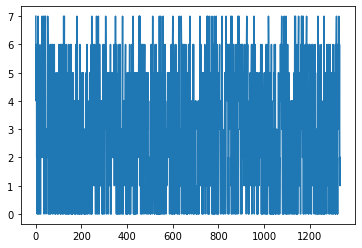

In [187]:
import numpy as np
from matplotlib import pyplot as plt
x=range(len(list(c1.keys())))
y=[int(np.mean(x)) for x in c1.values()]
print(x)
print(y)
plt.plot(x,y)
plt.show()



{0: 218, 2: 106, 6: 147, 3: 112, 4: 131, 7: 70, 5: 147, 1: 92}


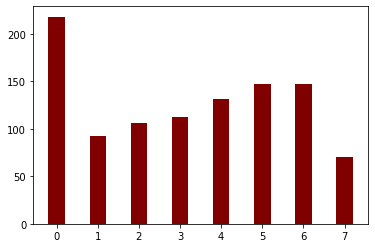

In [238]:
def plot_histogram(items):
    values = {}
    for x in items:
        values[x]=values.get(x,0)+1
    print(values)
    x_list = []
    y_list = []
    for x in values:
        x_list.append(x)
        y_list.append(values[x])
    plt.bar(x_list, y_list, color ='maroon',
        width = 0.4)
    plt.show()
y=[int(np.mean(x)) for x in c2.values()]
# y=[]
# for key in c1:
#     y.extend(c1[key])
    
plot_histogram(y)
    

In [10]:
nameplate_c1_set_mapping = {}
nameplate_c2_set_mapping = {}

for setno in set_nos:
    for nameplate in nameplate_database['Camera1'][setno]:
        nameplate_c1_set_mapping[nameplate]=setno

for setno in set_nos:
    for nameplate in nameplate_database['Camera2'][setno]:
        nameplate_c2_set_mapping[nameplate]=setno
complete_nameplate_set_mapping = {'Camera1':nameplate_c1_set_mapping,'Camera2':nameplate_c2_set_mapping}
# for key in c1:
#     z=int(np.mean(c1[key]))
#     if z==0:
#         print(key,nameplate_set_mapping[key.replace("-","").upper()])
    

In [11]:
def get_camera_sorted_nameplates(camera,c1,c2):
    c=None
    if camera =='Camera1':
        c=c1
    else:
        c=c2
    c_keys=[]
    for key in c:
        c_keys.append(key)
    return c_keys
c1_nameplates=get_camera_sorted_nameplates('Camera1',c1,c2)
c2_nameplates=get_camera_sorted_nameplates('Camera2',c1,c2)
print(len(c1))
print(len(c2))



1334
1023


In [14]:
def sample_nameplates(c_nameplates,num_nameplates,camera,nameplate_database,complete_nameplate_set_mapping):
    sampling_pool=list(range(len(c_nameplates)))
    import random
    count =0
    sampled_nameplates_list=[]
    while count<num_nameplates:
        x=random.choice(sampling_pool)
        nameplate_sampled = c_nameplates[x]
        setno=complete_nameplate_set_mapping[camera][nameplate_sampled.replace("-","").upper()]
        frame_info=nameplate_database[camera][setno][nameplate_sampled.replace("-","").upper()]
        char_info=[item[1] for item in frame_info]
#         print(char_info)
        num_frames = len(char_info)
        avg=np.mean(char_info)
        std=np.std(char_info)
#         print(avg,std)
        if(num_frames>7 and avg>=2 and std<5):
            sampling_pool.remove(x)
            count+=1
            sampled_nameplates_list.append((c_nameplates[x],x))
    sorted_nameplates_list=sorted(sampled_nameplates_list,key=lambda y:y[1])
    return [y[0] for y in sorted_nameplates_list]
    

def get_frames(c_nameplates,camera,nameplate_database,complete_nameplate_set_mapping):
    nameplate_frame_info = {}
    nameplate_char_info = {}
    for nameplate in c_nameplates:
        
        setno=complete_nameplate_set_mapping[camera][nameplate.replace("-","").upper()]
        frame_info=nameplate_database[camera][setno][nameplate.replace("-","").upper()]
        frame_ids=[item[0] for item in frame_info]
        char_info=[item[1] for item in frame_info]
        nameplate_frame_info[nameplate]=frame_ids
        nameplate_char_info[nameplate]=char_info
    return nameplate_frame_info,nameplate_char_info

c1_sampled=sample_nameplates(c1_nameplates,10,'Camera1',nameplate_database,complete_nameplate_set_mapping)
print(c1_sampled)
sampled_frame_info,sampled_char_info=get_frames(c1_sampled,'Camera1',nameplate_database,complete_nameplate_set_mapping)
for key in sampled_frame_info:
    print(key,sampled_frame_info[key])

        
        
    

['avh-6842', 'auy-1003', 'awu-3240', 'aws-2135', 'azb-2905', 'aom-5113', 'afx-0082', 'aru-6769', 'awn-4554', 'axz-9737']
avh-6842 ['565', '566', '567', '568', '569', '570', '571', '572', '573', '574']
auy-1003 ['13238', '13239', '13240', '13241', '13242', '13243', '13244', '13245', '13247']
awu-3240 ['14034', '14035', '14036', '14037', '14038', '14040', '14041', '14042', '14043']
aws-2135 ['18487', '18488', '18489', '18490', '18491', '18492', '18494', '18495', '18496']
azb-2905 ['22355', '22356', '22357', '22358', '22360', '22361', '22362', '22363', '22364']
aom-5113 ['26605', '26606', '26607', '26608', '26609', '26610', '26611', '26612', '26614']
afx-0082 ['28895', '28896', '28896', '28897', '28897', '28898', '28898', '28900', '28900', '28901', '28901', '28902', '28902', '28903', '28903']
aru-6769 ['29756', '29757', '29758', '29760', '29761', '29762', '29763', '29764', '29765']
awn-4554 ['30321', '30323', '30324', '30325', '30326', '30327', '30328', '30329']
axz-9737 ['32508', '32511'

In [17]:
def get_finish_timestamps(filename="./rl_configs/RL_Nameplate_Test/timing_statistic_0.stats"):
    contents=open(filename,'r').readlines()
    finish_timestamps = []
    for line in contents:
        task_info = line.split(" ")
        if task_info[0] == '0':
            finish_timestamps.append(float(task_info[3]))
    return finish_timestamps
finish_timestamps = get_finish_timestamps()
print(finish_timestamps)
                          

[38.926971, 68.707035]


In [18]:
import fractions
from math import ceil, gcd
from math import gcd
def lcm_func(a):
    lcm = 1
    for i in a:
        lcm = lcm*i//gcd(lcm, i)
    return(lcm)

def run_experiments(period_configuration,stats_file,c_sampled,num_nameplates,camera,nameplate_database,complete_nameplate_set_mapping):
    
#     c_sampled=sample_nameplates(c_nameplates,num_nameplates,camera,nameplate_database,complete_nameplate_set_mapping)
    sampled_frame_info,sampled_char_info=get_frames(c_sampled,camera,nameplate_database,complete_nameplate_set_mapping)
    id_to_nameplate = {}
    id_to_charinfo = {}
    frame_counter=0
    char_counter=0
    for key in sampled_frame_info:
        for frame in sampled_frame_info[key]:
            id_to_nameplate[frame_counter]=key
            frame_counter+=1
        for num_char in sampled_char_info[key]:
            id_to_charinfo[char_counter]=num_char
            char_counter+=1
#     print(frame_counter,char_counter)
    frame_timestamps=[]
    for f in range(frame_counter):
        frame_timestamps.append(33.33*f)
    total_num_frames = len(frame_timestamps)
#     print("FRAMES",len(frame_timestamps),frame_timestamps)
    hyperperiod=lcm_func(period_configuration)
#     print(hyperperiod)
    num_hyperperiods=int(frame_timestamps[-1]/hyperperiod)+1
#     print(num_hyperperiods)
    finish_timestamps = get_finish_timestamps(stats_file)
#     print(finish_timestamps)
    nameplate_task_timestamps=[]
    for i in range(num_hyperperiods):
        for f in finish_timestamps:
            nameplate_task_timestamps.append(i*hyperperiod+f)
#     print("TASKS",nameplate_task_timestamps)
    counter = 0
    final_counter_info = []
    final_timestamps = {}
    for nt in nameplate_task_timestamps:
        while counter < total_num_frames and frame_timestamps[counter]<nt  :
            counter+=1
#         print(counter,frame_timestamps[counter-1],nt)
        if counter < len(id_to_nameplate):
            final_counter_info.append(counter)
            final_timestamps[counter]=nt
#     print(final_counter_info,id_to_nameplate)
    detected_info = {}
    for c in final_counter_info:
        detected_info[c]=(id_to_nameplate[c],id_to_charinfo[c],final_timestamps[c])
#         print(id_to_nameplate[c],id_to_charinfo[c])
#     print(detected_info)
    return detected_info
    
    
            
c_sampled=sample_nameplates(c1_nameplates,10,'Camera1',nameplate_database,complete_nameplate_set_mapping)   
period_configuration=[110, 165, 165]
stats_file="./rl_configs/RL_Nameplate_Test/timing_statistic_1.stats"
output=run_experiments(period_configuration,stats_file,c_sampled,10,'Camera1',nameplate_database,complete_nameplate_set_mapping)
print(output)

{2: ('aue-7343', 5, 38.926971), 3: ('aue-7343', 7, 68.707035), 5: ('aue-7343', 7, 147.598501), 6: ('aue-7343', 7, 194.30797), 8: ('aue-7343', 7, 257.598501), 9: ('dnb-0172', 7, 288.707035), 12: ('dnb-0172', 7, 398.707035), 15: ('dnb-0172', 6, 477.598501), 16: ('dnb-0172', 6, 524.3079700000001), 18: ('dnb-0172', 3, 587.5985009999999), 19: ('dnb-0172', 3, 618.707035), 21: ('dnb-0172', 3, 698.926971), 22: ('asz-5959', 1, 728.707035), 25: ('asz-5959', 6, 807.5985009999999), 26: ('asz-5959', 0, 854.3079700000001), 28: ('asz-5959', 0, 917.5985009999999), 29: ('asz-5959', 7, 948.707035), 31: ('apv-1336', 6, 1028.926971), 32: ('apv-1336', 6, 1058.707035), 35: ('apv-1336', 4, 1137.598501), 36: ('apv-1336', 6, 1184.30797), 38: ('apv-1336', 7, 1247.598501), 39: ('aob-3994', 3, 1278.707035), 41: ('aob-3994', 0, 1358.926971), 42: ('aob-3994', 0, 1388.707035), 45: ('aob-3994', 0, 1467.598501), 46: ('aob-3994', 6, 1514.30797), 48: ('axi-3262', 6, 1577.598501), 49: ('axi-3262', 6, 1608.707035), 51: ('

In [ ]:
common_nameplates = ['hgk-3399', 'avb-8063', 'alm-1068', 'jic-6003', 'bch-1817', 'azz-6864', 'arp-9242', 'akk-9884', 'awr-2818', 'amy-7468', 'flo-5416', 'apv-8603', 'anq-8126', 'axt-8664', 'axg-3492', 'ayj-4631', 'opy-7476', 'hxr-2568', 'apf-3694', 'akj-0818', 'fmm-9230', 'ayb-1663', 'awb-8291', 'ayv-5843', 'aca-3377', 'azm-0851', 'avq-2147', 'axu-9778', 'aye-9948', 'axl-3584', 'agw-6469', 'awv-8053', 'njz-3326', 'ayg-4713', 'mfu-0390', 'aol-3111', 'axj-6801', 'axu-7702', 'axp-6595', 'azk-5843', 'atb-5495', 'bcv-1103', 'eyk-0238', 'awf-5786', 'ayj-0158', 'ayy-8033', 'ayg-0330', 'aie-6383', 'baa-1962', 'bas-1279', 'avq-2185', 'agc-3727', 'agb-6644', 'maz-5230', 'azf-8031', 'ayc-5356', 'ayy-4392', 'asz-5718', 'asm-7213', 'arp-9635', 'avu-7254', 'awt-2125', 'ars-5402', 'asx-2868', 'atn-3763', 'aog-7062', 'bad-8400', 'avv-3470', 'asp-3386', 'awa-9325', 'adz-7773', 'aec-1444', 'ava-3265', 'asp-3857', 'asg-4999', 'aoa-1762', 'azj-8996', 'arx-9698', 'aup-9522', 'axp-0639', 'aln-7111', 'azc-9139', 'mbm-7222', 'axr-5133', 'arv-9922', 'aix-0049', 'avx-4023', 'ayo-2049', 'iwm-5024', 'avv-2847', 'arx-8757', 'awt-9513', 'ayd-2258', 'awv-5010', 'abw-4462', 'arj-6096', 'ili-1919', 'atl-6222', 'olf-0484', 'axy-3722', 'atf-1522', 'alf-9374', 'asu-6516', 'axx-3149', 'aoo-1903', 'axt-8589', 'art-0507', 'anz-7866', 'aaa-7756', 'auy-8720', 'axi-3262', 'ayh-7449', 'dqo-9278', 'bep-0207', 'arl-0557', 'aue-0705', 'azi-9960', 'axu-2907', 'axy-7315', 'avb-2306', 'axg-4984', 'auo-3266', 'ame-4529', 'dcf-7991', 'ayn-4102', 'auo-7996', 'ayi-8682', 'eiy-1268', 'amn-6544', 'awv-3807', 'mzg-9088', 'avo-2683', 'mkr-3112', 'jlu-9781', 'axs-7317', 'alx-8674', 'aum-1017', 'ari-5784', 'ato-3326', 'aqm-7059', 'atu-1477', 'amt-5148', 'auk-5364', 'avp-3274', 'ajx-6947', 'aur-6501', 'mjv-1783', 'aov-7938', 'alg-5111', 'awe-8560', 'aou-9901', 'alt-8490', 'agj-4392', 'axb-1198', 'atb-9367', 'iwm-0090', 'aed-6155', 'ask-8589', 'aeh-1968', 'ats-3859', 'arc-0208', 'auq-0258', 'aqh-9146', 'azd-6461', 'bee-2386', 'bel-5130', 'atg-3785', 'avh-6842', 'axv-5392', 'asz-4901', 'pux-4461', 'bdi-1820', 'avw-6796', 'aku-5843', 'aoa-9736', 'ays-2811', 'axp-9310', 'avv-2698', 'aja-3546', 'axv-1204', 'mim-6407', 'aue-2414', 'awc-2384', 'aun-5679', 'awq-3718', 'axl-5299', 'avz-8018', 'awu-2173', 'oyk-3390', 'atk-3801', 'axo-6369', 'aup-1696', 'awd-2917', 'axu-3221', 'bdu-1210', 'ayp-5873', 'aus-1730', 'azd-1907', 'asx-8521', 'axx-2436', 'ake-9113', 'aux-0342', 'asj-8881', 'aoa-2717', 'aqb-0838', 'adr-4354', 'asl-0042', 'atu-9776', 'com-2666', 'alo-9716', 'aug-8898', 'ayl-6529', 'ajh-0477', 'aul-9250', 'mgj-3300', 'olx-5486', 'bdj-0811', 'axz-7929', 'auh-6993', 'avp-3641', 'atc-1182', 'atu-2377', 'dmr-1104', 'ajy-0700', 'awx-7287', 'avd-1921', 'asx-8477', 'ffs-7259', 'avk-6686', 'mjm-2772', 'axz-4196', 'apr-5261', 'atz-9871', 'apz-0990', 'min-0546', 'ash-7803', 'aub-6274', 'axd-2251', 'lvo-3467', 'aup-3768', 'awf-8275', 'ang-4913', 'mfk-7531', 'ayk-4615', 'aws-8073', 'axv-3976', 'jke-6468', 'axv-8608', 'axp-5168', 'ava-3159', 'axk-4460', 'avz-8158', 'avp-8945', 'auq-3681', 'aut-1457', 'axx-1612', 'axx-7094', 'ava-3417', 'bds-7377', 'awb-8548', 'akl-8389', 'aui-5309', 'atk-0372', 'dnu-9157', 'kqf-2289', 'ijm-7201', 'asw-2388', 'aqc-4576', 'jzc-8172', 'ayh-2075', 'afz-6384', 'buq-2247', 'exy-8215', 'aza-1439', 'ath-3307', 'ccf-8007', 'avo-5611', 'cni-4301', 'aup-6455', 'hdk-6625', 'asg-3546', 'axc-9549', 'atk-5450', 'dkg-8700', 'aex-8880', 'hxx-0902', 'drw-9884', 'avm-5718', 'arr-5581', 'aut-8812', 'atn-5527', 'ndr-3239', 'aul-7908', 'qhd-4277', 'avn-1413', 'asz-5882', 'aju-4377', 'amt-7590', 'asd-8431', 'ayg-3842', 'axh-7320', 'ayw-5070', 'auj-6409', 'mev-5203', 'dzc-2608', 'ayc-7095', 'axl-7935', 'alx-4337', 'auj-5916', 'aru-6769', 'ayb-5933', 'amm-1775', 'awq-3536', 'cub-8450', 'awf-2545', 'avc-6459', 'atx-9637', 'azk-6352', 'ayq-9328', 'mlr-5782', 'avd-2146', 'atn-4288', 'axm-4905', 'ben-1649', 'ate-3369', 'asz-2075', 'auy-3629', 'awy-7326', 'bbs-0703', 'agi-9430', 'ash-5937', 'bbb-5773', 'ays-6350', 'atn-8301', 'axo-9712', 'axi-5838', 'ayq-1680', 'lyn-3452', 'axv-5168', 'awc-3005', 'ake-4178', 'iso-8360', 'awy-8641', 'baj-2278', 'asz-2631', 'anz-7873', 'awn-2437', 'aqt-1803', 'aii-9292', 'amh-8796', 'ate-2805', 'azc-4590', 'ato-1660', 'aww-5799', 'eiq-8844', 'awz-5232', 'aud-9206', 'axa-1498', 'hhr-4551', 'afo-9011', 'bdy-4848', 'akp-9191', 'bct-1400', 'ang-5378', 'miq-6196', 'axp-6981', 'ipo-7305', 'auf-5870', 'opq-1452', 'avn-9953', 'ays-5083', 'auk-4508', 'aka-4371', 'aro-2475', 'axu-0206', 'aja-5941', 'atu-1107', 'bcv-0676', 'axc-6452', 'axk-0282', 'ayf-7663', 'hog-3484', 'aes-7627', 'aun-6110', 'ans-8806', 'aoa-2661', 'aoi-0580', 'duh-5966', 'acz-1215', 'v-0290', 'anl-9814', 'aob-0789', 'aug-8890', 'aqe-3993', 'gem-0025', 'mhv-3549', 'eis-2271', 'aze-9076', 'asy-0793', 'edf-9461', 'arb-4423', 'auz-9865', 'mim-8875', 'alk-7227', 'axi-7955', 'ayg-0639', 'axx-0691', 'aws-9780', 'czl-4171', 'ajk-0098', 'apv-2191', 'din-0021', 'axz-3531', 'dnb-0172', 'ayk-6945', 'amz-0381', 'auh-5983', 'arf-6022', 'ayk-4073', 'ayi-9058', 'age-8131', 'apv-2379', 'att-6526', 'ayf-8434', 'avv-9383', 'bds-1018', 'bap-5225', 'awn-2563', 'ayf-3524', 'ayw-7840', 'alc-9519', 'akq-6730', 'asw-5286', 'azk-3521', 'ani-0095', 'axg-7934', 'miy-7558', 'apl-2912', 'ekq-5424', 'fke-3040', 'ali-0499', 'bcc-0131', 'ayg-6177', 'ayq-3846', 'asr-3246', 'axp-3748', 'aws-9294', 'api-3192', 'auh-0434', 'dug-1286', 'aue-7343', 'aqk-5686', 'gzh-5473', 'asy-8412', 'ali-5173', 'ami-7880', 'asv-8387', 'ayx-9658', 'axp-4821', 'arw-7358', 'arb-9835', 'kzd-0762', 'aeq-4747', 'asz-8747', 'ass-4998', 'axy-2556', 'aua-6287', 'aon-2882', 'arv-5433', 'atx-7607', 'awn-1323', 'nfy-8264', 'hnh-0322', 'aze-3865', 'aww-8208', 'aha-5376', 'ayd-1477', 'axs-3516', 'axy-2056', 'axv-0882', 'aoi-6507', 'nwy-8611', 'aml-0036', 'arw-9796', 'mjf-6651', 'ajk-9991', 'asm-5490', 'hmr-9029', 'awa-2526', 'auj-1763', 'bes-7722', 'amw-8301', 'bby-1888', 'aom-8867', 'asn-0614', 'ayy-5181', 'auv-1008', 'arv-6090', 'asf-9304', 'iln-8000', 'dda-6698', 'ayz-3397', 'arj-1497', 'aym-8391', 'krn-1403', 'awz-9793', 'apy-7367', 'bbr-1936', 'axw-3665', 'aob-1535', 'aop-1014', 'aze-9745', 'axb-3538', 'awj-2021', 'auf-8340', 'ame-8160', 'arz-2587', 'hsj-5512', 'auj-3708', 'ayp-6582', 'aty-1811', 'awj-1592', 'akc-7557', 'aue-9608', 'awr-8969', 'akk-2137', 'aux-2597', 'aqw-3871', 'aqo-9117', 'aus-1729', 'mcs-1314', 'mfd-8925', 'amm-5079', 'mii-1381', 'acc-0017', 'auf-8339', 'pvg-0968', 'ieb-8755', 'asa-7082', 'arc-2575', 'bcl-1712', 'arg-1383', 'avz-2864', 'fda-6093', 'amn-9026', 'ayu-5996', 'axx-8937', 'avj-2656', 'bdy-1002', 'axp-6889', 'axr-3960', 'aze-9257', 'avz-1536', 'mdb-0841', 'odw-2934', 'avt-8972', 'avn-4768', 'bak-1521', 'asu-1423', 'axw-5771', 'mmm-8082', 'ano-9054', 'awg-9552', 'amz-2753', 'auk-6846', 'atg-0706', 'aye-4753', 'agm-5037', 'mih-8767', 'awy-0642', 'ayq-1890', 'bbe-9100', 'azi-8214', 'alg-1239', 'auw-4859', 'arh-4334', 'alw-2999', 'axr-5192', 'art-0149', 'mfb-0453', 'bbz-0410', 'mjw-4857', 'awo-1054', 'acs-8011', 'ine-8211', 'awc-7813', 'ayc-7312', 'anu-3602', 'avv-9883', 'ayb-5619', 'awp-3264', 'asq-4354', 'anz-7865', 'avz-7167', 'maa-0464', 'amf-3495', 'aqg-0703', 'ath-6498', 'aup-2915', 'arc-5452', 'ahi-9977', 'awc-9648', 'fah-3138', 'asc-6217', 'axq-5920', 'aub-8330', 'jkn-4884', 'api-9748', 'ayh-8531', 'afj-7453', 'apq-5615', 'alk-5567', 'atv-5947', 'axw-9560', 'apw-6536', 'ask-9864', 'amg-6175', 'ayn-3712', 'age-2705', 'mft-1466', 'mka-8202', 'ayh-2847', 'ata-7692', 'beb-0213', 'atq-3162', 'aur-7456', 'aue-6478', 'aoj-3617', 'aok-3037', 'awn-4554', 'avs-2566', 'awb-4298', 'avu-2648', 'auw-7589', 'bbm-0282', 'ayk-3931', 'bam-0196', 'auf-8827', 'axq-9736', 'asu-9186', 'aul-8792', 'aok-7505', 'aob-3994', 'adr-8732', 'aso-4778', 'aqy-2334', 'elc-4061', 'amn-7114', 'lpy-9149', 'auo-3593', 'awi-8981', 'pum-0966', 'ayh-9794', 'lcw-1636', 'avu-3761', 'asm-1325', 'aue-6873', 'aug-7865', 'awv-9043', 'auf-2796', 'ark-4829', 'ami-1174', 'aom-5113', 'auk-2671', 'bel-3114', 'ebx-3935', 'mfl-7277', 'mcj-2715', 'bdu-0028', 'auy-7615', 'akz-5316', 'amz-9945', 'iqm-8664', 'axa-6701', 'awi-2174', 'ayg-7883', 'asv-4532', 'mhq-7009', 'apy-6924', 'amb-5427', 'ayr-4067', 'auw-0246', 'aty-5169', 'ayk-3384', 'atv-8950', 'aqn-0345', 'bba-3822', 'avy-7819', 'axc-4245', 'aaw-8473', 'awc-3077', 'man-9250', 'beo-2302', 'atq-8872', 'axa-7732', 'axr-4771', 'awb-0652', 'aqu-1803', 'ayu-1773', 'auh-5284', 'aoa-9732', 'iqe-8520', 'alf-7073', 'epw-8746', 'elx-1607', 'axb-8153', 'avu-6933', 'mjd-8353', 'awj-2847', 'csu-0496', 'awh-3435', 'arl-5515', 'jnw-6455', 'agk-3636', 'avs-6171', 'ano-4218', 'cwe-2555', 'ezc-2012', 'asp-2176', 'anz-7869', 'aye-6834', 'aty-5754', 'nbv-8451', 'bdr-2711', 'ayq-5349', 'avt-8796', 'arv-4798']

In [369]:
# c_sampled=sample_nameplates(c2_nameplates,30,'Camera2',nameplate_database,complete_nameplate_set_mapping)   
c_sampled=['hnh-0322', 'awb-4298', 'bdu-0028', 'amg-7343', 'arv-5433', 'jkn-4884', 'dkg-8700', 'ayd-2258', 'auf-6294', 'ffs-7259']
print(c_sampled)
period_configurations=[[110, 110, 110], [80, 160, 160], [55, 110, 110], [40, 160, 160]]
stats_files=["./rl_configs/RL_Nameplate_Test/timing_statistic_4.stats","./rl_configs/RL_Nameplate_Test_1/timing_statistic_7.stats","./rl_configs/RL_Nameplate_Test/timing_statistic_0.stats","./rl_configs/RL_Nameplate_Test_1/timing_statistic_3.stats"]
detected_info_runs = []
for i in range(0,4):
    detected_info_runs.append(run_experiments(period_configurations[i],stats_files[i],c_sampled,10,'Camera2',nameplate_database,complete_nameplate_set_mapping))




['hnh-0322', 'awb-4298', 'bdu-0028', 'amg-7343', 'arv-5433', 'jkn-4884', 'dkg-8700', 'ayd-2258', 'auf-6294', 'ffs-7259']


In [463]:
def examine_chars_detected(detected_info):
    detection_results = {}
    for value in detected_info.values():
        nameplate,num_chars,_ = value
        if nameplate not in detection_results:
            detection_results[nameplate]=[]
        detection_results[nameplate].append(num_chars)
    return detection_results

sample=examine_chars_detected(detected_info_runs[0])
s=0
nameplate_fully_detected=0
num_samples=0
for key in sample:
    print(key,max(sample[key]))
    num_samples+=len(sample[key])
    s+=max(sample[key])
    if max(sample[key]) == 7:
        nameplate_fully_detected+=1
print(nameplate_fully_detected)
# print(s,num_samples)

    
    

ValueError: not enough values to unpack (expected 3, got 2)

In [ ]:
axr-4771 5
anl-9814 5
avu-0493 5
avm-3172 7
aty-5169 6
aty-1811 3
nql-5754 6
epk-3750 7
azz-6864 5
ayy-8033 0
ayf-8434 5
aqr-0574 7
pum-0966 7

------------------

asy-0309 6
azd-5499 7
alf-9374 1
axr-5192 7
afr-1257 7
auy-3629 7
ayq-1680 6
bbm-5544 6
aes-7627 7
arl-5515 7
amg-7343 7
asx-7285 7
mim-6407 6
opy-7476 7
bbr-1936 7
axt-8664 6
bba-3822 6
avp-3641 7
bbb-5773 7
hog-3484 4
aro-2475 7
axt-6376 7
alf-7073 7
ayb-5619 7
aog-7062 6
hhr-4551 7
eis-2271 6
awx-7287 7
atk-3801 7
axn-0078 7
nfy-8264 7
axu-8491 7
aom-5113 6
asv-1282 7
anq-1652 7
anj-1940 7
bdy-1002 7
awv-8053 7
azc-4590 7
avn-9953 7
------------------------
ayk-6770 7
apl-2912 7
bas-1279 6
axu-9778 7
acz-1215 7
ine-8211 6
axc-3964 7
fda-6093 6
ayt-5314 7
avu-6933 7
afr-1257 7
ano-9054 7
ayq-1680 6
eiq-0537 5
bbm-5544 7
awc-3005 7
aoa-2661 7
auj-1763 7
asq-4354 6
avx-2835 7
atl-6222 6
awg-7209 7
avy-7819 7
axt-4862 7
asu-9186 5
ayp-7810 7
atr-3077 7
amk-2777 7
mcs-1314 7
auf-6294 7
arc-2629 7
awy-7326 7
pvg-0968 7
qhd-4277 6
mee-1166 7
awy-0642 7
awh-3435 7
aws-8073 7
auw-4498 7
kqf-2289 6
-------------
pux-4461 7
aus-1730 7
ndr-3239 5
anl-9814 7
bao-1330 6
dda-6698 7
axs-3516 7
asr-3246 7
aue-7343 7
asj-9062 7
arl-5515 7
aoj-9388 6
axp-9310 6
aul-9250 7
axq-9736 6
azj-1159 7
any-8865 7
pvp-4305 7
auq-0258 6
fqe-7574 6
azk-8204 7
avg-6609 7
akp-9191 5
aut-8812 6
aln-2225 7
asx-8521 7
ajw-2120 6
awj-2021 6
ahy-2134 7
dzc-2608 6
atg-3785 7
awz-7644 7
epk-3750 7
azb-2401 7
ary-0850 7
are-6644 7
ayf-8434 7
awj-3322 7
auv-1008 7
duc-9755 5

10 CARS
--------

C1 
['awn-2437', 'avu-0493', 'dnb-0172', 'arw-9796', 'awq-3718', 'ipo-7305', 'aol-7489', 'lcw-1636', 'axy-3722', 'ali-0499']
3 --> 6 [110,110,110]*
4 --> 6

C2
['hnh-0322', 'awb-4298', 'bdu-0028', 'amg-7343', 'arv-5433', 'jkn-4884', 'dkg-8700', 'ayd-2258', 'auf-6294', 'ffs-7259']

4 --> 7

20 CARS
-------
C1

['axr-4771', 'mjv-1783', 'ajk-5467', 'ayg-7883', 'auy-3629', 'ash-5937', 'aqp-4406', 'lpy-9149', 'awi-3228', 'akc-7359', 'fke-3040', 'avu-9622', 'axg-4984', 'awb-8291', 'aha-5376', 'arc-0208', 'azc-8063', 'awn-4554', 'atg-8925', 'awd-2933']
8 -- > 14

C2

12 --> 15

['mki-2628', 'awh-3029', 'apv-8603', 'ajy-0700', 'amg-7343', 'awn-2756', 'ayc-7312', 'amb-5427', 'axc-9549', 'bdi-0021', 'asw-2388', 'mft-1466', 'axo-1086', 'jke-6468', 'arc-0208', 'awn-4554', 'avs-6171', 'ask-8589', 'awy-0642', 'asm-5490']

30 CARS
-------
C1

['awn-2437', 'atl-6524', 'awi-5582', 'mjv-1783', 'aoa-2661', 'duh-5966', 'aug-7865', 'ava-3159', 'axy-1919', 'bak-0042', 'aws-2135', 'atv-8950', 'axe-6250', 'azg-3589', 'avz-2864', 'ara-3310', 'ava-3265', 'aty-1811', 'amt-6430', 'afi-0484', 'aic-3532', 'awp-3264', 'afk-7069', 'amc-0518', 'ayy-8033', 'aax-2860', 'awd-2933', 'aml-9372', 'mjb-9858', 'ayn-7661']

16 --> 23

C2
['afo-9011', 'baa-1962', 'lyn-3452', 'bev-0108', 'axp-4821', 'axp-6595', 'amd-5693', 'atk-0372', 'asx-7285', 'axx-8139', 'jzc-8172', 'awq-3718', 'ayi-4294', 'ekq-5424', 'agk-3636', 'atk-3801', 'atn-8301', 'aoj-3617', 'bcm-9188', 'eij-7045', 'avd-2146', 'alk-7227', 'aur-7456', 'aze-3865', 'asv-1282', 'avd-1921', 'auj-6409', 'ayf-8434', 'awy-0642', 'asm-1325']

13 --> 20

['awe-8560', 'eac-7107', 'axg-3492', 'apv-8603', 'mlz-1463', 'aqh-9146', 'aso-4778', 'aln-7111', 'ash-5937', 'opq-1452', 'aju-4377', 'aqu-1803', 'art-0507', 'aze-9076', 'aud-3851', 'alk-5567', 'awx-7287', 'asz-2075', 'amn-7114', 'axi-7955', 'aqx-1913', 'anu-3602', 'mjw-4857', 'mfl-7277', 'bam-0196', 'dzc-2608', 'ayg-2189', 'aha-5376', 'auk-5364', 'ath-3307']

17 --> 22

['axy-4136', 'ays-5083', 'bep-0207', 'ajy-0700', 'axl-3584', 'dda-6698', 'its-6444', 'amg-7343', 'ayv-2256', 'opq-1452', 'arv-5433', 'ayn-3672', 'avn-4768', 'aug-8898', 'ben-1649', 'ayw-4212', 'ayg-0639', 'ato-6241', 'ash-7803', 'dkg-8700', 'bam-0196', 'hdk-6625', 'axg-7934', 'aur-7456', 'awj-2847', 'jke-6468', 'lux-9860', 'ask-8589', 'mee-1166', 'aws-8073']

17 --> 25 [110,110,110]*



In [12]:
c1_set = set(c1_nameplates)
c2_set = set(c2_nameplates)
common_nameplates=list(c1_set.intersection(c2_set))
print(common_nameplates)

['aoa-1762', 'mjf-6651', 'agb-6644', 'ani-0095', 'mjw-4857', 'axz-4196', 'axv-0882', 'auh-5983', 'ayk-3931', 'awd-2917', 'axu-7702', 'atn-4288', 'azm-0851', 'aze-9076', 'awb-8548', 'mcj-2715', 'axu-3221', 'avn-9953', 'ayd-2258', 'auo-3266', 'ate-3369', 'axq-9736', 'ayb-5933', 'axy-2556', 'awv-5010', 'azi-9960', 'ayj-4631', 'mzg-9088', 'apv-2379', 'bbz-0410', 'ayb-5619', 'aoa-9732', 'nbv-8451', 'aww-8208', 'mkr-3112', 'ili-1919', 'akk-9884', 'aue-7343', 'dnb-0172', 'bas-1279', 'axb-8153', 'arp-9242', 'aug-8898', 'age-2705', 'auk-5364', 'alx-4337', 'axp-9310', 'fda-6093', 'iqe-8520', 'awg-9552', 'ayk-6945', 'axp-3748', 'avz-1536', 'alg-1239', 'axl-5299', 'aoj-3617', 'ieb-8755', 'aju-4377', 'auf-8827', 'aye-9948', 'aup-3768', 'axz-3531', 'avo-5611', 'axy-2056', 'ayr-4067', 'mii-1381', 'bdu-1210', 'apr-5261', 'avo-2683', 'aex-8880', 'adr-4354', 'ars-5402', 'eyk-0238', 'aoi-6507', 'avw-6796', 'mhq-7009', 'aul-9250', 'nwy-8611', 'axa-6701', 'awz-9793', 'asw-5286', 'asd-8431', 'mjm-2772', 'ay

In [48]:
c_sampled=sample_nameplates(common_nameplates,20,'Camera2',nameplate_database,complete_nameplate_set_mapping)   
# c_sampled=['fmm-9230', 'agc-3727', 'bad-8400', 'arv-9922', 'axy-3722', 'azi-9960', 'jlu-9781', 'auq-0258', 'pux-4461', 'axh-7320', 'aug-8890', 'dnb-0172', 'aha-5376', 'ayd-1477', 'mfd-8925', 'ayb-5619', 'apw-6536', 'elc-4061', 'avu-6933', 'awh-3435']
# c_sampled=['aso-4778', 'krn-1403', 'aup-6455', 'awf-2545', 'avp-3274', 'avx-4023', 'asm-1325', 'awr-8969', 'ata-7692', 'pux-4461', 'nfy-8264', 'aja-5941', 'ayg-3842', 'azc-9139', 'mgj-3300', 'avz-2864', 'mhq-7009', 'axr-5133', 'dzc-2608', 'ayc-7312']
# c_sampled=['hnh-0322', 'awb-4298', 'bdu-0028', 'amg-7343', 'arv-5433', 'jkn-4884', 'dkg-8700', 'ayd-2258', 'auf-6294', 'ffs-7259']
# c_sampled=['arz-2587', 'bel-5130', 'apy-6924', 'avt-8796', 'aqb-0838', 'ekq-5424', 'auy-8720', 'eiq-8844', 'aom-5113', 'aqu-1803', 'aue-0705', 'acs-8011', 'axp-6889', 'awr-8969', 'alk-7227', 'aup-1696', 'amw-8301', 'baa-1962', 'axg-4984', 'agj-4392']
c1_list=list(c1.keys())
c2_list=list(c2.keys())
c1_sampled=list(set(c1_list).intersection(c_sampled))
c2_sampled=list(set(c2_list).intersection(c_sampled))
print(c1_sampled)
print("-------")
print(c2_sampled)
sampled_frame_info_1,sampled_char_info_1=get_frames(c1_sampled,'Camera1',nameplate_database,complete_nameplate_set_mapping)
sampled_frame_info_2,sampled_char_info_2=get_frames(c2_sampled,'Camera2',nameplate_database,complete_nameplate_set_mapping)

# print(sampled_frame_info_1)
# print("---------------------")
# print(sampled_frame_info_2)
# c_sampled=['hnh-0322', 'awb-4298', 'bdu-0028', 'amg-7343', 'arv-5433', 'jkn-4884', 'dkg-8700', 'ayd-2258', 'auf-6294', 'ffs-7259']

period_configurations=[[110, 110, 110], [80, 160, 160], [55, 110, 110], [40, 160, 160]]
stats_files=["./rl_configs/RL_Nameplate_Test/timing_statistic_4.stats","./rl_configs/RL_Nameplate_Test_1/timing_statistic_7.stats","./rl_configs/RL_Nameplate_Test/timing_statistic_0.stats","./rl_configs/RL_Nameplate_Test_1/timing_statistic_3.stats"]
detected_info_runs_c1 = []
detected_info_runs_c2 = []
for i in range(0,4):
    detected_info_runs_c1.append(run_experiments(period_configurations[i],stats_files[i],c1_sampled,20,'Camera1',nameplate_database,complete_nameplate_set_mapping))
    detected_info_runs_c2.append(run_experiments(period_configurations[i],stats_files[i],c2_sampled,20,'Camera2',nameplate_database,complete_nameplate_set_mapping))


['jnw-6455', 'agb-6644', 'bba-3822', 'aso-4778', 'awc-9648', 'ask-8589', 'axg-4984', 'aty-5754', 'asm-7213', 'aoj-3617', 'axp-6595', 'aty-1811', 'mfk-7531', 'axi-5838', 'mii-1381', 'mim-8875', 'akz-5316', 'agc-3727', 'akl-8389', 'ake-4178']
-------
['jnw-6455', 'agb-6644', 'bba-3822', 'aso-4778', 'awc-9648', 'ask-8589', 'axg-4984', 'aty-5754', 'asm-7213', 'aoj-3617', 'axp-6595', 'aty-1811', 'mfk-7531', 'axi-5838', 'mii-1381', 'mim-8875', 'akz-5316', 'agc-3727', 'akl-8389', 'ake-4178']


In [82]:
len(['jnw-6455', 'agb-6644', 'bba-3822', 'aso-4778', 'awc-9648', 'ask-8589', 'axg-4984', 'aty-5754', 'asm-7213', 'aoj-3617', 'axp-6595', 'aty-1811', 'mfk-7531', 'axi-5838', 'mii-1381', 'mim-8875', 'akz-5316', 'agc-3727', 'akl-8389', 'ake-4178'])

20

In [30]:
# print(detected_info_runs_c1)
sample_c1=examine_chars_detected(detected_info_runs_c1[0])
sample_c2=examine_chars_detected(detected_info_runs_c2[3])
# print(sample_c1.keys(),sample_c2.keys())
s=0
nameplate_fully_detected_c1=0
nameplate_fully_detected_c2=0
num_samples=0
for key in sample_c1:
    print(key)
    print(sample_c1[key])
    if max(sample_c1[key])==7:
        nameplate_fully_detected_c1+=1
    if max(sample_c2[key])==7:
        nameplate_fully_detected_c2+=1
    print(sample_c2[key])
print(c_sampled)    
print(nameplate_fully_detected_c1,nameplate_fully_detected_c2)

NameError: name 'examine_chars_detected' is not defined

In [80]:
def prepare_data_step_plot(detected_info):
    detection_results = {}
    x=[]
    y=[]
    car_timestamps = []
    curr_nameplate = ""
    curr_num_chars = 0
    counter = 0
    distinct_plates = set()
    for value in detected_info.values():
        nameplate,num_chars,timestamp = value
        distinct_plates.add(nameplate)
#         print('absolute',nameplate)
#         print('curr',curr_nameplate)
        if curr_nameplate != nameplate:
            counter +=1
            curr_num_chars=num_chars
            curr_nameplate = nameplate
            car_timestamps.append(timestamp)
            print(counter,curr_nameplate,timestamp)
        x.append(timestamp)
        y.append(max(curr_num_chars,num_chars))
        curr_num_chars = max(curr_num_chars,num_chars)
    print("number of cars",len(list(distinct_plates)),distinct_plates)
                
    return x,y,car_timestamps

def prepare_data_line_plot(detected_info):
    x=[]
    y=[]
    for value in detected_info.values():
        nameplate,num_chars,timestamp = value
        x.append(timestamp)
        y.append(num_chars)
    return x,y
    
    

1 jnw-6455 62.818437
2 agb-6644 612.818437
3 bba-3822 942.818437
4 aso-4778 1052.818437
5 awc-9648 1382.818437
6 ask-8589 1492.818437
7 axg-4984 1602.818437
8 aty-5754 1822.818437
9 asm-7213 2152.818437
10 aoj-3617 2482.818437
11 axp-6595 2812.818437
12 aty-1811 3032.818437
13 mfk-7531 3252.818437
14 axi-5838 3472.818437
15 mii-1381 3582.818437
16 mim-8875 3802.818437
17 akz-5316 4132.818437
18 agc-3727 4242.818437
19 ake-4178 4572.818437
number of cars 19 {'jnw-6455', 'agb-6644', 'bba-3822', 'aso-4778', 'awc-9648', 'ask-8589', 'axg-4984', 'aty-5754', 'asm-7213', 'aoj-3617', 'axp-6595', 'aty-1811', 'mfk-7531', 'axi-5838', 'mii-1381', 'mim-8875', 'akz-5316', 'agc-3727', 'ake-4178'}
[62.818437, 172.81843700000002, 282.818437, 392.818437, 502.818437, 612.818437, 722.818437, 832.818437, 942.818437, 1052.818437, 1162.818437, 1272.818437, 1382.818437, 1492.818437, 1602.818437, 1712.818437, 1822.818437, 1932.818437, 2042.818437, 2152.818437, 2262.818437, 2372.818437, 2482.818437, 2592.818437,

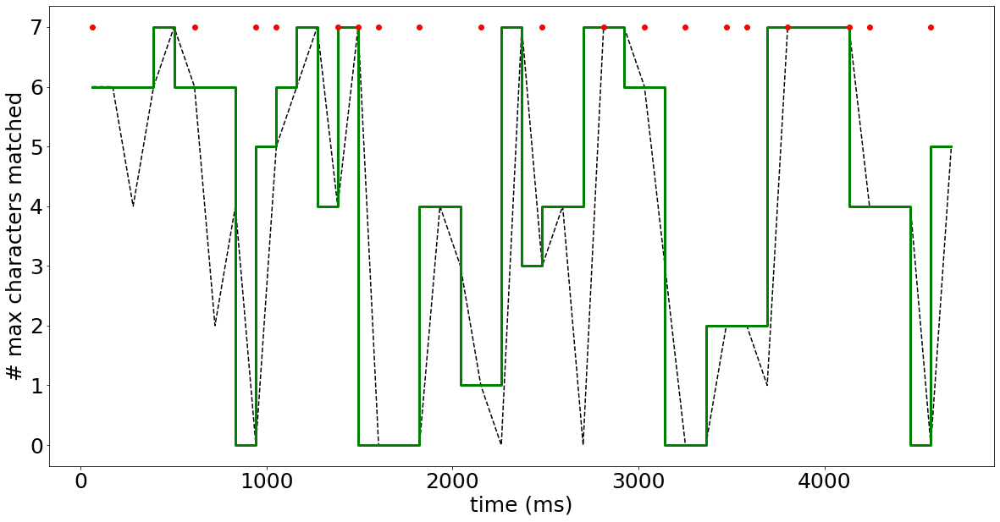

In [81]:
c1_step_data=prepare_data_step_plot(detected_info_runs_c1[0])
plt.rcParams['figure.figsize'] = [20, 10]
x1,y1,car_timestamps=c1_step_data
sampled_x,sampled_y=prepare_data_line_plot(detected_info_runs_c1[0])
plt.plot(sampled_x,sampled_y,color='black',linestyle='dashed')
#horizontal plot of sampled timestamps
# horizontal_x=x1
# horizontal_y=[3]*len(x1)
#vertical lines for each sampled timestamp
# plt.plot(horizontal_x,horizontal_y,marker='x')
# for xval in x1:
#     plt.axvline(x = xval, color = 'r', linestyle='dashed',label = 'axvline - full height')
plt.step(x1,y1,color='green',linewidth=3.0)
plt.yticks(fontsize=25)
plt.xticks(fontsize=25)
for arrived_car in car_timestamps:
    plt.plot(arrived_car,7,'ro') 

plt.ylabel('# max characters matched',fontsize=25)
plt.xlabel('time (ms)',fontsize=25)



print(x1)
print(y1)
plt.show()

[55.471793, 93.707035, 133.707035, 198.926971, 215.471793, 253.70703500000002, 293.707035, 358.926971, 375.471793, 413.707035, 453.707035, 518.926971, 535.471793, 573.707035, 613.707035, 695.471793, 733.707035, 773.707035, 855.471793, 893.707035, 933.707035, 998.926971, 1015.471793, 1053.707035, 1093.707035, 1158.926971, 1175.471793, 1213.707035, 1253.707035, 1318.926971, 1335.471793, 1373.707035, 1413.707035, 1495.471793, 1533.707035, 1573.707035, 1655.471793, 1693.707035, 1733.707035, 1798.926971, 1815.471793, 1853.707035, 1893.707035, 1958.926971, 1975.471793, 2013.707035, 2053.707035, 2118.926971, 2135.471793, 2173.707035, 2213.707035, 2295.471793, 2333.707035, 2373.707035, 2455.471793, 2493.707035, 2533.707035, 2598.926971, 2615.471793, 2653.707035, 2693.707035, 2758.926971, 2775.471793, 2813.707035, 2853.707035, 2918.926971, 2935.471793, 2973.707035, 3013.707035, 3095.471793, 3133.707035, 3173.707035, 3255.471793, 3293.707035, 3333.707035, 3398.926971, 3415.471793, 3453.707035, 3

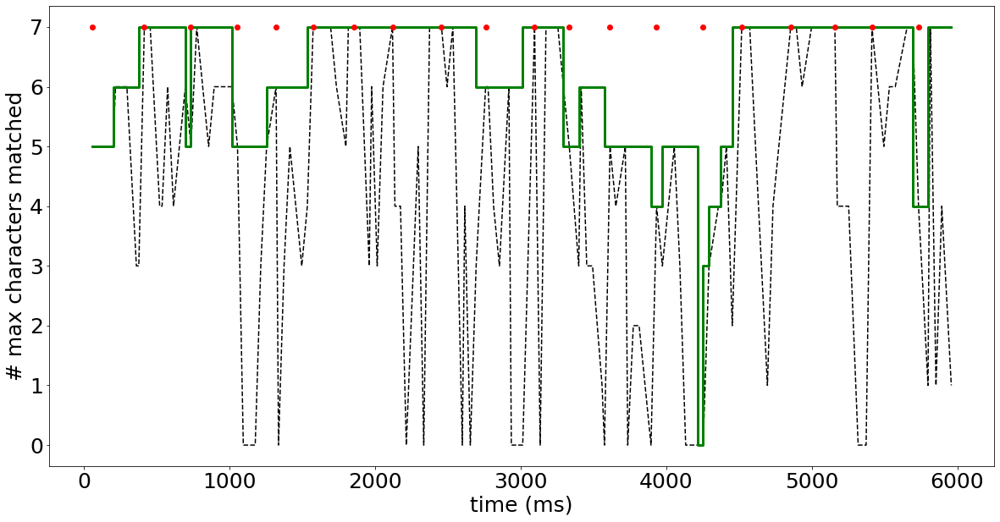

In [57]:
c2_step_data=prepare_data_step_plot(detected_info_runs_c2[3])
x2,y2,car_timestamps=c2_step_data
print(x2)
print(y2)
sampled_x,sampled_y=prepare_data_line_plot(detected_info_runs_c2[3])
plt.plot(sampled_x,sampled_y,linestyle='dashed',color='black')

# horizontal_x=x2
# horizontal_y=[3]*len(x2)
# plt.plot(horizontal_x,horizontal_y,marker='x')
# for xval in x2:
#     plt.axvline(x = xval, color = 'r', linestyle='dashed',label = 'axvline - full height')
plt.step(x2,y2,color='green',linewidth=3.0)
plt.yticks(fontsize=25)
plt.xticks(fontsize=25)
for arrived_car in car_timestamps:
    plt.plot(arrived_car,7,'ro') 
plt.ylabel('# max characters matched',fontsize=25)
plt.xlabel('time (ms)',fontsize=25)
plt.show()

BRITRES



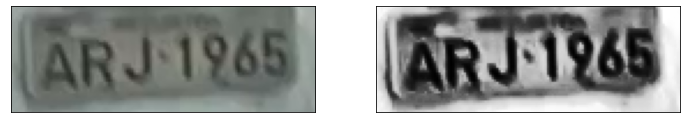

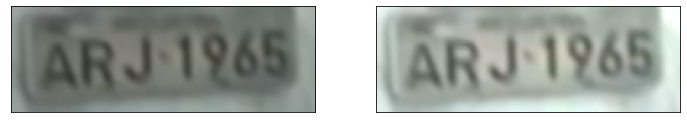

In [410]:
from skimage.exposure import is_low_contrast
image_path="./Camera1/Set04/classes/arj-1965/11045.png"
img = cv.imread(image_path)
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
equ = cv.equalizeHist(gray)
if(is_low_contrast(gray,0.35)):
    print("low contrast")


blurred = cv.GaussianBlur(img, (5, 5), 0)
alpha = 1.5 # Contrast control (1.0-3.0)
beta = 0 # Brightness control (0-100)
adjusted = cv.convertScaleAbs(blurred, alpha=alpha, beta=beta)
plot_images(img,equ)
plot_images(blurred,adjusted)
characters = pytesseract.image_to_string(equ, lang ='eng',
config ='--oem 3 --psm 7 -c tessedit_char_whitelist=ABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789')
print(characters)

{'[55, 110, 110]': 0.5, '[55, 110, 165]': 0.272727272727, '[55, 165, 110]': 0.272727272727, '[55, 165, 165]': 0.4, '[40, 80, 80]': 1.0, '[40, 80, 160]': 0.714285714286, '[40, 160, 80]': 0.714285714286, '[40, 160, 160]': 0.666666666667} {'[55, 110, 110]': 0.0, '[55, 110, 165]': 0.0, '[55, 165, 110]': 0.0, '[55, 165, 165]': 0.0, '[40, 80, 80]': 0.25, '[40, 80, 160]': 0.142857142857, '[40, 160, 80]': 0.142857142857, '[40, 160, 160]': 0.0}
[(6.92460076969697, 0.4, 0.0), (7.201931325, 0.666666666667, 0.0), (8.611433303030301, 0.272727272727, 0.0), (8.611433303030301, 0.272727272727, 0.0), (10.298265836363637, 0.5, 0.0), (10.681023425, 0.714285714286, 0.142857142857), (10.681023425, 0.714285714286, 0.142857142857), (14.160115525, 1.0, 0.25)]
[6.83, 6.92460076969697, 7.201931325, 8.611433303030301, 8.611433303030301, 10.298265836363637, 10.681023425, 10.681023425, 14.160115525]
[0.0, 0.4, 0.666666666667, 0.272727272727, 0.272727272727, 0.5, 0.714285714286, 0.714285714286, 1.0]
[0.0, 0.0, 0.0,

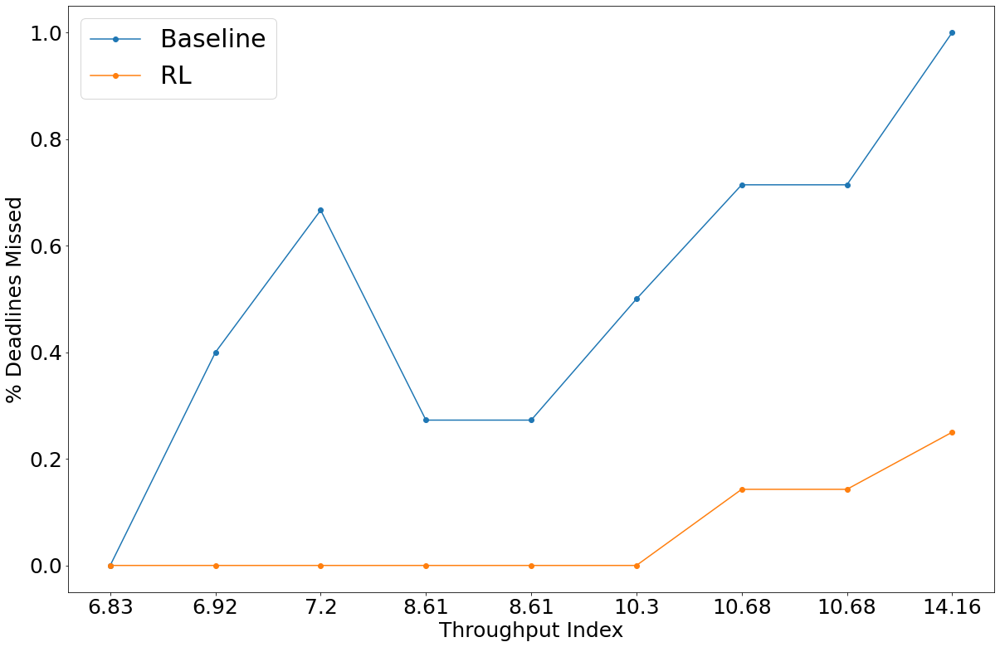

In [601]:
#line plots
baseline_file="./rl_configs/baseline.txt"
rl_file = "./rl_configs/rl.txt"
def process_deadline_missed(filename):
    info = {}
    file_contents=open(filename,'r').readlines()
    for line in file_contents:
        period_config,deadline_missed=line.strip("\n").split(":")
        info[period_config]=float(deadline_missed)
    return info
baseline_info = process_deadline_missed(baseline_file)
rl_info = process_deadline_missed(rl_file)
print(baseline_info,rl_info)
flop_values = [9749885,556654736]

def get_ti_value(key,flops_values):
    periods = eval(key)
    return 1000*(flops_values[0]/periods[0]+flops_values[1]/periods[1]+flops_values[1]/periods[2])
plot_info = []
for key in baseline_info:
    ti_value = get_ti_value(key,flop_values)/1e9
    plot_info.append((ti_value,baseline_info[key],rl_info[key]))
sorted_plot_info=sorted(plot_info,key=lambda x:x[0])
print(sorted_plot_info)
ti_x = []
baseline_y=[]
rl_y=[]

for tuple_info in sorted_plot_info:
    ti_x.append(tuple_info[0])
    baseline_y.append(tuple_info[1])
    rl_y.append(tuple_info[2])
ti_x.insert(0,6.83)
print(ti_x)
baseline_y.insert(0,0.0)
rl_y.insert(0,0.0)
print(baseline_y)
print(rl_y)
x=range(len(ti_x))
plt.rcParams['figure.figsize'] = [20, 13]
plt.plot(x,baseline_y,marker='o')
plt.plot(x,rl_y,marker='o')
plt.xlabel('Throughput Index', fontsize=25)
plt.ylabel('% Deadlines Missed', fontsize=25)
plt.yticks(fontsize=25)
ti_values=[round(ti_val,2) for ti_val in ti_x]
plt.xticks(x,ti_values,fontsize=25)
plt.legend(["Baseline", "RL"], loc ="upper left",fontsize=30)
plt.show()

    

In [ ]:
#common nameplates
c_sampled=['fmm-9230', 'agc-3727', 'bad-8400', 'arv-9922', 'axy-3722', 'azi-9960', 'jlu-9781', 'auq-0258', 'pux-4461', 'axh-7320', 'aug-8890', 'dnb-0172', 'aha-5376', 'ayd-1477', 'mfd-8925', 'ayb-5619', 'apw-6536', 'elc-4061', 'avu-6933', 'awh-3435']
c_sampled=['art-0507', 'aue-0705', 'aed-6155', 'axv-1204', 'axv-3976', 'hxx-0902', 'atn-5527', 'amm-1775', 'atn-8301', 'eiq-8844', 'axk-0282', 'auv-1008', 'krn-1403', 'axb-3538', 'bak-1521', 'bbz-0410', 'awb-4298', 'akz-5316', 'bba-3822', 'awc-3077']
11 --> 17
c_sampled=['azc-9139', 'axr-5133', 'avx-4023', 'avp-3274', 'pux-4461', 'mgj-3300', 'aup-6455', 'ayg-3842', 'dzc-2608', 'awf-2545', 'aja-5941', 'nfy-8264', 'krn-1403', 'awr-8969', 'avz-2864', 'ayc-7312', 'ata-7692', 'aso-4778', 'asm-1325', 'mhq-7009']
5->13

In [566]:
def get_finish_timestamps(filename="./rl_configs/RL_Nameplate_Test/timing_statistic_0.stats",task_id='0'):
    contents=open(filename,'r').readlines()
    finish_timestamps = []
    for line in contents:
        task_info = line.split(" ")
        if task_info[0] == task_id:
            finish_timestamps.append(float(task_info[3]))
    return finish_timestamps


def compute_fps_requirements(c_sampled,stats_file,period_configuration,task_id,camera,nameplate_database,complete_nameplate_set_mapping):
    sampled_frame_info,sampled_char_info=get_frames(c_sampled,camera,nameplate_database,complete_nameplate_set_mapping)
    id_to_nameplate = {}
    id_to_charinfo = {}
    frame_counter=0
    char_counter=0
    for key in sampled_frame_info:
        for frame in sampled_frame_info[key]:
            id_to_nameplate[frame_counter]=key
            frame_counter+=1
        for num_char in sampled_char_info[key]:
            id_to_charinfo[char_counter]=num_char
            char_counter+=1
    
    frame_timestamps=[]
    for f in range(frame_counter):
        frame_timestamps.append(33.33*f)
    total_num_frames = len(frame_timestamps)
#     print("FRAME TIMESTAMPS",frame_timestamps)
    hyperperiod=lcm_func(period_configuration)
#     print("HYPERPERIOD",hyperperiod)
    num_hyperperiods=int(frame_timestamps[-1]/hyperperiod)+1
    finish_timestamps = get_finish_timestamps(stats_file,task_id)
#     print("FINISH TIMESTAMPS",finish_timestamps)
    nameplate_task_timestamps=[]
#     print("Number of hyperperiods",num_hyperperiods)
    for i in range(num_hyperperiods):
        for f in finish_timestamps:
            nameplate_task_timestamps.append(i*hyperperiod+f)

    counter = 0
    num_frames_processed = 0
    final_counter_info = []
    final_timestamps = {}
    for nt in nameplate_task_timestamps:
        while counter < total_num_frames and frame_timestamps[counter]<nt  :
            counter+=1

        if counter < len(id_to_nameplate):
            final_counter_info.append(counter)
            final_timestamps[counter]=nt
            num_frames_processed+=1
#     print(nameplate_task_timestamps)
    return num_frames_processed/nameplate_task_timestamps[-1]*1000.0
    

file_hyperperiod_mapping = {}
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test/timing_statistic_0.stats"]=[55, 110, 110]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test/timing_statistic_1.stats"]=[55, 110, 165]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test/timing_statistic_2.stats"]=[55, 165, 110]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test/timing_statistic_3.stats"]=[55, 165, 165]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test/timing_statistic_4.stats"]=[110, 110, 110]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test/timing_statistic_5.stats"]=[110, 110, 165]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test/timing_statistic_6.stats"]=[110, 165, 110]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test/timing_statistic_7.stats"]=[110, 165, 165]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test_1/timing_statistic_0.stats"]=[40, 80, 80]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test_1/timing_statistic_1.stats"]=[40, 80, 160]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test_1/timing_statistic_2.stats"]=[40, 160, 80]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test_1/timing_statistic_3.stats"]=[40, 160, 160]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test_1/timing_statistic_4.stats"]=[80, 80, 80]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test_1/timing_statistic_5.stats"]=[80, 80, 160]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test_1/timing_statistic_6.stats"]=[80, 160, 80]
file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test_1/timing_statistic_7.stats"]=[80, 160, 160]





# file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test_1/timing_statistic_3.stats"]=[40, 160, 160]
# file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test/timing_statistic_1.stats"]=[55, 110, 165]
# file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test/timing_statistic_0.stats"]=[55, 110, 110]
# file_hyperperiod_mapping["./rl_configs/RL_Nameplate_Test_1/timing_statistic_0.stats"]=[40, 80, 80]

for key in file_hyperperiod_mapping:
    periods=file_hyperperiod_mapping[key]
    print("Periods",periods,"TI: ", get_ti_value(periods,flop_values)/1e9)

Periods [55, 110, 110] TI:  10.298265836363637
Periods [55, 110, 165] TI:  8.611433303030301
Periods [55, 165, 110] TI:  8.611433303030301
Periods [55, 165, 165] TI:  6.92460076969697
Periods [110, 110, 110] TI:  10.209630518181818
Periods [110, 110, 165] TI:  8.522797984848484
Periods [110, 165, 110] TI:  8.522797984848484
Periods [110, 165, 165] TI:  6.835965451515152
Periods [40, 80, 80] TI:  14.160115525
Periods [40, 80, 160] TI:  10.681023425
Periods [40, 160, 80] TI:  10.681023425
Periods [40, 160, 160] TI:  7.201931325
Periods [80, 80, 80] TI:  14.0382419625
Periods [80, 80, 160] TI:  10.5591498625
Periods [80, 160, 80] TI:  10.5591498625
Periods [80, 160, 160] TI:  7.0800577625


In [579]:
#10 CARS
sampled_cars_sets = []
#C1 
sampled_cars_sets.append((['awn-2437', 'avu-0493', 'dnb-0172', 'arw-9796', 'awq-3718', 'ipo-7305', 'aol-7489', 'lcw-1636', 'axy-3722', 'ali-0499'],'Camera1',10))

#C2
sampled_cars_sets.append((['hnh-0322', 'awb-4298', 'bdu-0028', 'amg-7343', 'arv-5433', 'jkn-4884', 'dkg-8700', 'ayd-2258', 'auf-6294', 'ffs-7259'],'Camera2',10))


#20 CARS

#C1
sampled_cars_sets.append((['axr-4771', 'mjv-1783', 'ajk-5467', 'ayg-7883', 'auy-3629', 'ash-5937', 'aqp-4406', 'lpy-9149', 'awi-3228', 'akc-7359', 'fke-3040', 'avu-9622', 'axg-4984', 'awb-8291', 'aha-5376', 'arc-0208', 'azc-8063', 'awn-4554', 'atg-8925', 'awd-2933'],'Camera1',20))

#C2
sampled_cars_sets.append((['mki-2628', 'awh-3029', 'apv-8603', 'ajy-0700', 'amg-7343', 'awn-2756', 'ayc-7312', 'amb-5427', 'axc-9549', 'bdi-0021', 'asw-2388', 'mft-1466', 'axo-1086', 'jke-6468', 'arc-0208', 'awn-4554', 'avs-6171', 'ask-8589', 'awy-0642', 'asm-5490'],'Camera2',20))

#30 CARS

#C1
sampled_cars_sets.append((['awn-2437', 'atl-6524', 'awi-5582', 'mjv-1783', 'aoa-2661', 'duh-5966', 'aug-7865', 'ava-3159', 'axy-1919', 'bak-0042', 'aws-2135', 'atv-8950', 'axe-6250', 'azg-3589', 'avz-2864', 'ara-3310', 'ava-3265', 'aty-1811', 'amt-6430', 'afi-0484', 'aic-3532', 'awp-3264', 'afk-7069', 'amc-0518', 'ayy-8033', 'aax-2860', 'awd-2933', 'aml-9372', 'mjb-9858', 'ayn-7661'],'Camera1',30))
#C2
sampled_cars_sets.append((['axy-4136', 'ays-5083', 'bep-0207', 'ajy-0700', 'axl-3584', 'dda-6698', 'its-6444', 'amg-7343', 'ayv-2256', 'opq-1452', 'arv-5433', 'ayn-3672', 'avn-4768', 'aug-8898', 'ben-1649', 'ayw-4212', 'ayg-0639', 'ato-6241', 'ash-7803', 'dkg-8700', 'bam-0196', 'hdk-6625', 'axg-7934', 'aur-7456', 'awj-2847', 'jke-6468', 'lux-9860', 'ask-8589', 'mee-1166', 'aws-8073'],'Camera2',30))

def get_ti_value(period_str,flops_values):
    periods=eval(period_str)
    return 1000*(flops_values[0]/periods[0]+flops_values[1]/periods[1]+flops_values[1]/periods[2])

def get_chars_detected(detected_info):
    detection_results = {}
    for value in detected_info.values():
        nameplate,num_chars,_ = value
        if nameplate not in detection_results:
            detection_results[nameplate]=[]
        detection_results[nameplate].append(num_chars)
    
    sample=detection_results
    s=0
    nameplate_fully_detected=0
    num_samples=0
    for key in sample:
#         print(key,max(sample[key]))
        num_samples+=len(sample[key])
        s+=max(sample[key])
        if max(sample[key]) == 7:
            nameplate_fully_detected+=1
    return nameplate_fully_detected

detected_char_info = {'Camera1':{10:{},20:{},30:{}},'Camera2':{10:{},20:{},30:{}}}
fps_info={'Camera1':{10:{},20:{},30:{}},'Camera2':{10:{},20:{},30:{}}}
for c_sampled,camera,num_cars in sampled_cars_sets:
    for stats_file in file_hyperperiod_mapping:
        periods=str(file_hyperperiod_mapping[stats_file])
        TI_value = get_ti_value(periods,flop_values)/1e9
        print(num_cars,camera,)
        fps_info[camera][num_cars][str(periods)]=[]
        detected_info=run_experiments(file_hyperperiod_mapping[stats_file],stats_file,c_sampled,num_cars,camera,nameplate_database,complete_nameplate_set_mapping)
        chars_detected=get_chars_detected(detected_info)
        detected_char_info[camera][num_cars][str(periods)]=chars_detected
        print("CHARS:",chars_detected)
        for task_id in ['0','1','2']:
            print("task id:",task_id,)
            fps=compute_fps_requirements(c_sampled,stats_file,file_hyperperiod_mapping[stats_file],task_id,camera,nameplate_database,complete_nameplate_set_mapping)
            detected_info=run_experiments(file_hyperperiod_mapping[stats_file],stats_files[i],c_sampled,num_cars,camera,nameplate_database,complete_nameplate_set_mapping)
            chars_detected=get_chars_detected(detected_info)
            fps_info[camera][num_cars][str(periods)].append(fps)
            print(fps)
print(fps_info)

10 Camera1
CHARS: 5
task id: 0
18.09980342511038
task id: 1
9.296874839120488
task id: 2
9.31541261579517
10 Camera1
CHARS: 5
task id: 0
16.877859656997366
task id: 1
8.71914194306325
task id: 2
6.013713303398002
10 Camera1
CHARS: 5
task id: 0
16.877859656997366
task id: 1
6.019658610763695
task id: 2
8.710677838898276
10 Camera1
CHARS: 5
task id: 0
17.778024673238008
task id: 1
6.308593640831758
task id: 2
6.321172846432437
10 Camera1
CHARS: 3
task id: 0
9.232336383346775
task id: 1
9.321106713375976
task id: 2
9.312309469254444
10 Camera1
CHARS: 4
task id: 0
8.641419299987637
task id: 1
8.71914194306325
task id: 2
6.030546973305181
10 Camera1
CHARS: 4
task id: 0
8.668312394688847
task id: 1
6.030899699317371
task id: 2
8.714096913150366
10 Camera1
CHARS: 4
task id: 0
8.675180630838941
task id: 1
6.015357857635998
task id: 2
6.000453184542576
10 Camera1
CHARS: 5
task id: 0
25.179657018482512
task id: 1
12.69232572620127
task id: 2
12.68030675852405
10 Camera1
CHARS: 5
task id: 0
25.21

In [641]:
reformed_dict = {}
for l1_key,l1_dict in fps_info.items():
    for l2_key,l2_dict in l1_dict.items():
        for l3_key,l3_values in l2_dict.items():
            print(l1_key,l2_key,l3_key,get_ti_value(l3_key,flop_values)/1e9,l3_values,detected_char_info[l1_key][l2_key][l3_key])
            reformed_dict[l3_key]=l3_values
print("---------------------------------------------")
for key in reformed_dict:
    print(get_ti_value(key,flop_values)/1e9,key,reformed_dict[key])    
    

Camera1 10 [55, 110, 110] 10.298265836363637 [18.09980342511038, 9.296874839120488, 9.31541261579517] 5
Camera1 10 [55, 110, 165] 8.611433303030301 [16.877859656997366, 8.71914194306325, 6.013713303398002] 5
Camera1 10 [55, 165, 110] 8.611433303030301 [16.877859656997366, 6.019658610763695, 8.710677838898276] 5
Camera1 10 [55, 165, 165] 6.92460076969697 [17.778024673238008, 6.308593640831758, 6.321172846432437] 5
Camera1 10 [110, 110, 110] 10.209630518181818 [9.232336383346775, 9.321106713375976, 9.312309469254444] 3
Camera1 10 [110, 110, 165] 8.522797984848484 [8.641419299987637, 8.71914194306325, 6.030546973305181] 4
Camera1 10 [110, 165, 110] 8.522797984848484 [8.668312394688847, 6.030899699317371, 8.714096913150366] 4
Camera1 10 [110, 165, 165] 6.835965451515152 [8.675180630838941, 6.015357857635998, 6.000453184542576] 4
Camera1 10 [40, 80, 80] 14.160115525 [25.179657018482512, 12.69232572620127, 12.68030675852405] 5
Camera1 10 [40, 80, 160] 10.681023425 [25.21811148773457, 12.7460

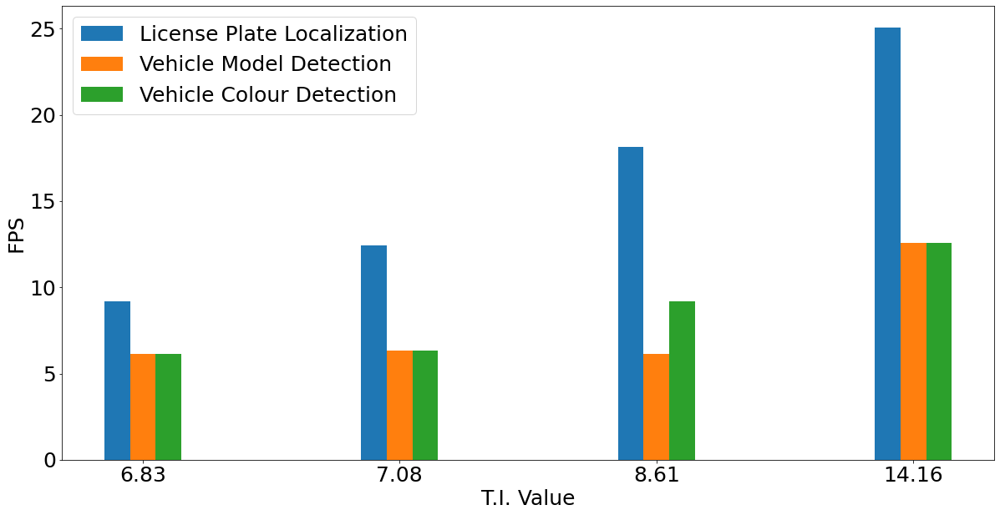

In [632]:
TI_FPS = {}
TI_FPS[6.83] = [9.165385821819651, 6.158350469632529, 6.152845218101399] #[110, 165, 165]
TI_FPS[7.08] = [12.447297328709372, 6.333577236301315, 6.337873403756559] #[80, 160, 160]
TI_FPS[8.61] = [18.15371726280053, 6.159935770176333, 9.179046902966263] #[55, 165, 110]
# TI_FPS[10.29] = [18.15371726280053, 9.161067073935829, 9.167281173290737] #[55, 110, 110]
TI_FPS[14.16] = [25.061214896036635, 12.565181681875016, 12.561146576579901] #[40, 80, 80] 
labels = TI_FPS.keys()
P1 = []
P2 = []
P3 = []

for key in labels:
    P1.append(TI_FPS[key][0])
    P2.append(TI_FPS[key][1])
    P3.append(TI_FPS[key][2])

x = np.arange(len(labels))  # the label locations
width = 0.1  # the width of the bars

fig, ax = plt.subplots()
rects1 = ax.bar(x-width , P1, width, label='License Plate Localization')
rects2 = ax.bar(x , P2, width, label='Vehicle Model Detection')
rects3 = ax.bar(x + width, P3, width, label='Vehicle Colour Detection')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('FPS',fontsize=25)
ax.set_xlabel('T.I. Value',fontsize=25)
for item in ax.get_yticklabels():
    item.set_fontsize(25)

ax.set_xticks(x, labels,fontsize=25)

ax.legend(fontsize=25)
plt.show()

    

In [554]:
import pandas as pd
multiIndex_df = pd.DataFrame(reformed_dict)
multiIndex_df

Camera1                                                         \
          10                               20                         
   7.201931   10.298266  14.160116  7.201931   10.298266  14.160116   
0  25.218111  18.099803  25.179657  24.778206  18.140342  25.090705   
1   6.502919   9.296875  12.692326   6.373952   9.194611  12.596711   
2   6.516286   9.315413  12.680307   6.380366   9.203833  12.590710   

                                      Camera2                        \
          30                               10                         
   7.201931   10.298266  14.160116  7.201931   10.298266  14.160116   
0  24.838109  18.273280  25.065982  24.576938  17.785078  25.175018   
1   6.340099   9.166727  12.570273   6.489788   8.969286  12.687320   
2   6.344735   9.173446  12.565921   6.502434   8.986539  12.675619   

                                                                     
          20                               30                        
   7.201931   10.298266  14.160116  7.201931   10.298266  14.160116  
0  24.938519  18.137065  24.917943  24.849707  18.153717  25.061215  
1   6.384805   9.202845  12.603676   6.333577   9.161067  12.565182  
2   6.391794   9.212808  12.597240   6.337873   9.167281  12.561147

In [547]:
print(multiIndex_df.to_latex(index=False))

\begin{tabular}{rrrrrrrrrrrrrrrrrrrrrrrr}
\toprule
  Camera1 & \multicolumn{12}{l}{Camera2} \\
       10 & \multicolumn{4}{l}{20} & \multicolumn{4}{l}{30} & \multicolumn{4}{l}{10} & \multicolumn{4}{l}{20} & \multicolumn{4}{l}{30} \\
7.201931  & 8.611433  & 10.298266 & 14.160116 & 7.201931  & 8.611433  & 10.298266 & 14.160116 & 7.201931  & 8.611433  & 10.298266 & 14.160116 & 7.201931  & 8.611433  & 10.298266 & 14.160116 & 7.201931  & 8.611433  & 10.298266 & 14.160116 & 7.201931  & 8.611433  & 10.298266 & 14.160116 \\
\midrule
25.218111 & 16.877860 & 18.099803 & 25.179657 & 24.778206 & 17.499619 & 18.140342 & 25.090705 & 24.838109 & 18.273280 & 18.273280 & 25.065982 & 24.576938 & 17.184730 & 17.785078 & 25.175018 & 24.938519 & 18.137065 & 18.137065 & 24.917943 & 24.849707 & 18.153717 & 18.153717 & 25.061215 \\
 6.502919 &  8.719142 &  9.296875 & 12.692326 &  6.373952 &  8.897768 &  9.194611 & 12.596711 &  6.340099 &  9.189684 &  9.166727 & 12.570273 &  6.489788 &  8.719142 &  8.969286 & 